# Projet n°7 : Implémenter_un_modele_de_scoring

- Suite de la première partie, concernant la préparation des données avant la modélisation

In [ ]:
%load_ext autoreload 
%autoreload 2

In [6]:
# Import des librairies nécessaires au projet. 

import sys
sys.path.append("../src")

from pathlib import Path

PROJECT_ROOT = Path.cwd().parents[0]
DATA_DIR = PROJECT_ROOT / "data" / "Donnee_kaggle"
INPUT_DIR = PROJECT_ROOT / "data" / "Dataframes_modelisation"

import numpy as np
import pandas as pd 
import missingno as msno
import pprint
import re
import os
import pickle
import kaleido
import plotly
import gc

from mltools import *

import math

from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer

import matplotlib.pyplot as plt
import seaborn as sns
import networkx as nx
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio

pio.renderers.default = 'png' #plotly_mimetype vscode

In [2]:
# Importation des différents fichiers du projet.

df_appli_train = pd.read_csv(DATA_DIR / "application_train.csv")
df_appli_test = pd.read_csv(DATA_DIR / "application_test.csv")
df_credit_card = pd.read_csv(DATA_DIR / "credit_card_balance.csv")
df_previous_app = pd.read_csv(DATA_DIR / "previous_application.csv")
df_pos_cash = pd.read_csv(DATA_DIR / "POS_CASH_balance.csv")
df_install_payments = pd.read_csv(DATA_DIR / "installments_payments.csv")

In [3]:
# Récupération des dataframes principaux (application train/test)


dfs = {}

file_names = [
    "df_train_median_mode_linear",
    "df_train_median_missing_linear",
    "df_train_iterative_mode_linear",
    "df_train_nan_missing_linear",
    "df_train_median_mode",
    "df_train_median_missing",
    "df_train_iterative_mode",
    "df_train_nan_missing",
    "df_test_median_mode_linear",
    "df_test_median_missing_linear",
    "df_test_iterative_mode_linear",
    "df_test_nan_missing_linear",
    "df_test_median_mode",
    "df_test_median_missing",
    "df_test_iterative_mode",
    "df_test_nan_missing",
]

for name in file_names:
    file_path = INPUT_DIR / f"{name}.pkl"
    with open(file_path, "rb") as f:
        dfs[name] = pickle.load(f)

# Réassignation des dataframes dans le notebook:
df_train_median_mode_linear = dfs["df_train_median_mode_linear"]
df_train_median_missing_linear = dfs["df_train_median_missing_linear"]
df_train_iterative_mode_linear = dfs["df_train_iterative_mode_linear"]
df_train_nan_missing_linear = dfs["df_train_nan_missing_linear"]
df_train_median_mode = dfs["df_train_median_mode"]
df_train_median_missing = dfs["df_train_median_missing"]
df_train_iterative_mode = dfs["df_train_iterative_mode"]
df_train_nan_missing = dfs["df_train_nan_missing"]
df_test_median_mode_linear = dfs["df_test_median_mode_linear"]
df_test_median_missing_linear = dfs["df_test_median_missing_linear"]
df_test_iterative_mode_linear = dfs["df_test_iterative_mode_linear"]
df_test_nan_missing_linear = dfs["df_test_nan_missing_linear"]
df_test_median_mode = dfs["df_test_median_mode"]
df_test_median_missing = dfs["df_test_median_missing"]
df_test_iterative_mode = dfs["df_test_iterative_mode"]
df_test_nan_missing = dfs["df_test_nan_missing"]

### Préparation des données - df_previous_app.csv

In [5]:
# Sauvegarde du dataframe d'origine.

df_init_previous_app = df_previous_app.copy()

In [6]:
#df_previous_app = df_init_previous_app.copy()

In [7]:
# Forme du dataframe.

print_dataframe_shape(df_previous_app)

Le DataFrame contient 1,670,214 lignes et 37 colonnes.


In [8]:
# Echantillon du dataframe.

df_previous_app.head(5)

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,...,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
0,2030495,271877,Consumer loans,1730.430,17145.0,17145.0,0.0,17145.0,SATURDAY,15,...,Connectivity,12.0,middle,POS mobile with interest,365243.0,-42.0,300.0,-42.0,-37.0,0.0
1,2802425,108129,Cash loans,25188.615,607500.0,679671.0,NaN,607500.0,THURSDAY,11,...,XNA,36.0,low_action,Cash X-Sell: low,365243.0,-134.0,916.0,365243.0,365243.0,1.0
2,2523466,122040,Cash loans,15060.735,112500.0,136444.5,NaN,112500.0,TUESDAY,11,...,XNA,12.0,high,Cash X-Sell: high,365243.0,-271.0,59.0,365243.0,365243.0,1.0
3,2819243,176158,Cash loans,47041.335,450000.0,470790.0,NaN,450000.0,MONDAY,7,...,XNA,12.0,middle,Cash X-Sell: middle,365243.0,-482.0,-152.0,-182.0,-177.0,1.0
4,1784265,202054,Cash loans,31924.395,337500.0,404055.0,NaN,337500.0,THURSDAY,9,...,XNA,24.0,high,Cash Street: high,NaN,NaN,NaN,NaN,NaN,NaN


In [9]:
df_previous_app.info(show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1670214 entries, 0 to 1670213
Data columns (total 37 columns):
 #   Column                       Non-Null Count    Dtype  
---  ------                       --------------    -----  
 0   SK_ID_PREV                   1670214 non-null  int64  
 1   SK_ID_CURR                   1670214 non-null  int64  
 2   NAME_CONTRACT_TYPE           1670214 non-null  object 
 3   AMT_ANNUITY                  1297979 non-null  float64
 4   AMT_APPLICATION              1670214 non-null  float64
 5   AMT_CREDIT                   1670213 non-null  float64
 6   AMT_DOWN_PAYMENT             774370 non-null   float64
 7   AMT_GOODS_PRICE              1284699 non-null  float64
 8   WEEKDAY_APPR_PROCESS_START   1670214 non-null  object 
 9   HOUR_APPR_PROCESS_START      1670214 non-null  int64  
 10  FLAG_LAST_APPL_PER_CONTRACT  1670214 non-null  object 
 11  NFLAG_LAST_APPL_IN_DAY       1670214 non-null  int64  
 12  RATE_DOWN_PAYMENT            774370 non-nu

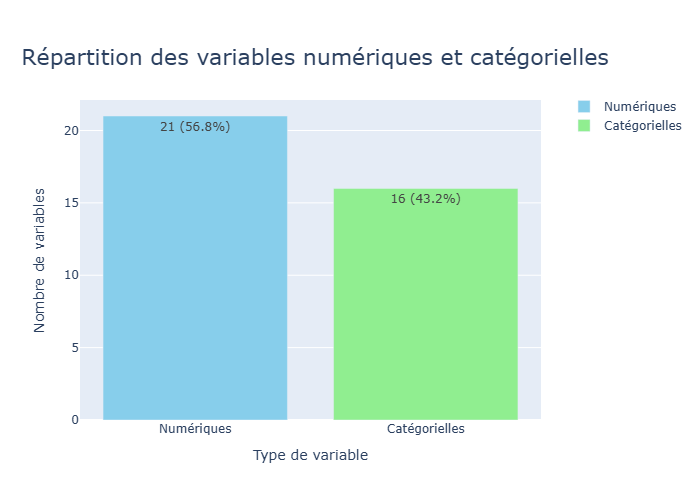

In [10]:
# Visualisation de la répartition des variables numériques et catégorielles.

num_cat_appli_train = plot_num_cat_distribution(df= df_previous_app,
                          chart_type='bar',
                          title="Répartition des variables numériques et catégorielles",
                          annotation_format= 'both',
                          title_size=22,
                          title_x= 0.45,
                          title_y= 0.90,
                          legend_x= 1.05,
                          legend_y= 0.95,
                          width=800,
                          height=800
)

num_cat_appli_train.show()

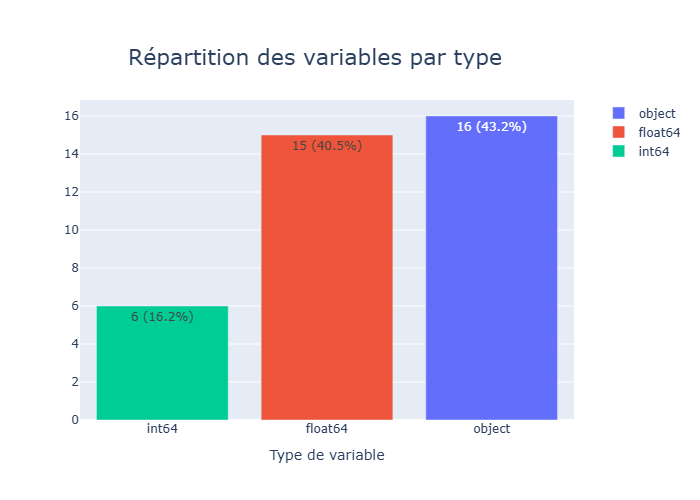

In [11]:
# Visualisation de la répartition des variables par type.

var_distrib_appli_train = plot_variable_types_distribution(df=df_previous_app,
                          chart_type='bar',
                          title_size=22,
                          title_x= 0.45,
                          title_y= 0.90,
                          legend_x= 1.05,
                          legend_y= 0.90,
                          annotation_format= 'both',
                          bar_orientation= 'v',
                          width=800,
                          height=800)

var_distrib_appli_train.show()

- On retrouve quasiment la même proportion de variables quantitatives que de variables qualitatives.
- On s'intéresse ensuite aux valeurs aberrantes:

##### - Valeurs aberrantes de df_previous_app

In [12]:
# Liste des variables catégorielles du dataframe.

df_previous_app.select_dtypes(include=['object']).nunique()

NAME_CONTRACT_TYPE              4
WEEKDAY_APPR_PROCESS_START      7
FLAG_LAST_APPL_PER_CONTRACT     2
NAME_CASH_LOAN_PURPOSE         25
NAME_CONTRACT_STATUS            4
NAME_PAYMENT_TYPE               4
CODE_REJECT_REASON              9
NAME_TYPE_SUITE                 7
NAME_CLIENT_TYPE                4
NAME_GOODS_CATEGORY            28
NAME_PORTFOLIO                  5
NAME_PRODUCT_TYPE               3
CHANNEL_TYPE                    8
NAME_SELLER_INDUSTRY           11
NAME_YIELD_GROUP                5
PRODUCT_COMBINATION            17
dtype: int64

- Donc comme précédemment, on s'intéressera aux variables sur lesquelles on peut réaliser des modifications pour faciliter et améliorer la qualité de la prédicition.

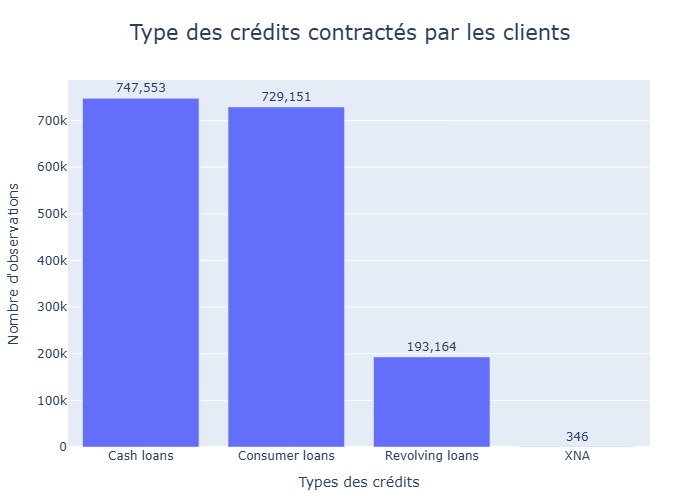

In [13]:
# Visualisation de la répartition pour la variable "NAME_CONTRACT_TYPE"

plot_histogram_categorical(
    df=df_previous_app,
    x="NAME_CONTRACT_TYPE",
    title="Type des crédits contractés par les clients",
    xaxis_title= 'Types des crédits',
    title_font_size=21
)

- Pour certaines variables comme ci-dessus, on remarque certaines modalités XNA que l'on peut garder car dans l'EDA cette catégorie à le plus haut taux de défaillance.

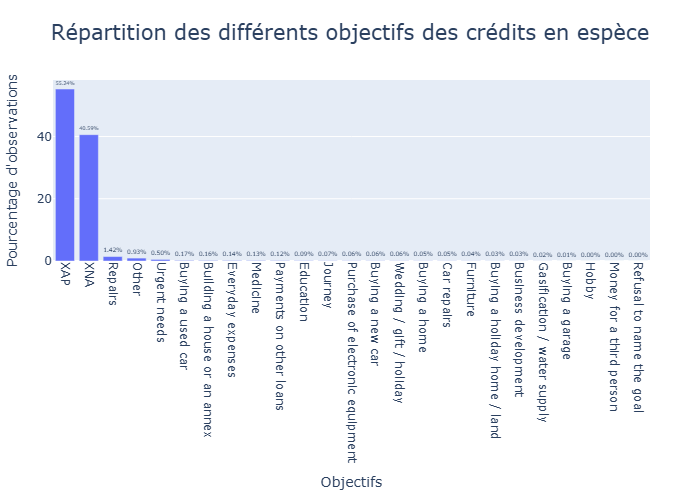

In [14]:
# Visualisation de la répartition pour la variable "NAME_CASH_LOAN_PURPOSE"

plot_histogram_categorical(
    df=df_previous_app,
    x="NAME_CASH_LOAN_PURPOSE",
    title="Répartition des différents objectifs des crédits en espèce",
    tickangle=90,
    xaxis_title= 'Objectifs',
    title_font_size=21,
    percent=True,
    height=900
)

- Pour cette variable, on peut faire une réduction du nombre important de modalité ici puisque la plupart des catégories ne représentent même pas 1 % du total.

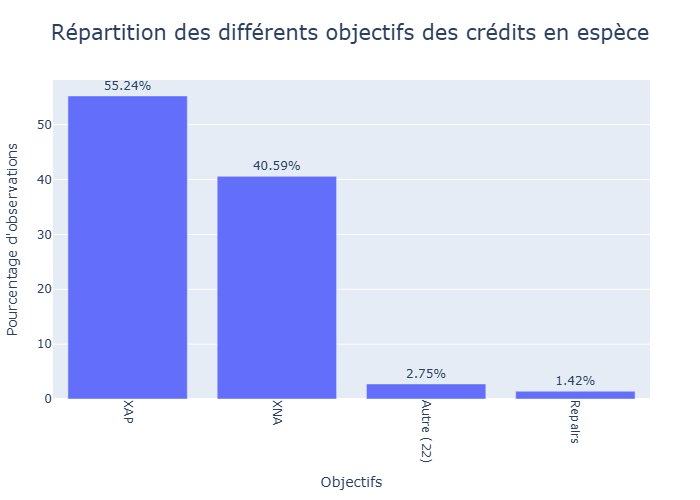

In [15]:
# Visualisation de la répartition réduite pour la variable "NAME_CASH_LOAN_PURPOSE".

plot_histogram_categorical(
    df=df_previous_app,
    x="NAME_CASH_LOAN_PURPOSE",
    title="Répartition des différents objectifs des crédits en espèce",
    tickangle=90,
    xaxis_title= 'Objectifs',
    rare_threshold=0.01,
    title_font_size=21,
    percent=True,
    height=900
)

In [16]:
# Changement des modalités concernées pour la variable 'NAME_CASH_LOAN_PURPOSE'.

rare_purposes = df_previous_app['NAME_CASH_LOAN_PURPOSE'].value_counts(normalize=True)
rare_purposes = rare_purposes[rare_purposes < 0.01].index
df_previous_app['NAME_CASH_LOAN_PURPOSE'] = df_previous_app['NAME_CASH_LOAN_PURPOSE'].replace(rare_purposes, 'other_purpose')

df_previous_app["NAME_CASH_LOAN_PURPOSE"] = df_previous_app["NAME_CASH_LOAN_PURPOSE"].replace("XNA", "Unknown")
df_previous_app["NAME_CASH_LOAN_PURPOSE"].value_counts()

NAME_CASH_LOAN_PURPOSE
XAP              922661
Unknown          677918
other_purpose     45870
Repairs           23765
Name: count, dtype: int64

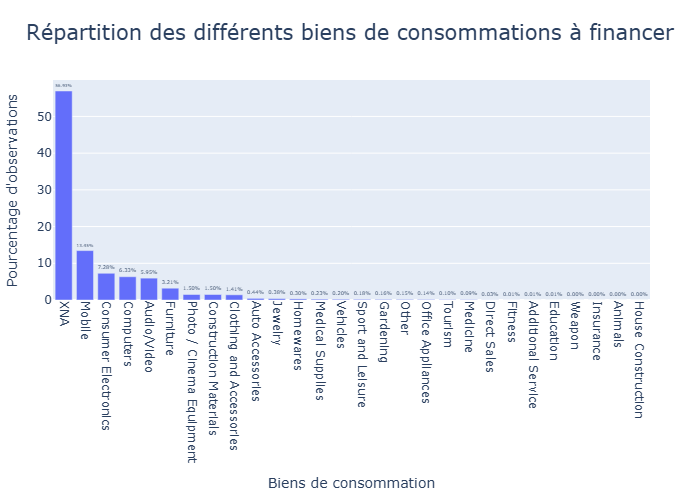

In [17]:
# Visualisation de la répartition pour la variable "NAME_GOODS_CATEGORY"

plot_histogram_categorical(
    df=df_previous_app,
    x="NAME_GOODS_CATEGORY",
    title="Répartition des différents biens de consommations à financer",
    tickangle=90,
    xaxis_title= 'Biens de consommation',
    title_font_size=21,
    percent=True,
    height=900
)

- Pareil pour cette variable qui recense un nombre important de petites modalités que l'on peut regrouper.

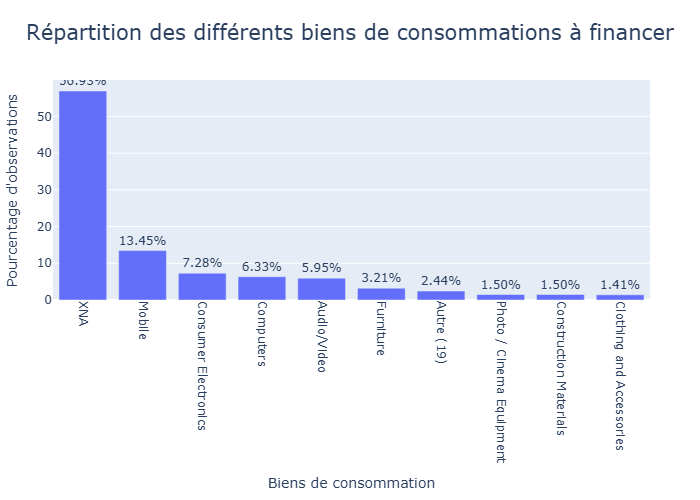

In [18]:
# Visualisation de la répartition réduite pour la variable "NAME_GOODS_CATEGORY"

plot_histogram_categorical(
    df=df_previous_app,
    x="NAME_GOODS_CATEGORY",
    title="Répartition des différents biens de consommations à financer",
    tickangle=90,
    xaxis_title= 'Biens de consommation',
    rare_threshold=0.01,
    title_font_size=21,
    percent=True,
    height=900
)

In [19]:
# Changement des modalités concernées pour la variable 'NAME_GOODS_CATEGORY'.

rare_goods = df_previous_app['NAME_GOODS_CATEGORY'].value_counts(normalize=True)
rare_goods = rare_goods[rare_goods < 0.01].index
df_previous_app['NAME_GOODS_CATEGORY'] = df_previous_app['NAME_GOODS_CATEGORY'].replace(rare_goods, 'other_goods')

df_previous_app["NAME_GOODS_CATEGORY"].value_counts()

NAME_GOODS_CATEGORY
XNA                         950809
Mobile                      224708
Consumer Electronics        121576
Computers                   105769
Audio/Video                  99441
Furniture                    53656
other_goods                  40685
Photo / Cinema Equipment     25021
Construction Materials       24995
Clothing and Accessories     23554
Name: count, dtype: int64

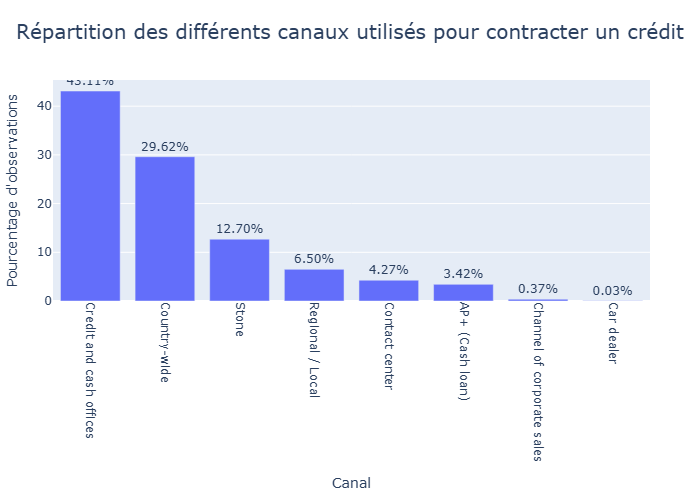

In [20]:
# Visualisation de la répartition pour la variable "CHANNEL_TYPE"

plot_histogram_categorical(
    df=df_previous_app,
    x="CHANNEL_TYPE",
    title="Répartition des différents canaux utilisés pour contracter un crédit",
    tickangle=90,
    xaxis_title= 'Canal',
    title_font_size=20,
    percent=True,
    height=900
)

- On effectue le même changement que précédemment.

In [21]:
# Changement des modalités concernées pour la variable 'CHANNEL_TYPE'.

rare_channels = df_previous_app['CHANNEL_TYPE'].value_counts(normalize=True)
rare_channels = rare_channels[rare_channels < 0.01].index
df_previous_app['CHANNEL_TYPE'] = df_previous_app['CHANNEL_TYPE'].replace(rare_channels, 'other_channels')

df_previous_app["CHANNEL_TYPE"].value_counts()

CHANNEL_TYPE
Credit and cash offices    719968
Country-wide               494690
Stone                      212083
Regional / Local           108528
Contact center              71297
AP+ (Cash loan)             57046
other_channels               6602
Name: count, dtype: int64

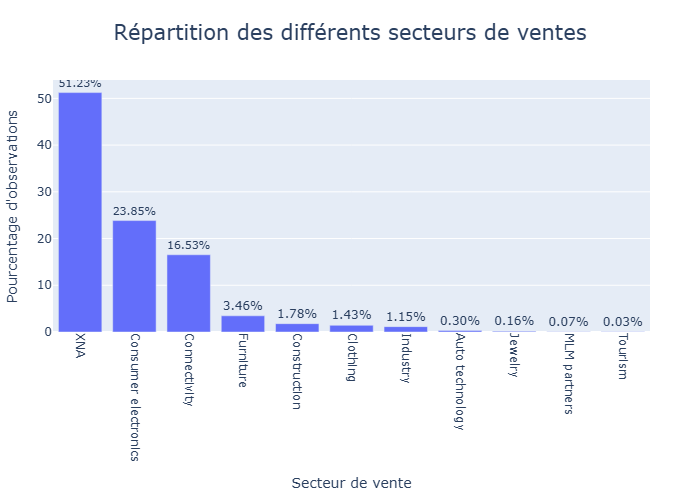

In [22]:
# Visualisation de la répartition pour la variable "NAME_SELLER_INDUSTRY"

plot_histogram_categorical(
    df=df_previous_app,
    x="NAME_SELLER_INDUSTRY",
    title="Répartition des différents secteurs de ventes",
    tickangle=90,
    xaxis_title= 'Secteur de vente',
    title_font_size=21,
    percent=True,
    height=900
)

- On effectue le même changement que précédemment.

In [23]:
# Changement des modalités concernées pour la variable 'NAME_SELLER_INDUSTRY'.

rare_sellers = df_previous_app['NAME_SELLER_INDUSTRY'].value_counts(normalize=True)
rare_sellers = rare_sellers[rare_sellers < 0.01].index
df_previous_app['NAME_SELLER_INDUSTRY'] = df_previous_app['NAME_SELLER_INDUSTRY'].replace(rare_sellers, 'other_sellers')

df_previous_app["NAME_SELLER_INDUSTRY"].value_counts()

NAME_SELLER_INDUSTRY
XNA                     855720
Consumer electronics    398265
Connectivity            276029
Furniture                57849
Construction             29781
Clothing                 23949
Industry                 19194
other_sellers             9427
Name: count, dtype: int64

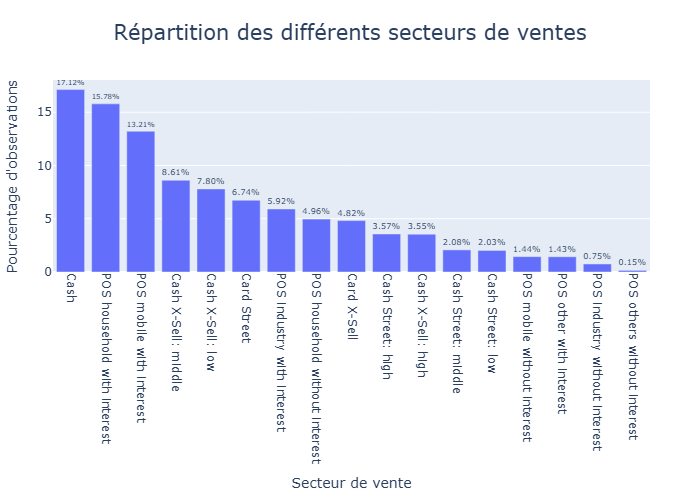

In [24]:
# Visualisation de la répartition pour la variable "PRODUCT_COMBINATION"

plot_histogram_categorical(
    df=df_previous_app,
    x="PRODUCT_COMBINATION",
    title="Répartition des différents secteurs de ventes",
    tickangle=90,
    xaxis_title= 'Secteur de vente',
    title_font_size=21,
    percent=True,
    height=900
)

- Pour cette dernière variable, on peut diminuer le nombre de modalités en les regroupant par type de produits souscrit.

In [25]:
df_previous_app['PRODUCT_COMBINATION'].value_counts(dropna=False)

PRODUCT_COMBINATION
Cash                              285990
POS household with interest       263622
POS mobile with interest          220670
Cash X-Sell: middle               143883
Cash X-Sell: low                  130248
Card Street                       112582
POS industry with interest         98833
POS household without interest     82908
Card X-Sell                        80582
Cash Street: high                  59639
Cash X-Sell: high                  59301
Cash Street: middle                34658
Cash Street: low                   33834
POS mobile without interest        24082
POS other with interest            23879
POS industry without interest      12602
POS others without interest         2555
NaN                                  346
Name: count, dtype: int64

In [26]:
# Simplification des modalités de la variable 'PRODUCT_COMBINATION'.

df_previous_app["PRODUCT_COMBINATION"] = df_previous_app["PRODUCT_COMBINATION"].str.lower()

# On garde les distinctions with interest/without interest qui apparaissent souvent
df_previous_app["PRODUCT_HAS_INTEREST"] = df_previous_app["PRODUCT_COMBINATION"].str.contains("with interest", na=False).astype(int)

df_previous_app["PRODUCT_COMB_SIMPLIFIED"] = np.nan

df_previous_app.loc[df_previous_app["PRODUCT_COMBINATION"].str.contains("x-sell", na=False), "PRODUCT_COMB_SIMPLIFIED"] = "x_sell"
df_previous_app.loc[df_previous_app["PRODUCT_COMBINATION"].str.contains("card", na=False) & ~df_previous_app["PRODUCT_COMBINATION"].str.contains("x-sell", na=False), "PRODUCT_COMB_SIMPLIFIED"] = "card"
df_previous_app.loc[df_previous_app["PRODUCT_COMBINATION"].str.contains("cash", na=False) & ~df_previous_app["PRODUCT_COMBINATION"].str.contains("x-sell", na=False), "PRODUCT_COMB_SIMPLIFIED"] = "cash"
df_previous_app.loc[df_previous_app["PRODUCT_COMBINATION"].str.contains("pos", na=False) & df_previous_app["PRODUCT_COMBINATION"].str.contains("household", na=False), "PRODUCT_COMB_SIMPLIFIED"] = "pos_household"
df_previous_app.loc[df_previous_app["PRODUCT_COMBINATION"].str.contains("pos", na=False) & df_previous_app["PRODUCT_COMBINATION"].str.contains("mobile", na=False), "PRODUCT_COMB_SIMPLIFIED"] = "pos_mobile"
df_previous_app.loc[df_previous_app["PRODUCT_COMBINATION"].str.contains("pos", na=False) & df_previous_app["PRODUCT_COMBINATION"].str.contains("industry", na=False), "PRODUCT_COMB_SIMPLIFIED"] = "pos_industry"
df_previous_app.loc[df_previous_app["PRODUCT_COMBINATION"].str.contains("pos", na=False) & df_previous_app["PRODUCT_COMBINATION"].str.contains("other", na=False), "PRODUCT_COMB_SIMPLIFIED"] = "pos_others"


C:\Users\Caomghin\AppData\Local\Temp/ipykernel_25940/195136340.py:10: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'x_sell' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.



In [27]:
df_previous_app['PRODUCT_COMB_SIMPLIFIED'].value_counts(dropna=False)

PRODUCT_COMB_SIMPLIFIED
cash             414121
x_sell           414014
pos_household    346530
pos_mobile       244752
card             112582
pos_industry     111435
pos_others        26434
NaN                 346
Name: count, dtype: int64

In [28]:
# Vérification de la nouvelle variable en comparant avec l'ancienne.

df_previous_app[['PRODUCT_COMBINATION', 'PRODUCT_COMB_SIMPLIFIED']].sample(20)

,PRODUCT_COMBINATION,PRODUCT_COMB_SIMPLIFIED
1565072,cash x-sell: high,x_sell
1474237,pos industry without interest,pos_industry
631265,cash,cash
1386457,cash,cash
1262916,cash x-sell: middle,x_sell
1131519,cash,cash
1210737,cash,cash
644345,card street,card
368480,pos industry with interest,pos_industry
669610,cash x-sell: middle,x_sell


In [29]:
# Suppression de la variable initial "PRODUCT_COMBINATION"

df_previous_app = df_previous_app.drop(columns=['PRODUCT_COMBINATION'])

In [30]:
df_previous_app.select_dtypes(include='object').nunique()

NAME_CONTRACT_TYPE              4
WEEKDAY_APPR_PROCESS_START      7
FLAG_LAST_APPL_PER_CONTRACT     2
NAME_CASH_LOAN_PURPOSE          4
NAME_CONTRACT_STATUS            4
NAME_PAYMENT_TYPE               4
CODE_REJECT_REASON              9
NAME_TYPE_SUITE                 7
NAME_CLIENT_TYPE                4
NAME_GOODS_CATEGORY            10
NAME_PORTFOLIO                  5
NAME_PRODUCT_TYPE               3
CHANNEL_TYPE                    7
NAME_SELLER_INDUSTRY            8
NAME_YIELD_GROUP                5
PRODUCT_COMB_SIMPLIFIED         7
dtype: int64

- On peut maintenant passer aux valeurs aberrantes des  variables quantitatives :

In [31]:
# Liste des variables quantitatives du dataframe.

pprint.pprint(df_previous_app.select_dtypes(exclude=['object']).columns.tolist())

['SK_ID_PREV',
 'SK_ID_CURR',
 'AMT_ANNUITY',
 'AMT_APPLICATION',
 'AMT_CREDIT',
 'AMT_DOWN_PAYMENT',
 'AMT_GOODS_PRICE',
 'HOUR_APPR_PROCESS_START',
 'NFLAG_LAST_APPL_IN_DAY',
 'RATE_DOWN_PAYMENT',
 'RATE_INTEREST_PRIMARY',
 'RATE_INTEREST_PRIVILEGED',
 'DAYS_DECISION',
 'SELLERPLACE_AREA',
 'CNT_PAYMENT',
 'DAYS_FIRST_DRAWING',
 'DAYS_FIRST_DUE',
 'DAYS_LAST_DUE_1ST_VERSION',
 'DAYS_LAST_DUE',
 'DAYS_TERMINATION',
 'NFLAG_INSURED_ON_APPROVAL',
 'PRODUCT_HAS_INTEREST']


In [32]:
round(df_previous_app.describe(), 0)

,SK_ID_PREV,SK_ID_CURR,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,HOUR_APPR_PROCESS_START,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,...,DAYS_DECISION,SELLERPLACE_AREA,CNT_PAYMENT,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL,PRODUCT_HAS_INTEREST
count,1670214.0,1670214.0,1297979.0,1670214.0,1670213.0,774370.0,1284699.0,1670214.0,1670214.0,774370.0,...,1670214.0,1670214.0,1297984.0,997149.0,997149.0,997149.0,997149.0,997149.0,997149.0,1670214.0
mean,1923089.0,278357.0,15955.0,175234.0,196114.0,6697.0,227847.0,12.0,1.0,0.0,...,-881.0,314.0,16.0,342210.0,13826.0,33768.0,76582.0,81992.0,0.0,0.0
std,532598.0,102815.0,14782.0,292780.0,318575.0,20921.0,315397.0,3.0,0.0,0.0,...,779.0,7127.0,15.0,88916.0,72445.0,106857.0,149647.0,153304.0,0.0,0.0
min,1000001.0,100001.0,0.0,0.0,0.0,-1.0,0.0,0.0,0.0,-0.0,...,-2922.0,-1.0,0.0,-2922.0,-2892.0,-2801.0,-2889.0,-2874.0,0.0,0.0
25%,1461857.0,189329.0,6322.0,18720.0,24160.0,0.0,50841.0,10.0,1.0,0.0,...,-1300.0,-1.0,6.0,365243.0,-1628.0,-1242.0,-1314.0,-1270.0,0.0,0.0
50%,1923110.0,278714.0,11250.0,71046.0,80541.0,1638.0,112320.0,12.0,1.0,0.0,...,-581.0,3.0,12.0,365243.0,-831.0,-361.0,-537.0,-499.0,0.0,0.0
75%,2384280.0,367514.0,20658.0,180360.0,216418.0,7740.0,234000.0,15.0,1.0,0.0,...,-280.0,82.0,24.0,365243.0,-411.0,129.0,-74.0,-44.0,1.0,1.0
max,2845382.0,456255.0,418058.0,6905160.0,6905160.0,3060045.0,6905160.0,23.0,1.0,1.0,...,-1.0,4000000.0,84.0,365243.0,365243.0,365243.0,365243.0,365243.0,1.0,1.0


In [33]:
report_aberr_val_prev = detect_aberrant_values(df_previous_app.iloc[:, 2:], min_occurrences=1)
report_aberr_val_prev

,Variable,Valeur_aberrante,Occurrences
0,AMT_ANNUITY,0.000,1637
1,AMT_ANNUITY,74444.715,132
2,AMT_ANNUITY,71031.780,130
3,AMT_ANNUITY,81563.895,111
4,AMT_ANNUITY,1890.000,109
...,...,...,...
24833,DAYS_TERMINATION,-2829.000,1
24834,DAYS_TERMINATION,-2844.000,1
24835,DAYS_TERMINATION,-2809.000,1
24836,DAYS_TERMINATION,-2874.000,1


In [34]:
#  Visualisation des valeurs aberrantes négatives potentielles.

report_aberr_val_prev.loc[report_aberr_val_prev['Valeur_aberrante'] < 0]

,Variable,Valeur_aberrante,Occurrences
14053,AMT_DOWN_PAYMENT,-0.450000,1
15050,AMT_DOWN_PAYMENT,-0.900000,1
19282,RATE_DOWN_PAYMENT,-0.000015,1
21046,RATE_DOWN_PAYMENT,-0.000014,1
23286,DAYS_DECISION,-7.000000,1697
...,...,...,...
24833,DAYS_TERMINATION,-2829.000000,1
24834,DAYS_TERMINATION,-2844.000000,1
24835,DAYS_TERMINATION,-2809.000000,1
24836,DAYS_TERMINATION,-2874.000000,1


In [35]:
report_aberr_val_prev.loc[report_aberr_val_prev['Valeur_aberrante'] < 0]['Variable'].unique()

array(['AMT_DOWN_PAYMENT', 'RATE_DOWN_PAYMENT', 'DAYS_DECISION',
       'DAYS_FIRST_DRAWING', 'DAYS_FIRST_DUE',
       'DAYS_LAST_DUE_1ST_VERSION', 'DAYS_LAST_DUE', 'DAYS_TERMINATION'],
      dtype=object)

In [36]:
round(df_previous_app[report_aberr_val_prev.loc[report_aberr_val_prev['Valeur_aberrante'] < 0]['Variable'].unique().tolist()].describe(), 0)

,AMT_DOWN_PAYMENT,RATE_DOWN_PAYMENT,DAYS_DECISION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION
count,774370.0,774370.0,1670214.0,997149.0,997149.0,997149.0,997149.0,997149.0
mean,6697.0,0.0,-881.0,342210.0,13826.0,33768.0,76582.0,81992.0
std,20921.0,0.0,779.0,88916.0,72445.0,106857.0,149647.0,153304.0
min,-1.0,-0.0,-2922.0,-2922.0,-2892.0,-2801.0,-2889.0,-2874.0
25%,0.0,0.0,-1300.0,365243.0,-1628.0,-1242.0,-1314.0,-1270.0
50%,1638.0,0.0,-581.0,365243.0,-831.0,-361.0,-537.0,-499.0
75%,7740.0,0.0,-280.0,365243.0,-411.0,129.0,-74.0,-44.0
max,3060045.0,1.0,-1.0,365243.0,365243.0,365243.0,365243.0,365243.0


- Après vérification, les valeurs négatives rencontrés sont normales et cohérentes donc il n'y a rien à corriger de ce côté là (vérification faite des deux premières variables ci-dessus qui concernent le montant et le taux d'accompte d'un crédit qui peuvent être négatives pour diverses raisons notamment comptable)

In [37]:
#  Visualisation des valeurs aberrantes positives potentielles.

report_aberr_val_prev.loc[report_aberr_val_prev['Valeur_aberrante'] > 0]

,Variable,Valeur_aberrante,Occurrences
1,AMT_ANNUITY,74444.715,132
2,AMT_ANNUITY,71031.780,130
3,AMT_ANNUITY,81563.895,111
4,AMT_ANNUITY,1890.000,109
5,AMT_ANNUITY,73116.270,101
...,...,...,...
23584,SELLERPLACE_AREA,6052.000,1
23585,SELLERPLACE_AREA,6989.000,1
23586,CNT_PAYMENT,72.000,139
23587,CNT_PAYMENT,84.000,45


In [38]:
report_aberr_val_prev.loc[report_aberr_val_prev['Valeur_aberrante'] >= 0]['Variable'].unique()

array(['AMT_ANNUITY', 'AMT_APPLICATION', 'AMT_CREDIT', 'AMT_DOWN_PAYMENT',
       'AMT_GOODS_PRICE', 'HOUR_APPR_PROCESS_START',
       'NFLAG_LAST_APPL_IN_DAY', 'RATE_DOWN_PAYMENT',
       'RATE_INTEREST_PRIMARY', 'RATE_INTEREST_PRIVILEGED',
       'SELLERPLACE_AREA', 'CNT_PAYMENT'], dtype=object)

In [39]:
round(df_previous_app[report_aberr_val_prev.loc[report_aberr_val_prev['Valeur_aberrante'] >= 0]['Variable'].unique().tolist()].describe(), 0)

,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,HOUR_APPR_PROCESS_START,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,SELLERPLACE_AREA,CNT_PAYMENT
count,1297979.0,1670214.0,1670213.0,774370.0,1284699.0,1670214.0,1670214.0,774370.0,5951.0,5951.0,1670214.0,1297984.0
mean,15955.0,175234.0,196114.0,6697.0,227847.0,12.0,1.0,0.0,0.0,1.0,314.0,16.0
std,14782.0,292780.0,318575.0,20921.0,315397.0,3.0,0.0,0.0,0.0,0.0,7127.0,15.0
min,0.0,0.0,0.0,-1.0,0.0,0.0,0.0,-0.0,0.0,0.0,-1.0,0.0
25%,6322.0,18720.0,24160.0,0.0,50841.0,10.0,1.0,0.0,0.0,1.0,-1.0,6.0
50%,11250.0,71046.0,80541.0,1638.0,112320.0,12.0,1.0,0.0,0.0,1.0,3.0,12.0
75%,20658.0,180360.0,216418.0,7740.0,234000.0,15.0,1.0,0.0,0.0,1.0,82.0,24.0
max,418058.0,6905160.0,6905160.0,3060045.0,6905160.0,23.0,1.0,1.0,1.0,1.0,4000000.0,84.0


- Pour les variables ci-dessus à part pour **'SELLERPLACE_AREA'**, il n'y pas de valeurs à corriger même si l'on retrouve ici quelques valeurs très importantes comme dans Bureau, cela reste réaliste (surtout ici on est dans le cadre des précédentes demande de crédit réalisés auprès de Home Credit alors que pour Bureau ce sont des données externes donc moins fiable)
- Finalement, seules les variables temporelles que l'on a vu plus haut qui présentent des valeurs très élevés (365 243) ou tout simplement supérieur à 0, que l'on remplacera par Nan.

In [40]:
# Correction des valeurs aberrantes pour la variable temporelle 'SELLERPLACE_AREA'.

df_previous_app.loc[df_previous_app["SELLERPLACE_AREA"] < 0, "SELLERPLACE_AREA"] = np.nan

q_high= df_previous_app["SELLERPLACE_AREA"].quantile(0.995)
df_previous_app["SELLERPLACE_AREA"] = df_previous_app["SELLERPLACE_AREA"].clip(upper=q_high)

In [41]:
# Correction des valeurs aberrantes pour la variable temporelle 'DAYS_CREDIT_UPDATE'.

df_previous_app.loc[df_previous_app['DAYS_DECISION'] > 0, 'DAYS_DECISION'] = np.nan
df_previous_app.loc[df_previous_app['DAYS_FIRST_DRAWING'] > 0, 'DAYS_FIRST_DRAWING'] = np.nan
df_previous_app.loc[df_previous_app['DAYS_FIRST_DUE'] > 0, 'DAYS_FIRST_DUE'] = np.nan
df_previous_app.loc[df_previous_app['DAYS_LAST_DUE_1ST_VERSION'] > 0, 'DAYS_LAST_DUE_1ST_VERSION'] = np.nan
df_previous_app.loc[df_previous_app['DAYS_LAST_DUE'] > 0, 'DAYS_LAST_DUE'] = np.nan
df_previous_app.loc[df_previous_app['DAYS_TERMINATION'] > 0, 'DAYS_TERMINATION'] = np.nan

In [42]:
round(df_previous_app.describe(), 0)

,SK_ID_PREV,SK_ID_CURR,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,HOUR_APPR_PROCESS_START,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,...,DAYS_DECISION,SELLERPLACE_AREA,CNT_PAYMENT,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL,PRODUCT_HAS_INTEREST
count,1670214.0,1670214.0,1297979.0,1670214.0,1670213.0,774370.0,1284699.0,1670214.0,1670214.0,774370.0,...,1670214.0,907539.0,1297984.0,62705.0,956504.0,678893.0,785928.0,771236.0,997149.0,1670214.0
mean,1923089.0,278357.0,15955.0,175234.0,196114.0,6697.0,227847.0,12.0,1.0,0.0,...,-881.0,488.0,16.0,-1035.0,-1107.0,-1025.0,-996.0,-978.0,0.0,0.0
std,532598.0,102815.0,14782.0,292780.0,318575.0,20921.0,315397.0,3.0,0.0,0.0,...,779.0,967.0,15.0,923.0,791.0,776.0,753.0,749.0,0.0,0.0
min,1000001.0,100001.0,0.0,0.0,0.0,-1.0,0.0,0.0,0.0,-0.0,...,-2922.0,0.0,0.0,-2922.0,-2892.0,-2801.0,-2889.0,-2874.0,0.0,0.0
25%,1461857.0,189329.0,6322.0,18720.0,24160.0,0.0,50841.0,10.0,1.0,0.0,...,-1300.0,25.0,6.0,-1721.0,-1676.0,-1653.0,-1566.0,-1539.0,0.0,0.0
50%,1923110.0,278714.0,11250.0,71046.0,80541.0,1638.0,112320.0,12.0,1.0,0.0,...,-581.0,65.0,12.0,-621.0,-874.0,-848.0,-801.0,-780.0,0.0,0.0
75%,2384280.0,367514.0,20658.0,180360.0,216418.0,7740.0,234000.0,15.0,1.0,0.0,...,-280.0,351.0,24.0,-303.0,-459.0,-337.0,-353.0,-337.0,1.0,1.0
max,2845382.0,456255.0,418058.0,6905160.0,6905160.0,3060045.0,6905160.0,23.0,1.0,1.0,...,-1.0,6695.0,84.0,-2.0,-2.0,0.0,-2.0,-2.0,1.0,1.0


- On peut ensuite passer aux valeurs manquantes du dataframe

In [43]:
# Calcul du nombre et du pourcentage de valeurs manquantes pour chaque colonne.

calculate_missing_values(df_previous_app)

,Nbr_valeurs_manquantes,Pct_valeurs_manquantes
RATE_INTEREST_PRIMARY,1664263,99.643698
RATE_INTEREST_PRIVILEGED,1664263,99.643698
DAYS_FIRST_DRAWING,1607509,96.245691
DAYS_LAST_DUE_1ST_VERSION,991321,59.352933
DAYS_TERMINATION,898978,53.824121
AMT_DOWN_PAYMENT,895844,53.636480
RATE_DOWN_PAYMENT,895844,53.636480
DAYS_LAST_DUE,884286,52.944473
NAME_TYPE_SUITE,820405,49.119754
SELLERPLACE_AREA,762675,45.663310


<Figure size 720x432 with 0 Axes>

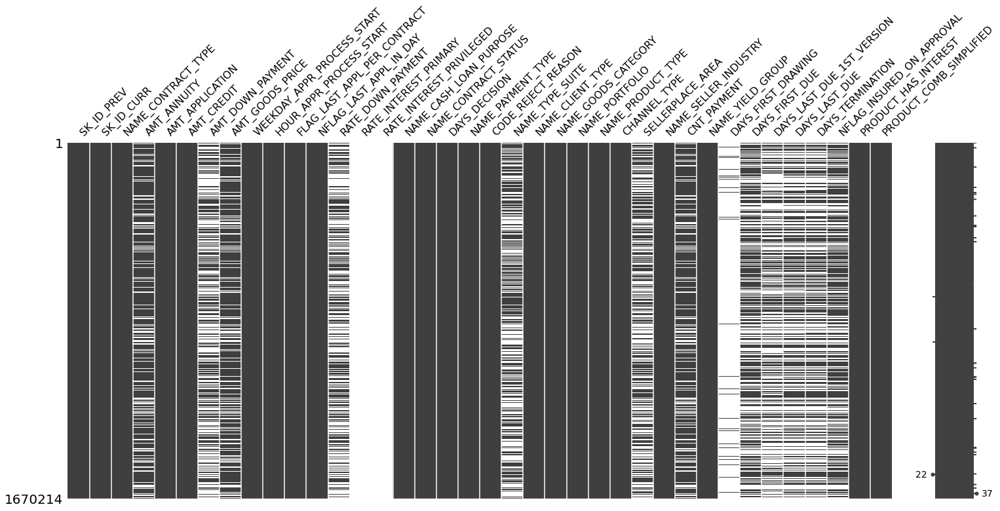

In [44]:
# Visualisation des valeurs manquantes à l'aide d'un graphique.

plot_missing_values(df_previous_app.iloc[:, :],
                    use_missingno= 'matrix',
                    height=1000
                    )

In [45]:
# Calcul du nombre et du pourcentage de valeurs manquantes pour l'ensemble du dataframe.

summarize_missing_values(df_previous_app)

'Le DataFrame contient 13602490 valeurs manquantes sur 63468132 observations, soit 21.43%.'

- On peut voir ici que l'on a pas mal de variables avec plus de 50 % de valeurs manquantes et surtout 3 d'entres elles recensent plus de 90 % de valeurs manquantes que l'on peut supprimer avant la séparation et l'imputation des données.

In [46]:
# Suppression des colonnes présentant un nombre trop important de valeurs manquantes.

df_previous_app = df_previous_app.drop(columns=['RATE_INTEREST_PRIMARY', 'RATE_INTEREST_PRIVILEGED', 'DAYS_FIRST_DRAWING'])

In [47]:
# Vérification des changements apportées.

df_previous_app.columns.intersection(['RATE_INTEREST_PRIMARY', 'RATE_INTEREST_PRIVILEGED', 'DAYS_FIRST_DRAWING'])

Index([], dtype='object')

- On peut ainsi passer à la séparation des données et regarder de nouveau les valeurs manquantes afin de vérifier si il y a des différences majeures entre les deux datasets avant imputation.

In [48]:
# Séparation des données train et test avant imputation.

df_previous_app_train = df_previous_app[df_previous_app['SK_ID_CURR'].isin(df_appli_train['SK_ID_CURR'])]
df_previous_app_test  = df_previous_app[df_previous_app['SK_ID_CURR'].isin(df_appli_test['SK_ID_CURR'])]

In [49]:
print_dataframe_shape(df_previous_app_train)

Le DataFrame contient 1,413,701 lignes et 35 colonnes.


In [50]:
print_dataframe_shape(df_previous_app_test)

Le DataFrame contient 256,513 lignes et 35 colonnes.


In [51]:
# Calcul du nombre et du pourcentage de valeurs manquantes pour chaque colonne.

calculate_missing_values(df_previous_app_train)

,Nbr_valeurs_manquantes,Pct_valeurs_manquantes
DAYS_LAST_DUE_1ST_VERSION,834743,59.046644
DAYS_TERMINATION,755106,53.413416
AMT_DOWN_PAYMENT,749540,53.019698
RATE_DOWN_PAYMENT,749540,53.019698
DAYS_LAST_DUE,741898,52.479131
NAME_TYPE_SUITE,694672,49.138538
SELLERPLACE_AREA,636583,45.029536
DAYS_FIRST_DUE,595068,42.092918
NFLAG_INSURED_ON_APPROVAL,561106,39.690571
AMT_GOODS_PRICE,319525,22.602021


In [52]:
# Calcul du nombre et du pourcentage de valeurs manquantes pour chaque colonne.

calculate_missing_values(df_previous_app_test)

,Nbr_valeurs_manquantes,Pct_valeurs_manquantes
DAYS_LAST_DUE_1ST_VERSION,156578,61.040961
AMT_DOWN_PAYMENT,146304,57.035706
RATE_DOWN_PAYMENT,146304,57.035706
DAYS_TERMINATION,143872,56.087606
DAYS_LAST_DUE,142388,55.509078
SELLERPLACE_AREA,126092,49.156183
NAME_TYPE_SUITE,125733,49.016229
DAYS_FIRST_DUE,118642,46.251847
NFLAG_INSURED_ON_APPROVAL,111959,43.646521
AMT_GOODS_PRICE,65990,25.725792


- Il y a peu de différence entre les deux datasets donc on peut passer à la suite.

In [5]:
# Mise en place d'une fonction permettant de créer les datasets suivant les différentes configurations.

def create_datasets(
    df, 
    cat_cols, 
    num_cols, 
    setups=("median_mode", "median_missing", "iterative_mode", "nan_missing"),  
    random_state=42
):
    """
    Crée des variantes du dataset selon différentes stratégies d’imputation.
    Pour chaque stratégie : 
    
      - version "tree" (avec flags, adaptée aux modèles non-linéaires/arbres)
      - version "linear" (sans flags, adaptée aux modèles linéaires)
    
    Paramètres:
        df : DataFrame initial
        cat_cols : liste des colonnes catégorielles
        num_cols : liste des colonnes numériques
        setups : tuple/list des setups à créer
        random_state : pour reproductibilité de l'IterativeImputer
    
    Retourne:
        dict : dictionnaire avec les DataFrames demandés
    """
    datasets = {}
    df = df.copy()

    for setup in setups:
        if setup == "median_mode":
            df1 = df.copy()
            # --- flags
            flags_num = {col + "_was_missing": df1[col].isna().astype(int) for col in num_cols if col in df1}
            flags_cat = {col + "_was_missing": df1[col].isna().astype(int) for col in cat_cols if col in df1}
            for col in num_cols:
                if col in df1:
                    df1[col] = df1[col].fillna(df1[col].median())
            for col in cat_cols:
                if col in df1:
                    df1[col] = df1[col].fillna(df1[col].mode()[0])

            # version tree
            df_tree = pd.concat([df1, pd.DataFrame({**flags_num, **flags_cat})], axis=1).copy()
            datasets["median_mode_tree"] = df_tree
            # version linear (sans flags)
            datasets["median_mode_linear"] = df1.copy()

        elif setup == "median_missing":
            df2 = df.copy()
            flags_num = {col + "_was_missing": df2[col].isna().astype(int) for col in num_cols if col in df2}
            flags_cat = {col + "_was_missing": df2[col].isna().astype(int) for col in cat_cols if col in df2}
            for col in num_cols:
                if col in df2:
                    df2[col] = df2[col].fillna(df2[col].median())
            for col in cat_cols:
                if col in df2:
                    df2[col] = df2[col].fillna("MISSING")

            df_tree = pd.concat([df2, pd.DataFrame({**flags_num, **flags_cat})], axis=1).copy()
            datasets["median_missing_tree"] = df_tree
            datasets["median_missing_linear"] = df2.copy()

        elif setup == "iterative_mode":
            df3 = df.copy()
            flags_num = {col + "_was_missing": df3[col].isna().astype(int) for col in num_cols if col in df3}
            flags_cat = {col + "_was_missing": df3[col].isna().astype(int) for col in cat_cols if col in df3}
            iterative_imputer = IterativeImputer(random_state=random_state)
            df3[num_cols] = iterative_imputer.fit_transform(df3[num_cols])
            for col in cat_cols:
                if col in df3:
                    df3[col] = df3[col].fillna(df3[col].mode()[0])

            df_tree = pd.concat([df3, pd.DataFrame({**flags_num, **flags_cat})], axis=1).copy()
            datasets["iterative_mode_tree"] = df_tree
            datasets["iterative_mode_linear"] = df3.copy()

        elif setup == "nan_missing":
            df4 = df.copy()
            flags_num = {col + "_was_missing": df4[col].isna().astype(int) for col in num_cols if col in df4}
            flags_cat = {col + "_was_missing": df4[col].isna().astype(int) for col in cat_cols if col in df4}
            for col in cat_cols:
                if col in df4:
                    df4[col] = df4[col].fillna("MISSING")

            df_tree = pd.concat([df4, pd.DataFrame({**flags_num, **flags_cat})], axis=1).copy()
            datasets["nan_missing_tree"] = df_tree
            datasets["nan_missing_linear"] = df4.copy()

    return datasets

In [55]:
# Création des datasets suivant les différentes configurations.

cat_cols = df_previous_app.select_dtypes(include=["object"]).columns.tolist()
num_cols = df_previous_app.select_dtypes(exclude=["object"]).columns.tolist()

datasets_previous_train = create_datasets(df_previous_app_train, cat_cols, num_cols, setups=("median_mode", "median_missing", "iterative_mode", "nan_missing"))
datasets_previous_test = create_datasets(df_previous_app_test, cat_cols, num_cols, setups=("median_mode", "median_missing", "iterative_mode", "nan_missing"))

c:\Users\Caomghin\anaconda3\lib\site-packages\sklearn\impute\_iterative.py:825: ConvergenceWarning:

[IterativeImputer] Early stopping criterion not reached.

c:\Users\Caomghin\anaconda3\lib\site-packages\sklearn\impute\_iterative.py:825: ConvergenceWarning:

[IterativeImputer] Early stopping criterion not reached.



In [56]:
# On assigne chaque setup à un dataframe.

# Versions pour modèles linéaires (régression logistique, Lasso, Ridge, etc.)
df_previous_train_median_mode_linear = datasets_previous_train["median_mode_linear"]
df_previous_train_median_missing_linear = datasets_previous_train["median_missing_linear"]
df_previous_train_iterative_mode_linear = datasets_previous_train["iterative_mode_linear"]
df_previous_train_nan_missing_linear = datasets_previous_train["nan_missing_linear"]

# Versions pour modèles non-linéaires (arbres, LightGBM, RF, XGB, etc.)
df_previous_train_median_mode = datasets_previous_train["median_mode_tree"]
df_previous_train_median_missing = datasets_previous_train["median_missing_tree"]
df_previous_train_iterative_mode = datasets_previous_train["iterative_mode_tree"]
df_previous_train_nan_missing = datasets_previous_train["nan_missing_tree"]


# Versions pour modèles linéaires (régression logistique, Lasso, Ridge, etc.)
df_previous_test_median_mode_linear = datasets_previous_test["median_mode_linear"]
df_previous_test_median_missing_linear = datasets_previous_test["median_missing_linear"]
df_previous_test_iterative_mode_linear = datasets_previous_test["iterative_mode_linear"]
df_previous_test_nan_missing_linear = datasets_previous_test["nan_missing_linear"]

# Versions pour modèles non-linéaires (arbres, LightGBM, RF, XGB, etc.)
df_previous_test_median_mode = datasets_previous_test["median_mode_tree"]
df_previous_test_median_missing = datasets_previous_test["median_missing_tree"]
df_previous_test_iterative_mode = datasets_previous_test["iterative_mode_tree"]
df_previous_test_nan_missing = datasets_previous_test["nan_missing_tree"]

In [57]:
# Calcul du nombre et du pourcentage de valeurs manquantes restantes pour ces nouveaux dataframes.

print(summarize_missing_values(df_previous_train_median_mode_linear))
print(summarize_missing_values(df_previous_train_median_missing_linear))
print(summarize_missing_values(df_previous_train_iterative_mode_linear))
print(summarize_missing_values(df_previous_train_nan_missing_linear))

Le DataFrame contient 0 valeurs manquantes sur 49479535 observations, soit 0.00%.
Le DataFrame contient 0 valeurs manquantes sur 49479535 observations, soit 0.00%.
Le DataFrame contient 0 valeurs manquantes sur 49479535 observations, soit 0.00%.
Le DataFrame contient 6557541 valeurs manquantes sur 49479535 observations, soit 13.25%.


In [58]:
print(summarize_missing_values(df_previous_test_median_mode_linear))
print(summarize_missing_values(df_previous_test_median_missing_linear))
print(summarize_missing_values(df_previous_test_iterative_mode_linear))
print(summarize_missing_values(df_previous_test_nan_missing_linear))

Le DataFrame contient 0 valeurs manquantes sur 8977955 observations, soit 0.00%.
Le DataFrame contient 0 valeurs manquantes sur 8977955 observations, soit 0.00%.
Le DataFrame contient 0 valeurs manquantes sur 8977955 observations, soit 0.00%.
Le DataFrame contient 1288163 valeurs manquantes sur 8977955 observations, soit 14.35%.


In [59]:
# Optimisation des types de variables et de la mémoire du dataframe.

optimize_types(df_previous_train_median_mode_linear)
optimize_types(df_previous_train_median_missing_linear)
optimize_types(df_previous_train_iterative_mode_linear)
optimize_types(df_previous_train_nan_missing_linear)
optimize_types(df_previous_train_median_mode)
optimize_types(df_previous_train_median_missing)
optimize_types(df_previous_train_iterative_mode)
optimize_types(df_previous_train_nan_missing)

 Mémoire avant : 1606.19 MB
 Mémoire après : 1509.12 MB
 Gain : 6.0%
 Mémoire avant : 1602.22 MB
 Mémoire après : 1505.15 MB
 Gain : 6.1%
 Mémoire avant : 1611.59 MB
 Mémoire après : 1509.12 MB
 Gain : 6.4%
 Mémoire avant : 1602.22 MB
 Mémoire après : 1514.58 MB
 Gain : 5.5%
 Mémoire avant : 1794.94 MB
 Mémoire après : 1697.87 MB
 Gain : 5.4%
 Mémoire avant : 1790.97 MB
 Mémoire après : 1693.90 MB
 Gain : 5.4%
 Mémoire avant : 1800.33 MB
 Mémoire après : 1697.87 MB
 Gain : 5.7%
 Mémoire avant : 1790.97 MB
 Mémoire après : 1703.33 MB
 Gain : 4.9%


,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,...,CODE_REJECT_REASON_was_missing,NAME_TYPE_SUITE_was_missing,NAME_CLIENT_TYPE_was_missing,NAME_GOODS_CATEGORY_was_missing,NAME_PORTFOLIO_was_missing,NAME_PRODUCT_TYPE_was_missing,CHANNEL_TYPE_was_missing,NAME_SELLER_INDUSTRY_was_missing,NAME_YIELD_GROUP_was_missing,PRODUCT_COMB_SIMPLIFIED_was_missing
0,2030495,271877,Consumer loans,1730.430054,17145.0,17145.0,0.0,17145.0,SATURDAY,15,...,0,1,0,0,0,0,0,0,0,0
1,2802425,108129,Cash loans,25188.615234,607500.0,679671.0,NaN,607500.0,THURSDAY,11,...,0,0,0,0,0,0,0,0,0,0
2,2523466,122040,Cash loans,15060.735352,112500.0,136444.5,NaN,112500.0,TUESDAY,11,...,0,0,0,0,0,0,0,0,0,0
3,2819243,176158,Cash loans,47041.335938,450000.0,470790.0,NaN,450000.0,MONDAY,7,...,0,1,0,0,0,0,0,0,0,0
4,1784265,202054,Cash loans,31924.394531,337500.0,404055.0,NaN,337500.0,THURSDAY,9,...,0,1,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1670207,1662353,443544,Cash loans,12607.875000,112500.0,112500.0,0.0,112500.0,MONDAY,10,...,0,0,0,0,0,0,0,0,0,0
1670208,1556789,209732,Cash loans,22299.390625,315000.0,436216.5,NaN,315000.0,THURSDAY,17,...,0,0,0,0,0,0,0,0,0,0
1670211,2659632,249544,Consumer loans,11520.855469,105237.0,102523.5,10525.5,105237.0,MONDAY,12,...,0,0,0,0,0,0,0,0,0,0
1670212,2785582,400317,Cash loans,18821.519531,180000.0,191880.0,NaN,180000.0,WEDNESDAY,9,...,0,0,0,0,0,0,0,0,0,0


In [60]:
# Optimisation des types de variables et de la mémoire du dataframe.

optimize_types(df_previous_test_median_mode_linear)
optimize_types(df_previous_test_median_missing_linear)
optimize_types(df_previous_test_iterative_mode_linear)
optimize_types(df_previous_test_nan_missing_linear)
optimize_types(df_previous_test_median_mode)
optimize_types(df_previous_test_median_missing)
optimize_types(df_previous_test_iterative_mode)
optimize_types(df_previous_test_nan_missing)

 Mémoire avant : 291.15 MB
 Mémoire après : 273.53 MB
 Gain : 6.0%
 Mémoire avant : 290.43 MB
 Mémoire après : 272.81 MB
 Gain : 6.1%
 Mémoire avant : 292.13 MB
 Mémoire après : 273.53 MB
 Gain : 6.4%
 Mémoire avant : 290.43 MB
 Mémoire après : 274.53 MB
 Gain : 5.5%
 Mémoire avant : 325.39 MB
 Mémoire après : 307.78 MB
 Gain : 5.4%
 Mémoire avant : 324.68 MB
 Mémoire après : 307.06 MB
 Gain : 5.4%
 Mémoire avant : 326.37 MB
 Mémoire après : 307.78 MB
 Gain : 5.7%
 Mémoire avant : 324.68 MB
 Mémoire après : 308.77 MB
 Gain : 4.9%


,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,...,CODE_REJECT_REASON_was_missing,NAME_TYPE_SUITE_was_missing,NAME_CLIENT_TYPE_was_missing,NAME_GOODS_CATEGORY_was_missing,NAME_PORTFOLIO_was_missing,NAME_PRODUCT_TYPE_was_missing,CHANNEL_TYPE_was_missing,NAME_SELLER_INDUSTRY_was_missing,NAME_YIELD_GROUP_was_missing,PRODUCT_COMB_SIMPLIFIED_was_missing
13,1397919,321676,Consumer loans,7654.859863,53779.5,57564.0,0.0,53779.5,SUNDAY,15,...,0,0,0,0,0,0,0,0,0,0
14,2273188,270658,Consumer loans,9644.219727,26550.0,27252.0,0.0,26550.0,SATURDAY,10,...,0,1,0,0,0,0,0,0,0,0
17,1285768,142748,Revolving loans,9000.000000,180000.0,180000.0,NaN,180000.0,FRIDAY,13,...,0,0,0,0,0,0,0,0,0,0
26,2536650,338725,Cash loans,16708.320312,369000.0,369000.0,NaN,369000.0,WEDNESDAY,13,...,0,1,0,0,0,0,0,0,0,0
31,2191093,182450,Consumer loans,9789.254883,100485.0,100485.0,0.0,100485.0,WEDNESDAY,9,...,0,1,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1670179,2711219,433779,Cash loans,NaN,0.0,0.0,NaN,NaN,FRIDAY,11,...,0,1,0,0,0,0,0,0,0,0
1670181,2710915,144881,Cash loans,9590.400391,180000.0,180000.0,NaN,180000.0,THURSDAY,9,...,0,0,0,0,0,0,0,0,0,0
1670198,1540903,212968,Consumer loans,2088.495117,22869.0,20578.5,2290.5,22869.0,SUNDAY,16,...,0,1,0,0,0,0,0,0,0,0
1670209,2300464,352015,Consumer loans,14704.290039,267295.5,311400.0,0.0,267295.5,WEDNESDAY,12,...,0,1,0,0,0,0,0,0,0,0


In [61]:
# Visualisation des variables à encoder pour les dataframes utilisant le mode (2 dataframes).

binary_categorical = [col for col in df_previous_train_median_mode_linear.columns 
                      if df_previous_train_median_mode_linear[col].dtype == 'object' and df_previous_train_median_mode_linear[col].nunique() == 2]

print("Variables catégorielles binaires :", binary_categorical)

Variables catégorielles binaires : ['FLAG_LAST_APPL_PER_CONTRACT']


In [62]:
# Visualisation des variables à encoder pour les dataframes utilisant missing ou des nan.

binary_categorical_miss = [col for col in df_previous_train_nan_missing_linear.columns 
                      if df_previous_train_nan_missing_linear[col].dtype == 'object' and df_previous_train_nan_missing_linear[col].nunique() == 2]

print("Variables catégorielles binaires :", binary_categorical_miss)

Variables catégorielles binaires : ['FLAG_LAST_APPL_PER_CONTRACT']


In [63]:
df_previous_train_median_mode_linear['FLAG_LAST_APPL_PER_CONTRACT'].unique()

array(['Y', 'N'], dtype=object)

In [64]:
# Encodage des variables catégorielles binaires avec LabelEncoder.

encoders = {}

# Liste des datasets concernés
datasets = [
    df_previous_train_median_mode_linear,
    df_previous_train_median_missing_linear,
    df_previous_train_iterative_mode_linear,
    df_previous_train_nan_missing_linear,
    df_previous_train_median_mode,
    df_previous_train_median_missing,
    df_previous_train_iterative_mode,
    df_previous_train_nan_missing,
    df_previous_test_median_mode_linear,
    df_previous_test_median_missing_linear,
    df_previous_test_iterative_mode_linear,
    df_previous_test_nan_missing_linear,
    df_previous_test_median_mode,
    df_previous_test_median_missing,
    df_previous_test_iterative_mode,
    df_previous_test_nan_missing
]

for col in binary_categorical:
    # Encodage avec la fonction générique
    dfs_encoded, le = label_encode(datasets, col)
    
    # Mise à jour des DataFrames originaux
    df_previous_train_median_mode_linear = dfs_encoded[0]
    df_previous_train_median_missing_linear = dfs_encoded[1]
    df_previous_train_iterative_mode_linear = dfs_encoded[2]
    df_previous_train_nan_missing_linear = dfs_encoded[3]
    df_previous_train_median_mode = dfs_encoded[4]
    df_previous_train_median_missing = dfs_encoded[5]
    df_previous_train_iterative_mode = dfs_encoded[6]
    df_previous_train_nan_missing = dfs_encoded[7]
    df_previous_test_median_mode_linear = dfs_encoded[8]
    df_previous_test_median_missing_linear = dfs_encoded[9]
    df_previous_test_iterative_mode_linear = dfs_encoded[10]
    df_previous_test_nan_missing_linear = dfs_encoded[11]
    df_previous_test_median_mode = dfs_encoded[12]
    df_previous_test_median_missing = dfs_encoded[13]
    df_previous_test_iterative_mode = dfs_encoded[14]
    df_previous_test_nan_missing = dfs_encoded[15]
    
    # Stocker l’encodeur pour usage futur
    encoders[col] = le

In [65]:
df_previous_app['FLAG_LAST_APPL_PER_CONTRACT'].unique()

array(['Y', 'N'], dtype=object)

In [66]:
# Changement des types des variables concernées.

for col in binary_categorical:
    for df in [
        df_previous_train_median_mode_linear, df_previous_train_median_missing_linear,
        df_previous_train_iterative_mode_linear, df_previous_train_nan_missing_linear,
        df_previous_train_median_mode, df_previous_train_median_missing,
        df_previous_train_iterative_mode, df_previous_train_nan_missing,
        df_previous_test_median_mode_linear, df_previous_test_median_missing_linear,
        df_previous_test_iterative_mode_linear, df_previous_test_nan_missing_linear,
        df_previous_test_median_mode, df_previous_test_median_missing,
        df_previous_test_iterative_mode, df_previous_test_nan_missing
    ]:
        if col in df.columns:
            df[col] = df[col].astype(int)

- Puis pour les variables catégorielles restantes, on utilisera de nouveau One Hot Encoder pour les variables dont le nombre de modalités uniques n'est pas supérieur à 10.

In [67]:
# Visualisation des variables à encoder avec One Hot Encoder.

ohe_var = [col for col in df_previous_train_median_mode_linear.columns 
                      if df_previous_train_median_mode_linear[col].dtype == 'object' and df_previous_train_median_mode_linear[col].nunique() <= 10]

print("""Variables catégorielles avec One Hot Encoder :\n""")
pprint.pprint(ohe_var)

Variables catégorielles avec One Hot Encoder :

['NAME_CONTRACT_TYPE',
 'WEEKDAY_APPR_PROCESS_START',
 'NAME_CASH_LOAN_PURPOSE',
 'NAME_CONTRACT_STATUS',
 'NAME_PAYMENT_TYPE',
 'CODE_REJECT_REASON',
 'NAME_TYPE_SUITE',
 'NAME_CLIENT_TYPE',
 'NAME_GOODS_CATEGORY',
 'NAME_PORTFOLIO',
 'NAME_PRODUCT_TYPE',
 'CHANNEL_TYPE',
 'NAME_SELLER_INDUSTRY',
 'NAME_YIELD_GROUP',
 'PRODUCT_COMB_SIMPLIFIED']


In [68]:
df_previous_train_median_mode_linear.select_dtypes(include='object').nunique()

NAME_CONTRACT_TYPE             4
WEEKDAY_APPR_PROCESS_START     7
NAME_CASH_LOAN_PURPOSE         4
NAME_CONTRACT_STATUS           4
NAME_PAYMENT_TYPE              4
CODE_REJECT_REASON             9
NAME_TYPE_SUITE                7
NAME_CLIENT_TYPE               4
NAME_GOODS_CATEGORY           10
NAME_PORTFOLIO                 5
NAME_PRODUCT_TYPE              3
CHANNEL_TYPE                   7
NAME_SELLER_INDUSTRY           8
NAME_YIELD_GROUP               5
PRODUCT_COMB_SIMPLIFIED        7
dtype: int64

In [69]:
# Visualisation des variables à encoder avec One Hot Encoder (dataframes utilisant missing).

ohe_var_miss = [col for col in df_previous_train_nan_missing_linear.columns 
                      if df_previous_train_nan_missing_linear[col].dtype == 'object' and df_previous_train_nan_missing_linear[col].nunique() <= 10]

print("""Variables catégorielles avec One Hot Encoder :\n""")
pprint.pprint(ohe_var_miss)

Variables catégorielles avec One Hot Encoder :

['NAME_CONTRACT_TYPE',
 'WEEKDAY_APPR_PROCESS_START',
 'NAME_CASH_LOAN_PURPOSE',
 'NAME_CONTRACT_STATUS',
 'NAME_PAYMENT_TYPE',
 'CODE_REJECT_REASON',
 'NAME_TYPE_SUITE',
 'NAME_CLIENT_TYPE',
 'NAME_GOODS_CATEGORY',
 'NAME_PORTFOLIO',
 'NAME_PRODUCT_TYPE',
 'CHANNEL_TYPE',
 'NAME_SELLER_INDUSTRY',
 'NAME_YIELD_GROUP',
 'PRODUCT_COMB_SIMPLIFIED']


In [70]:
df_previous_train_nan_missing_linear.select_dtypes(include='object').nunique()

NAME_CONTRACT_TYPE             4
WEEKDAY_APPR_PROCESS_START     7
NAME_CASH_LOAN_PURPOSE         4
NAME_CONTRACT_STATUS           4
NAME_PAYMENT_TYPE              4
CODE_REJECT_REASON             9
NAME_TYPE_SUITE                8
NAME_CLIENT_TYPE               4
NAME_GOODS_CATEGORY           10
NAME_PORTFOLIO                 5
NAME_PRODUCT_TYPE              3
CHANNEL_TYPE                   7
NAME_SELLER_INDUSTRY           8
NAME_YIELD_GROUP               5
PRODUCT_COMB_SIMPLIFIED        8
dtype: int64

In [71]:
#Encodage des variables catégorielles avec One Hot Encoder.


# Liste des datasets à encoder
datasets_linear = [
    df_previous_train_median_missing_linear,
    df_previous_train_median_mode_linear,
    df_previous_train_iterative_mode_linear,
    df_previous_train_nan_missing_linear,
    df_previous_test_median_mode_linear,
    df_previous_test_median_missing_linear,
    df_previous_test_iterative_mode_linear,
    df_previous_test_nan_missing_linear
]

# Application du One-Hot Encoding sur tous les datasets linear
encoded_ohe_linear = one_hot_encode(datasets_linear, columns=ohe_var, drop_first=True)

df_previous_train_median_missing_linear = encoded_ohe_linear[0]
df_previous_train_median_mode_linear = encoded_ohe_linear[1]
df_previous_train_iterative_mode_linear = encoded_ohe_linear[2]
df_previous_train_nan_missing_linear = encoded_ohe_linear[3]
df_previous_test_median_mode_linear = encoded_ohe_linear[4]
df_previous_test_median_missing_linear = encoded_ohe_linear[5]
df_previous_test_iterative_mode_linear = encoded_ohe_linear[6]
df_previous_test_nan_missing_linear = encoded_ohe_linear[7]

# Liste des datasets à encoder
datasets = [
    df_previous_train_median_missing,
    df_previous_train_median_mode,
    df_previous_train_iterative_mode,
    df_previous_train_nan_missing,
    df_previous_test_median_mode,
    df_previous_test_median_missing,
    df_previous_test_iterative_mode,
    df_previous_test_nan_missing
]

# Application du One-Hot Encoding sur tous les datasets restants
encoded_ohe = one_hot_encode(datasets, columns=ohe_var, drop_first=False)

df_previous_train_median_missing = encoded_ohe[0]
df_previous_train_median_mode = encoded_ohe[1]
df_previous_train_iterative_mode = encoded_ohe[2]
df_previous_train_nan_missing = encoded_ohe[3]
df_previous_test_median_mode = encoded_ohe[4]
df_previous_test_median_missing = encoded_ohe[5]
df_previous_test_iterative_mode = encoded_ohe[6]
df_previous_test_nan_missing = encoded_ohe[7]

In [72]:
df_previous_train_median_missing_linear.loc[:, df_previous_train_median_missing_linear.columns.str.contains('PRODUCT_COMB_SIMPLIFIED')]

,PRODUCT_COMB_SIMPLIFIED_card,PRODUCT_COMB_SIMPLIFIED_cash,PRODUCT_COMB_SIMPLIFIED_pos_household,PRODUCT_COMB_SIMPLIFIED_pos_industry,PRODUCT_COMB_SIMPLIFIED_pos_mobile,PRODUCT_COMB_SIMPLIFIED_pos_others,PRODUCT_COMB_SIMPLIFIED_x_sell
0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,0.0,0.0,0.0,0.0,0.0,0.0,1.0
3,0.0,0.0,0.0,0.0,0.0,0.0,1.0
4,0.0,1.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...
1670207,0.0,1.0,0.0,0.0,0.0,0.0,0.0
1670208,0.0,0.0,0.0,0.0,0.0,0.0,1.0
1670211,0.0,0.0,1.0,0.0,0.0,0.0,0.0
1670212,0.0,0.0,0.0,0.0,0.0,0.0,1.0


In [73]:
df_previous_train_median_missing.loc[:, df_previous_train_median_missing.columns.str.contains('PRODUCT_COMB_SIMPLIFIED')]

,PRODUCT_COMB_SIMPLIFIED_was_missing,PRODUCT_COMB_SIMPLIFIED_MISSING,PRODUCT_COMB_SIMPLIFIED_card,PRODUCT_COMB_SIMPLIFIED_cash,PRODUCT_COMB_SIMPLIFIED_pos_household,PRODUCT_COMB_SIMPLIFIED_pos_industry,PRODUCT_COMB_SIMPLIFIED_pos_mobile,PRODUCT_COMB_SIMPLIFIED_pos_others,PRODUCT_COMB_SIMPLIFIED_x_sell
0,0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
1,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
3,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
4,0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...
1670207,0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
1670208,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
1670211,0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
1670212,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


On peut ensuite passer à la création de nouvelles features à partir de celles à notre disposition dans ce dataframe.

In [74]:
def add_previous_application_features(df):

    """
    Ajoute des features dérivées au dataset previous_application.csv de Home Credit Default Risk.
    df : DataFrame pandas
    """

    # Ratios financiers 
    df["PREV_APP_CREDIT_RATIO"] = df["AMT_APPLICATION"] / (df["AMT_CREDIT"] + 1e-6)
    df["PREV_CREDIT_GOODS_RATIO"] = df["AMT_CREDIT"] / (df["AMT_GOODS_PRICE"] + 1e-6)
    df["PREV_APP_GOODS_RATIO"] = df["AMT_APPLICATION"] / (df["AMT_GOODS_PRICE"] + 1e-6)
    df["PREV_ANNUITY_CREDIT_RATIO"] = df["AMT_ANNUITY"] / (df["AMT_CREDIT"] + 1e-6)
    df["PREV_CREDIT_PER_PAYMENT"] = df["AMT_CREDIT"] / (df["CNT_PAYMENT"] + 1e-6)
    df["PREV_DOWNPAYMENT_RATIO"] = df["AMT_DOWN_PAYMENT"] / (df["AMT_CREDIT"] + 1e-6)

    # Différences et interactions 
    df["AMT_DIFF_CREDIT_GOODS"] = df["AMT_CREDIT"] - df["AMT_GOODS_PRICE"]
    df["AMT_REMAINING_AFTER_DOWNPAY"] = df["AMT_GOODS_PRICE"] - df["AMT_DOWN_PAYMENT"]

    # Temporalité
    df["PREV_FIRST_DUE_DELAY"] = df["DAYS_FIRST_DUE"] - df["DAYS_DECISION"]
    df["PREV_LAST_DUE_DELAY"] = df["DAYS_LAST_DUE"] - df["DAYS_DECISION"]
    df["PREV_DURATION_FIRST_VERSION"] = df["DAYS_LAST_DUE_1ST_VERSION"] - df["DAYS_FIRST_DUE"]
    df["PREV_DURATION_ESTIMATED"] = df["DAYS_LAST_DUE"] - df["DAYS_FIRST_DUE"]
    df["DECISION_RECENCY"] = -df["DAYS_DECISION"]
    df["PREV_IS_RECENT"] = (df["DAYS_DECISION"] > -365).astype(int)

    # Flags
    df["IS_DOWNPAYMENT"] = (df["AMT_DOWN_PAYMENT"] > 0).astype(int)
    df["IS_CREDIT_OVER_GOODS"] = (df["AMT_CREDIT"] > df["AMT_GOODS_PRICE"]).astype(int)

    # Nettoyage rapide
    df.replace([np.inf, -np.inf], np.nan, inplace=True)


In [75]:
# Ajout des nouvelles variables à l'aide la fonction créée précédemment.

for df in [
        df_previous_train_median_mode_linear, df_previous_train_median_missing_linear,
        df_previous_train_iterative_mode_linear, df_previous_train_nan_missing_linear,
        df_previous_train_median_mode, df_previous_train_median_missing,
        df_previous_train_iterative_mode, df_previous_train_nan_missing,
        df_previous_test_median_mode_linear, df_previous_test_median_missing_linear,
        df_previous_test_iterative_mode_linear, df_previous_test_nan_missing_linear,
        df_previous_test_median_mode, df_previous_test_median_missing,
        df_previous_test_iterative_mode, df_previous_test_nan_missing
    ]:

    add_previous_application_features(df)

In [76]:
df_previous_train_median_mode_linear.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1413701 entries, 0 to 1670213
Columns: 111 entries, SK_ID_PREV to IS_CREDIT_OVER_GOODS
dtypes: float32(13), float64(76), int32(22)
memory usage: 1019.2 MB


- Pour finir on passe à l'agrégation des données pour chaque client puisqu'il peut y avoir plusieurs lignes par client or comme précédemment on cherche à merge ces données avec les données principales d'application train/test qui contient une ligne par client.

In [76]:
'''def aggregate_previous_application(df):

    """
    Agrège le dataframe previous_application au niveau SK_ID_CURR.

    """

    data = df.copy()

    # Colonnes à exclure
    exclude_cols = ["SK_ID_PREV"]

    # Colonnes _was_missing
    was_missing_cols = [c for c in data.columns if c.endswith("_was_missing")]

    # Colonnes OHE
    ohe_cols = [
            c for c in data.columns
            if any(c.startswith(prefix) for prefix in ohe_var)
    ]

    # Colonnes numériques normales
    numeric_cols = [
        c for c in data.columns
        if c not in exclude_cols + was_missing_cols + ohe_cols + ["SK_ID_CURR"]
    ]

    # Dictionnaire d’agrégation principal
    agg_dict = {
        # Montants
        'AMT_APPLICATION': ['mean', 'max', 'min'],
        'AMT_CREDIT': ['mean', 'max', 'sum'],
        'AMT_ANNUITY': ['mean', 'max'],
        'AMT_GOODS_PRICE': ['mean', 'max'],
        'AMT_DOWN_PAYMENT': ['mean', 'sum'],

        # Temporalité
        'DAYS_DECISION': ['mean', 'min', 'max'],
        'DAYS_FIRST_DUE': ['mean', 'min', 'max'],
        'DAYS_LAST_DUE': ['mean', 'min', 'max'],
        'DAYS_LAST_DUE_1ST_VERSION': ['mean', 'min', 'max'],
        'DAYS_TERMINATION': ['mean', 'min', 'max'],

        # Nouvelles features créées
        'PREV_APP_CREDIT_RATIO': ['mean', 'max'],
        'PREV_CREDIT_GOODS_RATIO': ['mean', 'max'],
        'PREV_APP_GOODS_RATIO': ['mean', 'max'],
        'PREV_ANNUITY_CREDIT_RATIO': ['mean', 'max'],
        'PREV_CREDIT_PER_PAYMENT': ['mean', 'max'],
        'PREV_DOWNPAYMENT_RATIO': ['mean', 'max'],

        'AMT_DIFF_CREDIT_GOODS': ['mean', 'max', 'min'],
        'AMT_REMAINING_AFTER_DOWNPAY': ['mean', 'max', 'min'],

        'PREV_FIRST_DUE_DELAY': ['mean', 'max'],
        'PREV_LAST_DUE_DELAY': ['mean', 'max'],
        'PREV_DURATION_FIRST_VERSION': ['mean', 'max'],
        'PREV_DURATION_ESTIMATED': ['mean', 'max'],

        'DECISION_RECENCY': ['mean', 'max'],
        'PREV_IS_RECENT': ['mean', 'sum'],  # proportion & nombre

        # Flags
        'IS_DOWNPAYMENT': ['mean', 'sum'],
        'IS_CREDIT_OVER_GOODS': ['mean', 'sum'],
    }

    # On garde seulement les colonnes existantes dans numeric_cols
    agg_dict = {k: v for k, v in agg_dict.items() if k in numeric_cols}

    # Agrégation principale
    prev_agg = data.groupby('SK_ID_CURR').agg(agg_dict)
    prev_agg.columns = [f"PREV_{col.upper()}_{stat.upper()}" for col, stat in prev_agg.columns]
    prev_agg.reset_index(inplace=True)

    # Agrégation des OHE
    if len(ohe_cols) > 0:
        ohe_agg = data.groupby('SK_ID_CURR')[ohe_cols].agg(['mean', 'sum'])
        ohe_agg.columns = [f"PREV_{col.upper()}_{stat.upper()}" for col, stat in ohe_agg.columns]
        ohe_agg.reset_index(inplace=True)
        prev_agg = prev_agg.merge(ohe_agg, on='SK_ID_CURR', how='left')

    # Agrégation des indicateurs de missing
    if len(was_missing_cols) > 0:
        missing_agg = data.groupby('SK_ID_CURR')[was_missing_cols].agg(['mean', 'sum'])
        missing_agg.columns = [f"PREV_{col.upper()}_{stat.upper()}" for col, stat in missing_agg.columns]
        missing_agg.reset_index(inplace=True)
        prev_agg = prev_agg.merge(missing_agg, on='SK_ID_CURR', how='left')

    # Ajout de certaines variables utiles après agrégation.
    prev_agg["PREV_NB_APPLICATIONS"] = data.groupby("SK_ID_CURR").size().values
    
    if "NAME_CONTRACT_STATUS_Approved" in data.columns:
        prev_agg["PREV_PCT_APPROVED"] = (
            data.groupby("SK_ID_CURR")["NAME_CONTRACT_STATUS_Approved"]
            .sum().fillna(0).values
        )
    if "NAME_CONTRACT_STATUS_Refused" in data.columns:
        prev_agg["PREV_NB_REFUSED"] = (
            data.groupby("SK_ID_CURR")["NAME_CONTRACT_STATUS_Refused"]
            .sum().fillna(0).values
        )

    prev_agg.replace([np.inf, -np.inf], np.nan, inplace=True)

    prev_agg = prev_agg.copy()

    print(f"Agrégation previous application — shape final : {prev_agg.shape}")
    return prev_agg'''

'def aggregate_previous_application(df):\n\n    """\n    Agrège le dataframe previous_application au niveau SK_ID_CURR.\n\n    """\n\n    data = df.copy()\n\n    # Colonnes à exclure\n    exclude_cols = ["SK_ID_PREV"]\n\n    # Colonnes _was_missing\n    was_missing_cols = [c for c in data.columns if c.endswith("_was_missing")]\n\n    # Colonnes OHE\n    ohe_cols = [\n            c for c in data.columns\n            if any(c.startswith(prefix) for prefix in ohe_var)\n    ]\n\n    # Colonnes numériques normales\n    numeric_cols = [\n        c for c in data.columns\n        if c not in exclude_cols + was_missing_cols + ohe_cols + ["SK_ID_CURR"]\n    ]\n\n    # Dictionnaire d’agrégation principal\n    agg_dict = {\n        # Montants\n        \'AMT_APPLICATION\': [\'mean\', \'max\', \'min\'],\n        \'AMT_CREDIT\': [\'mean\', \'max\', \'sum\'],\n        \'AMT_ANNUITY\': [\'mean\', \'max\'],\n        \'AMT_GOODS_PRICE\': [\'mean\', \'max\'],\n        \'AMT_DOWN_PAYMENT\': [\'mean\', \'su

In [77]:
def aggregate_previous_application(df):

    """
    Agrège le dataframe previous_application au niveau SK_ID_CURR.

    """

    data = df.copy()

    # Colonnes à exclure
    exclude_cols = ["SK_ID_PREV"]

    # Colonnes _was_missing
    was_missing_cols = [c for c in data.columns if c.endswith("_was_missing")]

    # Colonnes OHE
    ohe_cols = [
            c for c in data.columns
            if any(c.startswith(prefix) for prefix in ohe_var)
    ]

    # Colonnes numériques normales
    numeric_cols = [
        c for c in data.columns
        if c not in exclude_cols + was_missing_cols + ohe_cols + ["SK_ID_CURR"]
    ]

    # Dictionnaire d’agrégation principal
    agg_dict = {
        # Montants
        'AMT_APPLICATION': ['mean', 'max', 'min'],
        'AMT_CREDIT': ['mean', 'max', 'sum'],
        'AMT_ANNUITY': ['mean', 'max'],
        'AMT_GOODS_PRICE': ['mean', 'max'],
        'AMT_DOWN_PAYMENT': ['mean', 'sum'],

        # Temporalité
        'DAYS_DECISION': ['mean', 'min', 'max'],
        'DAYS_FIRST_DUE': ['mean', 'min', 'max'],
        'DAYS_LAST_DUE': ['mean', 'min', 'max'],
        'DAYS_LAST_DUE_1ST_VERSION': ['mean', 'min', 'max'],
        'DAYS_TERMINATION': ['mean', 'min', 'max'],

        # Nouvelles features créées
        'PREV_APP_CREDIT_RATIO': ['mean', 'max'],
        'PREV_CREDIT_GOODS_RATIO': ['mean', 'max'],
        'PREV_APP_GOODS_RATIO': ['mean', 'max'],
        'PREV_ANNUITY_CREDIT_RATIO': ['mean', 'max'],
        'PREV_CREDIT_PER_PAYMENT': ['mean', 'max'],
        'PREV_DOWNPAYMENT_RATIO': ['mean', 'max'],

        'AMT_DIFF_CREDIT_GOODS': ['mean', 'max', 'min'],
        'AMT_REMAINING_AFTER_DOWNPAY': ['mean', 'max', 'min'],

        'PREV_FIRST_DUE_DELAY': ['mean', 'max'],
        'PREV_LAST_DUE_DELAY': ['mean', 'max'],
        'PREV_DURATION_FIRST_VERSION': ['mean', 'max'],
        'PREV_DURATION_ESTIMATED': ['mean', 'max'],

        'DECISION_RECENCY': ['mean', 'max'],
        'PREV_IS_RECENT': ['mean', 'sum'],

        # Flags
        'IS_DOWNPAYMENT': ['mean', 'sum'],
        'IS_CREDIT_OVER_GOODS': ['mean', 'sum'],
    }

    # On garde seulement les colonnes existantes dans numeric_cols
    agg_dict = {k: v for k, v in agg_dict.items() if k in numeric_cols}

    # Agrégation principale
    numeric_agg = data.groupby('SK_ID_CURR').agg(agg_dict)
    numeric_agg.columns = [f"PREV_{col.upper()}_{stat.upper()}" for col, stat in numeric_agg.columns]
    numeric_agg.reset_index(inplace=True)

    dfs_to_concat = [numeric_agg]

    # Agrégation des OHE
    if len(ohe_cols) > 0:
        ohe_agg = data.groupby('SK_ID_CURR')[ohe_cols].agg(['mean', 'sum'])
        ohe_agg.columns = [f"PREV_{col.upper()}_{stat.upper()}" for col, stat in ohe_agg.columns]
        ohe_agg.reset_index(inplace=True)
        dfs_to_concat.append(ohe_agg)

    # Agrégation des indicateurs de missing
    if len(was_missing_cols) > 0:
        missing_agg = data.groupby('SK_ID_CURR')[was_missing_cols].agg(['mean', 'sum'])
        missing_agg.columns = [f"PREV_{col.upper()}_{stat.upper()}" for col, stat in missing_agg.columns]
        missing_agg.reset_index(inplace=True)
        dfs_to_concat.append(missing_agg)

    # Ajout des colonnes supplémentaires
    extra_df = pd.DataFrame({'SK_ID_CURR': data['SK_ID_CURR'].unique()})
    extra_df = extra_df.sort_values('SK_ID_CURR').reset_index(drop=True)
    
    extra_df['PREV_NB_APPLICATIONS'] = data.groupby('SK_ID_CURR').size().values
    
    if "NAME_CONTRACT_STATUS_Approved" in data.columns:
        extra_df['PREV_PCT_APPROVED'] = data.groupby('SK_ID_CURR')["NAME_CONTRACT_STATUS_Approved"].sum().fillna(0).values

    if "NAME_CONTRACT_STATUS_Refused" in data.columns:
        extra_df['PREV_NB_REFUSED'] = data.groupby('SK_ID_CURR')["NAME_CONTRACT_STATUS_Refused"].sum().fillna(0).values

    dfs_to_concat.append(extra_df)

    # Concaténation finale
    prev_agg = pd.concat(dfs_to_concat, axis=1)
    # Supprimer les colonnes SK_ID_CURR en double
    prev_agg = prev_agg.loc[:, ~prev_agg.columns.duplicated()]

    # Nettoyage inf / -inf
    prev_agg.replace([np.inf, -np.inf], np.nan, inplace=True)

    print(f"Agrégation previous application — shape final : {prev_agg.shape}")
    return prev_agg

In [78]:
# Agrégation des dataframes au niveau client.

df_previous_train_median_mode_linear_agg = aggregate_previous_application(df_previous_train_median_mode_linear)
df_previous_train_median_missing_linear_agg = aggregate_previous_application(df_previous_train_median_missing_linear)
df_previous_train_iterative_mode_linear_agg = aggregate_previous_application(df_previous_train_iterative_mode_linear)
df_previous_train_nan_missing_linear_agg = aggregate_previous_application(df_previous_train_nan_missing_linear)

df_previous_train_median_mode_agg = aggregate_previous_application(df_previous_train_median_mode)
df_previous_train_median_missing_agg = aggregate_previous_application(df_previous_train_median_missing)
df_previous_train_iterative_mode_agg = aggregate_previous_application(df_previous_train_iterative_mode)
df_previous_train_nan_missing_agg = aggregate_previous_application(df_previous_train_nan_missing)

df_previous_test_median_mode_linear_agg = aggregate_previous_application(df_previous_test_median_mode_linear)
df_previous_test_median_missing_linear_agg = aggregate_previous_application(df_previous_test_median_missing_linear)
df_previous_test_iterative_mode_linear_agg = aggregate_previous_application(df_previous_test_iterative_mode_linear)
df_previous_test_nan_missing_linear_agg = aggregate_previous_application(df_previous_test_nan_missing_linear)

df_previous_test_median_mode_agg = aggregate_previous_application(df_previous_test_median_mode)
df_previous_test_median_missing_agg = aggregate_previous_application(df_previous_test_median_missing)
df_previous_test_iterative_mode_agg = aggregate_previous_application(df_previous_test_iterative_mode)
df_previous_test_nan_missing_agg = aggregate_previous_application(df_previous_test_nan_missing)

Agrégation previous application — shape final : (291057, 214)
Agrégation previous application — shape final : (291057, 214)
Agrégation previous application — shape final : (291057, 214)
Agrégation previous application — shape final : (291057, 214)


C:\Users\Caomghin\AppData\Local\Temp/ipykernel_25940/2242007673.py:82: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



Agrégation previous application — shape final : (291057, 315)


C:\Users\Caomghin\AppData\Local\Temp/ipykernel_25940/2242007673.py:82: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



Agrégation previous application — shape final : (291057, 315)


C:\Users\Caomghin\AppData\Local\Temp/ipykernel_25940/2242007673.py:82: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



Agrégation previous application — shape final : (291057, 315)


C:\Users\Caomghin\AppData\Local\Temp/ipykernel_25940/2242007673.py:82: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



Agrégation previous application — shape final : (291057, 315)
Agrégation previous application — shape final : (47800, 214)
Agrégation previous application — shape final : (47800, 214)
Agrégation previous application — shape final : (47800, 214)
Agrégation previous application — shape final : (47800, 214)


C:\Users\Caomghin\AppData\Local\Temp/ipykernel_25940/2242007673.py:82: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



Agrégation previous application — shape final : (47800, 315)


C:\Users\Caomghin\AppData\Local\Temp/ipykernel_25940/2242007673.py:82: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



Agrégation previous application — shape final : (47800, 315)


C:\Users\Caomghin\AppData\Local\Temp/ipykernel_25940/2242007673.py:82: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



Agrégation previous application — shape final : (47800, 315)


C:\Users\Caomghin\AppData\Local\Temp/ipykernel_25940/2242007673.py:82: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



Agrégation previous application — shape final : (47800, 315)


In [82]:
# Merge final des pairs previous_app/application pour les datasets train

df_train_median_mode_linear = df_train_median_mode_linear.merge(
    df_previous_train_median_mode_linear_agg, on="SK_ID_CURR", how="left"
).fillna(0)

df_train_median_missing_linear = df_train_median_missing_linear.merge(
    df_previous_train_median_missing_linear_agg, on="SK_ID_CURR", how="left"
).fillna(0)

df_train_iterative_mode_linear = df_train_iterative_mode_linear.merge(
    df_previous_train_iterative_mode_linear_agg, on="SK_ID_CURR", how="left"
).fillna(0)

df_train_nan_missing_linear = df_train_nan_missing_linear.merge(
    df_previous_train_nan_missing_linear_agg, on="SK_ID_CURR", how="left"
)

df_train_median_mode = df_train_median_mode.merge(
    df_previous_train_median_mode_agg, on="SK_ID_CURR", how="left"
)

df_train_median_missing = df_train_median_missing.merge(
    df_previous_train_median_missing_agg, on="SK_ID_CURR", how="left"
)

df_train_iterative_mode = df_train_iterative_mode.merge(
    df_previous_train_iterative_mode_agg, on="SK_ID_CURR", how="left"
)

df_train_nan_missing = df_train_nan_missing.merge(
    df_previous_train_nan_missing_agg, on="SK_ID_CURR", how="left"
)

# Merge final des pairs previous_app/application pour les datasets test

df_test_median_mode_linear = df_test_median_mode_linear.merge(
    df_previous_test_median_mode_linear_agg, on="SK_ID_CURR", how="left"
).fillna(0)

df_test_median_missing_linear = df_test_median_missing_linear.merge(
    df_previous_test_median_missing_linear_agg, on="SK_ID_CURR", how="left"
).fillna(0)

df_test_iterative_mode_linear = df_test_iterative_mode_linear.merge(
    df_previous_test_iterative_mode_linear_agg, on="SK_ID_CURR", how="left"
).fillna(0)

df_test_nan_missing_linear = df_test_nan_missing_linear.merge(
    df_previous_test_nan_missing_linear_agg, on="SK_ID_CURR", how="left"
)

df_test_median_mode = df_test_median_mode.merge(
    df_previous_test_median_mode_agg, on="SK_ID_CURR", how="left"
)

df_test_median_missing = df_test_median_missing.merge(
    df_previous_test_median_missing_agg, on="SK_ID_CURR", how="left"
)

df_test_iterative_mode = df_test_iterative_mode.merge(
    df_previous_test_iterative_mode_agg, on="SK_ID_CURR", how="left"
)

df_test_nan_missing = df_test_nan_missing.merge(
    df_previous_test_nan_missing_agg, on="SK_ID_CURR", how="left"
)

In [83]:
# Visualisation des changements apportés.

df_train_median_mode_linear.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_ANNUITY,REGION_POPULATION_RELATIVE,OWN_CAR_AGE,FLAG_MOBIL,...,PREV_PRODUCT_COMB_SIMPLIFIED_POS_INDUSTRY_MEAN,PREV_PRODUCT_COMB_SIMPLIFIED_POS_INDUSTRY_SUM,PREV_PRODUCT_COMB_SIMPLIFIED_POS_MOBILE_MEAN,PREV_PRODUCT_COMB_SIMPLIFIED_POS_MOBILE_SUM,PREV_PRODUCT_COMB_SIMPLIFIED_POS_OTHERS_MEAN,PREV_PRODUCT_COMB_SIMPLIFIED_POS_OTHERS_SUM,PREV_PRODUCT_COMB_SIMPLIFIED_X_SELL_MEAN,PREV_PRODUCT_COMB_SIMPLIFIED_X_SELL_SUM,PREV_NB_APPLICATIONS,PREV_NB_REFUSED
0,100002,1,0,1,0,1,24700.5,0.018801,9,1,...,0.000000,0.0,0.000000,0.0,1.0,1.0,0.000000,0.0,1.0,0.0
1,100003,0,0,0,0,0,35698.5,0.003541,9,1,...,0.333333,1.0,0.000000,0.0,0.0,0.0,0.333333,1.0,3.0,0.0
2,100004,0,1,1,1,1,6750.0,0.010032,26,1,...,0.000000,0.0,1.000000,1.0,0.0,0.0,0.000000,0.0,1.0,0.0
3,100006,0,0,0,0,1,29686.5,0.008019,9,1,...,0.111111,1.0,0.000000,0.0,0.0,0.0,0.444444,4.0,9.0,1.0
4,100007,0,0,1,0,1,21865.5,0.028663,9,1,...,0.000000,0.0,0.166667,1.0,0.0,0.0,0.500000,3.0,6.0,0.0


In [84]:
calculate_missing_values(df_train_median_mode_linear)

,Nbr_valeurs_manquantes,Pct_valeurs_manquantes


- Comme pour les autres fichiers, on séléctionne les variables que l'on garde en prenant en compte la corrélation entre les variables surtout pour les modèles linéaires mais aussi dans une moindre mesure pour les dataframes réservés aux modèles non linéaire afin de faciliter la convergences de ces derniers.

#### Corrélation des variables - df_train_median_mode_linear

In [86]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_median_mode_linear[df_previous_train_median_mode_linear_agg.columns.tolist()], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,PREV_PREV_APP_CREDIT_RATIO_MAX / PREV_PREV_APP_CREDIT_RATIO_MEAN,PREV_PREV_APP_CREDIT_RATIO_MEAN,PREV_PREV_APP_CREDIT_RATIO_MAX,1.000000
1,PREV_DAYS_DECISION_MIN / PREV_DECISION_RECENCY_MAX,PREV_DAYS_DECISION_MIN,PREV_DECISION_RECENCY_MAX,-1.000000
2,PREV_DAYS_DECISION_MEAN / PREV_DECISION_RECENCY_MEAN,PREV_DAYS_DECISION_MEAN,PREV_DECISION_RECENCY_MEAN,-1.000000
3,PREV_AMT_APPLICATION_MAX / PREV_AMT_GOODS_PRICE_MAX,PREV_AMT_APPLICATION_MAX,PREV_AMT_GOODS_PRICE_MAX,0.999490
4,PREV_AMT_GOODS_PRICE_MAX / PREV_AMT_REMAINING_AFTER_DOWNPAY_MAX,PREV_AMT_GOODS_PRICE_MAX,PREV_AMT_REMAINING_AFTER_DOWNPAY_MAX,0.998637
5,PREV_AMT_APPLICATION_MAX / PREV_AMT_REMAINING_AFTER_DOWNPAY_MAX,PREV_AMT_APPLICATION_MAX,PREV_AMT_REMAINING_AFTER_DOWNPAY_MAX,0.998090
6,PREV_PREV_ANNUITY_CREDIT_RATIO_MEAN / PREV_PREV_DOWNPAYMENT_RATIO_MEAN,PREV_PREV_ANNUITY_CREDIT_RATIO_MEAN,PREV_PREV_DOWNPAYMENT_RATIO_MEAN,0.996964
7,PREV_AMT_GOODS_PRICE_MEAN / PREV_AMT_REMAINING_AFTER_DOWNPAY_MEAN,PREV_AMT_GOODS_PRICE_MEAN,PREV_AMT_REMAINING_AFTER_DOWNPAY_MEAN,0.996858
8,PREV_PREV_ANNUITY_CREDIT_RATIO_MAX / PREV_PREV_DOWNPAYMENT_RATIO_MAX,PREV_PREV_ANNUITY_CREDIT_RATIO_MAX,PREV_PREV_DOWNPAYMENT_RATIO_MAX,0.995171
9,PREV_AMT_APPLICATION_MEAN / PREV_AMT_GOODS_PRICE_MEAN,PREV_AMT_APPLICATION_MEAN,PREV_AMT_GOODS_PRICE_MEAN,0.989292


In [87]:
df_corr = get_correlation_pairs(df_train_median_mode_linear[df_previous_train_median_mode_linear_agg.columns.tolist()], method="pearson", style=False, threshold=0.8)

In [88]:
var_corr = df_corr['Variable 1'].unique().tolist() + df_corr['Variable 2'].unique().tolist()
var_corr = list(set(var_corr))

In [89]:
# Visualisation des corrélations les plus importantes avec la Target.

pd.set_option('display.max_rows', None)

target_corr = compute_target_correlations(df_train_median_mode_linear.loc[:, var_corr + ["TARGET"]], 'TARGET', mode='linear', plot=False)
target_corr.loc[var_corr].sort_values(by='pearson_corr', ascending=False)

,pearson_corr,spearman_corr,abs_pearson,abs_spearman,score_global
PREV_NB_REFUSED,0.064766,0.063693,0.064766,0.063693,0.064229
PREV_NAME_CONTRACT_STATUS_REFUSED_SUM,0.064766,0.063693,0.064766,0.063693,0.064229
PREV_PRODUCT_COMB_SIMPLIFIED_CARD_SUM,0.048560,0.044427,0.048560,0.044427,0.046493
PREV_CODE_REJECT_REASON_HC_SUM,0.047488,0.050216,0.047488,0.050216,0.048852
PREV_NAME_CONTRACT_TYPE_REVOLVING LOANS_SUM,0.046655,0.042912,0.046655,0.042912,0.044784
PREV_DAYS_DECISION_MIN,0.041373,0.041187,0.041373,0.041187,0.041280
PREV_NAME_PAYMENT_TYPE_XNA_SUM,0.041272,0.036190,0.041272,0.036190,0.038731
PREV_PRODUCT_COMB_SIMPLIFIED_CARD_MEAN,0.041037,0.042995,0.041037,0.042995,0.042016
PREV_NAME_CONTRACT_TYPE_REVOLVING LOANS_MEAN,0.040054,0.040494,0.040054,0.040494,0.040274
PREV_PRODUCT_COMB_SIMPLIFIED_CASH_SUM,0.038702,0.034091,0.038702,0.034091,0.036396


In [90]:
pd.reset_option('display.max_rows')

In [91]:
# Fonction permettant de visualiser les groupes de corrélations afin de faire un choix de variable.

pd.set_option('display.max_colwidth', None)
summarize_correlated_groups(df_corr, X=df_train_median_mode_linear, y=df_train_median_mode_linear['TARGET'])

,Variables du groupe,Taille du groupe,Corrélation max avec y,Variable la plus corrélée
0,"[PREV_CODE_REJECT_REASON_XAP_SUM, PREV_NAME_GOODS_CATEGORY_XNA_SUM, PREV_IS_CREDIT_OVER_GOODS_SUM, PREV_PRODUCT_COMB_SIMPLIFIED_CASH_SUM, PREV_NAME_CLIENT_TYPE_REPEATER_SUM, PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_SUM, PREV_NAME_PORTFOLIO_CASH_SUM, PREV_NAME_PAYMENT_TYPE_XNA_SUM, PREV_NAME_TYPE_SUITE_UNACCOMPANIED_SUM, PREV_NAME_PRODUCT_TYPE_X-SELL_SUM, PREV_NAME_CONTRACT_STATUS_CANCELED_SUM, PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_SUM, PREV_PREV_IS_RECENT_SUM, PREV_NB_APPLICATIONS, PREV_NAME_PORTFOLIO_XNA_SUM, PREV_NAME_SELLER_INDUSTRY_XNA_SUM, PREV_PRODUCT_COMB_SIMPLIFIED_X_SELL_SUM, PREV_IS_DOWNPAYMENT_SUM]",18,0.041272,PREV_NAME_PAYMENT_TYPE_XNA_SUM
1,"[PREV_DAYS_LAST_DUE_1ST_VERSION_MIN, PREV_DECISION_RECENCY_MAX, PREV_DAYS_LAST_DUE_MEAN, PREV_DECISION_RECENCY_MEAN, PREV_DAYS_FIRST_DUE_MIN, PREV_DAYS_TERMINATION_MIN, PREV_DAYS_DECISION_MIN, PREV_DAYS_LAST_DUE_MIN, PREV_DAYS_LAST_DUE_1ST_VERSION_MEAN, PREV_DAYS_TERMINATION_MEAN, PREV_DAYS_DECISION_MEAN, PREV_DAYS_FIRST_DUE_MEAN]",12,0.041373,PREV_DECISION_RECENCY_MAX
2,"[PREV_AMT_REMAINING_AFTER_DOWNPAY_MEAN, PREV_AMT_GOODS_PRICE_MEAN, PREV_AMT_CREDIT_MAX, PREV_AMT_GOODS_PRICE_MAX, PREV_AMT_APPLICATION_MAX, PREV_AMT_ANNUITY_MAX, PREV_AMT_REMAINING_AFTER_DOWNPAY_MAX, PREV_AMT_ANNUITY_MEAN, PREV_AMT_CREDIT_MEAN, PREV_AMT_APPLICATION_MEAN]",10,0.026018,PREV_AMT_ANNUITY_MEAN
3,"[PREV_PREV_DOWNPAYMENT_RATIO_MEAN, PREV_NAME_PORTFOLIO_XNA_MEAN, PREV_AMT_DIFF_CREDIT_GOODS_MIN, PREV_NAME_CONTRACT_STATUS_CANCELED_MEAN, PREV_PREV_ANNUITY_CREDIT_RATIO_MEAN, PREV_PREV_ANNUITY_CREDIT_RATIO_MAX, PREV_PREV_DOWNPAYMENT_RATIO_MAX]",7,0.031553,PREV_NAME_PORTFOLIO_XNA_MEAN
4,"[PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_MEAN, PREV_NAME_GOODS_CATEGORY_XNA_MEAN, PREV_NAME_SELLER_INDUSTRY_XNA_MEAN, PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_MEAN]",4,0.035253,PREV_NAME_GOODS_CATEGORY_XNA_MEAN
5,"[PREV_CODE_REJECT_REASON_HC_SUM, PREV_NB_REFUSED, PREV_NAME_CONTRACT_STATUS_REFUSED_SUM]",3,0.064766,PREV_NB_REFUSED
6,"[PREV_NAME_CASH_LOAN_PURPOSE_XAP_MEAN, PREV_NAME_CONTRACT_TYPE_CONSUMER LOANS_MEAN, PREV_NAME_PORTFOLIO_POS_MEAN]",3,0.025031,PREV_NAME_PORTFOLIO_POS_MEAN
7,"[PREV_NAME_CONTRACT_TYPE_CONSUMER LOANS_SUM, PREV_NAME_CASH_LOAN_PURPOSE_XAP_SUM, PREV_NAME_PORTFOLIO_POS_SUM]",3,0.018163,PREV_NAME_PORTFOLIO_POS_SUM
8,"[PREV_DAYS_LAST_DUE_1ST_VERSION_MAX, PREV_DAYS_LAST_DUE_MAX, PREV_DAYS_TERMINATION_MAX]",3,0.014189,PREV_DAYS_LAST_DUE_1ST_VERSION_MAX
9,"[PREV_NAME_SELLER_INDUSTRY_CONNECTIVITY_MEAN, PREV_PRODUCT_COMB_SIMPLIFIED_POS_MOBILE_MEAN, PREV_NAME_GOODS_CATEGORY_MOBILE_MEAN]",3,0.030438,PREV_NAME_SELLER_INDUSTRY_CONNECTIVITY_MEAN


In [92]:
pd.reset_option('display.max_colwidth')

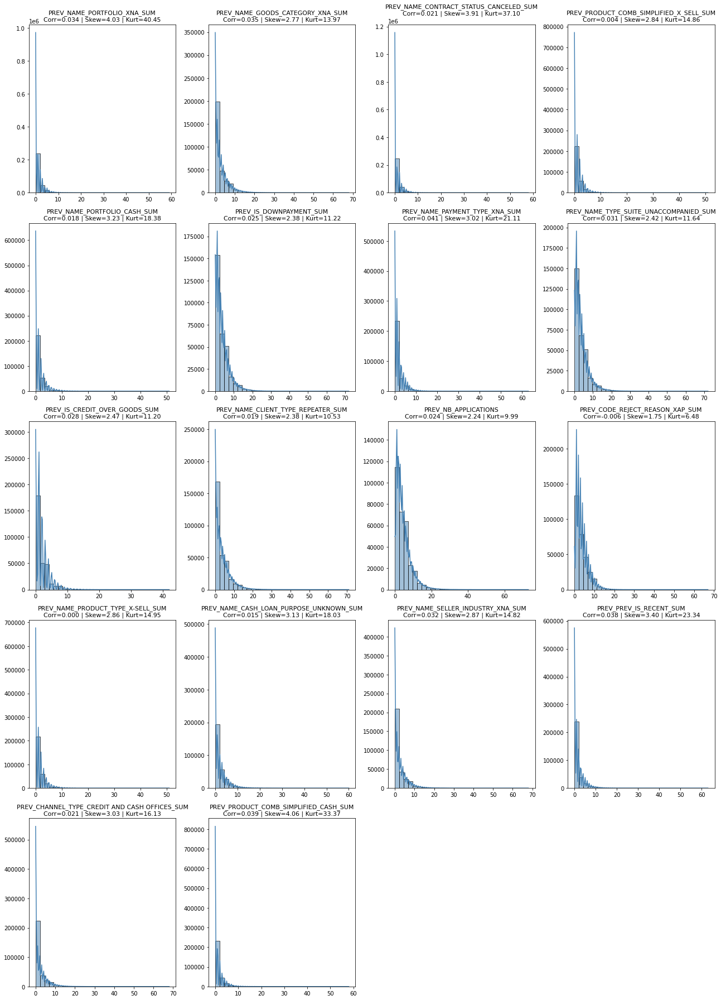

In [93]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_NAME_PORTFOLIO_XNA_SUM', 'PREV_NAME_GOODS_CATEGORY_XNA_SUM', 'PREV_NAME_CONTRACT_STATUS_CANCELED_SUM', 
            'PREV_PRODUCT_COMB_SIMPLIFIED_X_SELL_SUM', 'PREV_NAME_PORTFOLIO_CASH_SUM', 'PREV_IS_DOWNPAYMENT_SUM', 'PREV_NAME_PAYMENT_TYPE_XNA_SUM',
            'PREV_NAME_TYPE_SUITE_UNACCOMPANIED_SUM', 'PREV_IS_CREDIT_OVER_GOODS_SUM', 'PREV_NAME_CLIENT_TYPE_REPEATER_SUM',
            'PREV_NB_APPLICATIONS', 'PREV_CODE_REJECT_REASON_XAP_SUM', 'PREV_NAME_PRODUCT_TYPE_X-SELL_SUM', 'PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_SUM',
            'PREV_NAME_SELLER_INDUSTRY_XNA_SUM', 'PREV_PREV_IS_RECENT_SUM', 'PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_SUM', 
            'PREV_PRODUCT_COMB_SIMPLIFIED_CASH_SUM']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

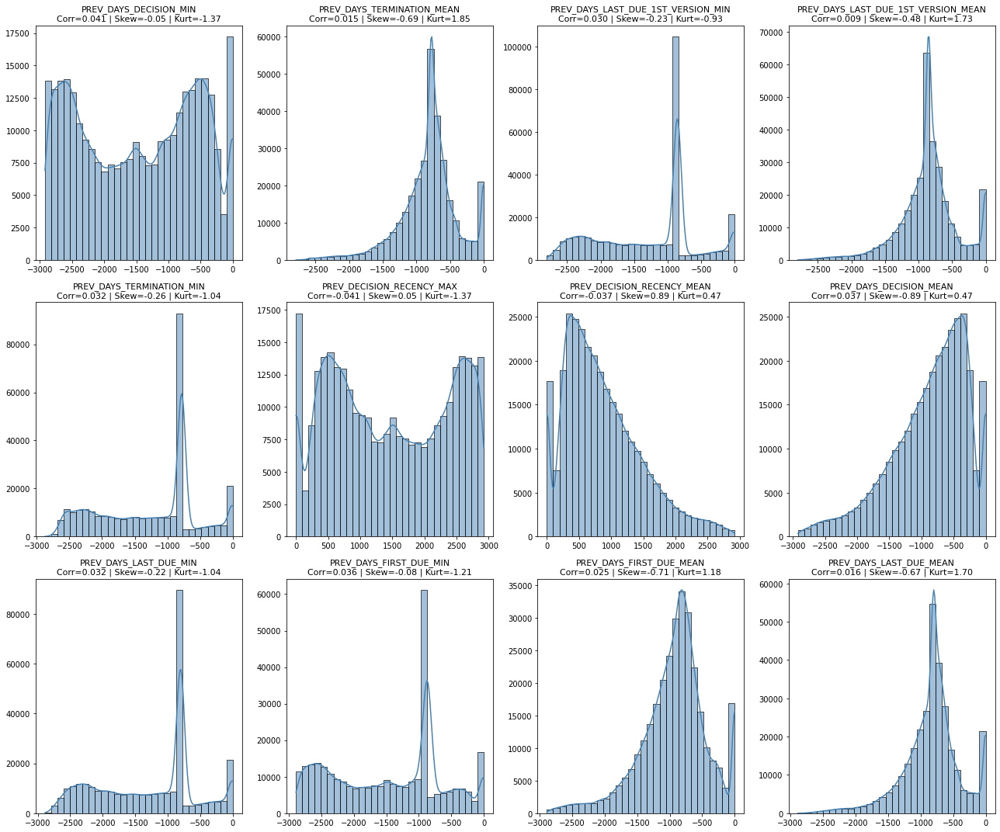

In [94]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_DAYS_DECISION_MIN', 'PREV_DAYS_TERMINATION_MEAN', 'PREV_DAYS_LAST_DUE_1ST_VERSION_MIN', 'PREV_DAYS_LAST_DUE_1ST_VERSION_MEAN', 
            'PREV_DAYS_TERMINATION_MIN', 'PREV_DECISION_RECENCY_MAX', 'PREV_DECISION_RECENCY_MEAN',
            'PREV_DAYS_DECISION_MEAN', 'PREV_DAYS_LAST_DUE_MIN', 'PREV_DAYS_FIRST_DUE_MIN', 'PREV_DAYS_FIRST_DUE_MEAN', 'PREV_DAYS_LAST_DUE_MEAN']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

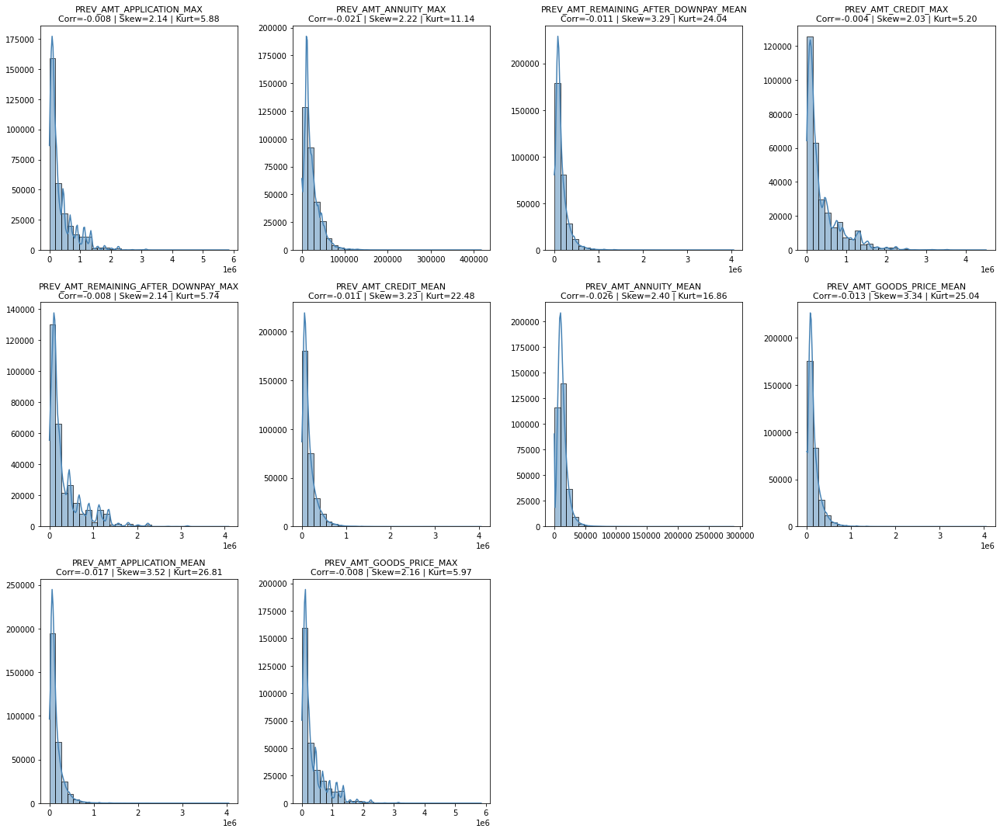

In [95]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_AMT_APPLICATION_MAX', 'PREV_AMT_ANNUITY_MAX', 'PREV_AMT_REMAINING_AFTER_DOWNPAY_MEAN', 'PREV_AMT_CREDIT_MAX', 
            'PREV_AMT_REMAINING_AFTER_DOWNPAY_MAX', 'PREV_AMT_CREDIT_MEAN', 'PREV_AMT_ANNUITY_MEAN', 'PREV_AMT_GOODS_PRICE_MEAN', 
            'PREV_AMT_APPLICATION_MEAN', 'PREV_AMT_GOODS_PRICE_MAX']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\core\_methods.py:118: RuntimeWarning:

overflow encountered in reduce

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\core\_methods.py:118: RuntimeWarning:

overflow encountered in reduce

c:\Users\Caomghin\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1076: RuntimeWarning:

overflow encountered in square

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\core\_methods.py:118: RuntimeWarning:

overflow encountered in reduce

c:\Users\Caomghin\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1076: RuntimeWarning:

overflow encountered in square

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\core\_methods.py:118: RuntimeWarning:

overflow encountered in reduce



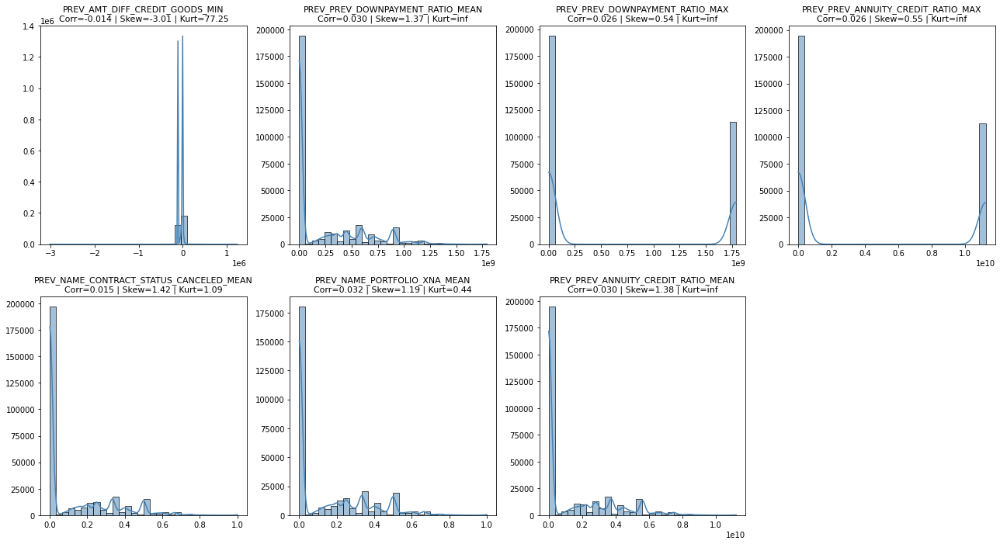

In [96]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_AMT_DIFF_CREDIT_GOODS_MIN', 'PREV_PREV_DOWNPAYMENT_RATIO_MEAN', 'PREV_PREV_DOWNPAYMENT_RATIO_MAX', 'PREV_PREV_ANNUITY_CREDIT_RATIO_MAX', 
            'PREV_NAME_CONTRACT_STATUS_CANCELED_MEAN', 'PREV_NAME_PORTFOLIO_XNA_MEAN', 'PREV_PREV_ANNUITY_CREDIT_RATIO_MEAN']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

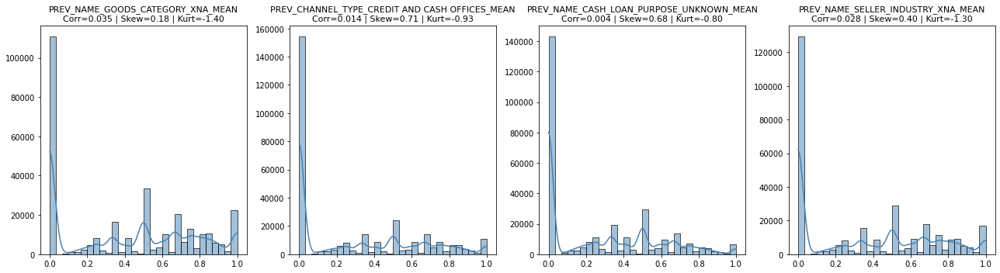

In [97]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_NAME_GOODS_CATEGORY_XNA_MEAN', 'PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_MEAN', 'PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_MEAN', 
            'PREV_NAME_SELLER_INDUSTRY_XNA_MEAN']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

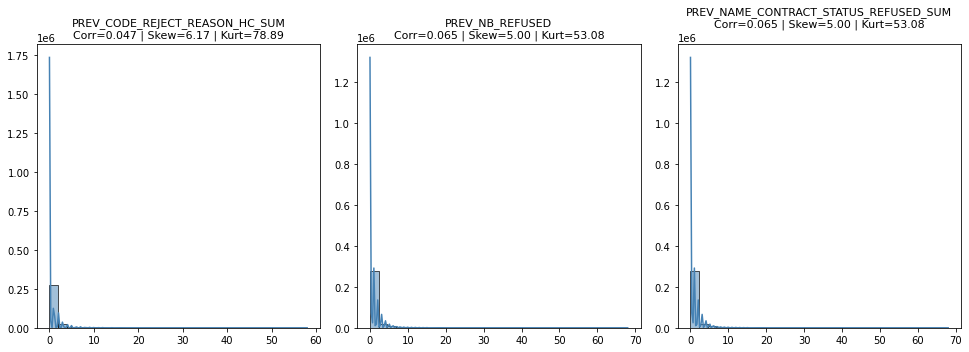

In [98]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_CODE_REJECT_REASON_HC_SUM', 'PREV_NB_REFUSED', 'PREV_NAME_CONTRACT_STATUS_REFUSED_SUM']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

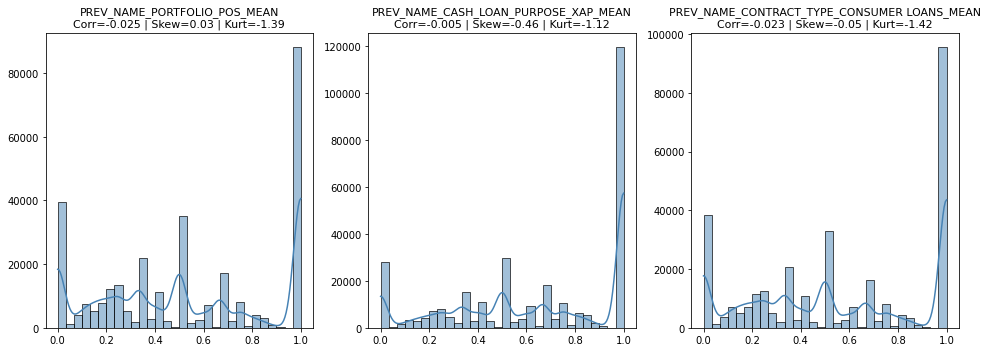

In [99]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_NAME_PORTFOLIO_POS_MEAN', 'PREV_NAME_CASH_LOAN_PURPOSE_XAP_MEAN', 'PREV_NAME_CONTRACT_TYPE_CONSUMER LOANS_MEAN']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

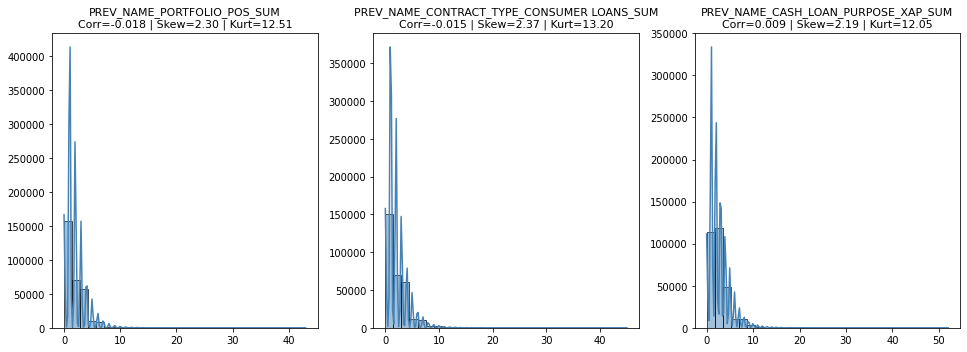

In [100]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_NAME_PORTFOLIO_POS_SUM', 'PREV_NAME_CONTRACT_TYPE_CONSUMER LOANS_SUM', 'PREV_NAME_CASH_LOAN_PURPOSE_XAP_SUM']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

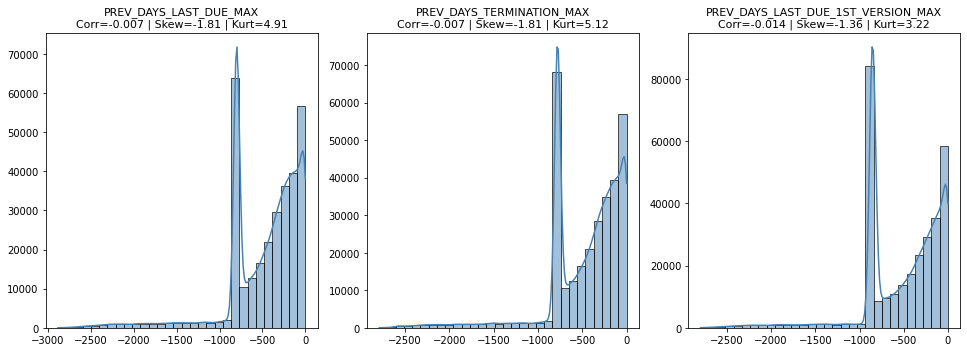

In [101]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_DAYS_LAST_DUE_MAX', 'PREV_DAYS_TERMINATION_MAX', 'PREV_DAYS_LAST_DUE_1ST_VERSION_MAX']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

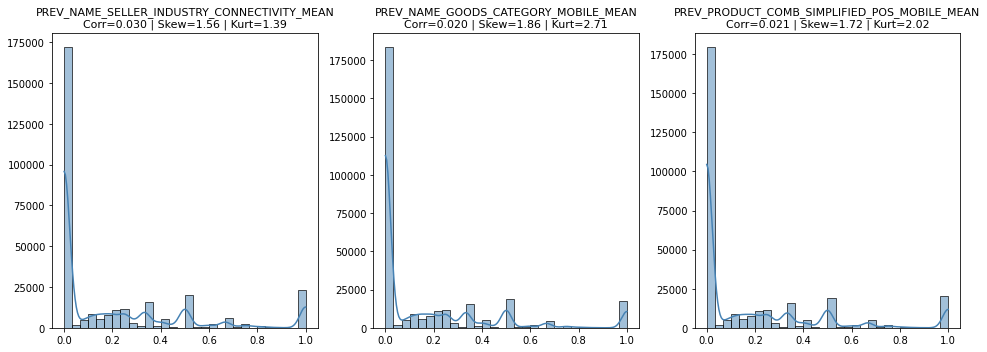

In [102]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_NAME_SELLER_INDUSTRY_CONNECTIVITY_MEAN', 'PREV_NAME_GOODS_CATEGORY_MOBILE_MEAN', 'PREV_PRODUCT_COMB_SIMPLIFIED_POS_MOBILE_MEAN']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

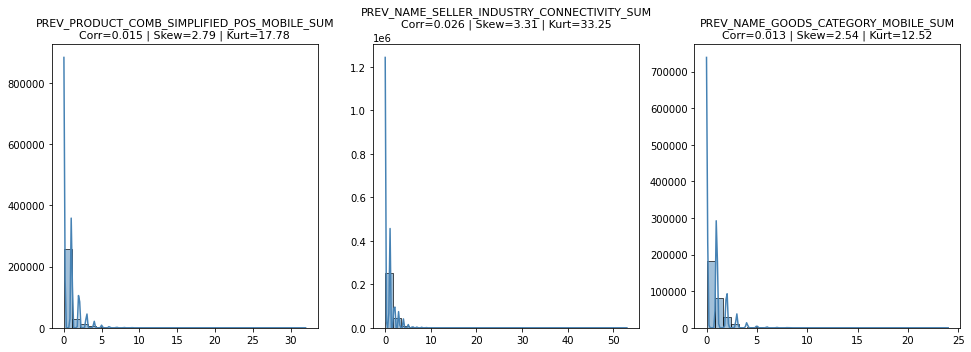

In [103]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_PRODUCT_COMB_SIMPLIFIED_POS_MOBILE_SUM', 'PREV_NAME_SELLER_INDUSTRY_CONNECTIVITY_SUM', 'PREV_NAME_GOODS_CATEGORY_MOBILE_SUM']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

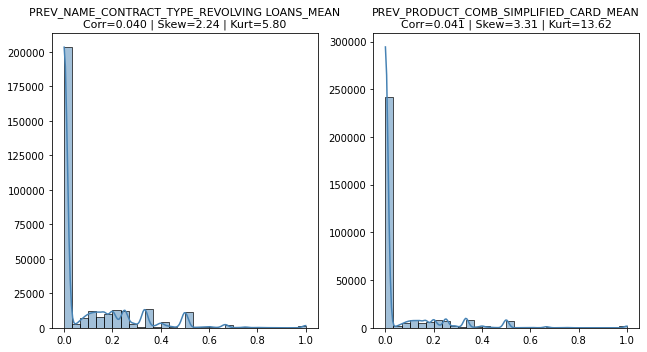

In [104]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_NAME_CONTRACT_TYPE_REVOLVING LOANS_MEAN', 'PREV_PRODUCT_COMB_SIMPLIFIED_CARD_MEAN']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

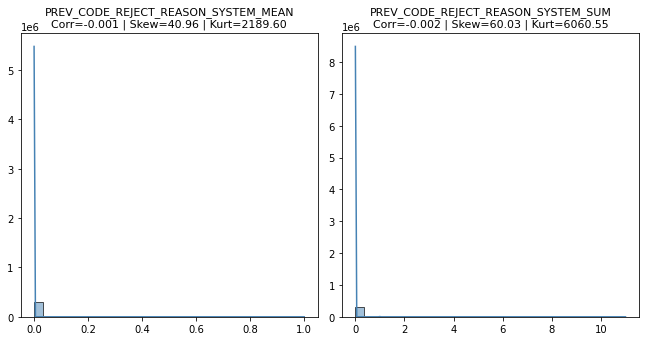

In [105]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_CODE_REJECT_REASON_SYSTEM_MEAN', 'PREV_CODE_REJECT_REASON_SYSTEM_SUM']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

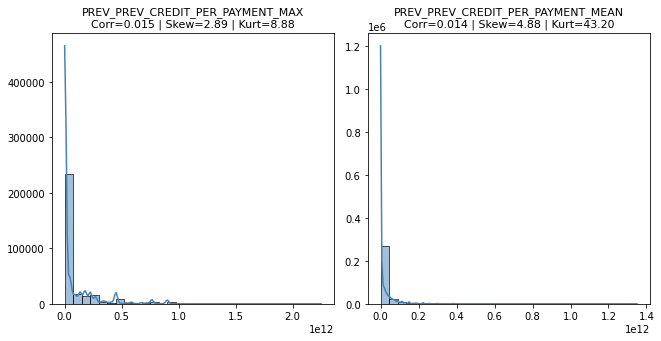

In [106]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_PREV_CREDIT_PER_PAYMENT_MAX', 'PREV_PREV_CREDIT_PER_PAYMENT_MEAN']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

c:\Users\Caomghin\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1076: RuntimeWarning:

overflow encountered in square

c:\Users\Caomghin\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1076: RuntimeWarning:

overflow encountered in square



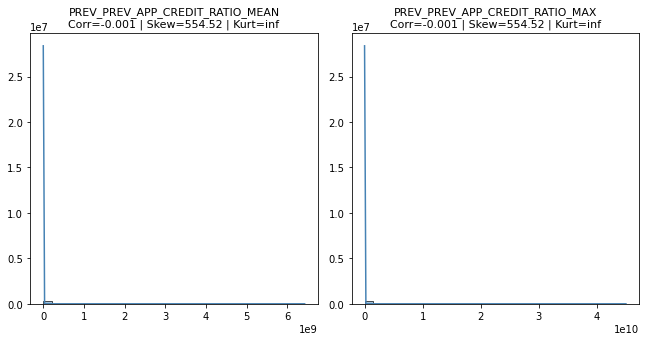

In [107]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_PREV_APP_CREDIT_RATIO_MEAN', 'PREV_PREV_APP_CREDIT_RATIO_MAX']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

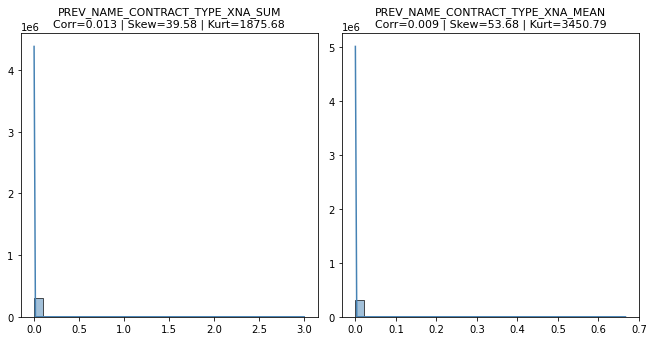

In [108]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_NAME_CONTRACT_TYPE_XNA_SUM', 'PREV_NAME_CONTRACT_TYPE_XNA_MEAN']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

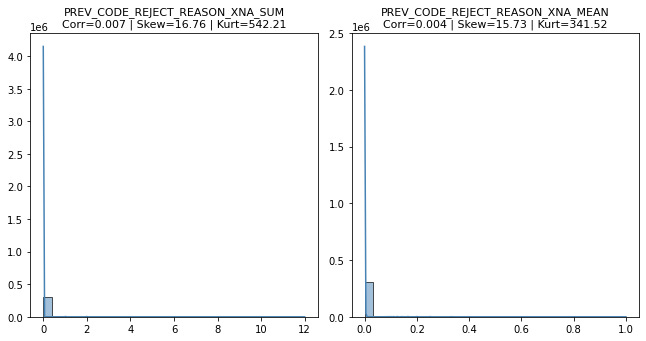

In [109]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_CODE_REJECT_REASON_XNA_SUM', 'PREV_CODE_REJECT_REASON_XNA_MEAN']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

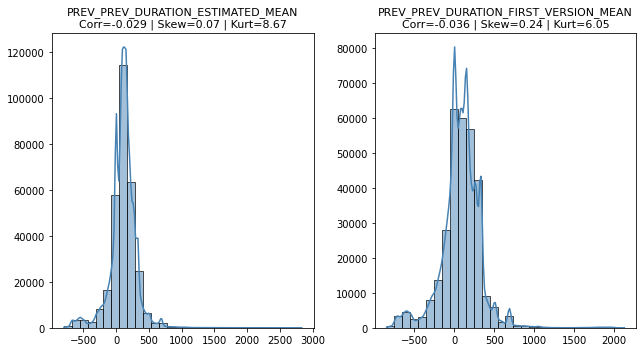

In [110]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_PREV_DURATION_ESTIMATED_MEAN', 'PREV_PREV_DURATION_FIRST_VERSION_MEAN']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

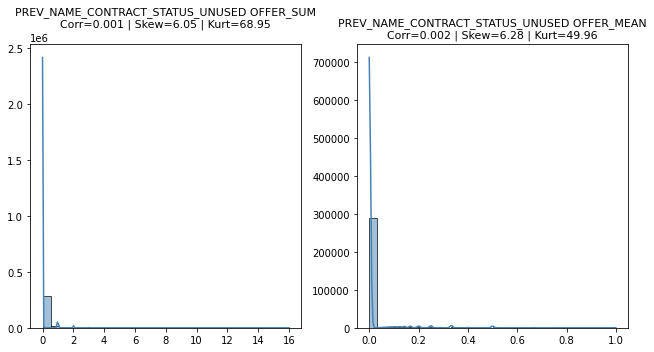

In [111]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_NAME_CONTRACT_STATUS_UNUSED OFFER_SUM', 'PREV_NAME_CONTRACT_STATUS_UNUSED OFFER_MEAN']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

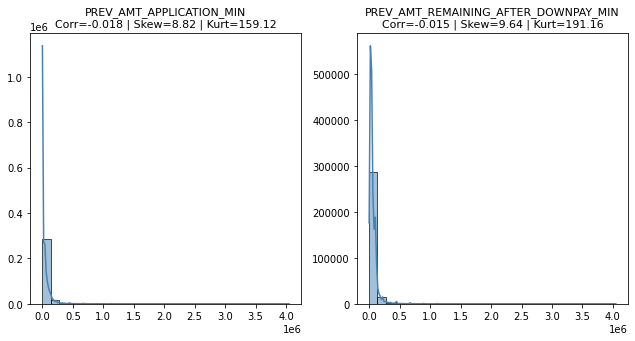

In [112]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_AMT_APPLICATION_MIN', 'PREV_AMT_REMAINING_AFTER_DOWNPAY_MIN']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

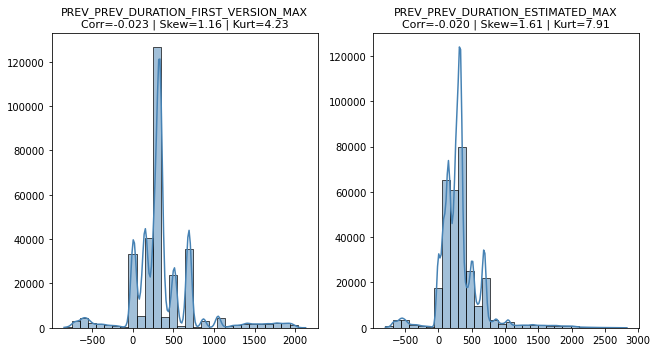

In [113]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_PREV_DURATION_FIRST_VERSION_MAX', 'PREV_PREV_DURATION_ESTIMATED_MAX']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

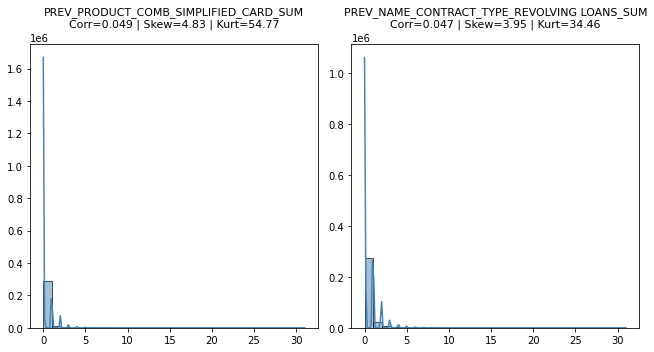

In [114]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_PRODUCT_COMB_SIMPLIFIED_CARD_SUM', 'PREV_NAME_CONTRACT_TYPE_REVOLVING LOANS_SUM']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

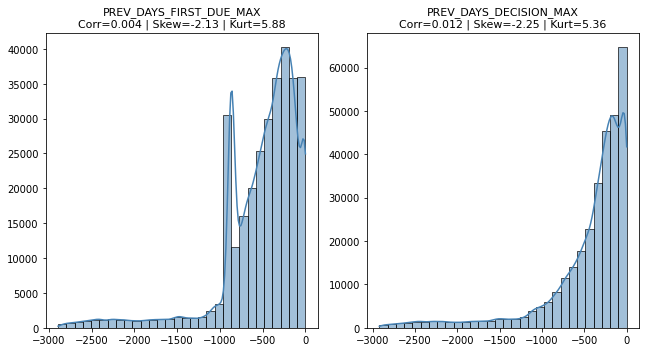

In [115]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_DAYS_FIRST_DUE_MAX', 'PREV_DAYS_DECISION_MAX']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

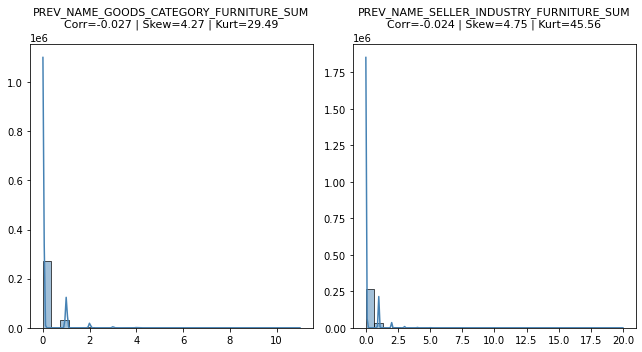

In [116]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_NAME_GOODS_CATEGORY_FURNITURE_SUM', 'PREV_NAME_SELLER_INDUSTRY_FURNITURE_SUM']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

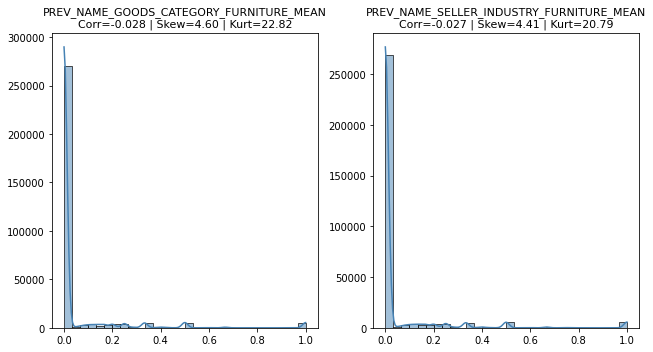

In [117]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_NAME_GOODS_CATEGORY_FURNITURE_MEAN', 'PREV_NAME_SELLER_INDUSTRY_FURNITURE_MEAN']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

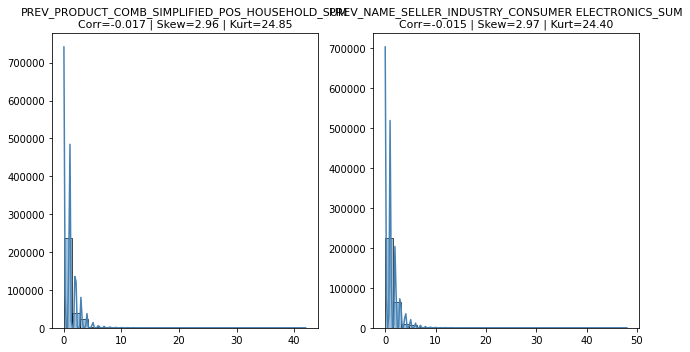

In [118]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_PRODUCT_COMB_SIMPLIFIED_POS_HOUSEHOLD_SUM', 'PREV_NAME_SELLER_INDUSTRY_CONSUMER ELECTRONICS_SUM']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

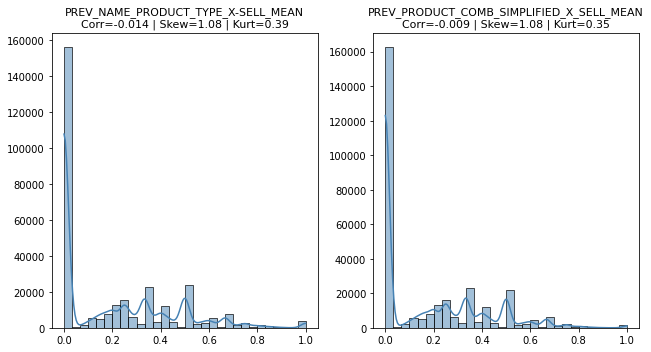

In [119]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_NAME_PRODUCT_TYPE_X-SELL_MEAN', 'PREV_PRODUCT_COMB_SIMPLIFIED_X_SELL_MEAN']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

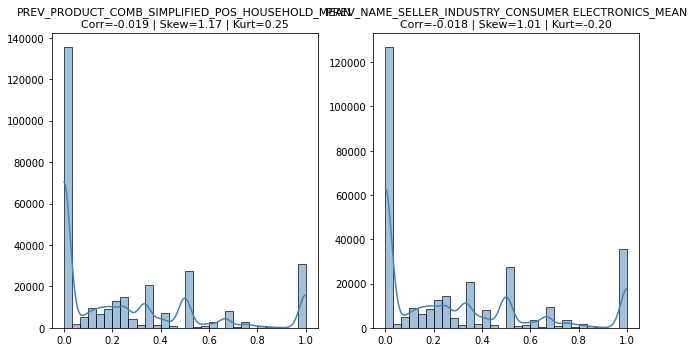

In [120]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_PRODUCT_COMB_SIMPLIFIED_POS_HOUSEHOLD_MEAN', 'PREV_NAME_SELLER_INDUSTRY_CONSUMER ELECTRONICS_MEAN']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

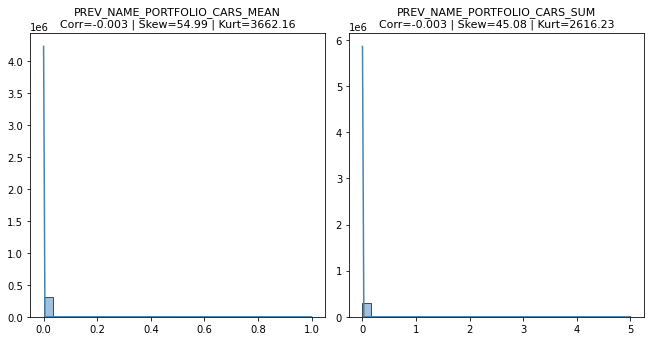

In [121]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_NAME_PORTFOLIO_CARS_MEAN', 'PREV_NAME_PORTFOLIO_CARS_SUM']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

In [122]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

cols_to_drop = [
    'PREV_NAME_PORTFOLIO_XNA_SUM', 'PREV_NAME_GOODS_CATEGORY_XNA_SUM', 'PREV_NAME_CONTRACT_STATUS_CANCELED_SUM', 
    'PREV_PRODUCT_COMB_SIMPLIFIED_X_SELL_SUM', 'PREV_NAME_PORTFOLIO_CASH_SUM', 'PREV_IS_DOWNPAYMENT_SUM',
    'PREV_NAME_TYPE_SUITE_UNACCOMPANIED_SUM', 'PREV_IS_CREDIT_OVER_GOODS_SUM', 'PREV_NAME_CLIENT_TYPE_REPEATER_SUM',
    'PREV_NB_APPLICATIONS', 'PREV_CODE_REJECT_REASON_XAP_SUM', 'PREV_NAME_PRODUCT_TYPE_X-SELL_SUM', 'PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_SUM',
    'PREV_NAME_SELLER_INDUSTRY_XNA_SUM', 'PREV_PREV_IS_RECENT_SUM', 'PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_SUM', 
    'PREV_PRODUCT_COMB_SIMPLIFIED_CASH_SUM',

    'PREV_DAYS_TERMINATION_MEAN', 'PREV_DAYS_LAST_DUE_1ST_VERSION_MIN', 'PREV_DAYS_LAST_DUE_1ST_VERSION_MEAN', 
    'PREV_DAYS_TERMINATION_MIN', 'PREV_DECISION_RECENCY_MAX', 'PREV_DECISION_RECENCY_MEAN',
    'PREV_DAYS_DECISION_MEAN', 'PREV_DAYS_LAST_DUE_MIN', 'PREV_DAYS_FIRST_DUE_MIN', 'PREV_DAYS_FIRST_DUE_MEAN', 'PREV_DAYS_LAST_DUE_MEAN',

    'PREV_AMT_APPLICATION_MAX', 'PREV_AMT_REMAINING_AFTER_DOWNPAY_MEAN', 'PREV_AMT_CREDIT_MAX', 
    'PREV_AMT_REMAINING_AFTER_DOWNPAY_MAX', 'PREV_AMT_CREDIT_MEAN', 'PREV_AMT_ANNUITY_MEAN', 'PREV_AMT_GOODS_PRICE_MEAN', 
    'PREV_AMT_APPLICATION_MEAN', 'PREV_AMT_GOODS_PRICE_MAX',

    'PREV_AMT_DIFF_CREDIT_GOODS_MIN', 'PREV_PREV_DOWNPAYMENT_RATIO_MEAN', 'PREV_PREV_DOWNPAYMENT_RATIO_MAX', 'PREV_PREV_ANNUITY_CREDIT_RATIO_MAX', 
    'PREV_NAME_CONTRACT_STATUS_CANCELED_MEAN', 'PREV_PREV_ANNUITY_CREDIT_RATIO_MEAN',

    'PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_MEAN', 'PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_MEAN', 
    'PREV_NAME_SELLER_INDUSTRY_XNA_MEAN', 

    'PREV_CODE_REJECT_REASON_HC_SUM', 'PREV_NAME_CONTRACT_STATUS_REFUSED_SUM',

    'PREV_NAME_CASH_LOAN_PURPOSE_XAP_MEAN', 'PREV_NAME_CONTRACT_TYPE_CONSUMER LOANS_MEAN',

    'PREV_NAME_CONTRACT_TYPE_CONSUMER LOANS_SUM', 'PREV_NAME_CASH_LOAN_PURPOSE_XAP_SUM',

    'PREV_DAYS_LAST_DUE_MAX', 'PREV_DAYS_TERMINATION_MAX',

    'PREV_NAME_GOODS_CATEGORY_MOBILE_MEAN', 'PREV_PRODUCT_COMB_SIMPLIFIED_POS_MOBILE_MEAN',

    'PREV_PRODUCT_COMB_SIMPLIFIED_POS_MOBILE_SUM', 'PREV_NAME_GOODS_CATEGORY_MOBILE_SUM',

    'PREV_PRODUCT_COMB_SIMPLIFIED_CARD_MEAN', 'PREV_CODE_REJECT_REASON_SYSTEM_SUM',

    'PREV_PREV_CREDIT_PER_PAYMENT_MEAN', 'PREV_PREV_APP_CREDIT_RATIO_MEAN', 'PREV_PREV_APP_CREDIT_RATIO_MAX',

    'PREV_NAME_CONTRACT_TYPE_XNA_MEAN', 'PREV_CODE_REJECT_REASON_XNA_SUM', 'PREV_PREV_DURATION_ESTIMATED_MEAN', 'PREV_NAME_CONTRACT_STATUS_UNUSED OFFER_SUM',

    'PREV_AMT_REMAINING_AFTER_DOWNPAY_MIN', 'PREV_PREV_DURATION_ESTIMATED_MAX', 'PREV_PRODUCT_COMB_SIMPLIFIED_CARD_SUM',

    'PREV_DAYS_FIRST_DUE_MAX', 'PREV_NAME_SELLER_INDUSTRY_FURNITURE_SUM', 'PREV_NAME_GOODS_CATEGORY_FURNITURE_MEAN',

    'PREV_NAME_SELLER_INDUSTRY_CONSUMER ELECTRONICS_SUM', 'PREV_PRODUCT_COMB_SIMPLIFIED_X_SELL_MEAN',

    'PREV_NAME_SELLER_INDUSTRY_CONSUMER ELECTRONICS_MEAN', 'PREV_NAME_PORTFOLIO_CARS_MEAN'
]

df_train_median_mode_linear.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [124]:
remaining_cols = list(set(df_previous_train_median_mode_linear_agg.columns).intersection(df_train_median_mode_linear.columns))

In [125]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_train_median_mode_linear[remaining_cols], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation


In [126]:
# Réduction de la taille du dataframe.

optimize_types(df_train_median_mode_linear)

 Mémoire avant : 602.43 MB
 Mémoire après : 455.80 MB
 Gain : 24.3%


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_ANNUITY,REGION_POPULATION_RELATIVE,OWN_CAR_AGE,FLAG_MOBIL,...,PREV_NAME_YIELD_GROUP_MIDDLE_MEAN,PREV_NAME_YIELD_GROUP_MIDDLE_SUM,PREV_PRODUCT_COMB_SIMPLIFIED_CASH_MEAN,PREV_PRODUCT_COMB_SIMPLIFIED_POS_HOUSEHOLD_MEAN,PREV_PRODUCT_COMB_SIMPLIFIED_POS_HOUSEHOLD_SUM,PREV_PRODUCT_COMB_SIMPLIFIED_POS_INDUSTRY_MEAN,PREV_PRODUCT_COMB_SIMPLIFIED_POS_INDUSTRY_SUM,PREV_PRODUCT_COMB_SIMPLIFIED_POS_OTHERS_MEAN,PREV_PRODUCT_COMB_SIMPLIFIED_POS_OTHERS_SUM,PREV_NB_REFUSED
0,100002,1,0,1,0,1,24700.5,0.018801,9,1,...,0.000000,0,0.000000,0.000000,0,0.000000,0,1.0,1,0
1,100003,0,0,0,0,0,35698.5,0.003541,9,1,...,0.666667,2,0.000000,0.333333,1,0.333333,1,0.0,0,0
2,100004,0,1,1,1,1,6750.0,0.010032,26,1,...,1.000000,1,0.000000,0.000000,0,0.000000,0,0.0,0,0
3,100006,0,0,0,0,1,29686.5,0.008019,9,1,...,0.111111,1,0.222222,0.111111,1,0.111111,1,0.0,0,1
4,100007,0,0,1,0,1,21865.5,0.028663,9,1,...,0.500000,3,0.166667,0.166667,1,0.000000,0,0.0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307495,456251,0,0,1,0,0,27558.0,0.032561,9,1,...,0.000000,0,0.000000,0.000000,0,0.000000,0,0.0,0,0
307496,456252,0,0,0,0,1,12001.5,0.025164,9,1,...,0.000000,0,0.000000,1.000000,1,0.000000,0,0.0,0,0
307497,456253,0,0,0,0,1,29979.0,0.005002,9,1,...,0.000000,0,0.000000,0.000000,0,0.000000,0,0.0,0,0
307498,456254,1,0,0,0,1,20205.0,0.005313,9,1,...,0.000000,0,0.000000,0.500000,1,0.000000,0,0.0,0,0


#### Corrélation des variables - df_train_median_missing_linear

In [127]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_median_missing_linear[df_previous_train_median_missing_linear_agg.columns.tolist()], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,PREV_PREV_APP_CREDIT_RATIO_MAX / PREV_PREV_APP_CREDIT_RATIO_MEAN,PREV_PREV_APP_CREDIT_RATIO_MEAN,PREV_PREV_APP_CREDIT_RATIO_MAX,1.000000
1,PREV_DAYS_DECISION_MIN / PREV_DECISION_RECENCY_MAX,PREV_DAYS_DECISION_MIN,PREV_DECISION_RECENCY_MAX,-1.000000
2,PREV_DAYS_DECISION_MEAN / PREV_DECISION_RECENCY_MEAN,PREV_DAYS_DECISION_MEAN,PREV_DECISION_RECENCY_MEAN,-1.000000
3,PREV_AMT_APPLICATION_MAX / PREV_AMT_GOODS_PRICE_MAX,PREV_AMT_APPLICATION_MAX,PREV_AMT_GOODS_PRICE_MAX,0.999490
4,PREV_AMT_GOODS_PRICE_MAX / PREV_AMT_REMAINING_AFTER_DOWNPAY_MAX,PREV_AMT_GOODS_PRICE_MAX,PREV_AMT_REMAINING_AFTER_DOWNPAY_MAX,0.998637
5,PREV_AMT_APPLICATION_MAX / PREV_AMT_REMAINING_AFTER_DOWNPAY_MAX,PREV_AMT_APPLICATION_MAX,PREV_AMT_REMAINING_AFTER_DOWNPAY_MAX,0.998090
6,PREV_PREV_ANNUITY_CREDIT_RATIO_MEAN / PREV_PREV_DOWNPAYMENT_RATIO_MEAN,PREV_PREV_ANNUITY_CREDIT_RATIO_MEAN,PREV_PREV_DOWNPAYMENT_RATIO_MEAN,0.996964
7,PREV_AMT_GOODS_PRICE_MEAN / PREV_AMT_REMAINING_AFTER_DOWNPAY_MEAN,PREV_AMT_GOODS_PRICE_MEAN,PREV_AMT_REMAINING_AFTER_DOWNPAY_MEAN,0.996858
8,PREV_PREV_ANNUITY_CREDIT_RATIO_MAX / PREV_PREV_DOWNPAYMENT_RATIO_MAX,PREV_PREV_ANNUITY_CREDIT_RATIO_MAX,PREV_PREV_DOWNPAYMENT_RATIO_MAX,0.995171
9,PREV_AMT_APPLICATION_MEAN / PREV_AMT_GOODS_PRICE_MEAN,PREV_AMT_APPLICATION_MEAN,PREV_AMT_GOODS_PRICE_MEAN,0.989292


In [128]:
df_corr = get_correlation_pairs(df_train_median_missing_linear[df_previous_train_median_missing_linear_agg.columns.tolist()], method="pearson", style=False, threshold=0.8)

In [129]:
var_corr = df_corr['Variable 1'].unique().tolist() + df_corr['Variable 2'].unique().tolist()
var_corr = list(set(var_corr))

In [130]:
# Visualisation des corrélations les plus importantes avec la Target.

pd.set_option('display.max_rows', None)

target_corr = compute_target_correlations(df_train_median_missing_linear.loc[:, var_corr + ['TARGET']], 'TARGET', mode='linear', plot=False)
target_corr.loc[var_corr].sort_values(by='pearson_corr', ascending=False)

,pearson_corr,spearman_corr,abs_pearson,abs_spearman,score_global
PREV_NB_REFUSED,0.064766,0.063693,0.064766,0.063693,0.064229
PREV_NAME_CONTRACT_STATUS_REFUSED_SUM,0.064766,0.063693,0.064766,0.063693,0.064229
PREV_PRODUCT_COMB_SIMPLIFIED_CARD_SUM,0.048560,0.044427,0.048560,0.044427,0.046493
PREV_CODE_REJECT_REASON_HC_SUM,0.047488,0.050216,0.047488,0.050216,0.048852
PREV_NAME_CONTRACT_TYPE_REVOLVING LOANS_SUM,0.046655,0.042912,0.046655,0.042912,0.044784
PREV_DAYS_DECISION_MIN,0.041373,0.041187,0.041373,0.041187,0.041280
PREV_NAME_PAYMENT_TYPE_XNA_SUM,0.041272,0.036190,0.041272,0.036190,0.038731
PREV_PRODUCT_COMB_SIMPLIFIED_CARD_MEAN,0.041037,0.042995,0.041037,0.042995,0.042016
PREV_NAME_TYPE_SUITE_MISSING_SUM,0.040416,0.032953,0.040416,0.032953,0.036684
PREV_NAME_CONTRACT_TYPE_REVOLVING LOANS_MEAN,0.040054,0.040494,0.040054,0.040494,0.040274


In [131]:
pd.reset_option('display.max_rows')

In [132]:
# Fonction permettant de visualiser les groupes de corrélations afin de faire un choix de variable.

pd.set_option('display.max_colwidth', None)
summarize_correlated_groups(df_corr, X=df_train_median_missing_linear, y=df_train_median_missing_linear['TARGET'])

,Variables du groupe,Taille du groupe,Corrélation max avec y,Variable la plus corrélée
0,"[PREV_CODE_REJECT_REASON_XAP_SUM, PREV_NAME_GOODS_CATEGORY_XNA_SUM, PREV_IS_CREDIT_OVER_GOODS_SUM, PREV_PRODUCT_COMB_SIMPLIFIED_CASH_SUM, PREV_NAME_CLIENT_TYPE_REPEATER_SUM, PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_SUM, PREV_NAME_PORTFOLIO_CASH_SUM, PREV_NAME_PAYMENT_TYPE_XNA_SUM, PREV_NAME_PRODUCT_TYPE_X-SELL_SUM, PREV_NAME_CONTRACT_STATUS_CANCELED_SUM, PREV_PREV_IS_RECENT_SUM, PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_SUM, PREV_NB_APPLICATIONS, PREV_NAME_PORTFOLIO_XNA_SUM, PREV_NAME_SELLER_INDUSTRY_XNA_SUM, PREV_NAME_TYPE_SUITE_MISSING_SUM, PREV_PRODUCT_COMB_SIMPLIFIED_X_SELL_SUM, PREV_IS_DOWNPAYMENT_SUM]",18,0.041272,PREV_NAME_PAYMENT_TYPE_XNA_SUM
1,"[PREV_DAYS_LAST_DUE_1ST_VERSION_MIN, PREV_DECISION_RECENCY_MAX, PREV_DAYS_LAST_DUE_MEAN, PREV_DECISION_RECENCY_MEAN, PREV_DAYS_FIRST_DUE_MIN, PREV_DAYS_TERMINATION_MIN, PREV_DAYS_DECISION_MIN, PREV_DAYS_LAST_DUE_MIN, PREV_DAYS_LAST_DUE_1ST_VERSION_MEAN, PREV_DAYS_TERMINATION_MEAN, PREV_DAYS_DECISION_MEAN, PREV_DAYS_FIRST_DUE_MEAN]",12,0.041373,PREV_DECISION_RECENCY_MAX
2,"[PREV_AMT_REMAINING_AFTER_DOWNPAY_MEAN, PREV_AMT_GOODS_PRICE_MEAN, PREV_AMT_CREDIT_MAX, PREV_AMT_GOODS_PRICE_MAX, PREV_AMT_APPLICATION_MAX, PREV_AMT_ANNUITY_MAX, PREV_AMT_REMAINING_AFTER_DOWNPAY_MAX, PREV_AMT_ANNUITY_MEAN, PREV_AMT_CREDIT_MEAN, PREV_AMT_APPLICATION_MEAN]",10,0.026018,PREV_AMT_ANNUITY_MEAN
3,"[PREV_PREV_DOWNPAYMENT_RATIO_MEAN, PREV_NAME_PORTFOLIO_XNA_MEAN, PREV_AMT_DIFF_CREDIT_GOODS_MIN, PREV_NAME_CONTRACT_STATUS_CANCELED_MEAN, PREV_PREV_ANNUITY_CREDIT_RATIO_MEAN, PREV_PREV_ANNUITY_CREDIT_RATIO_MAX, PREV_PREV_DOWNPAYMENT_RATIO_MAX]",7,0.031553,PREV_NAME_PORTFOLIO_XNA_MEAN
4,"[PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_MEAN, PREV_NAME_GOODS_CATEGORY_XNA_MEAN, PREV_NAME_SELLER_INDUSTRY_XNA_MEAN, PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_MEAN]",4,0.035253,PREV_NAME_GOODS_CATEGORY_XNA_MEAN
5,"[PREV_CODE_REJECT_REASON_HC_SUM, PREV_NB_REFUSED, PREV_NAME_CONTRACT_STATUS_REFUSED_SUM]",3,0.064766,PREV_NB_REFUSED
6,"[PREV_NAME_CASH_LOAN_PURPOSE_XAP_MEAN, PREV_NAME_CONTRACT_TYPE_CONSUMER LOANS_MEAN, PREV_NAME_PORTFOLIO_POS_MEAN]",3,0.025031,PREV_NAME_PORTFOLIO_POS_MEAN
7,"[PREV_NAME_CONTRACT_TYPE_CONSUMER LOANS_SUM, PREV_NAME_CASH_LOAN_PURPOSE_XAP_SUM, PREV_NAME_PORTFOLIO_POS_SUM]",3,0.018163,PREV_NAME_PORTFOLIO_POS_SUM
8,"[PREV_DAYS_LAST_DUE_1ST_VERSION_MAX, PREV_DAYS_LAST_DUE_MAX, PREV_DAYS_TERMINATION_MAX]",3,0.014189,PREV_DAYS_LAST_DUE_1ST_VERSION_MAX
9,"[PREV_NAME_SELLER_INDUSTRY_CONNECTIVITY_MEAN, PREV_PRODUCT_COMB_SIMPLIFIED_POS_MOBILE_MEAN, PREV_NAME_GOODS_CATEGORY_MOBILE_MEAN]",3,0.030438,PREV_NAME_SELLER_INDUSTRY_CONNECTIVITY_MEAN


In [133]:
pd.reset_option('display.max_colwidth')

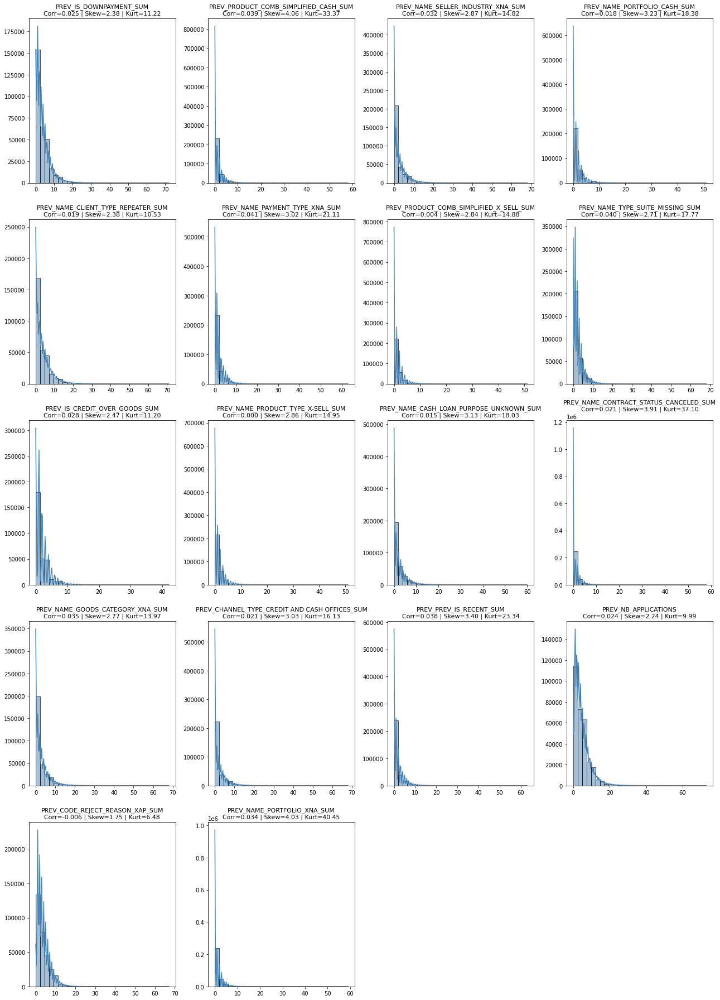

In [134]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_IS_DOWNPAYMENT_SUM', 'PREV_PRODUCT_COMB_SIMPLIFIED_CASH_SUM', 'PREV_NAME_SELLER_INDUSTRY_XNA_SUM', 
            'PREV_NAME_PORTFOLIO_CASH_SUM', 'PREV_NAME_CLIENT_TYPE_REPEATER_SUM', 'PREV_NAME_PAYMENT_TYPE_XNA_SUM', 'PREV_PRODUCT_COMB_SIMPLIFIED_X_SELL_SUM',
            'PREV_NAME_TYPE_SUITE_MISSING_SUM', 'PREV_IS_CREDIT_OVER_GOODS_SUM', 'PREV_NAME_PRODUCT_TYPE_X-SELL_SUM',
            'PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_SUM', 'PREV_NAME_CONTRACT_STATUS_CANCELED_SUM', 'PREV_NAME_GOODS_CATEGORY_XNA_SUM', 'PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_SUM',
            'PREV_PREV_IS_RECENT_SUM', 'PREV_NB_APPLICATIONS', 'PREV_CODE_REJECT_REASON_XAP_SUM', 
            'PREV_NAME_PORTFOLIO_XNA_SUM']

plot_transformations_distributions(
    df=df_train_median_missing_linear,
    var_list=transfos,
    target='TARGET'
)

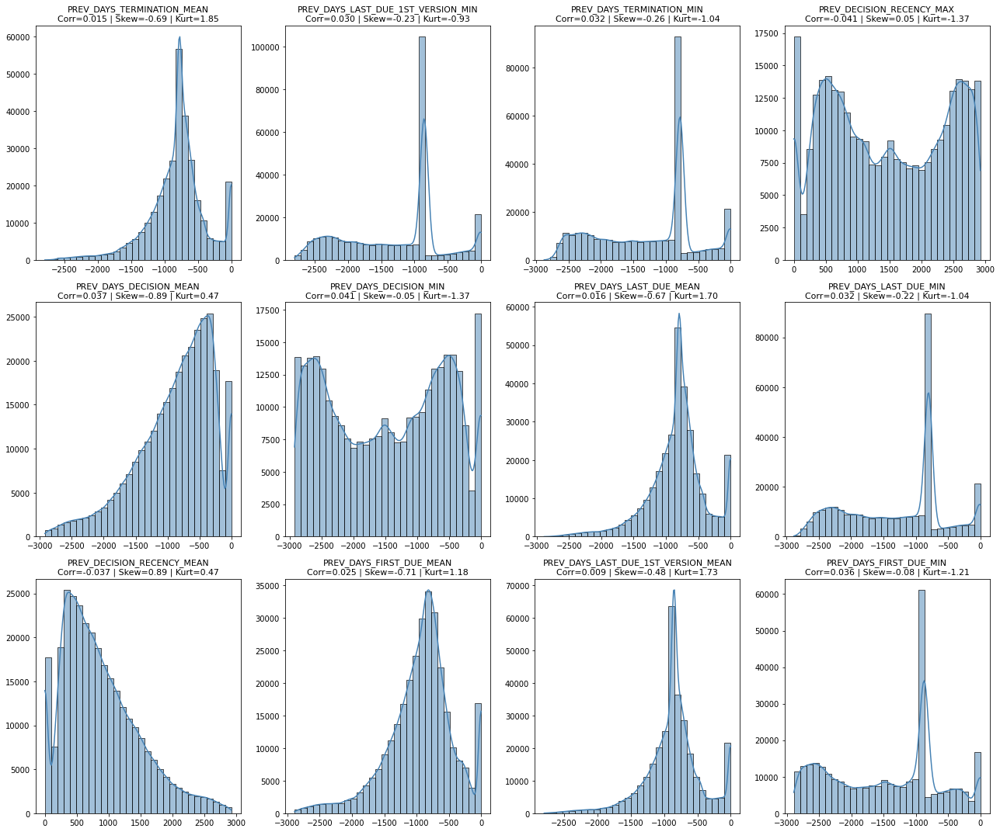

In [135]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_DAYS_TERMINATION_MEAN', 'PREV_DAYS_LAST_DUE_1ST_VERSION_MIN', 'PREV_DAYS_TERMINATION_MIN', 'PREV_DECISION_RECENCY_MAX', 
            'PREV_DAYS_DECISION_MEAN', 'PREV_DAYS_DECISION_MIN', 'PREV_DAYS_LAST_DUE_MEAN',
            'PREV_DAYS_LAST_DUE_MIN', 'PREV_DECISION_RECENCY_MEAN', 'PREV_DAYS_FIRST_DUE_MEAN', 'PREV_DAYS_LAST_DUE_1ST_VERSION_MEAN', 'PREV_DAYS_FIRST_DUE_MIN']

plot_transformations_distributions(
    df=df_train_median_missing_linear,
    var_list=transfos,
    target='TARGET'
)

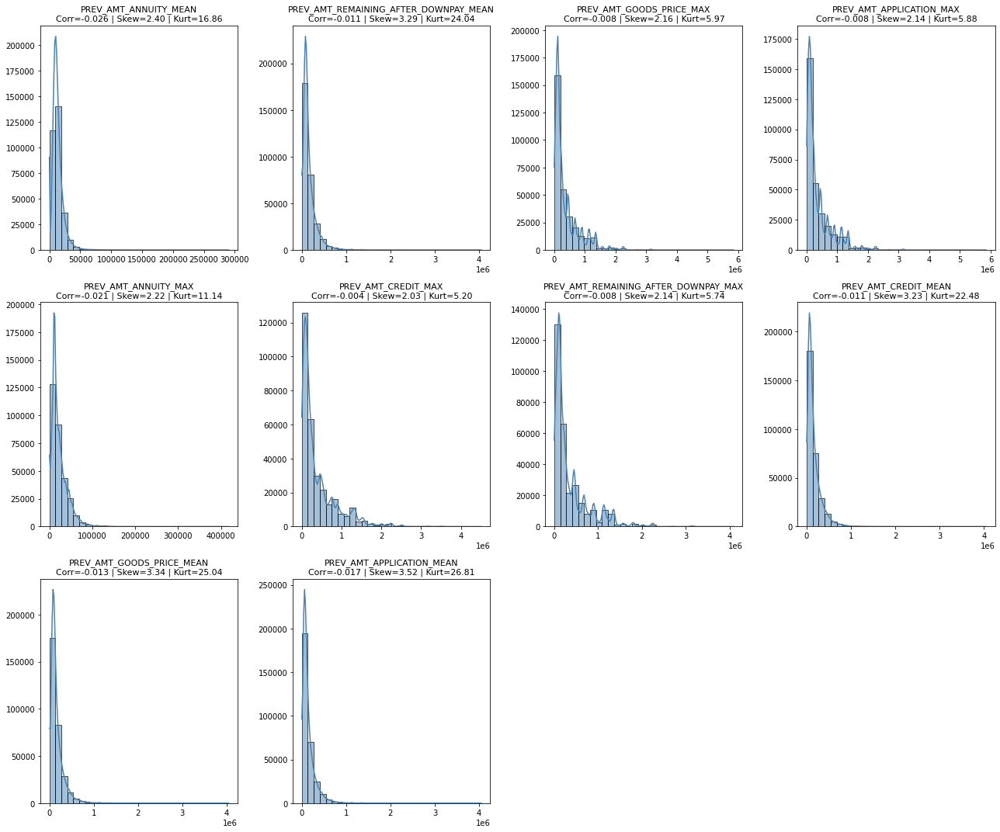

In [136]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_AMT_ANNUITY_MEAN', 'PREV_AMT_REMAINING_AFTER_DOWNPAY_MEAN', 'PREV_AMT_GOODS_PRICE_MAX', 'PREV_AMT_APPLICATION_MAX', 
            'PREV_AMT_ANNUITY_MAX', 'PREV_AMT_CREDIT_MAX', 'PREV_AMT_REMAINING_AFTER_DOWNPAY_MAX', 'PREV_AMT_CREDIT_MEAN', 
            'PREV_AMT_GOODS_PRICE_MEAN', 'PREV_AMT_APPLICATION_MEAN']

plot_transformations_distributions(
    df=df_train_median_missing_linear,
    var_list=transfos,
    target='TARGET'
)

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\core\_methods.py:118: RuntimeWarning:

overflow encountered in reduce

c:\Users\Caomghin\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1076: RuntimeWarning:

overflow encountered in square

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\core\_methods.py:118: RuntimeWarning:

overflow encountered in reduce

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\core\_methods.py:118: RuntimeWarning:

overflow encountered in reduce

c:\Users\Caomghin\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1076: RuntimeWarning:

overflow encountered in square

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\core\_methods.py:118: RuntimeWarning:

overflow encountered in reduce



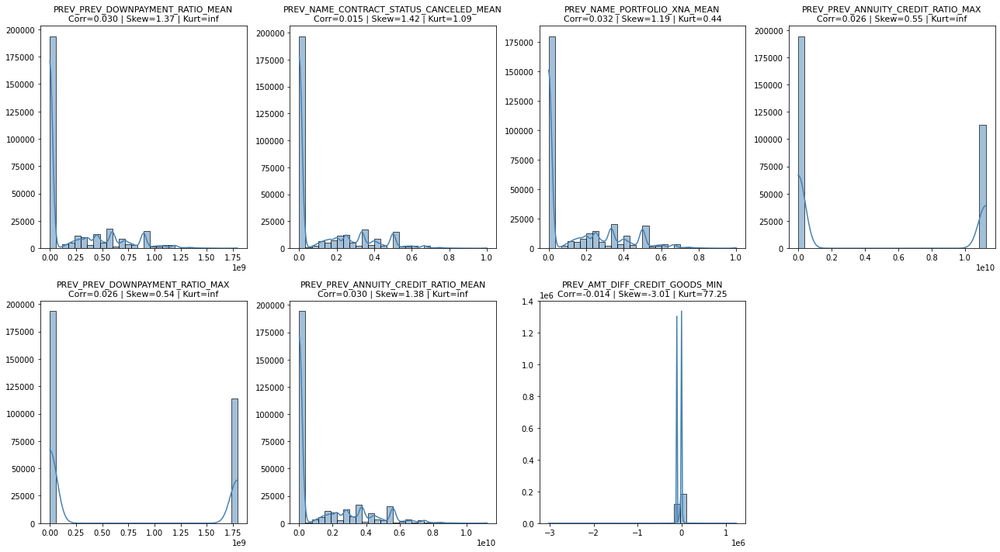

In [137]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_PREV_DOWNPAYMENT_RATIO_MEAN', 'PREV_NAME_CONTRACT_STATUS_CANCELED_MEAN', 'PREV_NAME_PORTFOLIO_XNA_MEAN', 'PREV_PREV_ANNUITY_CREDIT_RATIO_MAX', 
            'PREV_PREV_DOWNPAYMENT_RATIO_MAX', 'PREV_PREV_ANNUITY_CREDIT_RATIO_MEAN', 'PREV_AMT_DIFF_CREDIT_GOODS_MIN']

plot_transformations_distributions(
    df=df_train_median_missing_linear,
    var_list=transfos,
    target='TARGET'
)

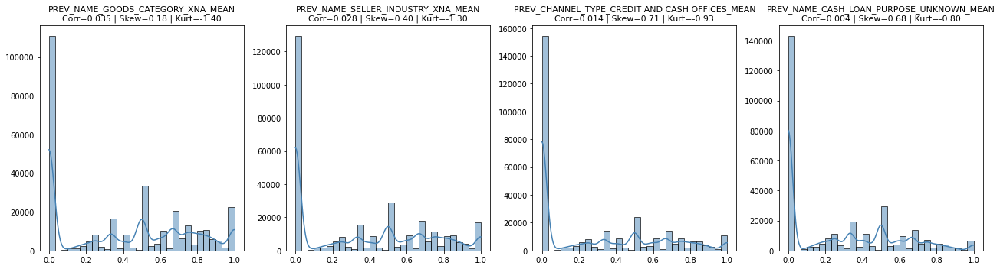

In [138]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_NAME_GOODS_CATEGORY_XNA_MEAN', 'PREV_NAME_SELLER_INDUSTRY_XNA_MEAN', 'PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_MEAN', 
            'PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_MEAN']

plot_transformations_distributions(
    df=df_train_median_missing_linear,
    var_list=transfos,
    target='TARGET'
)

- On retrouve globalemment les mêmes variables à quelques différences près.

In [139]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

cols_to_drop = [
    'PREV_IS_DOWNPAYMENT_SUM', 'PREV_PRODUCT_COMB_SIMPLIFIED_CASH_SUM', 'PREV_NAME_SELLER_INDUSTRY_XNA_SUM', 
    'PREV_NAME_PORTFOLIO_CASH_SUM', 'PREV_NAME_CLIENT_TYPE_REPEATER_SUM', 'PREV_PRODUCT_COMB_SIMPLIFIED_X_SELL_SUM',
    'PREV_NAME_TYPE_SUITE_MISSING_SUM', 'PREV_IS_CREDIT_OVER_GOODS_SUM', 'PREV_NAME_PRODUCT_TYPE_X-SELL_SUM',
    'PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_SUM', 'PREV_NAME_CONTRACT_STATUS_CANCELED_SUM', 'PREV_NAME_GOODS_CATEGORY_XNA_SUM', 'PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_SUM',
    'PREV_PREV_IS_RECENT_SUM', 'PREV_NB_APPLICATIONS', 'PREV_CODE_REJECT_REASON_XAP_SUM', 
    'PREV_NAME_PORTFOLIO_XNA_SUM',

    'PREV_DAYS_TERMINATION_MEAN', 'PREV_DAYS_LAST_DUE_1ST_VERSION_MIN', 'PREV_DAYS_LAST_DUE_1ST_VERSION_MEAN', 
    'PREV_DAYS_TERMINATION_MIN', 'PREV_DECISION_RECENCY_MAX', 'PREV_DECISION_RECENCY_MEAN',
    'PREV_DAYS_DECISION_MEAN', 'PREV_DAYS_LAST_DUE_MIN', 'PREV_DAYS_FIRST_DUE_MIN', 'PREV_DAYS_FIRST_DUE_MEAN', 'PREV_DAYS_LAST_DUE_MEAN',

    'PREV_AMT_APPLICATION_MAX', 'PREV_AMT_REMAINING_AFTER_DOWNPAY_MEAN', 'PREV_AMT_CREDIT_MAX', 
    'PREV_AMT_REMAINING_AFTER_DOWNPAY_MAX', 'PREV_AMT_CREDIT_MEAN', 'PREV_AMT_ANNUITY_MEAN', 'PREV_AMT_GOODS_PRICE_MEAN', 
    'PREV_AMT_APPLICATION_MEAN', 'PREV_AMT_GOODS_PRICE_MAX',

    'PREV_AMT_DIFF_CREDIT_GOODS_MIN', 'PREV_PREV_DOWNPAYMENT_RATIO_MEAN', 'PREV_PREV_DOWNPAYMENT_RATIO_MAX', 'PREV_PREV_ANNUITY_CREDIT_RATIO_MAX', 
    'PREV_NAME_CONTRACT_STATUS_CANCELED_MEAN', 'PREV_PREV_ANNUITY_CREDIT_RATIO_MEAN',

    'PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_MEAN', 'PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_MEAN', 
    'PREV_NAME_SELLER_INDUSTRY_XNA_MEAN', 

    'PREV_CODE_REJECT_REASON_HC_SUM', 'PREV_NAME_CONTRACT_STATUS_REFUSED_SUM',

    'PREV_NAME_CASH_LOAN_PURPOSE_XAP_MEAN', 'PREV_NAME_CONTRACT_TYPE_CONSUMER LOANS_MEAN',

    'PREV_NAME_CONTRACT_TYPE_CONSUMER LOANS_SUM', 'PREV_NAME_CASH_LOAN_PURPOSE_XAP_SUM',

    'PREV_DAYS_LAST_DUE_MAX', 'PREV_DAYS_TERMINATION_MAX',

    'PREV_NAME_GOODS_CATEGORY_MOBILE_MEAN', 'PREV_PRODUCT_COMB_SIMPLIFIED_POS_MOBILE_MEAN',

    'PREV_PRODUCT_COMB_SIMPLIFIED_POS_MOBILE_SUM', 'PREV_NAME_GOODS_CATEGORY_MOBILE_SUM',

    'PREV_PRODUCT_COMB_SIMPLIFIED_CARD_MEAN', 'PREV_CODE_REJECT_REASON_SYSTEM_SUM',

    'PREV_PREV_CREDIT_PER_PAYMENT_MEAN', 'PREV_PREV_APP_CREDIT_RATIO_MEAN', 'PREV_PREV_APP_CREDIT_RATIO_MAX',

    'PREV_NAME_CONTRACT_TYPE_XNA_MEAN', 'PREV_CODE_REJECT_REASON_XNA_SUM', 'PREV_PREV_DURATION_ESTIMATED_MEAN', 'PREV_NAME_CONTRACT_STATUS_UNUSED OFFER_SUM',

    'PREV_AMT_REMAINING_AFTER_DOWNPAY_MIN', 'PREV_PREV_DURATION_ESTIMATED_MAX', 'PREV_PRODUCT_COMB_SIMPLIFIED_CARD_SUM',

    'PREV_DAYS_FIRST_DUE_MAX', 'PREV_NAME_SELLER_INDUSTRY_FURNITURE_SUM', 'PREV_NAME_GOODS_CATEGORY_FURNITURE_MEAN',

    'PREV_NAME_SELLER_INDUSTRY_CONSUMER ELECTRONICS_SUM', 'PREV_PRODUCT_COMB_SIMPLIFIED_X_SELL_MEAN',

    'PREV_NAME_SELLER_INDUSTRY_CONSUMER ELECTRONICS_MEAN', 'PREV_NAME_PORTFOLIO_CARS_MEAN', 'PREV_NAME_TYPE_SUITE_MISSING_SUM'
]

df_train_median_missing_linear.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [140]:
remaining_cols = list(set(df_previous_train_median_missing_linear_agg.columns).intersection(df_train_median_missing_linear.columns))

In [141]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_train_median_missing_linear[remaining_cols], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation


In [142]:
# Réduction de la taille du dataframe.

optimize_types(df_train_median_missing_linear)

 Mémoire avant : 607.03 MB
 Mémoire après : 460.40 MB
 Gain : 24.2%


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_ANNUITY,REGION_POPULATION_RELATIVE,OWN_CAR_AGE,FLAG_MOBIL,...,PREV_NAME_YIELD_GROUP_MIDDLE_MEAN,PREV_NAME_YIELD_GROUP_MIDDLE_SUM,PREV_PRODUCT_COMB_SIMPLIFIED_CASH_MEAN,PREV_PRODUCT_COMB_SIMPLIFIED_POS_HOUSEHOLD_MEAN,PREV_PRODUCT_COMB_SIMPLIFIED_POS_HOUSEHOLD_SUM,PREV_PRODUCT_COMB_SIMPLIFIED_POS_INDUSTRY_MEAN,PREV_PRODUCT_COMB_SIMPLIFIED_POS_INDUSTRY_SUM,PREV_PRODUCT_COMB_SIMPLIFIED_POS_OTHERS_MEAN,PREV_PRODUCT_COMB_SIMPLIFIED_POS_OTHERS_SUM,PREV_NB_REFUSED
0,100002,1,0,1,0,1,24700.5,0.018801,9,1,...,0.000000,0,0.000000,0.000000,0,0.000000,0,1.0,1,0
1,100003,0,0,0,0,0,35698.5,0.003541,9,1,...,0.666667,2,0.000000,0.333333,1,0.333333,1,0.0,0,0
2,100004,0,1,1,1,1,6750.0,0.010032,26,1,...,1.000000,1,0.000000,0.000000,0,0.000000,0,0.0,0,0
3,100006,0,0,0,0,1,29686.5,0.008019,9,1,...,0.111111,1,0.222222,0.111111,1,0.111111,1,0.0,0,1
4,100007,0,0,1,0,1,21865.5,0.028663,9,1,...,0.500000,3,0.166667,0.166667,1,0.000000,0,0.0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307495,456251,0,0,1,0,0,27558.0,0.032561,9,1,...,0.000000,0,0.000000,0.000000,0,0.000000,0,0.0,0,0
307496,456252,0,0,0,0,1,12001.5,0.025164,9,1,...,0.000000,0,0.000000,1.000000,1,0.000000,0,0.0,0,0
307497,456253,0,0,0,0,1,29979.0,0.005002,9,1,...,0.000000,0,0.000000,0.000000,0,0.000000,0,0.0,0,0
307498,456254,1,0,0,0,1,20205.0,0.005313,9,1,...,0.000000,0,0.000000,0.500000,1,0.000000,0,0.0,0,0


#### Corrélation des variables - df_train_iterative_mode_linear

In [143]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_iterative_mode_linear[df_previous_train_iterative_mode_linear_agg.columns.tolist()], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,PREV_PREV_APP_CREDIT_RATIO_MAX / PREV_PREV_APP_CREDIT_RATIO_MEAN,PREV_PREV_APP_CREDIT_RATIO_MEAN,PREV_PREV_APP_CREDIT_RATIO_MAX,1.000000
1,PREV_DAYS_DECISION_MEAN / PREV_DECISION_RECENCY_MEAN,PREV_DAYS_DECISION_MEAN,PREV_DECISION_RECENCY_MEAN,-1.000000
2,PREV_DAYS_DECISION_MIN / PREV_DECISION_RECENCY_MAX,PREV_DAYS_DECISION_MIN,PREV_DECISION_RECENCY_MAX,-1.000000
3,PREV_AMT_APPLICATION_MAX / PREV_AMT_GOODS_PRICE_MAX,PREV_AMT_APPLICATION_MAX,PREV_AMT_GOODS_PRICE_MAX,0.999965
4,PREV_AMT_APPLICATION_MEAN / PREV_AMT_GOODS_PRICE_MEAN,PREV_AMT_APPLICATION_MEAN,PREV_AMT_GOODS_PRICE_MEAN,0.999958
5,PREV_DAYS_DECISION_MIN / PREV_DAYS_FIRST_DUE_MIN,PREV_DAYS_DECISION_MIN,PREV_DAYS_FIRST_DUE_MIN,0.999799
6,PREV_DAYS_FIRST_DUE_MIN / PREV_DECISION_RECENCY_MAX,PREV_DAYS_FIRST_DUE_MIN,PREV_DECISION_RECENCY_MAX,-0.999799
7,PREV_DAYS_DECISION_MEAN / PREV_DAYS_FIRST_DUE_MEAN,PREV_DAYS_DECISION_MEAN,PREV_DAYS_FIRST_DUE_MEAN,0.999608
8,PREV_DAYS_FIRST_DUE_MEAN / PREV_DECISION_RECENCY_MEAN,PREV_DAYS_FIRST_DUE_MEAN,PREV_DECISION_RECENCY_MEAN,-0.999608
9,PREV_PREV_ANNUITY_CREDIT_RATIO_MEAN / PREV_PREV_DOWNPAYMENT_RATIO_MEAN,PREV_PREV_ANNUITY_CREDIT_RATIO_MEAN,PREV_PREV_DOWNPAYMENT_RATIO_MEAN,-0.999029


In [144]:
df_corr = get_correlation_pairs(df_train_iterative_mode_linear[df_previous_train_iterative_mode_linear_agg.columns.tolist()], method="pearson", style=False, threshold=0.8)

In [145]:
var_corr = df_corr['Variable 1'].unique().tolist() + df_corr['Variable 2'].unique().tolist()
var_corr = list(set(var_corr))

In [146]:
# Visualisation des corrélations les plus importantes avec la Target.
pd.set_option('display.max_rows', None)

target_corr = compute_target_correlations(df_train_iterative_mode_linear.loc[:, var_corr + ['TARGET']], 'TARGET', mode='linear', plot=False)
target_corr.loc[var_corr].sort_values(by='pearson_corr', ascending=False)

,pearson_corr,spearman_corr,abs_pearson,abs_spearman,score_global
PREV_NB_REFUSED,0.064766,0.063693,0.064766,0.063693,0.064229
PREV_NAME_CONTRACT_STATUS_REFUSED_SUM,0.064766,0.063693,0.064766,0.063693,0.064229
PREV_PRODUCT_COMB_SIMPLIFIED_CARD_SUM,0.048560,0.044427,0.048560,0.044427,0.046493
PREV_CODE_REJECT_REASON_HC_SUM,0.047488,0.050216,0.047488,0.050216,0.048852
PREV_NAME_CONTRACT_TYPE_REVOLVING LOANS_SUM,0.046655,0.042912,0.046655,0.042912,0.044784
PREV_DAYS_FIRST_DUE_MIN,0.041741,0.041306,0.041741,0.041306,0.041523
PREV_DAYS_DECISION_MIN,0.041373,0.041187,0.041373,0.041187,0.041280
PREV_NAME_PAYMENT_TYPE_XNA_SUM,0.041272,0.036190,0.041272,0.036190,0.038731
PREV_DAYS_LAST_DUE_MIN,0.041136,0.039236,0.041136,0.039236,0.040186
PREV_PRODUCT_COMB_SIMPLIFIED_CARD_MEAN,0.041037,0.042995,0.041037,0.042995,0.042016


In [147]:
pd.reset_option('display.max_rows')

In [148]:
# Fonction permettant de visualiser les groupes de corrélations afin de faire un choix de variable.

pd.set_option('display.max_colwidth', None)
summarize_correlated_groups(df_corr, X=df_train_iterative_mode_linear, y=df_train_iterative_mode_linear['TARGET'])

,Variables du groupe,Taille du groupe,Corrélation max avec y,Variable la plus corrélée
0,"[PREV_CODE_REJECT_REASON_XAP_SUM, PREV_NAME_GOODS_CATEGORY_XNA_SUM, PREV_IS_CREDIT_OVER_GOODS_SUM, PREV_PRODUCT_COMB_SIMPLIFIED_CASH_SUM, PREV_NAME_CLIENT_TYPE_REPEATER_SUM, PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_SUM, PREV_NAME_PORTFOLIO_CASH_SUM, PREV_NAME_PAYMENT_TYPE_XNA_SUM, PREV_NAME_TYPE_SUITE_UNACCOMPANIED_SUM, PREV_NAME_PRODUCT_TYPE_X-SELL_SUM, PREV_NAME_CONTRACT_STATUS_CANCELED_SUM, PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_SUM, PREV_PREV_IS_RECENT_SUM, PREV_NB_APPLICATIONS, PREV_NAME_PORTFOLIO_XNA_SUM, PREV_NAME_SELLER_INDUSTRY_XNA_SUM, PREV_PRODUCT_COMB_SIMPLIFIED_X_SELL_SUM]",17,0.041272,PREV_NAME_PAYMENT_TYPE_XNA_SUM
1,"[PREV_AMT_GOODS_PRICE_MEAN, PREV_AMT_CREDIT_MAX, PREV_AMT_GOODS_PRICE_MAX, PREV_AMT_APPLICATION_MAX, PREV_AMT_ANNUITY_MAX, PREV_AMT_ANNUITY_MEAN, PREV_AMT_CREDIT_MEAN, PREV_AMT_APPLICATION_MEAN]",8,0.022061,PREV_AMT_ANNUITY_MEAN
2,"[PREV_DAYS_LAST_DUE_1ST_VERSION_MAX, PREV_PREV_DURATION_ESTIMATED_MAX, PREV_AMT_REMAINING_AFTER_DOWNPAY_MAX, PREV_PREV_DURATION_FIRST_VERSION_MAX, PREV_DAYS_LAST_DUE_MAX, PREV_DAYS_TERMINATION_MAX, PREV_PREV_LAST_DUE_DELAY_MAX]",7,0.012902,PREV_DAYS_LAST_DUE_1ST_VERSION_MAX
3,"[PREV_DECISION_RECENCY_MEAN, PREV_DAYS_LAST_DUE_MEAN, PREV_DAYS_LAST_DUE_1ST_VERSION_MEAN, PREV_DAYS_TERMINATION_MEAN, PREV_DAYS_DECISION_MEAN, PREV_DAYS_FIRST_DUE_MEAN]",6,0.037510,PREV_DAYS_FIRST_DUE_MEAN
4,"[PREV_DAYS_LAST_DUE_1ST_VERSION_MIN, PREV_DECISION_RECENCY_MAX, PREV_DAYS_FIRST_DUE_MIN, PREV_DAYS_TERMINATION_MIN, PREV_DAYS_LAST_DUE_MIN, PREV_DAYS_DECISION_MIN]",6,0.041741,PREV_DAYS_FIRST_DUE_MIN
5,"[PREV_PREV_DOWNPAYMENT_RATIO_MEAN, PREV_NAME_PORTFOLIO_XNA_MEAN, PREV_NAME_CONTRACT_STATUS_CANCELED_MEAN, PREV_PREV_ANNUITY_CREDIT_RATIO_MEAN, PREV_PREV_ANNUITY_CREDIT_RATIO_MAX]",5,0.031553,PREV_NAME_PORTFOLIO_XNA_MEAN
6,"[PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_MEAN, PREV_NAME_GOODS_CATEGORY_XNA_MEAN, PREV_NAME_SELLER_INDUSTRY_XNA_MEAN, PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_MEAN]",4,0.035253,PREV_NAME_GOODS_CATEGORY_XNA_MEAN
7,"[PREV_PREV_DURATION_FIRST_VERSION_MEAN, PREV_AMT_REMAINING_AFTER_DOWNPAY_MEAN, PREV_AMT_DOWN_PAYMENT_SUM, PREV_AMT_DOWN_PAYMENT_MEAN]",4,0.009793,PREV_AMT_DOWN_PAYMENT_SUM
8,"[PREV_NAME_CASH_LOAN_PURPOSE_XAP_MEAN, PREV_NAME_CONTRACT_TYPE_CONSUMER LOANS_MEAN, PREV_NAME_PORTFOLIO_POS_MEAN]",3,0.025031,PREV_NAME_PORTFOLIO_POS_MEAN
9,"[PREV_NAME_CONTRACT_TYPE_CONSUMER LOANS_SUM, PREV_NAME_CASH_LOAN_PURPOSE_XAP_SUM, PREV_NAME_PORTFOLIO_POS_SUM]",3,0.018163,PREV_NAME_PORTFOLIO_POS_SUM


In [149]:
pd.reset_option('display.max_colwidth')

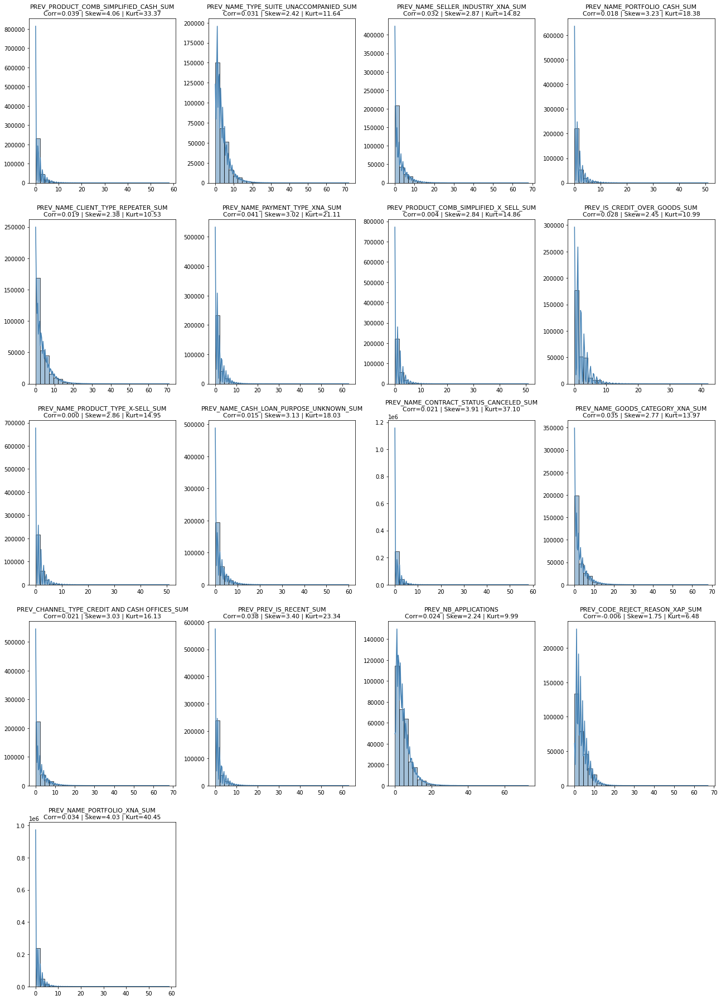

In [150]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_PRODUCT_COMB_SIMPLIFIED_CASH_SUM', 'PREV_NAME_TYPE_SUITE_UNACCOMPANIED_SUM', 'PREV_NAME_SELLER_INDUSTRY_XNA_SUM', 
            'PREV_NAME_PORTFOLIO_CASH_SUM', 'PREV_NAME_CLIENT_TYPE_REPEATER_SUM', 'PREV_NAME_PAYMENT_TYPE_XNA_SUM', 'PREV_PRODUCT_COMB_SIMPLIFIED_X_SELL_SUM',
            'PREV_IS_CREDIT_OVER_GOODS_SUM', 'PREV_NAME_PRODUCT_TYPE_X-SELL_SUM', 'PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_SUM',
            'PREV_NAME_CONTRACT_STATUS_CANCELED_SUM', 'PREV_NAME_GOODS_CATEGORY_XNA_SUM', 'PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_SUM', 'PREV_PREV_IS_RECENT_SUM',
            'PREV_NB_APPLICATIONS', 'PREV_CODE_REJECT_REASON_XAP_SUM', 'PREV_NAME_PORTFOLIO_XNA_SUM']

plot_transformations_distributions(
    df=df_train_iterative_mode_linear,
    var_list=transfos,
    target='TARGET'
)

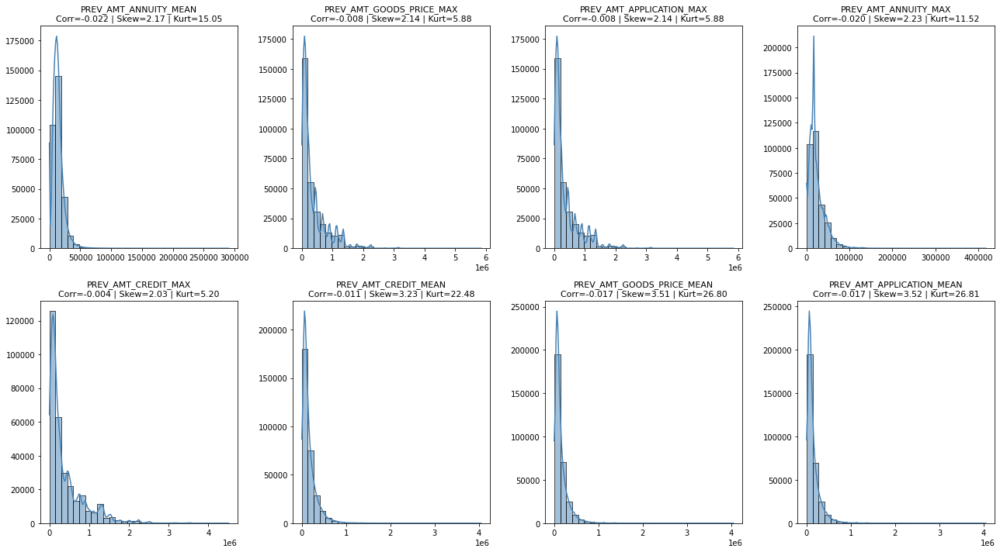

In [151]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_AMT_ANNUITY_MEAN', 'PREV_AMT_GOODS_PRICE_MAX', 'PREV_AMT_APPLICATION_MAX', 'PREV_AMT_ANNUITY_MAX', 'PREV_AMT_CREDIT_MAX', 'PREV_AMT_CREDIT_MEAN', 
            'PREV_AMT_GOODS_PRICE_MEAN', 'PREV_AMT_APPLICATION_MEAN']

plot_transformations_distributions(
    df=df_train_iterative_mode_linear,
    var_list=transfos,
    target='TARGET'
)

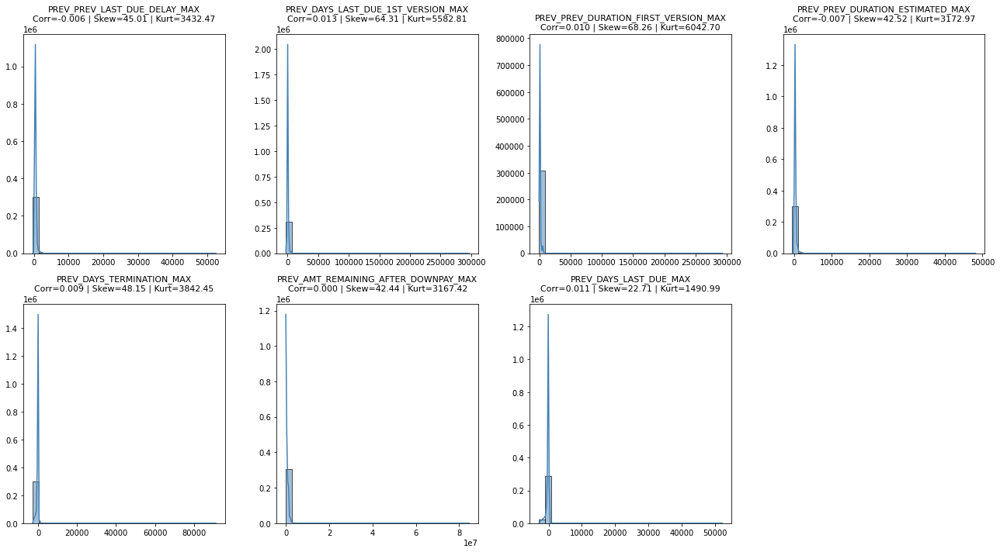

In [152]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_PREV_LAST_DUE_DELAY_MAX', 'PREV_DAYS_LAST_DUE_1ST_VERSION_MAX', 'PREV_PREV_DURATION_FIRST_VERSION_MAX', 'PREV_PREV_DURATION_ESTIMATED_MAX', 
            'PREV_DAYS_TERMINATION_MAX', 'PREV_AMT_REMAINING_AFTER_DOWNPAY_MAX', 'PREV_DAYS_LAST_DUE_MAX']

plot_transformations_distributions(
    df=df_train_iterative_mode_linear,
    var_list=transfos,
    target='TARGET'
)

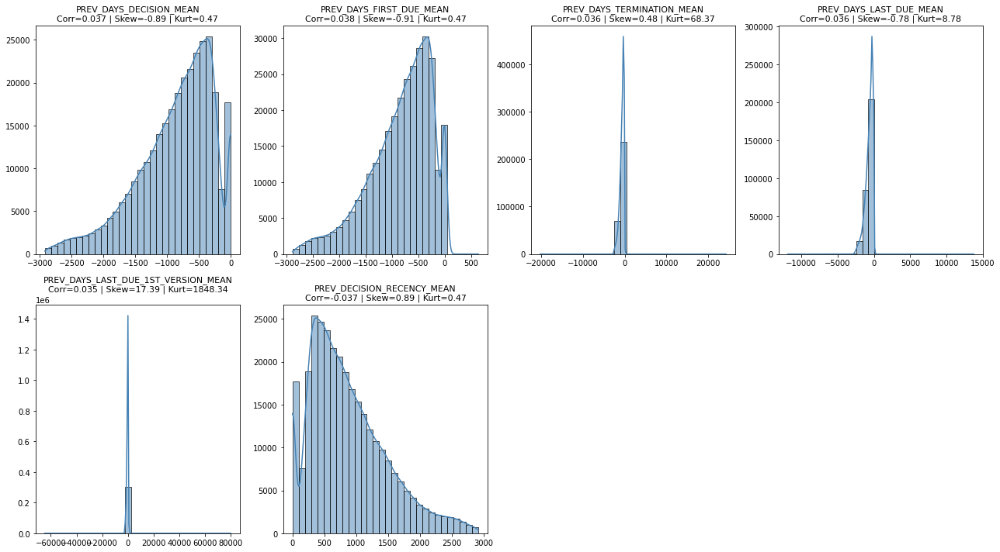

In [153]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_DAYS_DECISION_MEAN', 'PREV_DAYS_FIRST_DUE_MEAN', 'PREV_DAYS_TERMINATION_MEAN', 'PREV_DAYS_LAST_DUE_MEAN', 
            'PREV_DAYS_LAST_DUE_1ST_VERSION_MEAN', 'PREV_DECISION_RECENCY_MEAN']

plot_transformations_distributions(
    df=df_train_iterative_mode_linear,
    var_list=transfos,
    target='TARGET'
)

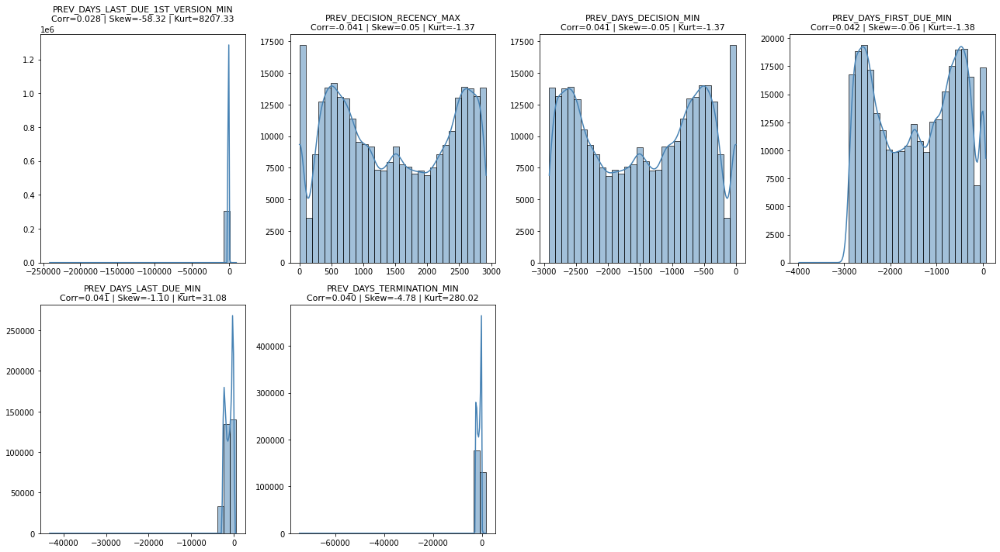

In [154]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_DAYS_LAST_DUE_1ST_VERSION_MIN', 'PREV_DECISION_RECENCY_MAX', 'PREV_DAYS_DECISION_MIN', 'PREV_DAYS_FIRST_DUE_MIN', 
            'PREV_DAYS_LAST_DUE_MIN', 'PREV_DAYS_TERMINATION_MIN']

plot_transformations_distributions(
    df=df_train_iterative_mode_linear,
    var_list=transfos,
    target='TARGET'
)

c:\Users\Caomghin\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1076: RuntimeWarning:

overflow encountered in square

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\core\_methods.py:118: RuntimeWarning:

overflow encountered in reduce

c:\Users\Caomghin\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1076: RuntimeWarning:

overflow encountered in square

c:\Users\Caomghin\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1076: RuntimeWarning:

overflow encountered in square

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\core\_methods.py:118: RuntimeWarning:

overflow encountered in reduce



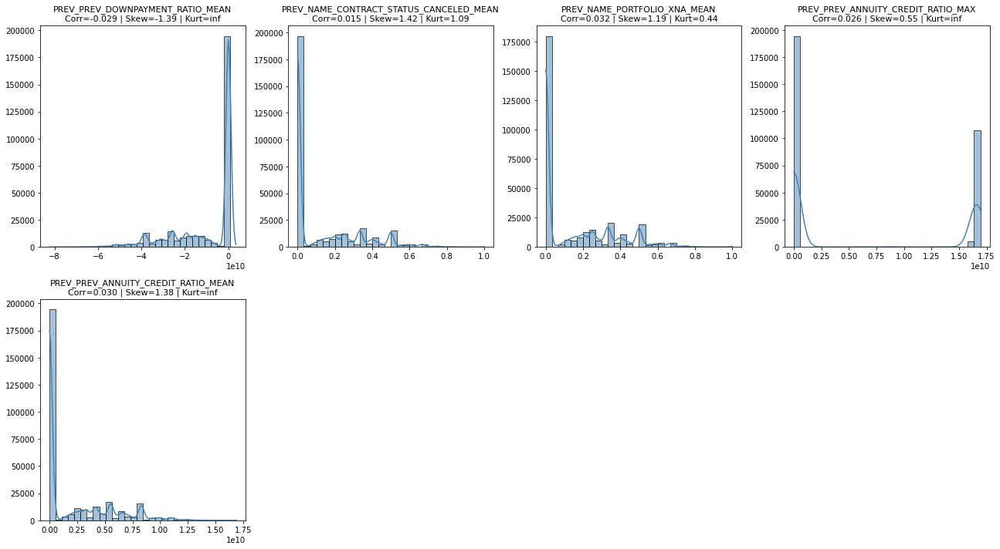

In [155]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_PREV_DOWNPAYMENT_RATIO_MEAN', 'PREV_NAME_CONTRACT_STATUS_CANCELED_MEAN', 'PREV_NAME_PORTFOLIO_XNA_MEAN', 
            'PREV_PREV_ANNUITY_CREDIT_RATIO_MAX', 'PREV_PREV_ANNUITY_CREDIT_RATIO_MEAN']

plot_transformations_distributions(
    df=df_train_iterative_mode_linear,
    var_list=transfos,
    target='TARGET'
)

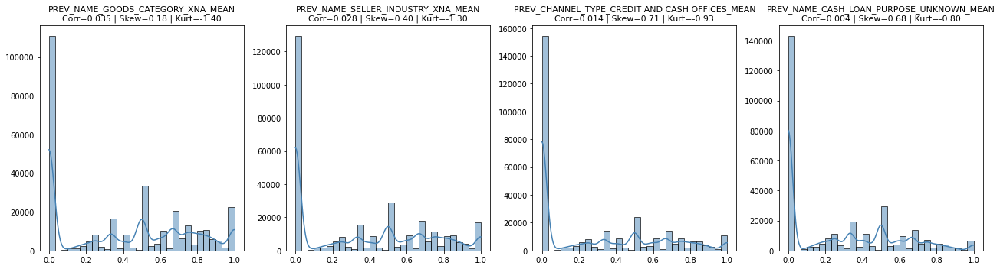

In [156]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_NAME_GOODS_CATEGORY_XNA_MEAN', 'PREV_NAME_SELLER_INDUSTRY_XNA_MEAN', 'PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_MEAN', 
            'PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_MEAN']

plot_transformations_distributions(
    df=df_train_iterative_mode_linear,
    var_list=transfos,
    target='TARGET'
)

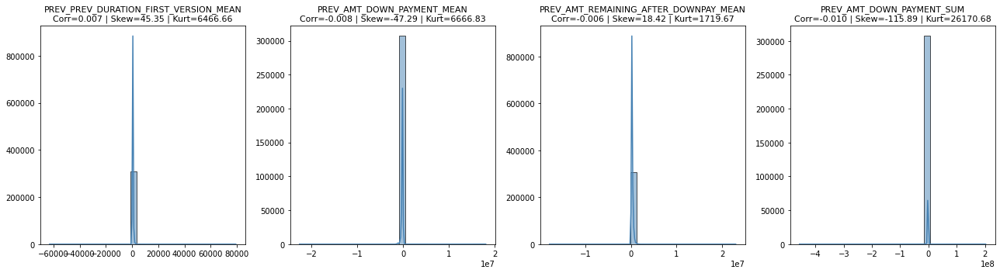

In [157]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_PREV_DURATION_FIRST_VERSION_MEAN', 'PREV_AMT_DOWN_PAYMENT_MEAN', 'PREV_AMT_REMAINING_AFTER_DOWNPAY_MEAN', 
            'PREV_AMT_DOWN_PAYMENT_SUM']

plot_transformations_distributions(
    df=df_train_iterative_mode_linear,
    var_list=transfos,
    target='TARGET'
)

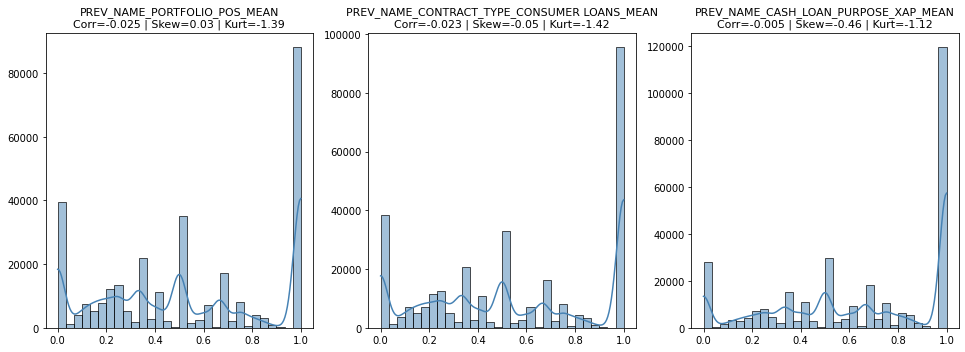

In [158]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_NAME_PORTFOLIO_POS_MEAN', 'PREV_NAME_CONTRACT_TYPE_CONSUMER LOANS_MEAN', 'PREV_NAME_CASH_LOAN_PURPOSE_XAP_MEAN']

plot_transformations_distributions(
    df=df_train_iterative_mode_linear,
    var_list=transfos,
    target='TARGET'
)

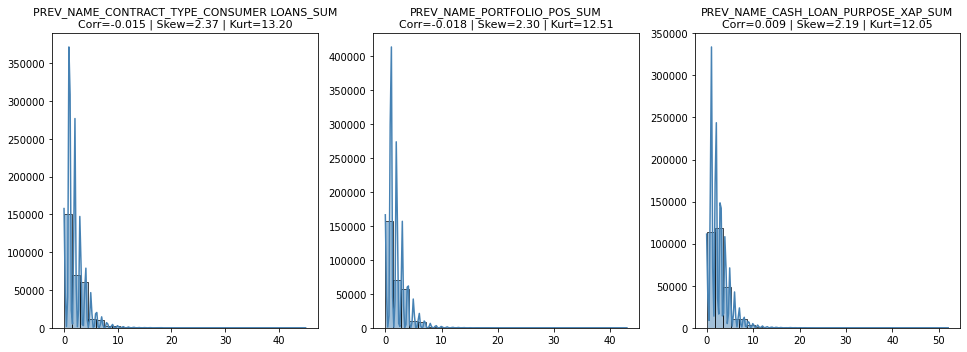

In [159]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_NAME_CONTRACT_TYPE_CONSUMER LOANS_SUM', 'PREV_NAME_PORTFOLIO_POS_SUM', 'PREV_NAME_CASH_LOAN_PURPOSE_XAP_SUM']

plot_transformations_distributions(
    df=df_train_iterative_mode_linear,
    var_list=transfos,
    target='TARGET'
)

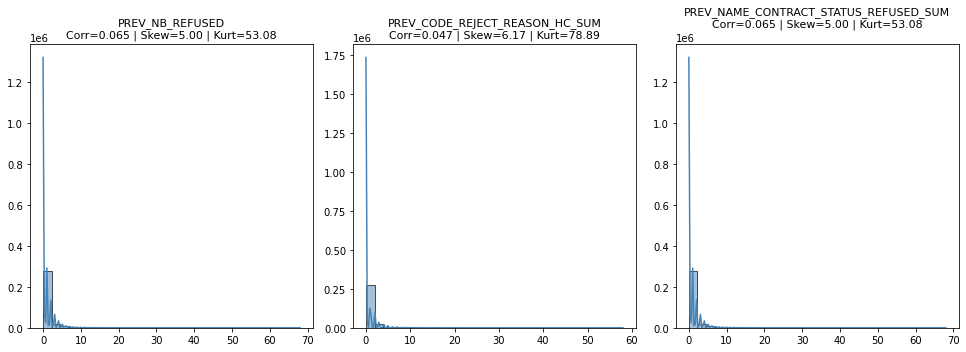

In [160]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_NB_REFUSED', 'PREV_CODE_REJECT_REASON_HC_SUM', 'PREV_NAME_CONTRACT_STATUS_REFUSED_SUM']

plot_transformations_distributions(
    df=df_train_iterative_mode_linear,
    var_list=transfos,
    target='TARGET'
)

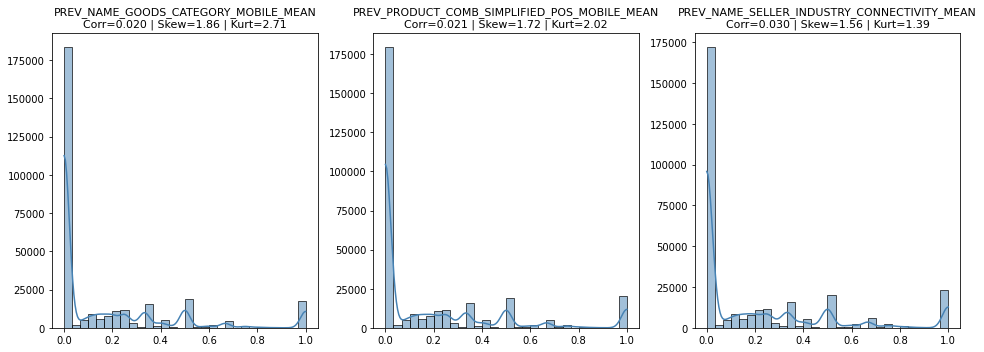

In [161]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_NAME_GOODS_CATEGORY_MOBILE_MEAN', 'PREV_PRODUCT_COMB_SIMPLIFIED_POS_MOBILE_MEAN', 'PREV_NAME_SELLER_INDUSTRY_CONNECTIVITY_MEAN']

plot_transformations_distributions(
    df=df_train_iterative_mode_linear,
    var_list=transfos,
    target='TARGET'
)

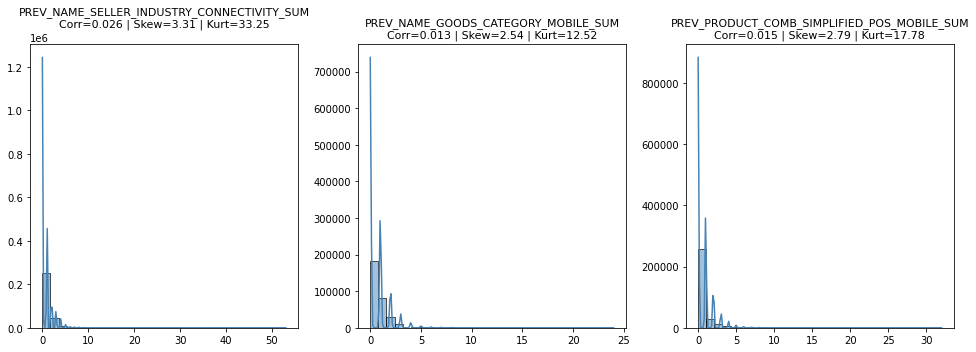

In [162]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_NAME_SELLER_INDUSTRY_CONNECTIVITY_SUM', 'PREV_NAME_GOODS_CATEGORY_MOBILE_SUM', 'PREV_PRODUCT_COMB_SIMPLIFIED_POS_MOBILE_SUM']

plot_transformations_distributions(
    df=df_train_iterative_mode_linear,
    var_list=transfos,
    target='TARGET'
)

In [163]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

cols_to_drop = [
    'PREV_PRODUCT_COMB_SIMPLIFIED_CASH_SUM', 'PREV_NAME_TYPE_SUITE_UNACCOMPANIED_SUM', 'PREV_NAME_SELLER_INDUSTRY_XNA_SUM', 
    'PREV_NAME_PORTFOLIO_CASH_SUM', 'PREV_NAME_CLIENT_TYPE_REPEATER_SUM', 'PREV_PRODUCT_COMB_SIMPLIFIED_X_SELL_SUM',
    'PREV_IS_CREDIT_OVER_GOODS_SUM', 'PREV_NAME_PRODUCT_TYPE_X-SELL_SUM', 'PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_SUM',
    'PREV_NAME_CONTRACT_STATUS_CANCELED_SUM', 'PREV_NAME_GOODS_CATEGORY_XNA_SUM', 'PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_SUM', 'PREV_PREV_IS_RECENT_SUM',
    'PREV_NB_APPLICATIONS', 'PREV_CODE_REJECT_REASON_XAP_SUM', 'PREV_NAME_PORTFOLIO_XNA_SUM',

    'PREV_AMT_GOODS_PRICE_MAX', 'PREV_AMT_APPLICATION_MAX', 'PREV_AMT_ANNUITY_MAX', 'PREV_AMT_CREDIT_MAX', 'PREV_AMT_CREDIT_MEAN', 
    'PREV_AMT_GOODS_PRICE_MEAN', 'PREV_AMT_APPLICATION_MEAN',

    'PREV_PREV_LAST_DUE_DELAY_MAX', 'PREV_DAYS_LAST_DUE_1ST_VERSION_MAX', 'PREV_PREV_DURATION_FIRST_VERSION_MAX', 'PREV_PREV_DURATION_ESTIMATED_MAX', 
    'PREV_DAYS_TERMINATION_MAX', 'PREV_AMT_REMAINING_AFTER_DOWNPAY_MAX',

    'PREV_DAYS_DECISION_MEAN', 'PREV_DAYS_TERMINATION_MEAN', 'PREV_DAYS_LAST_DUE_MEAN', 
    'PREV_DAYS_LAST_DUE_1ST_VERSION_MEAN', 'PREV_DECISION_RECENCY_MEAN',

    'PREV_DAYS_LAST_DUE_1ST_VERSION_MIN', 'PREV_DECISION_RECENCY_MAX', 'PREV_DAYS_DECISION_MIN', 'PREV_DAYS_LAST_DUE_MIN', 'PREV_DAYS_TERMINATION_MIN',

    'PREV_PREV_DOWNPAYMENT_RATIO_MEAN', 'PREV_NAME_CONTRACT_STATUS_CANCELED_MEAN', 'PREV_PREV_ANNUITY_CREDIT_RATIO_MAX', 'PREV_PREV_ANNUITY_CREDIT_RATIO_MEAN', 

    'PREV_NAME_SELLER_INDUSTRY_XNA_MEAN', 'PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_MEAN', 
    'PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_MEAN',

    'PREV_PREV_DURATION_FIRST_VERSION_MEAN', 'PREV_AMT_DOWN_PAYMENT_MEAN', 'PREV_AMT_DOWN_PAYMENT_SUM',

    'PREV_NAME_CONTRACT_TYPE_CONSUMER LOANS_MEAN', 'PREV_NAME_CASH_LOAN_PURPOSE_XAP_MEAN',

    'PREV_NAME_CONTRACT_TYPE_CONSUMER LOANS_SUM', 'PREV_NAME_CASH_LOAN_PURPOSE_XAP_SUM',

    'PREV_CODE_REJECT_REASON_HC_SUM', 'PREV_NAME_CONTRACT_STATUS_REFUSED_SUM',

    'PREV_NAME_GOODS_CATEGORY_MOBILE_MEAN', 'PREV_PRODUCT_COMB_SIMPLIFIED_POS_MOBILE_MEAN',

    'PREV_NAME_GOODS_CATEGORY_MOBILE_SUM', 'PREV_PRODUCT_COMB_SIMPLIFIED_POS_MOBILE_SUM',

    'PREV_CODE_REJECT_REASON_XNA_MEAN', 'PREV_NAME_CONTRACT_TYPE_XNA_MEAN',

    'PREV_PREV_CREDIT_PER_PAYMENT_MEAN', 'PREV_AMT_DIFF_CREDIT_GOODS_MAX',

    'PREV_NAME_CONTRACT_STATUS_UNUSED OFFER_MEAN', 'PREV_CODE_REJECT_REASON_SYSTEM_MEAN',

    'PREV_NAME_CONTRACT_TYPE_REVOLVING LOANS_MEAN', 'PREV_PREV_APP_CREDIT_RATIO_MAX',

    'PREV_NAME_CONTRACT_TYPE_REVOLVING LOANS_SUM', 'PREV_NAME_SELLER_INDUSTRY_FURNITURE_SUM',

    'PREV_NAME_SELLER_INDUSTRY_FURNITURE_MEAN', 'PREV_NAME_SELLER_INDUSTRY_CONSUMER ELECTRONICS_SUM',

    'PREV_PRODUCT_COMB_SIMPLIFIED_X_SELL_MEAN', 'PREV_NAME_SELLER_INDUSTRY_CONSUMER ELECTRONICS_MEAN',

    'PREV_PREV_LAST_DUE_DELAY_MEAN', 'PREV_DAYS_DECISION_MAX', 'PREV_NAME_PORTFOLIO_CARS_MEAN'

]

df_train_iterative_mode_linear.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [164]:
remaining_cols = list(set(df_previous_train_iterative_mode_linear_agg.columns).intersection(df_train_iterative_mode_linear.columns))

In [165]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_train_iterative_mode_linear[remaining_cols], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation


In [166]:
# Réduction de la taille du dataframe.

optimize_types(df_train_iterative_mode_linear)

 Mémoire avant : 603.60 MB
 Mémoire après : 465.18 MB
 Gain : 22.9%


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_ANNUITY,REGION_POPULATION_RELATIVE,OWN_CAR_AGE,FLAG_MOBIL,...,PREV_PRODUCT_COMB_SIMPLIFIED_CARD_MEAN,PREV_PRODUCT_COMB_SIMPLIFIED_CARD_SUM,PREV_PRODUCT_COMB_SIMPLIFIED_CASH_MEAN,PREV_PRODUCT_COMB_SIMPLIFIED_POS_HOUSEHOLD_MEAN,PREV_PRODUCT_COMB_SIMPLIFIED_POS_HOUSEHOLD_SUM,PREV_PRODUCT_COMB_SIMPLIFIED_POS_INDUSTRY_MEAN,PREV_PRODUCT_COMB_SIMPLIFIED_POS_INDUSTRY_SUM,PREV_PRODUCT_COMB_SIMPLIFIED_POS_OTHERS_MEAN,PREV_PRODUCT_COMB_SIMPLIFIED_POS_OTHERS_SUM,PREV_NB_REFUSED
0,100002,1,0,1,0,1,24700.5,0.018801,19.190525,1,...,0.000000,0,0.000000,0.000000,0,0.000000,0,1.0,1,0
1,100003,0,0,0,0,0,35698.5,0.003541,16.384478,1,...,0.000000,0,0.000000,0.333333,1,0.333333,1,0.0,0,0
2,100004,0,1,1,1,1,6750.0,0.010032,26.000000,1,...,0.000000,0,0.000000,0.000000,0,0.000000,0,0.0,0,0
3,100006,0,0,0,0,1,29686.5,0.008019,12.254097,1,...,0.111111,1,0.222222,0.111111,1,0.111111,1,0.0,0,1
4,100007,0,0,1,0,1,21865.5,0.028663,14.331113,1,...,0.000000,0,0.166667,0.166667,1,0.000000,0,0.0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307495,456251,0,0,1,0,0,27558.0,0.032561,15.271110,1,...,0.000000,0,0.000000,0.000000,0,0.000000,0,0.0,0,0
307496,456252,0,0,0,0,1,12001.5,0.025164,16.182379,1,...,0.000000,0,0.000000,1.000000,1,0.000000,0,0.0,0,0
307497,456253,0,0,0,0,1,29979.0,0.005002,9.702058,1,...,0.000000,0,0.000000,0.000000,0,0.000000,0,0.0,0,0
307498,456254,1,0,0,0,1,20205.0,0.005313,15.203474,1,...,0.000000,0,0.000000,0.500000,1,0.000000,0,0.0,0,0


#### Corrélation des variables - df_train_nan_missing_linear

In [167]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_nan_missing_linear[df_previous_train_nan_missing_linear_agg.columns.tolist()], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,PREV_DAYS_DECISION_MEAN / PREV_DECISION_RECENCY_MEAN,PREV_DAYS_DECISION_MEAN,PREV_DECISION_RECENCY_MEAN,-1.000000
1,PREV_DAYS_DECISION_MIN / PREV_DECISION_RECENCY_MAX,PREV_DAYS_DECISION_MIN,PREV_DECISION_RECENCY_MAX,-1.000000
2,PREV_PREV_APP_CREDIT_RATIO_MAX / PREV_PREV_APP_CREDIT_RATIO_MEAN,PREV_PREV_APP_CREDIT_RATIO_MEAN,PREV_PREV_APP_CREDIT_RATIO_MAX,1.000000
3,PREV_AMT_APPLICATION_MAX / PREV_AMT_GOODS_PRICE_MAX,PREV_AMT_APPLICATION_MAX,PREV_AMT_GOODS_PRICE_MAX,0.999964
4,PREV_PREV_DURATION_ESTIMATED_MAX / PREV_PREV_LAST_DUE_DELAY_MAX,PREV_PREV_LAST_DUE_DELAY_MAX,PREV_PREV_DURATION_ESTIMATED_MAX,0.996935
5,PREV_PREV_DURATION_ESTIMATED_MEAN / PREV_PREV_LAST_DUE_DELAY_MEAN,PREV_PREV_LAST_DUE_DELAY_MEAN,PREV_PREV_DURATION_ESTIMATED_MEAN,0.996756
6,PREV_NAME_CONTRACT_TYPE_CONSUMER LOANS_MEAN / PREV_NAME_GOODS_CATEGORY_XNA_MEAN,PREV_NAME_CONTRACT_TYPE_CONSUMER LOANS_MEAN,PREV_NAME_GOODS_CATEGORY_XNA_MEAN,-0.991848
7,PREV_DAYS_LAST_DUE_1ST_VERSION_MIN / PREV_DAYS_LAST_DUE_MIN,PREV_DAYS_LAST_DUE_MIN,PREV_DAYS_LAST_DUE_1ST_VERSION_MIN,0.989488
8,PREV_DAYS_LAST_DUE_1ST_VERSION_MIN / PREV_DAYS_TERMINATION_MIN,PREV_DAYS_LAST_DUE_1ST_VERSION_MIN,PREV_DAYS_TERMINATION_MIN,0.989045
9,PREV_DAYS_LAST_DUE_MIN / PREV_DAYS_TERMINATION_MIN,PREV_DAYS_LAST_DUE_MIN,PREV_DAYS_TERMINATION_MIN,0.988512


In [168]:
df_corr = get_correlation_pairs(df_train_nan_missing_linear[df_previous_train_nan_missing_linear_agg.columns.tolist()], method="pearson", style=False, threshold=0.8)

In [169]:
var_corr = df_corr['Variable 1'].unique().tolist() + df_corr['Variable 2'].unique().tolist()
var_corr = list(set(var_corr))

In [170]:
# Visualisation des corrélations les plus importantes avec la Target.
pd.set_option('display.max_rows', None)

target_corr = compute_target_correlations(df_train_nan_missing_linear.loc[:, var_corr + ['TARGET']], 'TARGET', mode='linear', plot=False)
target_corr.loc[var_corr].sort_values(by='pearson_corr', ascending=False)

,pearson_corr,spearman_corr,abs_pearson,abs_spearman,score_global
PREV_NAME_CONTRACT_STATUS_REFUSED_MEAN,0.077682,0.067487,0.077682,0.067487,0.072585
PREV_NB_REFUSED,0.064482,0.063086,0.064482,0.063086,0.063784
PREV_NAME_CONTRACT_STATUS_REFUSED_SUM,0.064482,0.063086,0.064482,0.063086,0.063784
PREV_DAYS_FIRST_DUE_MIN,0.053637,0.053860,0.053637,0.053860,0.053749
PREV_DAYS_DECISION_MIN,0.053446,0.053638,0.053446,0.053638,0.053542
PREV_DAYS_LAST_DUE_MIN,0.048499,0.048582,0.048499,0.048582,0.048540
PREV_DAYS_TERMINATION_MIN,0.048198,0.048427,0.048198,0.048427,0.048312
PREV_PRODUCT_COMB_SIMPLIFIED_CARD_SUM,0.047969,0.043517,0.047969,0.043517,0.045743
PREV_CODE_REJECT_REASON_HC_SUM,0.047069,0.049417,0.047069,0.049417,0.048243
PREV_DAYS_DECISION_MEAN,0.046873,0.055209,0.046873,0.055209,0.051041


In [171]:
pd.reset_option('display.max_rows')

In [172]:
# Fonction permettant de visualiser les groupes de corrélations afin de faire un choix de variable.

pd.set_option('display.max_colwidth', None)
summarize_correlated_groups(df_corr, X=df_train_nan_missing_linear, y=df_train_nan_missing_linear['TARGET'])

,Variables du groupe,Taille du groupe,Corrélation max avec y,Variable la plus corrélée
0,"[PREV_CODE_REJECT_REASON_XAP_SUM, PREV_NAME_GOODS_CATEGORY_XNA_SUM, PREV_IS_CREDIT_OVER_GOODS_SUM, PREV_PRODUCT_COMB_SIMPLIFIED_CASH_SUM, PREV_NAME_CLIENT_TYPE_REPEATER_SUM, PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_SUM, PREV_NAME_PORTFOLIO_CASH_SUM, PREV_NAME_PAYMENT_TYPE_XNA_SUM, PREV_NAME_PRODUCT_TYPE_X-SELL_SUM, PREV_NAME_CONTRACT_STATUS_CANCELED_SUM, PREV_PREV_IS_RECENT_SUM, PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_SUM, PREV_NB_APPLICATIONS, PREV_NAME_PORTFOLIO_XNA_SUM, PREV_NAME_SELLER_INDUSTRY_XNA_SUM, PREV_NAME_TYPE_SUITE_MISSING_SUM, PREV_PRODUCT_COMB_SIMPLIFIED_X_SELL_SUM]",17,0.039481,PREV_NAME_PAYMENT_TYPE_XNA_SUM
1,"[PREV_DAYS_LAST_DUE_1ST_VERSION_MIN, PREV_DAYS_LAST_DUE_1ST_VERSION_MAX, PREV_DECISION_RECENCY_MEAN, PREV_DAYS_LAST_DUE_MEAN, PREV_DECISION_RECENCY_MAX, PREV_DAYS_FIRST_DUE_MIN, PREV_DAYS_DECISION_MIN, PREV_DAYS_LAST_DUE_MIN, PREV_DAYS_TERMINATION_MIN, PREV_DAYS_LAST_DUE_1ST_VERSION_MEAN, PREV_DAYS_LAST_DUE_MAX, PREV_DAYS_TERMINATION_MEAN, PREV_DAYS_DECISION_MEAN, PREV_DAYS_FIRST_DUE_MEAN, PREV_DAYS_TERMINATION_MAX]",15,0.053637,PREV_DAYS_FIRST_DUE_MIN
2,"[PREV_AMT_GOODS_PRICE_MEAN, PREV_AMT_CREDIT_MAX, PREV_AMT_GOODS_PRICE_MAX, PREV_AMT_APPLICATION_MAX, PREV_AMT_ANNUITY_MAX, PREV_AMT_ANNUITY_MEAN, PREV_AMT_CREDIT_MEAN, PREV_AMT_APPLICATION_MEAN]",8,0.034894,PREV_AMT_ANNUITY_MEAN
3,"[PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_MEAN, PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_MEAN, PREV_NAME_PORTFOLIO_CASH_MEAN, PREV_NAME_CASH_LOAN_PURPOSE_XAP_MEAN, PREV_NAME_GOODS_CATEGORY_XNA_MEAN, PREV_NAME_PORTFOLIO_POS_MEAN, PREV_NAME_SELLER_INDUSTRY_XNA_MEAN, PREV_NAME_CONTRACT_TYPE_CONSUMER LOANS_MEAN]",8,0.034339,PREV_NAME_PORTFOLIO_POS_MEAN
4,"[PREV_PREV_DURATION_ESTIMATED_MEAN, PREV_PREV_DURATION_ESTIMATED_MAX, PREV_PREV_LAST_DUE_DELAY_MAX, PREV_PREV_LAST_DUE_DELAY_MEAN]",4,0.022510,PREV_PREV_DURATION_ESTIMATED_MAX
5,"[PREV_NAME_SELLER_INDUSTRY_CONNECTIVITY_MEAN, PREV_PRODUCT_COMB_SIMPLIFIED_POS_MOBILE_MEAN, PREV_NAME_GOODS_CATEGORY_MOBILE_MEAN]",3,0.028470,PREV_NAME_SELLER_INDUSTRY_CONNECTIVITY_MEAN
6,"[PREV_CODE_REJECT_REASON_HC_SUM, PREV_NB_REFUSED, PREV_NAME_CONTRACT_STATUS_REFUSED_SUM]",3,0.064482,PREV_NB_REFUSED
7,"[PREV_NAME_SELLER_INDUSTRY_CONNECTIVITY_SUM, PREV_PRODUCT_COMB_SIMPLIFIED_POS_MOBILE_SUM, PREV_NAME_GOODS_CATEGORY_MOBILE_SUM]",3,0.024449,PREV_NAME_SELLER_INDUSTRY_CONNECTIVITY_SUM
8,"[PREV_AMT_REMAINING_AFTER_DOWNPAY_MEAN, PREV_AMT_REMAINING_AFTER_DOWNPAY_MIN, PREV_AMT_REMAINING_AFTER_DOWNPAY_MAX]",3,0.031696,PREV_AMT_REMAINING_AFTER_DOWNPAY_MAX
9,"[PREV_NAME_CONTRACT_TYPE_CONSUMER LOANS_SUM, PREV_NAME_CASH_LOAN_PURPOSE_XAP_SUM, PREV_NAME_PORTFOLIO_POS_SUM]",3,0.024516,PREV_NAME_PORTFOLIO_POS_SUM


In [173]:
pd.reset_option('display.max_colwidth')

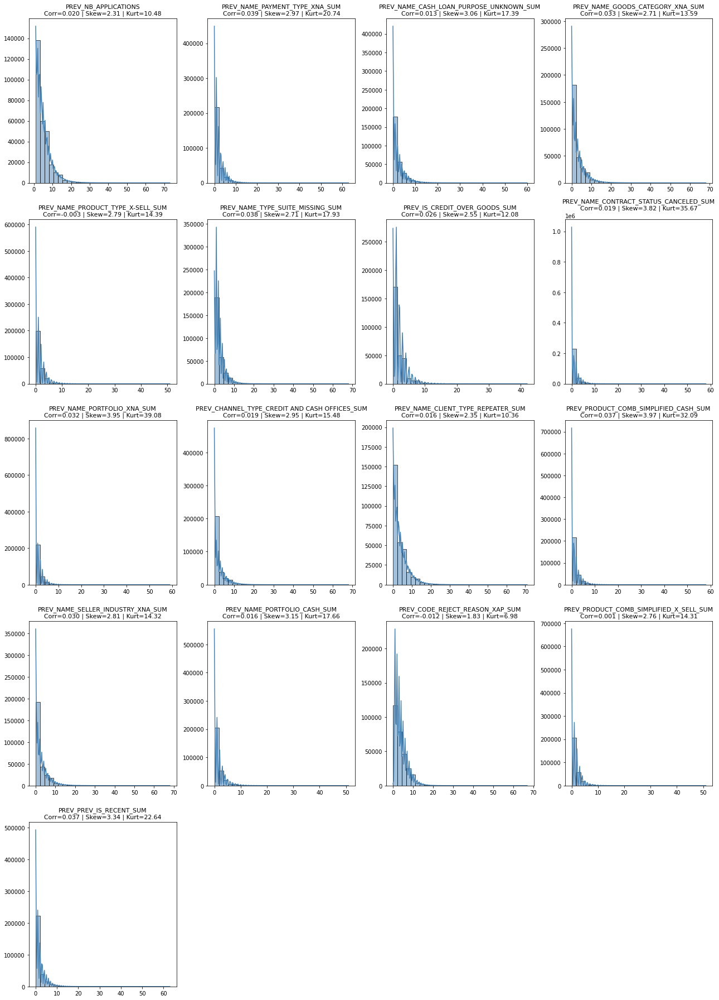

In [174]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_NB_APPLICATIONS', 'PREV_NAME_PAYMENT_TYPE_XNA_SUM', 'PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_SUM', 
             'PREV_NAME_GOODS_CATEGORY_XNA_SUM', 'PREV_NAME_PRODUCT_TYPE_X-SELL_SUM', 'PREV_NAME_TYPE_SUITE_MISSING_SUM', 
             'PREV_IS_CREDIT_OVER_GOODS_SUM', 'PREV_NAME_CONTRACT_STATUS_CANCELED_SUM', 'PREV_NAME_PORTFOLIO_XNA_SUM', 
             'PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_SUM', 'PREV_NAME_CLIENT_TYPE_REPEATER_SUM', 
             'PREV_PRODUCT_COMB_SIMPLIFIED_CASH_SUM', 'PREV_NAME_SELLER_INDUSTRY_XNA_SUM', 
             'PREV_NAME_PORTFOLIO_CASH_SUM', 'PREV_CODE_REJECT_REASON_XAP_SUM', 'PREV_PRODUCT_COMB_SIMPLIFIED_X_SELL_SUM', 
             'PREV_PREV_IS_RECENT_SUM']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

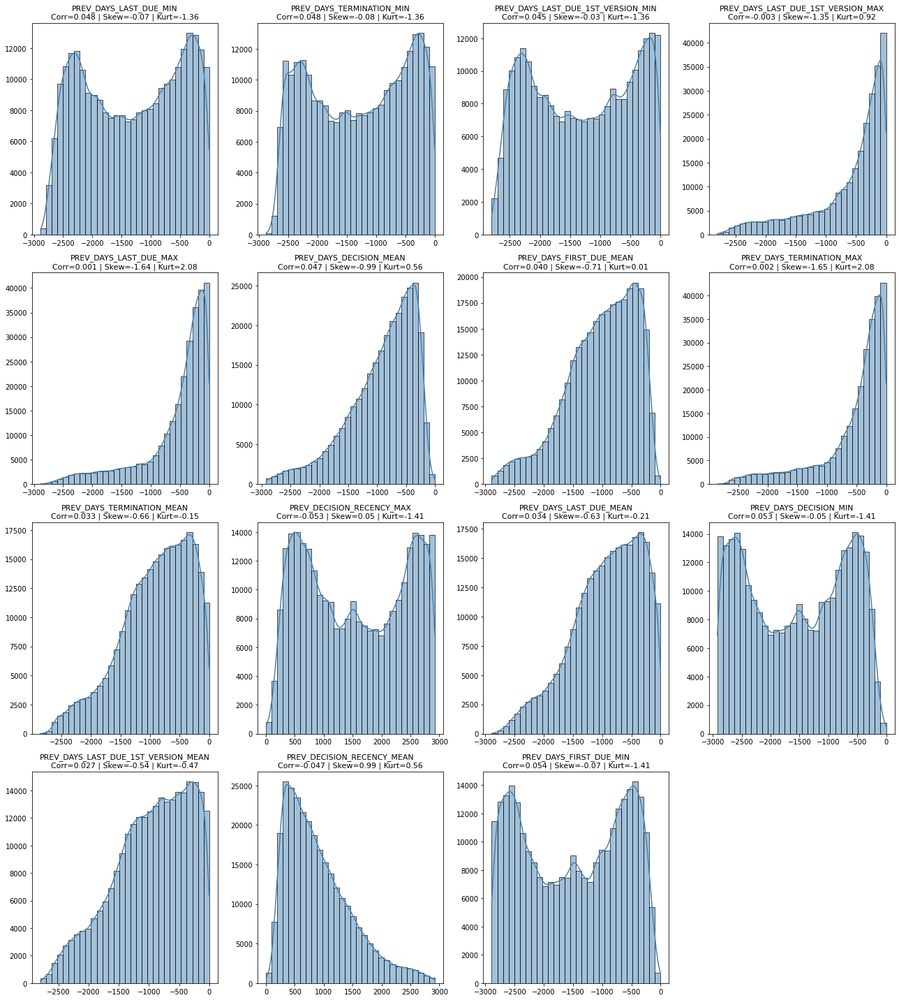

In [175]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_DAYS_LAST_DUE_MIN', 'PREV_DAYS_TERMINATION_MIN', 'PREV_DAYS_LAST_DUE_1ST_VERSION_MIN', 
            'PREV_DAYS_LAST_DUE_1ST_VERSION_MAX', 'PREV_DAYS_LAST_DUE_MAX', 'PREV_DAYS_DECISION_MEAN', 'PREV_DAYS_FIRST_DUE_MEAN',
            'PREV_DAYS_TERMINATION_MAX', 'PREV_DAYS_TERMINATION_MEAN', 'PREV_DECISION_RECENCY_MAX',
            'PREV_DAYS_LAST_DUE_MEAN', 'PREV_DAYS_DECISION_MIN', 'PREV_DAYS_LAST_DUE_1ST_VERSION_MEAN', 'PREV_DECISION_RECENCY_MEAN',
            'PREV_DAYS_FIRST_DUE_MIN']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

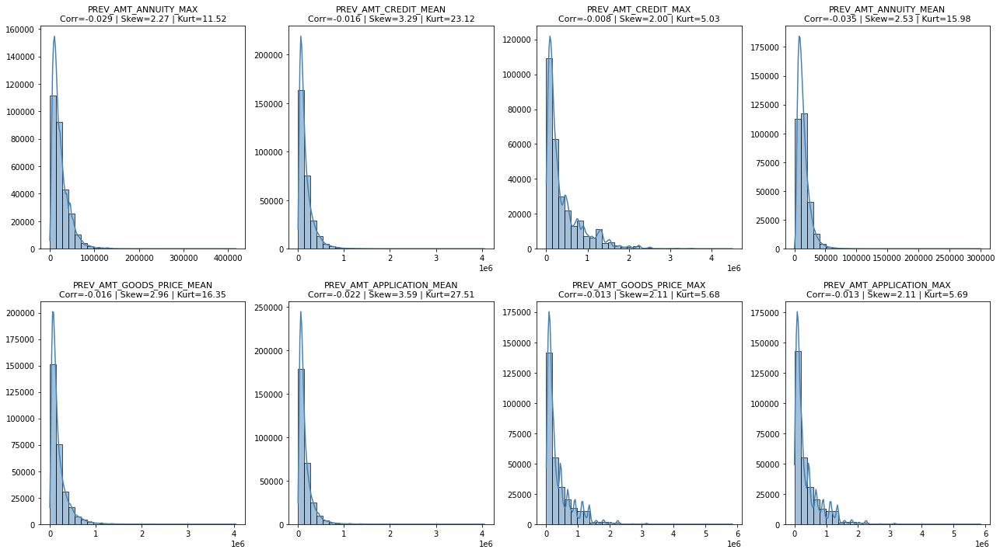

In [176]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_AMT_ANNUITY_MAX', 'PREV_AMT_CREDIT_MEAN', 'PREV_AMT_CREDIT_MAX', 'PREV_AMT_ANNUITY_MEAN', 'PREV_AMT_GOODS_PRICE_MEAN', 'PREV_AMT_APPLICATION_MEAN', 
            'PREV_AMT_GOODS_PRICE_MAX', 'PREV_AMT_APPLICATION_MAX']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

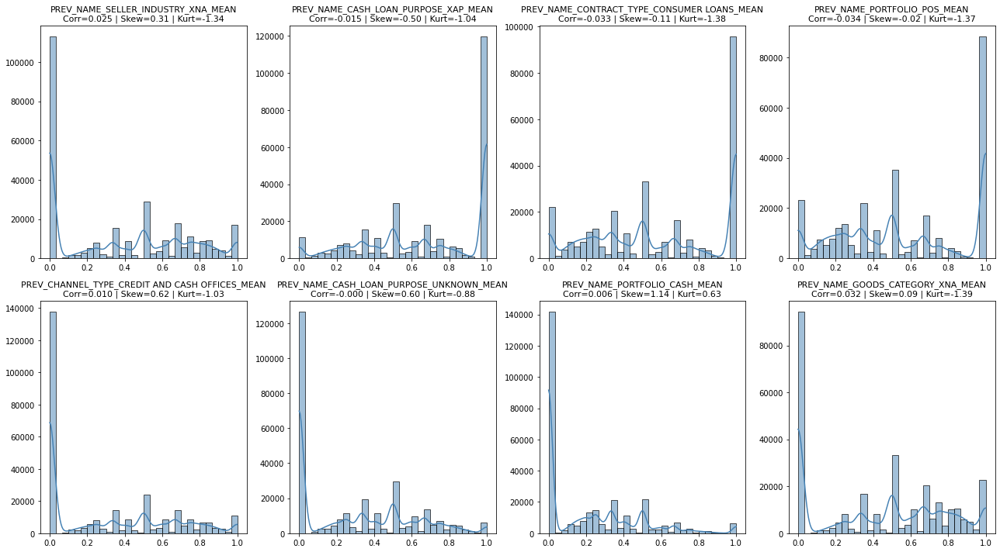

In [177]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_NAME_SELLER_INDUSTRY_XNA_MEAN', 'PREV_NAME_CASH_LOAN_PURPOSE_XAP_MEAN', 'PREV_NAME_CONTRACT_TYPE_CONSUMER LOANS_MEAN', 'PREV_NAME_PORTFOLIO_POS_MEAN', 'PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_MEAN',
            'PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_MEAN', 'PREV_NAME_PORTFOLIO_CASH_MEAN', 'PREV_NAME_GOODS_CATEGORY_XNA_MEAN']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

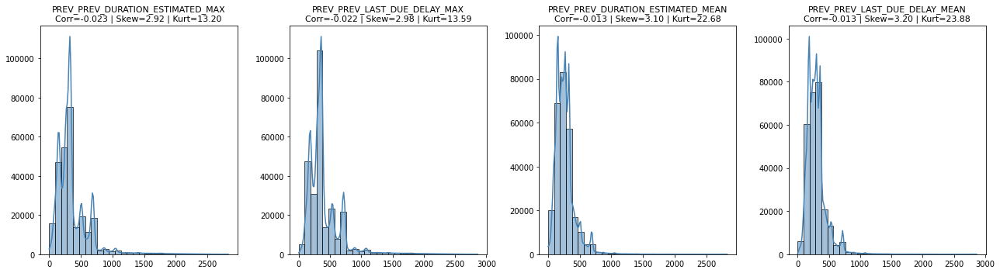

In [178]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_PREV_DURATION_ESTIMATED_MAX', 'PREV_PREV_LAST_DUE_DELAY_MAX', 'PREV_PREV_DURATION_ESTIMATED_MEAN', 
            'PREV_PREV_LAST_DUE_DELAY_MEAN']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

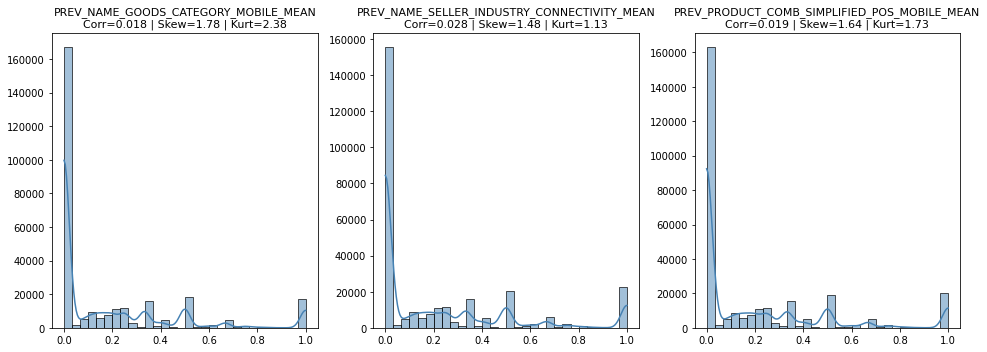

In [179]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_NAME_GOODS_CATEGORY_MOBILE_MEAN', 'PREV_NAME_SELLER_INDUSTRY_CONNECTIVITY_MEAN',
            'PREV_PRODUCT_COMB_SIMPLIFIED_POS_MOBILE_MEAN']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

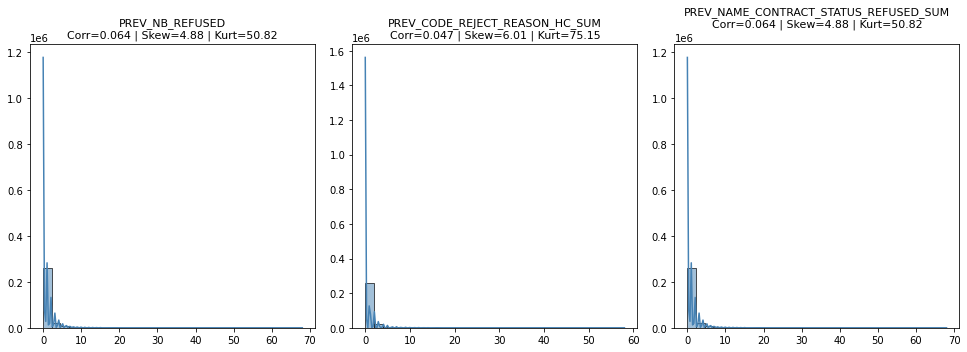

In [180]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_NB_REFUSED', 'PREV_CODE_REJECT_REASON_HC_SUM', 
            'PREV_NAME_CONTRACT_STATUS_REFUSED_SUM']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

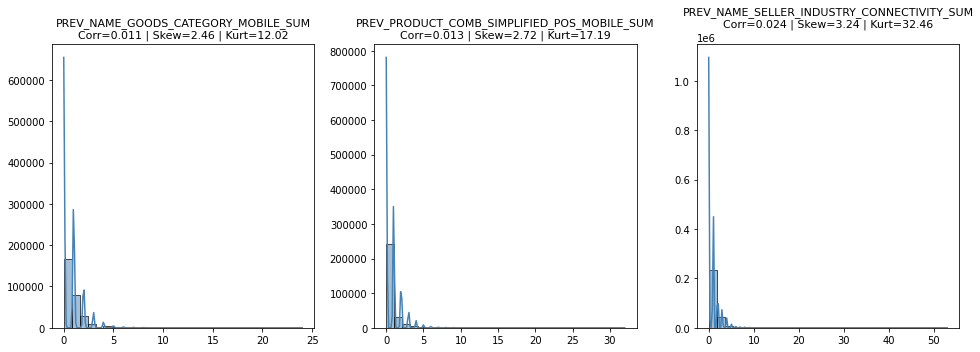

In [181]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_NAME_GOODS_CATEGORY_MOBILE_SUM', 'PREV_PRODUCT_COMB_SIMPLIFIED_POS_MOBILE_SUM', 
            'PREV_NAME_SELLER_INDUSTRY_CONNECTIVITY_SUM']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

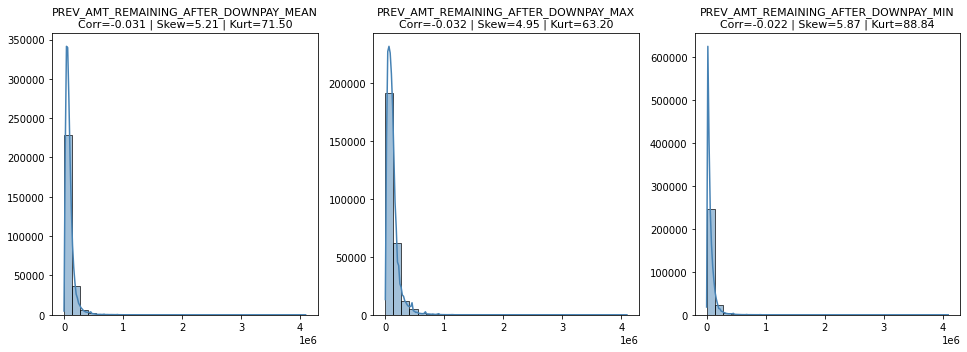

In [182]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_AMT_REMAINING_AFTER_DOWNPAY_MEAN', 'PREV_AMT_REMAINING_AFTER_DOWNPAY_MAX', 
            'PREV_AMT_REMAINING_AFTER_DOWNPAY_MIN']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

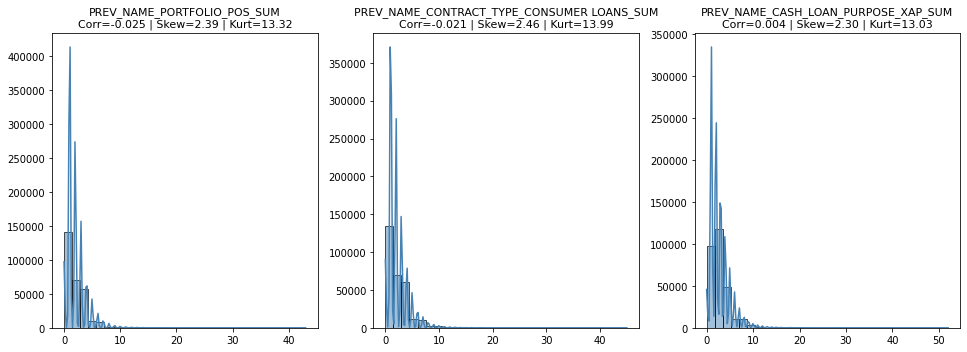

In [183]:
# Liste des transformations corrélées pour ce groupe

transfos = ['PREV_NAME_PORTFOLIO_POS_SUM', 'PREV_NAME_CONTRACT_TYPE_CONSUMER LOANS_SUM', 
            'PREV_NAME_CASH_LOAN_PURPOSE_XAP_SUM']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

In [184]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

cols_to_drop = [
    'PREV_NB_APPLICATIONS', 'PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_SUM', 
    'PREV_NAME_GOODS_CATEGORY_XNA_SUM', 'PREV_NAME_PRODUCT_TYPE_X-SELL_SUM', 'PREV_NAME_TYPE_SUITE_MISSING_SUM', 
    'PREV_IS_CREDIT_OVER_GOODS_SUM', 'PREV_NAME_CONTRACT_STATUS_CANCELED_SUM', 'PREV_NAME_PORTFOLIO_XNA_SUM', 
    'PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_SUM', 'PREV_NAME_CLIENT_TYPE_REPEATER_SUM', 
    'PREV_PRODUCT_COMB_SIMPLIFIED_CASH_SUM', 'PREV_NAME_SELLER_INDUSTRY_XNA_SUM', 
    'PREV_NAME_PORTFOLIO_CASH_SUM', 'PREV_CODE_REJECT_REASON_XAP_SUM', 'PREV_PRODUCT_COMB_SIMPLIFIED_X_SELL_SUM', 
    'PREV_PREV_IS_RECENT_SUM',

    'PREV_DAYS_LAST_DUE_MIN', 'PREV_DAYS_TERMINATION_MIN', 'PREV_DAYS_LAST_DUE_1ST_VERSION_MIN', 
    'PREV_DAYS_LAST_DUE_1ST_VERSION_MAX', 'PREV_DAYS_LAST_DUE_MAX', 'PREV_DAYS_DECISION_MEAN', 'PREV_DAYS_FIRST_DUE_MEAN',
    'PREV_DAYS_TERMINATION_MAX', 'PREV_DAYS_TERMINATION_MEAN', 'PREV_DECISION_RECENCY_MAX',
    'PREV_DAYS_LAST_DUE_MEAN', 'PREV_DAYS_DECISION_MIN', 'PREV_DAYS_LAST_DUE_1ST_VERSION_MEAN', 'PREV_DECISION_RECENCY_MEAN',

    'PREV_AMT_ANNUITY_MAX', 'PREV_AMT_CREDIT_MEAN', 'PREV_AMT_CREDIT_MAX', 'PREV_AMT_GOODS_PRICE_MEAN', 'PREV_AMT_APPLICATION_MEAN', 
    'PREV_AMT_GOODS_PRICE_MAX', 'PREV_AMT_APPLICATION_MAX', 

    'PREV_NAME_SELLER_INDUSTRY_XNA_MEAN', 'PREV_NAME_CASH_LOAN_PURPOSE_XAP_MEAN', 'PREV_NAME_CONTRACT_TYPE_CONSUMER LOANS_MEAN', 'PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_MEAN',
    'PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_MEAN', 'PREV_NAME_PORTFOLIO_CASH_MEAN', 'PREV_NAME_GOODS_CATEGORY_XNA_MEAN',

    'PREV_PREV_LAST_DUE_DELAY_MAX', 'PREV_PREV_DURATION_ESTIMATED_MEAN', 'PREV_PREV_LAST_DUE_DELAY_MEAN',

    'PREV_NAME_GOODS_CATEGORY_MOBILE_MEAN', 'PREV_PRODUCT_COMB_SIMPLIFIED_POS_MOBILE_MEAN',

    'PREV_CODE_REJECT_REASON_HC_SUM', 'PREV_NAME_CONTRACT_STATUS_REFUSED_SUM',

    'PREV_NAME_GOODS_CATEGORY_MOBILE_SUM', 'PREV_PRODUCT_COMB_SIMPLIFIED_POS_MOBILE_SUM',

    'PREV_AMT_REMAINING_AFTER_DOWNPAY_MEAN', 'PREV_AMT_REMAINING_AFTER_DOWNPAY_MIN',

    'PREV_NAME_CONTRACT_TYPE_CONSUMER LOANS_SUM', 'PREV_NAME_CASH_LOAN_PURPOSE_XAP_SUM',

    'PREV_NAME_SELLER_INDUSTRY_CONSUMER ELECTRONICS_MEAN', 'PREV_NAME_PORTFOLIO_CARS_MEAN',

    'PREV_NAME_CONTRACT_STATUS_UNUSED OFFER_SUM', 'PREV_CODE_REJECT_REASON_XNA_MEAN',

    'PREV_NAME_CONTRACT_TYPE_XNA_MEAN', 'PREV_PREV_FIRST_DUE_DELAY_MAX',

    'PREV_NAME_CONTRACT_TYPE_REVOLVING LOANS_MEAN', 'PREV_CODE_REJECT_REASON_SYSTEM_MEAN',

    'PREV_PREV_DOWNPAYMENT_RATIO_MEAN', 'PREV_PREV_CREDIT_PER_PAYMENT_MAX',

    'PREV_PRODUCT_COMB_SIMPLIFIED_X_SELL_MEAN', 'PREV_PREV_DURATION_FIRST_VERSION_MEAN',

    'PREV_NAME_CONTRACT_STATUS_CANCELED_MEAN', 'PREV_NAME_CONTRACT_TYPE_REVOLVING LOANS_SUM',

    'PREV_PREV_APP_CREDIT_RATIO_MAX', 'PREV_NAME_SELLER_INDUSTRY_FURNITURE_SUM',

    'PREV_NAME_SELLER_INDUSTRY_FURNITURE_MEAN', 'PREV_CODE_REJECT_REASON_XAP_MEAN',

    'PREV_NAME_SELLER_INDUSTRY_CONSUMER ELECTRONICS_SUM', 'PREV_DAYS_FIRST_DUE_MAX'

]

df_train_nan_missing_linear.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [185]:
remaining_cols = list(set(df_previous_train_nan_missing_linear_agg.columns).intersection(df_train_nan_missing_linear.columns))

In [186]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_train_nan_missing_linear[remaining_cols], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation


In [187]:
# Réduction de la taille du dataframe.

optimize_types(df_train_nan_missing_linear)

 Mémoire avant : 620.81 MB
 Mémoire après : 503.21 MB
 Gain : 18.9%


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_ANNUITY,REGION_POPULATION_RELATIVE,OWN_CAR_AGE,FLAG_MOBIL,...,PREV_PRODUCT_COMB_SIMPLIFIED_CARD_MEAN,PREV_PRODUCT_COMB_SIMPLIFIED_CARD_SUM,PREV_PRODUCT_COMB_SIMPLIFIED_CASH_MEAN,PREV_PRODUCT_COMB_SIMPLIFIED_POS_HOUSEHOLD_MEAN,PREV_PRODUCT_COMB_SIMPLIFIED_POS_HOUSEHOLD_SUM,PREV_PRODUCT_COMB_SIMPLIFIED_POS_INDUSTRY_MEAN,PREV_PRODUCT_COMB_SIMPLIFIED_POS_INDUSTRY_SUM,PREV_PRODUCT_COMB_SIMPLIFIED_POS_OTHERS_MEAN,PREV_PRODUCT_COMB_SIMPLIFIED_POS_OTHERS_SUM,PREV_NB_REFUSED
0,100002,1,0,1,0,1,24700.5,0.018801,<NA>,1,...,0.000000,0,0.000000,0.000000,0,0.000000,0,1.0,1,0
1,100003,0,0,0,0,0,35698.5,0.003541,<NA>,1,...,0.000000,0,0.000000,0.333333,1,0.333333,1,0.0,0,0
2,100004,0,1,1,1,1,6750.0,0.010032,26,1,...,0.000000,0,0.000000,0.000000,0,0.000000,0,0.0,0,0
3,100006,0,0,0,0,1,29686.5,0.008019,<NA>,1,...,0.111111,1,0.222222,0.111111,1,0.111111,1,0.0,0,1
4,100007,0,0,1,0,1,21865.5,0.028663,<NA>,1,...,0.000000,0,0.166667,0.166667,1,0.000000,0,0.0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307495,456251,0,0,1,0,0,27558.0,0.032561,<NA>,1,...,0.000000,0,0.000000,0.000000,0,0.000000,0,0.0,0,0
307496,456252,0,0,0,0,1,12001.5,0.025164,<NA>,1,...,0.000000,0,0.000000,1.000000,1,0.000000,0,0.0,0,0
307497,456253,0,0,0,0,1,29979.0,0.005002,<NA>,1,...,0.000000,0,0.000000,0.000000,0,0.000000,0,0.0,0,0
307498,456254,1,0,0,0,1,20205.0,0.005313,<NA>,1,...,0.000000,0,0.000000,0.500000,1,0.000000,0,0.0,0,0


#### Corrélation des variables - df_train_median_mode

In [188]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_median_mode[df_previous_train_median_mode_agg.columns.tolist()], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,PREV_DAYS_DECISION_MEAN / PREV_DECISION_RECENCY_MEAN,PREV_DAYS_DECISION_MEAN,PREV_DECISION_RECENCY_MEAN,-1.000000
1,PREV_NAME_CASH_LOAN_PURPOSE_XAP_MEAN / PREV_NAME_CONTRACT_TYPE_CASH LOANS_MEAN,PREV_NAME_CONTRACT_TYPE_CASH LOANS_MEAN,PREV_NAME_CASH_LOAN_PURPOSE_XAP_MEAN,-1.000000
2,PREV_DAYS_DECISION_MIN / PREV_DECISION_RECENCY_MAX,PREV_DAYS_DECISION_MIN,PREV_DECISION_RECENCY_MAX,-1.000000
3,PREV_NAME_CONTRACT_TYPE_XNA_MEAN / PREV_NAME_CONTRACT_TYPE_XNA_SUM,PREV_NAME_CONTRACT_TYPE_XNA_MEAN,PREV_NAME_CONTRACT_TYPE_XNA_SUM,1.000000
4,PREV_NAME_CONTRACT_TYPE_XNA_MEAN / PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_SUM,PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_SUM,PREV_NAME_CONTRACT_TYPE_XNA_MEAN,1.000000
5,PREV_NAME_CONTRACT_TYPE_XNA_SUM / PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_MEAN,PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_MEAN,PREV_NAME_CONTRACT_TYPE_XNA_SUM,1.000000
6,PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_MEAN / PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_SUM,PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_MEAN,PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_SUM,1.000000
7,PREV_NAME_PORTFOLIO_CARS_MEAN / PREV_NAME_PORTFOLIO_CARS_SUM,PREV_NAME_PORTFOLIO_CARS_MEAN,PREV_NAME_PORTFOLIO_CARS_SUM,1.000000
8,PREV_CODE_REJECT_REASON_SYSTEM_MEAN / PREV_CODE_REJECT_REASON_SYSTEM_SUM,PREV_CODE_REJECT_REASON_SYSTEM_MEAN,PREV_CODE_REJECT_REASON_SYSTEM_SUM,1.000000
9,PREV_NAME_PAYMENT_TYPE_CASHLESS FROM THE ACCOUNT OF THE EMPLOYER_MEAN / PREV_NAME_PAYMENT_TYPE_CASHLESS FROM THE ACCOUNT OF THE EMPLOYER_SUM,PREV_NAME_PAYMENT_TYPE_CASHLESS FROM THE ACCOUNT OF THE EMPLOYER_MEAN,PREV_NAME_PAYMENT_TYPE_CASHLESS FROM THE ACCOUNT OF THE EMPLOYER_SUM,0.999999


In [189]:
df_corr = get_correlation_pairs(df_train_median_mode[df_previous_train_median_mode_agg.columns.tolist()], method="spearman", style=False, threshold=0.9)

In [190]:
var_corr = df_corr['Variable 1'].unique().tolist() + df_corr['Variable 2'].unique().tolist()
var_corr = list(set(var_corr))

In [191]:
# Visualisation des corrélations les plus importantes avec la Target.
pd.set_option('display.max_rows', None)

target_corr = compute_target_correlations(df_train_median_mode.loc[:, var_corr + ['TARGET']], 'TARGET', mode='nonlinear', plot=False)
target_corr.loc[var_corr].sort_values(by='spearman_corr', ascending=False)

,pearson_corr,spearman_corr,abs_pearson,abs_spearman,mutual_info,score_global
PREV_NAME_CONTRACT_STATUS_REFUSED_MEAN,0.077682,0.067487,0.077682,0.067487,0.003393,0.087549
PREV_CODE_REJECT_REASON_SCOFR_SUM,0.056293,0.063789,0.056293,0.063789,0.001532,0.061346
PREV_CODE_REJECT_REASON_SCOFR_MEAN,0.055872,0.063711,0.055872,0.063711,0.002288,0.067714
PREV_NAME_CONTRACT_STATUS_REFUSED_SUM,0.064482,0.063086,0.064482,0.063086,0.003949,0.085341
PREV_NB_REFUSED,0.064482,0.063086,0.064482,0.063086,0.003280,0.079523
PREV_NAME_PRODUCT_TYPE_WALK-IN_SUM,0.062633,0.062062,0.062633,0.062062,0.003652,0.081608
PREV_NAME_PRODUCT_TYPE_WALK-IN_MEAN,0.057408,0.061321,0.057408,0.061321,0.002605,0.070123
PREV_DAYS_LAST_DUE_WAS_MISSING_MEAN,0.056889,0.058768,0.056889,0.058768,0.006017,0.098547
PREV_DAYS_TERMINATION_WAS_MISSING_MEAN,0.056134,0.058581,0.056134,0.058581,0.006121,0.099071
PREV_NFLAG_INSURED_ON_APPROVAL_WAS_MISSING_MEAN,0.059952,0.056265,0.059952,0.056265,0.004910,0.089154


In [192]:
# Visualisation des groupes de variables corrélées entre elles.
pd.set_option('display.max_rows', None)
pd.set_option('display.max_colwidth', None)
summarize_correlated_groups(df_corr, X=df_train_median_mode, y=df_train_median_mode['TARGET'])

,Variables du groupe,Taille du groupe,Corrélation max avec y,Variable la plus corrélée
0,"[PREV_NAME_GOODS_CATEGORY_XNA_SUM, PREV_NAME_PORTFOLIO_CASH_SUM, PREV_SELLERPLACE_AREA_WAS_MISSING_SUM, PREV_NAME_GOODS_CATEGORY_XNA_MEAN, PREV_RATE_DOWN_PAYMENT_WAS_MISSING_SUM, PREV_NAME_CONTRACT_TYPE_CASH LOANS_MEAN, PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_MEAN, PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_SUM, PREV_NAME_SELLER_INDUSTRY_XNA_MEAN, PREV_NAME_CONTRACT_TYPE_CASH LOANS_SUM, PREV_AMT_DOWN_PAYMENT_WAS_MISSING_MEAN, PREV_NAME_CONTRACT_TYPE_CONSUMER LOANS_MEAN, PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_MEAN, PREV_NAME_PORTFOLIO_CASH_MEAN, PREV_NAME_CASH_LOAN_PURPOSE_XAP_MEAN, PREV_NAME_PORTFOLIO_POS_MEAN, PREV_AMT_DOWN_PAYMENT_WAS_MISSING_SUM, PREV_NAME_SELLER_INDUSTRY_XNA_SUM, PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_SUM, PREV_RATE_DOWN_PAYMENT_WAS_MISSING_MEAN, PREV_SELLERPLACE_AREA_WAS_MISSING_MEAN]",21,0.036552,PREV_RATE_DOWN_PAYMENT_WAS_MISSING_SUM
1,"[PREV_AMT_REMAINING_AFTER_DOWNPAY_MEAN, PREV_AMT_GOODS_PRICE_MEAN, PREV_AMT_CREDIT_MAX, PREV_AMT_GOODS_PRICE_MAX, PREV_AMT_APPLICATION_MAX, PREV_AMT_REMAINING_AFTER_DOWNPAY_MAX, PREV_AMT_CREDIT_SUM, PREV_AMT_CREDIT_MEAN, PREV_AMT_APPLICATION_MEAN]",9,0.021837,PREV_AMT_APPLICATION_MEAN
2,"[PREV_NAME_CONTRACT_STATUS_APPROVED_MEAN, PREV_NFLAG_INSURED_ON_APPROVAL_WAS_MISSING_MEAN, PREV_DAYS_FIRST_DUE_WAS_MISSING_SUM, PREV_DAYS_LAST_DUE_WAS_MISSING_SUM, PREV_NFLAG_INSURED_ON_APPROVAL_WAS_MISSING_SUM, PREV_DAYS_FIRST_DUE_WAS_MISSING_MEAN, PREV_DAYS_TERMINATION_WAS_MISSING_SUM, PREV_DAYS_LAST_DUE_1ST_VERSION_WAS_MISSING_SUM]",8,0.063528,PREV_NAME_CONTRACT_STATUS_APPROVED_MEAN
3,"[PREV_AMT_ANNUITY_WAS_MISSING_SUM, PREV_NAME_PORTFOLIO_XNA_MEAN, PREV_NAME_PORTFOLIO_XNA_SUM, PREV_AMT_ANNUITY_WAS_MISSING_MEAN, PREV_CNT_PAYMENT_WAS_MISSING_MEAN, PREV_CNT_PAYMENT_WAS_MISSING_SUM]",6,0.032263,PREV_NAME_PORTFOLIO_XNA_SUM
4,"[PREV_DAYS_LAST_DUE_1ST_VERSION_MIN, PREV_DECISION_RECENCY_MAX, PREV_DAYS_FIRST_DUE_MIN, PREV_DAYS_LAST_DUE_MIN, PREV_DAYS_DECISION_MIN, PREV_DAYS_TERMINATION_MIN]",6,0.053446,PREV_DECISION_RECENCY_MAX
5,"[PREV_CODE_REJECT_REASON_XAP_SUM, PREV_NAME_CLIENT_TYPE_REPEATER_SUM, PREV_NAME_TYPE_SUITE_UNACCOMPANIED_SUM, PREV_NB_APPLICATIONS, PREV_NAME_CLIENT_TYPE_REPEATER_MEAN, PREV_IS_DOWNPAYMENT_SUM]",6,0.027556,PREV_NAME_TYPE_SUITE_UNACCOMPANIED_SUM
6,"[PREV_NAME_CONTRACT_STATUS_UNUSED OFFER_SUM, PREV_CODE_REJECT_REASON_CLIENT_MEAN, PREV_NAME_CONTRACT_STATUS_UNUSED OFFER_MEAN, PREV_CODE_REJECT_REASON_CLIENT_SUM]",4,0.000914,PREV_CODE_REJECT_REASON_CLIENT_MEAN
7,"[PREV_NAME_GOODS_CATEGORY_CLOTHING AND ACCESSORIES_MEAN, PREV_NAME_SELLER_INDUSTRY_CLOTHING_SUM, PREV_NAME_GOODS_CATEGORY_CLOTHING AND ACCESSORIES_SUM, PREV_NAME_SELLER_INDUSTRY_CLOTHING_MEAN]",4,0.021344,PREV_NAME_GOODS_CATEGORY_CLOTHING AND ACCESSORIES_MEAN
8,"[PREV_NAME_CONTRACT_TYPE_REVOLVING LOANS_MEAN, PREV_NAME_CONTRACT_TYPE_REVOLVING LOANS_SUM, PREV_NAME_PORTFOLIO_CARDS_SUM, PREV_NAME_PORTFOLIO_CARDS_MEAN]",4,0.045624,PREV_NAME_CONTRACT_TYPE_REVOLVING LOANS_SUM
9,"[PREV_NAME_PRODUCT_TYPE_X-SELL_SUM, PREV_PRODUCT_COMB_SIMPLIFIED_X_SELL_MEAN, PREV_NAME_PRODUCT_TYPE_X-SELL_MEAN, PREV_PRODUCT_COMB_SIMPLIFIED_X_SELL_SUM]",4,0.018262,PREV_NAME_PRODUCT_TYPE_X-SELL_MEAN


In [193]:
pd.reset_option('display.max_colwidth')
pd.reset_option('display.max_rows')

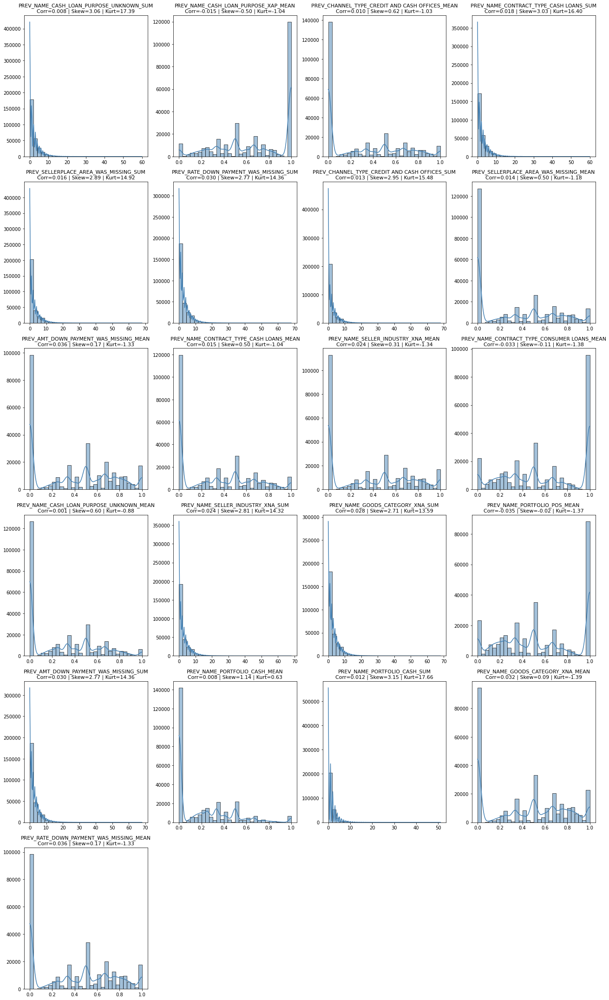

In [194]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_SUM', 'PREV_NAME_CASH_LOAN_PURPOSE_XAP_MEAN', 'PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_MEAN', 
            'PREV_NAME_CONTRACT_TYPE_CASH LOANS_SUM', 'PREV_SELLERPLACE_AREA_WAS_MISSING_SUM', 'PREV_RATE_DOWN_PAYMENT_WAS_MISSING_SUM', 
            'PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_SUM', 'PREV_SELLERPLACE_AREA_WAS_MISSING_MEAN', 'PREV_AMT_DOWN_PAYMENT_WAS_MISSING_MEAN', 
            'PREV_NAME_CONTRACT_TYPE_CASH LOANS_MEAN', 'PREV_NAME_SELLER_INDUSTRY_XNA_MEAN', 'PREV_NAME_CONTRACT_TYPE_CONSUMER LOANS_MEAN', 
            'PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_MEAN', 'PREV_NAME_SELLER_INDUSTRY_XNA_SUM', 'PREV_NAME_GOODS_CATEGORY_XNA_SUM', 
            'PREV_NAME_PORTFOLIO_POS_MEAN', 'PREV_AMT_DOWN_PAYMENT_WAS_MISSING_SUM', 'PREV_NAME_PORTFOLIO_CASH_MEAN', 'PREV_NAME_PORTFOLIO_CASH_SUM', 
            'PREV_NAME_GOODS_CATEGORY_XNA_MEAN', 'PREV_RATE_DOWN_PAYMENT_WAS_MISSING_MEAN']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

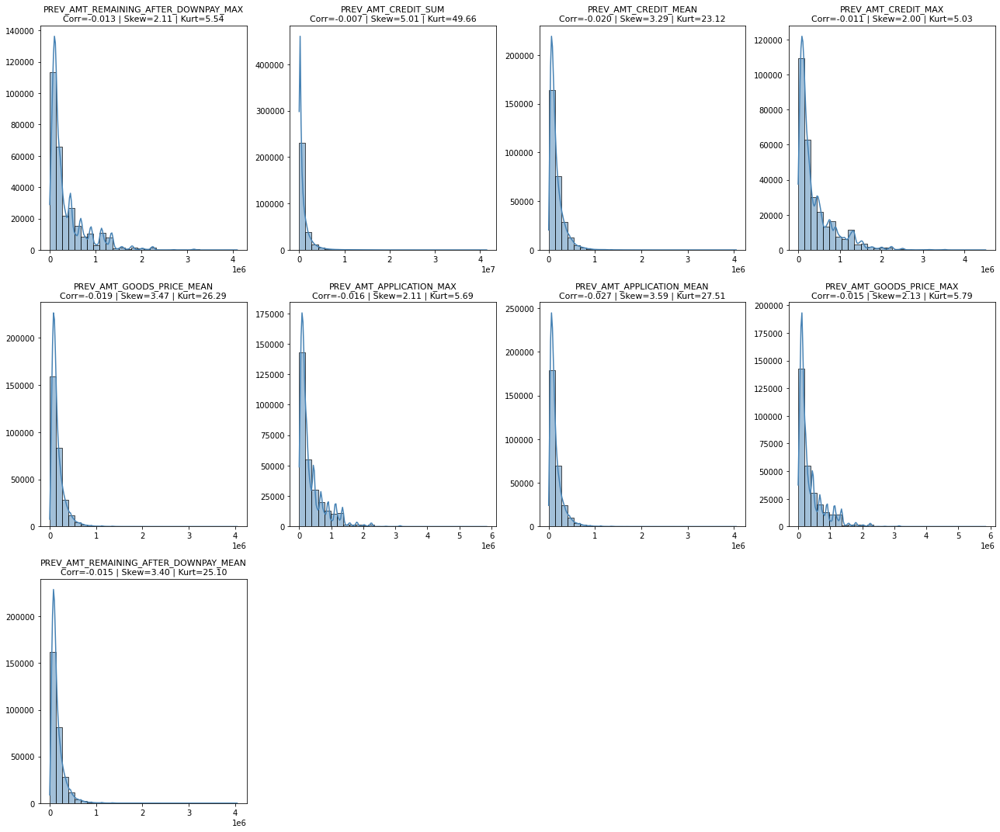

In [195]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['PREV_AMT_REMAINING_AFTER_DOWNPAY_MAX', 'PREV_AMT_CREDIT_SUM', 'PREV_AMT_CREDIT_MEAN', 
            'PREV_AMT_CREDIT_MAX', 'PREV_AMT_GOODS_PRICE_MEAN', 'PREV_AMT_APPLICATION_MAX', 
            'PREV_AMT_APPLICATION_MEAN', 'PREV_AMT_GOODS_PRICE_MAX', 'PREV_AMT_REMAINING_AFTER_DOWNPAY_MEAN']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

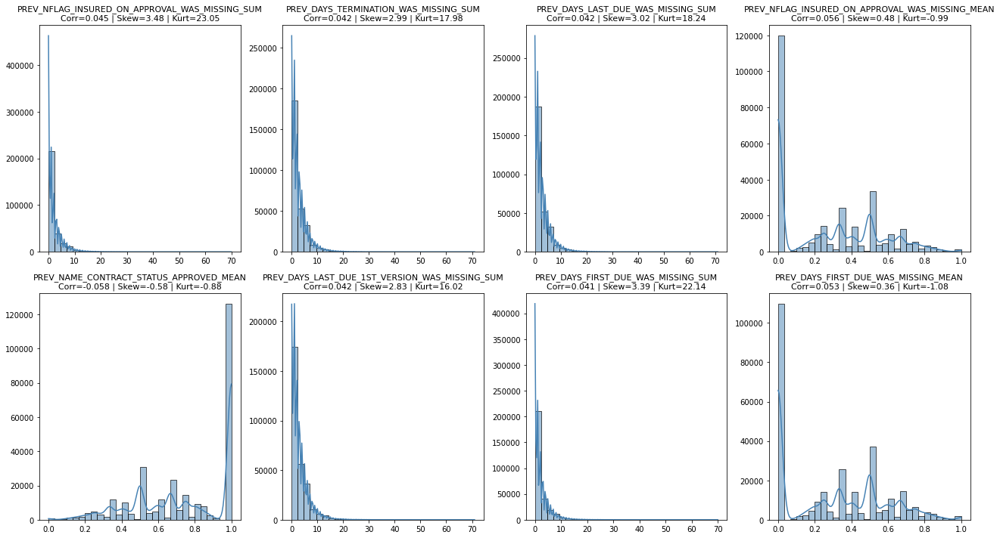

In [196]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['PREV_NFLAG_INSURED_ON_APPROVAL_WAS_MISSING_SUM', 'PREV_DAYS_TERMINATION_WAS_MISSING_SUM', 'PREV_DAYS_LAST_DUE_WAS_MISSING_SUM', 
            'PREV_NFLAG_INSURED_ON_APPROVAL_WAS_MISSING_MEAN', 'PREV_NAME_CONTRACT_STATUS_APPROVED_MEAN', 'PREV_DAYS_LAST_DUE_1ST_VERSION_WAS_MISSING_SUM', 
            'PREV_DAYS_FIRST_DUE_WAS_MISSING_SUM', 'PREV_DAYS_FIRST_DUE_WAS_MISSING_MEAN']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

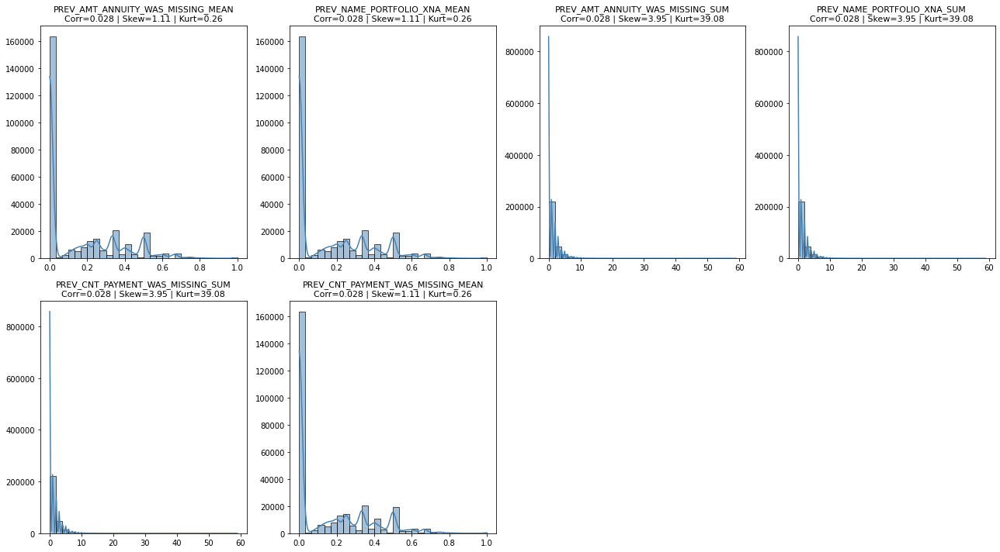

In [197]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['PREV_AMT_ANNUITY_WAS_MISSING_MEAN', 'PREV_NAME_PORTFOLIO_XNA_MEAN', 'PREV_AMT_ANNUITY_WAS_MISSING_SUM', 
            'PREV_NAME_PORTFOLIO_XNA_SUM', 'PREV_CNT_PAYMENT_WAS_MISSING_SUM', 'PREV_CNT_PAYMENT_WAS_MISSING_MEAN']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

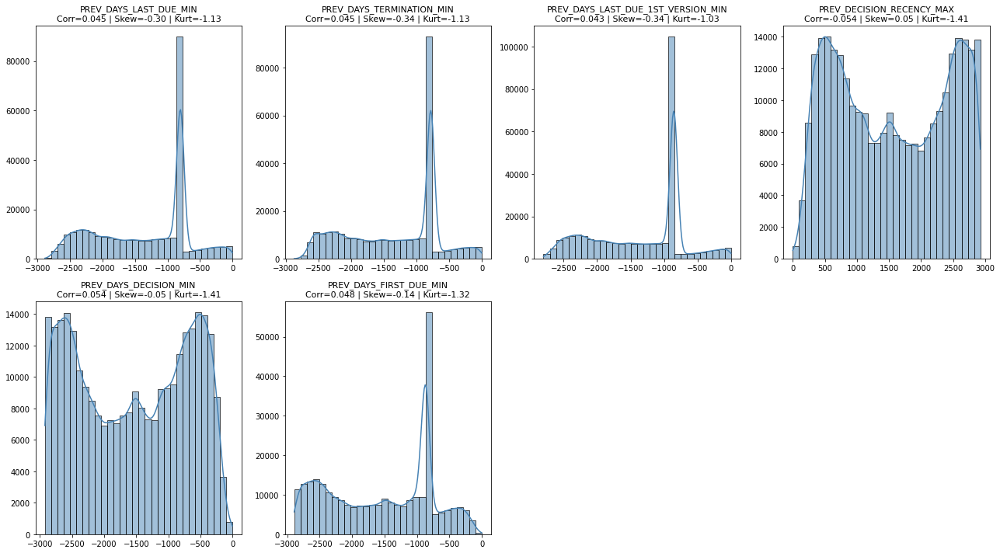

In [198]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['PREV_DAYS_LAST_DUE_MIN', 'PREV_DAYS_TERMINATION_MIN', 'PREV_DAYS_LAST_DUE_1ST_VERSION_MIN', 
            'PREV_DECISION_RECENCY_MAX', 'PREV_DAYS_DECISION_MIN', 'PREV_DAYS_FIRST_DUE_MIN']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

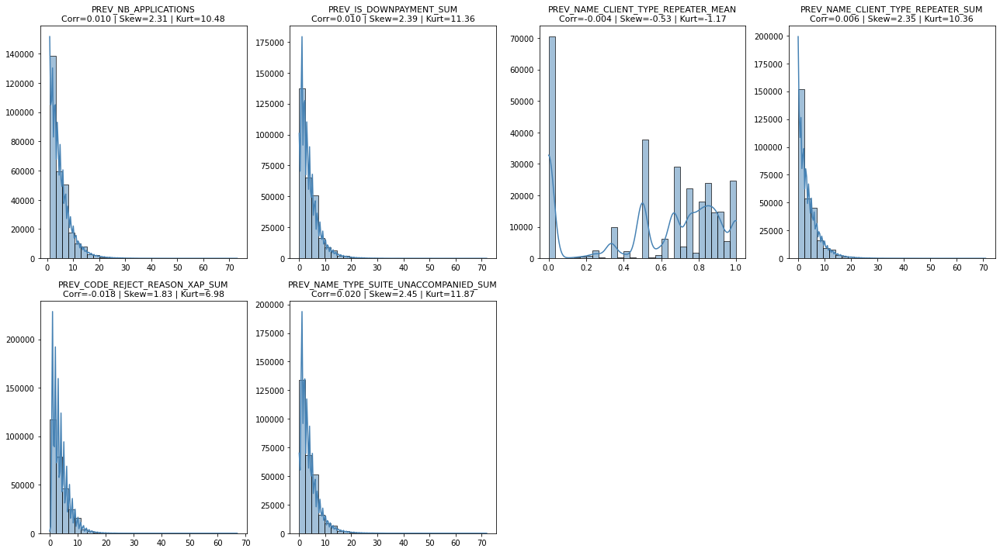

In [199]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['PREV_NB_APPLICATIONS', 'PREV_IS_DOWNPAYMENT_SUM', 'PREV_NAME_CLIENT_TYPE_REPEATER_MEAN', 
            'PREV_NAME_CLIENT_TYPE_REPEATER_SUM', 'PREV_CODE_REJECT_REASON_XAP_SUM', 'PREV_NAME_TYPE_SUITE_UNACCOMPANIED_SUM']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

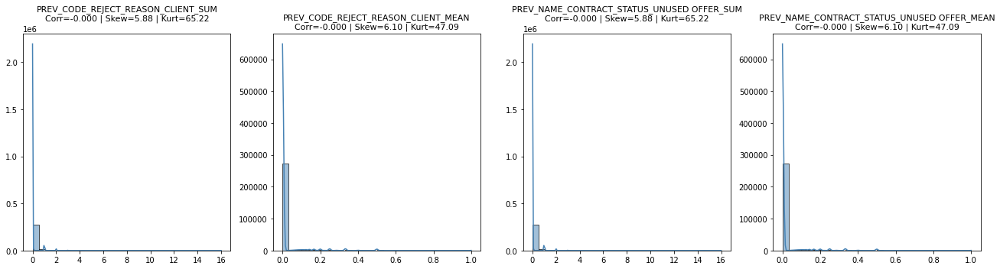

In [200]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['PREV_CODE_REJECT_REASON_CLIENT_SUM', 'PREV_CODE_REJECT_REASON_CLIENT_MEAN', 'PREV_NAME_CONTRACT_STATUS_UNUSED OFFER_SUM', 
            'PREV_NAME_CONTRACT_STATUS_UNUSED OFFER_MEAN']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

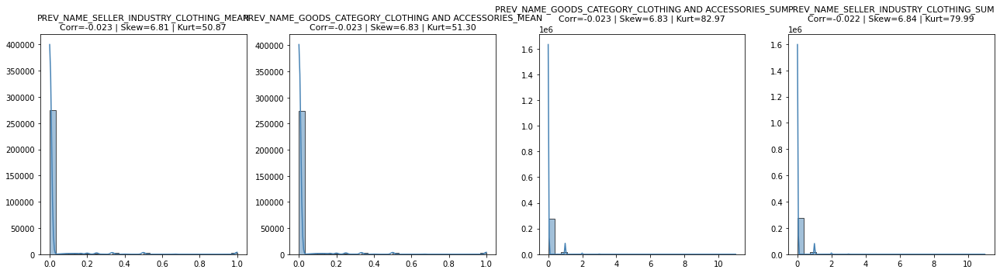

In [201]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['PREV_NAME_SELLER_INDUSTRY_CLOTHING_MEAN', 'PREV_NAME_GOODS_CATEGORY_CLOTHING AND ACCESSORIES_MEAN', 'PREV_NAME_GOODS_CATEGORY_CLOTHING AND ACCESSORIES_SUM', 
            'PREV_NAME_SELLER_INDUSTRY_CLOTHING_SUM']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

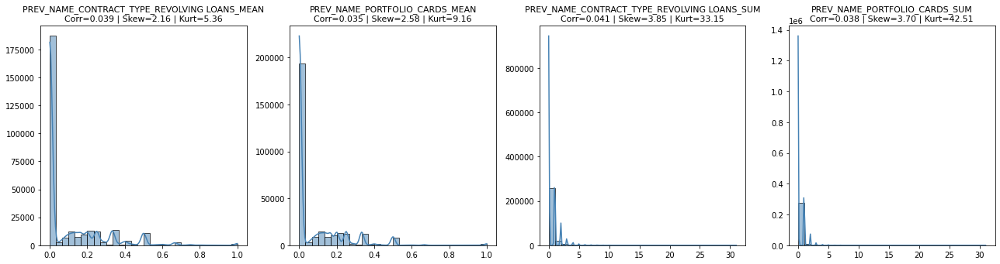

In [202]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['PREV_NAME_CONTRACT_TYPE_REVOLVING LOANS_MEAN', 'PREV_NAME_PORTFOLIO_CARDS_MEAN', 'PREV_NAME_CONTRACT_TYPE_REVOLVING LOANS_SUM', 
            'PREV_NAME_PORTFOLIO_CARDS_SUM']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

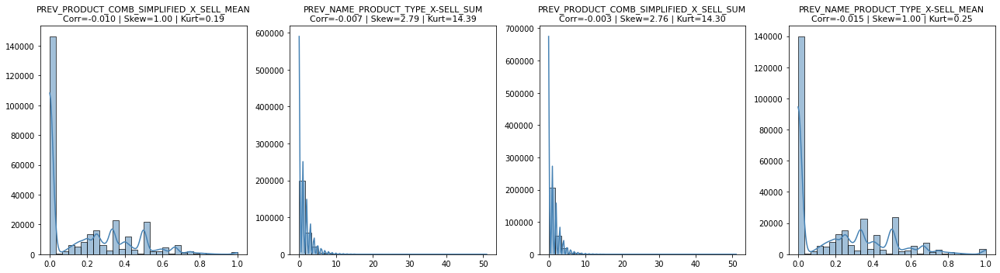

In [203]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['PREV_PRODUCT_COMB_SIMPLIFIED_X_SELL_MEAN', 'PREV_NAME_PRODUCT_TYPE_X-SELL_SUM', 'PREV_PRODUCT_COMB_SIMPLIFIED_X_SELL_SUM', 
            'PREV_NAME_PRODUCT_TYPE_X-SELL_MEAN']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

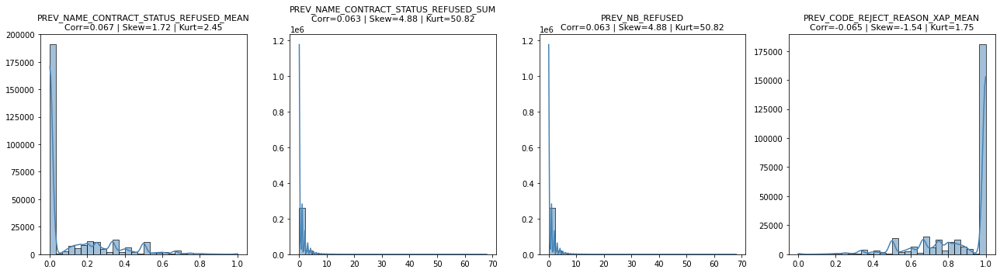

In [204]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['PREV_NAME_CONTRACT_STATUS_REFUSED_MEAN', 'PREV_NAME_CONTRACT_STATUS_REFUSED_SUM', 'PREV_NB_REFUSED', 
            'PREV_CODE_REJECT_REASON_XAP_MEAN']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

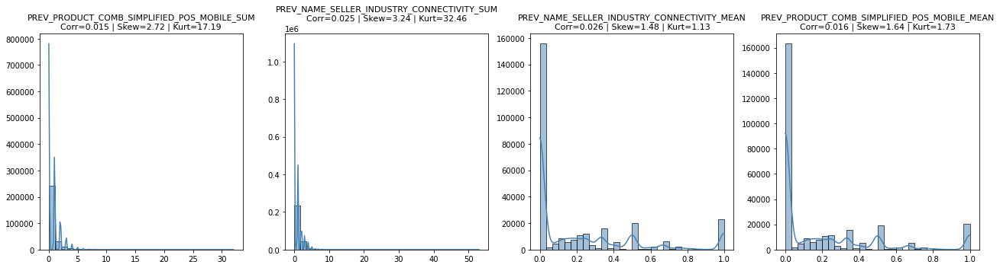

In [205]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['PREV_PRODUCT_COMB_SIMPLIFIED_POS_MOBILE_SUM', 'PREV_NAME_SELLER_INDUSTRY_CONNECTIVITY_SUM', 'PREV_NAME_SELLER_INDUSTRY_CONNECTIVITY_MEAN', 
            'PREV_PRODUCT_COMB_SIMPLIFIED_POS_MOBILE_MEAN']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

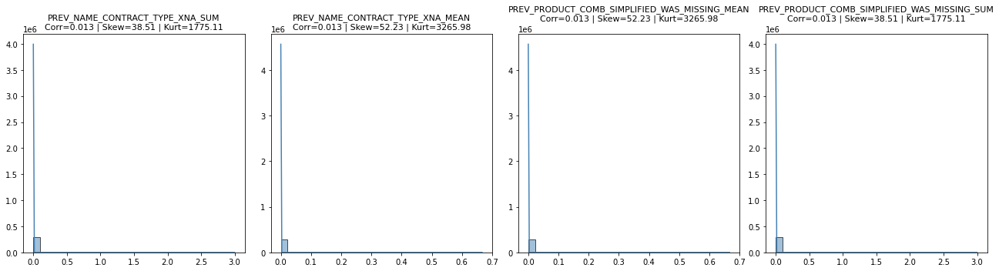

In [206]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['PREV_NAME_CONTRACT_TYPE_XNA_SUM', 'PREV_NAME_CONTRACT_TYPE_XNA_MEAN', 'PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_MEAN', 
            'PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_SUM']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

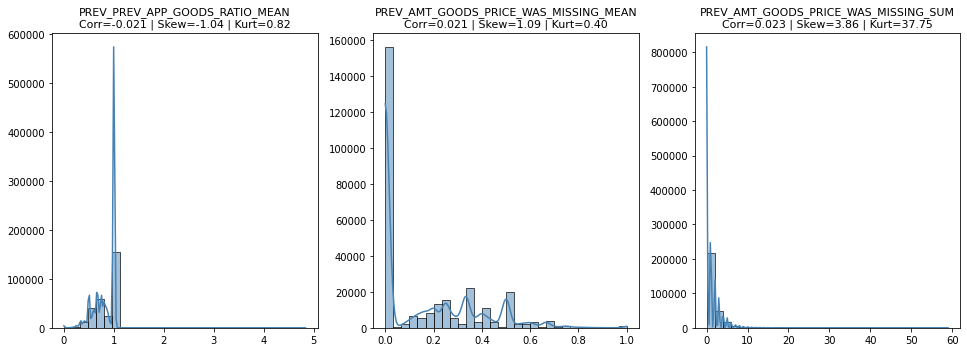

In [207]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['PREV_PREV_APP_GOODS_RATIO_MEAN', 'PREV_AMT_GOODS_PRICE_WAS_MISSING_MEAN', 'PREV_AMT_GOODS_PRICE_WAS_MISSING_SUM']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

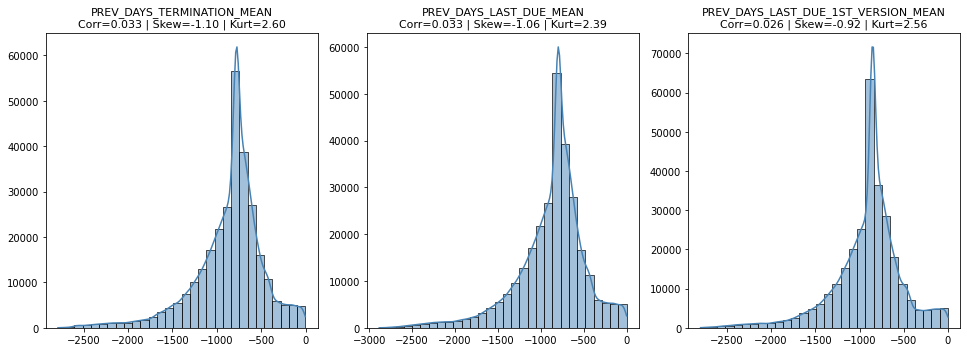

In [208]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['PREV_DAYS_TERMINATION_MEAN', 'PREV_DAYS_LAST_DUE_MEAN', 'PREV_DAYS_LAST_DUE_1ST_VERSION_MEAN']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\core\_methods.py:118: RuntimeWarning:

overflow encountered in reduce

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\core\_methods.py:118: RuntimeWarning:

overflow encountered in reduce



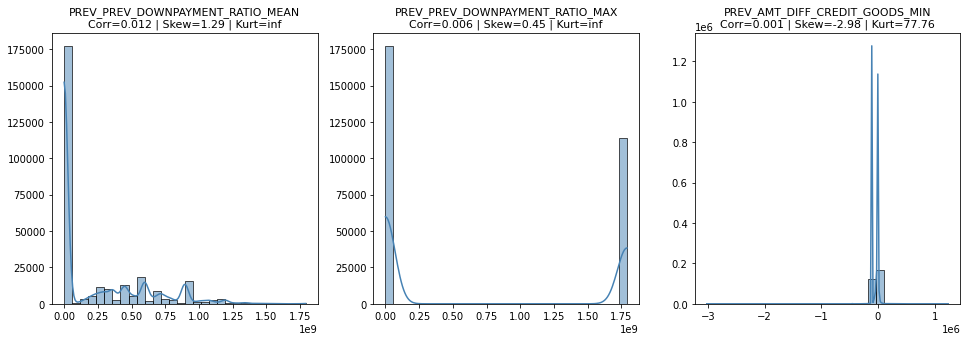

In [209]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['PREV_PREV_DOWNPAYMENT_RATIO_MEAN', 'PREV_PREV_DOWNPAYMENT_RATIO_MAX', 'PREV_AMT_DIFF_CREDIT_GOODS_MIN']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

In [210]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

cols_to_drop = [
    'PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_SUM', 'PREV_NAME_CASH_LOAN_PURPOSE_XAP_MEAN', 'PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_MEAN', 
    'PREV_NAME_CONTRACT_TYPE_CASH LOANS_SUM', 'PREV_SELLERPLACE_AREA_WAS_MISSING_SUM', 'PREV_RATE_DOWN_PAYMENT_WAS_MISSING_SUM', 
    'PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_SUM', 'PREV_SELLERPLACE_AREA_WAS_MISSING_MEAN', 
    'PREV_NAME_CONTRACT_TYPE_CASH LOANS_MEAN', 'PREV_NAME_SELLER_INDUSTRY_XNA_MEAN', 'PREV_NAME_CONTRACT_TYPE_CONSUMER LOANS_MEAN', 
    'PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_MEAN', 'PREV_NAME_SELLER_INDUSTRY_XNA_SUM', 'PREV_NAME_GOODS_CATEGORY_XNA_SUM', 
    'PREV_NAME_PORTFOLIO_POS_MEAN', 'PREV_AMT_DOWN_PAYMENT_WAS_MISSING_SUM', 'PREV_NAME_PORTFOLIO_CASH_MEAN', 'PREV_NAME_PORTFOLIO_CASH_SUM', 
    'PREV_NAME_GOODS_CATEGORY_XNA_MEAN',
    
    'PREV_AMT_REMAINING_AFTER_DOWNPAY_MAX', 'PREV_AMT_CREDIT_SUM', 'PREV_AMT_CREDIT_MEAN', 
    'PREV_AMT_CREDIT_MAX', 'PREV_AMT_GOODS_PRICE_MEAN', 'PREV_AMT_APPLICATION_MAX', 
    'PREV_AMT_GOODS_PRICE_MAX', 'PREV_AMT_REMAINING_AFTER_DOWNPAY_MEAN',

    'PREV_NFLAG_INSURED_ON_APPROVAL_WAS_MISSING_SUM', 'PREV_DAYS_TERMINATION_WAS_MISSING_SUM', 'PREV_DAYS_LAST_DUE_WAS_MISSING_SUM', 
    'PREV_NFLAG_INSURED_ON_APPROVAL_WAS_MISSING_MEAN', 'PREV_DAYS_LAST_DUE_1ST_VERSION_WAS_MISSING_SUM', 
    'PREV_DAYS_FIRST_DUE_WAS_MISSING_SUM', 'PREV_DAYS_FIRST_DUE_WAS_MISSING_MEAN',

    'PREV_AMT_ANNUITY_WAS_MISSING_MEAN', 'PREV_NAME_PORTFOLIO_XNA_MEAN', 'PREV_AMT_ANNUITY_WAS_MISSING_SUM', 
    'PREV_CNT_PAYMENT_WAS_MISSING_SUM', 'PREV_CNT_PAYMENT_WAS_MISSING_MEAN',

    'PREV_DAYS_LAST_DUE_MIN', 'PREV_DAYS_TERMINATION_MIN', 'PREV_DAYS_LAST_DUE_1ST_VERSION_MIN', 
    'PREV_DECISION_RECENCY_MAX', 'PREV_DAYS_FIRST_DUE_MIN',

    'PREV_NB_APPLICATIONS', 'PREV_IS_DOWNPAYMENT_SUM', 'PREV_NAME_CLIENT_TYPE_REPEATER_MEAN', 
    'PREV_NAME_CLIENT_TYPE_REPEATER_SUM', 'PREV_CODE_REJECT_REASON_XAP_SUM', 

    'PREV_CODE_REJECT_REASON_CLIENT_SUM', 'PREV_CODE_REJECT_REASON_CLIENT_MEAN', 'PREV_NAME_CONTRACT_STATUS_UNUSED OFFER_SUM', 
    'PREV_NAME_CONTRACT_STATUS_UNUSED OFFER_MEAN',

    'PREV_NAME_SELLER_INDUSTRY_CLOTHING_MEAN', 'PREV_NAME_GOODS_CATEGORY_CLOTHING AND ACCESSORIES_MEAN', 
    'PREV_NAME_SELLER_INDUSTRY_CLOTHING_SUM',

    'PREV_NAME_CONTRACT_TYPE_REVOLVING LOANS_MEAN', 'PREV_NAME_PORTFOLIO_CARDS_MEAN', 
    'PREV_NAME_PORTFOLIO_CARDS_SUM',

    'PREV_PRODUCT_COMB_SIMPLIFIED_X_SELL_MEAN', 'PREV_NAME_PRODUCT_TYPE_X-SELL_SUM', 'PREV_PRODUCT_COMB_SIMPLIFIED_X_SELL_SUM', 

    'PREV_NAME_CONTRACT_STATUS_REFUSED_SUM', 'PREV_NB_REFUSED', 'PREV_CODE_REJECT_REASON_XAP_MEAN',

    'PREV_PRODUCT_COMB_SIMPLIFIED_POS_MOBILE_SUM', 'PREV_NAME_SELLER_INDUSTRY_CONNECTIVITY_SUM', 'PREV_PRODUCT_COMB_SIMPLIFIED_POS_MOBILE_MEAN',

    'PREV_NAME_CONTRACT_TYPE_XNA_MEAN', 'PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_MEAN', 'PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_SUM',

    'PREV_PREV_APP_GOODS_RATIO_MEAN', 'PREV_AMT_GOODS_PRICE_WAS_MISSING_MEAN',

    'PREV_DAYS_LAST_DUE_MEAN', 'PREV_DAYS_LAST_DUE_1ST_VERSION_MEAN', 'PREV_CHANNEL_TYPE_OTHER_CHANNELS_MEAN',

    'PREV_PREV_DOWNPAYMENT_RATIO_MAX', 'PREV_AMT_DIFF_CREDIT_GOODS_MIN', 'PREV_WEEKDAY_APPR_PROCESS_START_SUNDAY_SUM', 'PREV_DECISION_RECENCY_MEAN',

    'PREV_PRODUCT_COMB_SIMPLIFIED_POS_INDUSTRY_SUM', 'PREV_NAME_CONTRACT_TYPE_CONSUMER LOANS_SUM', 'PREV_NAME_GOODS_CATEGORY_CONSUMER ELECTRONICS_MEAN', 'PREV_NAME_PAYMENT_TYPE_CASH THROUGH THE BANK_MEAN',

    'PREV_NAME_PRODUCT_TYPE_WALK-IN_MEAN', 'PREV_NAME_GOODS_CATEGORY_COMPUTERS_SUM', 'PREV_NAME_CONTRACT_STATUS_CANCELED_MEAN', 'PREV_PRODUCT_COMB_SIMPLIFIED_CASH_MEAN',

    'PREV_DAYS_TERMINATION_WAS_MISSING_MEAN', 'PREV_WEEKDAY_APPR_PROCESS_START_FRIDAY_MEAN', 'PREV_NAME_SELLER_INDUSTRY_CONSUMER ELECTRONICS_SUM', 'PREV_PREV_ANNUITY_CREDIT_RATIO_MAX',

    'PREV_NAME_SELLER_INDUSTRY_CONSUMER ELECTRONICS_MEAN', 'PREV_PREV_CREDIT_PER_PAYMENT_MEAN', 'PREV_NAME_GOODS_CATEGORY_MOBILE_SUM', 'PREV_WEEKDAY_APPR_PROCESS_START_SATURDAY_SUM',

    'PREV_WEEKDAY_APPR_PROCESS_START_WEDNESDAY_MEAN', 'PREV_NAME_TYPE_SUITE_FAMILY_SUM', 'PREV_WEEKDAY_APPR_PROCESS_START_TUESDAY_MEAN', 'PREV_WEEKDAY_APPR_PROCESS_START_THURSDAY_MEAN',

    'PREV_CHANNEL_TYPE_STONE_SUM', 'PREV_WEEKDAY_APPR_PROCESS_START_MONDAY_MEAN', 'PREV_DAYS_TERMINATION_MAX', 'PREV_NAME_CLIENT_TYPE_REFRESHED_SUM',

    'PREV_NAME_GOODS_CATEGORY_AUDIO/VIDEO_MEAN', 'PREV_NAME_YIELD_GROUP_LOW_ACTION_SUM', 'PREV_CHANNEL_TYPE_REGIONAL / LOCAL_MEAN', 'PREV_NAME_SELLER_INDUSTRY_INDUSTRY_SUM',

    'PREV_NAME_PORTFOLIO_CARS_MEAN', 'PREV_CODE_REJECT_REASON_SYSTEM_MEAN', 'PREV_NAME_PAYMENT_TYPE_CASHLESS FROM THE ACCOUNT OF THE EMPLOYER_MEAN', 'PREV_NAME_CLIENT_TYPE_XNA_MEAN',

    'PREV_NAME_TYPE_SUITE_GROUP OF PEOPLE_MEAN', 'PREV_CODE_REJECT_REASON_VERIF_MEAN', 'PREV_CODE_REJECT_REASON_XNA_MEAN', 'PREV_NAME_PAYMENT_TYPE_NON-CASH FROM YOUR ACCOUNT_MEAN',

    'PREV_NAME_SELLER_INDUSTRY_OTHER_SELLERS_MEAN', 'PREV_CODE_REJECT_REASON_SCOFR_MEAN', 'PREV_NAME_TYPE_SUITE_OTHER_A_SUM', 'PREV_NAME_TYPE_SUITE_OTHER_B_SUM',

    'PREV_NAME_CASH_LOAN_PURPOSE_REPAIRS_MEAN', 'PREV_NAME_GOODS_CATEGORY_CONSTRUCTION MATERIALS_SUM', 'PREV_PRODUCT_COMB_SIMPLIFIED_CARD_MEAN', 'PREV_PRODUCT_COMB_SIMPLIFIED_POS_OTHERS_SUM',

    'PREV_NAME_GOODS_CATEGORY_PHOTO / CINEMA EQUIPMENT_MEAN', 'PREV_CODE_REJECT_REASON_SCO_MEAN', 'PREV_CHANNEL_TYPE_AP+ (CASH LOAN)_SUM', 'PREV_NAME_SELLER_INDUSTRY_CONSTRUCTION_SUM',

    'PREV_NAME_TYPE_SUITE_CHILDREN_MEAN', 'PREV_NAME_CASH_LOAN_PURPOSE_OTHER_PURPOSE_MEAN', 'PREV_CODE_REJECT_REASON_LIMIT_MEAN', 'PREV_NAME_GOODS_CATEGORY_OTHER_GOODS_SUM',

    'PREV_NAME_GOODS_CATEGORY_FURNITURE_SUM', 'PREV_CHANNEL_TYPE_CONTACT CENTER_MEAN', 'PREV_NAME_SELLER_INDUSTRY_FURNITURE_SUM', 'PREV_NAME_TYPE_SUITE_SPOUSE, PARTNER_SUM',

    'PREV_CODE_REJECT_REASON_HC_SUM', 'PREV_NAME_YIELD_GROUP_XNA_SUM'

    ]

df_train_median_mode.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [211]:
remaining_cols = list(set(df_previous_train_median_mode_agg.columns).intersection(df_train_median_mode.columns))

In [212]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_train_median_mode[remaining_cols], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation


In [213]:
# Réduction de la taille du dataframe.

optimize_types(df_train_median_mode)

 Mémoire avant : 878.38 MB
 Mémoire après : 722.37 MB
 Gain : 17.8%


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_ANNUITY,AMT_GOODS_PRICE,...,PREV_RATE_DOWN_PAYMENT_WAS_MISSING_MEAN,PREV_DAYS_DECISION_WAS_MISSING_MEAN,PREV_DAYS_DECISION_WAS_MISSING_SUM,PREV_DAYS_LAST_DUE_1ST_VERSION_WAS_MISSING_MEAN,PREV_DAYS_LAST_DUE_WAS_MISSING_MEAN,PREV_PRODUCT_HAS_INTEREST_WAS_MISSING_MEAN,PREV_PRODUCT_HAS_INTEREST_WAS_MISSING_SUM,PREV_FLAG_LAST_APPL_PER_CONTRACT_WAS_MISSING_MEAN,PREV_FLAG_LAST_APPL_PER_CONTRACT_WAS_MISSING_SUM,PREV_PCT_APPROVED
0,100002,1,0,1,0,1,0,202500.0,24700.5,351000.0,...,0.000000,0,0,1.000000,0.000000,0,0,0,0,1
1,100003,0,0,0,0,0,0,270000.0,35698.5,1129500.0,...,0.333333,0,0,0.000000,0.000000,0,0,0,0,3
2,100004,0,1,1,1,1,0,67500.0,6750.0,135000.0,...,0.000000,0,0,0.000000,0.000000,0,0,0,0,1
3,100006,0,0,0,0,1,0,135000.0,29686.5,297000.0,...,0.777778,0,0,0.888889,0.777778,0,0,0,0,5
4,100007,0,0,1,0,1,0,121500.0,21865.5,513000.0,...,0.666667,0,0,0.333333,0.333333,0,0,0,0,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307495,456251,0,0,1,0,0,0,157500.0,27558.0,225000.0,...,0.000000,0,0,0.000000,0.000000,0,0,0,0,1
307496,456252,0,0,0,0,1,0,72000.0,12001.5,225000.0,...,0.000000,0,0,0.000000,0.000000,0,0,0,0,1
307497,456253,0,0,0,0,1,0,153000.0,29979.0,585000.0,...,0.000000,0,0,0.000000,0.000000,0,0,0,0,2
307498,456254,1,0,0,0,1,0,171000.0,20205.0,319500.0,...,0.000000,0,0,1.000000,1.000000,0,0,0,0,2


#### Corrélation des variables - df_train_median_missing

In [214]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_median_missing[df_previous_train_median_missing_agg.columns.tolist()], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,PREV_DAYS_DECISION_MIN / PREV_DECISION_RECENCY_MAX,PREV_DAYS_DECISION_MIN,PREV_DECISION_RECENCY_MAX,-1.000000
1,PREV_DAYS_DECISION_MEAN / PREV_DECISION_RECENCY_MEAN,PREV_DAYS_DECISION_MEAN,PREV_DECISION_RECENCY_MEAN,-1.000000
2,PREV_NAME_CASH_LOAN_PURPOSE_XAP_MEAN / PREV_NAME_CONTRACT_TYPE_CASH LOANS_MEAN,PREV_NAME_CONTRACT_TYPE_CASH LOANS_MEAN,PREV_NAME_CASH_LOAN_PURPOSE_XAP_MEAN,-1.000000
3,PREV_NAME_CONTRACT_TYPE_XNA_SUM / PREV_PRODUCT_COMB_SIMPLIFIED_MISSING_MEAN,PREV_NAME_CONTRACT_TYPE_XNA_SUM,PREV_PRODUCT_COMB_SIMPLIFIED_MISSING_MEAN,1.000000
4,PREV_PRODUCT_COMB_SIMPLIFIED_MISSING_SUM / PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_MEAN,PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_MEAN,PREV_PRODUCT_COMB_SIMPLIFIED_MISSING_SUM,1.000000
5,PREV_PRODUCT_COMB_SIMPLIFIED_MISSING_MEAN / PREV_PRODUCT_COMB_SIMPLIFIED_MISSING_SUM,PREV_PRODUCT_COMB_SIMPLIFIED_MISSING_MEAN,PREV_PRODUCT_COMB_SIMPLIFIED_MISSING_SUM,1.000000
6,PREV_NAME_CONTRACT_TYPE_XNA_MEAN / PREV_NAME_CONTRACT_TYPE_XNA_SUM,PREV_NAME_CONTRACT_TYPE_XNA_MEAN,PREV_NAME_CONTRACT_TYPE_XNA_SUM,1.000000
7,PREV_NAME_CONTRACT_TYPE_XNA_MEAN / PREV_PRODUCT_COMB_SIMPLIFIED_MISSING_SUM,PREV_NAME_CONTRACT_TYPE_XNA_MEAN,PREV_PRODUCT_COMB_SIMPLIFIED_MISSING_SUM,1.000000
8,PREV_PRODUCT_COMB_SIMPLIFIED_MISSING_MEAN / PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_SUM,PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_SUM,PREV_PRODUCT_COMB_SIMPLIFIED_MISSING_MEAN,1.000000
9,PREV_NAME_CONTRACT_TYPE_XNA_MEAN / PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_SUM,PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_SUM,PREV_NAME_CONTRACT_TYPE_XNA_MEAN,1.000000


In [215]:
df_corr = get_correlation_pairs(df_train_median_missing[df_previous_train_median_missing_agg.columns.tolist()], method="spearman", style=False, threshold=0.9)

In [216]:
var_corr = df_corr['Variable 1'].unique().tolist() + df_corr['Variable 2'].unique().tolist()
var_corr = list(set(var_corr))

In [217]:
# Visualisation des corrélations les plus importantes avec la Target.
pd.set_option('display.max_rows', None)

target_corr = compute_target_correlations(df_train_median_missing.loc[:, var_corr + ['TARGET']], 'TARGET', mode='nonlinear', plot=False)
target_corr.loc[var_corr].sort_values(by='spearman_corr', ascending=False)

,pearson_corr,spearman_corr,abs_pearson,abs_spearman,mutual_info,score_global
PREV_NAME_CONTRACT_STATUS_REFUSED_MEAN,0.077682,0.067487,0.077682,0.067487,0.003069,0.084256
PREV_CODE_REJECT_REASON_SCOFR_SUM,0.056293,0.063789,0.056293,0.063789,0.001458,0.060474
PREV_CODE_REJECT_REASON_SCOFR_MEAN,0.055872,0.063711,0.055872,0.063711,0.000904,0.055547
PREV_NB_REFUSED,0.064482,0.063086,0.064482,0.063086,0.003112,0.077585
PREV_NAME_CONTRACT_STATUS_REFUSED_SUM,0.064482,0.063086,0.064482,0.063086,0.004359,0.088218
PREV_NAME_PRODUCT_TYPE_WALK-IN_SUM,0.062633,0.062062,0.062633,0.062062,0.002432,0.070633
PREV_NAME_PRODUCT_TYPE_WALK-IN_MEAN,0.057408,0.061321,0.057408,0.061321,0.002955,0.072710
PREV_DAYS_LAST_DUE_WAS_MISSING_MEAN,0.056889,0.058768,0.056889,0.058768,0.006263,0.099702
PREV_DAYS_TERMINATION_WAS_MISSING_MEAN,0.056134,0.058581,0.056134,0.058581,0.005445,0.092343
PREV_NFLAG_INSURED_ON_APPROVAL_WAS_MISSING_MEAN,0.059952,0.056265,0.059952,0.056265,0.004273,0.082944


In [218]:
# Visualisation des groupes de variables corrélées entre elles.

pd.set_option('display.max_colwidth', None)
summarize_correlated_groups(df_corr, X=df_train_median_missing, y=df_train_median_missing['TARGET'])

,Variables du groupe,Taille du groupe,Corrélation max avec y,Variable la plus corrélée
0,"[PREV_NAME_GOODS_CATEGORY_XNA_SUM, PREV_NAME_PORTFOLIO_CASH_SUM, PREV_SELLERPLACE_AREA_WAS_MISSING_SUM, PREV_NAME_GOODS_CATEGORY_XNA_MEAN, PREV_RATE_DOWN_PAYMENT_WAS_MISSING_SUM, PREV_NAME_CONTRACT_TYPE_CASH LOANS_MEAN, PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_MEAN, PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_SUM, PREV_NAME_SELLER_INDUSTRY_XNA_MEAN, PREV_NAME_CONTRACT_TYPE_CASH LOANS_SUM, PREV_AMT_DOWN_PAYMENT_WAS_MISSING_MEAN, PREV_NAME_CONTRACT_TYPE_CONSUMER LOANS_MEAN, PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_MEAN, PREV_NAME_PORTFOLIO_CASH_MEAN, PREV_NAME_CASH_LOAN_PURPOSE_XAP_MEAN, PREV_NAME_PORTFOLIO_POS_MEAN, PREV_AMT_DOWN_PAYMENT_WAS_MISSING_SUM, PREV_NAME_SELLER_INDUSTRY_XNA_SUM, PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_SUM, PREV_RATE_DOWN_PAYMENT_WAS_MISSING_MEAN, PREV_SELLERPLACE_AREA_WAS_MISSING_MEAN]",21,0.036552,PREV_RATE_DOWN_PAYMENT_WAS_MISSING_SUM
1,"[PREV_AMT_REMAINING_AFTER_DOWNPAY_MEAN, PREV_AMT_GOODS_PRICE_MEAN, PREV_AMT_CREDIT_MAX, PREV_AMT_GOODS_PRICE_MAX, PREV_AMT_APPLICATION_MAX, PREV_AMT_REMAINING_AFTER_DOWNPAY_MAX, PREV_AMT_CREDIT_SUM, PREV_AMT_CREDIT_MEAN, PREV_AMT_APPLICATION_MEAN]",9,0.021837,PREV_AMT_APPLICATION_MEAN
2,"[PREV_NAME_CONTRACT_STATUS_APPROVED_MEAN, PREV_NFLAG_INSURED_ON_APPROVAL_WAS_MISSING_MEAN, PREV_DAYS_FIRST_DUE_WAS_MISSING_SUM, PREV_DAYS_LAST_DUE_WAS_MISSING_SUM, PREV_NFLAG_INSURED_ON_APPROVAL_WAS_MISSING_SUM, PREV_DAYS_FIRST_DUE_WAS_MISSING_MEAN, PREV_DAYS_TERMINATION_WAS_MISSING_SUM, PREV_DAYS_LAST_DUE_1ST_VERSION_WAS_MISSING_SUM]",8,0.063528,PREV_NAME_CONTRACT_STATUS_APPROVED_MEAN
3,"[PREV_DAYS_LAST_DUE_1ST_VERSION_MIN, PREV_DECISION_RECENCY_MAX, PREV_DAYS_FIRST_DUE_MIN, PREV_DAYS_LAST_DUE_MIN, PREV_DAYS_DECISION_MIN, PREV_DAYS_TERMINATION_MIN]",6,0.053446,PREV_DECISION_RECENCY_MAX
4,"[PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_MEAN, PREV_NAME_CONTRACT_TYPE_XNA_SUM, PREV_PRODUCT_COMB_SIMPLIFIED_MISSING_SUM, PREV_PRODUCT_COMB_SIMPLIFIED_MISSING_MEAN, PREV_NAME_CONTRACT_TYPE_XNA_MEAN, PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_SUM]",6,0.013011,PREV_NAME_CONTRACT_TYPE_XNA_SUM
5,"[PREV_AMT_ANNUITY_WAS_MISSING_SUM, PREV_NAME_PORTFOLIO_XNA_MEAN, PREV_NAME_PORTFOLIO_XNA_SUM, PREV_AMT_ANNUITY_WAS_MISSING_MEAN, PREV_CNT_PAYMENT_WAS_MISSING_MEAN, PREV_CNT_PAYMENT_WAS_MISSING_SUM]",6,0.032263,PREV_NAME_PORTFOLIO_XNA_SUM
6,"[PREV_CODE_REJECT_REASON_XAP_SUM, PREV_NAME_CLIENT_TYPE_REPEATER_SUM, PREV_NB_APPLICATIONS, PREV_NAME_CLIENT_TYPE_REPEATER_MEAN, PREV_IS_DOWNPAYMENT_SUM]",5,0.021508,PREV_IS_DOWNPAYMENT_SUM
7,"[PREV_NAME_CONTRACT_STATUS_UNUSED OFFER_SUM, PREV_CODE_REJECT_REASON_CLIENT_MEAN, PREV_NAME_CONTRACT_STATUS_UNUSED OFFER_MEAN, PREV_CODE_REJECT_REASON_CLIENT_SUM]",4,0.000914,PREV_CODE_REJECT_REASON_CLIENT_MEAN
8,"[PREV_NAME_GOODS_CATEGORY_CLOTHING AND ACCESSORIES_MEAN, PREV_NAME_SELLER_INDUSTRY_CLOTHING_SUM, PREV_NAME_GOODS_CATEGORY_CLOTHING AND ACCESSORIES_SUM, PREV_NAME_SELLER_INDUSTRY_CLOTHING_MEAN]",4,0.021344,PREV_NAME_GOODS_CATEGORY_CLOTHING AND ACCESSORIES_MEAN
9,"[PREV_NAME_CONTRACT_TYPE_REVOLVING LOANS_MEAN, PREV_NAME_CONTRACT_TYPE_REVOLVING LOANS_SUM, PREV_NAME_PORTFOLIO_CARDS_SUM, PREV_NAME_PORTFOLIO_CARDS_MEAN]",4,0.045624,PREV_NAME_CONTRACT_TYPE_REVOLVING LOANS_SUM


In [219]:
pd.reset_option('display.max_colwidth')
pd.reset_option('display.max_rows')

Variables assez similaires au dataframe précédent

In [220]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

cols_to_drop = [
    'PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_SUM', 'PREV_NAME_CASH_LOAN_PURPOSE_XAP_MEAN', 'PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_MEAN', 
    'PREV_NAME_CONTRACT_TYPE_CASH LOANS_SUM', 'PREV_SELLERPLACE_AREA_WAS_MISSING_SUM', 'PREV_RATE_DOWN_PAYMENT_WAS_MISSING_SUM', 
    'PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_SUM', 'PREV_SELLERPLACE_AREA_WAS_MISSING_MEAN', 
    'PREV_NAME_CONTRACT_TYPE_CASH LOANS_MEAN', 'PREV_NAME_SELLER_INDUSTRY_XNA_MEAN', 'PREV_NAME_CONTRACT_TYPE_CONSUMER LOANS_MEAN', 
    'PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_MEAN', 'PREV_NAME_SELLER_INDUSTRY_XNA_SUM', 'PREV_NAME_GOODS_CATEGORY_XNA_SUM', 
    'PREV_NAME_PORTFOLIO_POS_MEAN', 'PREV_AMT_DOWN_PAYMENT_WAS_MISSING_SUM', 'PREV_NAME_PORTFOLIO_CASH_MEAN', 'PREV_NAME_PORTFOLIO_CASH_SUM', 
    'PREV_NAME_GOODS_CATEGORY_XNA_MEAN',
    
    'PREV_AMT_REMAINING_AFTER_DOWNPAY_MAX', 'PREV_AMT_CREDIT_SUM', 'PREV_AMT_CREDIT_MEAN', 
    'PREV_AMT_CREDIT_MAX', 'PREV_AMT_GOODS_PRICE_MEAN', 'PREV_AMT_APPLICATION_MAX', 
    'PREV_AMT_GOODS_PRICE_MAX', 'PREV_AMT_REMAINING_AFTER_DOWNPAY_MEAN',

    'PREV_NFLAG_INSURED_ON_APPROVAL_WAS_MISSING_SUM', 'PREV_DAYS_TERMINATION_WAS_MISSING_SUM', 'PREV_DAYS_LAST_DUE_WAS_MISSING_SUM', 
    'PREV_NFLAG_INSURED_ON_APPROVAL_WAS_MISSING_MEAN', 'PREV_DAYS_LAST_DUE_1ST_VERSION_WAS_MISSING_SUM', 
    'PREV_DAYS_FIRST_DUE_WAS_MISSING_SUM', 'PREV_DAYS_FIRST_DUE_WAS_MISSING_MEAN',

    'PREV_AMT_ANNUITY_WAS_MISSING_MEAN', 'PREV_NAME_PORTFOLIO_XNA_MEAN', 'PREV_AMT_ANNUITY_WAS_MISSING_SUM', 
    'PREV_CNT_PAYMENT_WAS_MISSING_SUM', 'PREV_CNT_PAYMENT_WAS_MISSING_MEAN',

    'PREV_DAYS_LAST_DUE_MIN', 'PREV_DAYS_TERMINATION_MIN', 'PREV_DAYS_LAST_DUE_1ST_VERSION_MIN', 
    'PREV_DECISION_RECENCY_MAX', 'PREV_DAYS_FIRST_DUE_MIN', 'PREV_PRODUCT_COMB_SIMPLIFIED_MISSING_MEAN', 
    'PREV_PRODUCT_COMB_SIMPLIFIED_MISSING_SUM',

    'PREV_NB_APPLICATIONS', 'PREV_IS_DOWNPAYMENT_SUM', 'PREV_NAME_CLIENT_TYPE_REPEATER_MEAN', 
    'PREV_NAME_CLIENT_TYPE_REPEATER_SUM', 'PREV_CODE_REJECT_REASON_XAP_SUM', 

    'PREV_CODE_REJECT_REASON_CLIENT_SUM', 'PREV_CODE_REJECT_REASON_CLIENT_MEAN', 'PREV_NAME_CONTRACT_STATUS_UNUSED OFFER_SUM', 
    'PREV_NAME_CONTRACT_STATUS_UNUSED OFFER_MEAN',

    'PREV_NAME_SELLER_INDUSTRY_CLOTHING_MEAN', 'PREV_NAME_GOODS_CATEGORY_CLOTHING AND ACCESSORIES_MEAN', 
    'PREV_NAME_SELLER_INDUSTRY_CLOTHING_SUM',

    'PREV_NAME_CONTRACT_TYPE_REVOLVING LOANS_MEAN', 'PREV_NAME_PORTFOLIO_CARDS_MEAN', 
    'PREV_NAME_PORTFOLIO_CARDS_SUM',

    'PREV_PRODUCT_COMB_SIMPLIFIED_X_SELL_MEAN', 'PREV_NAME_PRODUCT_TYPE_X-SELL_SUM', 'PREV_PRODUCT_COMB_SIMPLIFIED_X_SELL_SUM', 

    'PREV_NAME_CONTRACT_STATUS_REFUSED_SUM', 'PREV_NB_REFUSED', 'PREV_CODE_REJECT_REASON_XAP_MEAN',

    'PREV_PRODUCT_COMB_SIMPLIFIED_POS_MOBILE_SUM', 'PREV_NAME_SELLER_INDUSTRY_CONNECTIVITY_SUM', 'PREV_PRODUCT_COMB_SIMPLIFIED_POS_MOBILE_MEAN',

    'PREV_NAME_CONTRACT_TYPE_XNA_MEAN', 'PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_MEAN', 'PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_SUM',

    'PREV_PREV_APP_GOODS_RATIO_MEAN', 'PREV_AMT_GOODS_PRICE_WAS_MISSING_MEAN',

    'PREV_DAYS_LAST_DUE_MEAN', 'PREV_DAYS_LAST_DUE_1ST_VERSION_MEAN', 'PREV_CHANNEL_TYPE_OTHER_CHANNELS_MEAN',

    'PREV_PREV_DOWNPAYMENT_RATIO_MAX', 'PREV_AMT_DIFF_CREDIT_GOODS_MIN', 'PREV_WEEKDAY_APPR_PROCESS_START_SUNDAY_SUM', 'PREV_DECISION_RECENCY_MEAN',

    'PREV_PRODUCT_COMB_SIMPLIFIED_POS_INDUSTRY_SUM', 'PREV_NAME_CONTRACT_TYPE_CONSUMER LOANS_SUM', 'PREV_NAME_GOODS_CATEGORY_CONSUMER ELECTRONICS_MEAN', 'PREV_NAME_PAYMENT_TYPE_CASH THROUGH THE BANK_MEAN',

    'PREV_NAME_PRODUCT_TYPE_WALK-IN_MEAN', 'PREV_NAME_GOODS_CATEGORY_COMPUTERS_SUM', 'PREV_NAME_CONTRACT_STATUS_CANCELED_MEAN', 'PREV_PRODUCT_COMB_SIMPLIFIED_CASH_MEAN',

    'PREV_DAYS_TERMINATION_WAS_MISSING_MEAN', 'PREV_WEEKDAY_APPR_PROCESS_START_FRIDAY_MEAN', 'PREV_NAME_SELLER_INDUSTRY_CONSUMER ELECTRONICS_SUM', 'PREV_PREV_ANNUITY_CREDIT_RATIO_MAX',

    'PREV_NAME_SELLER_INDUSTRY_CONSUMER ELECTRONICS_MEAN', 'PREV_PREV_CREDIT_PER_PAYMENT_MEAN', 'PREV_NAME_GOODS_CATEGORY_MOBILE_SUM', 'PREV_WEEKDAY_APPR_PROCESS_START_SATURDAY_SUM',

    'PREV_WEEKDAY_APPR_PROCESS_START_WEDNESDAY_MEAN', 'PREV_NAME_TYPE_SUITE_FAMILY_SUM', 'PREV_WEEKDAY_APPR_PROCESS_START_TUESDAY_MEAN', 'PREV_WEEKDAY_APPR_PROCESS_START_THURSDAY_MEAN',

    'PREV_CHANNEL_TYPE_STONE_SUM', 'PREV_WEEKDAY_APPR_PROCESS_START_MONDAY_MEAN', 'PREV_DAYS_TERMINATION_MAX', 'PREV_NAME_CLIENT_TYPE_REFRESHED_SUM',

    'PREV_NAME_GOODS_CATEGORY_AUDIO/VIDEO_MEAN', 'PREV_NAME_YIELD_GROUP_LOW_ACTION_SUM', 'PREV_CHANNEL_TYPE_REGIONAL / LOCAL_MEAN', 'PREV_NAME_SELLER_INDUSTRY_INDUSTRY_SUM',

    'PREV_NAME_PORTFOLIO_CARS_MEAN', 'PREV_CODE_REJECT_REASON_SYSTEM_MEAN', 'PREV_NAME_PAYMENT_TYPE_CASHLESS FROM THE ACCOUNT OF THE EMPLOYER_MEAN', 'PREV_NAME_CLIENT_TYPE_XNA_MEAN',

    'PREV_NAME_TYPE_SUITE_GROUP OF PEOPLE_MEAN', 'PREV_CODE_REJECT_REASON_VERIF_MEAN', 'PREV_CODE_REJECT_REASON_XNA_MEAN', 'PREV_NAME_PAYMENT_TYPE_NON-CASH FROM YOUR ACCOUNT_MEAN',

    'PREV_NAME_SELLER_INDUSTRY_OTHER_SELLERS_MEAN', 'PREV_CODE_REJECT_REASON_SCOFR_MEAN', 'PREV_NAME_TYPE_SUITE_OTHER_A_SUM', 'PREV_NAME_TYPE_SUITE_OTHER_B_SUM',

    'PREV_NAME_CASH_LOAN_PURPOSE_REPAIRS_MEAN', 'PREV_NAME_GOODS_CATEGORY_CONSTRUCTION MATERIALS_SUM', 'PREV_PRODUCT_COMB_SIMPLIFIED_CARD_MEAN', 'PREV_PRODUCT_COMB_SIMPLIFIED_POS_OTHERS_SUM',

    'PREV_NAME_GOODS_CATEGORY_PHOTO / CINEMA EQUIPMENT_MEAN', 'PREV_CODE_REJECT_REASON_SCO_MEAN', 'PREV_CHANNEL_TYPE_AP+ (CASH LOAN)_SUM', 'PREV_NAME_SELLER_INDUSTRY_CONSTRUCTION_SUM',

    'PREV_NAME_TYPE_SUITE_CHILDREN_MEAN', 'PREV_NAME_CASH_LOAN_PURPOSE_OTHER_PURPOSE_MEAN', 'PREV_CODE_REJECT_REASON_LIMIT_MEAN', 'PREV_NAME_GOODS_CATEGORY_OTHER_GOODS_SUM',

    'PREV_NAME_GOODS_CATEGORY_FURNITURE_SUM', 'PREV_CHANNEL_TYPE_CONTACT CENTER_MEAN', 'PREV_NAME_SELLER_INDUSTRY_FURNITURE_SUM', 'PREV_NAME_TYPE_SUITE_SPOUSE, PARTNER_SUM',

    'PREV_CODE_REJECT_REASON_HC_SUM', 'PREV_NAME_YIELD_GROUP_XNA_SUM'

    ]

df_train_median_missing.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [221]:
remaining_cols = list(set(df_previous_train_median_missing_agg.columns).intersection(df_train_median_missing.columns))

In [222]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_train_median_missing[remaining_cols], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation


In [223]:
# Réduction de la taille du dataframe.

optimize_types(df_train_median_missing)

 Mémoire avant : 858.35 MB
 Mémoire après : 703.80 MB
 Gain : 18.0%


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_ANNUITY,AMT_GOODS_PRICE,...,PREV_RATE_DOWN_PAYMENT_WAS_MISSING_MEAN,PREV_DAYS_DECISION_WAS_MISSING_MEAN,PREV_DAYS_DECISION_WAS_MISSING_SUM,PREV_DAYS_LAST_DUE_1ST_VERSION_WAS_MISSING_MEAN,PREV_DAYS_LAST_DUE_WAS_MISSING_MEAN,PREV_PRODUCT_HAS_INTEREST_WAS_MISSING_MEAN,PREV_PRODUCT_HAS_INTEREST_WAS_MISSING_SUM,PREV_FLAG_LAST_APPL_PER_CONTRACT_WAS_MISSING_MEAN,PREV_FLAG_LAST_APPL_PER_CONTRACT_WAS_MISSING_SUM,PREV_PCT_APPROVED
0,100002,1,0,1,0,1,0,202500.0,24700.5,351000.0,...,0.000000,0,0,1.000000,0.000000,0,0,0,0,1
1,100003,0,0,0,0,0,0,270000.0,35698.5,1129500.0,...,0.333333,0,0,0.000000,0.000000,0,0,0,0,3
2,100004,0,1,1,1,1,0,67500.0,6750.0,135000.0,...,0.000000,0,0,0.000000,0.000000,0,0,0,0,1
3,100006,0,0,0,0,1,0,135000.0,29686.5,297000.0,...,0.777778,0,0,0.888889,0.777778,0,0,0,0,5
4,100007,0,0,1,0,1,0,121500.0,21865.5,513000.0,...,0.666667,0,0,0.333333,0.333333,0,0,0,0,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307495,456251,0,0,1,0,0,0,157500.0,27558.0,225000.0,...,0.000000,0,0,0.000000,0.000000,0,0,0,0,1
307496,456252,0,0,0,0,1,0,72000.0,12001.5,225000.0,...,0.000000,0,0,0.000000,0.000000,0,0,0,0,1
307497,456253,0,0,0,0,1,0,153000.0,29979.0,585000.0,...,0.000000,0,0,0.000000,0.000000,0,0,0,0,2
307498,456254,1,0,0,0,1,0,171000.0,20205.0,319500.0,...,0.000000,0,0,1.000000,1.000000,0,0,0,0,2


#### Corrélation des variables - df_train_iterative_mode

In [224]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_iterative_mode[df_previous_train_iterative_mode_agg.columns.tolist()], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,PREV_DAYS_DECISION_MEAN / PREV_DECISION_RECENCY_MEAN,PREV_DAYS_DECISION_MEAN,PREV_DECISION_RECENCY_MEAN,-1.000000
1,PREV_NAME_CASH_LOAN_PURPOSE_XAP_MEAN / PREV_NAME_CONTRACT_TYPE_CASH LOANS_MEAN,PREV_NAME_CONTRACT_TYPE_CASH LOANS_MEAN,PREV_NAME_CASH_LOAN_PURPOSE_XAP_MEAN,-1.000000
2,PREV_DAYS_DECISION_MIN / PREV_DECISION_RECENCY_MAX,PREV_DAYS_DECISION_MIN,PREV_DECISION_RECENCY_MAX,-1.000000
3,PREV_NAME_CONTRACT_TYPE_XNA_MEAN / PREV_NAME_CONTRACT_TYPE_XNA_SUM,PREV_NAME_CONTRACT_TYPE_XNA_MEAN,PREV_NAME_CONTRACT_TYPE_XNA_SUM,1.000000
4,PREV_NAME_CONTRACT_TYPE_XNA_MEAN / PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_SUM,PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_SUM,PREV_NAME_CONTRACT_TYPE_XNA_MEAN,1.000000
5,PREV_NAME_CONTRACT_TYPE_XNA_SUM / PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_MEAN,PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_MEAN,PREV_NAME_CONTRACT_TYPE_XNA_SUM,1.000000
6,PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_MEAN / PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_SUM,PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_MEAN,PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_SUM,1.000000
7,PREV_NAME_PORTFOLIO_CARS_MEAN / PREV_NAME_PORTFOLIO_CARS_SUM,PREV_NAME_PORTFOLIO_CARS_MEAN,PREV_NAME_PORTFOLIO_CARS_SUM,1.000000
8,PREV_CODE_REJECT_REASON_SYSTEM_MEAN / PREV_CODE_REJECT_REASON_SYSTEM_SUM,PREV_CODE_REJECT_REASON_SYSTEM_MEAN,PREV_CODE_REJECT_REASON_SYSTEM_SUM,1.000000
9,PREV_NAME_PAYMENT_TYPE_CASHLESS FROM THE ACCOUNT OF THE EMPLOYER_MEAN / PREV_NAME_PAYMENT_TYPE_CASHLESS FROM THE ACCOUNT OF THE EMPLOYER_SUM,PREV_NAME_PAYMENT_TYPE_CASHLESS FROM THE ACCOUNT OF THE EMPLOYER_MEAN,PREV_NAME_PAYMENT_TYPE_CASHLESS FROM THE ACCOUNT OF THE EMPLOYER_SUM,0.999999


In [225]:
df_corr = get_correlation_pairs(df_train_iterative_mode[df_previous_train_iterative_mode_agg.columns.tolist()], method="spearman", style=False, threshold=0.9)

In [226]:
var_corr = df_corr['Variable 1'].unique().tolist() + df_corr['Variable 2'].unique().tolist()
var_corr = list(set(var_corr))

In [227]:
# Visualisation des corrélations les plus importantes avec la Target.
pd.set_option('display.max_rows', None)

target_corr = compute_target_correlations(df_train_iterative_mode.loc[:, var_corr + ['TARGET']], 'TARGET', mode='nonlinear', plot=False)
target_corr.loc[var_corr].sort_values(by='spearman_corr', ascending=False)

,pearson_corr,spearman_corr,abs_pearson,abs_spearman,mutual_info,score_global
PREV_NAME_CONTRACT_STATUS_REFUSED_MEAN,0.077682,0.067487,0.077682,0.067487,0.002919,0.083265
PREV_CODE_REJECT_REASON_SCOFR_SUM,0.056293,0.063789,0.056293,0.063789,0.001971,0.065041
PREV_CODE_REJECT_REASON_SCOFR_MEAN,0.055872,0.063711,0.055872,0.063711,0.001831,0.063637
PREV_NAME_CONTRACT_STATUS_REFUSED_SUM,0.064482,0.063086,0.064482,0.063086,0.004263,0.087817
PREV_NB_REFUSED,0.064482,0.063086,0.064482,0.063086,0.003919,0.084849
PREV_NAME_PRODUCT_TYPE_WALK-IN_SUM,0.062633,0.062062,0.062633,0.062062,0.003427,0.079454
PREV_NAME_PRODUCT_TYPE_WALK-IN_MEAN,0.057408,0.061321,0.057408,0.061321,0.002887,0.072410
PREV_DAYS_LAST_DUE_WAS_MISSING_MEAN,0.056889,0.058768,0.056889,0.058768,0.006148,0.099329
PREV_DAYS_TERMINATION_WAS_MISSING_MEAN,0.056134,0.058581,0.056134,0.058581,0.005986,0.097551
PREV_NFLAG_INSURED_ON_APPROVAL_WAS_MISSING_MEAN,0.059952,0.056265,0.059952,0.056265,0.004416,0.084597


In [228]:
# Visualisation des groupes de variables corrélées entre elles.

pd.set_option('display.max_colwidth', None)
summarize_correlated_groups(df_corr, X=df_train_iterative_mode, y=df_train_iterative_mode['TARGET'])

,Variables du groupe,Taille du groupe,Corrélation max avec y,Variable la plus corrélée
0,"[PREV_NAME_GOODS_CATEGORY_XNA_SUM, PREV_NAME_PORTFOLIO_CASH_SUM, PREV_SELLERPLACE_AREA_WAS_MISSING_SUM, PREV_NAME_GOODS_CATEGORY_XNA_MEAN, PREV_RATE_DOWN_PAYMENT_WAS_MISSING_SUM, PREV_NAME_CONTRACT_TYPE_CASH LOANS_MEAN, PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_MEAN, PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_SUM, PREV_NAME_SELLER_INDUSTRY_XNA_MEAN, PREV_NAME_CONTRACT_TYPE_CASH LOANS_SUM, PREV_AMT_DOWN_PAYMENT_WAS_MISSING_MEAN, PREV_NAME_CONTRACT_TYPE_CONSUMER LOANS_MEAN, PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_MEAN, PREV_NAME_PORTFOLIO_CASH_MEAN, PREV_NAME_CASH_LOAN_PURPOSE_XAP_MEAN, PREV_NAME_PORTFOLIO_POS_MEAN, PREV_AMT_DOWN_PAYMENT_WAS_MISSING_SUM, PREV_NAME_SELLER_INDUSTRY_XNA_SUM, PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_SUM, PREV_RATE_DOWN_PAYMENT_WAS_MISSING_MEAN, PREV_SELLERPLACE_AREA_WAS_MISSING_MEAN]",21,0.036552,PREV_RATE_DOWN_PAYMENT_WAS_MISSING_SUM
1,"[PREV_AMT_REMAINING_AFTER_DOWNPAY_MEAN, PREV_AMT_GOODS_PRICE_MEAN, PREV_AMT_CREDIT_MAX, PREV_AMT_GOODS_PRICE_MAX, PREV_AMT_APPLICATION_MAX, PREV_AMT_REMAINING_AFTER_DOWNPAY_MAX, PREV_AMT_CREDIT_SUM, PREV_AMT_CREDIT_MEAN, PREV_AMT_APPLICATION_MEAN]",9,0.021837,PREV_AMT_APPLICATION_MEAN
2,"[PREV_NAME_CONTRACT_STATUS_APPROVED_MEAN, PREV_NFLAG_INSURED_ON_APPROVAL_WAS_MISSING_MEAN, PREV_DAYS_FIRST_DUE_WAS_MISSING_SUM, PREV_DAYS_LAST_DUE_WAS_MISSING_SUM, PREV_NFLAG_INSURED_ON_APPROVAL_WAS_MISSING_SUM, PREV_DAYS_FIRST_DUE_WAS_MISSING_MEAN, PREV_DAYS_TERMINATION_WAS_MISSING_SUM, PREV_DAYS_LAST_DUE_1ST_VERSION_WAS_MISSING_SUM]",8,0.063528,PREV_NAME_CONTRACT_STATUS_APPROVED_MEAN
3,"[PREV_DAYS_LAST_DUE_1ST_VERSION_MIN, PREV_DECISION_RECENCY_MAX, PREV_DAYS_FIRST_DUE_MIN, PREV_DAYS_TERMINATION_MIN, PREV_DAYS_DECISION_MIN, PREV_DAYS_LAST_DUE_MIN]",6,0.053546,PREV_DAYS_FIRST_DUE_MIN
4,"[PREV_AMT_ANNUITY_WAS_MISSING_SUM, PREV_NAME_PORTFOLIO_XNA_MEAN, PREV_NAME_PORTFOLIO_XNA_SUM, PREV_AMT_ANNUITY_WAS_MISSING_MEAN, PREV_CNT_PAYMENT_WAS_MISSING_MEAN, PREV_CNT_PAYMENT_WAS_MISSING_SUM]",6,0.032263,PREV_NAME_PORTFOLIO_XNA_SUM
5,"[PREV_CODE_REJECT_REASON_XAP_SUM, PREV_NAME_CLIENT_TYPE_REPEATER_SUM, PREV_NAME_TYPE_SUITE_UNACCOMPANIED_SUM, PREV_NB_APPLICATIONS, PREV_NAME_CLIENT_TYPE_REPEATER_MEAN]",5,0.027556,PREV_NAME_TYPE_SUITE_UNACCOMPANIED_SUM
6,"[PREV_DECISION_RECENCY_MEAN, PREV_DAYS_LAST_DUE_MEAN, PREV_DAYS_TERMINATION_MEAN, PREV_DAYS_DECISION_MEAN, PREV_DAYS_FIRST_DUE_MEAN]",5,0.047216,PREV_DAYS_FIRST_DUE_MEAN
7,"[PREV_NAME_PRODUCT_TYPE_X-SELL_SUM, PREV_PRODUCT_COMB_SIMPLIFIED_X_SELL_MEAN, PREV_NAME_PRODUCT_TYPE_X-SELL_MEAN, PREV_PRODUCT_COMB_SIMPLIFIED_X_SELL_SUM]",4,0.018262,PREV_NAME_PRODUCT_TYPE_X-SELL_MEAN
8,"[PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_MEAN, PREV_NAME_CONTRACT_TYPE_XNA_MEAN, PREV_NAME_CONTRACT_TYPE_XNA_SUM, PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_SUM]",4,0.013011,PREV_NAME_CONTRACT_TYPE_XNA_SUM
9,"[PREV_NAME_CONTRACT_TYPE_REVOLVING LOANS_MEAN, PREV_NAME_CONTRACT_TYPE_REVOLVING LOANS_SUM, PREV_NAME_PORTFOLIO_CARDS_SUM, PREV_NAME_PORTFOLIO_CARDS_MEAN]",4,0.045624,PREV_NAME_CONTRACT_TYPE_REVOLVING LOANS_SUM


In [229]:
pd.reset_option('display.max_colwidth')
pd.reset_option('display.max_rows')

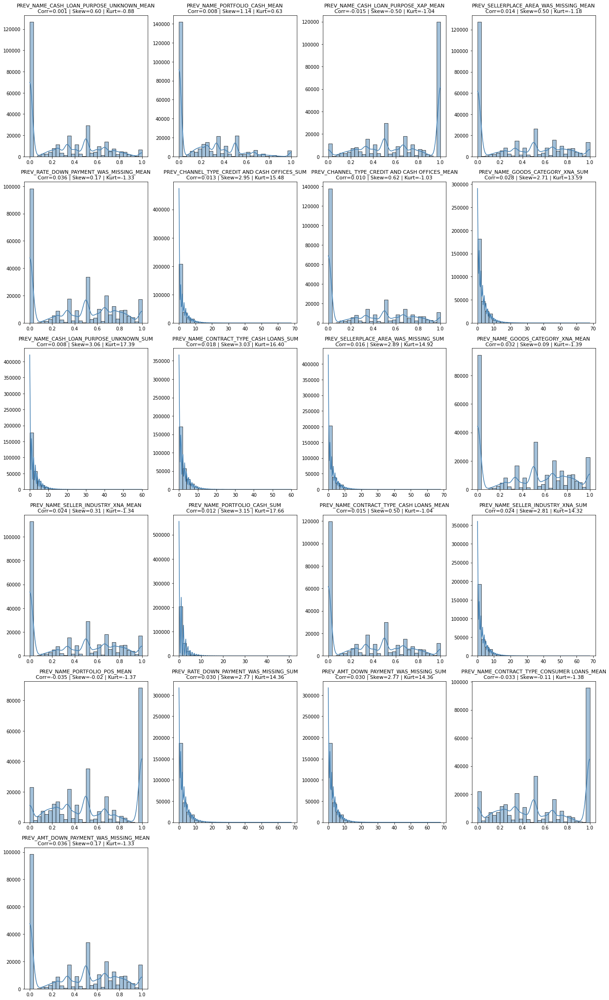

In [230]:
# Liste des transformations par groupe de corrélation

transfos = ['PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_MEAN', 'PREV_NAME_PORTFOLIO_CASH_MEAN', 
            'PREV_NAME_CASH_LOAN_PURPOSE_XAP_MEAN', 'PREV_SELLERPLACE_AREA_WAS_MISSING_MEAN', 
            'PREV_RATE_DOWN_PAYMENT_WAS_MISSING_MEAN', 'PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_SUM', 
            'PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_MEAN', 'PREV_NAME_GOODS_CATEGORY_XNA_SUM', 
            'PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_SUM', 'PREV_NAME_CONTRACT_TYPE_CASH LOANS_SUM', 
            'PREV_SELLERPLACE_AREA_WAS_MISSING_SUM', 'PREV_NAME_GOODS_CATEGORY_XNA_MEAN', 
            'PREV_NAME_SELLER_INDUSTRY_XNA_MEAN', 'PREV_NAME_PORTFOLIO_CASH_SUM', 
            'PREV_NAME_CONTRACT_TYPE_CASH LOANS_MEAN', 'PREV_NAME_SELLER_INDUSTRY_XNA_SUM', 
            'PREV_NAME_PORTFOLIO_POS_MEAN', 'PREV_RATE_DOWN_PAYMENT_WAS_MISSING_SUM', 
            'PREV_AMT_DOWN_PAYMENT_WAS_MISSING_SUM', 'PREV_NAME_CONTRACT_TYPE_CONSUMER LOANS_MEAN', 
            'PREV_AMT_DOWN_PAYMENT_WAS_MISSING_MEAN']

plot_transformations_distributions(
    df=df_train_iterative_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

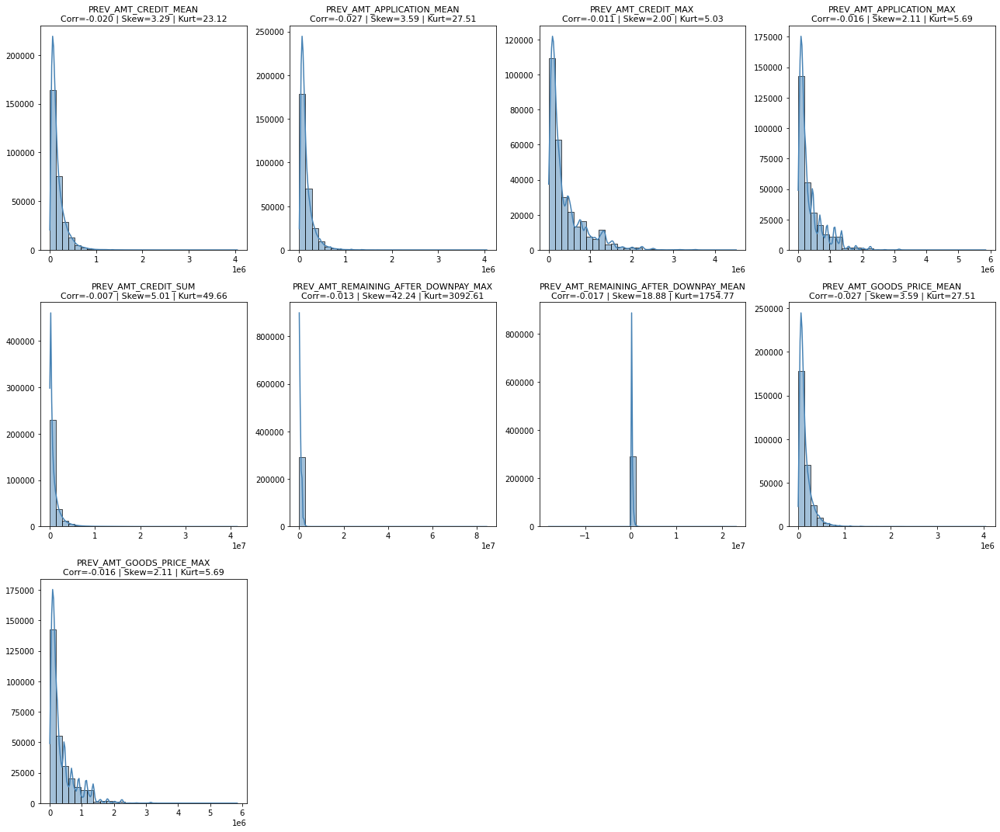

In [231]:
# Liste des transformations par groupe de corrélation

transfos = ['PREV_AMT_CREDIT_MEAN', 'PREV_AMT_APPLICATION_MEAN', 
            'PREV_AMT_CREDIT_MAX', 'PREV_AMT_APPLICATION_MAX', 
            'PREV_AMT_CREDIT_SUM', 'PREV_AMT_REMAINING_AFTER_DOWNPAY_MAX', 
            'PREV_AMT_REMAINING_AFTER_DOWNPAY_MEAN', 'PREV_AMT_GOODS_PRICE_MEAN', 
            'PREV_AMT_GOODS_PRICE_MAX']

plot_transformations_distributions(
    df=df_train_iterative_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

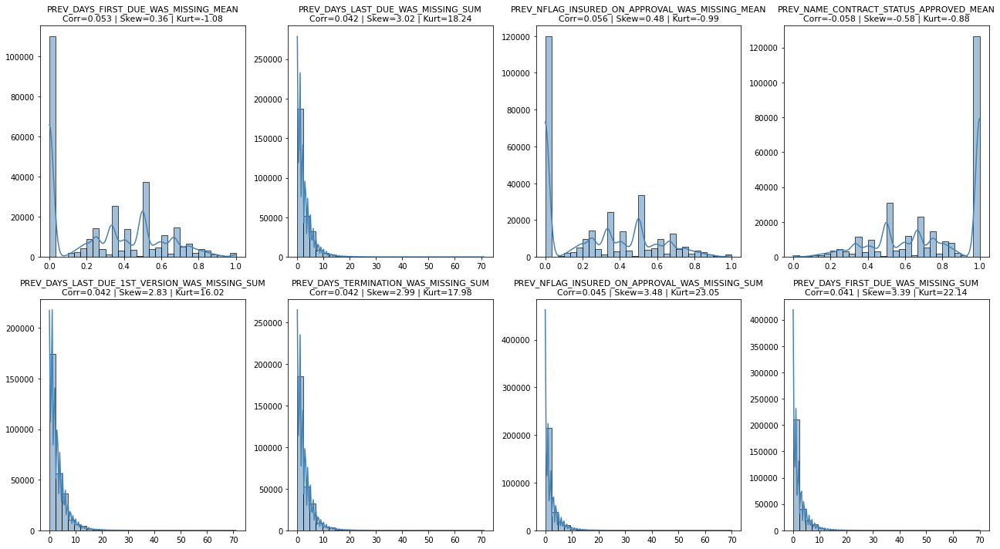

In [232]:
# Liste des transformations par groupe de corrélation

transfos = ['PREV_DAYS_FIRST_DUE_WAS_MISSING_MEAN', 'PREV_DAYS_LAST_DUE_WAS_MISSING_SUM', 
            'PREV_NFLAG_INSURED_ON_APPROVAL_WAS_MISSING_MEAN', 'PREV_NAME_CONTRACT_STATUS_APPROVED_MEAN', 
            'PREV_DAYS_LAST_DUE_1ST_VERSION_WAS_MISSING_SUM', 'PREV_DAYS_TERMINATION_WAS_MISSING_SUM', 
            'PREV_NFLAG_INSURED_ON_APPROVAL_WAS_MISSING_SUM', 'PREV_DAYS_FIRST_DUE_WAS_MISSING_SUM']

plot_transformations_distributions(
    df=df_train_iterative_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

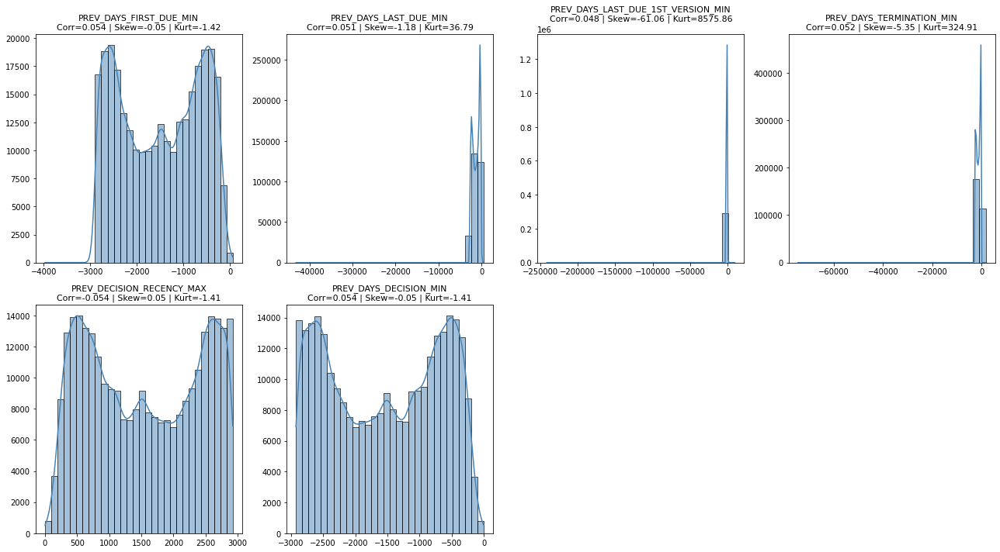

In [233]:
# Liste des transformations par groupe de corrélation

transfos = ['PREV_DAYS_FIRST_DUE_MIN', 'PREV_DAYS_LAST_DUE_MIN', 
            'PREV_DAYS_LAST_DUE_1ST_VERSION_MIN', 'PREV_DAYS_TERMINATION_MIN', 
            'PREV_DECISION_RECENCY_MAX', 'PREV_DAYS_DECISION_MIN']

plot_transformations_distributions(
    df=df_train_iterative_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

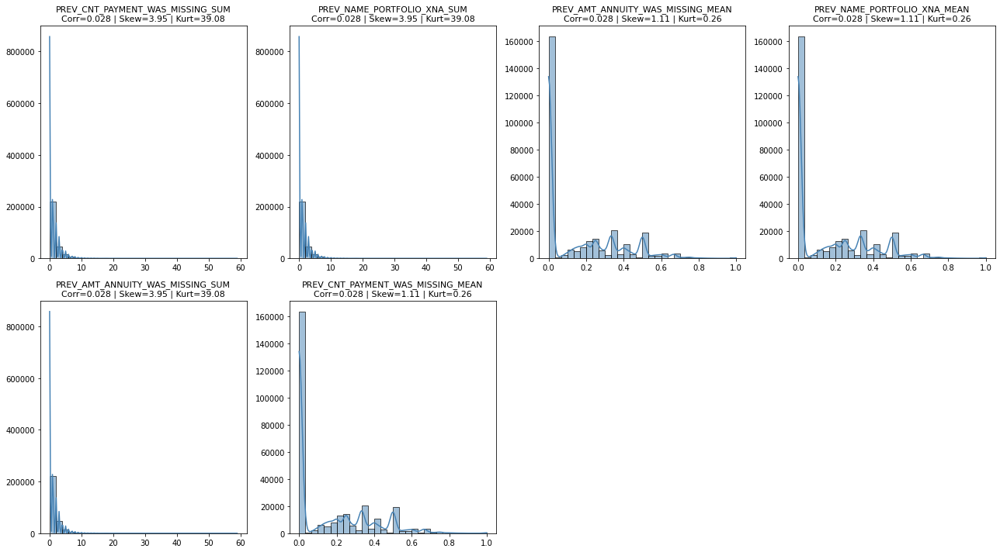

In [234]:
# Liste des transformations par groupe de corrélation

transfos = ['PREV_CNT_PAYMENT_WAS_MISSING_SUM', 'PREV_NAME_PORTFOLIO_XNA_SUM', 
            'PREV_AMT_ANNUITY_WAS_MISSING_MEAN', 'PREV_NAME_PORTFOLIO_XNA_MEAN', 
            'PREV_AMT_ANNUITY_WAS_MISSING_SUM', 'PREV_CNT_PAYMENT_WAS_MISSING_MEAN']

plot_transformations_distributions(
    df=df_train_iterative_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

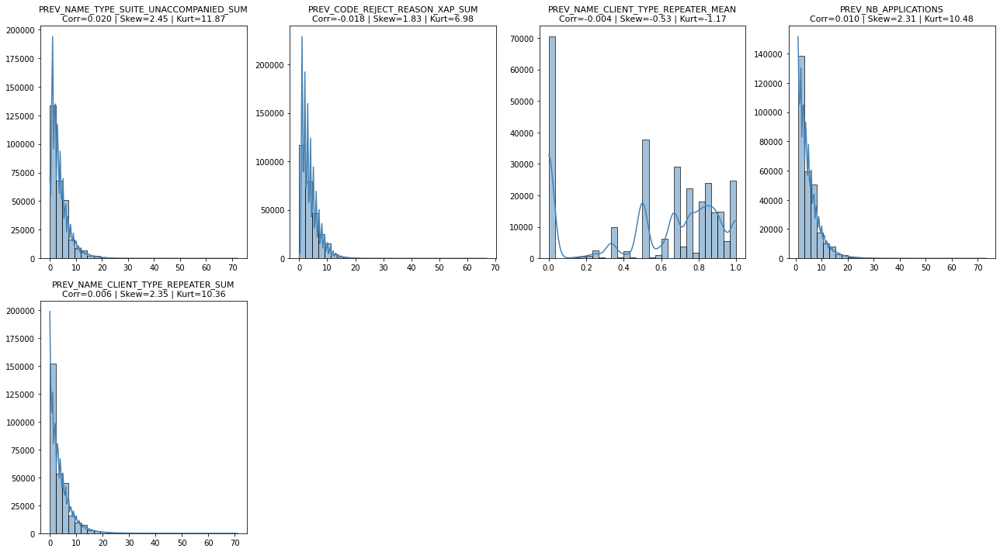

In [235]:
# Liste des transformations par groupe de corrélation

transfos = ['PREV_NAME_TYPE_SUITE_UNACCOMPANIED_SUM', 'PREV_CODE_REJECT_REASON_XAP_SUM', 
            'PREV_NAME_CLIENT_TYPE_REPEATER_MEAN', 'PREV_NB_APPLICATIONS', 
            'PREV_NAME_CLIENT_TYPE_REPEATER_SUM']

plot_transformations_distributions(
    df=df_train_iterative_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

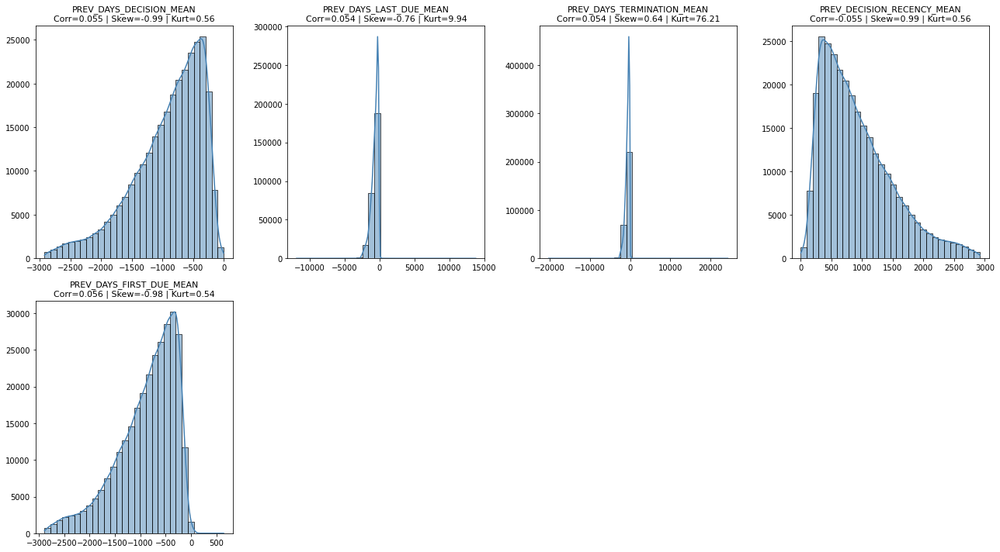

In [236]:
# Liste des transformations par groupe de corrélation

transfos = ['PREV_DAYS_DECISION_MEAN', 'PREV_DAYS_LAST_DUE_MEAN', 
            'PREV_DAYS_TERMINATION_MEAN', 'PREV_DECISION_RECENCY_MEAN', 
            'PREV_DAYS_FIRST_DUE_MEAN']

plot_transformations_distributions(
    df=df_train_iterative_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

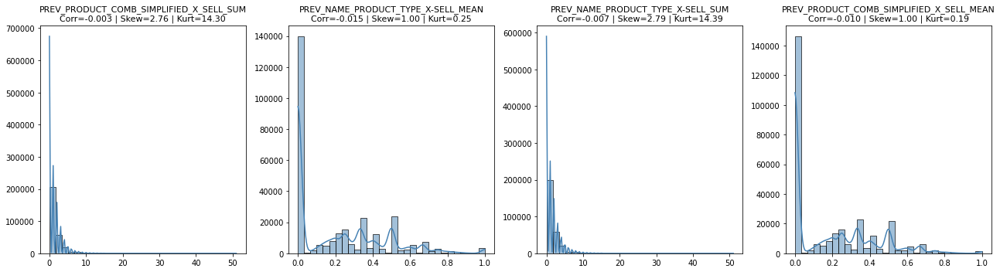

In [237]:
# Liste des transformations par groupe de corrélation

transfos = ['PREV_PRODUCT_COMB_SIMPLIFIED_X_SELL_SUM', 'PREV_NAME_PRODUCT_TYPE_X-SELL_MEAN', 
            'PREV_NAME_PRODUCT_TYPE_X-SELL_SUM', 'PREV_PRODUCT_COMB_SIMPLIFIED_X_SELL_MEAN']

plot_transformations_distributions(
    df=df_train_iterative_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

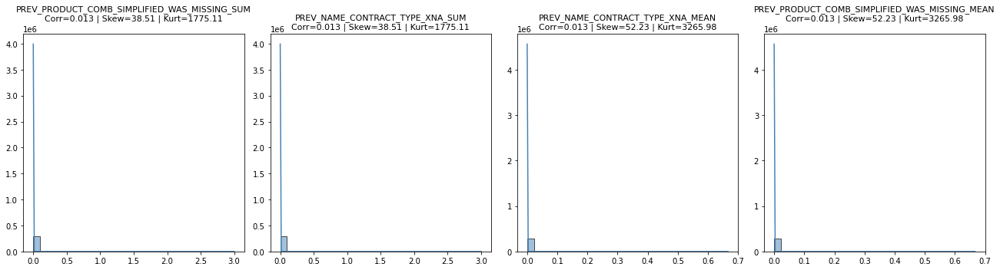

In [238]:
# Liste des transformations par groupe de corrélation

transfos = ['PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_SUM', 'PREV_NAME_CONTRACT_TYPE_XNA_SUM', 
            'PREV_NAME_CONTRACT_TYPE_XNA_MEAN', 'PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_MEAN']

plot_transformations_distributions(
    df=df_train_iterative_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

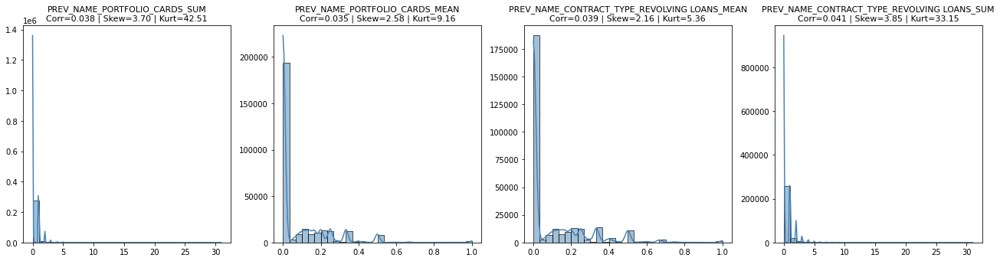

In [239]:
# Liste des transformations par groupe de corrélation

transfos = ['PREV_NAME_PORTFOLIO_CARDS_SUM', 'PREV_NAME_PORTFOLIO_CARDS_MEAN', 
            'PREV_NAME_CONTRACT_TYPE_REVOLVING LOANS_MEAN', 'PREV_NAME_CONTRACT_TYPE_REVOLVING LOANS_SUM']

plot_transformations_distributions(
    df=df_train_iterative_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

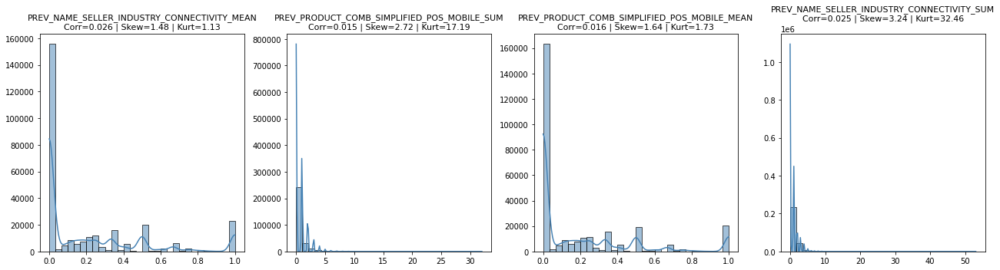

In [240]:
# Liste des transformations par groupe de corrélation

transfos = ['PREV_NAME_SELLER_INDUSTRY_CONNECTIVITY_MEAN', 'PREV_PRODUCT_COMB_SIMPLIFIED_POS_MOBILE_SUM', 
            'PREV_PRODUCT_COMB_SIMPLIFIED_POS_MOBILE_MEAN', 'PREV_NAME_SELLER_INDUSTRY_CONNECTIVITY_SUM']

plot_transformations_distributions(
    df=df_train_iterative_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

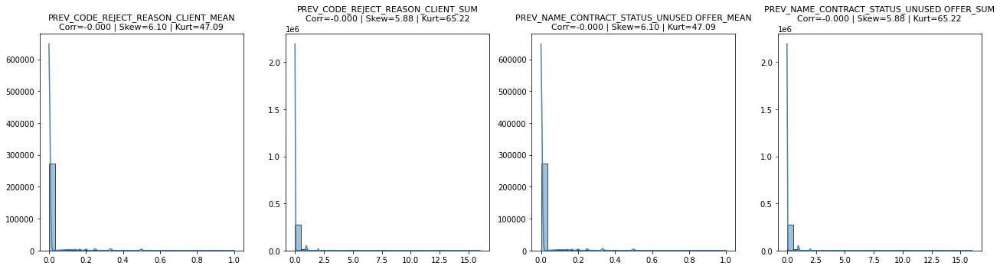

In [241]:
# Liste des transformations par groupe de corrélation

transfos = ['PREV_CODE_REJECT_REASON_CLIENT_MEAN', 'PREV_CODE_REJECT_REASON_CLIENT_SUM', 
            'PREV_NAME_CONTRACT_STATUS_UNUSED OFFER_MEAN', 'PREV_NAME_CONTRACT_STATUS_UNUSED OFFER_SUM']

plot_transformations_distributions(
    df=df_train_iterative_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

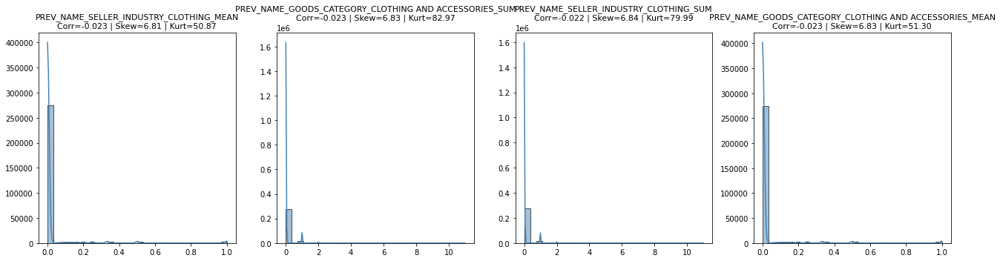

In [242]:
# Liste des transformations par groupe de corrélation

transfos = ['PREV_NAME_SELLER_INDUSTRY_CLOTHING_MEAN', 'PREV_NAME_GOODS_CATEGORY_CLOTHING AND ACCESSORIES_SUM', 
            'PREV_NAME_SELLER_INDUSTRY_CLOTHING_SUM', 'PREV_NAME_GOODS_CATEGORY_CLOTHING AND ACCESSORIES_MEAN']

plot_transformations_distributions(
    df=df_train_iterative_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

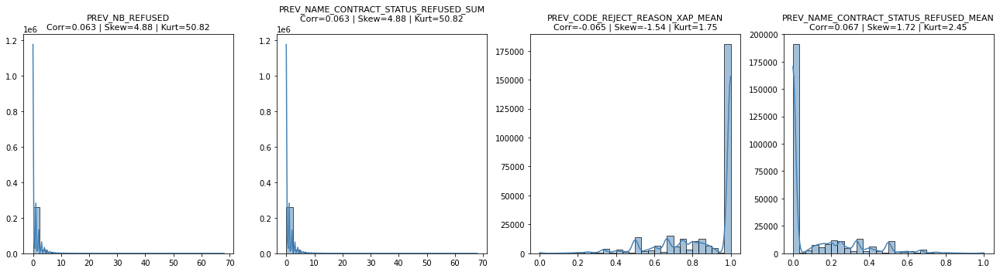

In [243]:
# Liste des transformations par groupe de corrélation

transfos = ['PREV_NB_REFUSED', 'PREV_NAME_CONTRACT_STATUS_REFUSED_SUM', 
            'PREV_CODE_REJECT_REASON_XAP_MEAN', 'PREV_NAME_CONTRACT_STATUS_REFUSED_MEAN']

plot_transformations_distributions(
    df=df_train_iterative_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

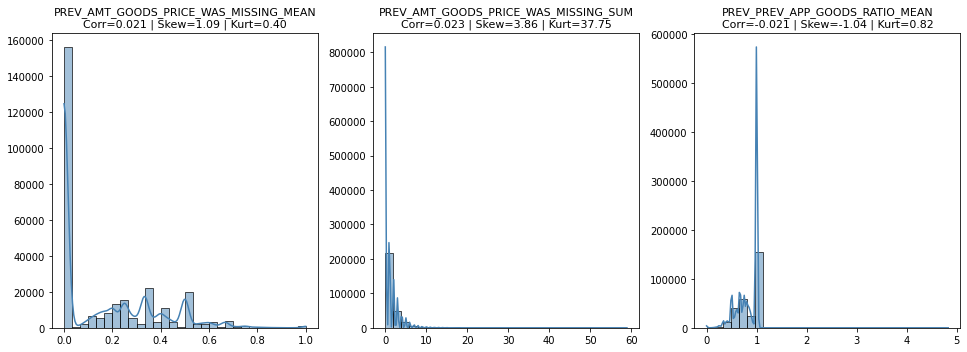

In [244]:
# Liste des transformations par groupe de corrélation

transfos = ['PREV_AMT_GOODS_PRICE_WAS_MISSING_MEAN', 'PREV_AMT_GOODS_PRICE_WAS_MISSING_SUM', 
            'PREV_PREV_APP_GOODS_RATIO_MEAN']

plot_transformations_distributions(
    df=df_train_iterative_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

c:\Users\Caomghin\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1076: RuntimeWarning:

overflow encountered in square

c:\Users\Caomghin\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1076: RuntimeWarning:

overflow encountered in square



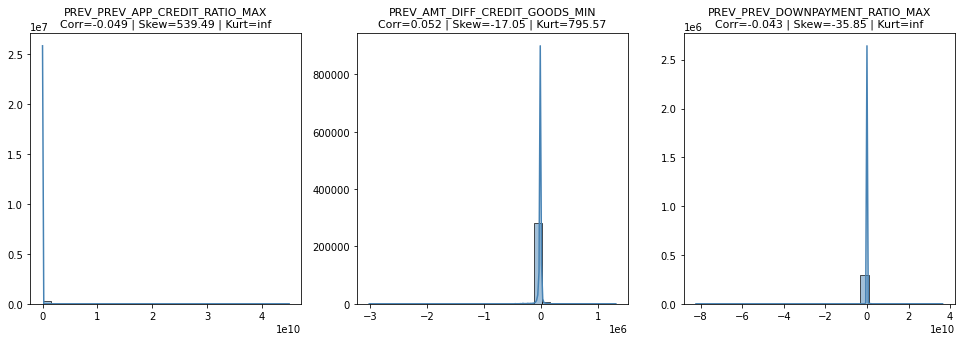

In [245]:
# Liste des transformations par groupe de corrélation

transfos = ['PREV_PREV_APP_CREDIT_RATIO_MAX', 'PREV_AMT_DIFF_CREDIT_GOODS_MIN', 
            'PREV_PREV_DOWNPAYMENT_RATIO_MAX']

plot_transformations_distributions(
    df=df_train_iterative_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

c:\Users\Caomghin\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1076: RuntimeWarning:

overflow encountered in square

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\core\_methods.py:118: RuntimeWarning:

overflow encountered in reduce



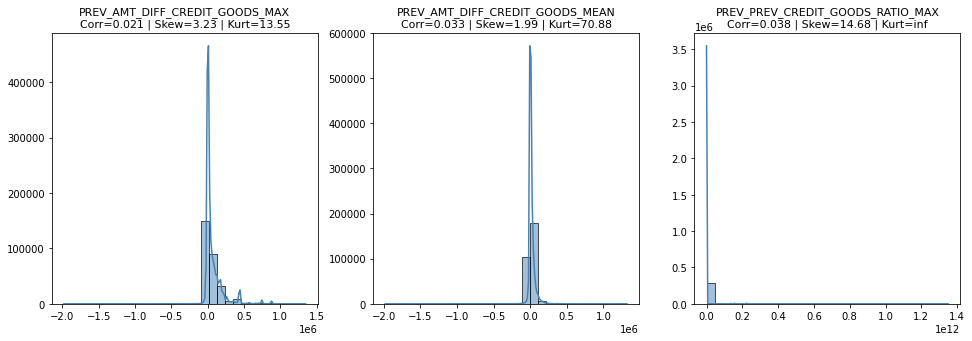

In [246]:
# Liste des transformations par groupe de corrélation

transfos = ['PREV_AMT_DIFF_CREDIT_GOODS_MAX', 'PREV_AMT_DIFF_CREDIT_GOODS_MEAN', 
            'PREV_PREV_CREDIT_GOODS_RATIO_MAX']

plot_transformations_distributions(
    df=df_train_iterative_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

In [247]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

cols_to_drop = [
    'PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_MEAN', 'PREV_NAME_PORTFOLIO_CASH_MEAN', 
    'PREV_NAME_CASH_LOAN_PURPOSE_XAP_MEAN', 'PREV_SELLERPLACE_AREA_WAS_MISSING_MEAN', 
    'PREV_RATE_DOWN_PAYMENT_WAS_MISSING_MEAN', 'PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_SUM', 
    'PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_MEAN', 'PREV_NAME_GOODS_CATEGORY_XNA_SUM', 
    'PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_SUM', 'PREV_NAME_CONTRACT_TYPE_CASH LOANS_SUM', 
    'PREV_SELLERPLACE_AREA_WAS_MISSING_SUM', 'PREV_NAME_GOODS_CATEGORY_XNA_MEAN', 
    'PREV_NAME_SELLER_INDUSTRY_XNA_MEAN', 'PREV_NAME_PORTFOLIO_CASH_SUM', 
    'PREV_NAME_CONTRACT_TYPE_CASH LOANS_MEAN', 'PREV_NAME_SELLER_INDUSTRY_XNA_SUM', 
    'PREV_NAME_PORTFOLIO_POS_MEAN', 
    'PREV_AMT_DOWN_PAYMENT_WAS_MISSING_SUM', 'PREV_NAME_CONTRACT_TYPE_CONSUMER LOANS_MEAN', 
    'PREV_AMT_DOWN_PAYMENT_WAS_MISSING_MEAN',
    
    'PREV_AMT_CREDIT_MEAN', 'PREV_AMT_CREDIT_MAX', 'PREV_AMT_APPLICATION_MAX', 
    'PREV_AMT_CREDIT_SUM', 'PREV_AMT_REMAINING_AFTER_DOWNPAY_MAX', 
    'PREV_AMT_REMAINING_AFTER_DOWNPAY_MEAN', 'PREV_AMT_GOODS_PRICE_MEAN', 'PREV_AMT_GOODS_PRICE_MAX',

    'PREV_DAYS_FIRST_DUE_WAS_MISSING_MEAN', 'PREV_DAYS_LAST_DUE_WAS_MISSING_SUM', 
    'PREV_NFLAG_INSURED_ON_APPROVAL_WAS_MISSING_MEAN', 'PREV_DAYS_LAST_DUE_1ST_VERSION_WAS_MISSING_SUM', 'PREV_DAYS_TERMINATION_WAS_MISSING_SUM', 
    'PREV_NFLAG_INSURED_ON_APPROVAL_WAS_MISSING_SUM', 'PREV_DAYS_FIRST_DUE_WAS_MISSING_SUM',

    'PREV_DAYS_LAST_DUE_MIN', 'PREV_DAYS_LAST_DUE_1ST_VERSION_MIN', 'PREV_DAYS_TERMINATION_MIN', 'PREV_DECISION_RECENCY_MAX', 'PREV_DAYS_DECISION_MIN',

    'PREV_NAME_PORTFOLIO_XNA_SUM', 'PREV_AMT_ANNUITY_WAS_MISSING_MEAN', 'PREV_NAME_PORTFOLIO_XNA_MEAN', 'PREV_AMT_ANNUITY_WAS_MISSING_SUM', 'PREV_CNT_PAYMENT_WAS_MISSING_MEAN',

    'PREV_CODE_REJECT_REASON_XAP_SUM', 'PREV_NAME_CLIENT_TYPE_REPEATER_MEAN', 'PREV_NB_APPLICATIONS', 'PREV_NAME_CLIENT_TYPE_REPEATER_SUM',

    'PREV_DAYS_DECISION_MEAN', 'PREV_DAYS_LAST_DUE_MEAN', 'PREV_DAYS_TERMINATION_MEAN', 'PREV_DECISION_RECENCY_MEAN', 

    'PREV_PRODUCT_COMB_SIMPLIFIED_X_SELL_SUM', 'PREV_NAME_PRODUCT_TYPE_X-SELL_SUM', 'PREV_PRODUCT_COMB_SIMPLIFIED_X_SELL_MEAN',

    'PREV_NAME_CONTRACT_TYPE_XNA_SUM', 'PREV_NAME_CONTRACT_TYPE_XNA_MEAN', 'PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_MEAN', 

    'PREV_NAME_PORTFOLIO_CARDS_SUM', 'PREV_NAME_PORTFOLIO_CARDS_MEAN', 'PREV_NAME_CONTRACT_TYPE_REVOLVING LOANS_MEAN',  

    'PREV_PRODUCT_COMB_SIMPLIFIED_POS_MOBILE_SUM', 'PREV_PRODUCT_COMB_SIMPLIFIED_POS_MOBILE_MEAN', 'PREV_NAME_SELLER_INDUSTRY_CONNECTIVITY_SUM',

    'PREV_CODE_REJECT_REASON_CLIENT_SUM', 'PREV_NAME_CONTRACT_STATUS_UNUSED OFFER_MEAN', 'PREV_NAME_CONTRACT_STATUS_UNUSED OFFER_SUM',

    'PREV_NAME_SELLER_INDUSTRY_CLOTHING_MEAN', 'PREV_NAME_GOODS_CATEGORY_CLOTHING AND ACCESSORIES_SUM', 'PREV_NAME_SELLER_INDUSTRY_CLOTHING_SUM',

    'PREV_NB_REFUSED', 'PREV_NAME_CONTRACT_STATUS_REFUSED_SUM', 'PREV_CODE_REJECT_REASON_XAP_MEAN', 'PREV_AMT_GOODS_PRICE_WAS_MISSING_MEAN', 'PREV_PREV_APP_GOODS_RATIO_MEAN', 

    'PREV_PREV_APP_CREDIT_RATIO_MAX', 'PREV_PREV_DOWNPAYMENT_RATIO_MAX', 'PREV_AMT_DIFF_CREDIT_GOODS_MAX', 'PREV_PREV_CREDIT_GOODS_RATIO_MAX',

    'PREV_NAME_PAYMENT_TYPE_CASH THROUGH THE BANK_MEAN', 'PREV_PRODUCT_COMB_SIMPLIFIED_POS_INDUSTRY_SUM', 'PREV_NAME_GOODS_CATEGORY_COMPUTERS_SUM', 'PREV_DAYS_TERMINATION_WAS_MISSING_MEAN', 'PREV_NAME_CONTRACT_TYPE_CONSUMER LOANS_SUM',

    'PREV_AMT_DOWN_PAYMENT_MEAN', 'PREV_NAME_PRODUCT_TYPE_WALK-IN_MEAN', 'PREV_WEEKDAY_APPR_PROCESS_START_SUNDAY_SUM', 'PREV_NAME_CONTRACT_STATUS_CANCELED_MEAN', 'PREV_NAME_GOODS_CATEGORY_CONSUMER ELECTRONICS_MEAN',

    'PREV_WEEKDAY_APPR_PROCESS_START_THURSDAY_MEAN', 'PREV_NAME_TYPE_SUITE_FAMILY_SUM', 'PREV_NAME_GOODS_CATEGORY_MOBILE_SUM', 'PREV_NAME_YIELD_GROUP_XNA_SUM', 'PREV_NAME_SELLER_INDUSTRY_CONSUMER ELECTRONICS_SUM',

    'PREV_NAME_SELLER_INDUSTRY_CONSUMER ELECTRONICS_MEAN', 'PREV_PREV_APP_CREDIT_RATIO_MEAN', 'PREV_PREV_CREDIT_PER_PAYMENT_MEAN', 'PREV_DAYS_TERMINATION_MAX', 'PREV_WEEKDAY_APPR_PROCESS_START_SATURDAY_SUM',

    'PREV_PRODUCT_COMB_SIMPLIFIED_CASH_MEAN', 'PREV_WEEKDAY_APPR_PROCESS_START_FRIDAY_MEAN', 'PREV_WEEKDAY_APPR_PROCESS_START_WEDNESDAY_MEAN', 'PREV_WEEKDAY_APPR_PROCESS_START_TUESDAY_MEAN', 'PREV_NAME_CLIENT_TYPE_REFRESHED_SUM',

    'PREV_CHANNEL_TYPE_STONE_SUM', 'PREV_WEEKDAY_APPR_PROCESS_START_MONDAY_MEAN', 'PREV_NAME_GOODS_CATEGORY_AUDIO/VIDEO_MEAN', 'PREV_NAME_YIELD_GROUP_LOW_ACTION_SUM', 'PREV_CHANNEL_TYPE_REGIONAL / LOCAL_MEAN',

    'PREV_PRODUCT_COMB_SIMPLIFIED_CARD_MEAN', 'PREV_NAME_SELLER_INDUSTRY_INDUSTRY_SUM', 'PREV_NAME_CASH_LOAN_PURPOSE_REPAIRS_MEAN', 'PREV_NAME_TYPE_SUITE_OTHER_B_SUM', 'PREV_NAME_TYPE_SUITE_OTHER_A_SUM',

    'PREV_CODE_REJECT_REASON_SCOFR_MEAN', 'PREV_NAME_SELLER_INDUSTRY_OTHER_SELLERS_MEAN', 'PREV_NAME_PAYMENT_TYPE_NON-CASH FROM YOUR ACCOUNT_SUM', 'PREV_CODE_REJECT_REASON_XNA_MEAN', 'PREV_CHANNEL_TYPE_OTHER_CHANNELS_SUM',

    'PREV_CODE_REJECT_REASON_VERIF_MEAN', 'PREV_NAME_TYPE_SUITE_GROUP OF PEOPLE_MEAN', 'PREV_NAME_CLIENT_TYPE_XNA_MEAN', 'PREV_NAME_PAYMENT_TYPE_CASHLESS FROM THE ACCOUNT OF THE EMPLOYER_MEAN', 'PREV_CODE_REJECT_REASON_SYSTEM_MEAN',

    'PREV_CODE_REJECT_REASON_SYSTEM_MEAN', 'PREV_NAME_PORTFOLIO_CARS_MEAN', 'PREV_NAME_GOODS_CATEGORY_CONSTRUCTION MATERIALS_SUM', 'PREV_PRODUCT_COMB_SIMPLIFIED_POS_OTHERS_SUM', 'PREV_NAME_GOODS_CATEGORY_PHOTO / CINEMA EQUIPMENT_MEAN',

    'PREV_NAME_GOODS_CATEGORY_FURNITURE_SUM', 'PREV_CODE_REJECT_REASON_HC_SUM', 'PREV_PREV_LAST_DUE_DELAY_MAX', 'PREV_NAME_TYPE_SUITE_SPOUSE, PARTNER_SUM', 'PREV_PREV_LAST_DUE_DELAY_MEAN',

    'PREV_NAME_SELLER_INDUSTRY_FURNITURE_SUM', 'PREV_CHANNEL_TYPE_CONTACT CENTER_MEAN', 'PREV_DAYS_DECISION_MAX', 'PREV_CODE_REJECT_REASON_SCO_MEAN', 'PREV_NAME_GOODS_CATEGORY_OTHER_GOODS_SUM',

    'PREV_CODE_REJECT_REASON_LIMIT_MEAN', 'PREV_NAME_CASH_LOAN_PURPOSE_OTHER_PURPOSE_MEAN', 'PREV_NAME_TYPE_SUITE_CHILDREN_MEAN', 'PREV_NAME_SELLER_INDUSTRY_CONSTRUCTION_SUM', 'PREV_CHANNEL_TYPE_AP+ (CASH LOAN)_SUM',

    'PREV_PREV_ANNUITY_CREDIT_RATIO_MAX'

    ]

df_train_iterative_mode.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [248]:
remaining_cols = list(set(df_previous_train_iterative_mode_agg.columns).intersection(df_train_iterative_mode.columns))

In [249]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_train_iterative_mode[remaining_cols], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation


In [250]:
# Réduction de la taille du dataframe.

optimize_types(df_train_iterative_mode)

 Mémoire avant : 846.42 MB
 Mémoire après : 703.89 MB
 Gain : 16.8%


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_ANNUITY,AMT_GOODS_PRICE,...,PREV_DAYS_DECISION_WAS_MISSING_MEAN,PREV_DAYS_DECISION_WAS_MISSING_SUM,PREV_CNT_PAYMENT_WAS_MISSING_SUM,PREV_DAYS_LAST_DUE_1ST_VERSION_WAS_MISSING_MEAN,PREV_DAYS_LAST_DUE_WAS_MISSING_MEAN,PREV_PRODUCT_HAS_INTEREST_WAS_MISSING_MEAN,PREV_PRODUCT_HAS_INTEREST_WAS_MISSING_SUM,PREV_FLAG_LAST_APPL_PER_CONTRACT_WAS_MISSING_MEAN,PREV_FLAG_LAST_APPL_PER_CONTRACT_WAS_MISSING_SUM,PREV_PCT_APPROVED
0,100002,1,0,1,0,1,0,202500.0,24700.5,351000.0,...,0,0,0,1.000000,0.000000,0,0,0,0,1
1,100003,0,0,0,0,0,0,270000.0,35698.5,1129500.0,...,0,0,0,0.000000,0.000000,0,0,0,0,3
2,100004,0,1,1,1,1,0,67500.0,6750.0,135000.0,...,0,0,0,0.000000,0.000000,0,0,0,0,1
3,100006,0,0,0,0,1,0,135000.0,29686.5,297000.0,...,0,0,3,0.888889,0.777778,0,0,0,0,5
4,100007,0,0,1,0,1,0,121500.0,21865.5,513000.0,...,0,0,0,0.333333,0.333333,0,0,0,0,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307495,456251,0,0,1,0,0,0,157500.0,27558.0,225000.0,...,0,0,0,0.000000,0.000000,0,0,0,0,1
307496,456252,0,0,0,0,1,0,72000.0,12001.5,225000.0,...,0,0,0,0.000000,0.000000,0,0,0,0,1
307497,456253,0,0,0,0,1,0,153000.0,29979.0,585000.0,...,0,0,0,0.000000,0.000000,0,0,0,0,2
307498,456254,1,0,0,0,1,0,171000.0,20205.0,319500.0,...,0,0,0,1.000000,1.000000,0,0,0,0,2


#### Corrélation des variables - df_train_nan_missing

In [251]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_nan_missing[df_previous_train_nan_missing_agg.columns.tolist()], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,PREV_DAYS_DECISION_MEAN / PREV_DECISION_RECENCY_MEAN,PREV_DAYS_DECISION_MEAN,PREV_DECISION_RECENCY_MEAN,-1.000000
1,PREV_NAME_CASH_LOAN_PURPOSE_XAP_MEAN / PREV_NAME_CONTRACT_TYPE_CASH LOANS_MEAN,PREV_NAME_CONTRACT_TYPE_CASH LOANS_MEAN,PREV_NAME_CASH_LOAN_PURPOSE_XAP_MEAN,-1.000000
2,PREV_DAYS_DECISION_MIN / PREV_DECISION_RECENCY_MAX,PREV_DAYS_DECISION_MIN,PREV_DECISION_RECENCY_MAX,-1.000000
3,PREV_NAME_CONTRACT_TYPE_XNA_SUM / PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_MEAN,PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_MEAN,PREV_NAME_CONTRACT_TYPE_XNA_SUM,1.000000
4,PREV_PRODUCT_COMB_SIMPLIFIED_MISSING_SUM / PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_MEAN,PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_MEAN,PREV_PRODUCT_COMB_SIMPLIFIED_MISSING_SUM,1.000000
5,PREV_NAME_CONTRACT_TYPE_XNA_MEAN / PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_SUM,PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_SUM,PREV_NAME_CONTRACT_TYPE_XNA_MEAN,1.000000
6,PREV_PRODUCT_COMB_SIMPLIFIED_MISSING_MEAN / PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_SUM,PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_SUM,PREV_PRODUCT_COMB_SIMPLIFIED_MISSING_MEAN,1.000000
7,PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_MEAN / PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_SUM,PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_MEAN,PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_SUM,1.000000
8,PREV_NAME_CONTRACT_TYPE_XNA_SUM / PREV_PRODUCT_COMB_SIMPLIFIED_MISSING_MEAN,PREV_NAME_CONTRACT_TYPE_XNA_SUM,PREV_PRODUCT_COMB_SIMPLIFIED_MISSING_MEAN,1.000000
9,PREV_NAME_CONTRACT_TYPE_XNA_MEAN / PREV_NAME_CONTRACT_TYPE_XNA_SUM,PREV_NAME_CONTRACT_TYPE_XNA_MEAN,PREV_NAME_CONTRACT_TYPE_XNA_SUM,1.000000


In [252]:
df_corr = get_correlation_pairs(df_train_nan_missing[df_previous_train_nan_missing_agg.columns.tolist()], method="spearman", style=False, threshold=0.9)

In [253]:
var_corr = df_corr['Variable 1'].unique().tolist() + df_corr['Variable 2'].unique().tolist()
var_corr = list(set(var_corr))

In [254]:
# Visualisation des corrélations les plus importantes avec la Target.
pd.set_option('display.max_rows', None)

target_corr = compute_target_correlations(df_train_nan_missing.loc[:, var_corr + ['TARGET']], 'TARGET', mode='nonlinear', plot=False)
target_corr.loc[var_corr].sort_values(by='spearman_corr', ascending=False)

,pearson_corr,spearman_corr,abs_pearson,abs_spearman,mutual_info,score_global
PREV_NAME_CONTRACT_STATUS_REFUSED_MEAN,0.077682,0.067487,0.077682,0.067487,0.003885,0.092373
PREV_CODE_REJECT_REASON_SCOFR_SUM,0.056293,0.063789,0.056293,0.063789,0.001779,0.063744
PREV_CODE_REJECT_REASON_SCOFR_MEAN,0.055872,0.063711,0.055872,0.063711,0.001369,0.059921
PREV_NAME_CONTRACT_STATUS_REFUSED_SUM,0.064482,0.063086,0.064482,0.063086,0.003585,0.082686
PREV_NB_REFUSED,0.064482,0.063086,0.064482,0.063086,0.004066,0.086931
PREV_NAME_PRODUCT_TYPE_WALK-IN_SUM,0.062633,0.062062,0.062633,0.062062,0.003731,0.082828
PREV_NAME_PRODUCT_TYPE_WALK-IN_MEAN,0.057408,0.061321,0.057408,0.061321,0.002465,0.069258
PREV_DAYS_LAST_DUE_WAS_MISSING_MEAN,0.056889,0.058768,0.056889,0.058768,0.005906,0.098419
PREV_DAYS_TERMINATION_WAS_MISSING_MEAN,0.056134,0.058581,0.056134,0.058581,0.006012,0.098977
PREV_NFLAG_INSURED_ON_APPROVAL_WAS_MISSING_MEAN,0.059952,0.056265,0.059952,0.056265,0.004421,0.085523


In [255]:
# Visualisation des groupes de variables corrélées entre elles.

pd.set_option('display.max_colwidth', None)
summarize_correlated_groups(df_corr, X=df_train_nan_missing, y=df_train_nan_missing['TARGET'])

,Variables du groupe,Taille du groupe,Corrélation max avec y,Variable la plus corrélée
0,"[PREV_NAME_GOODS_CATEGORY_XNA_SUM, PREV_NAME_PORTFOLIO_CASH_SUM, PREV_SELLERPLACE_AREA_WAS_MISSING_SUM, PREV_NAME_GOODS_CATEGORY_XNA_MEAN, PREV_RATE_DOWN_PAYMENT_WAS_MISSING_SUM, PREV_NAME_CONTRACT_TYPE_CASH LOANS_MEAN, PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_MEAN, PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_SUM, PREV_NAME_SELLER_INDUSTRY_XNA_MEAN, PREV_NAME_CONTRACT_TYPE_CASH LOANS_SUM, PREV_AMT_DOWN_PAYMENT_WAS_MISSING_MEAN, PREV_NAME_CONTRACT_TYPE_CONSUMER LOANS_MEAN, PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_MEAN, PREV_NAME_PORTFOLIO_CASH_MEAN, PREV_NAME_CASH_LOAN_PURPOSE_XAP_MEAN, PREV_NAME_PORTFOLIO_POS_MEAN, PREV_AMT_DOWN_PAYMENT_WAS_MISSING_SUM, PREV_NAME_SELLER_INDUSTRY_XNA_SUM, PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_SUM, PREV_RATE_DOWN_PAYMENT_WAS_MISSING_MEAN, PREV_SELLERPLACE_AREA_WAS_MISSING_MEAN]",21,0.036552,PREV_RATE_DOWN_PAYMENT_WAS_MISSING_SUM
1,"[PREV_DAYS_LAST_DUE_1ST_VERSION_MIN, PREV_DECISION_RECENCY_MEAN, PREV_DAYS_LAST_DUE_MEAN, PREV_DECISION_RECENCY_MAX, PREV_DAYS_FIRST_DUE_MIN, PREV_DAYS_LAST_DUE_MIN, PREV_DAYS_DECISION_MIN, PREV_DAYS_TERMINATION_MIN, PREV_DAYS_LAST_DUE_1ST_VERSION_MEAN, PREV_DAYS_TERMINATION_MEAN, PREV_DAYS_DECISION_MEAN, PREV_DAYS_FIRST_DUE_MEAN]",12,0.053637,PREV_DAYS_FIRST_DUE_MIN
2,"[PREV_NAME_CONTRACT_STATUS_APPROVED_MEAN, PREV_NFLAG_INSURED_ON_APPROVAL_WAS_MISSING_MEAN, PREV_DAYS_FIRST_DUE_WAS_MISSING_SUM, PREV_DAYS_LAST_DUE_WAS_MISSING_SUM, PREV_NFLAG_INSURED_ON_APPROVAL_WAS_MISSING_SUM, PREV_DAYS_FIRST_DUE_WAS_MISSING_MEAN, PREV_DAYS_TERMINATION_WAS_MISSING_SUM, PREV_DAYS_LAST_DUE_1ST_VERSION_WAS_MISSING_SUM]",8,0.063528,PREV_NAME_CONTRACT_STATUS_APPROVED_MEAN
3,"[PREV_AMT_GOODS_PRICE_MEAN, PREV_AMT_CREDIT_MAX, PREV_AMT_GOODS_PRICE_MAX, PREV_AMT_APPLICATION_MAX, PREV_AMT_CREDIT_SUM, PREV_AMT_CREDIT_MEAN, PREV_AMT_APPLICATION_MEAN]",7,0.021837,PREV_AMT_APPLICATION_MEAN
4,"[PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_MEAN, PREV_NAME_CONTRACT_TYPE_XNA_SUM, PREV_PRODUCT_COMB_SIMPLIFIED_MISSING_SUM, PREV_PRODUCT_COMB_SIMPLIFIED_MISSING_MEAN, PREV_NAME_CONTRACT_TYPE_XNA_MEAN, PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_SUM]",6,0.013011,PREV_NAME_CONTRACT_TYPE_XNA_SUM
5,"[PREV_AMT_ANNUITY_WAS_MISSING_SUM, PREV_NAME_PORTFOLIO_XNA_MEAN, PREV_NAME_PORTFOLIO_XNA_SUM, PREV_AMT_ANNUITY_WAS_MISSING_MEAN, PREV_CNT_PAYMENT_WAS_MISSING_MEAN, PREV_CNT_PAYMENT_WAS_MISSING_SUM]",6,0.032263,PREV_NAME_PORTFOLIO_XNA_SUM
6,"[PREV_CODE_REJECT_REASON_XAP_SUM, PREV_NB_APPLICATIONS, PREV_NAME_CLIENT_TYPE_REPEATER_MEAN, PREV_NAME_CLIENT_TYPE_REPEATER_SUM]",4,0.019755,PREV_NB_APPLICATIONS
7,"[PREV_NAME_CONTRACT_TYPE_REVOLVING LOANS_MEAN, PREV_NAME_CONTRACT_TYPE_REVOLVING LOANS_SUM, PREV_NAME_PORTFOLIO_CARDS_SUM, PREV_NAME_PORTFOLIO_CARDS_MEAN]",4,0.045624,PREV_NAME_CONTRACT_TYPE_REVOLVING LOANS_SUM
8,"[PREV_NAME_PRODUCT_TYPE_X-SELL_SUM, PREV_PRODUCT_COMB_SIMPLIFIED_X_SELL_MEAN, PREV_NAME_PRODUCT_TYPE_X-SELL_MEAN, PREV_PRODUCT_COMB_SIMPLIFIED_X_SELL_SUM]",4,0.018262,PREV_NAME_PRODUCT_TYPE_X-SELL_MEAN
9,"[PREV_NAME_CONTRACT_STATUS_UNUSED OFFER_SUM, PREV_CODE_REJECT_REASON_CLIENT_MEAN, PREV_NAME_CONTRACT_STATUS_UNUSED OFFER_MEAN, PREV_CODE_REJECT_REASON_CLIENT_SUM]",4,0.000914,PREV_CODE_REJECT_REASON_CLIENT_MEAN


In [256]:
pd.reset_option('display.max_colwidth')
pd.reset_option('display.max_rows')

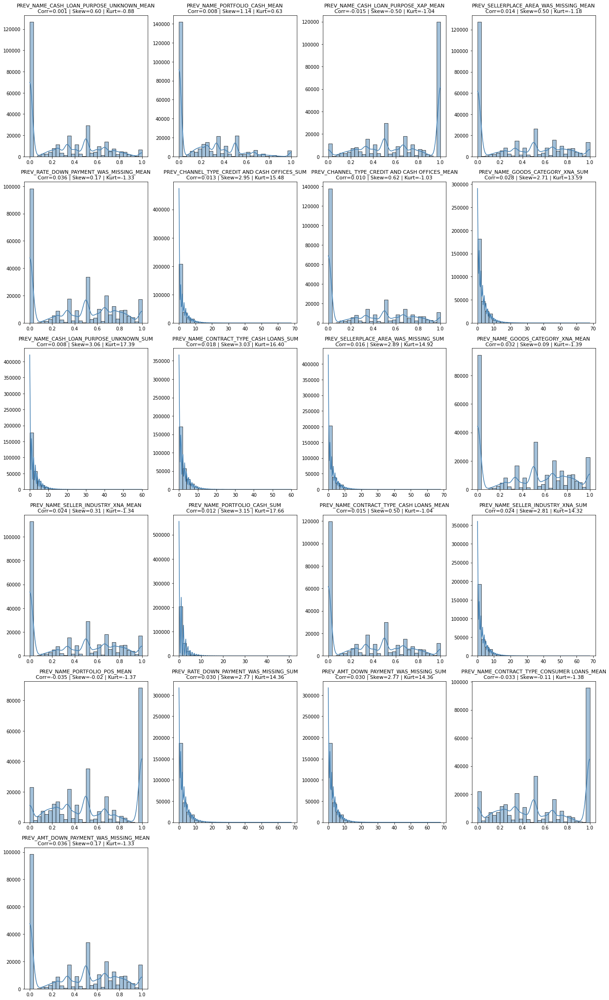

In [257]:
# Liste des transformations par groupe de corrélation

transfos = ['PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_MEAN', 'PREV_NAME_PORTFOLIO_CASH_MEAN', 
            'PREV_NAME_CASH_LOAN_PURPOSE_XAP_MEAN', 'PREV_SELLERPLACE_AREA_WAS_MISSING_MEAN', 
            'PREV_RATE_DOWN_PAYMENT_WAS_MISSING_MEAN', 'PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_SUM', 
            'PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_MEAN', 'PREV_NAME_GOODS_CATEGORY_XNA_SUM', 
            'PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_SUM', 'PREV_NAME_CONTRACT_TYPE_CASH LOANS_SUM', 
            'PREV_SELLERPLACE_AREA_WAS_MISSING_SUM', 'PREV_NAME_GOODS_CATEGORY_XNA_MEAN', 
            'PREV_NAME_SELLER_INDUSTRY_XNA_MEAN', 'PREV_NAME_PORTFOLIO_CASH_SUM', 
            'PREV_NAME_CONTRACT_TYPE_CASH LOANS_MEAN', 'PREV_NAME_SELLER_INDUSTRY_XNA_SUM', 
            'PREV_NAME_PORTFOLIO_POS_MEAN', 'PREV_RATE_DOWN_PAYMENT_WAS_MISSING_SUM', 
            'PREV_AMT_DOWN_PAYMENT_WAS_MISSING_SUM', 'PREV_NAME_CONTRACT_TYPE_CONSUMER LOANS_MEAN', 
            'PREV_AMT_DOWN_PAYMENT_WAS_MISSING_MEAN']

plot_transformations_distributions(
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

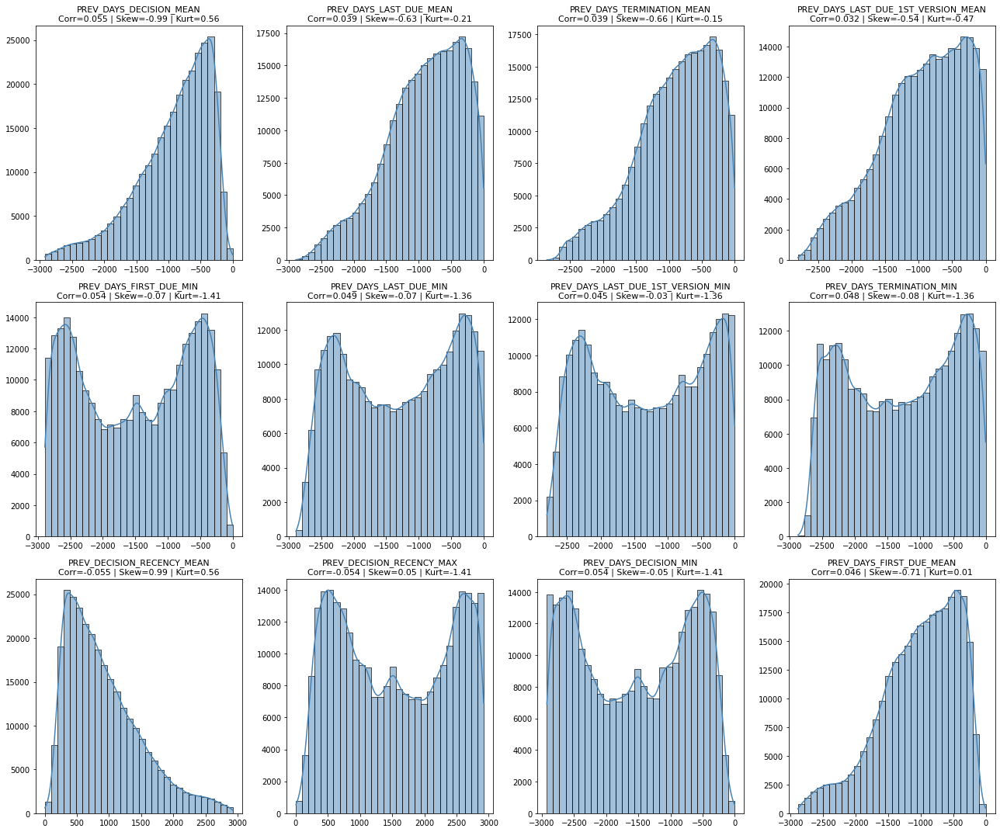

In [258]:
# Liste des transformations par groupe de corrélation

transfos = ['PREV_DAYS_DECISION_MEAN', 'PREV_DAYS_LAST_DUE_MEAN', 
            'PREV_DAYS_TERMINATION_MEAN', 'PREV_DAYS_LAST_DUE_1ST_VERSION_MEAN', 
            'PREV_DAYS_FIRST_DUE_MIN', 'PREV_DAYS_LAST_DUE_MIN', 
            'PREV_DAYS_LAST_DUE_1ST_VERSION_MIN', 'PREV_DAYS_TERMINATION_MIN', 
            'PREV_DECISION_RECENCY_MEAN', 'PREV_DECISION_RECENCY_MAX', 
            'PREV_DAYS_DECISION_MIN', 'PREV_DAYS_FIRST_DUE_MEAN']

plot_transformations_distributions(
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

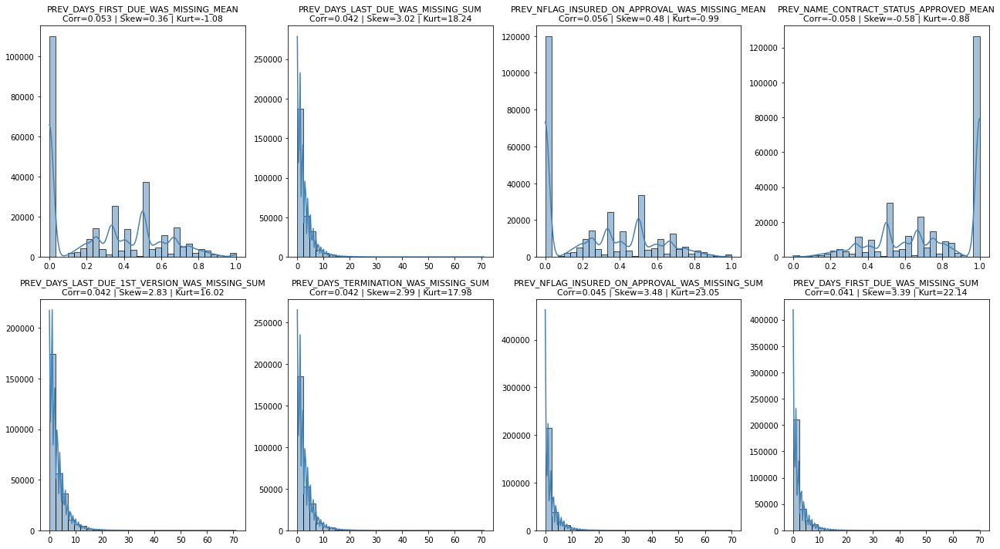

In [259]:
# Liste des transformations par groupe de corrélation

transfos = ['PREV_DAYS_FIRST_DUE_WAS_MISSING_MEAN', 'PREV_DAYS_LAST_DUE_WAS_MISSING_SUM', 
            'PREV_NFLAG_INSURED_ON_APPROVAL_WAS_MISSING_MEAN', 'PREV_NAME_CONTRACT_STATUS_APPROVED_MEAN', 
            'PREV_DAYS_LAST_DUE_1ST_VERSION_WAS_MISSING_SUM', 'PREV_DAYS_TERMINATION_WAS_MISSING_SUM', 
            'PREV_NFLAG_INSURED_ON_APPROVAL_WAS_MISSING_SUM', 'PREV_DAYS_FIRST_DUE_WAS_MISSING_SUM']

plot_transformations_distributions(
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

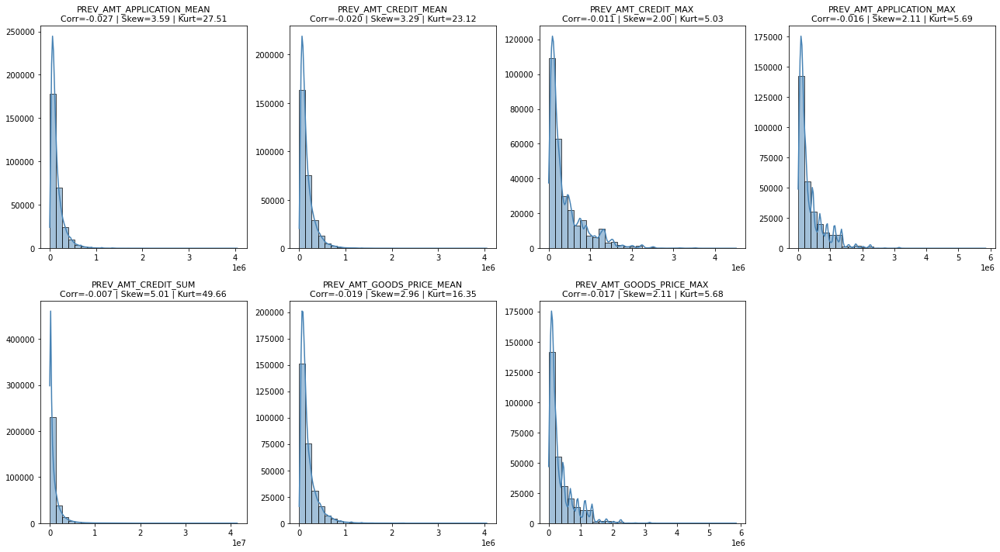

In [260]:
# Liste des transformations par groupe de corrélation

transfos = ['PREV_AMT_APPLICATION_MEAN', 'PREV_AMT_CREDIT_MEAN', 
            'PREV_AMT_CREDIT_MAX', 'PREV_AMT_APPLICATION_MAX', 
            'PREV_AMT_CREDIT_SUM', 'PREV_AMT_GOODS_PRICE_MEAN', 
            'PREV_AMT_GOODS_PRICE_MAX']

plot_transformations_distributions(
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

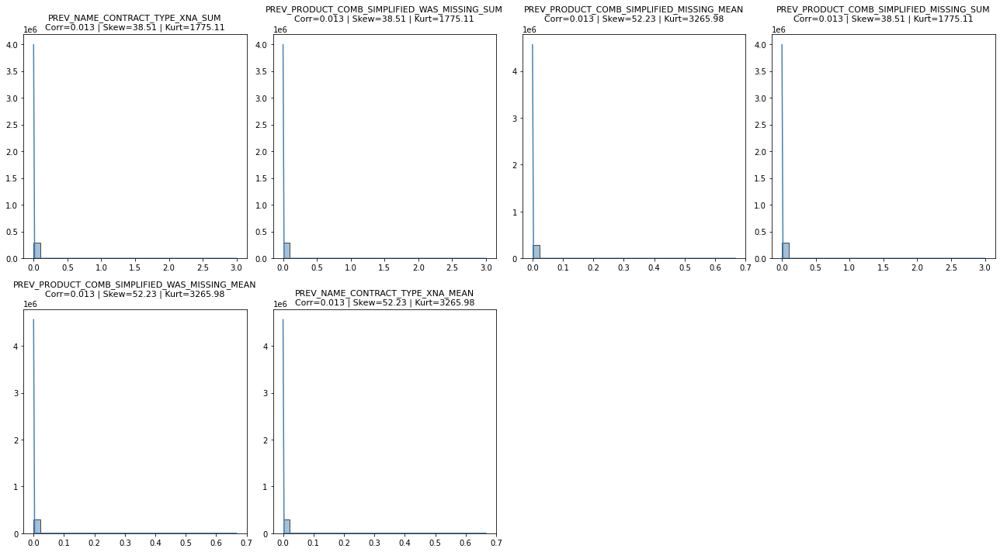

In [261]:
# Liste des transformations par groupe de corrélation

transfos = ['PREV_NAME_CONTRACT_TYPE_XNA_SUM', 'PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_SUM', 
            'PREV_PRODUCT_COMB_SIMPLIFIED_MISSING_MEAN', 'PREV_PRODUCT_COMB_SIMPLIFIED_MISSING_SUM', 
            'PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_MEAN', 'PREV_NAME_CONTRACT_TYPE_XNA_MEAN']

plot_transformations_distributions(
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

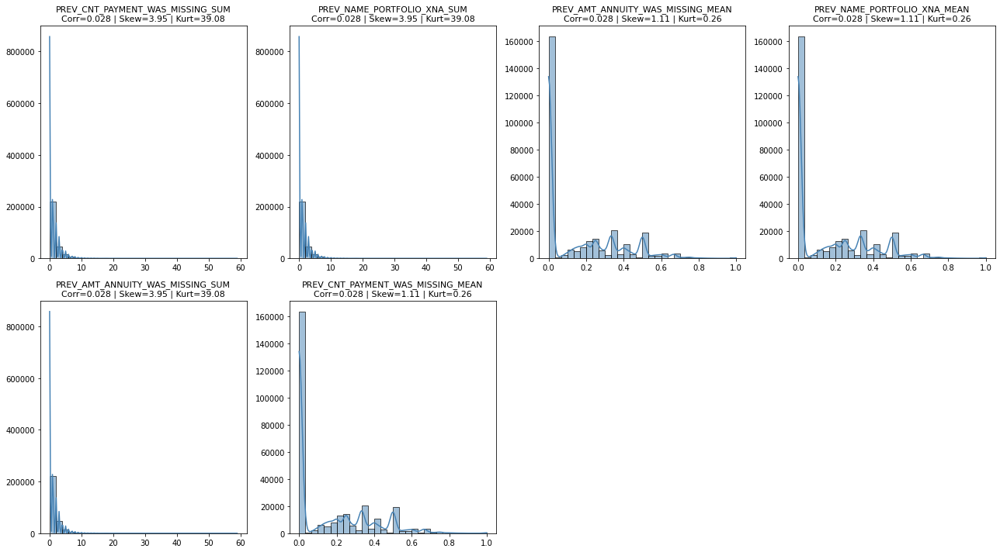

In [262]:
# Liste des transformations par groupe de corrélation

transfos = ['PREV_CNT_PAYMENT_WAS_MISSING_SUM', 'PREV_NAME_PORTFOLIO_XNA_SUM', 
            'PREV_AMT_ANNUITY_WAS_MISSING_MEAN', 'PREV_NAME_PORTFOLIO_XNA_MEAN', 
            'PREV_AMT_ANNUITY_WAS_MISSING_SUM', 'PREV_CNT_PAYMENT_WAS_MISSING_MEAN']

plot_transformations_distributions(
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

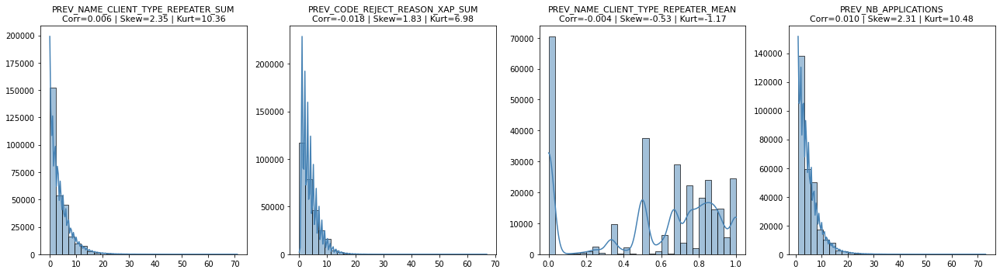

In [263]:
# Liste des transformations par groupe de corrélation

transfos = ['PREV_NAME_CLIENT_TYPE_REPEATER_SUM', 'PREV_CODE_REJECT_REASON_XAP_SUM', 
            'PREV_NAME_CLIENT_TYPE_REPEATER_MEAN', 'PREV_NB_APPLICATIONS']

plot_transformations_distributions(
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

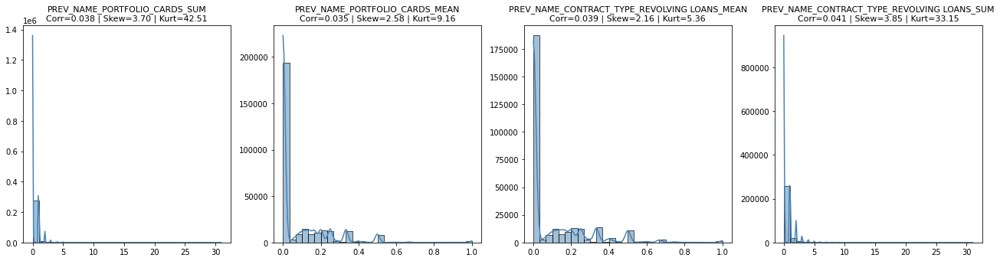

In [264]:
# Liste des transformations par groupe de corrélation

transfos = ['PREV_NAME_PORTFOLIO_CARDS_SUM', 'PREV_NAME_PORTFOLIO_CARDS_MEAN', 
            'PREV_NAME_CONTRACT_TYPE_REVOLVING LOANS_MEAN', 'PREV_NAME_CONTRACT_TYPE_REVOLVING LOANS_SUM']

plot_transformations_distributions(
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

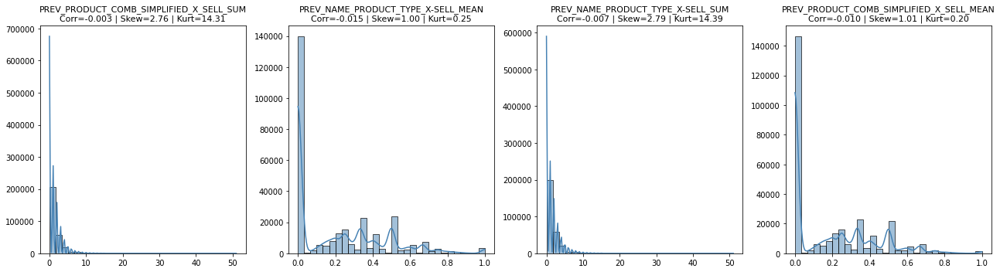

In [265]:
# Liste des transformations par groupe de corrélation

transfos = ['PREV_PRODUCT_COMB_SIMPLIFIED_X_SELL_SUM', 'PREV_NAME_PRODUCT_TYPE_X-SELL_MEAN', 
            'PREV_NAME_PRODUCT_TYPE_X-SELL_SUM', 'PREV_PRODUCT_COMB_SIMPLIFIED_X_SELL_MEAN']

plot_transformations_distributions(
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

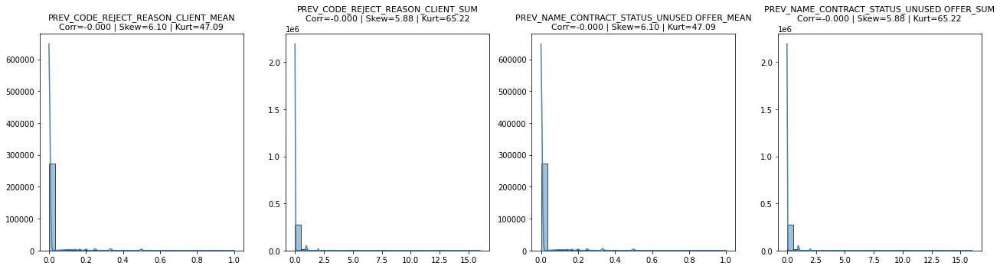

In [266]:
# Liste des transformations par groupe de corrélation

transfos = ['PREV_CODE_REJECT_REASON_CLIENT_MEAN', 'PREV_CODE_REJECT_REASON_CLIENT_SUM', 
            'PREV_NAME_CONTRACT_STATUS_UNUSED OFFER_MEAN', 'PREV_NAME_CONTRACT_STATUS_UNUSED OFFER_SUM']

plot_transformations_distributions(
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

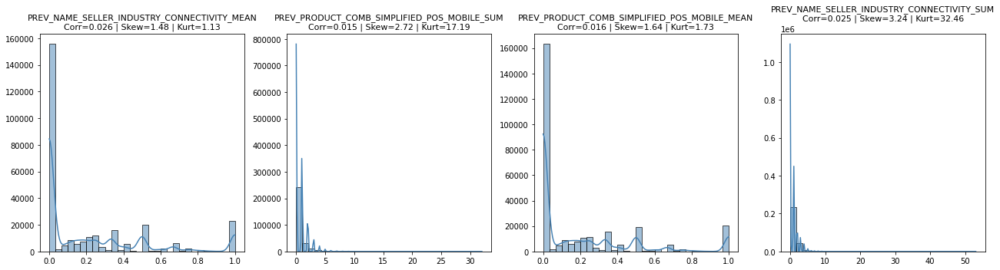

In [267]:
# Liste des transformations par groupe de corrélation

transfos = ['PREV_NAME_SELLER_INDUSTRY_CONNECTIVITY_MEAN', 'PREV_PRODUCT_COMB_SIMPLIFIED_POS_MOBILE_SUM', 
            'PREV_PRODUCT_COMB_SIMPLIFIED_POS_MOBILE_MEAN', 'PREV_NAME_SELLER_INDUSTRY_CONNECTIVITY_SUM']

plot_transformations_distributions(
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

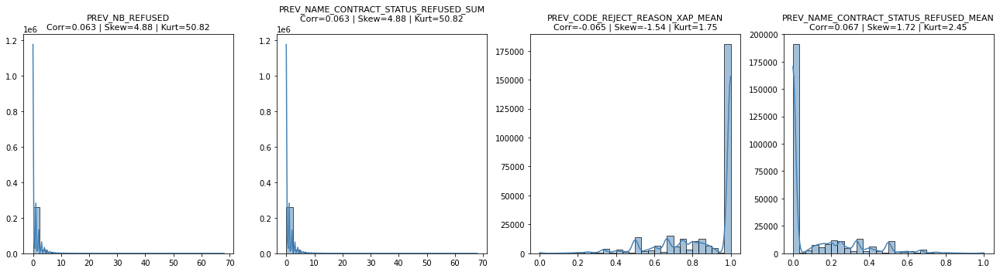

In [268]:
# Liste des transformations par groupe de corrélation

transfos = ['PREV_NB_REFUSED', 'PREV_NAME_CONTRACT_STATUS_REFUSED_SUM', 
            'PREV_CODE_REJECT_REASON_XAP_MEAN', 'PREV_NAME_CONTRACT_STATUS_REFUSED_MEAN']

plot_transformations_distributions(
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

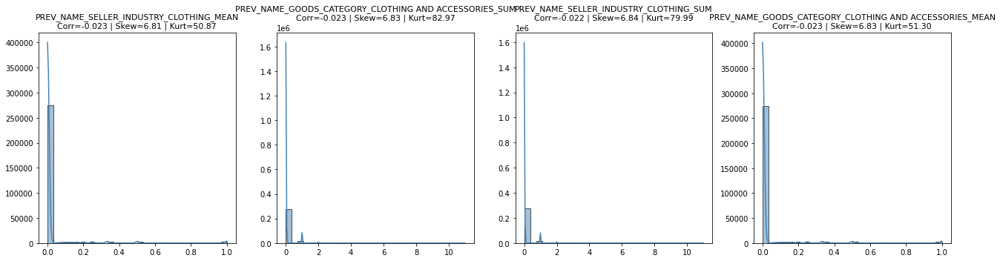

In [269]:
# Liste des transformations par groupe de corrélation

transfos = ['PREV_NAME_SELLER_INDUSTRY_CLOTHING_MEAN', 'PREV_NAME_GOODS_CATEGORY_CLOTHING AND ACCESSORIES_SUM', 
            'PREV_NAME_SELLER_INDUSTRY_CLOTHING_SUM', 'PREV_NAME_GOODS_CATEGORY_CLOTHING AND ACCESSORIES_MEAN']

plot_transformations_distributions(
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

c:\Users\Caomghin\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1076: RuntimeWarning:

overflow encountered in square



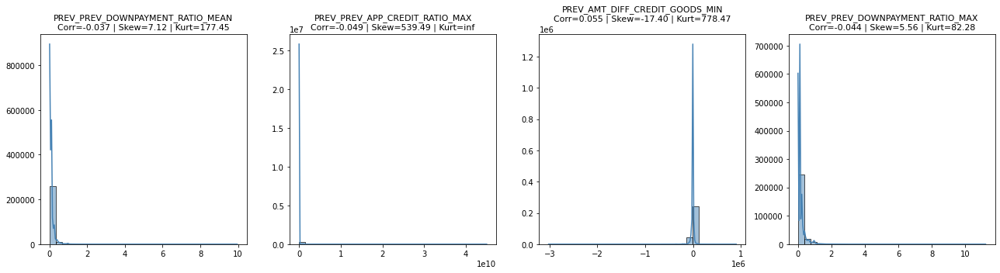

In [270]:
# Liste des transformations par groupe de corrélation

transfos = ['PREV_PREV_DOWNPAYMENT_RATIO_MEAN', 'PREV_PREV_APP_CREDIT_RATIO_MAX', 
            'PREV_AMT_DIFF_CREDIT_GOODS_MIN', 'PREV_PREV_DOWNPAYMENT_RATIO_MAX']

plot_transformations_distributions(
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

In [271]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

cols_to_drop = [
    'PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_MEAN', 'PREV_NAME_PORTFOLIO_CASH_MEAN', 'PREV_NAME_CASH_LOAN_PURPOSE_XAP_MEAN', 'PREV_SELLERPLACE_AREA_WAS_MISSING_MEAN', 
    'PREV_RATE_DOWN_PAYMENT_WAS_MISSING_MEAN', 'PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_SUM', 'PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_MEAN', 'PREV_NAME_GOODS_CATEGORY_XNA_SUM', 
    'PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_SUM', 'PREV_NAME_CONTRACT_TYPE_CASH LOANS_SUM', 'PREV_SELLERPLACE_AREA_WAS_MISSING_SUM', 'PREV_NAME_GOODS_CATEGORY_XNA_MEAN', 
    'PREV_NAME_SELLER_INDUSTRY_XNA_MEAN', 'PREV_NAME_PORTFOLIO_CASH_SUM', 'PREV_NAME_CONTRACT_TYPE_CASH LOANS_MEAN', 'PREV_NAME_SELLER_INDUSTRY_XNA_SUM', 
    'PREV_NAME_PORTFOLIO_POS_MEAN', 'PREV_AMT_DOWN_PAYMENT_WAS_MISSING_SUM', 'PREV_NAME_CONTRACT_TYPE_CONSUMER LOANS_MEAN', 
    'PREV_AMT_DOWN_PAYMENT_WAS_MISSING_MEAN',

    'PREV_DAYS_DECISION_MEAN', 'PREV_DAYS_LAST_DUE_MEAN', 'PREV_DAYS_TERMINATION_MEAN', 'PREV_DAYS_LAST_DUE_1ST_VERSION_MEAN', 
    'PREV_DAYS_LAST_DUE_MIN', 'PREV_DAYS_LAST_DUE_1ST_VERSION_MIN', 'PREV_DAYS_TERMINATION_MIN', 'PREV_DECISION_RECENCY_MEAN', 'PREV_DECISION_RECENCY_MAX', 
    'PREV_DAYS_DECISION_MIN', 'PREV_DAYS_FIRST_DUE_MEAN',

    'PREV_DAYS_FIRST_DUE_WAS_MISSING_MEAN', 'PREV_DAYS_LAST_DUE_WAS_MISSING_SUM', 'PREV_NFLAG_INSURED_ON_APPROVAL_WAS_MISSING_MEAN', 
    'PREV_DAYS_LAST_DUE_1ST_VERSION_WAS_MISSING_SUM', 'PREV_DAYS_TERMINATION_WAS_MISSING_SUM', 
    'PREV_NFLAG_INSURED_ON_APPROVAL_WAS_MISSING_SUM', 'PREV_DAYS_FIRST_DUE_WAS_MISSING_SUM', 

    'PREV_AMT_CREDIT_MEAN', 'PREV_AMT_CREDIT_MAX', 'PREV_AMT_APPLICATION_MAX',
    'PREV_AMT_CREDIT_SUM', 'PREV_AMT_GOODS_PRICE_MEAN', 'PREV_AMT_GOODS_PRICE_MAX',

    'PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_SUM', 'PREV_PRODUCT_COMB_SIMPLIFIED_MISSING_MEAN', 'PREV_PRODUCT_COMB_SIMPLIFIED_MISSING_SUM', 
    'PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_MEAN', 'PREV_NAME_CONTRACT_TYPE_XNA_MEAN', 

    'PREV_NAME_PORTFOLIO_XNA_SUM', 'PREV_AMT_ANNUITY_WAS_MISSING_MEAN', 'PREV_NAME_PORTFOLIO_XNA_MEAN', 
    'PREV_AMT_ANNUITY_WAS_MISSING_SUM', 'PREV_CNT_PAYMENT_WAS_MISSING_MEAN',

    'PREV_NAME_CLIENT_TYPE_REPEATER_SUM', 'PREV_CODE_REJECT_REASON_XAP_SUM', 'PREV_NAME_CLIENT_TYPE_REPEATER_MEAN',

    'PREV_NAME_PORTFOLIO_CARDS_SUM', 'PREV_NAME_PORTFOLIO_CARDS_MEAN', 'PREV_NAME_CONTRACT_TYPE_REVOLVING LOANS_MEAN',

    'PREV_PRODUCT_COMB_SIMPLIFIED_X_SELL_SUM', 'PREV_NAME_PRODUCT_TYPE_X-SELL_SUM', 'PREV_PRODUCT_COMB_SIMPLIFIED_X_SELL_MEAN',

    'PREV_CODE_REJECT_REASON_CLIENT_SUM', 'PREV_NAME_CONTRACT_STATUS_UNUSED OFFER_MEAN', 'PREV_NAME_CONTRACT_STATUS_UNUSED OFFER_SUM', 

    'PREV_PRODUCT_COMB_SIMPLIFIED_POS_MOBILE_SUM', 'PREV_PRODUCT_COMB_SIMPLIFIED_POS_MOBILE_MEAN', 'PREV_NAME_SELLER_INDUSTRY_CONNECTIVITY_SUM',

    'PREV_NB_REFUSED', 'PREV_NAME_CONTRACT_STATUS_REFUSED_SUM', 'PREV_CODE_REJECT_REASON_XAP_MEAN',

    'PREV_NAME_SELLER_INDUSTRY_CLOTHING_MEAN', 'PREV_NAME_GOODS_CATEGORY_CLOTHING AND ACCESSORIES_SUM', 'PREV_NAME_SELLER_INDUSTRY_CLOTHING_SUM',

    'PREV_PREV_DOWNPAYMENT_RATIO_MEAN', 'PREV_PREV_APP_CREDIT_RATIO_MAX', 'PREV_AMT_DIFF_CREDIT_GOODS_MIN',

    'PREV_DAYS_LAST_DUE_MAX', 'PREV_DAYS_TERMINATION_WAS_MISSING_MEAN', 'PREV_NAME_CONTRACT_STATUS_CANCELED_MEAN', 'PREV_PREV_CREDIT_PER_PAYMENT_MAX',

    'PREV_NAME_PORTFOLIO_CARS_MEAN', 'PREV_WEEKDAY_APPR_PROCESS_START_SUNDAY_SUM', 'PREV_PRODUCT_COMB_SIMPLIFIED_CASH_MEAN', 'PREV_NAME_CONTRACT_TYPE_CONSUMER LOANS_SUM',

    'PREV_NAME_GOODS_CATEGORY_CONSUMER ELECTRONICS_MEAN', 'PREV_NAME_PAYMENT_TYPE_CASH THROUGH THE BANK_MEAN', 'PREV_PRODUCT_COMB_SIMPLIFIED_POS_INDUSTRY_SUM', 'PREV_NAME_PRODUCT_TYPE_WALK-IN_MEAN',

    'PREV_NAME_TYPE_SUITE_FAMILY_SUM', 'PREV_WEEKDAY_APPR_PROCESS_START_THURSDAY_MEAN', 'PREV_AMT_GOODS_PRICE_WAS_MISSING_MEAN', 'PREV_WEEKDAY_APPR_PROCESS_START_MONDAY_MEAN',

    'PREV_CHANNEL_TYPE_STONE_SUM', 'PREV_NAME_GOODS_CATEGORY_AUDIO/VIDEO_MEAN', 'PREV_WEEKDAY_APPR_PROCESS_START_TUESDAY_MEAN', 'PREV_WEEKDAY_APPR_PROCESS_START_WEDNESDAY_MEAN',

    'PREV_WEEKDAY_APPR_PROCESS_START_FRIDAY_MEAN', 'PREV_WEEKDAY_APPR_PROCESS_START_SATURDAY_SUM', 'PREV_NAME_GOODS_CATEGORY_MOBILE_SUM', 'PREV_PREV_FIRST_DUE_DELAY_MAX',

    'PREV_NAME_SELLER_INDUSTRY_CONSUMER ELECTRONICS_MEAN', 'PREV_NAME_SELLER_INDUSTRY_CONSUMER ELECTRONICS_SUM', 'PREV_AMT_DOWN_PAYMENT_MEAN', 'PREV_AMT_REMAINING_AFTER_DOWNPAY_MEAN',

    'PREV_NAME_YIELD_GROUP_XNA_SUM', 'PREV_NAME_GOODS_CATEGORY_COMPUTERS_SUM', 'PREV_PRODUCT_COMB_SIMPLIFIED_CARD_MEAN', 'PREV_NAME_CLIENT_TYPE_REFRESHED_SUM',

    'PREV_NAME_SELLER_INDUSTRY_OTHER_SELLERS_MEAN', 'PREV_NAME_GOODS_CATEGORY_CONSTRUCTION MATERIALS_SUM', 'PREV_NAME_SELLER_INDUSTRY_INDUSTRY_SUM', 'PREV_NAME_CASH_LOAN_PURPOSE_REPAIRS_MEAN',

    'PREV_NAME_TYPE_SUITE_OTHER_B_SUM', 'PREV_NAME_TYPE_SUITE_OTHER_A_SUM', 'PREV_CODE_REJECT_REASON_SCOFR_MEAN', 'PREV_NAME_PAYMENT_TYPE_NON-CASH FROM YOUR ACCOUNT_SUM',

    'PREV_NAME_GOODS_CATEGORY_PHOTO / CINEMA EQUIPMENT_MEAN', 'PREV_CODE_REJECT_REASON_XNA_MEAN', 'PREV_CHANNEL_TYPE_OTHER_CHANNELS_SUM', 'PREV_CODE_REJECT_REASON_VERIF_MEAN',

    'PREV_NAME_TYPE_SUITE_GROUP OF PEOPLE_MEAN', 'PREV_NAME_CLIENT_TYPE_XNA_MEAN', 'PREV_NAME_PAYMENT_TYPE_CASHLESS FROM THE ACCOUNT OF THE EMPLOYER_MEAN', 'PREV_PRODUCT_COMB_SIMPLIFIED_POS_OTHERS_SUM',

    'PREV_PRODUCT_COMB_SIMPLIFIED_POS_OTHERS_SUM', 'PREV_CODE_REJECT_REASON_SCO_MEAN', 'PREV_CHANNEL_TYPE_REGIONAL / LOCAL_MEAN', 'PREV_NAME_SELLER_INDUSTRY_FURNITURE_SUM',

    'PREV_CODE_REJECT_REASON_SYSTEM_MEAN', 'PREV_NAME_YIELD_GROUP_LOW_ACTION_SUM', 'PREV_PREV_LAST_DUE_DELAY_MAX', 'PREV_CODE_REJECT_REASON_HC_SUM',

    'PREV_PREV_LAST_DUE_DELAY_MEAN', 'PREV_NAME_TYPE_SUITE_SPOUSE, PARTNER_SUM', 'PREV_CHANNEL_TYPE_CONTACT CENTER_MEAN', 'PREV_CHANNEL_TYPE_AP+ (CASH LOAN)_SUM',

    'PREV_NAME_GOODS_CATEGORY_FURNITURE_SUM', 'PREV_NAME_GOODS_CATEGORY_OTHER_GOODS_SUM', 'PREV_CODE_REJECT_REASON_LIMIT_MEAN', 'PREV_NAME_CASH_LOAN_PURPOSE_OTHER_PURPOSE_MEAN',

    'PREV_NAME_TYPE_SUITE_CHILDREN_MEAN', 'PREV_NAME_SELLER_INDUSTRY_CONSTRUCTION_SUM', 'PREV_AMT_ANNUITY_MEAN'

]

df_train_nan_missing.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [272]:
remaining_cols = list(set(df_previous_train_nan_missing_agg.columns).intersection(df_train_nan_missing.columns))

In [273]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_train_nan_missing[remaining_cols], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation


In [274]:
# Réduction de la taille du dataframe.

optimize_types(df_train_nan_missing)

 Mémoire avant : 867.44 MB
 Mémoire après : 726.97 MB
 Gain : 16.2%


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_ANNUITY,AMT_GOODS_PRICE,...,PREV_DAYS_DECISION_WAS_MISSING_SUM,PREV_CNT_PAYMENT_WAS_MISSING_SUM,PREV_DAYS_LAST_DUE_1ST_VERSION_WAS_MISSING_MEAN,PREV_DAYS_LAST_DUE_WAS_MISSING_MEAN,PREV_PRODUCT_HAS_INTEREST_WAS_MISSING_MEAN,PREV_PRODUCT_HAS_INTEREST_WAS_MISSING_SUM,PREV_FLAG_LAST_APPL_PER_CONTRACT_WAS_MISSING_MEAN,PREV_FLAG_LAST_APPL_PER_CONTRACT_WAS_MISSING_SUM,PREV_NB_APPLICATIONS,PREV_PCT_APPROVED
0,100002,1,0,1,0,1,0,202500.0,24700.5,351000.0,...,0,0,1.000000,0.000000,0,0,0,0,1,1
1,100003,0,0,0,0,0,0,270000.0,35698.5,1129500.0,...,0,0,0.000000,0.000000,0,0,0,0,3,3
2,100004,0,1,1,1,1,0,67500.0,6750.0,135000.0,...,0,0,0.000000,0.000000,0,0,0,0,1,1
3,100006,0,0,0,0,1,0,135000.0,29686.5,297000.0,...,0,3,0.888889,0.777778,0,0,0,0,9,5
4,100007,0,0,1,0,1,0,121500.0,21865.5,513000.0,...,0,0,0.333333,0.333333,0,0,0,0,6,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307495,456251,0,0,1,0,0,0,157500.0,27558.0,225000.0,...,0,0,0.000000,0.000000,0,0,0,0,1,1
307496,456252,0,0,0,0,1,0,72000.0,12001.5,225000.0,...,0,0,0.000000,0.000000,0,0,0,0,1,1
307497,456253,0,0,0,0,1,0,153000.0,29979.0,585000.0,...,0,0,0.000000,0.000000,0,0,0,0,2,2
307498,456254,1,0,0,0,1,0,171000.0,20205.0,319500.0,...,0,0,1.000000,1.000000,0,0,0,0,2,2


- Ensuite on réitère les même modifications des dataframes train sur les dataframes test.

#### Corrélation des variables - df_test_median_mode_linear

In [275]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

cols_to_drop = [
    'PREV_NAME_PORTFOLIO_XNA_SUM', 'PREV_NAME_GOODS_CATEGORY_XNA_SUM', 'PREV_NAME_CONTRACT_STATUS_CANCELED_SUM', 
    'PREV_PRODUCT_COMB_SIMPLIFIED_X_SELL_SUM', 'PREV_NAME_PORTFOLIO_CASH_SUM', 'PREV_IS_DOWNPAYMENT_SUM',
    'PREV_NAME_TYPE_SUITE_UNACCOMPANIED_SUM', 'PREV_IS_CREDIT_OVER_GOODS_SUM', 'PREV_NAME_CLIENT_TYPE_REPEATER_SUM',
    'PREV_NB_APPLICATIONS', 'PREV_CODE_REJECT_REASON_XAP_SUM', 'PREV_NAME_PRODUCT_TYPE_X-SELL_SUM', 'PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_SUM',
    'PREV_NAME_SELLER_INDUSTRY_XNA_SUM', 'PREV_PREV_IS_RECENT_SUM', 'PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_SUM', 
    'PREV_PRODUCT_COMB_SIMPLIFIED_CASH_SUM',

    'PREV_DAYS_TERMINATION_MEAN', 'PREV_DAYS_LAST_DUE_1ST_VERSION_MIN', 'PREV_DAYS_LAST_DUE_1ST_VERSION_MEAN', 
    'PREV_DAYS_TERMINATION_MIN', 'PREV_DECISION_RECENCY_MAX', 'PREV_DECISION_RECENCY_MEAN',
    'PREV_DAYS_DECISION_MEAN', 'PREV_DAYS_LAST_DUE_MIN', 'PREV_DAYS_FIRST_DUE_MIN', 'PREV_DAYS_FIRST_DUE_MEAN', 'PREV_DAYS_LAST_DUE_MEAN',

    'PREV_AMT_APPLICATION_MAX', 'PREV_AMT_REMAINING_AFTER_DOWNPAY_MEAN', 'PREV_AMT_CREDIT_MAX', 
    'PREV_AMT_REMAINING_AFTER_DOWNPAY_MAX', 'PREV_AMT_CREDIT_MEAN', 'PREV_AMT_ANNUITY_MEAN', 'PREV_AMT_GOODS_PRICE_MEAN', 
    'PREV_AMT_APPLICATION_MEAN', 'PREV_AMT_GOODS_PRICE_MAX',

    'PREV_AMT_DIFF_CREDIT_GOODS_MIN', 'PREV_PREV_DOWNPAYMENT_RATIO_MEAN', 'PREV_PREV_DOWNPAYMENT_RATIO_MAX', 'PREV_PREV_ANNUITY_CREDIT_RATIO_MAX', 
    'PREV_NAME_CONTRACT_STATUS_CANCELED_MEAN', 'PREV_PREV_ANNUITY_CREDIT_RATIO_MEAN',

    'PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_MEAN', 'PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_MEAN', 
    'PREV_NAME_SELLER_INDUSTRY_XNA_MEAN', 

    'PREV_CODE_REJECT_REASON_HC_SUM', 'PREV_NAME_CONTRACT_STATUS_REFUSED_SUM',

    'PREV_NAME_CASH_LOAN_PURPOSE_XAP_MEAN', 'PREV_NAME_CONTRACT_TYPE_CONSUMER LOANS_MEAN',

    'PREV_NAME_CONTRACT_TYPE_CONSUMER LOANS_SUM', 'PREV_NAME_CASH_LOAN_PURPOSE_XAP_SUM',

    'PREV_DAYS_LAST_DUE_MAX', 'PREV_DAYS_TERMINATION_MAX',

    'PREV_NAME_GOODS_CATEGORY_MOBILE_MEAN', 'PREV_PRODUCT_COMB_SIMPLIFIED_POS_MOBILE_MEAN',

    'PREV_PRODUCT_COMB_SIMPLIFIED_POS_MOBILE_SUM', 'PREV_NAME_GOODS_CATEGORY_MOBILE_SUM',

    'PREV_PRODUCT_COMB_SIMPLIFIED_CARD_MEAN', 'PREV_CODE_REJECT_REASON_SYSTEM_SUM',

    'PREV_PREV_CREDIT_PER_PAYMENT_MEAN', 'PREV_PREV_APP_CREDIT_RATIO_MEAN', 'PREV_PREV_APP_CREDIT_RATIO_MAX',

    'PREV_NAME_CONTRACT_TYPE_XNA_MEAN', 'PREV_CODE_REJECT_REASON_XNA_SUM', 'PREV_PREV_DURATION_ESTIMATED_MEAN', 'PREV_NAME_CONTRACT_STATUS_UNUSED OFFER_SUM',

    'PREV_AMT_REMAINING_AFTER_DOWNPAY_MIN', 'PREV_PREV_DURATION_ESTIMATED_MAX', 'PREV_PRODUCT_COMB_SIMPLIFIED_CARD_SUM',

    'PREV_DAYS_FIRST_DUE_MAX', 'PREV_NAME_SELLER_INDUSTRY_FURNITURE_SUM', 'PREV_NAME_GOODS_CATEGORY_FURNITURE_MEAN',

    'PREV_NAME_SELLER_INDUSTRY_CONSUMER ELECTRONICS_SUM', 'PREV_PRODUCT_COMB_SIMPLIFIED_X_SELL_MEAN',

    'PREV_NAME_SELLER_INDUSTRY_CONSUMER ELECTRONICS_MEAN', 'PREV_NAME_PORTFOLIO_CARS_MEAN'
]

df_test_median_mode_linear.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [276]:
remaining_cols = list(set(df_previous_test_median_mode_linear_agg.columns).intersection(df_test_median_mode_linear.columns))

In [277]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_test_median_mode_linear[remaining_cols], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,PREV_NAME_GOODS_CATEGORY_XNA_MEAN / PREV_NAME_PORTFOLIO_POS_MEAN,PREV_NAME_GOODS_CATEGORY_XNA_MEAN,PREV_NAME_PORTFOLIO_POS_MEAN,-0.897724
1,PREV_PREV_CREDIT_GOODS_RATIO_MAX / PREV_PREV_CREDIT_GOODS_RATIO_MEAN,PREV_PREV_CREDIT_GOODS_RATIO_MEAN,PREV_PREV_CREDIT_GOODS_RATIO_MAX,0.828330
2,PREV_CODE_REJECT_REASON_VERIF_MEAN / PREV_CODE_REJECT_REASON_VERIF_SUM,PREV_CODE_REJECT_REASON_VERIF_SUM,PREV_CODE_REJECT_REASON_VERIF_MEAN,0.817575
3,PREV_PREV_FIRST_DUE_DELAY_MEAN / PREV_PREV_LAST_DUE_DELAY_MEAN,PREV_PREV_FIRST_DUE_DELAY_MEAN,PREV_PREV_LAST_DUE_DELAY_MEAN,0.809572


In [278]:
# Réduction de la taille du dataframe.

optimize_types(df_test_median_mode_linear)

 Mémoire avant : 94.37 MB
 Mémoire après : 71.13 MB
 Gain : 24.6%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_ANNUITY,REGION_POPULATION_RELATIVE,OWN_CAR_AGE,FLAG_MOBIL,FLAG_WORK_PHONE,...,PREV_NAME_YIELD_GROUP_MIDDLE_MEAN,PREV_NAME_YIELD_GROUP_MIDDLE_SUM,PREV_PRODUCT_COMB_SIMPLIFIED_CASH_MEAN,PREV_PRODUCT_COMB_SIMPLIFIED_POS_HOUSEHOLD_MEAN,PREV_PRODUCT_COMB_SIMPLIFIED_POS_HOUSEHOLD_SUM,PREV_PRODUCT_COMB_SIMPLIFIED_POS_INDUSTRY_MEAN,PREV_PRODUCT_COMB_SIMPLIFIED_POS_INDUSTRY_SUM,PREV_PRODUCT_COMB_SIMPLIFIED_POS_OTHERS_MEAN,PREV_PRODUCT_COMB_SIMPLIFIED_POS_OTHERS_SUM,PREV_NB_REFUSED
0,100001,0,0,0,1,20560.5,0.018850,9,1,0,...,0.0,0,0.00,0.000,0,0.0,0,0.0,0,0
1,100005,0,1,0,1,17370.0,0.035792,9,1,0,...,0.0,0,0.50,0.000,0,0.0,0,0.0,0,0
2,100013,0,1,1,1,69777.0,0.019101,5,1,0,...,0.5,2,0.25,0.250,1,0.0,0,0.0,0,0
3,100028,0,0,0,1,49018.5,0.026392,9,1,0,...,0.2,1,0.20,0.400,2,0.0,0,0.0,0,0
4,100038,0,1,1,0,32067.0,0.010032,16,1,1,...,0.5,1,0.00,0.000,0,0.0,0,0.0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,0,0,0,1,17473.5,0.002042,9,1,1,...,0.0,0,1.00,0.000,0,0.0,0,0.0,0,0
48740,456222,0,0,0,0,31909.5,0.035792,9,1,0,...,0.0,0,0.00,0.500,2,0.0,0,0.0,0,0
48741,456223,0,0,1,1,33205.5,0.026392,4,1,0,...,0.5,1,0.00,0.000,0,0.5,1,0.0,0,0
48742,456224,0,1,0,0,25128.0,0.018850,9,1,1,...,0.0,0,0.20,0.000,0,0.2,1,0.0,0,2


In [279]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_median_mode_linear.columns)
cols_test = set(df_test_median_mode_linear.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)

Colonnes dans train mais pas dans test : {'TARGET'}
Colonnes dans test mais pas dans train : set()


#### Corrélation des variables - df_test_median_missing_linear

In [280]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

cols_to_drop = [
    'PREV_IS_DOWNPAYMENT_SUM', 'PREV_PRODUCT_COMB_SIMPLIFIED_CASH_SUM', 'PREV_NAME_SELLER_INDUSTRY_XNA_SUM', 
    'PREV_NAME_PORTFOLIO_CASH_SUM', 'PREV_NAME_CLIENT_TYPE_REPEATER_SUM', 'PREV_PRODUCT_COMB_SIMPLIFIED_X_SELL_SUM',
    'PREV_NAME_TYPE_SUITE_MISSING_SUM', 'PREV_IS_CREDIT_OVER_GOODS_SUM', 'PREV_NAME_PRODUCT_TYPE_X-SELL_SUM',
    'PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_SUM', 'PREV_NAME_CONTRACT_STATUS_CANCELED_SUM', 'PREV_NAME_GOODS_CATEGORY_XNA_SUM', 'PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_SUM',
    'PREV_PREV_IS_RECENT_SUM', 'PREV_NB_APPLICATIONS', 'PREV_CODE_REJECT_REASON_XAP_SUM', 
    'PREV_NAME_PORTFOLIO_XNA_SUM',

    'PREV_DAYS_TERMINATION_MEAN', 'PREV_DAYS_LAST_DUE_1ST_VERSION_MIN', 'PREV_DAYS_LAST_DUE_1ST_VERSION_MEAN', 
    'PREV_DAYS_TERMINATION_MIN', 'PREV_DECISION_RECENCY_MAX', 'PREV_DECISION_RECENCY_MEAN',
    'PREV_DAYS_DECISION_MEAN', 'PREV_DAYS_LAST_DUE_MIN', 'PREV_DAYS_FIRST_DUE_MIN', 'PREV_DAYS_FIRST_DUE_MEAN', 'PREV_DAYS_LAST_DUE_MEAN',

    'PREV_AMT_APPLICATION_MAX', 'PREV_AMT_REMAINING_AFTER_DOWNPAY_MEAN', 'PREV_AMT_CREDIT_MAX', 
    'PREV_AMT_REMAINING_AFTER_DOWNPAY_MAX', 'PREV_AMT_CREDIT_MEAN', 'PREV_AMT_ANNUITY_MEAN', 'PREV_AMT_GOODS_PRICE_MEAN', 
    'PREV_AMT_APPLICATION_MEAN', 'PREV_AMT_GOODS_PRICE_MAX',

    'PREV_AMT_DIFF_CREDIT_GOODS_MIN', 'PREV_PREV_DOWNPAYMENT_RATIO_MEAN', 'PREV_PREV_DOWNPAYMENT_RATIO_MAX', 'PREV_PREV_ANNUITY_CREDIT_RATIO_MAX', 
    'PREV_NAME_CONTRACT_STATUS_CANCELED_MEAN', 'PREV_PREV_ANNUITY_CREDIT_RATIO_MEAN',

    'PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_MEAN', 'PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_MEAN', 
    'PREV_NAME_SELLER_INDUSTRY_XNA_MEAN', 

    'PREV_CODE_REJECT_REASON_HC_SUM', 'PREV_NAME_CONTRACT_STATUS_REFUSED_SUM',

    'PREV_NAME_CASH_LOAN_PURPOSE_XAP_MEAN', 'PREV_NAME_CONTRACT_TYPE_CONSUMER LOANS_MEAN',

    'PREV_NAME_CONTRACT_TYPE_CONSUMER LOANS_SUM', 'PREV_NAME_CASH_LOAN_PURPOSE_XAP_SUM',

    'PREV_DAYS_LAST_DUE_MAX', 'PREV_DAYS_TERMINATION_MAX',

    'PREV_NAME_GOODS_CATEGORY_MOBILE_MEAN', 'PREV_PRODUCT_COMB_SIMPLIFIED_POS_MOBILE_MEAN',

    'PREV_PRODUCT_COMB_SIMPLIFIED_POS_MOBILE_SUM', 'PREV_NAME_GOODS_CATEGORY_MOBILE_SUM',

    'PREV_PRODUCT_COMB_SIMPLIFIED_CARD_MEAN', 'PREV_CODE_REJECT_REASON_SYSTEM_SUM',

    'PREV_PREV_CREDIT_PER_PAYMENT_MEAN', 'PREV_PREV_APP_CREDIT_RATIO_MEAN', 'PREV_PREV_APP_CREDIT_RATIO_MAX',

    'PREV_NAME_CONTRACT_TYPE_XNA_MEAN', 'PREV_CODE_REJECT_REASON_XNA_SUM', 'PREV_PREV_DURATION_ESTIMATED_MEAN', 'PREV_NAME_CONTRACT_STATUS_UNUSED OFFER_SUM',

    'PREV_AMT_REMAINING_AFTER_DOWNPAY_MIN', 'PREV_PREV_DURATION_ESTIMATED_MAX', 'PREV_PRODUCT_COMB_SIMPLIFIED_CARD_SUM',

    'PREV_DAYS_FIRST_DUE_MAX', 'PREV_NAME_SELLER_INDUSTRY_FURNITURE_SUM', 'PREV_NAME_GOODS_CATEGORY_FURNITURE_MEAN',

    'PREV_NAME_SELLER_INDUSTRY_CONSUMER ELECTRONICS_SUM', 'PREV_PRODUCT_COMB_SIMPLIFIED_X_SELL_MEAN',

    'PREV_NAME_SELLER_INDUSTRY_CONSUMER ELECTRONICS_MEAN', 'PREV_NAME_PORTFOLIO_CARS_MEAN', 'PREV_NAME_TYPE_SUITE_MISSING_SUM'
]

df_test_median_missing_linear.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [281]:
remaining_cols = list(set(df_previous_test_median_missing_linear_agg.columns).intersection(df_test_median_missing_linear.columns))

In [282]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_test_median_missing_linear[remaining_cols], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,PREV_NAME_GOODS_CATEGORY_XNA_MEAN / PREV_NAME_PORTFOLIO_POS_MEAN,PREV_NAME_GOODS_CATEGORY_XNA_MEAN,PREV_NAME_PORTFOLIO_POS_MEAN,-0.897724
1,PREV_PREV_CREDIT_GOODS_RATIO_MAX / PREV_PREV_CREDIT_GOODS_RATIO_MEAN,PREV_PREV_CREDIT_GOODS_RATIO_MEAN,PREV_PREV_CREDIT_GOODS_RATIO_MAX,0.828330
2,PREV_CODE_REJECT_REASON_VERIF_MEAN / PREV_CODE_REJECT_REASON_VERIF_SUM,PREV_CODE_REJECT_REASON_VERIF_SUM,PREV_CODE_REJECT_REASON_VERIF_MEAN,0.817575
3,PREV_PREV_FIRST_DUE_DELAY_MEAN / PREV_PREV_LAST_DUE_DELAY_MEAN,PREV_PREV_FIRST_DUE_DELAY_MEAN,PREV_PREV_LAST_DUE_DELAY_MEAN,0.809572


In [283]:
# Réduction de la taille du dataframe.

optimize_types(df_test_median_missing_linear)

 Mémoire avant : 95.10 MB
 Mémoire après : 71.86 MB
 Gain : 24.4%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_ANNUITY,REGION_POPULATION_RELATIVE,OWN_CAR_AGE,FLAG_MOBIL,FLAG_WORK_PHONE,...,PREV_NAME_YIELD_GROUP_MIDDLE_MEAN,PREV_NAME_YIELD_GROUP_MIDDLE_SUM,PREV_PRODUCT_COMB_SIMPLIFIED_CASH_MEAN,PREV_PRODUCT_COMB_SIMPLIFIED_POS_HOUSEHOLD_MEAN,PREV_PRODUCT_COMB_SIMPLIFIED_POS_HOUSEHOLD_SUM,PREV_PRODUCT_COMB_SIMPLIFIED_POS_INDUSTRY_MEAN,PREV_PRODUCT_COMB_SIMPLIFIED_POS_INDUSTRY_SUM,PREV_PRODUCT_COMB_SIMPLIFIED_POS_OTHERS_MEAN,PREV_PRODUCT_COMB_SIMPLIFIED_POS_OTHERS_SUM,PREV_NB_REFUSED
0,100001,0,0,0,1,20560.5,0.018850,9,1,0,...,0.0,0,0.00,0.000,0,0.0,0,0.0,0,0
1,100005,0,1,0,1,17370.0,0.035792,9,1,0,...,0.0,0,0.50,0.000,0,0.0,0,0.0,0,0
2,100013,0,1,1,1,69777.0,0.019101,5,1,0,...,0.5,2,0.25,0.250,1,0.0,0,0.0,0,0
3,100028,0,0,0,1,49018.5,0.026392,9,1,0,...,0.2,1,0.20,0.400,2,0.0,0,0.0,0,0
4,100038,0,1,1,0,32067.0,0.010032,16,1,1,...,0.5,1,0.00,0.000,0,0.0,0,0.0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,0,0,0,1,17473.5,0.002042,9,1,1,...,0.0,0,1.00,0.000,0,0.0,0,0.0,0,0
48740,456222,0,0,0,0,31909.5,0.035792,9,1,0,...,0.0,0,0.00,0.500,2,0.0,0,0.0,0,0
48741,456223,0,0,1,1,33205.5,0.026392,4,1,0,...,0.5,1,0.00,0.000,0,0.5,1,0.0,0,0
48742,456224,0,1,0,0,25128.0,0.018850,9,1,1,...,0.0,0,0.20,0.000,0,0.2,1,0.0,0,2


In [284]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_median_missing_linear.columns)
cols_test = set(df_test_median_missing_linear.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)

Colonnes dans train mais pas dans test : {'TARGET'}
Colonnes dans test mais pas dans train : set()


#### Corrélation des variables - df_test_iterative_mode_linear

In [285]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

cols_to_drop = [
    'PREV_PRODUCT_COMB_SIMPLIFIED_CASH_SUM', 'PREV_NAME_TYPE_SUITE_UNACCOMPANIED_SUM', 'PREV_NAME_SELLER_INDUSTRY_XNA_SUM', 
    'PREV_NAME_PORTFOLIO_CASH_SUM', 'PREV_NAME_CLIENT_TYPE_REPEATER_SUM', 'PREV_PRODUCT_COMB_SIMPLIFIED_X_SELL_SUM',
    'PREV_IS_CREDIT_OVER_GOODS_SUM', 'PREV_NAME_PRODUCT_TYPE_X-SELL_SUM', 'PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_SUM',
    'PREV_NAME_CONTRACT_STATUS_CANCELED_SUM', 'PREV_NAME_GOODS_CATEGORY_XNA_SUM', 'PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_SUM', 'PREV_PREV_IS_RECENT_SUM',
    'PREV_NB_APPLICATIONS', 'PREV_CODE_REJECT_REASON_XAP_SUM', 'PREV_NAME_PORTFOLIO_XNA_SUM',

    'PREV_AMT_GOODS_PRICE_MAX', 'PREV_AMT_APPLICATION_MAX', 'PREV_AMT_ANNUITY_MAX', 'PREV_AMT_CREDIT_MAX', 'PREV_AMT_CREDIT_MEAN', 
    'PREV_AMT_GOODS_PRICE_MEAN', 'PREV_AMT_APPLICATION_MEAN',

    'PREV_PREV_LAST_DUE_DELAY_MAX', 'PREV_DAYS_LAST_DUE_1ST_VERSION_MAX', 'PREV_PREV_DURATION_FIRST_VERSION_MAX', 'PREV_PREV_DURATION_ESTIMATED_MAX', 
    'PREV_DAYS_TERMINATION_MAX', 'PREV_AMT_REMAINING_AFTER_DOWNPAY_MAX',

    'PREV_DAYS_DECISION_MEAN', 'PREV_DAYS_TERMINATION_MEAN', 'PREV_DAYS_LAST_DUE_MEAN', 
    'PREV_DAYS_LAST_DUE_1ST_VERSION_MEAN', 'PREV_DECISION_RECENCY_MEAN',

    'PREV_DAYS_LAST_DUE_1ST_VERSION_MIN', 'PREV_DECISION_RECENCY_MAX', 'PREV_DAYS_DECISION_MIN', 'PREV_DAYS_LAST_DUE_MIN', 'PREV_DAYS_TERMINATION_MIN',

    'PREV_PREV_DOWNPAYMENT_RATIO_MEAN', 'PREV_NAME_CONTRACT_STATUS_CANCELED_MEAN', 'PREV_PREV_ANNUITY_CREDIT_RATIO_MAX', 'PREV_PREV_ANNUITY_CREDIT_RATIO_MEAN', 

    'PREV_NAME_SELLER_INDUSTRY_XNA_MEAN', 'PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_MEAN', 
    'PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_MEAN',

    'PREV_PREV_DURATION_FIRST_VERSION_MEAN', 'PREV_AMT_DOWN_PAYMENT_MEAN', 'PREV_AMT_DOWN_PAYMENT_SUM',

    'PREV_NAME_CONTRACT_TYPE_CONSUMER LOANS_MEAN', 'PREV_NAME_CASH_LOAN_PURPOSE_XAP_MEAN',

    'PREV_NAME_CONTRACT_TYPE_CONSUMER LOANS_SUM', 'PREV_NAME_CASH_LOAN_PURPOSE_XAP_SUM',

    'PREV_CODE_REJECT_REASON_HC_SUM', 'PREV_NAME_CONTRACT_STATUS_REFUSED_SUM',

    'PREV_NAME_GOODS_CATEGORY_MOBILE_MEAN', 'PREV_PRODUCT_COMB_SIMPLIFIED_POS_MOBILE_MEAN',

    'PREV_NAME_GOODS_CATEGORY_MOBILE_SUM', 'PREV_PRODUCT_COMB_SIMPLIFIED_POS_MOBILE_SUM',

    'PREV_CODE_REJECT_REASON_XNA_MEAN', 'PREV_NAME_CONTRACT_TYPE_XNA_MEAN',

    'PREV_PREV_CREDIT_PER_PAYMENT_MEAN', 'PREV_AMT_DIFF_CREDIT_GOODS_MAX',

    'PREV_NAME_CONTRACT_STATUS_UNUSED OFFER_MEAN', 'PREV_CODE_REJECT_REASON_SYSTEM_MEAN',

    'PREV_NAME_CONTRACT_TYPE_REVOLVING LOANS_MEAN', 'PREV_PREV_APP_CREDIT_RATIO_MAX',

    'PREV_NAME_CONTRACT_TYPE_REVOLVING LOANS_SUM', 'PREV_NAME_SELLER_INDUSTRY_FURNITURE_SUM',

    'PREV_NAME_SELLER_INDUSTRY_FURNITURE_MEAN', 'PREV_NAME_SELLER_INDUSTRY_CONSUMER ELECTRONICS_SUM',

    'PREV_PRODUCT_COMB_SIMPLIFIED_X_SELL_MEAN', 'PREV_NAME_SELLER_INDUSTRY_CONSUMER ELECTRONICS_MEAN',

    'PREV_PREV_LAST_DUE_DELAY_MEAN', 'PREV_DAYS_DECISION_MAX', 'PREV_NAME_PORTFOLIO_CARS_MEAN'

]

df_test_iterative_mode_linear.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [286]:
remaining_cols = list(set(df_previous_test_iterative_mode_linear_agg.columns).intersection(df_test_iterative_mode_linear.columns))

In [287]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_test_iterative_mode_linear[remaining_cols], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,PREV_AMT_APPLICATION_MIN / PREV_AMT_REMAINING_AFTER_DOWNPAY_MIN,PREV_AMT_APPLICATION_MIN,PREV_AMT_REMAINING_AFTER_DOWNPAY_MIN,0.933442
1,PREV_PREV_APP_CREDIT_RATIO_MEAN / PREV_PREV_APP_GOODS_RATIO_MEAN,PREV_PREV_APP_GOODS_RATIO_MEAN,PREV_PREV_APP_CREDIT_RATIO_MEAN,0.898384
2,PREV_NAME_GOODS_CATEGORY_XNA_MEAN / PREV_NAME_PORTFOLIO_POS_MEAN,PREV_NAME_GOODS_CATEGORY_XNA_MEAN,PREV_NAME_PORTFOLIO_POS_MEAN,-0.897724
3,PREV_DAYS_FIRST_DUE_MAX / PREV_DAYS_LAST_DUE_MAX,PREV_DAYS_LAST_DUE_MAX,PREV_DAYS_FIRST_DUE_MAX,0.896929
4,PREV_IS_DOWNPAYMENT_SUM / PREV_NAME_PAYMENT_TYPE_XNA_SUM,PREV_NAME_PAYMENT_TYPE_XNA_SUM,PREV_IS_DOWNPAYMENT_SUM,0.845248
5,PREV_PREV_CREDIT_GOODS_RATIO_MAX / PREV_PREV_CREDIT_GOODS_RATIO_MEAN,PREV_PREV_CREDIT_GOODS_RATIO_MEAN,PREV_PREV_CREDIT_GOODS_RATIO_MAX,0.828330
6,PREV_CODE_REJECT_REASON_VERIF_MEAN / PREV_CODE_REJECT_REASON_VERIF_SUM,PREV_CODE_REJECT_REASON_VERIF_SUM,PREV_CODE_REJECT_REASON_VERIF_MEAN,0.817575


In [288]:
# Réduction de la taille du dataframe.

optimize_types(df_test_iterative_mode_linear)

 Mémoire avant : 94.56 MB
 Mémoire après : 72.62 MB
 Gain : 23.2%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_ANNUITY,REGION_POPULATION_RELATIVE,OWN_CAR_AGE,FLAG_MOBIL,FLAG_WORK_PHONE,...,PREV_PRODUCT_COMB_SIMPLIFIED_CARD_MEAN,PREV_PRODUCT_COMB_SIMPLIFIED_CARD_SUM,PREV_PRODUCT_COMB_SIMPLIFIED_CASH_MEAN,PREV_PRODUCT_COMB_SIMPLIFIED_POS_HOUSEHOLD_MEAN,PREV_PRODUCT_COMB_SIMPLIFIED_POS_HOUSEHOLD_SUM,PREV_PRODUCT_COMB_SIMPLIFIED_POS_INDUSTRY_MEAN,PREV_PRODUCT_COMB_SIMPLIFIED_POS_INDUSTRY_SUM,PREV_PRODUCT_COMB_SIMPLIFIED_POS_OTHERS_MEAN,PREV_PRODUCT_COMB_SIMPLIFIED_POS_OTHERS_SUM,PREV_NB_REFUSED
0,100001,0,0,0,1,20560.5,0.018850,11.898975,1,0,...,0.000,0,0.00,0.000,0,0.0,0,0.0,0,0
1,100005,0,1,0,1,17370.0,0.035792,14.375872,1,0,...,0.000,0,0.50,0.000,0,0.0,0,0.0,0,0
2,100013,0,1,1,1,69777.0,0.019101,5.000000,1,0,...,0.000,0,0.25,0.250,1,0.0,0,0.0,0,0
3,100028,0,0,0,1,49018.5,0.026392,7.500616,1,0,...,0.000,0,0.20,0.400,2,0.0,0,0.0,0,0
4,100038,0,1,1,0,32067.0,0.010032,16.000000,1,1,...,0.000,0,0.00,0.000,0,0.0,0,0.0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,0,0,0,1,17473.5,0.002042,13.609962,1,1,...,0.000,0,1.00,0.000,0,0.0,0,0.0,0,0
48740,456222,0,0,0,0,31909.5,0.035792,13.727984,1,0,...,0.000,0,0.00,0.500,2,0.0,0,0.0,0,0
48741,456223,0,0,1,1,33205.5,0.026392,4.000000,1,0,...,0.000,0,0.00,0.000,0,0.5,1,0.0,0,0
48742,456224,0,1,0,0,25128.0,0.018850,10.440592,1,1,...,0.000,0,0.20,0.000,0,0.2,1,0.0,0,2


In [289]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_iterative_mode_linear.columns)
cols_test = set(df_test_iterative_mode_linear.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)

Colonnes dans train mais pas dans test : {'TARGET'}
Colonnes dans test mais pas dans train : set()


#### Corrélation des variables - df_test_nan_missing_linear

In [290]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

cols_to_drop = [
    'PREV_NB_APPLICATIONS', 'PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_SUM', 
    'PREV_NAME_GOODS_CATEGORY_XNA_SUM', 'PREV_NAME_PRODUCT_TYPE_X-SELL_SUM', 'PREV_NAME_TYPE_SUITE_MISSING_SUM', 
    'PREV_IS_CREDIT_OVER_GOODS_SUM', 'PREV_NAME_CONTRACT_STATUS_CANCELED_SUM', 'PREV_NAME_PORTFOLIO_XNA_SUM', 
    'PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_SUM', 'PREV_NAME_CLIENT_TYPE_REPEATER_SUM', 
    'PREV_PRODUCT_COMB_SIMPLIFIED_CASH_SUM', 'PREV_NAME_SELLER_INDUSTRY_XNA_SUM', 
    'PREV_NAME_PORTFOLIO_CASH_SUM', 'PREV_CODE_REJECT_REASON_XAP_SUM', 'PREV_PRODUCT_COMB_SIMPLIFIED_X_SELL_SUM', 
    'PREV_PREV_IS_RECENT_SUM',

    'PREV_DAYS_LAST_DUE_MIN', 'PREV_DAYS_TERMINATION_MIN', 'PREV_DAYS_LAST_DUE_1ST_VERSION_MIN', 
    'PREV_DAYS_LAST_DUE_1ST_VERSION_MAX', 'PREV_DAYS_LAST_DUE_MAX', 'PREV_DAYS_DECISION_MEAN', 'PREV_DAYS_FIRST_DUE_MEAN',
    'PREV_DAYS_TERMINATION_MAX', 'PREV_DAYS_TERMINATION_MEAN', 'PREV_DECISION_RECENCY_MAX',
    'PREV_DAYS_LAST_DUE_MEAN', 'PREV_DAYS_DECISION_MIN', 'PREV_DAYS_LAST_DUE_1ST_VERSION_MEAN', 'PREV_DECISION_RECENCY_MEAN',

    'PREV_AMT_ANNUITY_MAX', 'PREV_AMT_CREDIT_MEAN', 'PREV_AMT_CREDIT_MAX', 'PREV_AMT_GOODS_PRICE_MEAN', 'PREV_AMT_APPLICATION_MEAN', 
    'PREV_AMT_GOODS_PRICE_MAX', 'PREV_AMT_APPLICATION_MAX', 

    'PREV_NAME_SELLER_INDUSTRY_XNA_MEAN', 'PREV_NAME_CASH_LOAN_PURPOSE_XAP_MEAN', 'PREV_NAME_CONTRACT_TYPE_CONSUMER LOANS_MEAN', 'PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_MEAN',
    'PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_MEAN', 'PREV_NAME_PORTFOLIO_CASH_MEAN', 'PREV_NAME_GOODS_CATEGORY_XNA_MEAN',

    'PREV_PREV_LAST_DUE_DELAY_MAX', 'PREV_PREV_DURATION_ESTIMATED_MEAN', 'PREV_PREV_LAST_DUE_DELAY_MEAN',

    'PREV_NAME_GOODS_CATEGORY_MOBILE_MEAN', 'PREV_PRODUCT_COMB_SIMPLIFIED_POS_MOBILE_MEAN',

    'PREV_CODE_REJECT_REASON_HC_SUM', 'PREV_NAME_CONTRACT_STATUS_REFUSED_SUM',

    'PREV_NAME_GOODS_CATEGORY_MOBILE_SUM', 'PREV_PRODUCT_COMB_SIMPLIFIED_POS_MOBILE_SUM',

    'PREV_AMT_REMAINING_AFTER_DOWNPAY_MEAN', 'PREV_AMT_REMAINING_AFTER_DOWNPAY_MIN',

    'PREV_NAME_CONTRACT_TYPE_CONSUMER LOANS_SUM', 'PREV_NAME_CASH_LOAN_PURPOSE_XAP_SUM',

    'PREV_NAME_SELLER_INDUSTRY_CONSUMER ELECTRONICS_MEAN', 'PREV_NAME_PORTFOLIO_CARS_MEAN',

    'PREV_NAME_CONTRACT_STATUS_UNUSED OFFER_SUM', 'PREV_CODE_REJECT_REASON_XNA_MEAN',

    'PREV_NAME_CONTRACT_TYPE_XNA_MEAN', 'PREV_PREV_FIRST_DUE_DELAY_MAX',

    'PREV_NAME_CONTRACT_TYPE_REVOLVING LOANS_MEAN', 'PREV_CODE_REJECT_REASON_SYSTEM_MEAN',

    'PREV_PREV_DOWNPAYMENT_RATIO_MEAN', 'PREV_PREV_CREDIT_PER_PAYMENT_MAX',

    'PREV_PRODUCT_COMB_SIMPLIFIED_X_SELL_MEAN', 'PREV_PREV_DURATION_FIRST_VERSION_MEAN',

    'PREV_NAME_CONTRACT_STATUS_CANCELED_MEAN', 'PREV_NAME_CONTRACT_TYPE_REVOLVING LOANS_SUM',

    'PREV_PREV_APP_CREDIT_RATIO_MAX', 'PREV_NAME_SELLER_INDUSTRY_FURNITURE_SUM',

    'PREV_NAME_SELLER_INDUSTRY_FURNITURE_MEAN', 'PREV_CODE_REJECT_REASON_XAP_MEAN',

    'PREV_NAME_SELLER_INDUSTRY_CONSUMER ELECTRONICS_SUM', 'PREV_DAYS_FIRST_DUE_MAX'

]

df_test_nan_missing_linear.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [291]:
remaining_cols = list(set(df_previous_test_nan_missing_linear_agg.columns).intersection(df_test_nan_missing_linear.columns))

In [292]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_test_nan_missing_linear[remaining_cols], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,PREV_CODE_REJECT_REASON_VERIF_MEAN / PREV_CODE_REJECT_REASON_VERIF_SUM,PREV_CODE_REJECT_REASON_VERIF_SUM,PREV_CODE_REJECT_REASON_VERIF_MEAN,0.817556
1,PREV_AMT_DIFF_CREDIT_GOODS_MAX / PREV_AMT_DIFF_CREDIT_GOODS_MEAN,PREV_AMT_DIFF_CREDIT_GOODS_MAX,PREV_AMT_DIFF_CREDIT_GOODS_MEAN,0.802109


In [293]:
# Réduction de la taille du dataframe.

optimize_types(df_test_nan_missing_linear)

 Mémoire avant : 96.59 MB
 Mémoire après : 77.95 MB
 Gain : 19.3%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_ANNUITY,REGION_POPULATION_RELATIVE,OWN_CAR_AGE,FLAG_MOBIL,FLAG_WORK_PHONE,...,PREV_PRODUCT_COMB_SIMPLIFIED_CARD_MEAN,PREV_PRODUCT_COMB_SIMPLIFIED_CARD_SUM,PREV_PRODUCT_COMB_SIMPLIFIED_CASH_MEAN,PREV_PRODUCT_COMB_SIMPLIFIED_POS_HOUSEHOLD_MEAN,PREV_PRODUCT_COMB_SIMPLIFIED_POS_HOUSEHOLD_SUM,PREV_PRODUCT_COMB_SIMPLIFIED_POS_INDUSTRY_MEAN,PREV_PRODUCT_COMB_SIMPLIFIED_POS_INDUSTRY_SUM,PREV_PRODUCT_COMB_SIMPLIFIED_POS_OTHERS_MEAN,PREV_PRODUCT_COMB_SIMPLIFIED_POS_OTHERS_SUM,PREV_NB_REFUSED
0,100001,0,0,0,1,20560.5,0.018850,<NA>,1,0,...,0.000,0,0.00,0.000,0,0.0,0,0.0,0,0
1,100005,0,1,0,1,17370.0,0.035792,<NA>,1,0,...,0.000,0,0.50,0.000,0,0.0,0,0.0,0,0
2,100013,0,1,1,1,69777.0,0.019101,5,1,0,...,0.000,0,0.25,0.250,1,0.0,0,0.0,0,0
3,100028,0,0,0,1,49018.5,0.026392,<NA>,1,0,...,0.000,0,0.20,0.400,2,0.0,0,0.0,0,0
4,100038,0,1,1,0,32067.0,0.010032,16,1,1,...,0.000,0,0.00,0.000,0,0.0,0,0.0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,0,0,0,1,17473.5,0.002042,<NA>,1,1,...,0.000,0,1.00,0.000,0,0.0,0,0.0,0,0
48740,456222,0,0,0,0,31909.5,0.035792,<NA>,1,0,...,0.000,0,0.00,0.500,2,0.0,0,0.0,0,0
48741,456223,0,0,1,1,33205.5,0.026392,4,1,0,...,0.000,0,0.00,0.000,0,0.5,1,0.0,0,0
48742,456224,0,1,0,0,25128.0,0.018850,<NA>,1,1,...,0.000,0,0.20,0.000,0,0.2,1,0.0,0,2


In [294]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_nan_missing_linear.columns)
cols_test = set(df_test_nan_missing_linear.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)

Colonnes dans train mais pas dans test : {'TARGET'}
Colonnes dans test mais pas dans train : set()


#### Corrélation des variables - df_test_median_mode

In [295]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

cols_to_drop = [
    'PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_SUM', 'PREV_NAME_CASH_LOAN_PURPOSE_XAP_MEAN', 'PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_MEAN', 
    'PREV_NAME_CONTRACT_TYPE_CASH LOANS_SUM', 'PREV_SELLERPLACE_AREA_WAS_MISSING_SUM', 'PREV_RATE_DOWN_PAYMENT_WAS_MISSING_SUM', 
    'PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_SUM', 'PREV_SELLERPLACE_AREA_WAS_MISSING_MEAN', 
    'PREV_NAME_CONTRACT_TYPE_CASH LOANS_MEAN', 'PREV_NAME_SELLER_INDUSTRY_XNA_MEAN', 'PREV_NAME_CONTRACT_TYPE_CONSUMER LOANS_MEAN', 
    'PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_MEAN', 'PREV_NAME_SELLER_INDUSTRY_XNA_SUM', 'PREV_NAME_GOODS_CATEGORY_XNA_SUM', 
    'PREV_NAME_PORTFOLIO_POS_MEAN', 'PREV_AMT_DOWN_PAYMENT_WAS_MISSING_SUM', 'PREV_NAME_PORTFOLIO_CASH_MEAN', 'PREV_NAME_PORTFOLIO_CASH_SUM', 
    'PREV_NAME_GOODS_CATEGORY_XNA_MEAN',
    
    'PREV_AMT_REMAINING_AFTER_DOWNPAY_MAX', 'PREV_AMT_CREDIT_SUM', 'PREV_AMT_CREDIT_MEAN', 
    'PREV_AMT_CREDIT_MAX', 'PREV_AMT_GOODS_PRICE_MEAN', 'PREV_AMT_APPLICATION_MAX', 
    'PREV_AMT_GOODS_PRICE_MAX', 'PREV_AMT_REMAINING_AFTER_DOWNPAY_MEAN',

    'PREV_NFLAG_INSURED_ON_APPROVAL_WAS_MISSING_SUM', 'PREV_DAYS_TERMINATION_WAS_MISSING_SUM', 'PREV_DAYS_LAST_DUE_WAS_MISSING_SUM', 
    'PREV_NFLAG_INSURED_ON_APPROVAL_WAS_MISSING_MEAN', 'PREV_DAYS_LAST_DUE_1ST_VERSION_WAS_MISSING_SUM', 
    'PREV_DAYS_FIRST_DUE_WAS_MISSING_SUM', 'PREV_DAYS_FIRST_DUE_WAS_MISSING_MEAN',

    'PREV_AMT_ANNUITY_WAS_MISSING_MEAN', 'PREV_NAME_PORTFOLIO_XNA_MEAN', 'PREV_AMT_ANNUITY_WAS_MISSING_SUM', 
    'PREV_CNT_PAYMENT_WAS_MISSING_SUM', 'PREV_CNT_PAYMENT_WAS_MISSING_MEAN',

    'PREV_DAYS_LAST_DUE_MIN', 'PREV_DAYS_TERMINATION_MIN', 'PREV_DAYS_LAST_DUE_1ST_VERSION_MIN', 
    'PREV_DECISION_RECENCY_MAX', 'PREV_DAYS_FIRST_DUE_MIN',

    'PREV_NB_APPLICATIONS', 'PREV_IS_DOWNPAYMENT_SUM', 'PREV_NAME_CLIENT_TYPE_REPEATER_MEAN', 
    'PREV_NAME_CLIENT_TYPE_REPEATER_SUM', 'PREV_CODE_REJECT_REASON_XAP_SUM', 

    'PREV_CODE_REJECT_REASON_CLIENT_SUM', 'PREV_CODE_REJECT_REASON_CLIENT_MEAN', 'PREV_NAME_CONTRACT_STATUS_UNUSED OFFER_SUM', 
    'PREV_NAME_CONTRACT_STATUS_UNUSED OFFER_MEAN',

    'PREV_NAME_SELLER_INDUSTRY_CLOTHING_MEAN', 'PREV_NAME_GOODS_CATEGORY_CLOTHING AND ACCESSORIES_MEAN', 
    'PREV_NAME_SELLER_INDUSTRY_CLOTHING_SUM',

    'PREV_NAME_CONTRACT_TYPE_REVOLVING LOANS_MEAN', 'PREV_NAME_PORTFOLIO_CARDS_MEAN', 
    'PREV_NAME_PORTFOLIO_CARDS_SUM',

    'PREV_PRODUCT_COMB_SIMPLIFIED_X_SELL_MEAN', 'PREV_NAME_PRODUCT_TYPE_X-SELL_SUM', 'PREV_PRODUCT_COMB_SIMPLIFIED_X_SELL_SUM', 

    'PREV_NAME_CONTRACT_STATUS_REFUSED_SUM', 'PREV_NB_REFUSED', 'PREV_CODE_REJECT_REASON_XAP_MEAN',

    'PREV_PRODUCT_COMB_SIMPLIFIED_POS_MOBILE_SUM', 'PREV_NAME_SELLER_INDUSTRY_CONNECTIVITY_SUM', 'PREV_PRODUCT_COMB_SIMPLIFIED_POS_MOBILE_MEAN',

    'PREV_NAME_CONTRACT_TYPE_XNA_MEAN', 'PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_MEAN', 'PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_SUM',

    'PREV_PREV_APP_GOODS_RATIO_MEAN', 'PREV_AMT_GOODS_PRICE_WAS_MISSING_MEAN',

    'PREV_DAYS_LAST_DUE_MEAN', 'PREV_DAYS_LAST_DUE_1ST_VERSION_MEAN', 'PREV_CHANNEL_TYPE_OTHER_CHANNELS_MEAN',

    'PREV_PREV_DOWNPAYMENT_RATIO_MAX', 'PREV_AMT_DIFF_CREDIT_GOODS_MIN', 'PREV_WEEKDAY_APPR_PROCESS_START_SUNDAY_SUM', 'PREV_DECISION_RECENCY_MEAN',

    'PREV_PRODUCT_COMB_SIMPLIFIED_POS_INDUSTRY_SUM', 'PREV_NAME_CONTRACT_TYPE_CONSUMER LOANS_SUM', 'PREV_NAME_GOODS_CATEGORY_CONSUMER ELECTRONICS_MEAN', 'PREV_NAME_PAYMENT_TYPE_CASH THROUGH THE BANK_MEAN',

    'PREV_NAME_PRODUCT_TYPE_WALK-IN_MEAN', 'PREV_NAME_GOODS_CATEGORY_COMPUTERS_SUM', 'PREV_NAME_CONTRACT_STATUS_CANCELED_MEAN', 'PREV_PRODUCT_COMB_SIMPLIFIED_CASH_MEAN',

    'PREV_DAYS_TERMINATION_WAS_MISSING_MEAN', 'PREV_WEEKDAY_APPR_PROCESS_START_FRIDAY_MEAN', 'PREV_NAME_SELLER_INDUSTRY_CONSUMER ELECTRONICS_SUM', 'PREV_PREV_ANNUITY_CREDIT_RATIO_MAX',

    'PREV_NAME_SELLER_INDUSTRY_CONSUMER ELECTRONICS_MEAN', 'PREV_PREV_CREDIT_PER_PAYMENT_MEAN', 'PREV_NAME_GOODS_CATEGORY_MOBILE_SUM', 'PREV_WEEKDAY_APPR_PROCESS_START_SATURDAY_SUM',

    'PREV_WEEKDAY_APPR_PROCESS_START_WEDNESDAY_MEAN', 'PREV_NAME_TYPE_SUITE_FAMILY_SUM', 'PREV_WEEKDAY_APPR_PROCESS_START_TUESDAY_MEAN', 'PREV_WEEKDAY_APPR_PROCESS_START_THURSDAY_MEAN',

    'PREV_CHANNEL_TYPE_STONE_SUM', 'PREV_WEEKDAY_APPR_PROCESS_START_MONDAY_MEAN', 'PREV_DAYS_TERMINATION_MAX', 'PREV_NAME_CLIENT_TYPE_REFRESHED_SUM',

    'PREV_NAME_GOODS_CATEGORY_AUDIO/VIDEO_MEAN', 'PREV_NAME_YIELD_GROUP_LOW_ACTION_SUM', 'PREV_CHANNEL_TYPE_REGIONAL / LOCAL_MEAN', 'PREV_NAME_SELLER_INDUSTRY_INDUSTRY_SUM',

    'PREV_NAME_PORTFOLIO_CARS_MEAN', 'PREV_CODE_REJECT_REASON_SYSTEM_MEAN', 'PREV_NAME_PAYMENT_TYPE_CASHLESS FROM THE ACCOUNT OF THE EMPLOYER_MEAN', 'PREV_NAME_CLIENT_TYPE_XNA_MEAN',

    'PREV_NAME_TYPE_SUITE_GROUP OF PEOPLE_MEAN', 'PREV_CODE_REJECT_REASON_VERIF_MEAN', 'PREV_CODE_REJECT_REASON_XNA_MEAN', 'PREV_NAME_PAYMENT_TYPE_NON-CASH FROM YOUR ACCOUNT_MEAN',

    'PREV_NAME_SELLER_INDUSTRY_OTHER_SELLERS_MEAN', 'PREV_CODE_REJECT_REASON_SCOFR_MEAN', 'PREV_NAME_TYPE_SUITE_OTHER_A_SUM', 'PREV_NAME_TYPE_SUITE_OTHER_B_SUM',

    'PREV_NAME_CASH_LOAN_PURPOSE_REPAIRS_MEAN', 'PREV_NAME_GOODS_CATEGORY_CONSTRUCTION MATERIALS_SUM', 'PREV_PRODUCT_COMB_SIMPLIFIED_CARD_MEAN', 'PREV_PRODUCT_COMB_SIMPLIFIED_POS_OTHERS_SUM',

    'PREV_NAME_GOODS_CATEGORY_PHOTO / CINEMA EQUIPMENT_MEAN', 'PREV_CODE_REJECT_REASON_SCO_MEAN', 'PREV_CHANNEL_TYPE_AP+ (CASH LOAN)_SUM', 'PREV_NAME_SELLER_INDUSTRY_CONSTRUCTION_SUM',

    'PREV_NAME_TYPE_SUITE_CHILDREN_MEAN', 'PREV_NAME_CASH_LOAN_PURPOSE_OTHER_PURPOSE_MEAN', 'PREV_CODE_REJECT_REASON_LIMIT_MEAN', 'PREV_NAME_GOODS_CATEGORY_OTHER_GOODS_SUM',

    'PREV_NAME_GOODS_CATEGORY_FURNITURE_SUM', 'PREV_CHANNEL_TYPE_CONTACT CENTER_MEAN', 'PREV_NAME_SELLER_INDUSTRY_FURNITURE_SUM', 'PREV_NAME_TYPE_SUITE_SPOUSE, PARTNER_SUM',

    'PREV_CODE_REJECT_REASON_HC_SUM', 'PREV_NAME_YIELD_GROUP_XNA_SUM'

    ]

df_test_median_mode.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [296]:
remaining_cols = list(set(df_previous_test_median_mode_agg.columns).intersection(df_test_median_mode.columns))

In [297]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_test_median_mode[remaining_cols], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,PREV_AMT_DOWN_PAYMENT_MEAN / PREV_PREV_DOWNPAYMENT_RATIO_MEAN,PREV_AMT_DOWN_PAYMENT_MEAN,PREV_PREV_DOWNPAYMENT_RATIO_MEAN,0.946539
1,PREV_IS_DOWNPAYMENT_MEAN / PREV_PREV_DOWNPAYMENT_RATIO_MEAN,PREV_IS_DOWNPAYMENT_MEAN,PREV_PREV_DOWNPAYMENT_RATIO_MEAN,0.938873
2,PREV_AMT_DOWN_PAYMENT_MEAN / PREV_AMT_DOWN_PAYMENT_SUM,PREV_AMT_DOWN_PAYMENT_SUM,PREV_AMT_DOWN_PAYMENT_MEAN,0.927378
3,PREV_NAME_CONTRACT_STATUS_CANCELED_SUM / PREV_NAME_PORTFOLIO_XNA_SUM,PREV_NAME_CONTRACT_STATUS_CANCELED_SUM,PREV_NAME_PORTFOLIO_XNA_SUM,0.914490
4,PREV_AMT_GOODS_PRICE_WAS_MISSING_SUM / PREV_NAME_CONTRACT_STATUS_CANCELED_SUM,PREV_NAME_CONTRACT_STATUS_CANCELED_SUM,PREV_AMT_GOODS_PRICE_WAS_MISSING_SUM,0.911514
5,PREV_AMT_DOWN_PAYMENT_MEAN / PREV_IS_DOWNPAYMENT_MEAN,PREV_IS_DOWNPAYMENT_MEAN,PREV_AMT_DOWN_PAYMENT_MEAN,0.910230
6,PREV_NAME_GOODS_CATEGORY_FURNITURE_MEAN / PREV_NAME_SELLER_INDUSTRY_FURNITURE_MEAN,PREV_NAME_GOODS_CATEGORY_FURNITURE_MEAN,PREV_NAME_SELLER_INDUSTRY_FURNITURE_MEAN,0.906832
7,PREV_AMT_GOODS_PRICE_WAS_MISSING_SUM / PREV_NAME_PORTFOLIO_XNA_SUM,PREV_AMT_GOODS_PRICE_WAS_MISSING_SUM,PREV_NAME_PORTFOLIO_XNA_SUM,0.906761


In [298]:
# Réduction de la taille du dataframe.

optimize_types(df_test_median_mode)

 Mémoire avant : 137.93 MB
 Mémoire après : 113.25 MB
 Gain : 17.9%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,...,PREV_RATE_DOWN_PAYMENT_WAS_MISSING_MEAN,PREV_DAYS_DECISION_WAS_MISSING_MEAN,PREV_DAYS_DECISION_WAS_MISSING_SUM,PREV_DAYS_LAST_DUE_1ST_VERSION_WAS_MISSING_MEAN,PREV_DAYS_LAST_DUE_WAS_MISSING_MEAN,PREV_PRODUCT_HAS_INTEREST_WAS_MISSING_MEAN,PREV_PRODUCT_HAS_INTEREST_WAS_MISSING_SUM,PREV_FLAG_LAST_APPL_PER_CONTRACT_WAS_MISSING_MEAN,PREV_FLAG_LAST_APPL_PER_CONTRACT_WAS_MISSING_SUM,PREV_PCT_APPROVED
0,100001,0,0,0,1,0,135000.0,20560.5,450000.0,0.018850,...,0.00,0,0,0.00,0.00,0,0,0,0,1
1,100005,0,1,0,1,0,99000.0,17370.0,180000.0,0.035792,...,0.50,0,0,0.50,0.50,0,0,0,0,1
2,100013,0,1,1,1,0,202500.0,69777.0,630000.0,0.019101,...,0.50,0,0,0.50,0.25,0,0,0,0,3
3,100028,0,0,0,1,2,315000.0,49018.5,1575000.0,0.026392,...,0.40,0,0,0.60,0.60,0,0,0,0,3
4,100038,0,1,1,0,1,180000.0,32067.0,625500.0,0.010032,...,0.50,0,0,0.50,0.50,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,0,0,0,1,0,121500.0,17473.5,270000.0,0.002042,...,1.00,0,0,1.00,0.00,0,0,0,0,1
48740,456222,0,0,0,0,2,157500.0,31909.5,495000.0,0.035792,...,0.25,0,0,0.00,0.00,0,0,0,0,4
48741,456223,0,0,1,1,1,202500.0,33205.5,315000.0,0.026392,...,0.00,0,0,0.50,0.50,0,0,0,0,2
48742,456224,0,1,0,0,0,225000.0,25128.0,450000.0,0.018850,...,0.40,0,0,0.80,0.80,0,0,0,0,2


In [299]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_median_mode.columns)
cols_test = set(df_test_median_mode.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)

Colonnes dans train mais pas dans test : {'TARGET_was_missing', 'TARGET'}
Colonnes dans test mais pas dans train : set()


#### Corrélation des variables - df_test_median_missing

In [300]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

cols_to_drop = [
    'PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_SUM', 'PREV_NAME_CASH_LOAN_PURPOSE_XAP_MEAN', 'PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_MEAN', 
    'PREV_NAME_CONTRACT_TYPE_CASH LOANS_SUM', 'PREV_SELLERPLACE_AREA_WAS_MISSING_SUM', 'PREV_RATE_DOWN_PAYMENT_WAS_MISSING_SUM', 
    'PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_SUM', 'PREV_SELLERPLACE_AREA_WAS_MISSING_MEAN', 
    'PREV_NAME_CONTRACT_TYPE_CASH LOANS_MEAN', 'PREV_NAME_SELLER_INDUSTRY_XNA_MEAN', 'PREV_NAME_CONTRACT_TYPE_CONSUMER LOANS_MEAN', 
    'PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_MEAN', 'PREV_NAME_SELLER_INDUSTRY_XNA_SUM', 'PREV_NAME_GOODS_CATEGORY_XNA_SUM', 
    'PREV_NAME_PORTFOLIO_POS_MEAN', 'PREV_AMT_DOWN_PAYMENT_WAS_MISSING_SUM', 'PREV_NAME_PORTFOLIO_CASH_MEAN', 'PREV_NAME_PORTFOLIO_CASH_SUM', 
    'PREV_NAME_GOODS_CATEGORY_XNA_MEAN',
    
    'PREV_AMT_REMAINING_AFTER_DOWNPAY_MAX', 'PREV_AMT_CREDIT_SUM', 'PREV_AMT_CREDIT_MEAN', 
    'PREV_AMT_CREDIT_MAX', 'PREV_AMT_GOODS_PRICE_MEAN', 'PREV_AMT_APPLICATION_MAX', 
    'PREV_AMT_GOODS_PRICE_MAX', 'PREV_AMT_REMAINING_AFTER_DOWNPAY_MEAN',

    'PREV_NFLAG_INSURED_ON_APPROVAL_WAS_MISSING_SUM', 'PREV_DAYS_TERMINATION_WAS_MISSING_SUM', 'PREV_DAYS_LAST_DUE_WAS_MISSING_SUM', 
    'PREV_NFLAG_INSURED_ON_APPROVAL_WAS_MISSING_MEAN', 'PREV_DAYS_LAST_DUE_1ST_VERSION_WAS_MISSING_SUM', 
    'PREV_DAYS_FIRST_DUE_WAS_MISSING_SUM', 'PREV_DAYS_FIRST_DUE_WAS_MISSING_MEAN',

    'PREV_AMT_ANNUITY_WAS_MISSING_MEAN', 'PREV_NAME_PORTFOLIO_XNA_MEAN', 'PREV_AMT_ANNUITY_WAS_MISSING_SUM', 
    'PREV_CNT_PAYMENT_WAS_MISSING_SUM', 'PREV_CNT_PAYMENT_WAS_MISSING_MEAN',

    'PREV_DAYS_LAST_DUE_MIN', 'PREV_DAYS_TERMINATION_MIN', 'PREV_DAYS_LAST_DUE_1ST_VERSION_MIN', 
    'PREV_DECISION_RECENCY_MAX', 'PREV_DAYS_FIRST_DUE_MIN', 'PREV_PRODUCT_COMB_SIMPLIFIED_MISSING_MEAN', 
    'PREV_PRODUCT_COMB_SIMPLIFIED_MISSING_SUM',

    'PREV_NB_APPLICATIONS', 'PREV_IS_DOWNPAYMENT_SUM', 'PREV_NAME_CLIENT_TYPE_REPEATER_MEAN', 
    'PREV_NAME_CLIENT_TYPE_REPEATER_SUM', 'PREV_CODE_REJECT_REASON_XAP_SUM', 

    'PREV_CODE_REJECT_REASON_CLIENT_SUM', 'PREV_CODE_REJECT_REASON_CLIENT_MEAN', 'PREV_NAME_CONTRACT_STATUS_UNUSED OFFER_SUM', 
    'PREV_NAME_CONTRACT_STATUS_UNUSED OFFER_MEAN',

    'PREV_NAME_SELLER_INDUSTRY_CLOTHING_MEAN', 'PREV_NAME_GOODS_CATEGORY_CLOTHING AND ACCESSORIES_MEAN', 
    'PREV_NAME_SELLER_INDUSTRY_CLOTHING_SUM',

    'PREV_NAME_CONTRACT_TYPE_REVOLVING LOANS_MEAN', 'PREV_NAME_PORTFOLIO_CARDS_MEAN', 
    'PREV_NAME_PORTFOLIO_CARDS_SUM',

    'PREV_PRODUCT_COMB_SIMPLIFIED_X_SELL_MEAN', 'PREV_NAME_PRODUCT_TYPE_X-SELL_SUM', 'PREV_PRODUCT_COMB_SIMPLIFIED_X_SELL_SUM', 

    'PREV_NAME_CONTRACT_STATUS_REFUSED_SUM', 'PREV_NB_REFUSED', 'PREV_CODE_REJECT_REASON_XAP_MEAN',

    'PREV_PRODUCT_COMB_SIMPLIFIED_POS_MOBILE_SUM', 'PREV_NAME_SELLER_INDUSTRY_CONNECTIVITY_SUM', 'PREV_PRODUCT_COMB_SIMPLIFIED_POS_MOBILE_MEAN',

    'PREV_NAME_CONTRACT_TYPE_XNA_MEAN', 'PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_MEAN', 'PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_SUM',

    'PREV_PREV_APP_GOODS_RATIO_MEAN', 'PREV_AMT_GOODS_PRICE_WAS_MISSING_MEAN',

    'PREV_DAYS_LAST_DUE_MEAN', 'PREV_DAYS_LAST_DUE_1ST_VERSION_MEAN', 'PREV_CHANNEL_TYPE_OTHER_CHANNELS_MEAN',

    'PREV_PREV_DOWNPAYMENT_RATIO_MAX', 'PREV_AMT_DIFF_CREDIT_GOODS_MIN', 'PREV_WEEKDAY_APPR_PROCESS_START_SUNDAY_SUM', 'PREV_DECISION_RECENCY_MEAN',

    'PREV_PRODUCT_COMB_SIMPLIFIED_POS_INDUSTRY_SUM', 'PREV_NAME_CONTRACT_TYPE_CONSUMER LOANS_SUM', 'PREV_NAME_GOODS_CATEGORY_CONSUMER ELECTRONICS_MEAN', 'PREV_NAME_PAYMENT_TYPE_CASH THROUGH THE BANK_MEAN',

    'PREV_NAME_PRODUCT_TYPE_WALK-IN_MEAN', 'PREV_NAME_GOODS_CATEGORY_COMPUTERS_SUM', 'PREV_NAME_CONTRACT_STATUS_CANCELED_MEAN', 'PREV_PRODUCT_COMB_SIMPLIFIED_CASH_MEAN',

    'PREV_DAYS_TERMINATION_WAS_MISSING_MEAN', 'PREV_WEEKDAY_APPR_PROCESS_START_FRIDAY_MEAN', 'PREV_NAME_SELLER_INDUSTRY_CONSUMER ELECTRONICS_SUM', 'PREV_PREV_ANNUITY_CREDIT_RATIO_MAX',

    'PREV_NAME_SELLER_INDUSTRY_CONSUMER ELECTRONICS_MEAN', 'PREV_PREV_CREDIT_PER_PAYMENT_MEAN', 'PREV_NAME_GOODS_CATEGORY_MOBILE_SUM', 'PREV_WEEKDAY_APPR_PROCESS_START_SATURDAY_SUM',

    'PREV_WEEKDAY_APPR_PROCESS_START_WEDNESDAY_MEAN', 'PREV_NAME_TYPE_SUITE_FAMILY_SUM', 'PREV_WEEKDAY_APPR_PROCESS_START_TUESDAY_MEAN', 'PREV_WEEKDAY_APPR_PROCESS_START_THURSDAY_MEAN',

    'PREV_CHANNEL_TYPE_STONE_SUM', 'PREV_WEEKDAY_APPR_PROCESS_START_MONDAY_MEAN', 'PREV_DAYS_TERMINATION_MAX', 'PREV_NAME_CLIENT_TYPE_REFRESHED_SUM',

    'PREV_NAME_GOODS_CATEGORY_AUDIO/VIDEO_MEAN', 'PREV_NAME_YIELD_GROUP_LOW_ACTION_SUM', 'PREV_CHANNEL_TYPE_REGIONAL / LOCAL_MEAN', 'PREV_NAME_SELLER_INDUSTRY_INDUSTRY_SUM',

    'PREV_NAME_PORTFOLIO_CARS_MEAN', 'PREV_CODE_REJECT_REASON_SYSTEM_MEAN', 'PREV_NAME_PAYMENT_TYPE_CASHLESS FROM THE ACCOUNT OF THE EMPLOYER_MEAN', 'PREV_NAME_CLIENT_TYPE_XNA_MEAN',

    'PREV_NAME_TYPE_SUITE_GROUP OF PEOPLE_MEAN', 'PREV_CODE_REJECT_REASON_VERIF_MEAN', 'PREV_CODE_REJECT_REASON_XNA_MEAN', 'PREV_NAME_PAYMENT_TYPE_NON-CASH FROM YOUR ACCOUNT_MEAN',

    'PREV_NAME_SELLER_INDUSTRY_OTHER_SELLERS_MEAN', 'PREV_CODE_REJECT_REASON_SCOFR_MEAN', 'PREV_NAME_TYPE_SUITE_OTHER_A_SUM', 'PREV_NAME_TYPE_SUITE_OTHER_B_SUM',

    'PREV_NAME_CASH_LOAN_PURPOSE_REPAIRS_MEAN', 'PREV_NAME_GOODS_CATEGORY_CONSTRUCTION MATERIALS_SUM', 'PREV_PRODUCT_COMB_SIMPLIFIED_CARD_MEAN', 'PREV_PRODUCT_COMB_SIMPLIFIED_POS_OTHERS_SUM',

    'PREV_NAME_GOODS_CATEGORY_PHOTO / CINEMA EQUIPMENT_MEAN', 'PREV_CODE_REJECT_REASON_SCO_MEAN', 'PREV_CHANNEL_TYPE_AP+ (CASH LOAN)_SUM', 'PREV_NAME_SELLER_INDUSTRY_CONSTRUCTION_SUM',

    'PREV_NAME_TYPE_SUITE_CHILDREN_MEAN', 'PREV_NAME_CASH_LOAN_PURPOSE_OTHER_PURPOSE_MEAN', 'PREV_CODE_REJECT_REASON_LIMIT_MEAN', 'PREV_NAME_GOODS_CATEGORY_OTHER_GOODS_SUM',

    'PREV_NAME_GOODS_CATEGORY_FURNITURE_SUM', 'PREV_CHANNEL_TYPE_CONTACT CENTER_MEAN', 'PREV_NAME_SELLER_INDUSTRY_FURNITURE_SUM', 'PREV_NAME_TYPE_SUITE_SPOUSE, PARTNER_SUM',

    'PREV_CODE_REJECT_REASON_HC_SUM', 'PREV_NAME_YIELD_GROUP_XNA_SUM'

    ]

df_test_median_missing.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [301]:
remaining_cols = list(set(df_previous_test_median_missing_agg.columns).intersection(df_test_median_missing.columns))

In [302]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_test_median_missing[remaining_cols], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,PREV_AMT_DOWN_PAYMENT_MEAN / PREV_PREV_DOWNPAYMENT_RATIO_MEAN,PREV_AMT_DOWN_PAYMENT_MEAN,PREV_PREV_DOWNPAYMENT_RATIO_MEAN,0.946539
1,PREV_IS_DOWNPAYMENT_MEAN / PREV_PREV_DOWNPAYMENT_RATIO_MEAN,PREV_IS_DOWNPAYMENT_MEAN,PREV_PREV_DOWNPAYMENT_RATIO_MEAN,0.938873
2,PREV_AMT_DOWN_PAYMENT_MEAN / PREV_AMT_DOWN_PAYMENT_SUM,PREV_AMT_DOWN_PAYMENT_SUM,PREV_AMT_DOWN_PAYMENT_MEAN,0.927378
3,PREV_NAME_CONTRACT_STATUS_CANCELED_SUM / PREV_NAME_PORTFOLIO_XNA_SUM,PREV_NAME_CONTRACT_STATUS_CANCELED_SUM,PREV_NAME_PORTFOLIO_XNA_SUM,0.914490
4,PREV_AMT_GOODS_PRICE_WAS_MISSING_SUM / PREV_NAME_CONTRACT_STATUS_CANCELED_SUM,PREV_NAME_CONTRACT_STATUS_CANCELED_SUM,PREV_AMT_GOODS_PRICE_WAS_MISSING_SUM,0.911514
5,PREV_AMT_DOWN_PAYMENT_MEAN / PREV_IS_DOWNPAYMENT_MEAN,PREV_IS_DOWNPAYMENT_MEAN,PREV_AMT_DOWN_PAYMENT_MEAN,0.910230
6,PREV_NAME_GOODS_CATEGORY_FURNITURE_MEAN / PREV_NAME_SELLER_INDUSTRY_FURNITURE_MEAN,PREV_NAME_GOODS_CATEGORY_FURNITURE_MEAN,PREV_NAME_SELLER_INDUSTRY_FURNITURE_MEAN,0.906832
7,PREV_AMT_GOODS_PRICE_WAS_MISSING_SUM / PREV_NAME_PORTFOLIO_XNA_SUM,PREV_AMT_GOODS_PRICE_WAS_MISSING_SUM,PREV_NAME_PORTFOLIO_XNA_SUM,0.906761


In [303]:
# Réduction de la taille du dataframe.

optimize_types(df_test_median_missing)

 Mémoire avant : 134.75 MB
 Mémoire après : 110.30 MB
 Gain : 18.1%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,...,PREV_RATE_DOWN_PAYMENT_WAS_MISSING_MEAN,PREV_DAYS_DECISION_WAS_MISSING_MEAN,PREV_DAYS_DECISION_WAS_MISSING_SUM,PREV_DAYS_LAST_DUE_1ST_VERSION_WAS_MISSING_MEAN,PREV_DAYS_LAST_DUE_WAS_MISSING_MEAN,PREV_PRODUCT_HAS_INTEREST_WAS_MISSING_MEAN,PREV_PRODUCT_HAS_INTEREST_WAS_MISSING_SUM,PREV_FLAG_LAST_APPL_PER_CONTRACT_WAS_MISSING_MEAN,PREV_FLAG_LAST_APPL_PER_CONTRACT_WAS_MISSING_SUM,PREV_PCT_APPROVED
0,100001,0,0,0,1,0,135000.0,20560.5,450000.0,0.018850,...,0.00,0,0,0.00,0.00,0,0,0,0,1
1,100005,0,1,0,1,0,99000.0,17370.0,180000.0,0.035792,...,0.50,0,0,0.50,0.50,0,0,0,0,1
2,100013,0,1,1,1,0,202500.0,69777.0,630000.0,0.019101,...,0.50,0,0,0.50,0.25,0,0,0,0,3
3,100028,0,0,0,1,2,315000.0,49018.5,1575000.0,0.026392,...,0.40,0,0,0.60,0.60,0,0,0,0,3
4,100038,0,1,1,0,1,180000.0,32067.0,625500.0,0.010032,...,0.50,0,0,0.50,0.50,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,0,0,0,1,0,121500.0,17473.5,270000.0,0.002042,...,1.00,0,0,1.00,0.00,0,0,0,0,1
48740,456222,0,0,0,0,2,157500.0,31909.5,495000.0,0.035792,...,0.25,0,0,0.00,0.00,0,0,0,0,4
48741,456223,0,0,1,1,1,202500.0,33205.5,315000.0,0.026392,...,0.00,0,0,0.50,0.50,0,0,0,0,2
48742,456224,0,1,0,0,0,225000.0,25128.0,450000.0,0.018850,...,0.40,0,0,0.80,0.80,0,0,0,0,2


In [304]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_median_missing.columns)
cols_test = set(df_test_median_missing.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)

Colonnes dans train mais pas dans test : {'TARGET_was_missing', 'TARGET'}
Colonnes dans test mais pas dans train : set()


#### Corrélation des variables - df_test_iterative_mode

In [305]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

cols_to_drop = [
    'PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_MEAN', 'PREV_NAME_PORTFOLIO_CASH_MEAN', 
    'PREV_NAME_CASH_LOAN_PURPOSE_XAP_MEAN', 'PREV_SELLERPLACE_AREA_WAS_MISSING_MEAN', 
    'PREV_RATE_DOWN_PAYMENT_WAS_MISSING_MEAN', 'PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_SUM', 
    'PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_MEAN', 'PREV_NAME_GOODS_CATEGORY_XNA_SUM', 
    'PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_SUM', 'PREV_NAME_CONTRACT_TYPE_CASH LOANS_SUM', 
    'PREV_SELLERPLACE_AREA_WAS_MISSING_SUM', 'PREV_NAME_GOODS_CATEGORY_XNA_MEAN', 
    'PREV_NAME_SELLER_INDUSTRY_XNA_MEAN', 'PREV_NAME_PORTFOLIO_CASH_SUM', 
    'PREV_NAME_CONTRACT_TYPE_CASH LOANS_MEAN', 'PREV_NAME_SELLER_INDUSTRY_XNA_SUM', 
    'PREV_NAME_PORTFOLIO_POS_MEAN', 
    'PREV_AMT_DOWN_PAYMENT_WAS_MISSING_SUM', 'PREV_NAME_CONTRACT_TYPE_CONSUMER LOANS_MEAN', 
    'PREV_AMT_DOWN_PAYMENT_WAS_MISSING_MEAN',
    
    'PREV_AMT_CREDIT_MEAN', 'PREV_AMT_CREDIT_MAX', 'PREV_AMT_APPLICATION_MAX', 
    'PREV_AMT_CREDIT_SUM', 'PREV_AMT_REMAINING_AFTER_DOWNPAY_MAX', 
    'PREV_AMT_REMAINING_AFTER_DOWNPAY_MEAN', 'PREV_AMT_GOODS_PRICE_MEAN', 'PREV_AMT_GOODS_PRICE_MAX',

    'PREV_DAYS_FIRST_DUE_WAS_MISSING_MEAN', 'PREV_DAYS_LAST_DUE_WAS_MISSING_SUM', 
    'PREV_NFLAG_INSURED_ON_APPROVAL_WAS_MISSING_MEAN', 'PREV_DAYS_LAST_DUE_1ST_VERSION_WAS_MISSING_SUM', 'PREV_DAYS_TERMINATION_WAS_MISSING_SUM', 
    'PREV_NFLAG_INSURED_ON_APPROVAL_WAS_MISSING_SUM', 'PREV_DAYS_FIRST_DUE_WAS_MISSING_SUM',

    'PREV_DAYS_LAST_DUE_MIN', 'PREV_DAYS_LAST_DUE_1ST_VERSION_MIN', 'PREV_DAYS_TERMINATION_MIN', 'PREV_DECISION_RECENCY_MAX', 'PREV_DAYS_DECISION_MIN',

    'PREV_NAME_PORTFOLIO_XNA_SUM', 'PREV_AMT_ANNUITY_WAS_MISSING_MEAN', 'PREV_NAME_PORTFOLIO_XNA_MEAN', 'PREV_AMT_ANNUITY_WAS_MISSING_SUM', 'PREV_CNT_PAYMENT_WAS_MISSING_MEAN',

    'PREV_CODE_REJECT_REASON_XAP_SUM', 'PREV_NAME_CLIENT_TYPE_REPEATER_MEAN', 'PREV_NB_APPLICATIONS', 'PREV_NAME_CLIENT_TYPE_REPEATER_SUM',

    'PREV_DAYS_DECISION_MEAN', 'PREV_DAYS_LAST_DUE_MEAN', 'PREV_DAYS_TERMINATION_MEAN', 'PREV_DECISION_RECENCY_MEAN', 

    'PREV_PRODUCT_COMB_SIMPLIFIED_X_SELL_SUM', 'PREV_NAME_PRODUCT_TYPE_X-SELL_SUM', 'PREV_PRODUCT_COMB_SIMPLIFIED_X_SELL_MEAN',

    'PREV_NAME_CONTRACT_TYPE_XNA_SUM', 'PREV_NAME_CONTRACT_TYPE_XNA_MEAN', 'PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_MEAN', 

    'PREV_NAME_PORTFOLIO_CARDS_SUM', 'PREV_NAME_PORTFOLIO_CARDS_MEAN', 'PREV_NAME_CONTRACT_TYPE_REVOLVING LOANS_MEAN',  

    'PREV_PRODUCT_COMB_SIMPLIFIED_POS_MOBILE_SUM', 'PREV_PRODUCT_COMB_SIMPLIFIED_POS_MOBILE_MEAN', 'PREV_NAME_SELLER_INDUSTRY_CONNECTIVITY_SUM',

    'PREV_CODE_REJECT_REASON_CLIENT_SUM', 'PREV_NAME_CONTRACT_STATUS_UNUSED OFFER_MEAN', 'PREV_NAME_CONTRACT_STATUS_UNUSED OFFER_SUM',

    'PREV_NAME_SELLER_INDUSTRY_CLOTHING_MEAN', 'PREV_NAME_GOODS_CATEGORY_CLOTHING AND ACCESSORIES_SUM', 'PREV_NAME_SELLER_INDUSTRY_CLOTHING_SUM',

    'PREV_NB_REFUSED', 'PREV_NAME_CONTRACT_STATUS_REFUSED_SUM', 'PREV_CODE_REJECT_REASON_XAP_MEAN', 'PREV_AMT_GOODS_PRICE_WAS_MISSING_MEAN', 'PREV_PREV_APP_GOODS_RATIO_MEAN', 

    'PREV_PREV_APP_CREDIT_RATIO_MAX', 'PREV_PREV_DOWNPAYMENT_RATIO_MAX', 'PREV_AMT_DIFF_CREDIT_GOODS_MAX', 'PREV_PREV_CREDIT_GOODS_RATIO_MAX',

    'PREV_NAME_PAYMENT_TYPE_CASH THROUGH THE BANK_MEAN', 'PREV_PRODUCT_COMB_SIMPLIFIED_POS_INDUSTRY_SUM', 'PREV_NAME_GOODS_CATEGORY_COMPUTERS_SUM', 'PREV_DAYS_TERMINATION_WAS_MISSING_MEAN', 'PREV_NAME_CONTRACT_TYPE_CONSUMER LOANS_SUM',

    'PREV_AMT_DOWN_PAYMENT_MEAN', 'PREV_NAME_PRODUCT_TYPE_WALK-IN_MEAN', 'PREV_WEEKDAY_APPR_PROCESS_START_SUNDAY_SUM', 'PREV_NAME_CONTRACT_STATUS_CANCELED_MEAN', 'PREV_NAME_GOODS_CATEGORY_CONSUMER ELECTRONICS_MEAN',

    'PREV_WEEKDAY_APPR_PROCESS_START_THURSDAY_MEAN', 'PREV_NAME_TYPE_SUITE_FAMILY_SUM', 'PREV_NAME_GOODS_CATEGORY_MOBILE_SUM', 'PREV_NAME_YIELD_GROUP_XNA_SUM', 'PREV_NAME_SELLER_INDUSTRY_CONSUMER ELECTRONICS_SUM',

    'PREV_NAME_SELLER_INDUSTRY_CONSUMER ELECTRONICS_MEAN', 'PREV_PREV_APP_CREDIT_RATIO_MEAN', 'PREV_PREV_CREDIT_PER_PAYMENT_MEAN', 'PREV_DAYS_TERMINATION_MAX', 'PREV_WEEKDAY_APPR_PROCESS_START_SATURDAY_SUM',

    'PREV_PRODUCT_COMB_SIMPLIFIED_CASH_MEAN', 'PREV_WEEKDAY_APPR_PROCESS_START_FRIDAY_MEAN', 'PREV_WEEKDAY_APPR_PROCESS_START_WEDNESDAY_MEAN', 'PREV_WEEKDAY_APPR_PROCESS_START_TUESDAY_MEAN', 'PREV_NAME_CLIENT_TYPE_REFRESHED_SUM',

    'PREV_CHANNEL_TYPE_STONE_SUM', 'PREV_WEEKDAY_APPR_PROCESS_START_MONDAY_MEAN', 'PREV_NAME_GOODS_CATEGORY_AUDIO/VIDEO_MEAN', 'PREV_NAME_YIELD_GROUP_LOW_ACTION_SUM', 'PREV_CHANNEL_TYPE_REGIONAL / LOCAL_MEAN',

    'PREV_PRODUCT_COMB_SIMPLIFIED_CARD_MEAN', 'PREV_NAME_SELLER_INDUSTRY_INDUSTRY_SUM', 'PREV_NAME_CASH_LOAN_PURPOSE_REPAIRS_MEAN', 'PREV_NAME_TYPE_SUITE_OTHER_B_SUM', 'PREV_NAME_TYPE_SUITE_OTHER_A_SUM',

    'PREV_CODE_REJECT_REASON_SCOFR_MEAN', 'PREV_NAME_SELLER_INDUSTRY_OTHER_SELLERS_MEAN', 'PREV_NAME_PAYMENT_TYPE_NON-CASH FROM YOUR ACCOUNT_SUM', 'PREV_CODE_REJECT_REASON_XNA_MEAN', 'PREV_CHANNEL_TYPE_OTHER_CHANNELS_SUM',

    'PREV_CODE_REJECT_REASON_VERIF_MEAN', 'PREV_NAME_TYPE_SUITE_GROUP OF PEOPLE_MEAN', 'PREV_NAME_CLIENT_TYPE_XNA_MEAN', 'PREV_NAME_PAYMENT_TYPE_CASHLESS FROM THE ACCOUNT OF THE EMPLOYER_MEAN', 'PREV_CODE_REJECT_REASON_SYSTEM_MEAN',

    'PREV_CODE_REJECT_REASON_SYSTEM_MEAN', 'PREV_NAME_PORTFOLIO_CARS_MEAN', 'PREV_NAME_GOODS_CATEGORY_CONSTRUCTION MATERIALS_SUM', 'PREV_PRODUCT_COMB_SIMPLIFIED_POS_OTHERS_SUM', 'PREV_NAME_GOODS_CATEGORY_PHOTO / CINEMA EQUIPMENT_MEAN',

    'PREV_NAME_GOODS_CATEGORY_FURNITURE_SUM', 'PREV_CODE_REJECT_REASON_HC_SUM', 'PREV_PREV_LAST_DUE_DELAY_MAX', 'PREV_NAME_TYPE_SUITE_SPOUSE, PARTNER_SUM', 'PREV_PREV_LAST_DUE_DELAY_MEAN',

    'PREV_NAME_SELLER_INDUSTRY_FURNITURE_SUM', 'PREV_CHANNEL_TYPE_CONTACT CENTER_MEAN', 'PREV_DAYS_DECISION_MAX', 'PREV_CODE_REJECT_REASON_SCO_MEAN', 'PREV_NAME_GOODS_CATEGORY_OTHER_GOODS_SUM',

    'PREV_CODE_REJECT_REASON_LIMIT_MEAN', 'PREV_NAME_CASH_LOAN_PURPOSE_OTHER_PURPOSE_MEAN', 'PREV_NAME_TYPE_SUITE_CHILDREN_MEAN', 'PREV_NAME_SELLER_INDUSTRY_CONSTRUCTION_SUM', 'PREV_CHANNEL_TYPE_AP+ (CASH LOAN)_SUM',

    'PREV_PREV_ANNUITY_CREDIT_RATIO_MAX'

    ]

df_test_iterative_mode.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [306]:
remaining_cols = list(set(df_previous_test_iterative_mode_agg.columns).intersection(df_test_iterative_mode.columns))

In [307]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_test_iterative_mode[remaining_cols], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,PREV_CNT_PAYMENT_WAS_MISSING_SUM / PREV_NAME_CONTRACT_STATUS_CANCELED_SUM,PREV_CNT_PAYMENT_WAS_MISSING_SUM,PREV_NAME_CONTRACT_STATUS_CANCELED_SUM,0.914490
1,PREV_AMT_GOODS_PRICE_WAS_MISSING_SUM / PREV_NAME_CONTRACT_STATUS_CANCELED_SUM,PREV_NAME_CONTRACT_STATUS_CANCELED_SUM,PREV_AMT_GOODS_PRICE_WAS_MISSING_SUM,0.911514
2,PREV_NAME_GOODS_CATEGORY_FURNITURE_MEAN / PREV_NAME_SELLER_INDUSTRY_FURNITURE_MEAN,PREV_NAME_GOODS_CATEGORY_FURNITURE_MEAN,PREV_NAME_SELLER_INDUSTRY_FURNITURE_MEAN,0.906832
3,PREV_AMT_GOODS_PRICE_WAS_MISSING_SUM / PREV_CNT_PAYMENT_WAS_MISSING_SUM,PREV_CNT_PAYMENT_WAS_MISSING_SUM,PREV_AMT_GOODS_PRICE_WAS_MISSING_SUM,0.906761


In [308]:
# Réduction de la taille du dataframe.

optimize_types(df_test_iterative_mode)

 Mémoire avant : 133.05 MB
 Mémoire après : 110.50 MB
 Gain : 16.9%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,...,PREV_DAYS_DECISION_WAS_MISSING_MEAN,PREV_DAYS_DECISION_WAS_MISSING_SUM,PREV_CNT_PAYMENT_WAS_MISSING_SUM,PREV_DAYS_LAST_DUE_1ST_VERSION_WAS_MISSING_MEAN,PREV_DAYS_LAST_DUE_WAS_MISSING_MEAN,PREV_PRODUCT_HAS_INTEREST_WAS_MISSING_MEAN,PREV_PRODUCT_HAS_INTEREST_WAS_MISSING_SUM,PREV_FLAG_LAST_APPL_PER_CONTRACT_WAS_MISSING_MEAN,PREV_FLAG_LAST_APPL_PER_CONTRACT_WAS_MISSING_SUM,PREV_PCT_APPROVED
0,100001,0,0,0,1,0,135000.0,20560.5,450000.0,0.018850,...,0,0,0,0.00,0.00,0,0,0,0,1
1,100005,0,1,0,1,0,99000.0,17370.0,180000.0,0.035792,...,0,0,1,0.50,0.50,0,0,0,0,1
2,100013,0,1,1,1,0,202500.0,69777.0,630000.0,0.019101,...,0,0,1,0.50,0.25,0,0,0,0,3
3,100028,0,0,0,1,2,315000.0,49018.5,1575000.0,0.026392,...,0,0,2,0.60,0.60,0,0,0,0,3
4,100038,0,1,1,0,1,180000.0,32067.0,625500.0,0.010032,...,0,0,0,0.50,0.50,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,0,0,0,1,0,121500.0,17473.5,270000.0,0.002042,...,0,0,0,1.00,0.00,0,0,0,0,1
48740,456222,0,0,0,0,2,157500.0,31909.5,495000.0,0.035792,...,0,0,0,0.00,0.00,0,0,0,0,4
48741,456223,0,0,1,1,1,202500.0,33205.5,315000.0,0.026392,...,0,0,0,0.50,0.50,0,0,0,0,2
48742,456224,0,1,0,0,0,225000.0,25128.0,450000.0,0.018850,...,0,0,1,0.80,0.80,0,0,0,0,2


In [314]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_iterative_mode.columns)
cols_test = set(df_test_iterative_mode.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)

Colonnes dans train mais pas dans test : {'TARGET_was_missing', 'TARGET'}
Colonnes dans test mais pas dans train : set()


#### Corrélation des variables - df_test_nan_missing

In [310]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

cols_to_drop = [
    'PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_MEAN', 'PREV_NAME_PORTFOLIO_CASH_MEAN', 'PREV_NAME_CASH_LOAN_PURPOSE_XAP_MEAN', 'PREV_SELLERPLACE_AREA_WAS_MISSING_MEAN', 
    'PREV_RATE_DOWN_PAYMENT_WAS_MISSING_MEAN', 'PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_SUM', 'PREV_CHANNEL_TYPE_CREDIT AND CASH OFFICES_MEAN', 'PREV_NAME_GOODS_CATEGORY_XNA_SUM', 
    'PREV_NAME_CASH_LOAN_PURPOSE_UNKNOWN_SUM', 'PREV_NAME_CONTRACT_TYPE_CASH LOANS_SUM', 'PREV_SELLERPLACE_AREA_WAS_MISSING_SUM', 'PREV_NAME_GOODS_CATEGORY_XNA_MEAN', 
    'PREV_NAME_SELLER_INDUSTRY_XNA_MEAN', 'PREV_NAME_PORTFOLIO_CASH_SUM', 'PREV_NAME_CONTRACT_TYPE_CASH LOANS_MEAN', 'PREV_NAME_SELLER_INDUSTRY_XNA_SUM', 
    'PREV_NAME_PORTFOLIO_POS_MEAN', 'PREV_AMT_DOWN_PAYMENT_WAS_MISSING_SUM', 'PREV_NAME_CONTRACT_TYPE_CONSUMER LOANS_MEAN', 
    'PREV_AMT_DOWN_PAYMENT_WAS_MISSING_MEAN',

    'PREV_DAYS_DECISION_MEAN', 'PREV_DAYS_LAST_DUE_MEAN', 'PREV_DAYS_TERMINATION_MEAN', 'PREV_DAYS_LAST_DUE_1ST_VERSION_MEAN', 
    'PREV_DAYS_LAST_DUE_MIN', 'PREV_DAYS_LAST_DUE_1ST_VERSION_MIN', 'PREV_DAYS_TERMINATION_MIN', 'PREV_DECISION_RECENCY_MEAN', 'PREV_DECISION_RECENCY_MAX', 
    'PREV_DAYS_DECISION_MIN', 'PREV_DAYS_FIRST_DUE_MEAN',

    'PREV_DAYS_FIRST_DUE_WAS_MISSING_MEAN', 'PREV_DAYS_LAST_DUE_WAS_MISSING_SUM', 'PREV_NFLAG_INSURED_ON_APPROVAL_WAS_MISSING_MEAN', 
    'PREV_DAYS_LAST_DUE_1ST_VERSION_WAS_MISSING_SUM', 'PREV_DAYS_TERMINATION_WAS_MISSING_SUM', 
    'PREV_NFLAG_INSURED_ON_APPROVAL_WAS_MISSING_SUM', 'PREV_DAYS_FIRST_DUE_WAS_MISSING_SUM', 

    'PREV_AMT_CREDIT_MEAN', 'PREV_AMT_CREDIT_MAX', 'PREV_AMT_APPLICATION_MAX',
    'PREV_AMT_CREDIT_SUM', 'PREV_AMT_GOODS_PRICE_MEAN', 'PREV_AMT_GOODS_PRICE_MAX',

    'PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_SUM', 'PREV_PRODUCT_COMB_SIMPLIFIED_MISSING_MEAN', 'PREV_PRODUCT_COMB_SIMPLIFIED_MISSING_SUM', 
    'PREV_PRODUCT_COMB_SIMPLIFIED_WAS_MISSING_MEAN', 'PREV_NAME_CONTRACT_TYPE_XNA_MEAN', 

    'PREV_NAME_PORTFOLIO_XNA_SUM', 'PREV_AMT_ANNUITY_WAS_MISSING_MEAN', 'PREV_NAME_PORTFOLIO_XNA_MEAN', 
    'PREV_AMT_ANNUITY_WAS_MISSING_SUM', 'PREV_CNT_PAYMENT_WAS_MISSING_MEAN',

    'PREV_NAME_CLIENT_TYPE_REPEATER_SUM', 'PREV_CODE_REJECT_REASON_XAP_SUM', 'PREV_NAME_CLIENT_TYPE_REPEATER_MEAN',

    'PREV_NAME_PORTFOLIO_CARDS_SUM', 'PREV_NAME_PORTFOLIO_CARDS_MEAN', 'PREV_NAME_CONTRACT_TYPE_REVOLVING LOANS_MEAN',

    'PREV_PRODUCT_COMB_SIMPLIFIED_X_SELL_SUM', 'PREV_NAME_PRODUCT_TYPE_X-SELL_SUM', 'PREV_PRODUCT_COMB_SIMPLIFIED_X_SELL_MEAN',

    'PREV_CODE_REJECT_REASON_CLIENT_SUM', 'PREV_NAME_CONTRACT_STATUS_UNUSED OFFER_MEAN', 'PREV_NAME_CONTRACT_STATUS_UNUSED OFFER_SUM', 

    'PREV_PRODUCT_COMB_SIMPLIFIED_POS_MOBILE_SUM', 'PREV_PRODUCT_COMB_SIMPLIFIED_POS_MOBILE_MEAN', 'PREV_NAME_SELLER_INDUSTRY_CONNECTIVITY_SUM',

    'PREV_NB_REFUSED', 'PREV_NAME_CONTRACT_STATUS_REFUSED_SUM', 'PREV_CODE_REJECT_REASON_XAP_MEAN',

    'PREV_NAME_SELLER_INDUSTRY_CLOTHING_MEAN', 'PREV_NAME_GOODS_CATEGORY_CLOTHING AND ACCESSORIES_SUM', 'PREV_NAME_SELLER_INDUSTRY_CLOTHING_SUM',

    'PREV_PREV_DOWNPAYMENT_RATIO_MEAN', 'PREV_PREV_APP_CREDIT_RATIO_MAX', 'PREV_AMT_DIFF_CREDIT_GOODS_MIN',

    'PREV_DAYS_LAST_DUE_MAX', 'PREV_DAYS_TERMINATION_WAS_MISSING_MEAN', 'PREV_NAME_CONTRACT_STATUS_CANCELED_MEAN', 'PREV_PREV_CREDIT_PER_PAYMENT_MAX',

    'PREV_NAME_PORTFOLIO_CARS_MEAN', 'PREV_WEEKDAY_APPR_PROCESS_START_SUNDAY_SUM', 'PREV_PRODUCT_COMB_SIMPLIFIED_CASH_MEAN', 'PREV_NAME_CONTRACT_TYPE_CONSUMER LOANS_SUM',

    'PREV_NAME_GOODS_CATEGORY_CONSUMER ELECTRONICS_MEAN', 'PREV_NAME_PAYMENT_TYPE_CASH THROUGH THE BANK_MEAN', 'PREV_PRODUCT_COMB_SIMPLIFIED_POS_INDUSTRY_SUM', 'PREV_NAME_PRODUCT_TYPE_WALK-IN_MEAN',

    'PREV_NAME_TYPE_SUITE_FAMILY_SUM', 'PREV_WEEKDAY_APPR_PROCESS_START_THURSDAY_MEAN', 'PREV_AMT_GOODS_PRICE_WAS_MISSING_MEAN', 'PREV_WEEKDAY_APPR_PROCESS_START_MONDAY_MEAN',

    'PREV_CHANNEL_TYPE_STONE_SUM', 'PREV_NAME_GOODS_CATEGORY_AUDIO/VIDEO_MEAN', 'PREV_WEEKDAY_APPR_PROCESS_START_TUESDAY_MEAN', 'PREV_WEEKDAY_APPR_PROCESS_START_WEDNESDAY_MEAN',

    'PREV_WEEKDAY_APPR_PROCESS_START_FRIDAY_MEAN', 'PREV_WEEKDAY_APPR_PROCESS_START_SATURDAY_SUM', 'PREV_NAME_GOODS_CATEGORY_MOBILE_SUM', 'PREV_PREV_FIRST_DUE_DELAY_MAX',

    'PREV_NAME_SELLER_INDUSTRY_CONSUMER ELECTRONICS_MEAN', 'PREV_NAME_SELLER_INDUSTRY_CONSUMER ELECTRONICS_SUM', 'PREV_AMT_DOWN_PAYMENT_MEAN', 'PREV_AMT_REMAINING_AFTER_DOWNPAY_MEAN',

    'PREV_NAME_YIELD_GROUP_XNA_SUM', 'PREV_NAME_GOODS_CATEGORY_COMPUTERS_SUM', 'PREV_PRODUCT_COMB_SIMPLIFIED_CARD_MEAN', 'PREV_NAME_CLIENT_TYPE_REFRESHED_SUM',

    'PREV_NAME_SELLER_INDUSTRY_OTHER_SELLERS_MEAN', 'PREV_NAME_GOODS_CATEGORY_CONSTRUCTION MATERIALS_SUM', 'PREV_NAME_SELLER_INDUSTRY_INDUSTRY_SUM', 'PREV_NAME_CASH_LOAN_PURPOSE_REPAIRS_MEAN',

    'PREV_NAME_TYPE_SUITE_OTHER_B_SUM', 'PREV_NAME_TYPE_SUITE_OTHER_A_SUM', 'PREV_CODE_REJECT_REASON_SCOFR_MEAN', 'PREV_NAME_PAYMENT_TYPE_NON-CASH FROM YOUR ACCOUNT_SUM',

    'PREV_NAME_GOODS_CATEGORY_PHOTO / CINEMA EQUIPMENT_MEAN', 'PREV_CODE_REJECT_REASON_XNA_MEAN', 'PREV_CHANNEL_TYPE_OTHER_CHANNELS_SUM', 'PREV_CODE_REJECT_REASON_VERIF_MEAN',

    'PREV_NAME_TYPE_SUITE_GROUP OF PEOPLE_MEAN', 'PREV_NAME_CLIENT_TYPE_XNA_MEAN', 'PREV_NAME_PAYMENT_TYPE_CASHLESS FROM THE ACCOUNT OF THE EMPLOYER_MEAN', 'PREV_PRODUCT_COMB_SIMPLIFIED_POS_OTHERS_SUM',

    'PREV_PRODUCT_COMB_SIMPLIFIED_POS_OTHERS_SUM', 'PREV_CODE_REJECT_REASON_SCO_MEAN', 'PREV_CHANNEL_TYPE_REGIONAL / LOCAL_MEAN', 'PREV_NAME_SELLER_INDUSTRY_FURNITURE_SUM',

    'PREV_CODE_REJECT_REASON_SYSTEM_MEAN', 'PREV_NAME_YIELD_GROUP_LOW_ACTION_SUM', 'PREV_PREV_LAST_DUE_DELAY_MAX', 'PREV_CODE_REJECT_REASON_HC_SUM',

    'PREV_PREV_LAST_DUE_DELAY_MEAN', 'PREV_NAME_TYPE_SUITE_SPOUSE, PARTNER_SUM', 'PREV_CHANNEL_TYPE_CONTACT CENTER_MEAN', 'PREV_CHANNEL_TYPE_AP+ (CASH LOAN)_SUM',

    'PREV_NAME_GOODS_CATEGORY_FURNITURE_SUM', 'PREV_NAME_GOODS_CATEGORY_OTHER_GOODS_SUM', 'PREV_CODE_REJECT_REASON_LIMIT_MEAN', 'PREV_NAME_CASH_LOAN_PURPOSE_OTHER_PURPOSE_MEAN',

    'PREV_NAME_TYPE_SUITE_CHILDREN_MEAN', 'PREV_NAME_SELLER_INDUSTRY_CONSTRUCTION_SUM', 'PREV_AMT_ANNUITY_MEAN'

]

df_test_nan_missing.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [311]:
remaining_cols = list(set(df_previous_test_nan_missing_agg.columns).intersection(df_test_nan_missing.columns))

In [312]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_test_nan_missing[remaining_cols], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,PREV_CNT_PAYMENT_WAS_MISSING_SUM / PREV_NAME_CONTRACT_STATUS_CANCELED_SUM,PREV_CNT_PAYMENT_WAS_MISSING_SUM,PREV_NAME_CONTRACT_STATUS_CANCELED_SUM,0.914490
1,PREV_AMT_GOODS_PRICE_WAS_MISSING_SUM / PREV_NAME_CONTRACT_STATUS_CANCELED_SUM,PREV_NAME_CONTRACT_STATUS_CANCELED_SUM,PREV_AMT_GOODS_PRICE_WAS_MISSING_SUM,0.911514
2,PREV_NAME_GOODS_CATEGORY_FURNITURE_MEAN / PREV_NAME_SELLER_INDUSTRY_FURNITURE_MEAN,PREV_NAME_GOODS_CATEGORY_FURNITURE_MEAN,PREV_NAME_SELLER_INDUSTRY_FURNITURE_MEAN,0.906832
3,PREV_AMT_GOODS_PRICE_WAS_MISSING_SUM / PREV_CNT_PAYMENT_WAS_MISSING_SUM,PREV_CNT_PAYMENT_WAS_MISSING_SUM,PREV_AMT_GOODS_PRICE_WAS_MISSING_SUM,0.906761


In [313]:
# Réduction de la taille du dataframe.

optimize_types(df_test_nan_missing)

 Mémoire avant : 135.50 MB
 Mémoire après : 113.28 MB
 Gain : 16.4%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,...,PREV_DAYS_DECISION_WAS_MISSING_SUM,PREV_CNT_PAYMENT_WAS_MISSING_SUM,PREV_DAYS_LAST_DUE_1ST_VERSION_WAS_MISSING_MEAN,PREV_DAYS_LAST_DUE_WAS_MISSING_MEAN,PREV_PRODUCT_HAS_INTEREST_WAS_MISSING_MEAN,PREV_PRODUCT_HAS_INTEREST_WAS_MISSING_SUM,PREV_FLAG_LAST_APPL_PER_CONTRACT_WAS_MISSING_MEAN,PREV_FLAG_LAST_APPL_PER_CONTRACT_WAS_MISSING_SUM,PREV_NB_APPLICATIONS,PREV_PCT_APPROVED
0,100001,0,0,0,1,0,135000.0,20560.5,450000.0,0.018850,...,0,0,0.00,0.00,0,0,0,0,1,1
1,100005,0,1,0,1,0,99000.0,17370.0,180000.0,0.035792,...,0,1,0.50,0.50,0,0,0,0,2,1
2,100013,0,1,1,1,0,202500.0,69777.0,630000.0,0.019101,...,0,1,0.50,0.25,0,0,0,0,4,3
3,100028,0,0,0,1,2,315000.0,49018.5,1575000.0,0.026392,...,0,2,0.60,0.60,0,0,0,0,5,3
4,100038,0,1,1,0,1,180000.0,32067.0,625500.0,0.010032,...,0,0,0.50,0.50,0,0,0,0,2,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,0,0,0,1,0,121500.0,17473.5,270000.0,0.002042,...,0,0,1.00,0.00,0,0,0,0,1,1
48740,456222,0,0,0,0,2,157500.0,31909.5,495000.0,0.035792,...,0,0,0.00,0.00,0,0,0,0,4,4
48741,456223,0,0,1,1,1,202500.0,33205.5,315000.0,0.026392,...,0,0,0.50,0.50,0,0,0,0,2,2
48742,456224,0,1,0,0,0,225000.0,25128.0,450000.0,0.018850,...,0,1,0.80,0.80,0,0,0,0,5,2


In [315]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_nan_missing.columns)
cols_test = set(df_test_nan_missing.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)

Colonnes dans train mais pas dans test : {'TARGET_was_missing', 'TARGET'}
Colonnes dans test mais pas dans train : set()


### Préparation des données - credit_card_balance.csv

In [6]:
# Sauvegarde du dataframe d'origine.

df_init_credit_card = df_credit_card.copy()

In [7]:
#df_credit_card = df_init_credit_card.copy()

In [8]:
# Forme du dataframe.

print_dataframe_shape(df_credit_card)

Le DataFrame contient 3,840,312 lignes et 23 colonnes.


In [9]:
# Echantillon du dataframe.

df_credit_card.head(5)

,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,AMT_BALANCE,AMT_CREDIT_LIMIT_ACTUAL,AMT_DRAWINGS_ATM_CURRENT,AMT_DRAWINGS_CURRENT,AMT_DRAWINGS_OTHER_CURRENT,AMT_DRAWINGS_POS_CURRENT,AMT_INST_MIN_REGULARITY,...,AMT_RECIVABLE,AMT_TOTAL_RECEIVABLE,CNT_DRAWINGS_ATM_CURRENT,CNT_DRAWINGS_CURRENT,CNT_DRAWINGS_OTHER_CURRENT,CNT_DRAWINGS_POS_CURRENT,CNT_INSTALMENT_MATURE_CUM,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
0,2562384,378907,-6,56.970,135000,0.0,877.5,0.0,877.5,1700.325,...,0.000,0.000,0.0,1,0.0,1.0,35.0,Active,0,0
1,2582071,363914,-1,63975.555,45000,2250.0,2250.0,0.0,0.0,2250.000,...,64875.555,64875.555,1.0,1,0.0,0.0,69.0,Active,0,0
2,1740877,371185,-7,31815.225,450000,0.0,0.0,0.0,0.0,2250.000,...,31460.085,31460.085,0.0,0,0.0,0.0,30.0,Active,0,0
3,1389973,337855,-4,236572.110,225000,2250.0,2250.0,0.0,0.0,11795.760,...,233048.970,233048.970,1.0,1,0.0,0.0,10.0,Active,0,0
4,1891521,126868,-1,453919.455,450000,0.0,11547.0,0.0,11547.0,22924.890,...,453919.455,453919.455,0.0,1,0.0,1.0,101.0,Active,0,0


In [10]:
df_credit_card.info(show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3840312 entries, 0 to 3840311
Data columns (total 23 columns):
 #   Column                      Non-Null Count    Dtype  
---  ------                      --------------    -----  
 0   SK_ID_PREV                  3840312 non-null  int64  
 1   SK_ID_CURR                  3840312 non-null  int64  
 2   MONTHS_BALANCE              3840312 non-null  int64  
 3   AMT_BALANCE                 3840312 non-null  float64
 4   AMT_CREDIT_LIMIT_ACTUAL     3840312 non-null  int64  
 5   AMT_DRAWINGS_ATM_CURRENT    3090496 non-null  float64
 6   AMT_DRAWINGS_CURRENT        3840312 non-null  float64
 7   AMT_DRAWINGS_OTHER_CURRENT  3090496 non-null  float64
 8   AMT_DRAWINGS_POS_CURRENT    3090496 non-null  float64
 9   AMT_INST_MIN_REGULARITY     3535076 non-null  float64
 10  AMT_PAYMENT_CURRENT         3072324 non-null  float64
 11  AMT_PAYMENT_TOTAL_CURRENT   3840312 non-null  float64
 12  AMT_RECEIVABLE_PRINCIPAL    3840312 non-null  float64
 1

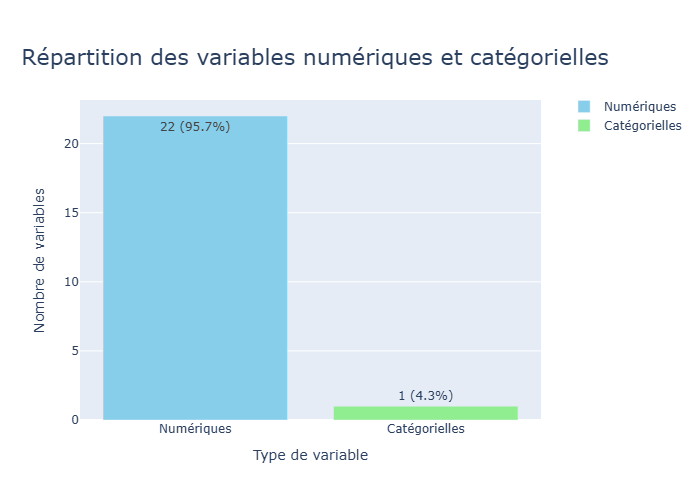

In [11]:
# Visualisation de la répartition des variables numériques et catégorielles.

num_cat_appli_train = plot_num_cat_distribution(df= df_credit_card,
                          chart_type='bar',
                          title="Répartition des variables numériques et catégorielles",
                          annotation_format= 'both',
                          title_size=22,
                          title_x= 0.45,
                          title_y= 0.90,
                          legend_x= 1.05,
                          legend_y= 0.95,
                          width=800,
                          height=800
)

num_cat_appli_train.show()

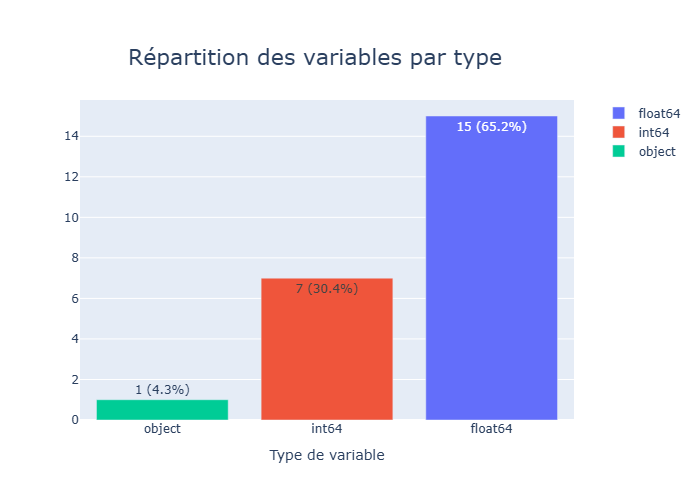

In [12]:
# Visualisation de la répartition des variables par type.

var_distrib_appli_train = plot_variable_types_distribution(df=df_credit_card,
                          chart_type='bar',
                          title_size=22,
                          title_x= 0.45,
                          title_y= 0.90,
                          legend_x= 1.05,
                          legend_y= 0.90,
                          annotation_format= 'both',
                          bar_orientation= 'v',
                          width=800,
                          height=800)

var_distrib_appli_train.show()

- Pour ce fichier, la répartition des variables est quasiment exclusivement focalisé sur les variables quantitatives.   

##### - Valeurs aberrantes de df_credit_card

In [13]:
# Liste des variables catégorielles du dataframe.

df_credit_card.select_dtypes(include=['object']).nunique()

NAME_CONTRACT_STATUS    7
dtype: int64

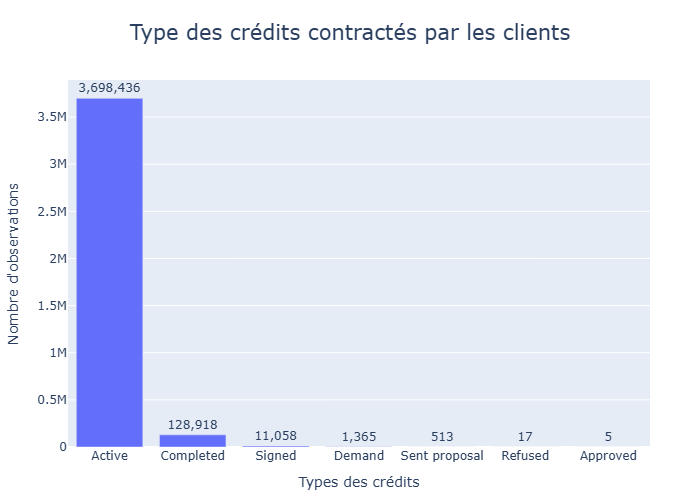

In [14]:
# Visualisation de la répartition pour la variable "NAME_CONTRACT_STATUS"

plot_histogram_categorical(
    df=df_credit_card,
    x="NAME_CONTRACT_STATUS",
    title="Type des crédits contractés par les clients",
    xaxis_title= 'Types des crédits',
    title_font_size=21
)

- Pas de valeurs aberrantes.
- On pourrait réduire ici le nombre de modalité que l'on observe car en dehors de "Active" et "Completed", le variables restantes sont très marginales. Cela permettra de nouveau de réduire la dimensionnalité pour les modèles linéaires sans impacter négativement les modèles non linéaires.

In [15]:
# Changement des modalités concernées pour la variable 'NAME_CONTRACT_STATUS'.

rare_status = df_credit_card['NAME_CONTRACT_STATUS'].value_counts(normalize=True)
rare_status = rare_status[rare_status < 0.01].index
df_credit_card['NAME_CONTRACT_STATUS'] = df_credit_card['NAME_CONTRACT_STATUS'].replace(rare_status, 'rare_status')
df_credit_card["NAME_CONTRACT_STATUS"].value_counts()

NAME_CONTRACT_STATUS
Active         3698436
Completed       128918
rare_status      12958
Name: count, dtype: int64

- On peut maintenant passer aux valeurs aberrantes des  variables quantitatives :

In [16]:
# Liste des variables quantitatives du dataframe.

pprint.pprint(df_credit_card.select_dtypes(exclude=['object']).columns.tolist())

['SK_ID_PREV',
 'SK_ID_CURR',
 'MONTHS_BALANCE',
 'AMT_BALANCE',
 'AMT_CREDIT_LIMIT_ACTUAL',
 'AMT_DRAWINGS_ATM_CURRENT',
 'AMT_DRAWINGS_CURRENT',
 'AMT_DRAWINGS_OTHER_CURRENT',
 'AMT_DRAWINGS_POS_CURRENT',
 'AMT_INST_MIN_REGULARITY',
 'AMT_PAYMENT_CURRENT',
 'AMT_PAYMENT_TOTAL_CURRENT',
 'AMT_RECEIVABLE_PRINCIPAL',
 'AMT_RECIVABLE',
 'AMT_TOTAL_RECEIVABLE',
 'CNT_DRAWINGS_ATM_CURRENT',
 'CNT_DRAWINGS_CURRENT',
 'CNT_DRAWINGS_OTHER_CURRENT',
 'CNT_DRAWINGS_POS_CURRENT',
 'CNT_INSTALMENT_MATURE_CUM',
 'SK_DPD',
 'SK_DPD_DEF']


In [17]:
round(df_credit_card.describe(), 0)

,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,AMT_BALANCE,AMT_CREDIT_LIMIT_ACTUAL,AMT_DRAWINGS_ATM_CURRENT,AMT_DRAWINGS_CURRENT,AMT_DRAWINGS_OTHER_CURRENT,AMT_DRAWINGS_POS_CURRENT,AMT_INST_MIN_REGULARITY,...,AMT_RECEIVABLE_PRINCIPAL,AMT_RECIVABLE,AMT_TOTAL_RECEIVABLE,CNT_DRAWINGS_ATM_CURRENT,CNT_DRAWINGS_CURRENT,CNT_DRAWINGS_OTHER_CURRENT,CNT_DRAWINGS_POS_CURRENT,CNT_INSTALMENT_MATURE_CUM,SK_DPD,SK_DPD_DEF
count,3840312.0,3840312.0,3840312.0,3840312.0,3840312.0,3090496.0,3840312.0,3090496.0,3090496.0,3535076.0,...,3840312.0,3840312.0,3840312.0,3090496.0,3840312.0,3090496.0,3090496.0,3535076.0,3840312.0,3840312.0
mean,1904504.0,278324.0,-35.0,58300.0,153808.0,5961.0,7433.0,288.0,2969.0,3540.0,...,55966.0,58089.0,58098.0,0.0,1.0,0.0,1.0,21.0,9.0,0.0
std,536469.0,102704.0,27.0,106307.0,165146.0,28226.0,33846.0,8202.0,20797.0,5600.0,...,102534.0,105965.0,105972.0,1.0,3.0,0.0,3.0,20.0,98.0,21.0
min,1000018.0,100006.0,-96.0,-420250.0,0.0,-6827.0,-6212.0,0.0,0.0,0.0,...,-423306.0,-420250.0,-420250.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
25%,1434385.0,189517.0,-55.0,0.0,45000.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,0.0,0.0
50%,1897122.0,278396.0,-28.0,0.0,112500.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,15.0,0.0,0.0
75%,2369328.0,367580.0,-11.0,89047.0,180000.0,0.0,0.0,0.0,0.0,6634.0,...,85359.0,88899.0,88915.0,0.0,0.0,0.0,0.0,32.0,0.0,0.0
max,2843496.0,456250.0,-1.0,1505902.0,1350000.0,2115000.0,2287098.0,1529847.0,2239274.0,202882.0,...,1472317.0,1493338.0,1493338.0,51.0,165.0,12.0,165.0,120.0,3260.0,3260.0


In [18]:
report_aberr_val_prev = detect_aberrant_values(df_credit_card.iloc[:, 2:], min_occurrences=1)
report_aberr_val_prev

,Variable,Valeur_aberrante,Occurrences
0,MONTHS_BALANCE,-94.00,13397
1,MONTHS_BALANCE,-95.00,12521
2,MONTHS_BALANCE,-96.00,11722
3,AMT_BALANCE,-4.50,24
4,AMT_BALANCE,-2025.99,16
...,...,...,...
285583,SK_DPD_DEF,503.00,1
285584,SK_DPD_DEF,1765.00,1
285585,SK_DPD_DEF,2680.00,1
285586,SK_DPD_DEF,2282.00,1


In [19]:
#  Visualisation des valeurs aberrantes négatives potentielles.

report_aberr_val_prev.loc[report_aberr_val_prev['Valeur_aberrante'] < 0]

,Variable,Valeur_aberrante,Occurrences
0,MONTHS_BALANCE,-94.000,13397
1,MONTHS_BALANCE,-95.000,12521
2,MONTHS_BALANCE,-96.000,11722
3,AMT_BALANCE,-4.500,24
4,AMT_BALANCE,-2025.990,16
...,...,...,...
284109,AMT_TOTAL_RECEIVABLE,-3599.685,1
284133,AMT_TOTAL_RECEIVABLE,-10574.955,1
284134,AMT_TOTAL_RECEIVABLE,-1625.985,1
284135,AMT_TOTAL_RECEIVABLE,-8936.595,1


In [20]:
report_aberr_val_prev.loc[report_aberr_val_prev['Valeur_aberrante'] < 0]['Variable'].unique()

array(['MONTHS_BALANCE', 'AMT_BALANCE', 'AMT_DRAWINGS_ATM_CURRENT',
       'AMT_DRAWINGS_CURRENT', 'AMT_RECEIVABLE_PRINCIPAL',
       'AMT_RECIVABLE', 'AMT_TOTAL_RECEIVABLE'], dtype=object)

In [21]:
round(df_credit_card[report_aberr_val_prev.loc[report_aberr_val_prev['Valeur_aberrante'] < 0]['Variable'].unique().tolist()].describe(), 0)

,MONTHS_BALANCE,AMT_BALANCE,AMT_DRAWINGS_ATM_CURRENT,AMT_DRAWINGS_CURRENT,AMT_RECEIVABLE_PRINCIPAL,AMT_RECIVABLE,AMT_TOTAL_RECEIVABLE
count,3840312.0,3840312.0,3090496.0,3840312.0,3840312.0,3840312.0,3840312.0
mean,-35.0,58300.0,5961.0,7433.0,55966.0,58089.0,58098.0
std,27.0,106307.0,28226.0,33846.0,102534.0,105965.0,105972.0
min,-96.0,-420250.0,-6827.0,-6212.0,-423306.0,-420250.0,-420250.0
25%,-55.0,0.0,0.0,0.0,0.0,0.0,0.0
50%,-28.0,0.0,0.0,0.0,0.0,0.0,0.0
75%,-11.0,89047.0,0.0,0.0,85359.0,88899.0,88915.0
max,-1.0,1505902.0,2115000.0,2287098.0,1472317.0,1493338.0,1493338.0


- Pour ces variables, on remarque quelques valeurs aberrantes notamment pour des variables monétaires qui représentent des montants ou soldes qui ne peuvent pas être négatif, il faut donc corriger ces erreurs.

In [22]:
# Correction des valeurs aberrantes pour les variables monétaires concernées.

cols_to_correct = ['AMT_DRAWINGS_ATM_CURRENT', 'AMT_DRAWINGS_CURRENT', 'AMT_RECEIVABLE_PRINCIPAL',
                    'AMT_RECIVABLE', 'AMT_TOTAL_RECEIVABLE']

for col in cols_to_correct:

    df_credit_card.loc[df_credit_card[col] < 0, col] = np.nan


In [23]:
report_aberr_val_prev.loc[report_aberr_val_prev['Valeur_aberrante'] >= 0]['Variable'].unique()

array(['AMT_BALANCE', 'AMT_CREDIT_LIMIT_ACTUAL',
       'AMT_DRAWINGS_ATM_CURRENT', 'AMT_DRAWINGS_CURRENT',
       'AMT_DRAWINGS_OTHER_CURRENT', 'AMT_DRAWINGS_POS_CURRENT',
       'AMT_INST_MIN_REGULARITY', 'AMT_PAYMENT_CURRENT',
       'AMT_PAYMENT_TOTAL_CURRENT', 'AMT_RECEIVABLE_PRINCIPAL',
       'AMT_RECIVABLE', 'AMT_TOTAL_RECEIVABLE',
       'CNT_DRAWINGS_ATM_CURRENT', 'CNT_DRAWINGS_CURRENT',
       'CNT_DRAWINGS_OTHER_CURRENT', 'CNT_DRAWINGS_POS_CURRENT',
       'CNT_INSTALMENT_MATURE_CUM', 'SK_DPD', 'SK_DPD_DEF'], dtype=object)

In [24]:
round(df_credit_card[report_aberr_val_prev.loc[report_aberr_val_prev['Valeur_aberrante'] >= 0]['Variable'].unique().tolist()].describe(), 0)

,AMT_BALANCE,AMT_CREDIT_LIMIT_ACTUAL,AMT_DRAWINGS_ATM_CURRENT,AMT_DRAWINGS_CURRENT,AMT_DRAWINGS_OTHER_CURRENT,AMT_DRAWINGS_POS_CURRENT,AMT_INST_MIN_REGULARITY,AMT_PAYMENT_CURRENT,AMT_PAYMENT_TOTAL_CURRENT,AMT_RECEIVABLE_PRINCIPAL,AMT_RECIVABLE,AMT_TOTAL_RECEIVABLE,CNT_DRAWINGS_ATM_CURRENT,CNT_DRAWINGS_CURRENT,CNT_DRAWINGS_OTHER_CURRENT,CNT_DRAWINGS_POS_CURRENT,CNT_INSTALMENT_MATURE_CUM,SK_DPD,SK_DPD_DEF
count,3840312.0,3840312.0,3090495.0,3840309.0,3090496.0,3090496.0,3535076.0,3072324.0,3840312.0,3837884.0,3730974.0,3730982.0,3090496.0,3840312.0,3090496.0,3090496.0,3535076.0,3840312.0,3840312.0
mean,58300.0,153808.0,5961.0,7433.0,288.0,2969.0,3540.0,10281.0,7589.0,56003.0,59822.0,59832.0,0.0,1.0,0.0,1.0,21.0,9.0,0.0
std,106307.0,165146.0,28226.0,33846.0,8202.0,20797.0,5600.0,36078.0,32006.0,102554.0,107013.0,107019.0,1.0,3.0,0.0,3.0,20.0,98.0,21.0
min,-420250.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
25%,0.0,45000.0,0.0,0.0,0.0,0.0,0.0,152.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,0.0,0.0
50%,0.0,112500.0,0.0,0.0,0.0,0.0,0.0,2703.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,15.0,0.0,0.0
75%,89047.0,180000.0,0.0,0.0,0.0,0.0,6634.0,9000.0,6750.0,85417.0,91426.0,91444.0,0.0,0.0,0.0,0.0,32.0,0.0,0.0
max,1505902.0,1350000.0,2115000.0,2287098.0,1529847.0,2239274.0,202882.0,4289207.0,4278316.0,1472317.0,1493338.0,1493338.0,51.0,165.0,12.0,165.0,120.0,3260.0,3260.0


- Pour les grands montants, on part du principe que ces derniers sont correctes puisqu'il ne s'agit pas de data de sources externes mais des données de Home Credit donc fiable.
- Toutefois, on peut vérifier la cohérence de certains montant par rapport à d'autres montants comme par exemple est ce que AMT_PAYMENT_TOTAL_CURRENT < AMT_PAYMENT_CURRENT ou encore AMT_CREDIT_LIMIT_ACTUAL < AMT_BALANCE.

In [25]:
# Montant de paiement courant supérieur au paiment total restant.

df_credit_card.loc[df_credit_card['AMT_PAYMENT_CURRENT'] > df_credit_card['AMT_PAYMENT_TOTAL_CURRENT'], 'AMT_PAYMENT_CURRENT'].count()

1187232

In [26]:
# Montant du solde supérieur à la limite actuelle du crédit.

df_credit_card.loc[df_credit_card['AMT_BALANCE'] > df_credit_card['AMT_CREDIT_LIMIT_ACTUAL'], 'AMT_BALANCE'].count()

342354

In [27]:
# Montant principal supérieur au montant total à recevoir.

df_credit_card.loc[df_credit_card['AMT_RECEIVABLE_PRINCIPAL'] > df_credit_card['AMT_TOTAL_RECEIVABLE'], 'AMT_RECEIVABLE_PRINCIPAL'].count()

881

In [28]:
# Montant des prélévements globales inférieurs a la somme de l'ensemble des prélévements connus.

mask = (df_credit_card["AMT_DRAWINGS_CURRENT"] < (df_credit_card["AMT_DRAWINGS_ATM_CURRENT"] + df_credit_card["AMT_DRAWINGS_POS_CURRENT"] + df_credit_card["AMT_DRAWINGS_OTHER_CURRENT"]))
cols_sub = ["AMT_DRAWINGS_ATM_CURRENT", "AMT_DRAWINGS_POS_CURRENT", "AMT_DRAWINGS_OTHER_CURRENT"]

df_credit_card.loc[mask, cols_sub].count()

AMT_DRAWINGS_ATM_CURRENT      2566
AMT_DRAWINGS_POS_CURRENT      2566
AMT_DRAWINGS_OTHER_CURRENT    2566
dtype: int64

- Comme on peut le voir, il y a des incohérences que l'on peut soulever ici néanmoins il est difficile ici de corriger cela surtout pour les deux premiers rapports puisqu'il y a de nombreuses lignes concernées.
- Après quelques recherches au lieu de remplacer par Nan, on peut ici créer des flags plus tard qui pourront être utiles aux modèles par la suite.

On peut maintenant passer aux valeurs manquantes :

In [29]:
# Calcul du nombre et du pourcentage de valeurs manquantes pour chaque colonne.

calculate_missing_values(df_credit_card)

,Nbr_valeurs_manquantes,Pct_valeurs_manquantes
AMT_PAYMENT_CURRENT,767988,19.998063
AMT_DRAWINGS_ATM_CURRENT,749817,19.524898
AMT_DRAWINGS_OTHER_CURRENT,749816,19.524872
AMT_DRAWINGS_POS_CURRENT,749816,19.524872
CNT_DRAWINGS_ATM_CURRENT,749816,19.524872
CNT_DRAWINGS_OTHER_CURRENT,749816,19.524872
CNT_DRAWINGS_POS_CURRENT,749816,19.524872
AMT_INST_MIN_REGULARITY,305236,7.948208
CNT_INSTALMENT_MATURE_CUM,305236,7.948208
AMT_RECIVABLE,109338,2.847112


<Figure size 720x432 with 0 Axes>

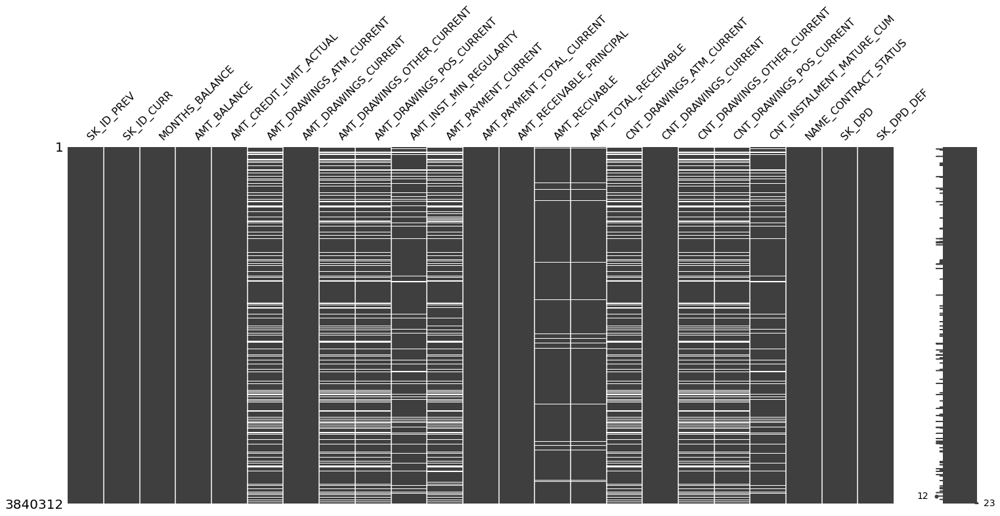

In [30]:
# Visualisation des valeurs manquantes à l'aide d'un graphique.

plot_missing_values(df_credit_card.iloc[:, :],
                    use_missingno= 'matrix',
                    height=1000
                    )

In [31]:
# Calcul du nombre et du pourcentage de valeurs manquantes pour l'ensemble du dataframe.

summarize_missing_values(df_credit_card)

'Le DataFrame contient 6098456 valeurs manquantes sur 88327176 observations, soit 6.90%.'

- On retrouve assez peu de valeurs manquantes pour ce dataframe, on peut donc passer à l'imputation après séparation des données.

In [32]:
# Séparation des données train et test avant imputation.

df_credit_card_train = df_credit_card[df_credit_card['SK_ID_CURR'].isin(df_appli_train['SK_ID_CURR'])]
df_credit_card_test  = df_credit_card[df_credit_card['SK_ID_CURR'].isin(df_appli_test['SK_ID_CURR'])]

In [33]:
print_dataframe_shape(df_credit_card_train)

Le DataFrame contient 3,227,965 lignes et 23 colonnes.


In [34]:
print_dataframe_shape(df_credit_card_test)

Le DataFrame contient 612,347 lignes et 23 colonnes.


In [35]:
# Calcul du nombre et du pourcentage de valeurs manquantes pour chaque colonne.

calculate_missing_values(df_credit_card_train)

,Nbr_valeurs_manquantes,Pct_valeurs_manquantes
AMT_PAYMENT_CURRENT,620093,19.210029
AMT_DRAWINGS_ATM_CURRENT,605755,18.765848
AMT_DRAWINGS_OTHER_CURRENT,605754,18.765817
AMT_DRAWINGS_POS_CURRENT,605754,18.765817
CNT_DRAWINGS_ATM_CURRENT,605754,18.765817
CNT_DRAWINGS_OTHER_CURRENT,605754,18.765817
CNT_DRAWINGS_POS_CURRENT,605754,18.765817
AMT_INST_MIN_REGULARITY,264384,8.190423
CNT_INSTALMENT_MATURE_CUM,264384,8.190423
AMT_RECIVABLE,93668,2.901766


In [36]:
# Calcul du nombre et du pourcentage de valeurs manquantes pour chaque colonne.

calculate_missing_values(df_credit_card_test)

,Nbr_valeurs_manquantes,Pct_valeurs_manquantes
AMT_PAYMENT_CURRENT,147895,24.152156
AMT_DRAWINGS_ATM_CURRENT,144062,23.526203
AMT_DRAWINGS_OTHER_CURRENT,144062,23.526203
AMT_DRAWINGS_POS_CURRENT,144062,23.526203
CNT_DRAWINGS_ATM_CURRENT,144062,23.526203
CNT_DRAWINGS_OTHER_CURRENT,144062,23.526203
CNT_DRAWINGS_POS_CURRENT,144062,23.526203
AMT_INST_MIN_REGULARITY,40852,6.671381
CNT_INSTALMENT_MATURE_CUM,40852,6.671381
AMT_RECIVABLE,15670,2.559007


- Peu de différences entre les deux datasets, on passe donc à l'imputation avec la fonction habituelle.

In [37]:
# Création des datasets suivant les différentes configurations.

cat_cols = df_credit_card.select_dtypes(include=["object"]).columns.tolist()
num_cols = df_credit_card.select_dtypes(exclude=["object"]).columns.tolist()

datasets_cc_train = create_datasets(df_credit_card_train, cat_cols, num_cols, setups=("median_mode", "median_missing", "iterative_mode", "nan_missing"))
datasets_cc_test = create_datasets(df_credit_card_test, cat_cols, num_cols, setups=("median_mode", "median_missing", "iterative_mode", "nan_missing"))

c:\Users\Caomghin\anaconda3\lib\site-packages\sklearn\impute\_iterative.py:825: ConvergenceWarning:

[IterativeImputer] Early stopping criterion not reached.

c:\Users\Caomghin\anaconda3\lib\site-packages\sklearn\impute\_iterative.py:825: ConvergenceWarning:

[IterativeImputer] Early stopping criterion not reached.



In [38]:
# On assigne chaque setup à un dataframe.

# Versions pour modèles linéaires (régression logistique, Lasso, Ridge, etc.)
df_cc_train_median_mode_linear = datasets_cc_train["median_mode_linear"]
df_cc_train_median_missing_linear = datasets_cc_train["median_missing_linear"]
df_cc_train_iterative_mode_linear = datasets_cc_train["iterative_mode_linear"]
df_cc_train_nan_missing_linear = datasets_cc_train["nan_missing_linear"]

# Versions pour modèles non-linéaires (arbres, LightGBM, RF, XGB, etc.)
df_cc_train_median_mode = datasets_cc_train["median_mode_tree"]
df_cc_train_median_missing = datasets_cc_train["median_missing_tree"]
df_cc_train_iterative_mode = datasets_cc_train["iterative_mode_tree"]
df_cc_train_nan_missing = datasets_cc_train["nan_missing_tree"]


# Versions pour modèles linéaires (régression logistique, Lasso, Ridge, etc.)
df_cc_test_median_mode_linear = datasets_cc_test["median_mode_linear"]
df_cc_test_median_missing_linear = datasets_cc_test["median_missing_linear"]
df_cc_test_iterative_mode_linear = datasets_cc_test["iterative_mode_linear"]
df_cc_test_nan_missing_linear = datasets_cc_test["nan_missing_linear"]

# Versions pour modèles non-linéaires (arbres, LightGBM, RF, XGB, etc.)
df_cc_test_median_mode = datasets_cc_test["median_mode_tree"]
df_cc_test_median_missing = datasets_cc_test["median_missing_tree"]
df_cc_test_iterative_mode = datasets_cc_test["iterative_mode_tree"]
df_cc_test_nan_missing = datasets_cc_test["nan_missing_tree"]

In [39]:
# Calcul du nombre et du pourcentage de valeurs manquantes restantes pour ces nouveaux dataframes.

print(summarize_missing_values(df_cc_train_median_mode_linear))
print(summarize_missing_values(df_cc_train_median_missing_linear))
print(summarize_missing_values(df_cc_train_iterative_mode_linear))
print(summarize_missing_values(df_cc_train_nan_missing_linear))

Le DataFrame contient 0 valeurs manquantes sur 74243195 observations, soit 0.00%.
Le DataFrame contient 0 valeurs manquantes sur 74243195 observations, soit 0.00%.
Le DataFrame contient 0 valeurs manquantes sur 74243195 observations, soit 0.00%.
Le DataFrame contient 4972757 valeurs manquantes sur 74243195 observations, soit 6.70%.


In [40]:
print(summarize_missing_values(df_cc_test_median_mode_linear))
print(summarize_missing_values(df_cc_test_median_missing_linear))
print(summarize_missing_values(df_cc_test_iterative_mode_linear))
print(summarize_missing_values(df_cc_test_nan_missing_linear))

Le DataFrame contient 0 valeurs manquantes sur 14083981 observations, soit 0.00%.
Le DataFrame contient 0 valeurs manquantes sur 14083981 observations, soit 0.00%.
Le DataFrame contient 0 valeurs manquantes sur 14083981 observations, soit 0.00%.
Le DataFrame contient 1125699 valeurs manquantes sur 14083981 observations, soit 7.99%.


In [41]:
# Optimisation des types de variables et de la mémoire du dataframe.

optimize_types(df_cc_train_median_mode_linear)
optimize_types(df_cc_train_median_missing_linear)
optimize_types(df_cc_train_iterative_mode_linear)
optimize_types(df_cc_train_nan_missing_linear)
optimize_types(df_cc_train_median_mode)
optimize_types(df_cc_train_median_missing)
optimize_types(df_cc_train_iterative_mode)
optimize_types(df_cc_train_nan_missing)

 Mémoire avant : 760.71 MB
 Mémoire après : 489.81 MB
 Gain : 35.6%
 Mémoire avant : 760.71 MB
 Mémoire après : 489.81 MB
 Gain : 35.6%
 Mémoire avant : 760.71 MB
 Mémoire après : 489.81 MB
 Gain : 35.6%
 Mémoire avant : 760.71 MB
 Mémoire après : 502.12 MB
 Gain : 34.0%
 Mémoire avant : 1043.93 MB
 Mémoire après : 773.03 MB
 Gain : 26.0%
 Mémoire avant : 1043.93 MB
 Mémoire après : 773.03 MB
 Gain : 26.0%
 Mémoire avant : 1043.93 MB
 Mémoire après : 773.03 MB
 Gain : 26.0%
 Mémoire avant : 1043.93 MB
 Mémoire après : 785.34 MB
 Gain : 24.8%


,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,AMT_BALANCE,AMT_CREDIT_LIMIT_ACTUAL,AMT_DRAWINGS_ATM_CURRENT,AMT_DRAWINGS_CURRENT,AMT_DRAWINGS_OTHER_CURRENT,AMT_DRAWINGS_POS_CURRENT,AMT_INST_MIN_REGULARITY,...,AMT_RECIVABLE_was_missing,AMT_TOTAL_RECEIVABLE_was_missing,CNT_DRAWINGS_ATM_CURRENT_was_missing,CNT_DRAWINGS_CURRENT_was_missing,CNT_DRAWINGS_OTHER_CURRENT_was_missing,CNT_DRAWINGS_POS_CURRENT_was_missing,CNT_INSTALMENT_MATURE_CUM_was_missing,SK_DPD_was_missing,SK_DPD_DEF_was_missing,NAME_CONTRACT_STATUS_was_missing
1,2582071,363914,-1,63975.554688,45000,2250.0,2250.000000,0.0,0.000000,2250.000000,...,0,0,0,0,0,0,0,0,0,0
3,1389973,337855,-4,236572.109375,225000,2250.0,2250.000000,0.0,0.000000,11795.759766,...,0,0,0,0,0,0,0,0,0,0
4,1891521,126868,-1,453919.468750,450000,0.0,11547.000000,0.0,11547.000000,22924.890625,...,0,0,0,0,0,0,0,0,0,0
8,2181852,367360,-4,291543.062500,292500,90000.0,289339.437500,0.0,199339.421875,130.500000,...,0,0,0,0,0,0,0,0,0,0
9,1235299,203885,-5,201261.187500,225000,76500.0,111026.703125,0.0,34526.699219,6338.339844,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3840307,1036507,328243,-9,0.000000,45000,NaN,0.000000,NaN,NaN,0.000000,...,0,0,1,0,1,1,0,0,0,0
3840308,1714892,347207,-9,0.000000,45000,0.0,0.000000,0.0,0.000000,0.000000,...,0,0,0,0,0,0,0,0,0,0
3840309,1302323,215757,-9,275784.968750,585000,270000.0,270000.000000,0.0,0.000000,2250.000000,...,0,0,0,0,0,0,0,0,0,0
3840310,1624872,430337,-10,0.000000,450000,NaN,0.000000,NaN,NaN,0.000000,...,0,0,1,0,1,1,0,0,0,0


In [42]:
# Optimisation des types de variables et de la mémoire du dataframe.

optimize_types(df_cc_test_median_mode_linear)
optimize_types(df_cc_test_median_missing_linear)
optimize_types(df_cc_test_iterative_mode_linear)
optimize_types(df_cc_test_nan_missing_linear)
optimize_types(df_cc_test_median_mode)
optimize_types(df_cc_test_median_missing)
optimize_types(df_cc_test_iterative_mode)
optimize_types(df_cc_test_nan_missing)

 Mémoire avant : 144.33 MB
 Mémoire après : 92.94 MB
 Gain : 35.6%
 Mémoire avant : 144.33 MB
 Mémoire après : 92.94 MB
 Gain : 35.6%
 Mémoire avant : 144.33 MB
 Mémoire après : 92.94 MB
 Gain : 35.6%
 Mémoire avant : 144.33 MB
 Mémoire après : 95.28 MB
 Gain : 34.0%
 Mémoire avant : 198.06 MB
 Mémoire après : 146.67 MB
 Gain : 25.9%
 Mémoire avant : 198.06 MB
 Mémoire après : 146.67 MB
 Gain : 25.9%
 Mémoire avant : 198.06 MB
 Mémoire après : 146.67 MB
 Gain : 25.9%
 Mémoire avant : 198.06 MB
 Mémoire après : 149.01 MB
 Gain : 24.8%


,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,AMT_BALANCE,AMT_CREDIT_LIMIT_ACTUAL,AMT_DRAWINGS_ATM_CURRENT,AMT_DRAWINGS_CURRENT,AMT_DRAWINGS_OTHER_CURRENT,AMT_DRAWINGS_POS_CURRENT,AMT_INST_MIN_REGULARITY,...,AMT_RECIVABLE_was_missing,AMT_TOTAL_RECEIVABLE_was_missing,CNT_DRAWINGS_ATM_CURRENT_was_missing,CNT_DRAWINGS_CURRENT_was_missing,CNT_DRAWINGS_OTHER_CURRENT_was_missing,CNT_DRAWINGS_POS_CURRENT_was_missing,CNT_INSTALMENT_MATURE_CUM_was_missing,SK_DPD_was_missing,SK_DPD_DEF_was_missing,NAME_CONTRACT_STATUS_was_missing
0,2562384,378907,-6,56.970001,135000,0.0,877.5,0.0,877.5,1700.324951,...,0,0,0,0,0,0,0,0,0,0
2,1740877,371185,-7,31815.224609,450000,0.0,0.0,0.0,0.0,2250.000000,...,0,0,0,0,0,0,0,0,0,0
5,2646502,380010,-7,82903.812500,270000,0.0,0.0,0.0,0.0,4449.104980,...,0,0,0,0,0,0,0,0,0,0
6,1079071,171320,-6,353451.656250,585000,67500.0,67500.0,0.0,0.0,14684.174805,...,0,0,0,0,0,0,0,0,0,0
7,2095912,118650,-7,47962.125000,45000,45000.0,45000.0,0.0,0.0,0.000000,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3840258,2328311,419701,-17,269839.437500,270000,0.0,0.0,0.0,0.0,13500.000000,...,0,0,0,0,0,0,0,0,0,0
3840260,1684290,273579,-16,0.000000,45000,NaN,0.0,NaN,NaN,0.000000,...,0,0,1,0,1,1,0,0,0,0
3840279,2275300,227917,-17,0.000000,45000,0.0,0.0,0.0,0.0,0.000000,...,0,0,0,0,0,0,0,0,0,0
3840285,2622308,111891,-16,0.000000,0,0.0,0.0,0.0,0.0,0.000000,...,0,0,0,0,0,0,0,0,0,0


In [43]:
# Visualisation des variables à encoder avec One Hot Encoder.

ohe_var = [col for col in df_cc_train_median_missing_linear.columns 
                      if df_cc_train_median_missing_linear[col].dtype == 'object' and df_cc_train_median_missing_linear[col].nunique() <= 10]

print("""Variables catégorielles avec One Hot Encoder :\n""")
pprint.pprint(ohe_var)

Variables catégorielles avec One Hot Encoder :

['NAME_CONTRACT_STATUS']


In [44]:
#Encodage des variables catégorielles avec One Hot Encoder.


# Liste des datasets à encoder
datasets_linear = [
    df_cc_train_median_missing_linear,
    df_cc_train_median_mode_linear,
    df_cc_train_iterative_mode_linear,
    df_cc_train_nan_missing_linear,
    df_cc_test_median_mode_linear,
    df_cc_test_median_missing_linear,
    df_cc_test_iterative_mode_linear,
    df_cc_test_nan_missing_linear
]

# Application du One-Hot Encoding sur tous les datasets
encoded_ohe_linear = one_hot_encode(datasets_linear, columns=ohe_var, drop_first=True)

df_cc_train_median_missing_linear = encoded_ohe_linear[0]
df_cc_train_median_mode_linear = encoded_ohe_linear[1]
df_cc_train_iterative_mode_linear = encoded_ohe_linear[2]
df_cc_train_nan_missing_linear = encoded_ohe_linear[3]
df_cc_test_median_mode_linear = encoded_ohe_linear[4]
df_cc_test_median_missing_linear = encoded_ohe_linear[5]
df_cc_test_iterative_mode_linear = encoded_ohe_linear[6]
df_cc_test_nan_missing_linear = encoded_ohe_linear[7]

# Liste des datasets à encoder
datasets = [
    df_cc_train_median_missing,
    df_cc_train_median_mode,
    df_cc_train_iterative_mode,
    df_cc_train_nan_missing,
    df_cc_test_median_mode,
    df_cc_test_median_missing,
    df_cc_test_iterative_mode,
    df_cc_test_nan_missing
]

# Application du One-Hot Encoding sur tous les datasets
encoded_ohe = one_hot_encode(datasets, columns=ohe_var, drop_first=False)

df_cc_train_median_missing = encoded_ohe[0]
df_cc_train_median_mode = encoded_ohe[1]
df_cc_train_iterative_mode = encoded_ohe[2]
df_cc_train_nan_missing = encoded_ohe[3]
df_cc_test_median_mode = encoded_ohe[4]
df_cc_test_median_missing = encoded_ohe[5]
df_cc_test_iterative_mode = encoded_ohe[6]
df_cc_test_nan_missing = encoded_ohe[7]

In [45]:
df_cc_train_median_missing_linear.loc[:, df_cc_train_median_missing_linear.columns.str.contains('NAME_CONTRACT_STATUS')]

,NAME_CONTRACT_STATUS_Completed,NAME_CONTRACT_STATUS_rare_status
1,0.0,0.0
3,0.0,0.0
4,0.0,0.0
8,0.0,0.0
9,0.0,0.0
...,...,...
3840307,0.0,0.0
3840308,0.0,0.0
3840309,0.0,0.0
3840310,0.0,0.0


In [46]:
df_cc_train_median_missing.loc[:, df_cc_train_median_missing.columns.str.contains('NAME_CONTRACT_STATUS')]

,NAME_CONTRACT_STATUS_was_missing,NAME_CONTRACT_STATUS_Active,NAME_CONTRACT_STATUS_Completed,NAME_CONTRACT_STATUS_rare_status
1,0,1.0,0.0,0.0
3,0,1.0,0.0,0.0
4,0,1.0,0.0,0.0
8,0,1.0,0.0,0.0
9,0,1.0,0.0,0.0
...,...,...,...,...
3840307,0,1.0,0.0,0.0
3840308,0,1.0,0.0,0.0
3840309,0,1.0,0.0,0.0
3840310,0,1.0,0.0,0.0


- On peut ensuite passer à la création de nouvelles features intéressante avec ce fichier:

In [47]:
def add_credit_card_features(df):
    """
    Ajoute des features dérivées du dataset credit_card_balance.
    df : DataFrame pandas
    """

    df = df.copy()

    # Ratios monétaires
    df["CC_UTILIZATION"] = df["AMT_BALANCE"] / (df["AMT_CREDIT_LIMIT_ACTUAL"] + 1e-6)
    df["CC_PAYMENT_RATIO"] = df["AMT_PAYMENT_TOTAL_CURRENT"] / (df["AMT_BALANCE"] + 1e-6)
    df["CC_MIN_PAYMENT_RATIO"] = df["AMT_PAYMENT_CURRENT"] / (df["AMT_INST_MIN_REGULARITY"] + 1e-6)
    df["CC_DRAWING_RATIO"] = df["AMT_DRAWINGS_CURRENT"] / (df["AMT_CREDIT_LIMIT_ACTUAL"] + 1e-6)

    df["CC_DRAWING_ATM_RATIO"] = df["AMT_DRAWINGS_ATM_CURRENT"] / (df["AMT_DRAWINGS_CURRENT"] + 1e-6)
    df["CC_DRAWING_POS_RATIO"] = df["AMT_DRAWINGS_POS_CURRENT"] / (df["AMT_DRAWINGS_CURRENT"] + 1e-6)
    df["CC_DRAWING_OTHER_RATIO"] = df["AMT_DRAWINGS_OTHER_CURRENT"] / (df["AMT_DRAWINGS_CURRENT"] + 1e-6)

    df["CC_BALANCE_TO_RECEIVABLE"] = df["AMT_BALANCE"] / (df["AMT_TOTAL_RECEIVABLE"] + 1e-6)
    df["CC_PAYMENT_TO_RECEIVABLE"] = df["AMT_PAYMENT_TOTAL_CURRENT"] / (df["AMT_TOTAL_RECEIVABLE"] + 1e-6)
    df["CC_DRAWING_TO_BALANCE"] = df["AMT_DRAWINGS_CURRENT"] / (df["AMT_BALANCE"] + 1e-6)


    # Interactions et différences
    df["CC_INST_DIFF"] = df["AMT_INST_MIN_REGULARITY"] - df["AMT_PAYMENT_CURRENT"]
    df["CC_RECEIVABLE_DIFF"] = df["AMT_TOTAL_RECEIVABLE"] - df["AMT_RECEIVABLE_PRINCIPAL"]
    df["CC_BALANCE_LIMIT_DIFF"] = df["AMT_CREDIT_LIMIT_ACTUAL"] - df["AMT_BALANCE"]
    df["CC_PAYMENT_DIFF"] = df["AMT_PAYMENT_TOTAL_CURRENT"] - df["AMT_PAYMENT_CURRENT"]
    df["CC_DRAWINGS_SUM"] = (
        df["AMT_DRAWINGS_ATM_CURRENT"] +
        df["AMT_DRAWINGS_POS_CURRENT"] +
        df["AMT_DRAWINGS_OTHER_CURRENT"]
    )
    df["CC_INST_DIFF"] = df["AMT_INST_MIN_REGULARITY"] - df["AMT_PAYMENT_CURRENT"]


    #Flags d’anomalies
    df["FLAG_DRAWINGS_OVER_TOTAL"] = (df["CC_DRAWINGS_SUM"] > df["AMT_DRAWINGS_CURRENT"]).astype(int)
    df["FLAG_PAYMENT_OVER_TOTAL"] = (df["AMT_PAYMENT_CURRENT"] > df["AMT_PAYMENT_TOTAL_CURRENT"]).astype(int)
    df["FLAG_BALANCE_OVER_LIMIT"] = (df["AMT_BALANCE"] > df["AMT_CREDIT_LIMIT_ACTUAL"]).astype(int)
    df["FLAG_PRINCIPAL_OVER_TOTAL"] = (df["AMT_RECEIVABLE_PRINCIPAL"] > df["AMT_TOTAL_RECEIVABLE"]).astype(int)

    # Temporalité
    df["CC_IS_RECENT"] = (df["MONTHS_BALANCE"] > -6).astype(int)
    df["CC_IS_VERY_RECENT"] = (df["MONTHS_BALANCE"] > -3).astype(int)


    # Tendances temporelles
    df["CC_BALANCE_TREND"] = df.groupby("SK_ID_PREV")["AMT_BALANCE"].diff()
    df["CC_PAYMENT_TREND"] = df.groupby("SK_ID_PREV")["AMT_PAYMENT_TOTAL_CURRENT"].diff()
    df["CC_DRAWING_TREND"] = df.groupby("SK_ID_PREV")["AMT_DRAWINGS_CURRENT"].diff()

    # Variations relatives
    df["CC_BALANCE_PCT_CHANGE"] = df.groupby("SK_ID_PREV")["AMT_BALANCE"].pct_change()
    df["CC_PAYMENT_PCT_CHANGE"] = df.groupby("SK_ID_PREV")["AMT_PAYMENT_TOTAL_CURRENT"].pct_change()


    # Features cumulées
    df["CC_BALANCE_CUMSUM"] = df.groupby("SK_ID_PREV")["AMT_BALANCE"].cumsum()
    df["CC_PAYMENT_CUMSUM"] = df.groupby("SK_ID_PREV")["AMT_PAYMENT_TOTAL_CURRENT"].cumsum()


    # Nettoyage
    df.replace([np.inf, -np.inf], np.nan, inplace=True)

    return df


- Il faudra ici prendre en compte que les variables de type **.diff()**, **.pct_change()** sont des variations dans le temps donc en T0 on a des Nan, donc il faudra imputer par 0 pour les dataframes réservés aux modèles linéaire.

In [48]:
# Ajout des nouvelles variables à l'aide la fonction créée précédemment.

df_cc_train_median_mode_linear_nf = add_credit_card_features(df_cc_train_median_mode_linear)
df_cc_train_median_missing_linear_nf = add_credit_card_features(df_cc_train_median_missing_linear)
df_cc_train_iterative_mode_linear_nf = add_credit_card_features(df_cc_train_iterative_mode_linear)
df_cc_train_nan_missing_linear_nf = add_credit_card_features(df_cc_train_nan_missing_linear)

df_cc_train_median_mode_nf = add_credit_card_features(df_cc_train_median_mode)
df_cc_train_median_missing_nf = add_credit_card_features(df_cc_train_median_missing)
df_cc_train_iterative_mode_nf= add_credit_card_features(df_cc_train_iterative_mode)
df_cc_train_nan_missing_nf = add_credit_card_features(df_cc_train_nan_missing)

df_cc_test_median_mode_linear_nf = add_credit_card_features(df_cc_test_median_mode_linear)
df_cc_test_median_missing_linear_nf = add_credit_card_features(df_cc_test_median_missing_linear)
df_cc_test_iterative_mode_linear_nf = add_credit_card_features(df_cc_test_iterative_mode_linear)
df_cc_test_nan_missing_linear_nf = add_credit_card_features(df_cc_test_nan_missing_linear)

df_cc_test_median_mode_nf = add_credit_card_features(df_cc_test_median_mode)
df_cc_test_median_missing_nf = add_credit_card_features(df_cc_test_median_missing)
df_cc_test_iterative_mode_nf = add_credit_card_features(df_cc_test_iterative_mode)
df_cc_test_nan_missing_nf = add_credit_card_features(df_cc_test_nan_missing)


In [49]:
# Suppression de "SK_ID_CURR" pour réaliser une première agrégation par crédit.

df_cc_train_median_mode_linear_nf.drop(columns=["SK_ID_CURR"], inplace=True)
df_cc_train_median_missing_linear_nf.drop(columns=["SK_ID_CURR"], inplace=True)
df_cc_train_iterative_mode_linear_nf.drop(columns=["SK_ID_CURR"], inplace=True)
df_cc_train_nan_missing_linear_nf.drop(columns=["SK_ID_CURR"], inplace=True)

df_cc_train_median_mode_nf.drop(columns=["SK_ID_CURR"], inplace=True)
df_cc_train_median_missing_nf.drop(columns=["SK_ID_CURR"], inplace=True)
df_cc_train_iterative_mode_nf.drop(columns=["SK_ID_CURR"], inplace=True)
df_cc_train_nan_missing_nf.drop(columns=["SK_ID_CURR"], inplace=True)

df_cc_test_median_mode_linear_nf.drop(columns=["SK_ID_CURR"], inplace=True)
df_cc_test_median_missing_linear_nf.drop(columns=["SK_ID_CURR"], inplace=True)
df_cc_test_iterative_mode_linear_nf.drop(columns=["SK_ID_CURR"], inplace=True)
df_cc_test_nan_missing_linear_nf.drop(columns=["SK_ID_CURR"], inplace=True)

df_cc_test_median_mode_nf.drop(columns=["SK_ID_CURR"], inplace=True)
df_cc_test_median_missing_nf.drop(columns=["SK_ID_CURR"], inplace=True)
df_cc_test_iterative_mode_nf.drop(columns=["SK_ID_CURR"], inplace=True)
df_cc_test_nan_missing_nf.drop(columns=["SK_ID_CURR"], inplace=True)

In [50]:
def aggregate_credit_card_by_credit(df):
    """
    Agrégation du fichier credit_card_balance au niveau crédit (SK_ID_PREV).
    df : DataFrame pandas
    """

    data = df.copy()

    # Colonnes à exclure

    exclude_cols = ["MONTHS_BALANCE"]

    base_numeric_cols = [
        c for c in data.columns 
        if c not in exclude_cols + ["SK_ID_PREV"]
        and data[c].dtype != "object"
    ]

    # Séparation
    was_missing_cols = [c for c in data.columns if c.endswith("_was_missing")]
    ohe_cols = [c for c in data.columns if c.startswith("NAME_CONTRACT_STATUS_")]
    flag_cols = [c for c in data.columns if c.startswith("FLAG_")]

    # Colonnes dérivées
    derived_cols = [
        c for c in base_numeric_cols
        if c not in ohe_cols + flag_cols + was_missing_cols
    ]

    # Dictionnaire d'agrégations

    agg_dict = {}

    # OHE
    for col in ohe_cols:
        agg_dict[col] = ["mean", "sum"]

    # Flags
    for col in flag_cols:
        agg_dict[col] = ["mean", "sum", "max"]

    # Colonnes dérivées 
    for col in derived_cols:
        agg_dict[col] = ["mean", "max", "min"]

    # Agrégation principale
    df_credit = data.groupby("SK_ID_PREV").agg(agg_dict)

    # Renommage
    df_credit.columns = [
        f"CC_{col.upper()}_{stat.upper()}"
        for col, stat in df_credit.columns
    ]

    df_credit.reset_index(inplace=True)

    # Agréger les colonnes _was_missing
    if len(was_missing_cols) > 0:
        missing_agg = data.groupby("SK_ID_PREV")[was_missing_cols].agg(["mean", "sum"])
        missing_agg.columns = [
            f"CC_{col.upper()}_{stat.upper()}"
            for col, stat in missing_agg.columns
    ]
        missing_agg.reset_index(inplace=True)
        df_credit = df_credit.merge(missing_agg, on="SK_ID_PREV", how="left")


    #Ajout des features supplémentaires

    # Nombre total de mois pour ce crédit
    df_credit["CC_NB_MONTHS"] = (
        data.groupby("SK_ID_PREV")["MONTHS_BALANCE"].count().values
    )

    # Ancienneté moyenne 
    df_credit["CC_MEAN_MONTH"] = (
        data.groupby("SK_ID_PREV")["MONTHS_BALANCE"].mean().values
    )

    # Mois le plus récent observé
    df_credit["CC_MAX_MONTH"] = (
        data.groupby("SK_ID_PREV")["MONTHS_BALANCE"].max().values
    )

    return df_credit

In [51]:
# Agrégation au niveau des crédits dans un premier temps.

df_cc_train_median_mode_linear_cred = aggregate_credit_card_by_credit(df_cc_train_median_mode_linear_nf)
df_cc_train_median_missing_linear_cred = aggregate_credit_card_by_credit(df_cc_train_median_missing_linear_nf)
df_cc_train_iterative_mode_linear_cred = aggregate_credit_card_by_credit(df_cc_train_iterative_mode_linear_nf)
df_cc_train_nan_missing_linear_cred = aggregate_credit_card_by_credit(df_cc_train_nan_missing_linear_nf)

df_cc_train_median_mode_cred = aggregate_credit_card_by_credit(df_cc_train_median_mode_nf)
df_cc_train_median_missing_cred = aggregate_credit_card_by_credit(df_cc_train_median_missing_nf)
df_cc_train_iterative_mode_cred = aggregate_credit_card_by_credit(df_cc_train_iterative_mode_nf)
df_cc_train_nan_missing_cred = aggregate_credit_card_by_credit(df_cc_train_nan_missing_nf)

df_cc_test_median_mode_linear_cred = aggregate_credit_card_by_credit(df_cc_test_median_mode_linear_nf)
df_cc_test_median_missing_linear_cred = aggregate_credit_card_by_credit(df_cc_test_median_missing_linear_nf)
df_cc_test_iterative_mode_linear_cred = aggregate_credit_card_by_credit(df_cc_test_iterative_mode_linear_nf)
df_cc_test_nan_missing_linear_cred = aggregate_credit_card_by_credit(df_cc_test_nan_missing_linear_nf)

df_cc_test_median_mode_cred = aggregate_credit_card_by_credit(df_cc_test_median_mode_nf)
df_cc_test_median_missing_cred = aggregate_credit_card_by_credit(df_cc_test_median_missing_nf)
df_cc_test_iterative_mode_cred = aggregate_credit_card_by_credit(df_cc_test_iterative_mode_nf)
df_cc_test_nan_missing_cred = aggregate_credit_card_by_credit(df_cc_test_nan_missing_nf)

In [52]:
df_cc_train_median_mode_linear_cred

,SK_ID_PREV,CC_NAME_CONTRACT_STATUS_COMPLETED_MEAN,CC_NAME_CONTRACT_STATUS_COMPLETED_SUM,CC_NAME_CONTRACT_STATUS_RARE_STATUS_MEAN,CC_NAME_CONTRACT_STATUS_RARE_STATUS_SUM,CC_FLAG_DRAWINGS_OVER_TOTAL_MEAN,CC_FLAG_DRAWINGS_OVER_TOTAL_SUM,CC_FLAG_DRAWINGS_OVER_TOTAL_MAX,CC_FLAG_PAYMENT_OVER_TOTAL_MEAN,CC_FLAG_PAYMENT_OVER_TOTAL_SUM,...,CC_CC_PAYMENT_PCT_CHANGE_MIN,CC_CC_BALANCE_CUMSUM_MEAN,CC_CC_BALANCE_CUMSUM_MAX,CC_CC_BALANCE_CUMSUM_MIN,CC_CC_PAYMENT_CUMSUM_MEAN,CC_CC_PAYMENT_CUMSUM_MAX,CC_CC_PAYMENT_CUMSUM_MIN,CC_NB_MONTHS,CC_MEAN_MONTH,CC_MAX_MONTH
0,1000018,0.0,0.0,0.0,0.0,0.0,0,0,0.000000,0,...,-0.599696,2.084717e+05,3.747314e+05,40934.070312,17888.787109,27708.750000,3900.870117,5,-4.0,-2
1,1000030,0.0,0.0,0.0,0.0,0.0,0,0,0.875000,7,...,-1.000000,2.958184e+05,4.479285e+05,100264.453125,15977.655273,21263.580078,322.380005,8,-4.5,-1
2,1000035,0.0,0.0,0.0,0.0,0.0,0,0,1.000000,5,...,NaN,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000,0.000000,5,-4.0,-2
3,1000077,0.0,0.0,0.0,0.0,0.0,0,0,1.000000,11,...,NaN,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000,0.000000,11,-7.0,-2
4,1000083,0.0,0.0,0.0,0.0,0.0,0,0,1.000000,13,...,NaN,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000,0.000000,13,-7.0,-1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
87447,2843461,0.0,0.0,0.0,0.0,0.0,0,0,0.301370,22,...,-1.000000,1.869516e+06,3.758976e+06,86526.226562,186396.609375,403249.500000,4500.000000,73,-37.0,-1
87448,2843476,0.0,0.0,0.0,0.0,0.0,0,0,0.557895,53,...,-1.000000,1.877972e+06,3.604092e+06,124151.132812,157970.468750,328513.500000,11250.000000,95,-49.0,-2
87449,2843477,0.0,0.0,0.0,0.0,0.0,0,0,0.952941,81,...,-1.000000,8.273639e+04,1.413615e+05,0.000000,47402.468750,67410.000000,0.000000,85,-43.0,-1
87450,2843478,0.0,0.0,0.0,0.0,0.0,0,0,0.888889,80,...,-1.000000,2.259458e+05,4.600264e+05,28.350000,52130.000000,109980.000000,10980.000000,90,-46.5,-2


In [53]:
def aggregate_credit_card_by_client(df):
    """
    Agrège le dataframe credit_card_balance déjà agrégé au niveau crédit (SK_ID_PREV),
    au niveau client (SK_ID_CURR).
    df : DataFrame pandas
    """

    import numpy as np
    import pandas as pd

    data = df.copy()

    # Colonnes à exclure
    exclude_cols = ["SK_ID_PREV"]

    # Colonnes numériques utilisables
    numeric_cols = [
        c for c in data.columns
        if c not in exclude_cols + ["SK_ID_CURR"]
        and pd.api.types.is_numeric_dtype(data[c])
    ]

    # Colonnes _was_missing
    was_missing_cols = [c for c in numeric_cols if c.endswith("_WAS_MISSING")]

    # Flags
    flag_cols = [c for c in numeric_cols if c.startswith("CC_FLAG_")]

    # OHE
    ohe_cols = [c for c in numeric_cols if "NAME_CONTRACT_STATUS_" in c]

    # Colonnes temporelles
    time_cols = [
        c for c in numeric_cols
        if c.endswith(("NB_MONTHS", "MEAN_MONTH", "MAX_MONTH"))
    ]

    # Colonnes dérivées
    other_numeric = [
        c for c in numeric_cols
        if c not in flag_cols + ohe_cols + time_cols + was_missing_cols
    ]


    # Dictionnaire d’agrégations
    agg_dict = {}

    # Flags
    for col in flag_cols:
        agg_dict[col] = ["mean", "sum", "max"]

    # OHE
    for col in ohe_cols:
        agg_dict[col] = ["mean", "sum"]

    # Colonnes temporelles
    for col in time_cols:
        if col.endswith("NB_MONTHS"):
            agg_dict[col] = ["sum", "mean"]
        else:
            agg_dict[col] = ["mean", "max"]

    # Autres colonnes dérivées
    for col in other_numeric:
        agg_dict[col] = ["mean", "max", "min"]


    # Agrégation principale
    cc_client_agg = data.groupby("SK_ID_CURR").agg(agg_dict)

    # Renommage
    cc_client_agg.columns = [
        f"{col.upper()}_{stat.upper()}"
        for col, stat in cc_client_agg.columns
    ]
    cc_client_agg.reset_index(inplace=True)


    # Agrégation des colonnes _was_missing
    if len(was_missing_cols) > 0:
        missing_agg = data.groupby("SK_ID_CURR")[was_missing_cols].agg(["mean", "sum"])
        missing_agg.columns = [
            f"{col.upper()}_{stat.upper()}"
            for col, stat in missing_agg.columns
        ]
        missing_agg.reset_index(inplace=True)
        cc_client_agg = cc_client_agg.merge(missing_agg, on="SK_ID_CURR", how="left")

    # Nettoyage
    cc_client_agg.replace([np.inf, -np.inf], np.nan, inplace=True)

    print(f"Agrégation credit_card_balance (niveau client) – shape : {cc_client_agg.shape}")

    return cc_client_agg

In [54]:
# Rajout de la variable ID client aux dataframes

df_cc_train_median_mode_linear_cred = df_cc_train_median_mode_linear_cred.merge(df_init_credit_card[['SK_ID_PREV', 'SK_ID_CURR']], on='SK_ID_PREV', how='left')
df_cc_train_median_missing_linear_cred = df_cc_train_median_missing_linear_cred.merge(df_init_credit_card[['SK_ID_PREV', 'SK_ID_CURR']], on='SK_ID_PREV', how='left')
df_cc_train_iterative_mode_linear_cred = df_cc_train_iterative_mode_linear_cred.merge(df_init_credit_card[['SK_ID_PREV', 'SK_ID_CURR']], on='SK_ID_PREV', how='left')
df_cc_train_nan_missing_linear_cred = df_cc_train_nan_missing_linear_cred.merge(df_init_credit_card[['SK_ID_PREV', 'SK_ID_CURR']], on='SK_ID_PREV', how='left')

df_cc_train_median_mode_cred = df_cc_train_median_mode_cred.merge(df_init_credit_card[['SK_ID_PREV', 'SK_ID_CURR']], on='SK_ID_PREV', how='left')
df_cc_train_median_missing_cred = df_cc_train_median_missing_cred.merge(df_init_credit_card[['SK_ID_PREV', 'SK_ID_CURR']], on='SK_ID_PREV', how='left')
df_cc_train_iterative_mode_cred = df_cc_train_iterative_mode_cred.merge(df_init_credit_card[['SK_ID_PREV', 'SK_ID_CURR']], on='SK_ID_PREV', how='left')
df_cc_train_nan_missing_cred = df_cc_train_nan_missing_cred.merge(df_init_credit_card[['SK_ID_PREV', 'SK_ID_CURR']], on='SK_ID_PREV', how='left')

df_cc_test_median_mode_linear_cred = df_cc_test_median_mode_linear_cred.merge(df_init_credit_card[['SK_ID_PREV', 'SK_ID_CURR']], on='SK_ID_PREV', how='left')
df_cc_test_median_missing_linear_cred = df_cc_test_median_missing_linear_cred.merge(df_init_credit_card[['SK_ID_PREV', 'SK_ID_CURR']], on='SK_ID_PREV', how='left')
df_cc_test_iterative_mode_linear_cred = df_cc_test_iterative_mode_linear_cred.merge(df_init_credit_card[['SK_ID_PREV', 'SK_ID_CURR']], on='SK_ID_PREV', how='left')
df_cc_test_nan_missing_linear_cred = df_cc_test_nan_missing_linear_cred.merge(df_init_credit_card[['SK_ID_PREV', 'SK_ID_CURR']], on='SK_ID_PREV', how='left')

df_cc_test_median_mode_cred = df_cc_test_median_mode_cred.merge(df_init_credit_card[['SK_ID_PREV', 'SK_ID_CURR']], on='SK_ID_PREV', how='left')
df_cc_test_median_missing_cred = df_cc_test_median_missing_cred.merge(df_init_credit_card[['SK_ID_PREV', 'SK_ID_CURR']], on='SK_ID_PREV', how='left')
df_cc_test_iterative_mode_cred = df_cc_test_iterative_mode_cred.merge(df_init_credit_card[['SK_ID_PREV', 'SK_ID_CURR']], on='SK_ID_PREV', how='left')
df_cc_test_nan_missing_cred = df_cc_test_nan_missing_cred.merge(df_init_credit_card[['SK_ID_PREV', 'SK_ID_CURR']], on='SK_ID_PREV', how='left')

In [55]:
# Agrégation au niveau des clients dans un deuxième temps.

df_cc_train_median_mode_linear_agg = aggregate_credit_card_by_client(df_cc_train_median_mode_linear_cred)
df_cc_train_median_missing_linear_agg = aggregate_credit_card_by_client(df_cc_train_median_missing_linear_cred)
df_cc_train_iterative_mode_linear_agg = aggregate_credit_card_by_client(df_cc_train_iterative_mode_linear_cred)
df_cc_train_nan_missing_linear_agg= aggregate_credit_card_by_client(df_cc_train_nan_missing_linear_cred)

df_cc_train_median_mode_agg = aggregate_credit_card_by_client(df_cc_train_median_mode_cred)
df_cc_train_median_missing_agg = aggregate_credit_card_by_client(df_cc_train_median_missing_cred)
df_cc_train_iterative_mode_agg = aggregate_credit_card_by_client(df_cc_train_iterative_mode_cred)
df_cc_train_nan_missing_agg = aggregate_credit_card_by_client(df_cc_train_nan_missing_cred)

df_cc_test_median_mode_linear_agg = aggregate_credit_card_by_client(df_cc_test_median_mode_linear_cred)
df_cc_test_median_missing_linear_agg = aggregate_credit_card_by_client(df_cc_test_median_missing_linear_cred)
df_cc_test_iterative_mode_linear_agg = aggregate_credit_card_by_client(df_cc_test_iterative_mode_linear_cred)
df_cc_test_nan_missing_linear_agg = aggregate_credit_card_by_client(df_cc_test_nan_missing_linear_cred)

df_cc_test_median_mode_agg = aggregate_credit_card_by_client(df_cc_test_median_mode_cred)
df_cc_test_median_missing_agg = aggregate_credit_card_by_client(df_cc_test_median_missing_cred)
df_cc_test_iterative_mode_agg = aggregate_credit_card_by_client(df_cc_test_iterative_mode_cred)
df_cc_test_nan_missing_agg = aggregate_credit_card_by_client(df_cc_test_nan_missing_cred)

C:\Users\Caomghin\AppData\Local\Temp/ipykernel_23644/468556145.py:76: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



Agrégation credit_card_balance (niveau client) – shape : (86905, 438)


C:\Users\Caomghin\AppData\Local\Temp/ipykernel_23644/468556145.py:76: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



Agrégation credit_card_balance (niveau client) – shape : (86905, 438)


C:\Users\Caomghin\AppData\Local\Temp/ipykernel_23644/468556145.py:76: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



Agrégation credit_card_balance (niveau client) – shape : (86905, 438)


C:\Users\Caomghin\AppData\Local\Temp/ipykernel_23644/468556145.py:76: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



Agrégation credit_card_balance (niveau client) – shape : (86905, 438)


C:\Users\Caomghin\AppData\Local\Temp/ipykernel_23644/468556145.py:76: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



Agrégation credit_card_balance (niveau client) – shape : (86905, 582)


C:\Users\Caomghin\AppData\Local\Temp/ipykernel_23644/468556145.py:76: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



Agrégation credit_card_balance (niveau client) – shape : (86905, 582)


C:\Users\Caomghin\AppData\Local\Temp/ipykernel_23644/468556145.py:76: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



Agrégation credit_card_balance (niveau client) – shape : (86905, 582)


C:\Users\Caomghin\AppData\Local\Temp/ipykernel_23644/468556145.py:76: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



Agrégation credit_card_balance (niveau client) – shape : (86905, 582)


C:\Users\Caomghin\AppData\Local\Temp/ipykernel_23644/468556145.py:76: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



Agrégation credit_card_balance (niveau client) – shape : (16653, 438)


C:\Users\Caomghin\AppData\Local\Temp/ipykernel_23644/468556145.py:76: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



Agrégation credit_card_balance (niveau client) – shape : (16653, 438)


C:\Users\Caomghin\AppData\Local\Temp/ipykernel_23644/468556145.py:76: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



Agrégation credit_card_balance (niveau client) – shape : (16653, 438)


C:\Users\Caomghin\AppData\Local\Temp/ipykernel_23644/468556145.py:76: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



Agrégation credit_card_balance (niveau client) – shape : (16653, 438)


C:\Users\Caomghin\AppData\Local\Temp/ipykernel_23644/468556145.py:76: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



Agrégation credit_card_balance (niveau client) – shape : (16653, 582)


C:\Users\Caomghin\AppData\Local\Temp/ipykernel_23644/468556145.py:76: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



Agrégation credit_card_balance (niveau client) – shape : (16653, 582)


C:\Users\Caomghin\AppData\Local\Temp/ipykernel_23644/468556145.py:76: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



Agrégation credit_card_balance (niveau client) – shape : (16653, 582)
Agrégation credit_card_balance (niveau client) – shape : (16653, 582)


C:\Users\Caomghin\AppData\Local\Temp/ipykernel_23644/468556145.py:76: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



In [56]:
df_cc_train_median_mode_linear_agg.head()

,SK_ID_CURR,CC_FLAG_DRAWINGS_OVER_TOTAL_MEAN_MEAN,CC_FLAG_DRAWINGS_OVER_TOTAL_MEAN_SUM,CC_FLAG_DRAWINGS_OVER_TOTAL_MEAN_MAX,CC_FLAG_DRAWINGS_OVER_TOTAL_SUM_MEAN,CC_FLAG_DRAWINGS_OVER_TOTAL_SUM_SUM,CC_FLAG_DRAWINGS_OVER_TOTAL_SUM_MAX,CC_FLAG_DRAWINGS_OVER_TOTAL_MAX_MEAN,CC_FLAG_DRAWINGS_OVER_TOTAL_MAX_SUM,CC_FLAG_DRAWINGS_OVER_TOTAL_MAX_MAX,...,CC_CC_BALANCE_CUMSUM_MIN_MIN,CC_CC_PAYMENT_CUMSUM_MEAN_MEAN,CC_CC_PAYMENT_CUMSUM_MEAN_MAX,CC_CC_PAYMENT_CUMSUM_MEAN_MIN,CC_CC_PAYMENT_CUMSUM_MAX_MEAN,CC_CC_PAYMENT_CUMSUM_MAX_MAX,CC_CC_PAYMENT_CUMSUM_MAX_MIN,CC_CC_PAYMENT_CUMSUM_MIN_MEAN,CC_CC_PAYMENT_CUMSUM_MIN_MAX,CC_CC_PAYMENT_CUMSUM_MIN_MIN
0,100006,0.0,0.0,0.0,0.0,0,0,0.0,0,0,...,0.000000,0.00000,0.00000,0.00000,0.0,0.0,0.0,0.0,0.0,0.0
1,100011,0.0,0.0,0.0,0.0,0,0,0.0,0,0,...,75109.953125,201817.09375,201817.09375,201817.09375,334485.0,334485.0,334485.0,9000.0,9000.0,9000.0
2,100021,0.0,0.0,0.0,0.0,0,0,0.0,0,0,...,0.000000,0.00000,0.00000,0.00000,0.0,0.0,0.0,0.0,0.0,0.0
3,100023,0.0,0.0,0.0,0.0,0,0,0.0,0,0,...,0.000000,0.00000,0.00000,0.00000,0.0,0.0,0.0,0.0,0.0,0.0
4,100036,0.0,0.0,0.0,0.0,0,0,0.0,0,0,...,0.000000,0.00000,0.00000,0.00000,0.0,0.0,0.0,0.0,0.0,0.0


In [57]:
calculate_missing_values(df_cc_train_median_mode_linear_agg)

,Nbr_valeurs_manquantes,Pct_valeurs_manquantes
CC_CC_BALANCE_PCT_CHANGE_MIN_MAX,27719,31.895748
CC_CC_BALANCE_PCT_CHANGE_MIN_MIN,27719,31.895748
CC_CC_BALANCE_PCT_CHANGE_MEAN_MEAN,27719,31.895748
CC_CC_BALANCE_PCT_CHANGE_MEAN_MAX,27719,31.895748
CC_CC_BALANCE_PCT_CHANGE_MEAN_MIN,27719,31.895748
CC_CC_BALANCE_PCT_CHANGE_MAX_MEAN,27719,31.895748
CC_CC_BALANCE_PCT_CHANGE_MAX_MAX,27719,31.895748
CC_CC_BALANCE_PCT_CHANGE_MAX_MIN,27719,31.895748
CC_CC_BALANCE_PCT_CHANGE_MIN_MEAN,27719,31.895748
CC_CC_PAYMENT_PCT_CHANGE_MIN_MIN,26555,30.556355


- Comme prévu, on a ici les variables temporelles avec lesquelles il faut imputer par 0 pour les modèles linéaires.

In [58]:
# Merge des pairs bureau/application pour les datasets train

df_train_median_mode_linear = df_train_median_mode_linear.merge(
    df_cc_train_median_mode_linear_agg, on="SK_ID_CURR", how="left"
).fillna(0)

df_train_median_missing_linear = df_train_median_missing_linear.merge(
    df_cc_train_median_missing_linear_agg, on="SK_ID_CURR", how="left"
).fillna(0)

df_train_iterative_mode_linear = df_train_iterative_mode_linear.merge(
    df_cc_train_iterative_mode_linear_agg, on="SK_ID_CURR", how="left"
).fillna(0)

df_train_nan_missing_linear = df_train_nan_missing_linear.merge(
    df_cc_train_nan_missing_linear_agg, on="SK_ID_CURR", how="left"
)

df_train_median_mode = df_train_median_mode.merge(
    df_cc_train_median_mode_agg, on="SK_ID_CURR", how="left"
)

df_train_median_missing = df_train_median_missing.merge(
    df_cc_train_median_missing_agg, on="SK_ID_CURR", how="left"
)

df_train_iterative_mode = df_train_iterative_mode.merge(
    df_cc_train_iterative_mode_agg, on="SK_ID_CURR", how="left"
)

df_train_nan_missing = df_train_nan_missing.merge(
    df_cc_train_nan_missing_agg, on="SK_ID_CURR", how="left"
)

# Merge des pairs bureau/application pour les datasets test

df_test_median_mode_linear = df_test_median_mode_linear.merge(
    df_cc_test_median_mode_linear_agg, on="SK_ID_CURR", how="left"
).fillna(0)

df_test_median_missing_linear = df_test_median_missing_linear.merge(
    df_cc_test_median_missing_linear_agg, on="SK_ID_CURR", how="left"
).fillna(0)

df_test_iterative_mode_linear = df_test_iterative_mode_linear.merge(
    df_cc_test_iterative_mode_linear_agg, on="SK_ID_CURR", how="left"
).fillna(0)

df_test_nan_missing_linear = df_test_nan_missing_linear.merge(
    df_cc_test_nan_missing_linear_agg, on="SK_ID_CURR", how="left"
)

df_test_median_mode = df_test_median_mode.merge(
    df_cc_test_median_mode_agg, on="SK_ID_CURR", how="left"
)

df_test_median_missing = df_test_median_missing.merge(
    df_cc_test_median_missing_agg, on="SK_ID_CURR", how="left"
)

df_test_iterative_mode = df_test_iterative_mode.merge(
    df_cc_test_iterative_mode_agg, on="SK_ID_CURR", how="left"
)

df_test_nan_missing = df_test_nan_missing.merge(
    df_cc_test_nan_missing_agg, on="SK_ID_CURR", how="left"
)

In [59]:
# Visualisation des changements apportés.

df_train_median_mode_linear.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_ANNUITY,REGION_POPULATION_RELATIVE,OWN_CAR_AGE,FLAG_MOBIL,...,CC_CC_BALANCE_CUMSUM_MIN_MIN,CC_CC_PAYMENT_CUMSUM_MEAN_MEAN,CC_CC_PAYMENT_CUMSUM_MEAN_MAX,CC_CC_PAYMENT_CUMSUM_MEAN_MIN,CC_CC_PAYMENT_CUMSUM_MAX_MEAN,CC_CC_PAYMENT_CUMSUM_MAX_MAX,CC_CC_PAYMENT_CUMSUM_MAX_MIN,CC_CC_PAYMENT_CUMSUM_MIN_MEAN,CC_CC_PAYMENT_CUMSUM_MIN_MAX,CC_CC_PAYMENT_CUMSUM_MIN_MIN
0,100002,1,0,1,0,1,24700.5,0.018801,9,1,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,100003,0,0,0,0,0,35698.5,0.003541,9,1,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,1,1,1,1,6750.0,0.010032,26,1,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,100006,0,0,0,0,1,29686.5,0.008019,9,1,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,100007,0,0,1,0,1,21865.5,0.028663,9,1,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [60]:
calculate_missing_values(df_train_median_mode_linear)

,Nbr_valeurs_manquantes,Pct_valeurs_manquantes


#### Corrélation des variables - df_train_median_mode_linear

In [61]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_median_mode_linear[df_cc_train_median_mode_linear_agg.columns.tolist()], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,CC_AMT_INST_MIN_REGULARITY_MIN_MAX / CC_AMT_INST_MIN_REGULARITY_MIN_MEAN,CC_AMT_INST_MIN_REGULARITY_MIN_MEAN,CC_AMT_INST_MIN_REGULARITY_MIN_MAX,1.000000
1,CC_AMT_INST_MIN_REGULARITY_MIN_MEAN / CC_AMT_INST_MIN_REGULARITY_MIN_MIN,CC_AMT_INST_MIN_REGULARITY_MIN_MEAN,CC_AMT_INST_MIN_REGULARITY_MIN_MIN,1.000000
2,CC_CC_BALANCE_PCT_CHANGE_MIN_MEAN / CC_CC_BALANCE_PCT_CHANGE_MIN_MIN,CC_CC_BALANCE_PCT_CHANGE_MIN_MEAN,CC_CC_BALANCE_PCT_CHANGE_MIN_MIN,1.000000
3,CC_CC_BALANCE_PCT_CHANGE_MIN_MAX / CC_CC_BALANCE_PCT_CHANGE_MIN_MEAN,CC_CC_BALANCE_PCT_CHANGE_MIN_MEAN,CC_CC_BALANCE_PCT_CHANGE_MIN_MAX,1.000000
4,CC_CC_BALANCE_PCT_CHANGE_MIN_MAX / CC_CC_BALANCE_PCT_CHANGE_MIN_MIN,CC_CC_BALANCE_PCT_CHANGE_MIN_MAX,CC_CC_BALANCE_PCT_CHANGE_MIN_MIN,1.000000
5,CC_CC_BALANCE_TO_RECEIVABLE_MIN_MEAN / CC_CC_BALANCE_TO_RECEIVABLE_MIN_MIN,CC_CC_BALANCE_TO_RECEIVABLE_MIN_MEAN,CC_CC_BALANCE_TO_RECEIVABLE_MIN_MIN,1.000000
6,CC_CC_PAYMENT_PCT_CHANGE_MIN_MEAN / CC_CC_PAYMENT_PCT_CHANGE_MIN_MIN,CC_CC_PAYMENT_PCT_CHANGE_MIN_MEAN,CC_CC_PAYMENT_PCT_CHANGE_MIN_MIN,1.000000
7,CC_AMT_RECIVABLE_MIN_MIN / CC_AMT_TOTAL_RECEIVABLE_MIN_MIN,CC_AMT_RECIVABLE_MIN_MIN,CC_AMT_TOTAL_RECEIVABLE_MIN_MIN,1.000000
8,CC_AMT_RECIVABLE_MIN_MEAN / CC_AMT_TOTAL_RECEIVABLE_MIN_MEAN,CC_AMT_RECIVABLE_MIN_MEAN,CC_AMT_TOTAL_RECEIVABLE_MIN_MEAN,1.000000
9,CC_AMT_RECIVABLE_MIN_MAX / CC_AMT_TOTAL_RECEIVABLE_MIN_MAX,CC_AMT_RECIVABLE_MIN_MAX,CC_AMT_TOTAL_RECEIVABLE_MIN_MAX,1.000000


In [62]:
df_corr = get_correlation_pairs(df_train_median_mode_linear[df_cc_train_median_mode_linear_agg.columns.tolist()], method="pearson", style=False, threshold=0.8)

In [63]:
var_corr = df_corr['Variable 1'].unique().tolist() + df_corr['Variable 2'].unique().tolist()
var_corr = list(set(var_corr))

In [64]:
# Visualisation des corrélations les plus importantes avec la Target.

pd.set_option('display.max_rows', None)

target_corr = compute_target_correlations(df_train_median_mode_linear.loc[:, var_corr + ['TARGET']], 'TARGET', mode='linear', plot=False)
target_corr.loc[var_corr].sort_values(by='pearson_corr', ascending=False)

,pearson_corr,spearman_corr,abs_pearson,abs_spearman,score_global
CC_FLAG_BALANCE_OVER_LIMIT_MEAN_MAX,0.081449,0.055476,0.081449,0.055476,0.068462
CC_FLAG_BALANCE_OVER_LIMIT_MEAN_MEAN,0.081217,0.055446,0.081217,0.055446,0.068331
CC_CNT_DRAWINGS_ATM_CURRENT_MEAN_MAX,0.064878,0.045894,0.064878,0.045894,0.055386
CC_CNT_DRAWINGS_ATM_CURRENT_MEAN_MEAN,0.064781,0.045839,0.064781,0.045839,0.055310
CC_CNT_DRAWINGS_ATM_CURRENT_MEAN_MIN,0.064745,0.045830,0.064745,0.045830,0.055287
CC_CC_DRAWING_ATM_RATIO_MEAN_MAX,0.059115,0.044420,0.059115,0.044420,0.051768
CC_CC_DRAWING_ATM_RATIO_MEAN_MEAN,0.058866,0.044376,0.058866,0.044376,0.051621
CC_CC_DRAWING_ATM_RATIO_MEAN_MIN,0.058856,0.044382,0.058856,0.044382,0.051619
CC_CNT_DRAWINGS_CURRENT_MAX_MAX,0.055465,0.042997,0.055465,0.042997,0.049231
CC_CNT_DRAWINGS_CURRENT_MAX_MEAN,0.055246,0.042947,0.055246,0.042947,0.049097


In [65]:
pd.reset_option('display.max_rows')

In [66]:
# Fonction permettant de visualiser les groupes de corrélations afin de faire un choix de variable.

pd.set_option('display.max_colwidth', None)
sum_corr_grps_med_mode_linear = summarize_correlated_groups(df_corr, X=df_train_median_mode_linear, y=df_train_median_mode_linear['TARGET'])
sum_corr_grps_med_mode_linear

,Variables du groupe,Taille du groupe,Corrélation max avec y,Variable la plus corrélée
0,"[CC_AMT_DRAWINGS_CURRENT_MAX_MIN, CC_AMT_RECIVABLE_MEAN_MIN, CC_AMT_INST_MIN_REGULARITY_MAX_MIN, CC_CC_BALANCE_TREND_MAX_MEAN, CC_CC_BALANCE_CUMSUM_MAX_MAX, CC_CC_RECEIVABLE_DIFF_MEAN_MEAN, CC_CC_DRAWINGS_SUM_MAX_MIN, CC_AMT_RECEIVABLE_PRINCIPAL_MAX_MIN, CC_CC_DRAWING_TREND_MIN_MEAN, CC_CC_DRAWING_TREND_MIN_MIN, CC_AMT_RECIVABLE_MAX_MEAN, CC_CC_BALANCE_CUMSUM_MAX_MIN, CC_CC_RECEIVABLE_DIFF_MAX_MEAN, CC_AMT_RECEIVABLE_PRINCIPAL_MEAN_MAX, CC_AMT_INST_MIN_REGULARITY_MEAN_MEAN, CC_CC_DRAWINGS_SUM_MAX_MEAN, CC_CC_BALANCE_TREND_MAX_MAX, CC_CC_RECEIVABLE_DIFF_MEAN_MAX, CC_AMT_INST_MIN_REGULARITY_MEAN_MIN, CC_AMT_INST_MIN_REGULARITY_MAX_MAX, CC_CC_BALANCE_CUMSUM_MAX_MEAN, CC_CC_BALANCE_CUMSUM_MEAN_MIN, CC_AMT_BALANCE_MEAN_MIN, CC_AMT_INST_MIN_REGULARITY_MAX_MEAN, CC_CC_BALANCE_TREND_MAX_MIN, CC_CC_BALANCE_CUMSUM_MIN_MIN, CC_AMT_RECIVABLE_MEAN_MEAN, CC_AMT_RECEIVABLE_PRINCIPAL_MAX_MAX, CC_CC_BALANCE_TREND_MIN_MEAN, CC_CC_DRAWING_TREND_MAX_MIN, CC_CC_BALANCE_CUMSUM_MEAN_MEAN, CC_AMT_RECIVABLE_MEAN_MAX, CC_AMT_BALANCE_MAX_MAX, CC_AMT_TOTAL_RECEIVABLE_MEAN_MIN, CC_CC_DRAWING_TREND_MAX_MAX, CC_CC_BALANCE_CUMSUM_MEAN_MAX, CC_AMT_BALANCE_MEAN_MEAN, CC_AMT_TOTAL_RECEIVABLE_MAX_MEAN, CC_AMT_BALANCE_MAX_MEAN, CC_CC_BALANCE_CUMSUM_MIN_MAX, CC_AMT_DRAWINGS_ATM_CURRENT_MAX_MIN, CC_AMT_INST_MIN_REGULARITY_MEAN_MAX, CC_AMT_DRAWINGS_ATM_CURRENT_MAX_MEAN, CC_AMT_BALANCE_MEAN_MAX, CC_AMT_RECEIVABLE_PRINCIPAL_MEAN_MIN, CC_AMT_TOTAL_RECEIVABLE_MEAN_MEAN, CC_CC_BALANCE_TREND_MIN_MIN, CC_CC_BALANCE_TREND_MIN_MAX, CC_AMT_BALANCE_MAX_MIN, CC_AMT_DRAWINGS_ATM_CURRENT_MAX_MAX, CC_CC_DRAWING_TREND_MIN_MAX, CC_CC_DRAWING_TREND_MAX_MEAN, CC_AMT_DRAWINGS_CURRENT_MAX_MEAN, CC_AMT_RECEIVABLE_PRINCIPAL_MEAN_MEAN, CC_AMT_RECEIVABLE_PRINCIPAL_MAX_MEAN, CC_AMT_TOTAL_RECEIVABLE_MAX_MIN, CC_AMT_TOTAL_RECEIVABLE_MEAN_MAX, CC_CC_BALANCE_CUMSUM_MIN_MEAN, CC_CC_DRAWINGS_SUM_MAX_MAX, CC_AMT_TOTAL_RECEIVABLE_MAX_MAX, CC_AMT_RECIVABLE_MAX_MAX, CC_CC_RECEIVABLE_DIFF_MAX_MAX, CC_AMT_DRAWINGS_CURRENT_MAX_MAX, CC_CC_RECEIVABLE_DIFF_MEAN_MIN, CC_CC_RECEIVABLE_DIFF_MAX_MIN, CC_AMT_RECIVABLE_MAX_MIN]",66,0.049605,CC_CC_RECEIVABLE_DIFF_MEAN_MAX
1,"[CC_CC_MIN_PAYMENT_RATIO_MIN_MIN, CC_AMT_PAYMENT_TOTAL_CURRENT_MIN_MEAN, CC_CC_PAYMENT_TO_RECEIVABLE_MIN_MIN, CC_CC_PAYMENT_RATIO_MIN_MEAN, CC_CC_DRAWING_TO_BALANCE_MIN_MIN, CC_AMT_PAYMENT_CURRENT_MIN_MAX, CC_CC_PAYMENT_TO_RECEIVABLE_MIN_MAX, CC_AMT_PAYMENT_CURRENT_MIN_MIN, CC_CC_DRAWING_RATIO_MIN_MIN, CC_CC_DRAWING_RATIO_MIN_MAX, CC_AMT_PAYMENT_TOTAL_CURRENT_MIN_MIN, CC_CC_PAYMENT_RATIO_MIN_MAX, CC_CC_DRAWING_TO_BALANCE_MIN_MEAN, CC_CC_DRAWING_RATIO_MIN_MEAN, CC_CC_MIN_PAYMENT_RATIO_MIN_MAX, CC_CC_PAYMENT_RATIO_MIN_MIN, CC_CC_PAYMENT_TO_RECEIVABLE_MIN_MEAN, CC_AMT_PAYMENT_CURRENT_MIN_MEAN, CC_CC_MIN_PAYMENT_RATIO_MIN_MEAN, CC_AMT_PAYMENT_TOTAL_CURRENT_MIN_MAX, CC_CC_DRAWING_TO_BALANCE_MIN_MAX]",21,0.005597,CC_CC_MIN_PAYMENT_RATIO_MIN_MAX
2,"[CC_AMT_PAYMENT_CURRENT_MAX_MEAN, CC_AMT_PAYMENT_TOTAL_CURRENT_MAX_MEAN, CC_AMT_PAYMENT_CURRENT_MAX_MAX, CC_AMT_PAYMENT_TOTAL_CURRENT_MAX_MIN, CC_AMT_PAYMENT_TOTAL_CURRENT_MAX_MAX, CC_CC_PAYMENT_TREND_MAX_MAX, CC_CC_INST_DIFF_MIN_MEAN, CC_CC_PAYMENT_TREND_MAX_MEAN, CC_CC_PAYMENT_TREND_MIN_MEAN, CC_CC_PAYMENT_TREND_MIN_MAX, CC_CC_PAYMENT_TO_RECEIVABLE_MAX_MAX, CC_CC_PAYMENT_TO_RECEIVABLE_MAX_MEAN, CC_AMT_PAYMENT_CURRENT_MAX_MIN, CC_CC_PAYMENT_TREND_MAX_MIN, CC_CC_INST_DIFF_MIN_MIN, CC_CC_PAYMENT_TREND_MIN_MIN, CC_CC_PAYMENT_TO_RECEIVABLE_MAX_MIN, CC_CC_INST_DIFF_MIN_MAX]",18,0.020273,CC_AMT_PAYMENT_CURRENT_MAX_MAX
3,"[CC_AMT_CREDIT_LIMIT_ACTUAL_MIN_MEAN, CC_CC_BALANCE_LIMIT_DIFF_MEAN_MEAN, CC_AMT_CREDIT_LIMIT_ACTUAL_MEAN_MIN, CC_CC_BALANCE_LIMIT_DIFF_MAX_MAX, CC_AMT_CREDIT_LIMIT_ACTUAL_MEAN_MEAN, CC_CC_BALANCE_LIMIT_DIFF_MIN_MEAN, CC_CC_BALANCE_LIMIT_DIFF_MEAN_MAX, CC_CC_BALANCE_LIMIT_DIFF_MAX_MEAN, CC_CC_BALANCE_LIMIT_DIFF_MAX_MIN, CC_AMT_CREDIT_LIMIT_ACTUAL_MAX_MIN, CC_CC_BALANCE_LIMIT_DIFF_MIN_MAX, CC_AMT_CREDIT_LIM

In [67]:
pd.reset_option('display.max_colwidth')

c:\Users\Caomghin\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1076: RuntimeWarning:

overflow encountered in square

c:\Users\Caomghin\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1076: RuntimeWarning:

overflow encountered in square

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\core\_methods.py:118: RuntimeWarning:

overflow encountered in reduce

c:\Users\Caomghin\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1076: RuntimeWarning:

overflow encountered in square

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\core\_methods.py:118: RuntimeWarning:

overflow encountered in reduce

c:\Users\Caomghin\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1076: RuntimeWarning:

overflow encountered in square

c:\Users\Caomghin\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1076: RuntimeWarning:

overflow encountered in square

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\core\_methods.py:118: RuntimeWarning:

overflow encountered in reduce

c

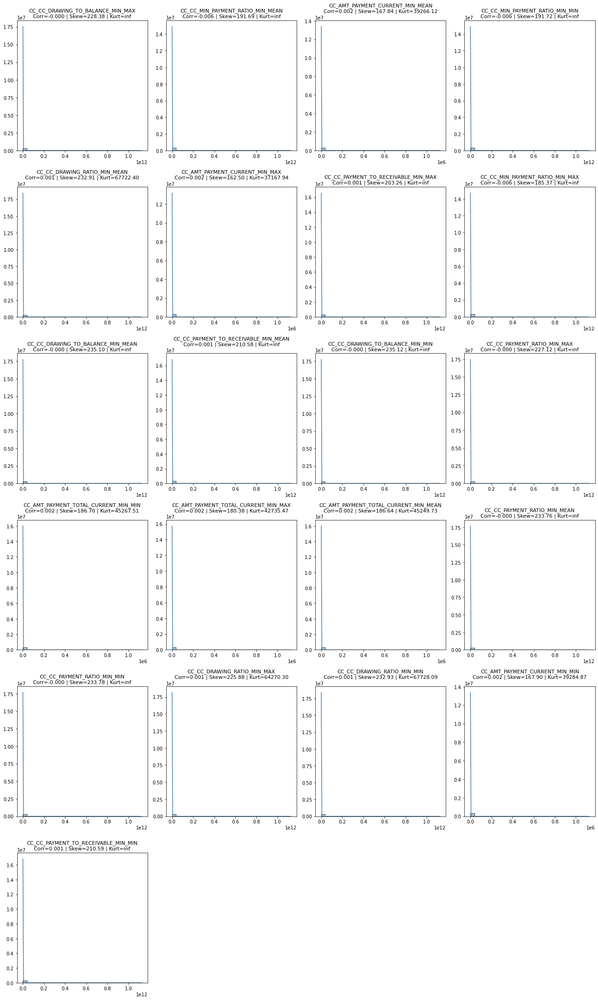

In [68]:
# Liste des transformations corrélées pour ce groupe

transfos = ['CC_CC_DRAWING_TO_BALANCE_MIN_MAX', 'CC_CC_MIN_PAYMENT_RATIO_MIN_MEAN', 
'CC_AMT_PAYMENT_CURRENT_MIN_MEAN', 'CC_CC_MIN_PAYMENT_RATIO_MIN_MIN', 'CC_CC_DRAWING_RATIO_MIN_MEAN', 
'CC_AMT_PAYMENT_CURRENT_MIN_MAX', 'CC_CC_PAYMENT_TO_RECEIVABLE_MIN_MAX', 'CC_CC_MIN_PAYMENT_RATIO_MIN_MAX',
'CC_CC_DRAWING_TO_BALANCE_MIN_MEAN', 'CC_CC_PAYMENT_TO_RECEIVABLE_MIN_MEAN', 'CC_CC_DRAWING_TO_BALANCE_MIN_MIN', 
'CC_CC_PAYMENT_RATIO_MIN_MAX', 'CC_AMT_PAYMENT_TOTAL_CURRENT_MIN_MIN', 'CC_AMT_PAYMENT_TOTAL_CURRENT_MIN_MAX', 
'CC_AMT_PAYMENT_TOTAL_CURRENT_MIN_MEAN', 'CC_CC_PAYMENT_RATIO_MIN_MEAN', 'CC_CC_PAYMENT_RATIO_MIN_MIN', 
'CC_CC_DRAWING_RATIO_MIN_MAX', 'CC_CC_DRAWING_RATIO_MIN_MIN', 'CC_AMT_PAYMENT_CURRENT_MIN_MIN', 
'CC_CC_PAYMENT_TO_RECEIVABLE_MIN_MIN']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\core\_methods.py:118: RuntimeWarning:

overflow encountered in reduce

c:\Users\Caomghin\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1076: RuntimeWarning:

overflow encountered in square

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\core\_methods.py:118: RuntimeWarning:

overflow encountered in reduce

c:\Users\Caomghin\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1076: RuntimeWarning:

overflow encountered in square

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\core\_methods.py:118: RuntimeWarning:

overflow encountered in reduce

c:\Users\Caomghin\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1076: RuntimeWarning:

overflow encountered in square



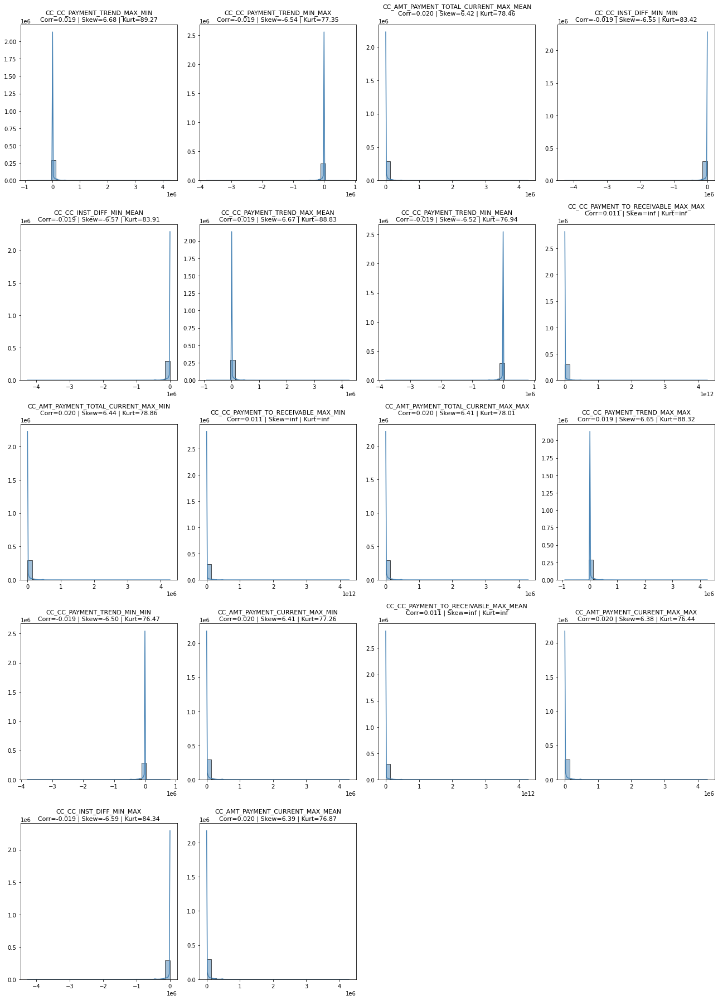

In [69]:
# Liste des transformations corrélées pour ce groupe

transfos = ['CC_CC_PAYMENT_TREND_MAX_MIN', 'CC_CC_PAYMENT_TREND_MIN_MAX', 'CC_AMT_PAYMENT_TOTAL_CURRENT_MAX_MEAN',
'CC_CC_INST_DIFF_MIN_MIN', 'CC_CC_INST_DIFF_MIN_MEAN', 'CC_CC_PAYMENT_TREND_MAX_MEAN', 
'CC_CC_PAYMENT_TREND_MIN_MEAN', 'CC_CC_PAYMENT_TO_RECEIVABLE_MAX_MAX', 'CC_AMT_PAYMENT_TOTAL_CURRENT_MAX_MIN', 
'CC_CC_PAYMENT_TO_RECEIVABLE_MAX_MIN', 'CC_AMT_PAYMENT_TOTAL_CURRENT_MAX_MAX', 'CC_CC_PAYMENT_TREND_MAX_MAX', 
'CC_CC_PAYMENT_TREND_MIN_MIN', 'CC_AMT_PAYMENT_CURRENT_MAX_MIN', 'CC_CC_PAYMENT_TO_RECEIVABLE_MAX_MEAN', 
'CC_AMT_PAYMENT_CURRENT_MAX_MAX', 'CC_CC_INST_DIFF_MIN_MAX', 'CC_AMT_PAYMENT_CURRENT_MAX_MEAN']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

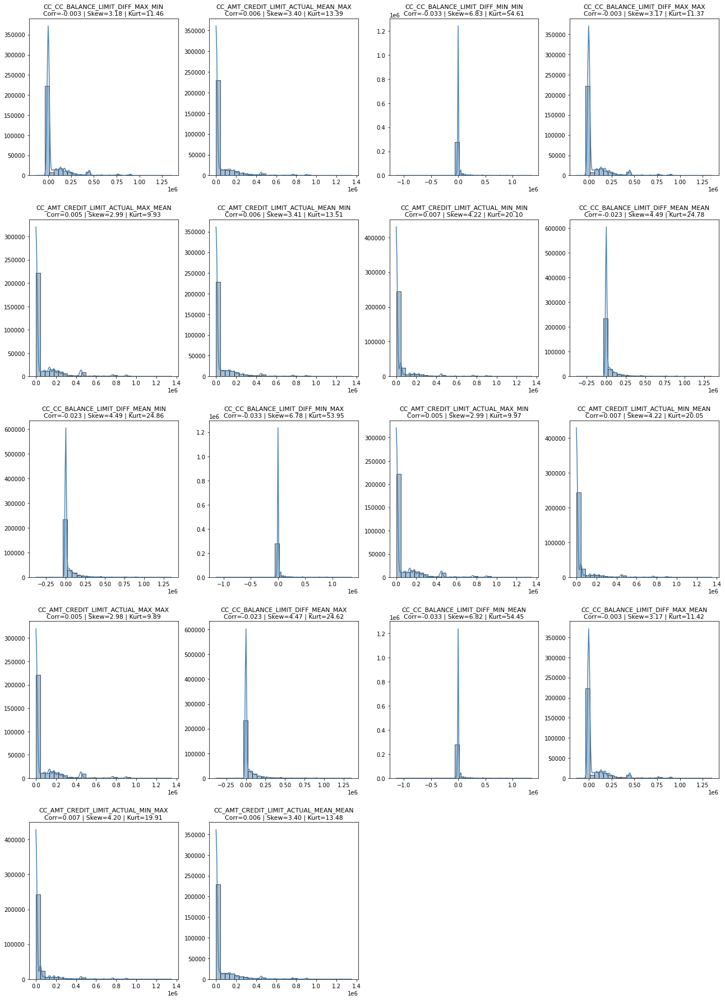

In [70]:
# Liste des transformations corrélées pour ce groupe

transfos = ['CC_CC_BALANCE_LIMIT_DIFF_MAX_MIN', 'CC_AMT_CREDIT_LIMIT_ACTUAL_MEAN_MAX', 'CC_CC_BALANCE_LIMIT_DIFF_MIN_MIN',
'CC_CC_BALANCE_LIMIT_DIFF_MAX_MAX', 'CC_AMT_CREDIT_LIMIT_ACTUAL_MAX_MEAN', 'CC_AMT_CREDIT_LIMIT_ACTUAL_MEAN_MIN', 
'CC_AMT_CREDIT_LIMIT_ACTUAL_MIN_MIN', 'CC_CC_BALANCE_LIMIT_DIFF_MEAN_MEAN', 'CC_CC_BALANCE_LIMIT_DIFF_MEAN_MIN', 
'CC_CC_BALANCE_LIMIT_DIFF_MIN_MAX', 'CC_AMT_CREDIT_LIMIT_ACTUAL_MAX_MIN', 'CC_AMT_CREDIT_LIMIT_ACTUAL_MIN_MEAN', 
'CC_AMT_CREDIT_LIMIT_ACTUAL_MAX_MAX', 'CC_CC_BALANCE_LIMIT_DIFF_MEAN_MAX', 'CC_CC_BALANCE_LIMIT_DIFF_MIN_MEAN', 
'CC_CC_BALANCE_LIMIT_DIFF_MAX_MEAN', 'CC_AMT_CREDIT_LIMIT_ACTUAL_MIN_MAX', 'CC_AMT_CREDIT_LIMIT_ACTUAL_MEAN_MEAN']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

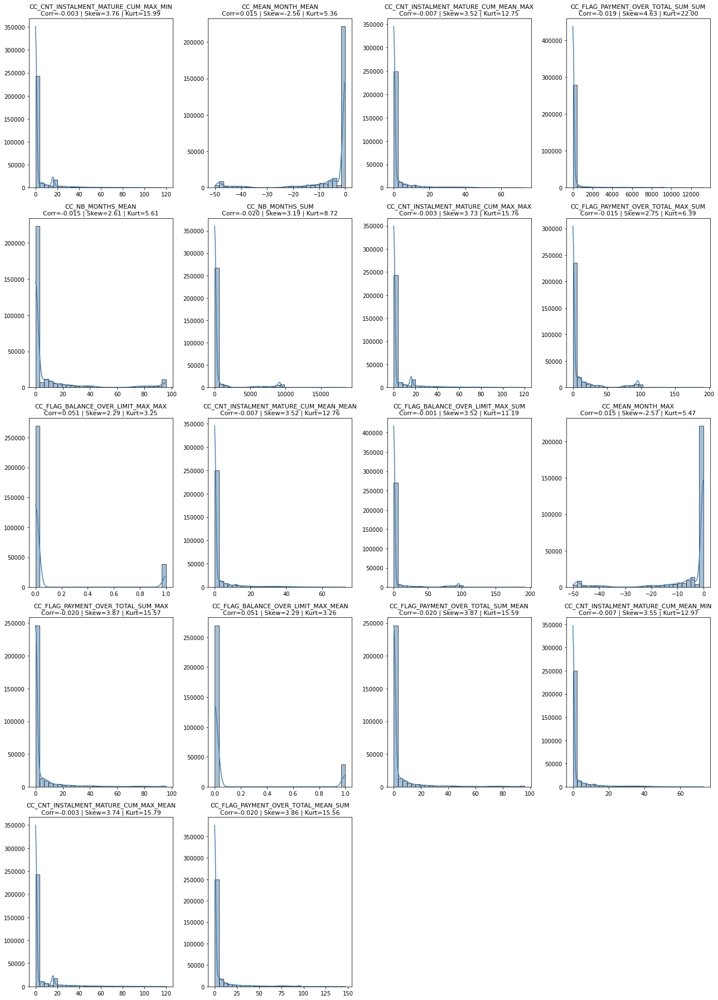

In [71]:
# Liste des transformations corrélées pour ce groupe

transfos = ['CC_CNT_INSTALMENT_MATURE_CUM_MAX_MIN', 'CC_MEAN_MONTH_MEAN', 'CC_CNT_INSTALMENT_MATURE_CUM_MEAN_MAX',
'CC_FLAG_PAYMENT_OVER_TOTAL_SUM_SUM', 'CC_NB_MONTHS_MEAN', 'CC_NB_MONTHS_SUM', 
'CC_CNT_INSTALMENT_MATURE_CUM_MAX_MAX', 'CC_FLAG_PAYMENT_OVER_TOTAL_MAX_SUM', 'CC_FLAG_BALANCE_OVER_LIMIT_MAX_MAX', 
'CC_CNT_INSTALMENT_MATURE_CUM_MEAN_MEAN', 'CC_FLAG_BALANCE_OVER_LIMIT_MAX_SUM', 'CC_MEAN_MONTH_MAX', 
'CC_FLAG_PAYMENT_OVER_TOTAL_SUM_MAX', 'CC_FLAG_BALANCE_OVER_LIMIT_MAX_MEAN', 'CC_FLAG_PAYMENT_OVER_TOTAL_SUM_MEAN', 
'CC_CNT_INSTALMENT_MATURE_CUM_MEAN_MIN', 'CC_CNT_INSTALMENT_MATURE_CUM_MAX_MEAN', 'CC_FLAG_PAYMENT_OVER_TOTAL_MEAN_SUM']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

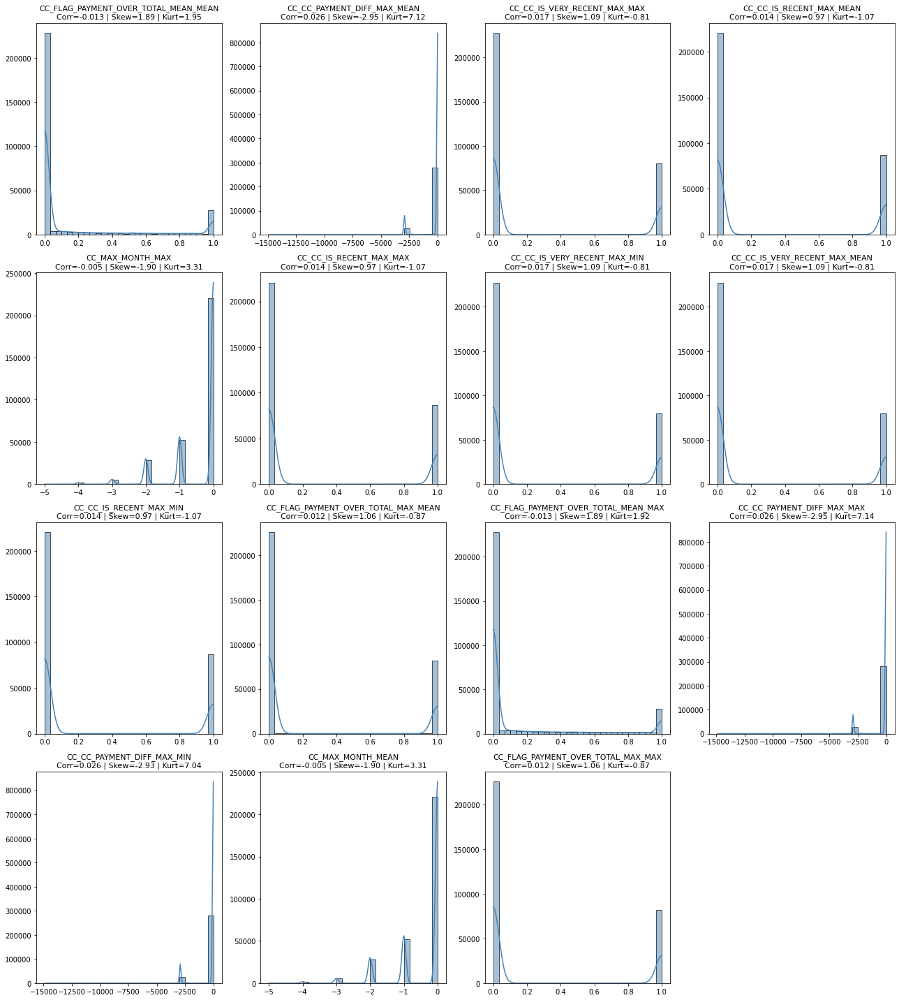

In [72]:
# Liste des transformations corrélées pour ce groupe

transfos = ['CC_FLAG_PAYMENT_OVER_TOTAL_MEAN_MEAN', 'CC_CC_PAYMENT_DIFF_MAX_MEAN', 'CC_CC_IS_VERY_RECENT_MAX_MAX',
'CC_CC_IS_RECENT_MAX_MEAN', 'CC_MAX_MONTH_MAX', 'CC_CC_IS_RECENT_MAX_MAX', 'CC_CC_IS_VERY_RECENT_MAX_MIN', 
'CC_CC_IS_VERY_RECENT_MAX_MEAN', 'CC_CC_IS_RECENT_MAX_MIN', 'CC_FLAG_PAYMENT_OVER_TOTAL_MAX_MEAN', 
'CC_FLAG_PAYMENT_OVER_TOTAL_MEAN_MAX', 'CC_CC_PAYMENT_DIFF_MAX_MAX', 'CC_CC_PAYMENT_DIFF_MAX_MIN', 
'CC_MAX_MONTH_MEAN', 'CC_FLAG_PAYMENT_OVER_TOTAL_MAX_MAX']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

c:\Users\Caomghin\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1076: RuntimeWarning:

overflow encountered in square

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\core\_methods.py:118: RuntimeWarning:

overflow encountered in reduce

c:\Users\Caomghin\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1076: RuntimeWarning:

overflow encountered in square

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\core\_methods.py:118: RuntimeWarning:

overflow encountered in reduce

c:\Users\Caomghin\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1076: RuntimeWarning:

overflow encountered in square

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\core\_methods.py:118: RuntimeWarning:

overflow encountered in reduce

c:\Users\Caomghin\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1076: RuntimeWarning:

overflow encountered in square

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\core\_methods.py:118: RuntimeWarning:

overflow encountered in reduce

c:\U

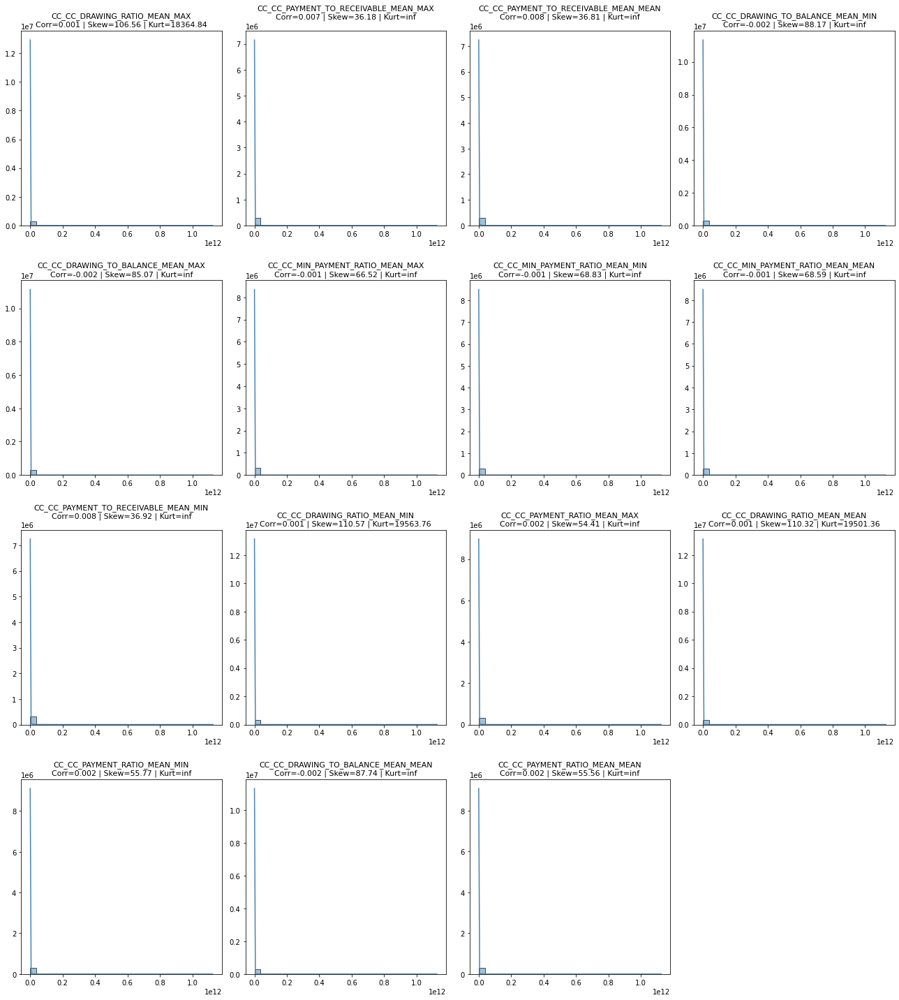

In [73]:
# Liste des transformations corrélées pour ce groupe

transfos = ['CC_CC_DRAWING_RATIO_MEAN_MAX', 'CC_CC_PAYMENT_TO_RECEIVABLE_MEAN_MAX', 'CC_CC_PAYMENT_TO_RECEIVABLE_MEAN_MEAN',
'CC_CC_DRAWING_TO_BALANCE_MEAN_MIN', 'CC_CC_DRAWING_TO_BALANCE_MEAN_MAX', 'CC_CC_MIN_PAYMENT_RATIO_MEAN_MAX', 'CC_CC_MIN_PAYMENT_RATIO_MEAN_MIN', 
'CC_CC_MIN_PAYMENT_RATIO_MEAN_MEAN', 'CC_CC_PAYMENT_TO_RECEIVABLE_MEAN_MIN', 'CC_CC_DRAWING_RATIO_MEAN_MIN', 
'CC_CC_PAYMENT_RATIO_MEAN_MAX', 'CC_CC_DRAWING_RATIO_MEAN_MEAN', 'CC_CC_PAYMENT_RATIO_MEAN_MIN', 
'CC_CC_DRAWING_TO_BALANCE_MEAN_MEAN', 'CC_CC_PAYMENT_RATIO_MEAN_MEAN']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

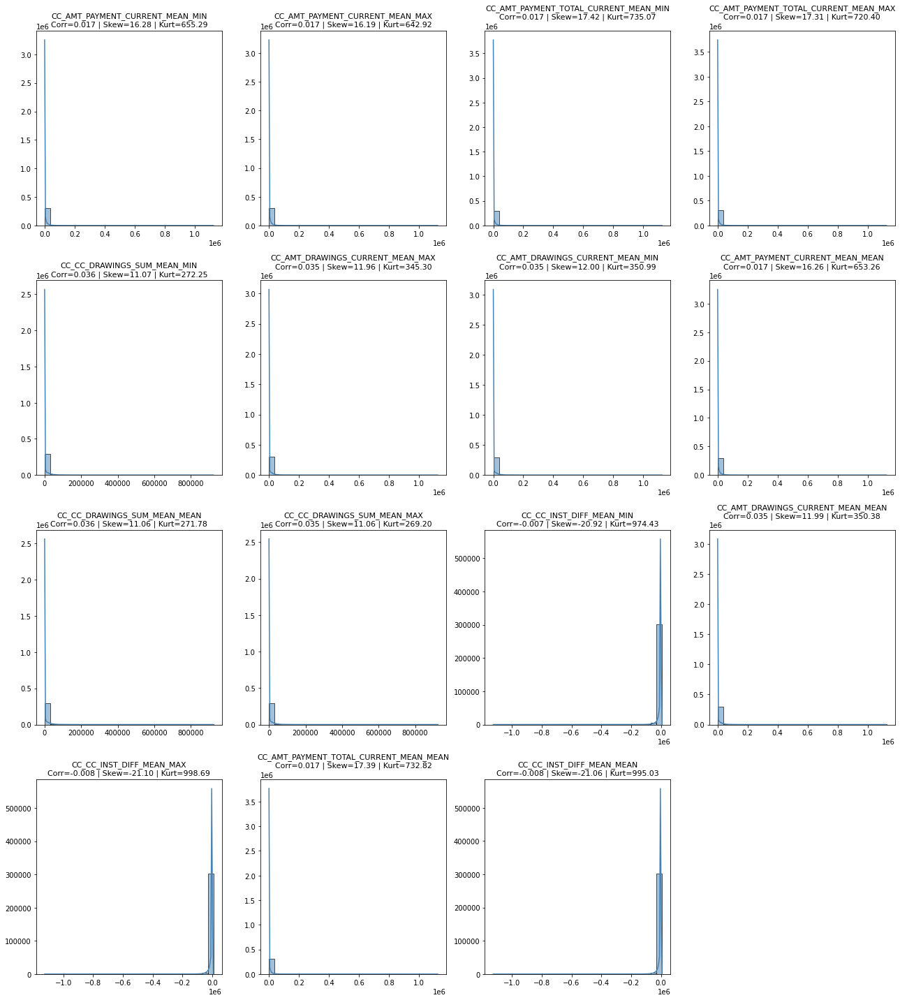

In [74]:
# Liste des transformations corrélées pour ce groupe

transfos = ['CC_AMT_PAYMENT_CURRENT_MEAN_MIN', 'CC_AMT_PAYMENT_CURRENT_MEAN_MAX', 'CC_AMT_PAYMENT_TOTAL_CURRENT_MEAN_MIN',
'CC_AMT_PAYMENT_TOTAL_CURRENT_MEAN_MAX', 'CC_CC_DRAWINGS_SUM_MEAN_MIN', 'CC_AMT_DRAWINGS_CURRENT_MEAN_MAX', 'CC_AMT_DRAWINGS_CURRENT_MEAN_MIN', 
'CC_AMT_PAYMENT_CURRENT_MEAN_MEAN', 'CC_CC_DRAWINGS_SUM_MEAN_MEAN', 'CC_CC_DRAWINGS_SUM_MEAN_MAX', 
'CC_CC_INST_DIFF_MEAN_MIN', 'CC_AMT_DRAWINGS_CURRENT_MEAN_MEAN', 'CC_CC_INST_DIFF_MEAN_MAX', 
'CC_AMT_PAYMENT_TOTAL_CURRENT_MEAN_MEAN', 'CC_CC_INST_DIFF_MEAN_MEAN']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

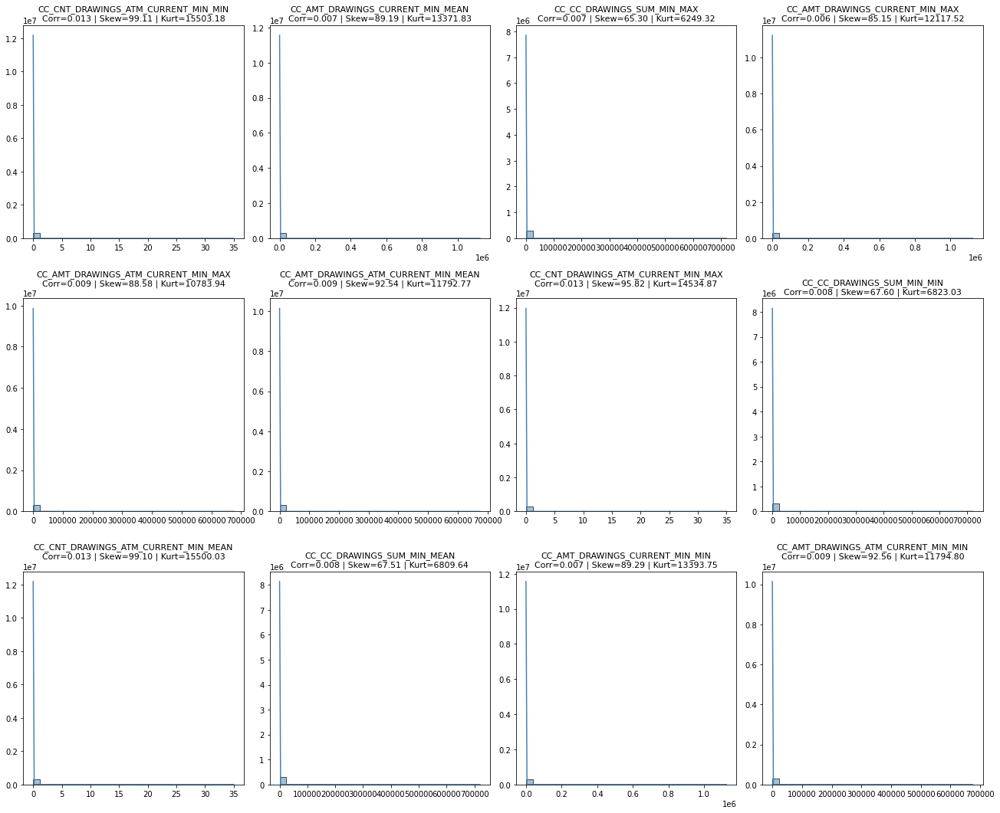

In [75]:
# Liste des transformations corrélées pour ce groupe

transfos = ['CC_CNT_DRAWINGS_ATM_CURRENT_MIN_MIN', 'CC_AMT_DRAWINGS_CURRENT_MIN_MEAN', 'CC_CC_DRAWINGS_SUM_MIN_MAX',
'CC_AMT_DRAWINGS_CURRENT_MIN_MAX', 'CC_AMT_DRAWINGS_ATM_CURRENT_MIN_MAX', 'CC_AMT_DRAWINGS_ATM_CURRENT_MIN_MEAN', 'CC_CNT_DRAWINGS_ATM_CURRENT_MIN_MAX', 
'CC_CC_DRAWINGS_SUM_MIN_MIN', 'CC_CNT_DRAWINGS_ATM_CURRENT_MIN_MEAN', 'CC_CC_DRAWINGS_SUM_MIN_MEAN', 
'CC_AMT_DRAWINGS_CURRENT_MIN_MIN', 'CC_AMT_DRAWINGS_ATM_CURRENT_MIN_MIN']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

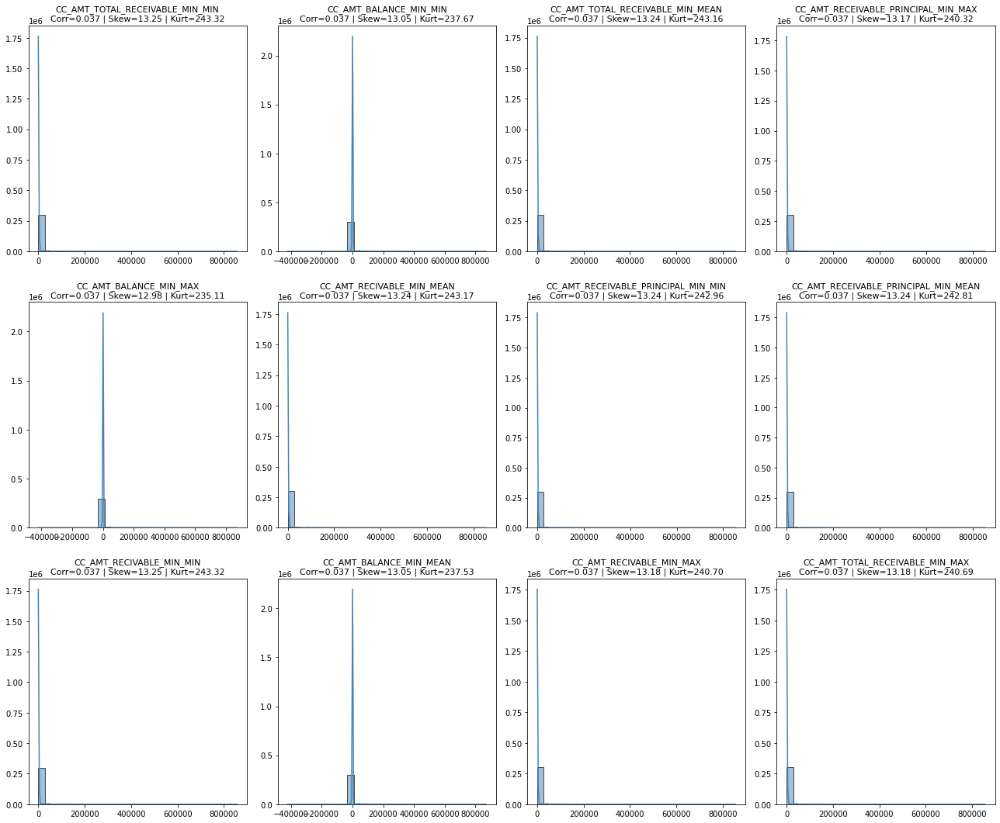

In [76]:
# Liste des transformations corrélées pour ce groupe

transfos = ['CC_AMT_TOTAL_RECEIVABLE_MIN_MIN', 'CC_AMT_BALANCE_MIN_MIN', 'CC_AMT_TOTAL_RECEIVABLE_MIN_MEAN',
'CC_AMT_RECEIVABLE_PRINCIPAL_MIN_MAX', 'CC_AMT_BALANCE_MIN_MAX', 'CC_AMT_RECIVABLE_MIN_MEAN', 'CC_AMT_RECEIVABLE_PRINCIPAL_MIN_MIN', 
'CC_AMT_RECEIVABLE_PRINCIPAL_MIN_MEAN', 'CC_AMT_RECIVABLE_MIN_MIN', 'CC_AMT_BALANCE_MIN_MEAN', 
'CC_AMT_RECIVABLE_MIN_MAX', 'CC_AMT_TOTAL_RECEIVABLE_MIN_MAX']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

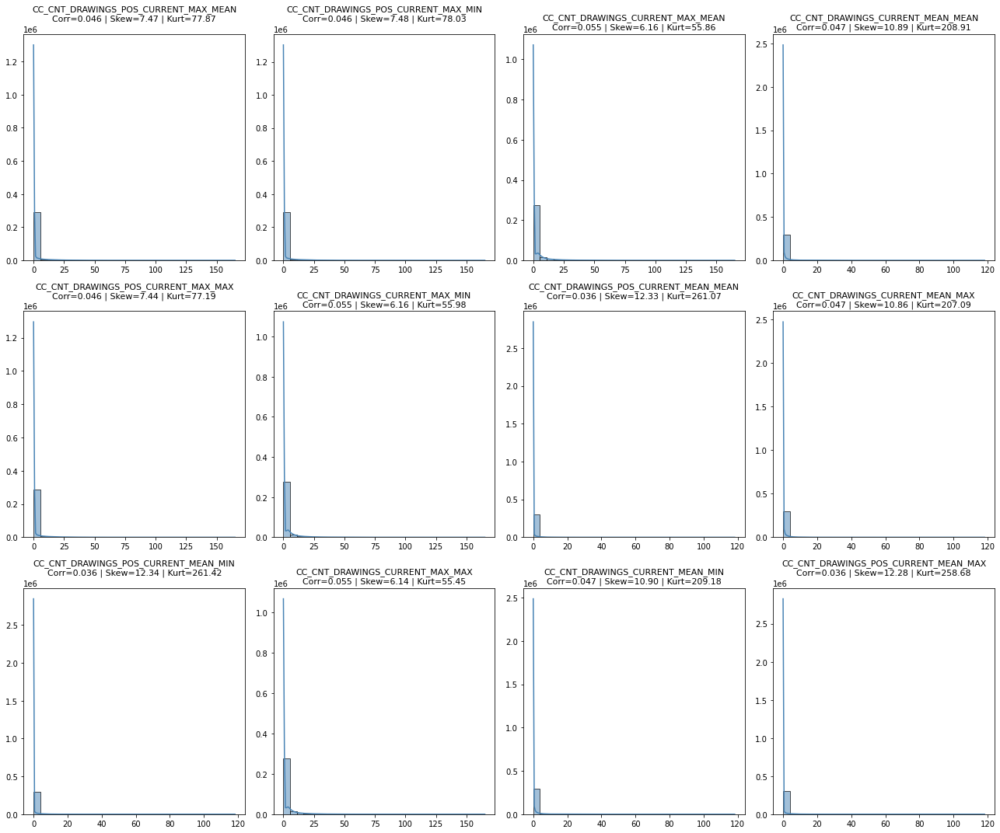

In [77]:
# Liste des transformations corrélées pour ce groupe

transfos = ['CC_CNT_DRAWINGS_POS_CURRENT_MAX_MEAN', 'CC_CNT_DRAWINGS_POS_CURRENT_MAX_MIN', 'CC_CNT_DRAWINGS_CURRENT_MAX_MEAN',
'CC_CNT_DRAWINGS_CURRENT_MEAN_MEAN', 'CC_CNT_DRAWINGS_POS_CURRENT_MAX_MAX', 'CC_CNT_DRAWINGS_CURRENT_MAX_MIN', 'CC_CNT_DRAWINGS_POS_CURRENT_MEAN_MEAN', 
'CC_CNT_DRAWINGS_CURRENT_MEAN_MAX', 'CC_CNT_DRAWINGS_POS_CURRENT_MEAN_MIN', 'CC_CNT_DRAWINGS_CURRENT_MAX_MAX', 
'CC_CNT_DRAWINGS_CURRENT_MEAN_MIN', 'CC_CNT_DRAWINGS_POS_CURRENT_MEAN_MAX']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

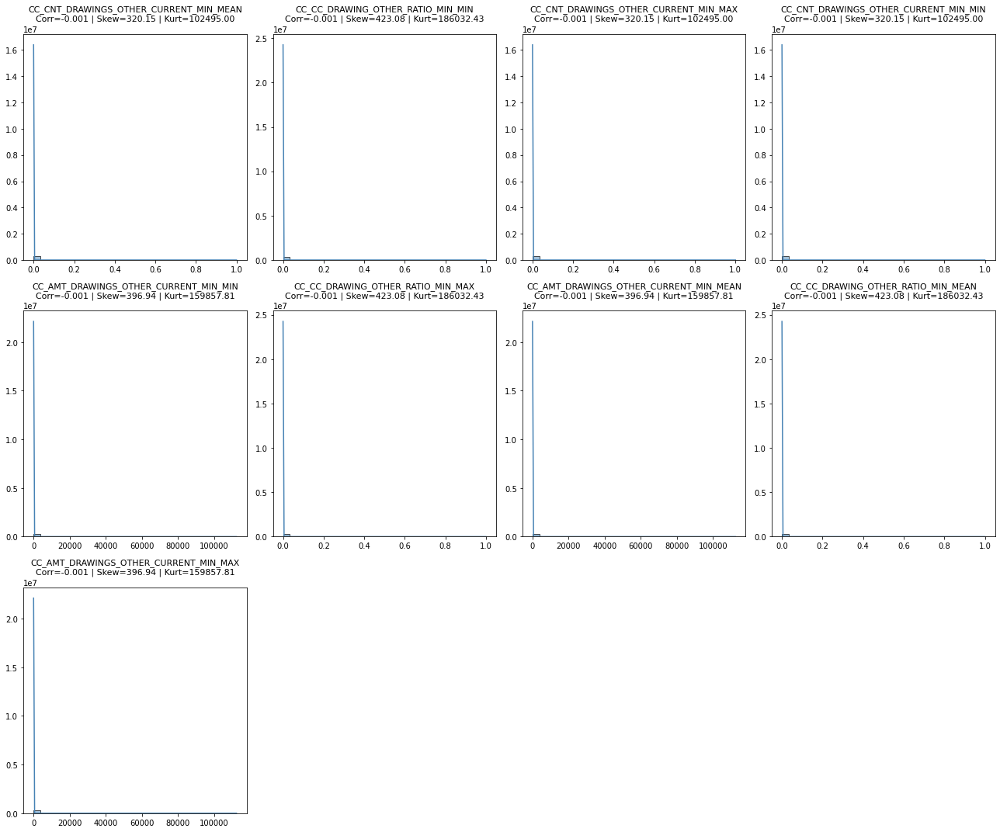

In [78]:
# Liste des transformations corrélées pour ce groupe

transfos = ['CC_CNT_DRAWINGS_OTHER_CURRENT_MIN_MEAN', 'CC_CC_DRAWING_OTHER_RATIO_MIN_MIN', 'CC_CNT_DRAWINGS_OTHER_CURRENT_MIN_MAX',
'CC_CNT_DRAWINGS_OTHER_CURRENT_MIN_MIN', 'CC_AMT_DRAWINGS_OTHER_CURRENT_MIN_MIN', 'CC_CC_DRAWING_OTHER_RATIO_MIN_MAX', 'CC_AMT_DRAWINGS_OTHER_CURRENT_MIN_MEAN', 
'CC_CC_DRAWING_OTHER_RATIO_MIN_MEAN', 'CC_AMT_DRAWINGS_OTHER_CURRENT_MIN_MAX']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

- On a comparé quelques groupes de corrélations mais la liste étant très longue, on fera nos choix avec les groupes de corrélation en prenant en compte la variable la mieux corrélée avec la TARGET.

In [79]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

# Variables à garder
vars_best = set(sum_corr_grps_med_mode_linear["Variable la plus corrélée"].tolist())

vars_corr_groups = set()
for var in sum_corr_grps_med_mode_linear["Variables du groupe"]:
    vars_corr_groups.update(var)

# Variables à supprimer
vars_to_remove_med_mode_linear = list(vars_corr_groups - vars_best)

# Variable restante après agrégation
all_vars = df_train_median_mode_linear[df_cc_train_median_mode_linear_agg.columns].columns.tolist()

vars_not_in_corr_groups = set(all_vars) - vars_corr_groups
vars_to_keep = list(vars_best.union(vars_not_in_corr_groups))

df_train_median_mode_linear.drop(columns=vars_to_remove_med_mode_linear, inplace=True, errors="ignore")

In [80]:
remaining_cols = list(set(df_cc_train_median_mode_linear_agg.columns).intersection(df_train_median_mode_linear.columns))

In [81]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_train_median_mode_linear[remaining_cols], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation


In [82]:
# Réduction de la taille du dataframe.

optimize_types(df_train_median_mode_linear)

 Mémoire avant : 583.66 MB
 Mémoire après : 541.43 MB
 Gain : 7.2%


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_ANNUITY,REGION_POPULATION_RELATIVE,OWN_CAR_AGE,FLAG_MOBIL,...,CC_CC_IS_VERY_RECENT_MIN_MIN,CC_CC_BALANCE_TREND_MEAN_MAX,CC_CC_PAYMENT_TREND_MEAN_MAX,CC_CC_DRAWING_TREND_MEAN_MAX,CC_CC_BALANCE_PCT_CHANGE_MAX_MEAN,CC_CC_BALANCE_PCT_CHANGE_MIN_MAX,CC_CC_PAYMENT_PCT_CHANGE_MEAN_MIN,CC_CC_PAYMENT_PCT_CHANGE_MIN_MAX,CC_CC_PAYMENT_CUMSUM_MEAN_MAX,CC_CC_PAYMENT_CUMSUM_MIN_MAX
0,100002,1,0,1,0,1,24700.5,0.018801,9,1,...,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,100003,0,0,0,0,0,35698.5,0.003541,9,1,...,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,1,1,1,1,6750.0,0.010032,26,1,...,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,100006,0,0,0,0,1,29686.5,0.008019,9,1,...,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,100007,0,0,1,0,1,21865.5,0.028663,9,1,...,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307495,456251,0,0,1,0,0,27558.0,0.032561,9,1,...,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
307496,456252,0,0,0,0,1,12001.5,0.025164,9,1,...,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
307497,456253,0,0,0,0,1,29979.0,0.005002,9,1,...,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
307498,456254,1,0,0,0,1,20205.0,0.005313,9,1,...,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


#### Corrélation des variables - df_train_median_missing_linear

In [83]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_median_missing_linear[df_cc_train_median_missing_linear_agg.columns.tolist()], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,CC_AMT_INST_MIN_REGULARITY_MIN_MAX / CC_AMT_INST_MIN_REGULARITY_MIN_MEAN,CC_AMT_INST_MIN_REGULARITY_MIN_MEAN,CC_AMT_INST_MIN_REGULARITY_MIN_MAX,1.000000
1,CC_AMT_INST_MIN_REGULARITY_MIN_MEAN / CC_AMT_INST_MIN_REGULARITY_MIN_MIN,CC_AMT_INST_MIN_REGULARITY_MIN_MEAN,CC_AMT_INST_MIN_REGULARITY_MIN_MIN,1.000000
2,CC_CC_BALANCE_PCT_CHANGE_MIN_MEAN / CC_CC_BALANCE_PCT_CHANGE_MIN_MIN,CC_CC_BALANCE_PCT_CHANGE_MIN_MEAN,CC_CC_BALANCE_PCT_CHANGE_MIN_MIN,1.000000
3,CC_CC_BALANCE_PCT_CHANGE_MIN_MAX / CC_CC_BALANCE_PCT_CHANGE_MIN_MEAN,CC_CC_BALANCE_PCT_CHANGE_MIN_MEAN,CC_CC_BALANCE_PCT_CHANGE_MIN_MAX,1.000000
4,CC_CC_BALANCE_PCT_CHANGE_MIN_MAX / CC_CC_BALANCE_PCT_CHANGE_MIN_MIN,CC_CC_BALANCE_PCT_CHANGE_MIN_MAX,CC_CC_BALANCE_PCT_CHANGE_MIN_MIN,1.000000
5,CC_CC_BALANCE_TO_RECEIVABLE_MIN_MEAN / CC_CC_BALANCE_TO_RECEIVABLE_MIN_MIN,CC_CC_BALANCE_TO_RECEIVABLE_MIN_MEAN,CC_CC_BALANCE_TO_RECEIVABLE_MIN_MIN,1.000000
6,CC_CC_PAYMENT_PCT_CHANGE_MIN_MEAN / CC_CC_PAYMENT_PCT_CHANGE_MIN_MIN,CC_CC_PAYMENT_PCT_CHANGE_MIN_MEAN,CC_CC_PAYMENT_PCT_CHANGE_MIN_MIN,1.000000
7,CC_AMT_RECIVABLE_MIN_MIN / CC_AMT_TOTAL_RECEIVABLE_MIN_MIN,CC_AMT_RECIVABLE_MIN_MIN,CC_AMT_TOTAL_RECEIVABLE_MIN_MIN,1.000000
8,CC_AMT_RECIVABLE_MIN_MEAN / CC_AMT_TOTAL_RECEIVABLE_MIN_MEAN,CC_AMT_RECIVABLE_MIN_MEAN,CC_AMT_TOTAL_RECEIVABLE_MIN_MEAN,1.000000
9,CC_AMT_RECIVABLE_MIN_MAX / CC_AMT_TOTAL_RECEIVABLE_MIN_MAX,CC_AMT_RECIVABLE_MIN_MAX,CC_AMT_TOTAL_RECEIVABLE_MIN_MAX,1.000000


In [84]:
df_corr = get_correlation_pairs(df_train_median_missing_linear[df_cc_train_median_missing_linear_agg.columns.tolist()], method="pearson", style=False, threshold=0.8)

In [85]:
var_corr = df_corr['Variable 1'].unique().tolist() + df_corr['Variable 2'].unique().tolist()
var_corr = list(set(var_corr))

In [86]:
# Visualisation des corrélations les plus importantes avec la Target.

pd.set_option('display.max_rows', None)

target_corr = compute_target_correlations(df_train_median_missing_linear.loc[:, var_corr + ['TARGET']], 'TARGET', mode='linear', plot=False)
target_corr.loc[var_corr].sort_values(by='pearson_corr', ascending=False)

,pearson_corr,spearman_corr,abs_pearson,abs_spearman,score_global
CC_FLAG_BALANCE_OVER_LIMIT_MEAN_MAX,0.081449,0.055476,0.081449,0.055476,0.068462
CC_FLAG_BALANCE_OVER_LIMIT_MEAN_MEAN,0.081217,0.055446,0.081217,0.055446,0.068331
CC_CNT_DRAWINGS_ATM_CURRENT_MEAN_MAX,0.064878,0.045894,0.064878,0.045894,0.055386
CC_CNT_DRAWINGS_ATM_CURRENT_MEAN_MEAN,0.064781,0.045839,0.064781,0.045839,0.055310
CC_CNT_DRAWINGS_ATM_CURRENT_MEAN_MIN,0.064745,0.045830,0.064745,0.045830,0.055287
CC_CC_DRAWING_ATM_RATIO_MEAN_MAX,0.059115,0.044420,0.059115,0.044420,0.051768
CC_CC_DRAWING_ATM_RATIO_MEAN_MEAN,0.058866,0.044376,0.058866,0.044376,0.051621
CC_CC_DRAWING_ATM_RATIO_MEAN_MIN,0.058856,0.044382,0.058856,0.044382,0.051619
CC_CNT_DRAWINGS_CURRENT_MAX_MAX,0.055465,0.042997,0.055465,0.042997,0.049231
CC_CNT_DRAWINGS_CURRENT_MAX_MEAN,0.055246,0.042947,0.055246,0.042947,0.049097


In [87]:
pd.reset_option('display.max_rows')

In [88]:
# Fonction permettant de visualiser les groupes de corrélations afin de faire un choix de variable.

pd.set_option('display.max_colwidth', None)
sum_corr_grps_med_miss_linear = summarize_correlated_groups(df_corr, X=df_train_median_missing_linear, y=df_train_median_missing_linear['TARGET'])
sum_corr_grps_med_miss_linear

,Variables du groupe,Taille du groupe,Corrélation max avec y,Variable la plus corrélée
0,"[CC_AMT_DRAWINGS_CURRENT_MAX_MIN, CC_AMT_RECIVABLE_MEAN_MIN, CC_AMT_INST_MIN_REGULARITY_MAX_MIN, CC_CC_BALANCE_TREND_MAX_MEAN, CC_CC_BALANCE_CUMSUM_MAX_MAX, CC_CC_RECEIVABLE_DIFF_MEAN_MEAN, CC_CC_DRAWINGS_SUM_MAX_MIN, CC_AMT_RECEIVABLE_PRINCIPAL_MAX_MIN, CC_CC_DRAWING_TREND_MIN_MEAN, CC_CC_DRAWING_TREND_MIN_MIN, CC_AMT_RECIVABLE_MAX_MEAN, CC_CC_BALANCE_CUMSUM_MAX_MIN, CC_CC_RECEIVABLE_DIFF_MAX_MEAN, CC_AMT_RECEIVABLE_PRINCIPAL_MEAN_MAX, CC_AMT_INST_MIN_REGULARITY_MEAN_MEAN, CC_CC_DRAWINGS_SUM_MAX_MEAN, CC_CC_BALANCE_TREND_MAX_MAX, CC_CC_RECEIVABLE_DIFF_MEAN_MAX, CC_AMT_INST_MIN_REGULARITY_MEAN_MIN, CC_AMT_INST_MIN_REGULARITY_MAX_MAX, CC_CC_BALANCE_CUMSUM_MAX_MEAN, CC_CC_BALANCE_CUMSUM_MEAN_MIN, CC_AMT_BALANCE_MEAN_MIN, CC_AMT_INST_MIN_REGULARITY_MAX_MEAN, CC_CC_BALANCE_TREND_MAX_MIN, CC_CC_BALANCE_CUMSUM_MIN_MIN, CC_AMT_RECIVABLE_MEAN_MEAN, CC_AMT_RECEIVABLE_PRINCIPAL_MAX_MAX, CC_CC_BALANCE_TREND_MIN_MEAN, CC_CC_DRAWING_TREND_MAX_MIN, CC_CC_BALANCE_CUMSUM_MEAN_MEAN, CC_AMT_RECIVABLE_MEAN_MAX, CC_AMT_BALANCE_MAX_MAX, CC_AMT_TOTAL_RECEIVABLE_MEAN_MIN, CC_CC_DRAWING_TREND_MAX_MAX, CC_CC_BALANCE_CUMSUM_MEAN_MAX, CC_AMT_BALANCE_MEAN_MEAN, CC_AMT_TOTAL_RECEIVABLE_MAX_MEAN, CC_AMT_BALANCE_MAX_MEAN, CC_CC_BALANCE_CUMSUM_MIN_MAX, CC_AMT_DRAWINGS_ATM_CURRENT_MAX_MIN, CC_AMT_INST_MIN_REGULARITY_MEAN_MAX, CC_AMT_DRAWINGS_ATM_CURRENT_MAX_MEAN, CC_AMT_BALANCE_MEAN_MAX, CC_AMT_RECEIVABLE_PRINCIPAL_MEAN_MIN, CC_AMT_TOTAL_RECEIVABLE_MEAN_MEAN, CC_CC_BALANCE_TREND_MIN_MIN, CC_CC_BALANCE_TREND_MIN_MAX, CC_AMT_BALANCE_MAX_MIN, CC_AMT_DRAWINGS_ATM_CURRENT_MAX_MAX, CC_CC_DRAWING_TREND_MIN_MAX, CC_CC_DRAWING_TREND_MAX_MEAN, CC_AMT_DRAWINGS_CURRENT_MAX_MEAN, CC_AMT_RECEIVABLE_PRINCIPAL_MEAN_MEAN, CC_AMT_RECEIVABLE_PRINCIPAL_MAX_MEAN, CC_AMT_TOTAL_RECEIVABLE_MAX_MIN, CC_AMT_TOTAL_RECEIVABLE_MEAN_MAX, CC_CC_BALANCE_CUMSUM_MIN_MEAN, CC_CC_DRAWINGS_SUM_MAX_MAX, CC_AMT_TOTAL_RECEIVABLE_MAX_MAX, CC_AMT_RECIVABLE_MAX_MAX, CC_CC_RECEIVABLE_DIFF_MAX_MAX, CC_AMT_DRAWINGS_CURRENT_MAX_MAX, CC_CC_RECEIVABLE_DIFF_MEAN_MIN, CC_CC_RECEIVABLE_DIFF_MAX_MIN, CC_AMT_RECIVABLE_MAX_MIN]",66,0.049605,CC_CC_RECEIVABLE_DIFF_MEAN_MAX
1,"[CC_CC_MIN_PAYMENT_RATIO_MIN_MIN, CC_AMT_PAYMENT_TOTAL_CURRENT_MIN_MEAN, CC_CC_PAYMENT_TO_RECEIVABLE_MIN_MIN, CC_CC_PAYMENT_RATIO_MIN_MEAN, CC_CC_DRAWING_TO_BALANCE_MIN_MIN, CC_AMT_PAYMENT_CURRENT_MIN_MAX, CC_CC_PAYMENT_TO_RECEIVABLE_MIN_MAX, CC_AMT_PAYMENT_CURRENT_MIN_MIN, CC_CC_DRAWING_RATIO_MIN_MIN, CC_CC_DRAWING_RATIO_MIN_MAX, CC_AMT_PAYMENT_TOTAL_CURRENT_MIN_MIN, CC_CC_PAYMENT_RATIO_MIN_MAX, CC_CC_DRAWING_TO_BALANCE_MIN_MEAN, CC_CC_DRAWING_RATIO_MIN_MEAN, CC_CC_MIN_PAYMENT_RATIO_MIN_MAX, CC_CC_PAYMENT_RATIO_MIN_MIN, CC_CC_PAYMENT_TO_RECEIVABLE_MIN_MEAN, CC_AMT_PAYMENT_CURRENT_MIN_MEAN, CC_CC_MIN_PAYMENT_RATIO_MIN_MEAN, CC_AMT_PAYMENT_TOTAL_CURRENT_MIN_MAX, CC_CC_DRAWING_TO_BALANCE_MIN_MAX]",21,0.005597,CC_CC_MIN_PAYMENT_RATIO_MIN_MAX
2,"[CC_AMT_PAYMENT_CURRENT_MAX_MEAN, CC_AMT_PAYMENT_TOTAL_CURRENT_MAX_MEAN, CC_AMT_PAYMENT_CURRENT_MAX_MAX, CC_AMT_PAYMENT_TOTAL_CURRENT_MAX_MIN, CC_AMT_PAYMENT_TOTAL_CURRENT_MAX_MAX, CC_CC_PAYMENT_TREND_MAX_MAX, CC_CC_INST_DIFF_MIN_MEAN, CC_CC_PAYMENT_TREND_MAX_MEAN, CC_CC_PAYMENT_TREND_MIN_MEAN, CC_CC_PAYMENT_TREND_MIN_MAX, CC_CC_PAYMENT_TO_RECEIVABLE_MAX_MAX, CC_CC_PAYMENT_TO_RECEIVABLE_MAX_MEAN, CC_AMT_PAYMENT_CURRENT_MAX_MIN, CC_CC_PAYMENT_TREND_MAX_MIN, CC_CC_INST_DIFF_MIN_MIN, CC_CC_PAYMENT_TREND_MIN_MIN, CC_CC_PAYMENT_TO_RECEIVABLE_MAX_MIN, CC_CC_INST_DIFF_MIN_MAX]",18,0.020273,CC_AMT_PAYMENT_CURRENT_MAX_MAX
3,"[CC_AMT_CREDIT_LIMIT_ACTUAL_MIN_MEAN, CC_CC_BALANCE_LIMIT_DIFF_MEAN_MEAN, CC_AMT_CREDIT_LIMIT_ACTUAL_MEAN_MIN, CC_CC_BALANCE_LIMIT_DIFF_MAX_MAX, CC_AMT_CREDIT_LIMIT_ACTUAL_MEAN_MEAN, CC_CC_BALANCE_LIMIT_DIFF_MIN_MEAN, CC_CC_BALANCE_LIMIT_DIFF_MEAN_MAX, CC_CC_BALANCE_LIMIT_DIFF_MAX_MEAN, CC_CC_BALANCE_LIMIT_DIFF_MAX_MIN, CC_AMT_CREDIT_LIMIT_ACTUAL_MAX_MIN, CC_CC_BALANCE_LIMIT_DIFF_MIN_MAX, CC_AMT_CREDIT_LIM

In [89]:
pd.reset_option('display.max_colwidth')

In [90]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

# Variables à garder
vars_best = set(sum_corr_grps_med_miss_linear["Variable la plus corrélée"].tolist())

vars_corr_groups = set()
for var in sum_corr_grps_med_miss_linear["Variables du groupe"]:
    vars_corr_groups.update(var)

# Variables à supprimer
vars_to_remove_med_miss_linear = list(vars_corr_groups - vars_best)

# Variable restante après agrégation
all_vars = df_train_median_missing_linear[df_cc_train_median_missing_linear_agg.columns].columns.tolist()

vars_not_in_corr_groups = set(all_vars) - vars_corr_groups
vars_to_keep = list(vars_best.union(vars_not_in_corr_groups))

df_train_median_missing_linear.drop(columns=vars_to_remove_med_miss_linear, inplace=True, errors="ignore")

In [91]:
remaining_cols = list(set(df_cc_train_median_missing_linear_agg.columns).intersection(df_train_median_missing_linear.columns))

In [92]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_train_median_missing_linear[remaining_cols], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation


In [93]:
# Réduction de la taille du dataframe.

optimize_types(df_train_median_missing_linear)

 Mémoire avant : 588.26 MB
 Mémoire après : 546.03 MB
 Gain : 7.2%


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_ANNUITY,REGION_POPULATION_RELATIVE,OWN_CAR_AGE,FLAG_MOBIL,...,CC_CC_IS_VERY_RECENT_MIN_MIN,CC_CC_BALANCE_TREND_MEAN_MAX,CC_CC_PAYMENT_TREND_MEAN_MAX,CC_CC_DRAWING_TREND_MEAN_MAX,CC_CC_BALANCE_PCT_CHANGE_MAX_MEAN,CC_CC_BALANCE_PCT_CHANGE_MIN_MAX,CC_CC_PAYMENT_PCT_CHANGE_MEAN_MIN,CC_CC_PAYMENT_PCT_CHANGE_MIN_MAX,CC_CC_PAYMENT_CUMSUM_MEAN_MAX,CC_CC_PAYMENT_CUMSUM_MIN_MAX
0,100002,1,0,1,0,1,24700.5,0.018801,9,1,...,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,100003,0,0,0,0,0,35698.5,0.003541,9,1,...,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,1,1,1,1,6750.0,0.010032,26,1,...,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,100006,0,0,0,0,1,29686.5,0.008019,9,1,...,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,100007,0,0,1,0,1,21865.5,0.028663,9,1,...,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307495,456251,0,0,1,0,0,27558.0,0.032561,9,1,...,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
307496,456252,0,0,0,0,1,12001.5,0.025164,9,1,...,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
307497,456253,0,0,0,0,1,29979.0,0.005002,9,1,...,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
307498,456254,1,0,0,0,1,20205.0,0.005313,9,1,...,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


#### Corrélation des variables - df_train_iterative_mode_linear

In [94]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_iterative_mode_linear[df_cc_train_iterative_mode_linear_agg.columns.tolist()], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,CC_FLAG_PRINCIPAL_OVER_TOTAL_MEAN_SUM / CC_FLAG_PRINCIPAL_OVER_TOTAL_SUM_MAX,CC_FLAG_PRINCIPAL_OVER_TOTAL_MEAN_SUM,CC_FLAG_PRINCIPAL_OVER_TOTAL_SUM_MAX,1.000000
1,CC_CC_BALANCE_PCT_CHANGE_MIN_MEAN / CC_CC_BALANCE_PCT_CHANGE_MIN_MIN,CC_CC_BALANCE_PCT_CHANGE_MIN_MEAN,CC_CC_BALANCE_PCT_CHANGE_MIN_MIN,1.000000
2,CC_CC_BALANCE_PCT_CHANGE_MIN_MAX / CC_CC_BALANCE_PCT_CHANGE_MIN_MEAN,CC_CC_BALANCE_PCT_CHANGE_MIN_MEAN,CC_CC_BALANCE_PCT_CHANGE_MIN_MAX,1.000000
3,CC_CC_BALANCE_PCT_CHANGE_MIN_MAX / CC_CC_BALANCE_PCT_CHANGE_MIN_MIN,CC_CC_BALANCE_PCT_CHANGE_MIN_MAX,CC_CC_BALANCE_PCT_CHANGE_MIN_MIN,1.000000
4,CC_CC_PAYMENT_PCT_CHANGE_MIN_MEAN / CC_CC_PAYMENT_PCT_CHANGE_MIN_MIN,CC_CC_PAYMENT_PCT_CHANGE_MIN_MEAN,CC_CC_PAYMENT_PCT_CHANGE_MIN_MIN,1.000000
5,CC_AMT_RECIVABLE_MEAN_MIN / CC_AMT_TOTAL_RECEIVABLE_MEAN_MIN,CC_AMT_RECIVABLE_MEAN_MIN,CC_AMT_TOTAL_RECEIVABLE_MEAN_MIN,0.999998
6,CC_AMT_RECIVABLE_MEAN_MEAN / CC_AMT_TOTAL_RECEIVABLE_MEAN_MEAN,CC_AMT_RECIVABLE_MEAN_MEAN,CC_AMT_TOTAL_RECEIVABLE_MEAN_MEAN,0.999998
7,CC_AMT_RECIVABLE_MEAN_MAX / CC_AMT_TOTAL_RECEIVABLE_MEAN_MAX,CC_AMT_RECIVABLE_MEAN_MAX,CC_AMT_TOTAL_RECEIVABLE_MEAN_MAX,0.999998
8,CC_CC_BALANCE_TO_RECEIVABLE_MIN_MEAN / CC_CC_BALANCE_TO_RECEIVABLE_MIN_MIN,CC_CC_BALANCE_TO_RECEIVABLE_MIN_MEAN,CC_CC_BALANCE_TO_RECEIVABLE_MIN_MIN,0.999997
9,CC_FLAG_DRAWINGS_OVER_TOTAL_MEAN_SUM / CC_FLAG_DRAWINGS_OVER_TOTAL_SUM_MAX,CC_FLAG_DRAWINGS_OVER_TOTAL_MEAN_SUM,CC_FLAG_DRAWINGS_OVER_TOTAL_SUM_MAX,0.999997


In [95]:
df_corr = get_correlation_pairs(df_train_iterative_mode_linear[df_cc_train_iterative_mode_linear_agg.columns.tolist()], method="pearson", style=False, threshold=0.8)

In [96]:
var_corr = df_corr['Variable 1'].unique().tolist() + df_corr['Variable 2'].unique().tolist()
var_corr = list(set(var_corr))

In [97]:
# Visualisation des corrélations les plus importantes avec la Target.

pd.set_option('display.max_rows', None)

target_corr = compute_target_correlations(df_train_iterative_mode_linear.loc[:, var_corr + ['TARGET']], 'TARGET', mode='linear', plot=False)
target_corr.loc[var_corr].sort_values(by='pearson_corr', ascending=False)

,pearson_corr,spearman_corr,abs_pearson,abs_spearman,score_global
CC_FLAG_BALANCE_OVER_LIMIT_MEAN_MAX,0.081449,0.055476,0.081449,0.055476,0.068462
CC_FLAG_BALANCE_OVER_LIMIT_MEAN_MEAN,0.081217,0.055446,0.081217,0.055446,0.068331
CC_CNT_DRAWINGS_ATM_CURRENT_MEAN_MAX,0.069069,0.051764,0.069069,0.051764,0.060417
CC_CNT_DRAWINGS_ATM_CURRENT_MEAN_MEAN,0.068950,0.051575,0.068950,0.051575,0.060262
CC_CNT_DRAWINGS_ATM_CURRENT_MEAN_MIN,0.068876,0.051588,0.068876,0.051588,0.060232
CC_CNT_DRAWINGS_CURRENT_MAX_MAX,0.055465,0.042997,0.055465,0.042997,0.049231
CC_CNT_DRAWINGS_CURRENT_MAX_MEAN,0.055246,0.042947,0.055246,0.042947,0.049097
CC_CNT_DRAWINGS_CURRENT_MAX_MIN,0.055130,0.042852,0.055130,0.042852,0.048991
CC_FLAG_BALANCE_OVER_LIMIT_MAX_MAX,0.050884,0.050884,0.050884,0.050884,0.050884
CC_FLAG_BALANCE_OVER_LIMIT_MAX_MEAN,0.050682,0.050886,0.050682,0.050886,0.050784


In [98]:
pd.reset_option('display.max_rows')

In [99]:
# Fonction permettant de visualiser les groupes de corrélations afin de faire un choix de variable.

pd.set_option('display.max_colwidth', None)
sum_corr_grps_iter_mode_linear = summarize_correlated_groups(df_corr, X=df_train_iterative_mode_linear, y=df_train_iterative_mode_linear['TARGET'])
sum_corr_grps_iter_mode_linear

,Variables du groupe,Taille du groupe,Corrélation max avec y,Variable la plus corrélée
0,"[CC_AMT_DRAWINGS_CURRENT_MAX_MIN, CC_AMT_RECIVABLE_MEAN_MIN, CC_AMT_INST_MIN_REGULARITY_MAX_MIN, CC_CC_BALANCE_TREND_MAX_MEAN, CC_CC_BALANCE_CUMSUM_MAX_MAX, CC_CC_RECEIVABLE_DIFF_MEAN_MEAN, CC_CC_DRAWINGS_SUM_MAX_MIN, CC_AMT_RECEIVABLE_PRINCIPAL_MAX_MIN, CC_CC_DRAWING_TREND_MIN_MEAN, CC_CC_DRAWING_TREND_MIN_MIN, CC_AMT_RECIVABLE_MAX_MEAN, CC_CC_BALANCE_CUMSUM_MAX_MIN, CC_AMT_RECEIVABLE_PRINCIPAL_MEAN_MAX, CC_AMT_INST_MIN_REGULARITY_MEAN_MEAN, CC_CC_DRAWINGS_SUM_MAX_MEAN, CC_CC_BALANCE_TREND_MAX_MAX, CC_CC_RECEIVABLE_DIFF_MEAN_MAX, CC_AMT_INST_MIN_REGULARITY_MEAN_MIN, CC_AMT_INST_MIN_REGULARITY_MAX_MAX, CC_CC_BALANCE_CUMSUM_MAX_MEAN, CC_CC_BALANCE_CUMSUM_MEAN_MIN, CC_AMT_BALANCE_MEAN_MIN, CC_AMT_INST_MIN_REGULARITY_MAX_MEAN, CC_CC_BALANCE_TREND_MAX_MIN, CC_CC_BALANCE_CUMSUM_MIN_MIN, CC_AMT_RECIVABLE_MEAN_MEAN, CC_AMT_RECEIVABLE_PRINCIPAL_MAX_MAX, CC_CC_BALANCE_TREND_MIN_MEAN, CC_CC_DRAWING_TREND_MAX_MIN, CC_CC_BALANCE_CUMSUM_MEAN_MEAN, CC_AMT_RECIVABLE_MEAN_MAX, CC_AMT_BALANCE_MAX_MAX, CC_AMT_TOTAL_RECEIVABLE_MEAN_MIN, CC_CC_DRAWING_TREND_MAX_MAX, CC_CC_BALANCE_CUMSUM_MEAN_MAX, CC_AMT_BALANCE_MEAN_MEAN, CC_AMT_TOTAL_RECEIVABLE_MAX_MEAN, CC_AMT_BALANCE_MAX_MEAN, CC_CC_BALANCE_CUMSUM_MIN_MAX, CC_AMT_DRAWINGS_ATM_CURRENT_MAX_MIN, CC_AMT_INST_MIN_REGULARITY_MEAN_MAX, CC_AMT_DRAWINGS_ATM_CURRENT_MAX_MEAN, CC_AMT_BALANCE_MEAN_MAX, CC_AMT_RECEIVABLE_PRINCIPAL_MEAN_MIN, CC_AMT_TOTAL_RECEIVABLE_MEAN_MEAN, CC_CC_BALANCE_TREND_MIN_MIN, CC_CC_BALANCE_TREND_MIN_MAX, CC_AMT_BALANCE_MAX_MIN, CC_AMT_DRAWINGS_ATM_CURRENT_MAX_MAX, CC_CC_DRAWING_TREND_MIN_MAX, CC_CC_DRAWING_TREND_MAX_MEAN, CC_AMT_DRAWINGS_CURRENT_MAX_MEAN, CC_AMT_RECEIVABLE_PRINCIPAL_MEAN_MEAN, CC_AMT_RECEIVABLE_PRINCIPAL_MAX_MEAN, CC_AMT_TOTAL_RECEIVABLE_MAX_MIN, CC_AMT_TOTAL_RECEIVABLE_MEAN_MAX, CC_CC_BALANCE_CUMSUM_MIN_MEAN, CC_CC_DRAWINGS_SUM_MAX_MAX, CC_AMT_TOTAL_RECEIVABLE_MAX_MAX, CC_AMT_RECIVABLE_MAX_MAX, CC_AMT_DRAWINGS_CURRENT_MAX_MAX, CC_CC_RECEIVABLE_DIFF_MEAN_MIN, CC_AMT_RECIVABLE_MAX_MIN]",63,0.048730,CC_AMT_BALANCE_MEAN_MAX
1,"[CC_CC_DRAWING_OTHER_RATIO_MEAN_MEAN, CC_CC_DRAWING_OTHER_RATIO_MIN_MIN, CC_CC_DRAWING_ATM_RATIO_MAX_MEAN, CC_AMT_DRAWINGS_OTHER_CURRENT_MIN_MIN, CC_CC_DRAWING_POS_RATIO_MAX_MEAN, CC_CC_DRAWING_ATM_RATIO_MAX_MIN, CC_CC_DRAWING_POS_RATIO_MEAN_MIN, CC_CC_DRAWING_ATM_RATIO_MIN_MEAN, CC_CC_DRAWING_ATM_RATIO_MIN_MAX, CC_CNT_DRAWINGS_ATM_CURRENT_MIN_MEAN, CC_CC_DRAWING_ATM_RATIO_MEAN_MEAN, CC_CC_DRAWING_POS_RATIO_MIN_MEAN, CC_CC_DRAWING_POS_RATIO_MAX_MAX, CC_CNT_DRAWINGS_ATM_CURRENT_MIN_MIN, CC_CC_DRAWING_OTHER_RATIO_MAX_MEAN, CC_CC_DRAWING_OTHER_RATIO_MAX_MAX, CC_CC_DRAWING_POS_RATIO_MEAN_MAX, CC_CC_DRAWING_OTHER_RATIO_MEAN_MAX, CC_CNT_DRAWINGS_ATM_CURRENT_MIN_MAX, CC_CC_DRAWING_POS_RATIO_MIN_MIN, CC_AMT_DRAWINGS_OTHER_CURRENT_MIN_MAX, CC_CC_DRAWING_POS_RATIO_MEAN_MEAN, CC_CC_DRAWING_OTHER_RATIO_MEAN_MIN, CC_CC_DRAWING_OTHER_RATIO_MAX_MIN, CC_CC_DRAWING_OTHER_RATIO_MIN_MEAN, CC_CC_DRAWING_POS_RATIO_MIN_MAX, CC_CC_DRAWING_OTHER_RATIO_MIN_MAX, CC_CC_DRAWING_ATM_RATIO_MEAN_MAX, CC_CC_DRAWING_ATM_RATIO_MIN_MIN, CC_CC_DRAWING_ATM_RATIO_MAX_MAX, CC_AMT_DRAWINGS_OTHER_CURRENT_MIN_MEAN, CC_CC_DRAWING_ATM_RATIO_MEAN_MIN, CC_CC_DRAWING_POS_RATIO_MAX_MIN]",33,0.030054,CC_CC_DRAWING_OTHER_RATIO_MAX_MAX
2,"[CC_AMT_DRAWINGS_CURRENT_MEAN_MAX, CC_CC_DRAWINGS_SUM_MEAN_MEAN, CC_CC_PAYMENT_TO_RECEIVABLE_MEAN_MEAN, CC_AMT_PAYMENT_TOTAL_CURRENT_MEAN_MEAN, CC_CC_INST_DIFF_MEAN_MAX, CC_AMT_PAYMENT_TOTAL_CURRENT_MEAN_MAX, CC_CC_PAYMENT_TO_RECEIVABLE_MEAN_MIN, CC_CC_DRAWING_RATIO_MEAN_MAX, CC_AMT_PAYMENT_CURRENT_MEAN_MAX, CC_AMT_PAYMENT_TOTAL_CURRENT_MEAN_MIN, CC_AMT_PAYMENT_CURRENT_MEAN_MIN, CC_CC_PAYMENT_TO_RECEIVABLE_MEAN_MAX, CC_AMT_DRAWINGS_CURRENT_MEAN_MEAN, CC_CC_PAYMENT_RATIO_MEAN_MAX, CC_CC_INST_DIFF_MEAN_MEAN, CC_CC_PAYMENT_RATIO_MEAN_MIN, CC_CC_MIN_PAYMENT_RATIO_MEAN_MEAN, CC_CC_DRAWING_TO_BALANCE_MEAN_MAX, CC_AMT_PAYMENT_CURRENT_MEAN_MEAN, CC_CC_DRAWING_TO_BALANCE_MEAN_ME

In [100]:
pd.reset_option('display.max_colwidth')

In [101]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

# Variables à garder
vars_best = set(sum_corr_grps_iter_mode_linear["Variable la plus corrélée"].tolist())

vars_corr_groups = set()
for var in sum_corr_grps_iter_mode_linear["Variables du groupe"]:
    vars_corr_groups.update(var)

# Variables à supprimer
vars_to_remove_iter_mode_linear = list(vars_corr_groups - vars_best)

# Variable restante après agrégation
all_vars = df_train_iterative_mode_linear[df_cc_train_iterative_mode_linear_agg.columns].columns.tolist()

vars_not_in_corr_groups = set(all_vars) - vars_corr_groups
vars_to_keep = list(vars_best.union(vars_not_in_corr_groups))

df_train_iterative_mode_linear.drop(columns=vars_to_remove_iter_mode_linear, inplace=True, errors="ignore")

In [102]:
remaining_cols = list(set(df_cc_train_iterative_mode_linear_agg.columns).intersection(df_train_iterative_mode_linear.columns))

In [103]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_train_iterative_mode_linear[remaining_cols], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation


In [104]:
# Réduction de la taille du dataframe.

optimize_types(df_train_iterative_mode_linear)

 Mémoire avant : 581.31 MB
 Mémoire après : 547.30 MB
 Gain : 5.9%


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_ANNUITY,REGION_POPULATION_RELATIVE,OWN_CAR_AGE,FLAG_MOBIL,...,CC_CC_IS_VERY_RECENT_MIN_MIN,CC_CC_BALANCE_TREND_MEAN_MAX,CC_CC_PAYMENT_TREND_MEAN_MAX,CC_CC_DRAWING_TREND_MEAN_MAX,CC_CC_BALANCE_PCT_CHANGE_MAX_MEAN,CC_CC_BALANCE_PCT_CHANGE_MIN_MAX,CC_CC_PAYMENT_PCT_CHANGE_MEAN_MIN,CC_CC_PAYMENT_PCT_CHANGE_MIN_MAX,CC_CC_PAYMENT_CUMSUM_MEAN_MAX,CC_CC_PAYMENT_CUMSUM_MIN_MAX
0,100002,1,0,1,0,1,24700.5,0.018801,19.190525,1,...,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,100003,0,0,0,0,0,35698.5,0.003541,16.384478,1,...,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,1,1,1,1,6750.0,0.010032,26.000000,1,...,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,100006,0,0,0,0,1,29686.5,0.008019,12.254097,1,...,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,100007,0,0,1,0,1,21865.5,0.028663,14.331113,1,...,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307495,456251,0,0,1,0,0,27558.0,0.032561,15.271110,1,...,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
307496,456252,0,0,0,0,1,12001.5,0.025164,16.182379,1,...,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
307497,456253,0,0,0,0,1,29979.0,0.005002,9.702058,1,...,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
307498,456254,1,0,0,0,1,20205.0,0.005313,15.203474,1,...,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


#### Corrélation des variables - df_train_nan_missing_linear

In [105]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_nan_missing_linear[df_cc_train_nan_missing_linear_agg.columns.tolist()], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,CC_CC_BALANCE_PCT_CHANGE_MIN_MEAN / CC_CC_BALANCE_PCT_CHANGE_MIN_MIN,CC_CC_BALANCE_PCT_CHANGE_MIN_MEAN,CC_CC_BALANCE_PCT_CHANGE_MIN_MIN,1.000000
1,CC_CC_BALANCE_PCT_CHANGE_MIN_MAX / CC_CC_BALANCE_PCT_CHANGE_MIN_MEAN,CC_CC_BALANCE_PCT_CHANGE_MIN_MEAN,CC_CC_BALANCE_PCT_CHANGE_MIN_MAX,1.000000
2,CC_CC_BALANCE_PCT_CHANGE_MIN_MAX / CC_CC_BALANCE_PCT_CHANGE_MIN_MIN,CC_CC_BALANCE_PCT_CHANGE_MIN_MAX,CC_CC_BALANCE_PCT_CHANGE_MIN_MIN,1.000000
3,CC_CC_PAYMENT_PCT_CHANGE_MIN_MEAN / CC_CC_PAYMENT_PCT_CHANGE_MIN_MIN,CC_CC_PAYMENT_PCT_CHANGE_MIN_MEAN,CC_CC_PAYMENT_PCT_CHANGE_MIN_MIN,1.000000
4,CC_AMT_RECIVABLE_MIN_MIN / CC_AMT_TOTAL_RECEIVABLE_MIN_MIN,CC_AMT_RECIVABLE_MIN_MIN,CC_AMT_TOTAL_RECEIVABLE_MIN_MIN,1.000000
5,CC_AMT_RECIVABLE_MIN_MEAN / CC_AMT_TOTAL_RECEIVABLE_MIN_MEAN,CC_AMT_RECIVABLE_MIN_MEAN,CC_AMT_TOTAL_RECEIVABLE_MIN_MEAN,1.000000
6,CC_AMT_RECIVABLE_MIN_MAX / CC_AMT_TOTAL_RECEIVABLE_MIN_MAX,CC_AMT_RECIVABLE_MIN_MAX,CC_AMT_TOTAL_RECEIVABLE_MIN_MAX,1.000000
7,CC_AMT_RECIVABLE_MEAN_MIN / CC_AMT_TOTAL_RECEIVABLE_MEAN_MIN,CC_AMT_RECIVABLE_MEAN_MIN,CC_AMT_TOTAL_RECEIVABLE_MEAN_MIN,0.999999
8,CC_AMT_RECIVABLE_MEAN_MEAN / CC_AMT_TOTAL_RECEIVABLE_MEAN_MEAN,CC_AMT_RECIVABLE_MEAN_MEAN,CC_AMT_TOTAL_RECEIVABLE_MEAN_MEAN,0.999999
9,CC_AMT_RECIVABLE_MEAN_MAX / CC_AMT_TOTAL_RECEIVABLE_MEAN_MAX,CC_AMT_RECIVABLE_MEAN_MAX,CC_AMT_TOTAL_RECEIVABLE_MEAN_MAX,0.999999


In [106]:
df_corr = get_correlation_pairs(df_train_nan_missing_linear[df_cc_train_nan_missing_linear_agg.columns.tolist()], method="pearson", style=False, threshold=0.8)

In [107]:
var_corr = df_corr['Variable 1'].unique().tolist() + df_corr['Variable 2'].unique().tolist()
var_corr = list(set(var_corr))

In [108]:
# Visualisation des corrélations les plus importantes avec la Target.

pd.set_option('display.max_rows', None)

target_corr = compute_target_correlations(df_train_nan_missing_linear.loc[:, var_corr + ['TARGET']], 'TARGET', mode='linear', plot=False)
target_corr.loc[var_corr].sort_values(by='pearson_corr', ascending=False)

,pearson_corr,spearman_corr,abs_pearson,abs_spearman,score_global
CC_FLAG_BALANCE_OVER_LIMIT_MEAN_MAX,0.151617,0.128110,0.151617,0.128110,0.139864
CC_FLAG_BALANCE_OVER_LIMIT_MEAN_MEAN,0.151136,0.127884,0.151136,0.127884,0.139510
CC_CNT_DRAWINGS_ATM_CURRENT_MEAN_MAX,0.108340,0.113716,0.108340,0.113716,0.111028
CC_CNT_DRAWINGS_ATM_CURRENT_MEAN_MEAN,0.107713,0.112982,0.107713,0.112982,0.110348
CC_CNT_DRAWINGS_ATM_CURRENT_MEAN_MIN,0.107636,0.112742,0.107636,0.112742,0.110189
CC_CNT_DRAWINGS_CURRENT_MAX_MAX,0.101420,0.112881,0.101420,0.112881,0.107150
CC_CNT_DRAWINGS_CURRENT_MAX_MEAN,0.100952,0.112458,0.100952,0.112458,0.106705
CC_CNT_DRAWINGS_CURRENT_MAX_MIN,0.100678,0.111878,0.100678,0.111878,0.106278
CC_FLAG_BALANCE_OVER_LIMIT_MAX_MAX,0.096942,0.096942,0.096942,0.096942,0.096942
CC_FLAG_BALANCE_OVER_LIMIT_MAX_MEAN,0.096463,0.096872,0.096463,0.096872,0.096667


In [109]:
pd.reset_option('display.max_rows')

In [110]:
# Fonction permettant de visualiser les groupes de corrélations afin de faire un choix de variable.

pd.set_option('display.max_colwidth', None)
sum_corr_grps_nan_miss_linear = summarize_correlated_groups(df_corr, X=df_train_nan_missing_linear, y=df_train_nan_missing_linear['TARGET'])
sum_corr_grps_nan_miss_linear

,Variables du groupe,Taille du groupe,Corrélation max avec y,Variable la plus corrélée
0,"[CC_AMT_DRAWINGS_CURRENT_MAX_MIN, CC_AMT_RECIVABLE_MEAN_MIN, CC_AMT_INST_MIN_REGULARITY_MAX_MIN, CC_CC_BALANCE_TREND_MAX_MEAN, CC_CC_RECEIVABLE_DIFF_MEAN_MEAN, CC_CC_DRAWINGS_SUM_MAX_MIN, CC_AMT_RECEIVABLE_PRINCIPAL_MAX_MIN, CC_CC_DRAWING_TREND_MIN_MEAN, CC_CC_DRAWING_TREND_MIN_MIN, CC_AMT_RECIVABLE_MAX_MEAN, CC_CC_RECEIVABLE_DIFF_MAX_MEAN, CC_AMT_RECEIVABLE_PRINCIPAL_MEAN_MAX, CC_AMT_INST_MIN_REGULARITY_MEAN_MEAN, CC_CC_DRAWINGS_SUM_MAX_MEAN, CC_CC_BALANCE_TREND_MAX_MAX, CC_CC_RECEIVABLE_DIFF_MEAN_MAX, CC_AMT_INST_MIN_REGULARITY_MEAN_MIN, CC_AMT_INST_MIN_REGULARITY_MAX_MAX, CC_AMT_BALANCE_MEAN_MIN, CC_AMT_INST_MIN_REGULARITY_MAX_MEAN, CC_CC_BALANCE_TREND_MAX_MIN, CC_CC_BALANCE_CUMSUM_MIN_MIN, CC_AMT_RECIVABLE_MEAN_MEAN, CC_AMT_RECEIVABLE_PRINCIPAL_MAX_MAX, CC_CC_BALANCE_TREND_MIN_MEAN, CC_CC_DRAWING_TREND_MAX_MIN, CC_AMT_RECIVABLE_MEAN_MAX, CC_AMT_BALANCE_MAX_MAX, CC_AMT_TOTAL_RECEIVABLE_MEAN_MIN, CC_CC_DRAWING_TREND_MAX_MAX, CC_AMT_BALANCE_MEAN_MEAN, CC_AMT_TOTAL_RECEIVABLE_MAX_MEAN, CC_AMT_BALANCE_MAX_MEAN, CC_CC_BALANCE_CUMSUM_MIN_MAX, CC_AMT_INST_MIN_REGULARITY_MEAN_MAX, CC_AMT_BALANCE_MEAN_MAX, CC_AMT_RECEIVABLE_PRINCIPAL_MEAN_MIN, CC_AMT_TOTAL_RECEIVABLE_MEAN_MEAN, CC_CC_BALANCE_TREND_MIN_MIN, CC_CC_BALANCE_TREND_MIN_MAX, CC_AMT_BALANCE_MAX_MIN, CC_CC_DRAWING_TREND_MIN_MAX, CC_CC_DRAWING_TREND_MAX_MEAN, CC_AMT_DRAWINGS_CURRENT_MAX_MEAN, CC_AMT_RECEIVABLE_PRINCIPAL_MEAN_MEAN, CC_AMT_RECEIVABLE_PRINCIPAL_MAX_MEAN, CC_AMT_TOTAL_RECEIVABLE_MAX_MIN, CC_AMT_TOTAL_RECEIVABLE_MEAN_MAX, CC_CC_BALANCE_CUMSUM_MIN_MEAN, CC_CC_DRAWINGS_SUM_MAX_MAX, CC_AMT_TOTAL_RECEIVABLE_MAX_MAX, CC_AMT_RECIVABLE_MAX_MAX, CC_CC_RECEIVABLE_DIFF_MAX_MAX, CC_AMT_DRAWINGS_CURRENT_MAX_MAX, CC_CC_RECEIVABLE_DIFF_MEAN_MIN, CC_CC_RECEIVABLE_DIFF_MAX_MIN, CC_AMT_RECIVABLE_MAX_MIN]",57,0.088798,CC_CC_RECEIVABLE_DIFF_MEAN_MAX
1,"[CC_CC_MIN_PAYMENT_RATIO_MIN_MIN, CC_AMT_PAYMENT_TOTAL_CURRENT_MIN_MEAN, CC_CC_PAYMENT_TO_RECEIVABLE_MIN_MIN, CC_CC_PAYMENT_RATIO_MIN_MEAN, CC_CC_DRAWING_TO_BALANCE_MIN_MIN, CC_AMT_PAYMENT_CURRENT_MIN_MAX, CC_CC_PAYMENT_TO_RECEIVABLE_MIN_MAX, CC_AMT_PAYMENT_CURRENT_MIN_MIN, CC_CC_DRAWING_RATIO_MIN_MIN, CC_CC_DRAWING_RATIO_MIN_MAX, CC_AMT_PAYMENT_TOTAL_CURRENT_MIN_MIN, CC_CC_INST_DIFF_MAX_MIN, CC_CC_PAYMENT_RATIO_MIN_MAX, CC_CC_DRAWING_TO_BALANCE_MIN_MEAN, CC_CC_DRAWING_RATIO_MIN_MEAN, CC_CC_MIN_PAYMENT_RATIO_MIN_MAX, CC_CC_PAYMENT_TO_RECEIVABLE_MIN_MEAN, CC_CC_PAYMENT_RATIO_MIN_MIN, CC_AMT_PAYMENT_CURRENT_MIN_MEAN, CC_CC_MIN_PAYMENT_RATIO_MIN_MEAN, CC_AMT_PAYMENT_TOTAL_CURRENT_MIN_MAX, CC_CC_INST_DIFF_MAX_MAX, CC_CC_INST_DIFF_MAX_MEAN, CC_CC_DRAWING_TO_BALANCE_MIN_MAX]",24,0.012505,CC_AMT_PAYMENT_CURRENT_MIN_MAX
2,"[CC_AMT_PAYMENT_CURRENT_MAX_MEAN, CC_AMT_PAYMENT_TOTAL_CURRENT_MAX_MEAN, CC_AMT_PAYMENT_CURRENT_MAX_MAX, CC_AMT_PAYMENT_TOTAL_CURRENT_MAX_MIN, CC_AMT_PAYMENT_TOTAL_CURRENT_MAX_MAX, CC_CC_PAYMENT_TREND_MAX_MAX, CC_CC_INST_DIFF_MIN_MEAN, CC_CC_PAYMENT_TREND_MAX_MEAN, CC_CC_PAYMENT_TREND_MIN_MEAN, CC_CC_PAYMENT_TREND_MIN_MAX, CC_CC_PAYMENT_TO_RECEIVABLE_MAX_MAX, CC_CC_PAYMENT_TO_RECEIVABLE_MAX_MEAN, CC_AMT_PAYMENT_CURRENT_MAX_MIN, CC_CC_PAYMENT_TREND_MAX_MIN, CC_CC_INST_DIFF_MIN_MIN, CC_CC_PAYMENT_TREND_MIN_MIN, CC_CC_PAYMENT_TO_RECEIVABLE_MAX_MIN, CC_CC_INST_DIFF_MIN_MAX]",18,0.028163,CC_AMT_PAYMENT_TOTAL_CURRENT_MAX_MAX
3,"[CC_AMT_CREDIT_LIMIT_ACTUAL_MEAN_MIN, CC_CC_BALANCE_LIMIT_DIFF_MEAN_MEAN, CC_AMT_CREDIT_LIMIT_ACTUAL_MEAN_MAX, CC_AMT_CREDIT_LIMIT_ACTUAL_MEAN_MEAN, CC_CC_BALANCE_LIMIT_DIFF_MAX_MAX, CC_CC_BALANCE_LIMIT_DIFF_MIN_MEAN, CC_CC_BALANCE_LIMIT_DIFF_MEAN_MAX, CC_CC_BALANCE_LIMIT_DIFF_MAX_MEAN, CC_CC_BALANCE_LIMIT_DIFF_MAX_MIN, CC_AMT_CREDIT_LIMIT_ACTUAL_MAX_MIN, CC_CC_BALANCE_LIMIT_DIFF_MIN_MAX, CC_AMT_CREDIT_LIMIT_ACTUAL_MIN_MAX, CC_AMT_CREDIT_LIMIT_ACTUAL_MAX_MAX, CC_AMT_CREDIT_LIMIT_ACTUAL_MIN_MIN, CC_AMT_CREDIT_LIMIT_ACTUAL_MAX_MEAN, CC_CC_BALANCE_LIMIT_DIFF_MEAN_MIN, CC_CC_BALANCE_LIMIT_DIFF_MIN_MIN, CC_AMT_CREDIT_LIMIT

In [111]:
pd.reset_option('display.max_colwidth')

In [112]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

# Variables à garder
vars_best = set(sum_corr_grps_nan_miss_linear["Variable la plus corrélée"].tolist())

vars_corr_groups = set()
for var in sum_corr_grps_nan_miss_linear["Variables du groupe"]:
    vars_corr_groups.update(var)

# Variables à supprimer
vars_to_remove_nan_miss_linear = list(vars_corr_groups - vars_best)

# Variable restante après agrégation
all_vars = df_train_nan_missing_linear[df_cc_train_nan_missing_linear_agg.columns].columns.tolist()

vars_not_in_corr_groups = set(all_vars) - vars_corr_groups
vars_to_keep = list(vars_best.union(vars_not_in_corr_groups))

df_train_nan_missing_linear.drop(columns=vars_to_remove_nan_miss_linear, inplace=True, errors="ignore")

In [113]:
remaining_cols = list(set(df_cc_train_nan_missing_linear_agg.columns).intersection(df_train_nan_missing_linear.columns))

In [114]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_train_nan_missing_linear[remaining_cols], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation


In [115]:
# Réduction de la taille du dataframe.

optimize_types(df_train_nan_missing_linear)

 Mémoire avant : 661.28 MB
 Mémoire après : 621.69 MB
 Gain : 6.0%


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_ANNUITY,REGION_POPULATION_RELATIVE,OWN_CAR_AGE,FLAG_MOBIL,...,CC_CC_BALANCE_TREND_MEAN_MAX,CC_CC_PAYMENT_TREND_MEAN_MAX,CC_CC_DRAWING_TREND_MEAN_MAX,CC_CC_BALANCE_PCT_CHANGE_MAX_MEAN,CC_CC_BALANCE_PCT_CHANGE_MIN_MAX,CC_CC_PAYMENT_PCT_CHANGE_MEAN_MIN,CC_CC_PAYMENT_PCT_CHANGE_MIN_MAX,CC_CC_BALANCE_CUMSUM_MEAN_MAX,CC_CC_PAYMENT_CUMSUM_MAX_MEAN,CC_CC_PAYMENT_CUMSUM_MIN_MAX
0,100002,1,0,1,0,1,24700.5,0.018801,<NA>,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,100003,0,0,0,0,0,35698.5,0.003541,<NA>,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,100004,0,1,1,1,1,6750.0,0.010032,26,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,100006,0,0,0,0,1,29686.5,0.008019,<NA>,1,...,0.0,0.0,0.0,NaN,NaN,NaN,NaN,0.0,0.0,0.0
4,100007,0,0,1,0,1,21865.5,0.028663,<NA>,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307495,456251,0,0,1,0,0,27558.0,0.032561,<NA>,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
307496,456252,0,0,0,0,1,12001.5,0.025164,<NA>,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
307497,456253,0,0,0,0,1,29979.0,0.005002,<NA>,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
307498,456254,1,0,0,0,1,20205.0,0.005313,<NA>,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


#### Corrélation des variables - df_train_median_mode

In [116]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_median_mode[df_cc_train_median_mode_agg.columns.tolist()], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,CC_FLAG_PRINCIPAL_OVER_TOTAL_MEAN_SUM / CC_FLAG_PRINCIPAL_OVER_TOTAL_SUM_MAX,CC_FLAG_PRINCIPAL_OVER_TOTAL_MEAN_SUM,CC_FLAG_PRINCIPAL_OVER_TOTAL_SUM_MAX,1.000000
1,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MAX / CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MEAN,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MAX,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MEAN,1.000000
2,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MIN / CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MAX,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MIN,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MAX,1.000000
3,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MEAN / CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MEAN,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MEAN,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MEAN,1.000000
4,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MEAN / CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MAX,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MEAN,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MAX,1.000000
5,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MEAN / CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MIN,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MEAN,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MIN,1.000000
6,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MAX / CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MAX,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MAX,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MAX,1.000000
7,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MAX / CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MIN,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MAX,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MIN,1.000000
8,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MIN / CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MEAN,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MIN,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MEAN,1.000000
9,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MIN / CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MIN,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MIN,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MIN,1.000000


In [117]:
df_corr = get_correlation_pairs(df_train_median_mode[df_cc_train_median_mode_agg.columns.tolist()], method="spearman", style=False, threshold=0.9)

In [118]:
var_corr = df_corr['Variable 1'].unique().tolist() + df_corr['Variable 2'].unique().tolist()
var_corr = list(set(var_corr))

In [119]:
# Visualisation des corrélations les plus importantes avec la Target.

pd.set_option('display.max_rows', None)

target_corr = compute_target_correlations(df_train_median_mode.loc[:, var_corr + ['TARGET']], 'TARGET', mode='nonlinear', plot=False)
target_corr.loc[var_corr].sort_values(by='spearman_corr', ascending=False)

,pearson_corr,spearman_corr,abs_pearson,abs_spearman,mutual_info,score_global
CC_FLAG_BALANCE_OVER_LIMIT_MEAN_MAX,0.151617,0.128110,0.151617,0.128110,0.003873,0.174117
CC_FLAG_BALANCE_OVER_LIMIT_MEAN_MEAN,0.151136,0.127884,0.151136,0.127884,0.003588,0.169253
CC_CC_UTILIZATION_MEAN_MAX,0.000223,0.125927,0.000223,0.125927,0.002197,0.085753
CC_CC_UTILIZATION_MEAN_MEAN,-0.001947,0.125437,0.001947,0.125437,0.002001,0.083099
CC_CC_UTILIZATION_MEAN_MIN,-0.002157,0.124873,0.002157,0.124873,0.002637,0.093184
CC_CNT_DRAWINGS_CURRENT_MEAN_MAX,0.082597,0.122626,0.082597,0.122626,0.001703,0.109458
CC_CNT_DRAWINGS_CURRENT_MEAN_MEAN,0.082541,0.122448,0.082541,0.122448,0.002373,0.120121
CC_CNT_DRAWINGS_CURRENT_MEAN_MIN,0.082312,0.121530,0.082312,0.121530,0.001981,0.113359
CC_CNT_DRAWINGS_ATM_CURRENT_MEAN_MAX,0.118042,0.119013,0.118042,0.119013,0.002295,0.131703
CC_CNT_DRAWINGS_ATM_CURRENT_MEAN_MEAN,0.117841,0.118565,0.117841,0.118565,0.002110,0.128465


In [120]:
pd.reset_option('display.max_rows')

In [121]:
# Fonction permettant de visualiser les groupes de corrélations afin de faire un choix de variable.

pd.set_option('display.max_colwidth', None)
sum_corr_grps_med_mode = summarize_correlated_groups(df_corr, X=df_train_median_mode, y=df_train_median_mode['TARGET'])
sum_corr_grps_med_mode

,Variables du groupe,Taille du groupe,Corrélation max avec y,Variable la plus corrélée
0,"[CC_AMT_DRAWINGS_CURRENT_MAX_MIN, CC_AMT_RECIVABLE_MEAN_MIN, CC_AMT_INST_MIN_REGULARITY_MAX_MIN, CC_CC_BALANCE_TREND_MAX_MEAN, CC_CC_BALANCE_CUMSUM_MAX_MAX, CC_CC_RECEIVABLE_DIFF_MEAN_MEAN, CC_CC_DRAWINGS_SUM_MAX_MIN, CC_AMT_RECEIVABLE_PRINCIPAL_MAX_MIN, CC_CC_DRAWING_TREND_MIN_MEAN, CC_CC_DRAWING_TREND_MIN_MIN, CC_AMT_RECIVABLE_MAX_MEAN, CC_CC_BALANCE_CUMSUM_MAX_MIN, CC_CC_UTILIZATION_MEAN_MEAN, CC_CC_RECEIVABLE_DIFF_MAX_MEAN, CC_AMT_RECEIVABLE_PRINCIPAL_MEAN_MAX, CC_AMT_INST_MIN_REGULARITY_MEAN_MEAN, CC_CC_DRAWINGS_SUM_MAX_MEAN, CC_CC_BALANCE_TREND_MAX_MAX, CC_CC_RECEIVABLE_DIFF_MEAN_MAX, CC_AMT_INST_MIN_REGULARITY_MEAN_MIN, CC_AMT_INST_MIN_REGULARITY_MAX_MAX, CC_CC_BALANCE_CUMSUM_MAX_MEAN, CC_CC_UTILIZATION_MEAN_MAX, CC_AMT_BALANCE_MEAN_MIN, CC_CC_BALANCE_CUMSUM_MEAN_MIN, CC_AMT_INST_MIN_REGULARITY_MAX_MEAN, CC_CC_BALANCE_TREND_MAX_MIN, CC_AMT_RECIVABLE_MEAN_MEAN, CC_AMT_RECEIVABLE_PRINCIPAL_MAX_MAX, CC_CC_UTILIZATION_MEAN_MIN, CC_CC_BALANCE_TREND_MIN_MEAN, CC_CC_DRAWING_TREND_MAX_MIN, CC_CC_BALANCE_CUMSUM_MEAN_MEAN, CC_AMT_RECIVABLE_MEAN_MAX, CC_AMT_BALANCE_MAX_MAX, CC_AMT_TOTAL_RECEIVABLE_MEAN_MIN, CC_CC_DRAWING_TREND_MAX_MAX, CC_CC_BALANCE_CUMSUM_MEAN_MAX, CC_AMT_BALANCE_MEAN_MEAN, CC_AMT_TOTAL_RECEIVABLE_MAX_MEAN, CC_AMT_BALANCE_MAX_MEAN, CC_AMT_INST_MIN_REGULARITY_MEAN_MAX, CC_AMT_BALANCE_MEAN_MAX, CC_AMT_RECEIVABLE_PRINCIPAL_MEAN_MIN, CC_AMT_TOTAL_RECEIVABLE_MEAN_MEAN, CC_CC_BALANCE_TREND_MIN_MIN, CC_CC_BALANCE_TREND_MIN_MAX, CC_AMT_BALANCE_MAX_MIN, CC_CC_DRAWING_TREND_MIN_MAX, CC_CC_DRAWING_TREND_MAX_MEAN, CC_AMT_DRAWINGS_CURRENT_MAX_MEAN, CC_AMT_RECEIVABLE_PRINCIPAL_MEAN_MEAN, CC_AMT_RECEIVABLE_PRINCIPAL_MAX_MEAN, CC_AMT_TOTAL_RECEIVABLE_MAX_MIN, CC_AMT_TOTAL_RECEIVABLE_MEAN_MAX, CC_CC_DRAWINGS_SUM_MAX_MAX, CC_AMT_TOTAL_RECEIVABLE_MAX_MAX, CC_AMT_RECIVABLE_MAX_MAX, CC_CC_RECEIVABLE_DIFF_MAX_MAX, CC_AMT_DRAWINGS_CURRENT_MAX_MAX, CC_CC_RECEIVABLE_DIFF_MEAN_MIN, CC_CC_RECEIVABLE_DIFF_MAX_MIN, CC_AMT_RECIVABLE_MAX_MIN]",63,0.089111,CC_CC_RECEIVABLE_DIFF_MEAN_MAX
1,"[CC_AMT_DRAWINGS_ATM_CURRENT_WAS_MISSING_SUM_MEAN, CC_CNT_DRAWINGS_OTHER_CURRENT_WAS_MISSING_SUM_MEAN, CC_CNT_DRAWINGS_OTHER_CURRENT_WAS_MISSING_SUM_MIN, CC_CNT_DRAWINGS_POS_CURRENT_WAS_MISSING_MEAN_MIN, CC_AMT_DRAWINGS_OTHER_CURRENT_WAS_MISSING_SUM_MIN, CC_CNT_DRAWINGS_POS_CURRENT_WAS_MISSING_SUM_MIN, CC_CNT_DRAWINGS_ATM_CURRENT_WAS_MISSING_SUM_MIN, CC_AMT_DRAWINGS_OTHER_CURRENT_WAS_MISSING_SUM_MAX, CC_AMT_DRAWINGS_POS_CURRENT_WAS_MISSING_MEAN_MIN, CC_AMT_DRAWINGS_ATM_CURRENT_WAS_MISSING_SUM_MIN, CC_AMT_DRAWINGS_ATM_CURRENT_WAS_MISSING_MEAN_MIN, CC_AMT_DRAWINGS_ATM_CURRENT_WAS_MISSING_MEAN_MEAN, CC_CNT_DRAWINGS_ATM_CURRENT_WAS_MISSING_MEAN_MIN, CC_AMT_DRAWINGS_ATM_CURRENT_WAS_MISSING_MEAN_MAX, CC_CNT_DRAWINGS_OTHER_CURRENT_WAS_MISSING_SUM_MAX, CC_CNT_DRAWINGS_ATM_CURRENT_WAS_MISSING_SUM_MEAN, CC_CNT_DRAWINGS_POS_CURRENT_WAS_MISSING_SUM_MAX, CC_CNT_DRAWINGS_OTHER_CURRENT_WAS_MISSING_MEAN_MIN, CC_CNT_DRAWINGS_POS_CURRENT_WAS_MISSING_MEAN_MEAN, CC_CNT_DRAWINGS_POS_CURRENT_WAS_MISSING_MEAN_MAX, CC_AMT_DRAWINGS_OTHER_CURRENT_WAS_MISSING_MEAN_MEAN, CC_AMT_DRAWINGS_POS_CURRENT_WAS_MISSING_MEAN_MAX, CC_AMT_DRAWINGS_OTHER_CURRENT_WAS_MISSING_MEAN_MIN, CC_AMT_DRAWINGS_POS_CURRENT_WAS_MISSING_SUM_MAX, CC_AMT_DRAWINGS_OTHER_CURRENT_WAS_MISSING_MEAN_MAX, CC_AMT_DRAWINGS_OTHER_CURRENT_WAS_MISSING_SUM_MEAN, CC_CNT_DRAWINGS_ATM_CURRENT_WAS_MISSING_SUM_MAX, CC_CNT_DRAWINGS_ATM_CURRENT_WAS_MISSING_MEAN_MAX, CC_CNT_DRAWINGS_POS_CURRENT_WAS_MISSING_SUM_MEAN, CC_CNT_DRAWINGS_ATM_CURRENT_WAS_MISSING_MEAN_MEAN, CC_CNT_DRAWINGS_OTHER_CURRENT_WAS_MISSING_MEAN_MEAN, CC_AMT_DRAWINGS_ATM_CURRENT_WAS_MISSING_SUM_MAX, CC_AMT_DRAWINGS_POS_CURRENT_WAS_MISSING_SUM_MEAN, CC_AMT_DRAWINGS_POS_CURRENT_WAS_MISSING_SUM_MIN, CC_AMT_DRAWINGS_POS_CURRENT_WAS_MISSING_MEAN_MEAN, CC_CNT_DRAWINGS_OTHER_CURRENT_WAS_MISSING_MEAN_MAX]",36,0.072961,CC_AMT_DRAWINGS_ATM_CURRENT_WAS_MISSING_MEAN_MIN
2,"[CC_AMT_PAYMENT_CUR

In [122]:
pd.reset_option('display.max_colwidth')

- On retrouve de nouveau de très grands groupes de variables corrélées donc on procédera au choix des variables comme précédemment, sans comparer directement les distributions puisqu'ici cela aura moins d'impact que pour les modèles linéaires.

In [123]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

# Variables à garder
vars_best = set(sum_corr_grps_med_mode["Variable la plus corrélée"].tolist())

vars_corr_groups = set()
for var in sum_corr_grps_med_mode["Variables du groupe"]:
    vars_corr_groups.update(var)

# Variables à supprimer
vars_to_remove_med_mode = list(vars_corr_groups - vars_best)

# Variable restante après agrégation
all_vars = df_train_median_mode[df_cc_train_median_mode_agg.columns].columns.tolist()

vars_not_in_corr_groups = set(all_vars) - vars_corr_groups
vars_to_keep = list(vars_best.union(vars_not_in_corr_groups))

df_train_median_mode.drop(columns=vars_to_remove_med_mode, inplace=True, errors="ignore")

In [124]:
remaining_cols = list(set(df_cc_train_median_mode_agg.columns).intersection(df_train_median_mode.columns))

In [125]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_train_median_mode[remaining_cols], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation


In [126]:
# Réduction de la taille du dataframe.

optimize_types(df_train_median_mode)

 Mémoire avant : 1022.66 MB
 Mémoire après : 915.62 MB
 Gain : 10.5%


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_ANNUITY,AMT_GOODS_PRICE,...,CC_SK_DPD_WAS_MISSING_MEAN_MIN,CC_SK_DPD_WAS_MISSING_SUM_MEAN,CC_SK_DPD_WAS_MISSING_SUM_MAX,CC_SK_DPD_WAS_MISSING_SUM_MIN,CC_SK_DPD_DEF_WAS_MISSING_MEAN_MEAN,CC_SK_DPD_DEF_WAS_MISSING_MEAN_MAX,CC_SK_DPD_DEF_WAS_MISSING_MEAN_MIN,CC_SK_DPD_DEF_WAS_MISSING_SUM_MEAN,CC_SK_DPD_DEF_WAS_MISSING_SUM_MAX,CC_SK_DPD_DEF_WAS_MISSING_SUM_MIN
0,100002,1,0,1,0,1,0,202500.0,24700.5,351000.0,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
1,100003,0,0,0,0,0,0,270000.0,35698.5,1129500.0,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
2,100004,0,1,1,1,1,0,67500.0,6750.0,135000.0,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
3,100006,0,0,0,0,1,0,135000.0,29686.5,297000.0,...,0,0,0,0,0,0,0,0,0,0
4,100007,0,0,1,0,1,0,121500.0,21865.5,513000.0,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307495,456251,0,0,1,0,0,0,157500.0,27558.0,225000.0,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
307496,456252,0,0,0,0,1,0,72000.0,12001.5,225000.0,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
307497,456253,0,0,0,0,1,0,153000.0,29979.0,585000.0,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
307498,456254,1,0,0,0,1,0,171000.0,20205.0,319500.0,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>


#### Corrélation des variables - df_train_median_missing

In [127]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_median_missing[df_cc_train_median_missing_agg.columns.tolist()], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,CC_FLAG_PRINCIPAL_OVER_TOTAL_MEAN_SUM / CC_FLAG_PRINCIPAL_OVER_TOTAL_SUM_MAX,CC_FLAG_PRINCIPAL_OVER_TOTAL_MEAN_SUM,CC_FLAG_PRINCIPAL_OVER_TOTAL_SUM_MAX,1.000000
1,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MAX / CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MEAN,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MAX,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MEAN,1.000000
2,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MIN / CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MAX,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MIN,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MAX,1.000000
3,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MEAN / CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MEAN,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MEAN,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MEAN,1.000000
4,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MEAN / CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MAX,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MEAN,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MAX,1.000000
5,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MEAN / CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MIN,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MEAN,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MIN,1.000000
6,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MAX / CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MAX,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MAX,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MAX,1.000000
7,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MAX / CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MIN,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MAX,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MIN,1.000000
8,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MIN / CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MEAN,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MIN,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MEAN,1.000000
9,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MIN / CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MIN,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MIN,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MIN,1.000000


In [128]:
df_corr = get_correlation_pairs(df_train_median_missing[df_cc_train_median_missing_agg.columns.tolist()], method="spearman", style=False, threshold=0.9)

In [129]:
var_corr = df_corr['Variable 1'].unique().tolist() + df_corr['Variable 2'].unique().tolist()
var_corr = list(set(var_corr))

In [130]:
# Visualisation des corrélations les plus importantes avec la Target.

pd.set_option('display.max_rows', None)

target_corr = compute_target_correlations(df_train_median_missing.loc[:, var_corr + ['TARGET']], 'TARGET', mode='nonlinear', plot=False)
target_corr.loc[var_corr].sort_values(by='spearman_corr', ascending=False)

,pearson_corr,spearman_corr,abs_pearson,abs_spearman,mutual_info,score_global
CC_FLAG_BALANCE_OVER_LIMIT_MEAN_MAX,0.151617,0.128110,0.151617,0.128110,0.003873,0.174117
CC_FLAG_BALANCE_OVER_LIMIT_MEAN_MEAN,0.151136,0.127884,0.151136,0.127884,0.003588,0.169253
CC_CC_UTILIZATION_MEAN_MAX,0.000223,0.125927,0.000223,0.125927,0.002197,0.085753
CC_CC_UTILIZATION_MEAN_MEAN,-0.001947,0.125437,0.001947,0.125437,0.002001,0.083099
CC_CC_UTILIZATION_MEAN_MIN,-0.002157,0.124873,0.002157,0.124873,0.002637,0.093184
CC_CNT_DRAWINGS_CURRENT_MEAN_MAX,0.082597,0.122626,0.082597,0.122626,0.001703,0.109458
CC_CNT_DRAWINGS_CURRENT_MEAN_MEAN,0.082541,0.122448,0.082541,0.122448,0.002373,0.120121
CC_CNT_DRAWINGS_CURRENT_MEAN_MIN,0.082312,0.121530,0.082312,0.121530,0.001981,0.113359
CC_CNT_DRAWINGS_ATM_CURRENT_MEAN_MAX,0.118042,0.119013,0.118042,0.119013,0.002295,0.131703
CC_CNT_DRAWINGS_ATM_CURRENT_MEAN_MEAN,0.117841,0.118565,0.117841,0.118565,0.002110,0.128465


In [131]:
pd.reset_option('display.max_rows')

In [132]:
# Fonction permettant de visualiser les groupes de corrélations afin de faire un choix de variable.

pd.set_option('display.max_colwidth', None)
sum_corr_grps_med_miss = summarize_correlated_groups(df_corr, X=df_train_median_missing, y=df_train_median_missing['TARGET'])
sum_corr_grps_med_miss

,Variables du groupe,Taille du groupe,Corrélation max avec y,Variable la plus corrélée
0,"[CC_AMT_DRAWINGS_CURRENT_MAX_MIN, CC_AMT_RECIVABLE_MEAN_MIN, CC_AMT_INST_MIN_REGULARITY_MAX_MIN, CC_CC_BALANCE_TREND_MAX_MEAN, CC_CC_BALANCE_CUMSUM_MAX_MAX, CC_CC_RECEIVABLE_DIFF_MEAN_MEAN, CC_CC_DRAWINGS_SUM_MAX_MIN, CC_AMT_RECEIVABLE_PRINCIPAL_MAX_MIN, CC_CC_DRAWING_TREND_MIN_MEAN, CC_CC_DRAWING_TREND_MIN_MIN, CC_AMT_RECIVABLE_MAX_MEAN, CC_CC_BALANCE_CUMSUM_MAX_MIN, CC_CC_UTILIZATION_MEAN_MEAN, CC_CC_RECEIVABLE_DIFF_MAX_MEAN, CC_AMT_RECEIVABLE_PRINCIPAL_MEAN_MAX, CC_AMT_INST_MIN_REGULARITY_MEAN_MEAN, CC_CC_DRAWINGS_SUM_MAX_MEAN, CC_CC_BALANCE_TREND_MAX_MAX, CC_CC_RECEIVABLE_DIFF_MEAN_MAX, CC_AMT_INST_MIN_REGULARITY_MEAN_MIN, CC_AMT_INST_MIN_REGULARITY_MAX_MAX, CC_CC_BALANCE_CUMSUM_MAX_MEAN, CC_CC_UTILIZATION_MEAN_MAX, CC_AMT_BALANCE_MEAN_MIN, CC_CC_BALANCE_CUMSUM_MEAN_MIN, CC_AMT_INST_MIN_REGULARITY_MAX_MEAN, CC_CC_BALANCE_TREND_MAX_MIN, CC_AMT_RECIVABLE_MEAN_MEAN, CC_AMT_RECEIVABLE_PRINCIPAL_MAX_MAX, CC_CC_UTILIZATION_MEAN_MIN, CC_CC_BALANCE_TREND_MIN_MEAN, CC_CC_DRAWING_TREND_MAX_MIN, CC_CC_BALANCE_CUMSUM_MEAN_MEAN, CC_AMT_RECIVABLE_MEAN_MAX, CC_AMT_BALANCE_MAX_MAX, CC_AMT_TOTAL_RECEIVABLE_MEAN_MIN, CC_CC_DRAWING_TREND_MAX_MAX, CC_CC_BALANCE_CUMSUM_MEAN_MAX, CC_AMT_BALANCE_MEAN_MEAN, CC_AMT_TOTAL_RECEIVABLE_MAX_MEAN, CC_AMT_BALANCE_MAX_MEAN, CC_AMT_INST_MIN_REGULARITY_MEAN_MAX, CC_AMT_BALANCE_MEAN_MAX, CC_AMT_RECEIVABLE_PRINCIPAL_MEAN_MIN, CC_AMT_TOTAL_RECEIVABLE_MEAN_MEAN, CC_CC_BALANCE_TREND_MIN_MIN, CC_CC_BALANCE_TREND_MIN_MAX, CC_AMT_BALANCE_MAX_MIN, CC_CC_DRAWING_TREND_MIN_MAX, CC_CC_DRAWING_TREND_MAX_MEAN, CC_AMT_DRAWINGS_CURRENT_MAX_MEAN, CC_AMT_RECEIVABLE_PRINCIPAL_MEAN_MEAN, CC_AMT_RECEIVABLE_PRINCIPAL_MAX_MEAN, CC_AMT_TOTAL_RECEIVABLE_MAX_MIN, CC_AMT_TOTAL_RECEIVABLE_MEAN_MAX, CC_CC_DRAWINGS_SUM_MAX_MAX, CC_AMT_TOTAL_RECEIVABLE_MAX_MAX, CC_AMT_RECIVABLE_MAX_MAX, CC_CC_RECEIVABLE_DIFF_MAX_MAX, CC_AMT_DRAWINGS_CURRENT_MAX_MAX, CC_CC_RECEIVABLE_DIFF_MEAN_MIN, CC_CC_RECEIVABLE_DIFF_MAX_MIN, CC_AMT_RECIVABLE_MAX_MIN]",63,0.089111,CC_CC_RECEIVABLE_DIFF_MEAN_MAX
1,"[CC_AMT_DRAWINGS_ATM_CURRENT_WAS_MISSING_SUM_MEAN, CC_CNT_DRAWINGS_OTHER_CURRENT_WAS_MISSING_SUM_MEAN, CC_CNT_DRAWINGS_OTHER_CURRENT_WAS_MISSING_SUM_MIN, CC_CNT_DRAWINGS_POS_CURRENT_WAS_MISSING_MEAN_MIN, CC_AMT_DRAWINGS_OTHER_CURRENT_WAS_MISSING_SUM_MIN, CC_CNT_DRAWINGS_POS_CURRENT_WAS_MISSING_SUM_MIN, CC_CNT_DRAWINGS_ATM_CURRENT_WAS_MISSING_SUM_MIN, CC_AMT_DRAWINGS_OTHER_CURRENT_WAS_MISSING_SUM_MAX, CC_AMT_DRAWINGS_POS_CURRENT_WAS_MISSING_MEAN_MIN, CC_AMT_DRAWINGS_ATM_CURRENT_WAS_MISSING_SUM_MIN, CC_AMT_DRAWINGS_ATM_CURRENT_WAS_MISSING_MEAN_MIN, CC_AMT_DRAWINGS_ATM_CURRENT_WAS_MISSING_MEAN_MEAN, CC_CNT_DRAWINGS_ATM_CURRENT_WAS_MISSING_MEAN_MIN, CC_AMT_DRAWINGS_ATM_CURRENT_WAS_MISSING_MEAN_MAX, CC_CNT_DRAWINGS_OTHER_CURRENT_WAS_MISSING_SUM_MAX, CC_CNT_DRAWINGS_ATM_CURRENT_WAS_MISSING_SUM_MEAN, CC_CNT_DRAWINGS_POS_CURRENT_WAS_MISSING_SUM_MAX, CC_CNT_DRAWINGS_OTHER_CURRENT_WAS_MISSING_MEAN_MIN, CC_CNT_DRAWINGS_POS_CURRENT_WAS_MISSING_MEAN_MEAN, CC_CNT_DRAWINGS_POS_CURRENT_WAS_MISSING_MEAN_MAX, CC_AMT_DRAWINGS_OTHER_CURRENT_WAS_MISSING_MEAN_MEAN, CC_AMT_DRAWINGS_POS_CURRENT_WAS_MISSING_MEAN_MAX, CC_AMT_DRAWINGS_OTHER_CURRENT_WAS_MISSING_MEAN_MIN, CC_AMT_DRAWINGS_POS_CURRENT_WAS_MISSING_SUM_MAX, CC_AMT_DRAWINGS_OTHER_CURRENT_WAS_MISSING_MEAN_MAX, CC_AMT_DRAWINGS_OTHER_CURRENT_WAS_MISSING_SUM_MEAN, CC_CNT_DRAWINGS_ATM_CURRENT_WAS_MISSING_SUM_MAX, CC_CNT_DRAWINGS_ATM_CURRENT_WAS_MISSING_MEAN_MAX, CC_CNT_DRAWINGS_POS_CURRENT_WAS_MISSING_SUM_MEAN, CC_CNT_DRAWINGS_ATM_CURRENT_WAS_MISSING_MEAN_MEAN, CC_CNT_DRAWINGS_OTHER_CURRENT_WAS_MISSING_MEAN_MEAN, CC_AMT_DRAWINGS_ATM_CURRENT_WAS_MISSING_SUM_MAX, CC_AMT_DRAWINGS_POS_CURRENT_WAS_MISSING_SUM_MEAN, CC_AMT_DRAWINGS_POS_CURRENT_WAS_MISSING_SUM_MIN, CC_AMT_DRAWINGS_POS_CURRENT_WAS_MISSING_MEAN_MEAN, CC_CNT_DRAWINGS_OTHER_CURRENT_WAS_MISSING_MEAN_MAX]",36,0.072961,CC_AMT_DRAWINGS_ATM_CURRENT_WAS_MISSING_MEAN_MIN
2,"[CC_AMT_PAYMENT_CUR

In [133]:
pd.reset_option('display.max_colwidth')

In [134]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

# Variables à garder
vars_best = set(sum_corr_grps_med_miss["Variable la plus corrélée"].tolist())

vars_corr_groups = set()
for var in sum_corr_grps_med_miss["Variables du groupe"]:
    vars_corr_groups.update(var)

# Variables à supprimer
vars_to_remove_med_miss = list(vars_corr_groups - vars_best)

# Variable restante après agrégation
all_vars = df_train_median_missing[df_cc_train_median_missing_agg.columns].columns.tolist()

vars_not_in_corr_groups = set(all_vars) - vars_corr_groups
vars_to_keep = list(vars_best.union(vars_not_in_corr_groups))

df_train_median_missing.drop(columns=vars_to_remove_med_miss, inplace=True, errors="ignore")

In [135]:
remaining_cols = list(set(df_cc_train_median_missing_agg.columns).intersection(df_train_median_missing.columns))

In [136]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_train_median_missing[remaining_cols], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation


In [137]:
# Réduction de la taille du dataframe.

optimize_types(df_train_median_missing)

 Mémoire avant : 1004.09 MB
 Mémoire après : 897.06 MB
 Gain : 10.7%


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_ANNUITY,AMT_GOODS_PRICE,...,CC_SK_DPD_WAS_MISSING_MEAN_MIN,CC_SK_DPD_WAS_MISSING_SUM_MEAN,CC_SK_DPD_WAS_MISSING_SUM_MAX,CC_SK_DPD_WAS_MISSING_SUM_MIN,CC_SK_DPD_DEF_WAS_MISSING_MEAN_MEAN,CC_SK_DPD_DEF_WAS_MISSING_MEAN_MAX,CC_SK_DPD_DEF_WAS_MISSING_MEAN_MIN,CC_SK_DPD_DEF_WAS_MISSING_SUM_MEAN,CC_SK_DPD_DEF_WAS_MISSING_SUM_MAX,CC_SK_DPD_DEF_WAS_MISSING_SUM_MIN
0,100002,1,0,1,0,1,0,202500.0,24700.5,351000.0,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
1,100003,0,0,0,0,0,0,270000.0,35698.5,1129500.0,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
2,100004,0,1,1,1,1,0,67500.0,6750.0,135000.0,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
3,100006,0,0,0,0,1,0,135000.0,29686.5,297000.0,...,0,0,0,0,0,0,0,0,0,0
4,100007,0,0,1,0,1,0,121500.0,21865.5,513000.0,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307495,456251,0,0,1,0,0,0,157500.0,27558.0,225000.0,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
307496,456252,0,0,0,0,1,0,72000.0,12001.5,225000.0,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
307497,456253,0,0,0,0,1,0,153000.0,29979.0,585000.0,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
307498,456254,1,0,0,0,1,0,171000.0,20205.0,319500.0,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>


#### Corrélation des variables - df_train_iterative_mode

In [138]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_iterative_mode[df_cc_train_iterative_mode_agg.columns.tolist()], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,CC_AMT_DRAWINGS_OTHER_CURRENT_MIN_MAX / CC_CC_DRAWING_OTHER_RATIO_MIN_MAX,CC_AMT_DRAWINGS_OTHER_CURRENT_MIN_MAX,CC_CC_DRAWING_OTHER_RATIO_MIN_MAX,1.000000
1,CC_AMT_DRAWINGS_OTHER_CURRENT_MIN_MIN / CC_CC_DRAWING_OTHER_RATIO_MIN_MIN,CC_AMT_DRAWINGS_OTHER_CURRENT_MIN_MIN,CC_CC_DRAWING_OTHER_RATIO_MIN_MIN,1.000000
2,CC_AMT_DRAWINGS_OTHER_CURRENT_MIN_MEAN / CC_CC_DRAWING_OTHER_RATIO_MIN_MEAN,CC_AMT_DRAWINGS_OTHER_CURRENT_MIN_MEAN,CC_CC_DRAWING_OTHER_RATIO_MIN_MEAN,1.000000
3,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MEAN / CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MEAN,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MEAN,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MEAN,1.000000
4,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MIN / CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MAX,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MIN,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MAX,1.000000
5,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MIN / CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MIN,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MIN,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MIN,1.000000
6,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MIN / CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MEAN,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MIN,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MEAN,1.000000
7,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MAX / CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MIN,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MAX,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MIN,1.000000
8,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MAX / CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MAX,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MAX,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MAX,1.000000
9,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MAX / CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MEAN,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MAX,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MEAN,1.000000


In [139]:
df_corr = get_correlation_pairs(df_train_iterative_mode[df_cc_train_iterative_mode_agg.columns.tolist()], method="spearman", style=False, threshold=0.9)

In [140]:
var_corr = df_corr['Variable 1'].unique().tolist() + df_corr['Variable 2'].unique().tolist()
var_corr = list(set(var_corr))

In [141]:
# Visualisation des corrélations les plus importantes avec la Target.

pd.set_option('display.max_rows', None)

target_corr = compute_target_correlations(df_train_iterative_mode.loc[:, var_corr + ['TARGET']], 'TARGET', mode='nonlinear', plot=False)
target_corr.loc[var_corr].sort_values(by='spearman_corr', ascending=False)

,pearson_corr,spearman_corr,abs_pearson,abs_spearman,mutual_info,score_global
CC_FLAG_BALANCE_OVER_LIMIT_MEAN_MAX,0.151617,0.128110,0.151617,0.128110,2.650139e-03,0.153580
CC_FLAG_BALANCE_OVER_LIMIT_MEAN_MEAN,0.151136,0.127884,0.151136,0.127884,3.644976e-03,0.168947
CC_CC_UTILIZATION_MEAN_MAX,0.000223,0.125927,0.000223,0.125927,3.179378e-03,0.100475
CC_CC_UTILIZATION_MEAN_MEAN,-0.001947,0.125437,0.001947,0.125437,2.038827e-03,0.083026
CC_CC_UTILIZATION_MEAN_MIN,-0.002157,0.124873,0.002157,0.124873,1.695569e-03,0.077485
CC_CNT_DRAWINGS_CURRENT_MEAN_MAX,0.082597,0.122626,0.082597,0.122626,2.488632e-03,0.121238
CC_CNT_DRAWINGS_CURRENT_MEAN_MEAN,0.082541,0.122448,0.082541,0.122448,3.009328e-03,0.129335
CC_CNT_DRAWINGS_CURRENT_MEAN_MIN,0.082312,0.121530,0.082312,0.121530,2.292992e-03,0.117608
CC_CNT_DRAWINGS_ATM_CURRENT_MEAN_MAX,0.123280,0.119905,0.123280,0.119905,3.649939e-03,0.154691
CC_CNT_DRAWINGS_ATM_CURRENT_MEAN_MEAN,0.123061,0.119300,0.123061,0.119300,3.142993e-03,0.146387


In [142]:
pd.reset_option('display.max_rows')

In [143]:
# Fonction permettant de visualiser les groupes de corrélations afin de faire un choix de variable.

pd.set_option('display.max_colwidth', None)
sum_corr_grps_iter_mode = summarize_correlated_groups(df_corr, X=df_train_iterative_mode, y=df_train_iterative_mode['TARGET'])
sum_corr_grps_iter_mode

,Variables du groupe,Taille du groupe,Corrélation max avec y,Variable la plus corrélée
0,"[CC_CNT_DRAWINGS_OTHER_CURRENT_WAS_MISSING_SUM_MEAN, CC_AMT_DRAWINGS_ATM_CURRENT_WAS_MISSING_SUM_MEAN, CC_CNT_DRAWINGS_OTHER_CURRENT_WAS_MISSING_SUM_MIN, CC_CC_DRAWINGS_SUM_MIN_MEAN, CC_CNT_DRAWINGS_POS_CURRENT_WAS_MISSING_MEAN_MIN, CC_AMT_DRAWINGS_OTHER_CURRENT_WAS_MISSING_SUM_MIN, CC_CNT_DRAWINGS_POS_CURRENT_WAS_MISSING_SUM_MIN, CC_CNT_DRAWINGS_ATM_CURRENT_WAS_MISSING_SUM_MIN, CC_CC_DRAWING_OTHER_RATIO_MEAN_MEAN, CC_AMT_DRAWINGS_OTHER_CURRENT_WAS_MISSING_SUM_MAX, CC_AMT_DRAWINGS_POS_CURRENT_WAS_MISSING_MEAN_MIN, CC_AMT_DRAWINGS_ATM_CURRENT_WAS_MISSING_SUM_MIN, CC_AMT_DRAWINGS_ATM_CURRENT_WAS_MISSING_MEAN_MIN, CC_CC_DRAWING_OTHER_RATIO_MIN_MIN, CC_CC_DRAWING_ATM_RATIO_MAX_MEAN, CC_AMT_DRAWINGS_OTHER_CURRENT_MIN_MIN, CC_CNT_DRAWINGS_ATM_CURRENT_WAS_MISSING_MEAN_MIN, CC_AMT_DRAWINGS_OTHER_CURRENT_MEAN_MEAN, CC_CC_DRAWINGS_SUM_MIN_MIN, CC_AMT_DRAWINGS_POS_CURRENT_MIN_MAX, CC_CC_DRAWING_ATM_RATIO_MAX_MIN, CC_CC_DRAWING_POS_RATIO_MEAN_MIN, CC_AMT_DRAWINGS_ATM_CURRENT_WAS_MISSING_MEAN_MAX, CC_CNT_DRAWINGS_OTHER_CURRENT_WAS_MISSING_SUM_MAX, CC_AMT_DRAWINGS_POS_CURRENT_MIN_MEAN, CC_CNT_DRAWINGS_ATM_CURRENT_MIN_MEAN, CC_CC_DRAWING_ATM_RATIO_MEAN_MEAN, CC_CC_DRAWING_POS_RATIO_MIN_MEAN, CC_CNT_DRAWINGS_ATM_CURRENT_WAS_MISSING_SUM_MEAN, CC_CNT_DRAWINGS_ATM_CURRENT_MIN_MIN, CC_CNT_DRAWINGS_POS_CURRENT_WAS_MISSING_SUM_MAX, CC_CNT_DRAWINGS_OTHER_CURRENT_WAS_MISSING_MEAN_MIN, CC_CNT_DRAWINGS_POS_CURRENT_WAS_MISSING_MEAN_MEAN, CC_AMT_DRAWINGS_OTHER_CURRENT_WAS_MISSING_MEAN_MEAN, CC_CNT_DRAWINGS_POS_CURRENT_WAS_MISSING_MEAN_MAX, CC_CC_DRAWING_POS_RATIO_MEAN_MAX, CC_CC_DRAWING_OTHER_RATIO_MEAN_MAX, CC_CNT_DRAWINGS_ATM_CURRENT_MIN_MAX, CC_AMT_DRAWINGS_POS_CURRENT_WAS_MISSING_MEAN_MAX, CC_AMT_DRAWINGS_OTHER_CURRENT_MIN_MAX, CC_CC_DRAWING_POS_RATIO_MIN_MIN, CC_CC_DRAWING_POS_RATIO_MEAN_MEAN, CC_CC_DRAWING_OTHER_RATIO_MEAN_MIN, CC_AMT_DRAWINGS_OTHER_CURRENT_WAS_MISSING_MEAN_MIN, CC_AMT_DRAWINGS_POS_CURRENT_WAS_MISSING_MEAN_MEAN, CC_AMT_DRAWINGS_POS_CURRENT_WAS_MISSING_SUM_MAX, CC_AMT_DRAWINGS_OTHER_CURRENT_WAS_MISSING_MEAN_MAX, CC_AMT_DRAWINGS_OTHER_CURRENT_WAS_MISSING_SUM_MEAN, CC_CC_DRAWING_OTHER_RATIO_MIN_MEAN, CC_CNT_DRAWINGS_ATM_CURRENT_WAS_MISSING_MEAN_MAX, CC_CC_DRAWING_OTHER_RATIO_MIN_MAX, CC_CNT_DRAWINGS_ATM_CURRENT_WAS_MISSING_SUM_MAX, CC_CC_DRAWING_ATM_RATIO_MEAN_MAX, CC_CC_DRAWING_POS_RATIO_MIN_MAX, CC_CC_DRAWING_ATM_RATIO_MAX_MAX, CC_CNT_DRAWINGS_POS_CURRENT_WAS_MISSING_SUM_MEAN, CC_AMT_DRAWINGS_OTHER_CURRENT_MEAN_MAX, CC_AMT_DRAWINGS_POS_CURRENT_MIN_MIN, CC_AMT_DRAWINGS_OTHER_CURRENT_MEAN_MIN, CC_CNT_DRAWINGS_ATM_CURRENT_WAS_MISSING_MEAN_MEAN, CC_AMT_DRAWINGS_OTHER_CURRENT_MIN_MEAN, CC_CNT_DRAWINGS_OTHER_CURRENT_WAS_MISSING_MEAN_MEAN, CC_AMT_DRAWINGS_ATM_CURRENT_WAS_MISSING_SUM_MAX, CC_AMT_DRAWINGS_POS_CURRENT_WAS_MISSING_SUM_MEAN, CC_AMT_DRAWINGS_POS_CURRENT_WAS_MISSING_SUM_MIN, CC_CC_DRAWING_ATM_RATIO_MEAN_MIN, CC_CC_DRAWINGS_SUM_MIN_MAX, CC_AMT_DRAWINGS_ATM_CURRENT_WAS_MISSING_MEAN_MEAN, CC_CNT_DRAWINGS_OTHER_CURRENT_WAS_MISSING_MEAN_MAX]",69,0.073779,CC_CC_DRAWING_OTHER_RATIO_MEAN_MAX
1,"[CC_AMT_DRAWINGS_CURRENT_MAX_MIN, CC_AMT_RECIVABLE_MEAN_MIN, CC_AMT_INST_MIN_REGULARITY_MAX_MIN, CC_CC_BALANCE_TREND_MAX_MEAN, CC_CC_BALANCE_CUMSUM_MAX_MAX, CC_CC_DRAWINGS_SUM_MAX_MIN, CC_AMT_RECEIVABLE_PRINCIPAL_MAX_MIN, CC_CC_DRAWING_TREND_MIN_MEAN, CC_CC_DRAWING_TREND_MIN_MIN, CC_AMT_RECIVABLE_MAX_MEAN, CC_CC_BALANCE_CUMSUM_MAX_MIN, CC_CC_UTILIZATION_MEAN_MEAN, CC_AMT_RECEIVABLE_PRINCIPAL_MEAN_MAX, CC_AMT_INST_MIN_REGULARITY_MEAN_MEAN, CC_CC_DRAWINGS_SUM_MAX_MEAN, CC_CC_BALANCE_TREND_MAX_MAX, CC_AMT_INST_MIN_REGULARITY_MEAN_MIN, CC_AMT_INST_MIN_REGULARITY_MAX_MAX, CC_CC_BALANCE_CUMSUM_MAX_MEAN, CC_CC_UTILIZATION_MEAN_MAX, CC_AMT_BALANCE_MEAN_MIN, CC_CC_BALANCE_CUMSUM_MEAN_MIN, CC_AMT_INST_MIN_REGULARITY_MAX_MEAN, CC_CC_BALANCE_TREND_MAX_MIN, CC_AMT_RECIVABLE_MEAN_MEAN, CC_AMT_RECEIVABLE_PRINCIPAL_MAX_MAX, CC_CC_UTILIZATION_MEAN_MIN, CC_CC_BALANCE_TREND_MIN

In [144]:
pd.reset_option('display.max_colwidth')

In [145]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

# Variables à garder
vars_best = set(sum_corr_grps_iter_mode["Variable la plus corrélée"].tolist())

vars_corr_groups = set()
for var in sum_corr_grps_iter_mode["Variables du groupe"]:
    vars_corr_groups.update(var)

# Variables à supprimer
vars_to_remove_iter_mode = list(vars_corr_groups - vars_best)

# Variable restante après agrégation
all_vars = df_train_iterative_mode[df_cc_train_iterative_mode_agg.columns].columns.tolist()

vars_not_in_corr_groups = set(all_vars) - vars_corr_groups
vars_to_keep = list(vars_best.union(vars_not_in_corr_groups))

df_train_iterative_mode.drop(columns=vars_to_remove_iter_mode, inplace=True, errors="ignore")

In [146]:
remaining_cols = list(set(df_cc_train_iterative_mode_agg.columns).intersection(df_train_iterative_mode.columns))

In [147]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_train_iterative_mode[remaining_cols], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation


In [148]:
# Réduction de la taille du dataframe.

optimize_types(df_train_iterative_mode)

 Mémoire avant : 998.32 MB
 Mémoire après : 899.49 MB
 Gain : 9.9%


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_ANNUITY,AMT_GOODS_PRICE,...,CC_SK_DPD_WAS_MISSING_MEAN_MIN,CC_SK_DPD_WAS_MISSING_SUM_MEAN,CC_SK_DPD_WAS_MISSING_SUM_MAX,CC_SK_DPD_WAS_MISSING_SUM_MIN,CC_SK_DPD_DEF_WAS_MISSING_MEAN_MEAN,CC_SK_DPD_DEF_WAS_MISSING_MEAN_MAX,CC_SK_DPD_DEF_WAS_MISSING_MEAN_MIN,CC_SK_DPD_DEF_WAS_MISSING_SUM_MEAN,CC_SK_DPD_DEF_WAS_MISSING_SUM_MAX,CC_SK_DPD_DEF_WAS_MISSING_SUM_MIN
0,100002,1,0,1,0,1,0,202500.0,24700.5,351000.0,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
1,100003,0,0,0,0,0,0,270000.0,35698.5,1129500.0,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
2,100004,0,1,1,1,1,0,67500.0,6750.0,135000.0,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
3,100006,0,0,0,0,1,0,135000.0,29686.5,297000.0,...,0,0,0,0,0,0,0,0,0,0
4,100007,0,0,1,0,1,0,121500.0,21865.5,513000.0,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307495,456251,0,0,1,0,0,0,157500.0,27558.0,225000.0,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
307496,456252,0,0,0,0,1,0,72000.0,12001.5,225000.0,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
307497,456253,0,0,0,0,1,0,153000.0,29979.0,585000.0,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
307498,456254,1,0,0,0,1,0,171000.0,20205.0,319500.0,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>


#### Corrélation des variables - df_train_nan_missing

In [149]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_nan_missing[df_cc_train_nan_missing_agg.columns.tolist()], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,CC_FLAG_PRINCIPAL_OVER_TOTAL_MEAN_SUM / CC_FLAG_PRINCIPAL_OVER_TOTAL_SUM_MAX,CC_FLAG_PRINCIPAL_OVER_TOTAL_MEAN_SUM,CC_FLAG_PRINCIPAL_OVER_TOTAL_SUM_MAX,1.000000
1,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MIN / CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MIN,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MIN,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MIN,1.000000
2,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MAX / CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MEAN,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MAX,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MEAN,1.000000
3,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MIN / CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MAX,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MIN,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MAX,1.000000
4,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MAX / CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MIN,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MAX,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MIN,1.000000
5,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MAX / CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MAX,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MAX,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MAX,1.000000
6,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MIN / CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MEAN,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MIN,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MEAN,1.000000
7,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MEAN / CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MIN,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MEAN,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MIN,1.000000
8,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MEAN / CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MAX,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MEAN,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MAX,1.000000
9,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MEAN / CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MEAN,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_MEAN_MEAN,CC_AMT_DRAWINGS_CURRENT_WAS_MISSING_SUM_MEAN,1.000000


In [150]:
df_corr = get_correlation_pairs(df_train_nan_missing[df_cc_train_nan_missing_agg.columns.tolist()], method="spearman", style=False, threshold=0.9)

In [151]:
var_corr = df_corr['Variable 1'].unique().tolist() + df_corr['Variable 2'].unique().tolist()
var_corr = list(set(var_corr))

In [152]:
# Visualisation des corrélations les plus importantes avec la Target.

pd.set_option('display.max_rows', None)

target_corr = compute_target_correlations(df_train_nan_missing.loc[:, var_corr + ['TARGET']], 'TARGET', mode='nonlinear', plot=False)
target_corr.loc[var_corr].sort_values(by='spearman_corr', ascending=False)

,pearson_corr,spearman_corr,abs_pearson,abs_spearman,mutual_info,score_global
CC_FLAG_BALANCE_OVER_LIMIT_MEAN_MAX,0.151617,0.128110,0.151617,0.128110,0.003595,0.250366
CC_FLAG_BALANCE_OVER_LIMIT_MEAN_MEAN,0.151136,0.127884,0.151136,0.127884,0.003389,0.242158
CC_CC_UTILIZATION_MEAN_MAX,0.000223,0.125927,0.000223,0.125927,0.003507,0.185555
CC_CC_UTILIZATION_MEAN_MEAN,-0.001947,0.125437,0.001947,0.125437,0.001481,0.107996
CC_CC_UTILIZATION_MEAN_MIN,-0.002157,0.124873,0.002157,0.124873,0.001599,0.112400
CC_CNT_DRAWINGS_CURRENT_MEAN_MAX,0.082597,0.122626,0.082597,0.122626,0.002211,0.167244
CC_CNT_DRAWINGS_CURRENT_MEAN_MEAN,0.082541,0.122448,0.082541,0.122448,0.002352,0.172594
CC_CNT_DRAWINGS_CURRENT_MEAN_MIN,0.082312,0.121530,0.082312,0.121530,0.001546,0.141101
CC_CC_DRAWING_RATIO_MEAN_MAX,0.001202,0.114508,0.001202,0.114508,0.000000,0.046284
CC_CC_DRAWING_RATIO_MEAN_MEAN,0.001264,0.114379,0.001264,0.114379,0.000313,0.058306


In [153]:
pd.reset_option('display.max_rows')

In [154]:
# Fonction permettant de visualiser les groupes de corrélations afin de faire un choix de variable.

pd.set_option('display.max_colwidth', None)
sum_corr_grps_nan_miss = summarize_correlated_groups(df_corr, X=df_train_nan_missing, y=df_train_nan_missing['TARGET'])
sum_corr_grps_nan_miss

,Variables du groupe,Taille du groupe,Corrélation max avec y,Variable la plus corrélée
0,"[CC_AMT_DRAWINGS_CURRENT_MAX_MIN, CC_AMT_RECIVABLE_MEAN_MIN, CC_AMT_INST_MIN_REGULARITY_MAX_MIN, CC_CC_BALANCE_TREND_MAX_MEAN, CC_CC_BALANCE_CUMSUM_MAX_MAX, CC_CC_RECEIVABLE_DIFF_MEAN_MEAN, CC_CC_DRAWINGS_SUM_MAX_MIN, CC_AMT_RECEIVABLE_PRINCIPAL_MAX_MIN, CC_CC_DRAWING_TREND_MIN_MEAN, CC_CC_DRAWING_TREND_MIN_MIN, CC_AMT_RECIVABLE_MAX_MEAN, CC_CC_BALANCE_CUMSUM_MAX_MIN, CC_CC_UTILIZATION_MEAN_MEAN, CC_CC_RECEIVABLE_DIFF_MAX_MEAN, CC_AMT_RECEIVABLE_PRINCIPAL_MEAN_MAX, CC_AMT_INST_MIN_REGULARITY_MEAN_MEAN, CC_CNT_INSTALMENT_MATURE_CUM_MAX_MEAN, CC_CC_DRAWINGS_SUM_MAX_MEAN, CC_CC_BALANCE_TREND_MAX_MAX, CC_CNT_INSTALMENT_MATURE_CUM_MAX_MAX, CC_CC_RECEIVABLE_DIFF_MEAN_MAX, CC_AMT_INST_MIN_REGULARITY_MEAN_MIN, CC_AMT_INST_MIN_REGULARITY_MAX_MAX, CC_CC_BALANCE_CUMSUM_MAX_MEAN, CC_CC_UTILIZATION_MEAN_MAX, CC_AMT_BALANCE_MEAN_MIN, CC_CC_BALANCE_CUMSUM_MEAN_MIN, CC_CNT_INSTALMENT_MATURE_CUM_MEAN_MIN, CC_AMT_INST_MIN_REGULARITY_MAX_MEAN, CC_CC_BALANCE_TREND_MAX_MIN, CC_AMT_RECIVABLE_MEAN_MEAN, CC_AMT_RECEIVABLE_PRINCIPAL_MAX_MAX, CC_CC_UTILIZATION_MEAN_MIN, CC_CC_BALANCE_TREND_MIN_MEAN, CC_CC_DRAWING_TREND_MAX_MIN, CC_CC_BALANCE_CUMSUM_MEAN_MEAN, CC_AMT_RECIVABLE_MEAN_MAX, CC_AMT_BALANCE_MAX_MAX, CC_AMT_TOTAL_RECEIVABLE_MEAN_MIN, CC_CC_DRAWING_TREND_MAX_MAX, CC_CC_BALANCE_CUMSUM_MEAN_MAX, CC_AMT_BALANCE_MEAN_MEAN, CC_AMT_TOTAL_RECEIVABLE_MAX_MEAN, CC_AMT_BALANCE_MAX_MEAN, CC_AMT_INST_MIN_REGULARITY_MEAN_MAX, CC_CNT_INSTALMENT_MATURE_CUM_MEAN_MEAN, CC_AMT_BALANCE_MEAN_MAX, CC_AMT_RECEIVABLE_PRINCIPAL_MEAN_MIN, CC_AMT_TOTAL_RECEIVABLE_MEAN_MEAN, CC_CC_BALANCE_TREND_MIN_MIN, CC_CC_BALANCE_TREND_MIN_MAX, CC_AMT_BALANCE_MAX_MIN, CC_CC_DRAWING_TREND_MIN_MAX, CC_CC_DRAWING_TREND_MAX_MEAN, CC_CNT_INSTALMENT_MATURE_CUM_MEAN_MAX, CC_AMT_DRAWINGS_CURRENT_MAX_MEAN, CC_AMT_RECEIVABLE_PRINCIPAL_MEAN_MEAN, CC_AMT_RECEIVABLE_PRINCIPAL_MAX_MEAN, CC_AMT_TOTAL_RECEIVABLE_MAX_MIN, CC_AMT_TOTAL_RECEIVABLE_MEAN_MAX, CC_CC_DRAWINGS_SUM_MAX_MAX, CC_AMT_TOTAL_RECEIVABLE_MAX_MAX, CC_AMT_RECIVABLE_MAX_MAX, CC_CC_RECEIVABLE_DIFF_MAX_MAX, CC_AMT_DRAWINGS_CURRENT_MAX_MAX, CC_CC_RECEIVABLE_DIFF_MEAN_MIN, CC_CC_RECEIVABLE_DIFF_MAX_MIN, CC_CNT_INSTALMENT_MATURE_CUM_MAX_MIN, CC_AMT_RECIVABLE_MAX_MIN]",69,0.088798,CC_CC_RECEIVABLE_DIFF_MEAN_MAX
1,"[CC_AMT_DRAWINGS_ATM_CURRENT_WAS_MISSING_SUM_MEAN, CC_CNT_DRAWINGS_OTHER_CURRENT_WAS_MISSING_SUM_MEAN, CC_CNT_DRAWINGS_OTHER_CURRENT_WAS_MISSING_SUM_MIN, CC_CNT_DRAWINGS_POS_CURRENT_WAS_MISSING_MEAN_MIN, CC_AMT_DRAWINGS_OTHER_CURRENT_WAS_MISSING_SUM_MIN, CC_CNT_DRAWINGS_POS_CURRENT_WAS_MISSING_SUM_MIN, CC_CNT_DRAWINGS_ATM_CURRENT_WAS_MISSING_SUM_MIN, CC_AMT_DRAWINGS_OTHER_CURRENT_WAS_MISSING_SUM_MAX, CC_AMT_DRAWINGS_POS_CURRENT_WAS_MISSING_MEAN_MIN, CC_AMT_DRAWINGS_ATM_CURRENT_WAS_MISSING_SUM_MIN, CC_AMT_DRAWINGS_ATM_CURRENT_WAS_MISSING_MEAN_MIN, CC_AMT_DRAWINGS_ATM_CURRENT_WAS_MISSING_MEAN_MEAN, CC_CNT_DRAWINGS_ATM_CURRENT_WAS_MISSING_MEAN_MIN, CC_AMT_DRAWINGS_ATM_CURRENT_WAS_MISSING_MEAN_MAX, CC_CNT_DRAWINGS_OTHER_CURRENT_WAS_MISSING_SUM_MAX, CC_CNT_DRAWINGS_ATM_CURRENT_WAS_MISSING_SUM_MEAN, CC_CNT_DRAWINGS_POS_CURRENT_WAS_MISSING_SUM_MAX, CC_CNT_DRAWINGS_OTHER_CURRENT_WAS_MISSING_MEAN_MIN, CC_CNT_DRAWINGS_POS_CURRENT_WAS_MISSING_MEAN_MEAN, CC_CNT_DRAWINGS_POS_CURRENT_WAS_MISSING_MEAN_MAX, CC_AMT_DRAWINGS_OTHER_CURRENT_WAS_MISSING_MEAN_MEAN, CC_AMT_DRAWINGS_POS_CURRENT_WAS_MISSING_MEAN_MAX, CC_AMT_DRAWINGS_OTHER_CURRENT_WAS_MISSING_MEAN_MIN, CC_AMT_DRAWINGS_POS_CURRENT_WAS_MISSING_SUM_MAX, CC_AMT_DRAWINGS_OTHER_CURRENT_WAS_MISSING_MEAN_MAX, CC_AMT_DRAWINGS_OTHER_CURRENT_WAS_MISSING_SUM_MEAN, CC_CNT_DRAWINGS_ATM_CURRENT_WAS_MISSING_MEAN_MAX, CC_CNT_DRAWINGS_ATM_CURRENT_WAS_MISSING_SUM_MAX, CC_CNT_DRAWINGS_POS_CURRENT_WAS_MISSING_SUM_MEAN, CC_CNT_DRAWINGS_ATM_CURRENT_WAS_MISSING_MEAN_MEAN, CC_CNT_DRAWINGS_OTHER_CURRENT_WAS_MISSING_MEAN_MEAN, CC_AMT_DRAWINGS_ATM_CURRENT_WAS_MISSING_SUM_MAX, CC_AMT_DRAWINGS_POS_CURRENT_WAS_MISSING_SUM_MEAN, CC_

In [155]:
pd.reset_option('display.max_colwidth')

In [156]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

# Variables à garder
vars_best = set(sum_corr_grps_nan_miss["Variable la plus corrélée"].tolist())

vars_corr_groups = set()
for var in sum_corr_grps_nan_miss["Variables du groupe"]:
    vars_corr_groups.update(var)

# Variables à supprimer
vars_to_remove_nan_miss = list(vars_corr_groups - vars_best)

# Variable restante après agrégation
all_vars = df_train_nan_missing[df_cc_train_nan_missing_agg.columns].columns.tolist()

vars_not_in_corr_groups = set(all_vars) - vars_corr_groups
vars_to_keep = list(vars_best.union(vars_not_in_corr_groups))

df_train_nan_missing.drop(columns=vars_to_remove_nan_miss, inplace=True, errors="ignore")

In [157]:
remaining_cols = list(set(df_cc_train_nan_missing_agg.columns).intersection(df_train_nan_missing.columns))

In [158]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_train_nan_missing[remaining_cols], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation


In [159]:
# Réduction de la taille du dataframe.

optimize_types(df_train_nan_missing)

 Mémoire avant : 1018.76 MB
 Mémoire après : 922.28 MB
 Gain : 9.5%


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_ANNUITY,AMT_GOODS_PRICE,...,CC_SK_DPD_WAS_MISSING_MEAN_MIN,CC_SK_DPD_WAS_MISSING_SUM_MEAN,CC_SK_DPD_WAS_MISSING_SUM_MAX,CC_SK_DPD_WAS_MISSING_SUM_MIN,CC_SK_DPD_DEF_WAS_MISSING_MEAN_MEAN,CC_SK_DPD_DEF_WAS_MISSING_MEAN_MAX,CC_SK_DPD_DEF_WAS_MISSING_MEAN_MIN,CC_SK_DPD_DEF_WAS_MISSING_SUM_MEAN,CC_SK_DPD_DEF_WAS_MISSING_SUM_MAX,CC_SK_DPD_DEF_WAS_MISSING_SUM_MIN
0,100002,1,0,1,0,1,0,202500.0,24700.5,351000.0,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
1,100003,0,0,0,0,0,0,270000.0,35698.5,1129500.0,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
2,100004,0,1,1,1,1,0,67500.0,6750.0,135000.0,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
3,100006,0,0,0,0,1,0,135000.0,29686.5,297000.0,...,0,0,0,0,0,0,0,0,0,0
4,100007,0,0,1,0,1,0,121500.0,21865.5,513000.0,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307495,456251,0,0,1,0,0,0,157500.0,27558.0,225000.0,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
307496,456252,0,0,0,0,1,0,72000.0,12001.5,225000.0,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
307497,456253,0,0,0,0,1,0,153000.0,29979.0,585000.0,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
307498,456254,1,0,0,0,1,0,171000.0,20205.0,319500.0,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>


#### Corrélation des variables - df_test_median_mode_linear

In [160]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

df_test_median_mode_linear.drop(columns=vars_to_remove_med_mode_linear, inplace=True, errors="ignore")

In [161]:
remaining_cols = list(set(df_cc_test_median_mode_linear_agg.columns).intersection(df_test_median_mode_linear.columns))

In [162]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_test_median_mode_linear[remaining_cols], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,CC_CC_DRAWING_ATM_RATIO_MIN_MIN / CC_CNT_DRAWINGS_ATM_CURRENT_MIN_MIN,CC_CNT_DRAWINGS_ATM_CURRENT_MIN_MIN,CC_CC_DRAWING_ATM_RATIO_MIN_MIN,0.834823
1,CC_FLAG_DRAWINGS_OVER_TOTAL_MAX_MEAN / CC_FLAG_DRAWINGS_OVER_TOTAL_MAX_SUM,CC_FLAG_DRAWINGS_OVER_TOTAL_MAX_SUM,CC_FLAG_DRAWINGS_OVER_TOTAL_MAX_MEAN,0.809451


In [163]:
# Réduction de la taille du dataframe.

optimize_types(df_test_median_mode_linear)

 Mémoire avant : 91.40 MB
 Mémoire après : 84.70 MB
 Gain : 7.3%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_ANNUITY,REGION_POPULATION_RELATIVE,OWN_CAR_AGE,FLAG_MOBIL,FLAG_WORK_PHONE,...,CC_CC_IS_VERY_RECENT_MIN_MIN,CC_CC_BALANCE_TREND_MEAN_MAX,CC_CC_PAYMENT_TREND_MEAN_MAX,CC_CC_DRAWING_TREND_MEAN_MAX,CC_CC_BALANCE_PCT_CHANGE_MAX_MEAN,CC_CC_BALANCE_PCT_CHANGE_MIN_MAX,CC_CC_PAYMENT_PCT_CHANGE_MEAN_MIN,CC_CC_PAYMENT_PCT_CHANGE_MIN_MAX,CC_CC_PAYMENT_CUMSUM_MEAN_MAX,CC_CC_PAYMENT_CUMSUM_MIN_MAX
0,100001,0,0,0,1,20560.5,0.018850,9,1,0,...,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000
1,100005,0,1,0,1,17370.0,0.035792,9,1,0,...,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000
2,100013,0,1,1,1,69777.0,0.019101,5,1,0,...,0,-1071.903809,-236.842102,0.000000,0.660915,-1.000000,-0.766667,-1.0,224426.890625,22500.000000
3,100028,0,0,0,1,49018.5,0.026392,9,1,0,...,0,213.580322,229.687500,377.608124,218.080948,-1.000000,398.136261,-1.0,133783.906250,2250.000000
4,100038,0,1,1,0,32067.0,0.010032,16,1,1,...,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,0,0,0,1,17473.5,0.002042,9,1,1,...,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000
48740,456222,0,0,0,0,31909.5,0.035792,9,1,0,...,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000
48741,456223,0,0,1,1,33205.5,0.026392,4,1,0,...,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000
48742,456224,0,1,0,0,25128.0,0.018850,9,1,1,...,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000


In [164]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_median_mode_linear.columns)
cols_test = set(df_test_median_mode_linear.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)

Colonnes dans train mais pas dans test : {'TARGET'}
Colonnes dans test mais pas dans train : set()


#### Corrélation des variables - df_test_median_missing_linear

In [165]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

df_test_median_missing_linear.drop(columns=vars_to_remove_med_miss_linear, inplace=True, errors="ignore")

In [166]:
remaining_cols = list(set(df_cc_test_median_missing_linear_agg.columns).intersection(df_test_median_missing_linear.columns))

In [167]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_test_median_missing_linear[remaining_cols], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,CC_CC_DRAWING_ATM_RATIO_MIN_MIN / CC_CNT_DRAWINGS_ATM_CURRENT_MIN_MIN,CC_CNT_DRAWINGS_ATM_CURRENT_MIN_MIN,CC_CC_DRAWING_ATM_RATIO_MIN_MIN,0.834823
1,CC_FLAG_DRAWINGS_OVER_TOTAL_MAX_MEAN / CC_FLAG_DRAWINGS_OVER_TOTAL_MAX_SUM,CC_FLAG_DRAWINGS_OVER_TOTAL_MAX_SUM,CC_FLAG_DRAWINGS_OVER_TOTAL_MAX_MEAN,0.809451


In [168]:
# Réduction de la taille du dataframe.

optimize_types(df_test_median_missing_linear)

 Mémoire avant : 92.13 MB
 Mémoire après : 85.43 MB
 Gain : 7.3%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_ANNUITY,REGION_POPULATION_RELATIVE,OWN_CAR_AGE,FLAG_MOBIL,FLAG_WORK_PHONE,...,CC_CC_IS_VERY_RECENT_MIN_MIN,CC_CC_BALANCE_TREND_MEAN_MAX,CC_CC_PAYMENT_TREND_MEAN_MAX,CC_CC_DRAWING_TREND_MEAN_MAX,CC_CC_BALANCE_PCT_CHANGE_MAX_MEAN,CC_CC_BALANCE_PCT_CHANGE_MIN_MAX,CC_CC_PAYMENT_PCT_CHANGE_MEAN_MIN,CC_CC_PAYMENT_PCT_CHANGE_MIN_MAX,CC_CC_PAYMENT_CUMSUM_MEAN_MAX,CC_CC_PAYMENT_CUMSUM_MIN_MAX
0,100001,0,0,0,1,20560.5,0.018850,9,1,0,...,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000
1,100005,0,1,0,1,17370.0,0.035792,9,1,0,...,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000
2,100013,0,1,1,1,69777.0,0.019101,5,1,0,...,0,-1071.903809,-236.842102,0.000000,0.660915,-1.000000,-0.766667,-1.0,224426.890625,22500.000000
3,100028,0,0,0,1,49018.5,0.026392,9,1,0,...,0,213.580322,229.687500,377.608124,218.080948,-1.000000,398.136261,-1.0,133783.906250,2250.000000
4,100038,0,1,1,0,32067.0,0.010032,16,1,1,...,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,0,0,0,1,17473.5,0.002042,9,1,1,...,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000
48740,456222,0,0,0,0,31909.5,0.035792,9,1,0,...,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000
48741,456223,0,0,1,1,33205.5,0.026392,4,1,0,...,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000
48742,456224,0,1,0,0,25128.0,0.018850,9,1,1,...,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000


In [169]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_median_missing_linear.columns)
cols_test = set(df_test_median_missing_linear.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)

Colonnes dans train mais pas dans test : {'TARGET'}
Colonnes dans test mais pas dans train : set()


#### Corrélation des variables - df_test_iterative_mode_linear

In [170]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

df_test_iterative_mode_linear.drop(columns=vars_to_remove_iter_mode_linear, inplace=True, errors="ignore")

In [171]:
remaining_cols = list(set(df_cc_test_iterative_mode_linear_agg.columns).intersection(df_test_iterative_mode_linear.columns))

In [172]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_test_iterative_mode_linear[remaining_cols], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,CC_AMT_PAYMENT_CURRENT_MIN_MEAN / CC_CC_DRAWINGS_SUM_MIN_MIN,CC_CC_DRAWINGS_SUM_MIN_MIN,CC_AMT_PAYMENT_CURRENT_MIN_MEAN,0.907187
1,CC_AMT_PAYMENT_CURRENT_MIN_MEAN / CC_CC_INST_DIFF_MAX_MAX,CC_AMT_PAYMENT_CURRENT_MIN_MEAN,CC_CC_INST_DIFF_MAX_MAX,-0.813841


In [173]:
# Réduction de la taille du dataframe.

optimize_types(df_test_iterative_mode_linear)

 Mémoire avant : 91.03 MB
 Mémoire après : 85.63 MB
 Gain : 5.9%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_ANNUITY,REGION_POPULATION_RELATIVE,OWN_CAR_AGE,FLAG_MOBIL,FLAG_WORK_PHONE,...,CC_CC_IS_VERY_RECENT_MIN_MIN,CC_CC_BALANCE_TREND_MEAN_MAX,CC_CC_PAYMENT_TREND_MEAN_MAX,CC_CC_DRAWING_TREND_MEAN_MAX,CC_CC_BALANCE_PCT_CHANGE_MAX_MEAN,CC_CC_BALANCE_PCT_CHANGE_MIN_MAX,CC_CC_PAYMENT_PCT_CHANGE_MEAN_MIN,CC_CC_PAYMENT_PCT_CHANGE_MIN_MAX,CC_CC_PAYMENT_CUMSUM_MEAN_MAX,CC_CC_PAYMENT_CUMSUM_MIN_MAX
0,100001,0,0,0,1,20560.5,0.018850,11.898975,1,0,...,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000
1,100005,0,1,0,1,17370.0,0.035792,14.375872,1,0,...,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000
2,100013,0,1,1,1,69777.0,0.019101,5.000000,1,0,...,0,-1071.903809,-236.842102,0.000000,0.660915,-1.000000,-0.766667,-1.0,224426.890625,22500.000000
3,100028,0,0,0,1,49018.5,0.026392,7.500616,1,0,...,0,213.580322,229.687500,377.608124,218.080948,-1.000000,398.136261,-1.0,133783.906250,2250.000000
4,100038,0,1,1,0,32067.0,0.010032,16.000000,1,1,...,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,0,0,0,1,17473.5,0.002042,13.609962,1,1,...,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000
48740,456222,0,0,0,0,31909.5,0.035792,13.727984,1,0,...,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000
48741,456223,0,0,1,1,33205.5,0.026392,4.000000,1,0,...,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000
48742,456224,0,1,0,0,25128.0,0.018850,10.440592,1,1,...,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000


In [174]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_iterative_mode_linear.columns)
cols_test = set(df_test_iterative_mode_linear.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)

Colonnes dans train mais pas dans test : {'TARGET'}
Colonnes dans test mais pas dans train : set()


#### Corrélation des variables - df_test_nan_missing_linear

In [175]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

df_test_nan_missing_linear.drop(columns=vars_to_remove_nan_miss_linear, inplace=True, errors="ignore")

In [176]:
remaining_cols = list(set(df_cc_test_nan_missing_linear_agg.columns).intersection(df_test_nan_missing_linear.columns))

In [177]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_test_nan_missing_linear[remaining_cols], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,CC_CC_IS_VERY_RECENT_MAX_MEAN / CC_MAX_MONTH_MAX,CC_CC_IS_VERY_RECENT_MAX_MEAN,CC_MAX_MONTH_MAX,0.854418
1,CC_CC_IS_VERY_RECENT_MAX_MEAN / CC_MAX_MONTH_MEAN,CC_CC_IS_VERY_RECENT_MAX_MEAN,CC_MAX_MONTH_MEAN,0.854418
2,CC_CC_IS_VERY_RECENT_MAX_MIN / CC_MAX_MONTH_MAX,CC_CC_IS_VERY_RECENT_MAX_MIN,CC_MAX_MONTH_MAX,0.854418
3,CC_CC_IS_VERY_RECENT_MAX_MIN / CC_MAX_MONTH_MEAN,CC_CC_IS_VERY_RECENT_MAX_MIN,CC_MAX_MONTH_MEAN,0.854418
4,CC_CC_IS_VERY_RECENT_MAX_MAX / CC_MAX_MONTH_MAX,CC_MAX_MONTH_MAX,CC_CC_IS_VERY_RECENT_MAX_MAX,0.854418
5,CC_CC_IS_VERY_RECENT_MAX_MAX / CC_MAX_MONTH_MEAN,CC_MAX_MONTH_MEAN,CC_CC_IS_VERY_RECENT_MAX_MAX,0.854418
6,CC_AMT_DRAWINGS_CURRENT_MIN_MIN / CC_AMT_PAYMENT_CURRENT_MIN_MAX,CC_AMT_DRAWINGS_CURRENT_MIN_MIN,CC_AMT_PAYMENT_CURRENT_MIN_MAX,0.841661
7,CC_AMT_DRAWINGS_CURRENT_MEAN_MEAN / CC_AMT_DRAWINGS_POS_CURRENT_MEAN_MAX,CC_AMT_DRAWINGS_POS_CURRENT_MEAN_MAX,CC_AMT_DRAWINGS_CURRENT_MEAN_MEAN,0.832168
8,CC_FLAG_DRAWINGS_OVER_TOTAL_MAX_MEAN / CC_FLAG_DRAWINGS_OVER_TOTAL_MAX_SUM,CC_FLAG_DRAWINGS_OVER_TOTAL_MAX_SUM,CC_FLAG_DRAWINGS_OVER_TOTAL_MAX_MEAN,0.807371


In [178]:
# Réduction de la taille du dataframe.

optimize_types(df_test_nan_missing_linear)

 Mémoire avant : 103.00 MB
 Mémoire après : 96.73 MB
 Gain : 6.1%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_ANNUITY,REGION_POPULATION_RELATIVE,OWN_CAR_AGE,FLAG_MOBIL,FLAG_WORK_PHONE,...,CC_CC_BALANCE_TREND_MEAN_MAX,CC_CC_PAYMENT_TREND_MEAN_MAX,CC_CC_DRAWING_TREND_MEAN_MAX,CC_CC_BALANCE_PCT_CHANGE_MAX_MEAN,CC_CC_BALANCE_PCT_CHANGE_MIN_MAX,CC_CC_PAYMENT_PCT_CHANGE_MEAN_MIN,CC_CC_PAYMENT_PCT_CHANGE_MIN_MAX,CC_CC_BALANCE_CUMSUM_MEAN_MAX,CC_CC_PAYMENT_CUMSUM_MAX_MEAN,CC_CC_PAYMENT_CUMSUM_MIN_MAX
0,100001,0,0,0,1,20560.5,0.018850,<NA>,1,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,100005,0,1,0,1,17370.0,0.035792,<NA>,1,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,100013,0,1,1,1,69777.0,0.019101,5,1,0,...,-1071.903809,-236.842102,0.000000,0.660915,-1.000000,-0.766667,-1.0,1.164006e+06,654448.562500,22500.000000
3,100028,0,0,0,1,49018.5,0.026392,<NA>,1,0,...,213.580322,229.687500,377.608124,218.080948,-1.000000,398.136261,-1.0,1.913251e+05,274701.468750,2250.000000
4,100038,0,1,1,0,32067.0,0.010032,16,1,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,0,0,0,1,17473.5,0.002042,<NA>,1,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
48740,456222,0,0,0,0,31909.5,0.035792,<NA>,1,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
48741,456223,0,0,1,1,33205.5,0.026392,4,1,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
48742,456224,0,1,0,0,25128.0,0.018850,<NA>,1,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [179]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_nan_missing_linear.columns)
cols_test = set(df_test_nan_missing_linear.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)

Colonnes dans train mais pas dans test : {'TARGET'}
Colonnes dans test mais pas dans train : set()


#### Corrélation des variables - df_test_median_mode

In [180]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

df_test_median_mode.drop(columns=vars_to_remove_med_mode, inplace=True, errors="ignore")

In [181]:
remaining_cols = list(set(df_cc_test_median_mode_agg.columns).intersection(df_test_median_mode.columns))

In [182]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_test_median_mode[remaining_cols], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,CC_NAME_CONTRACT_STATUS_ACTIVE_MEAN_MEAN / CC_NAME_CONTRACT_STATUS_COMPLETED_MEAN_MEAN,CC_NAME_CONTRACT_STATUS_COMPLETED_MEAN_MEAN,CC_NAME_CONTRACT_STATUS_ACTIVE_MEAN_MEAN,-0.914201


In [183]:
# Réduction de la taille du dataframe.

optimize_types(df_test_median_mode)

 Mémoire avant : 160.85 MB
 Mémoire après : 143.88 MB
 Gain : 10.5%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,...,CC_SK_DPD_WAS_MISSING_MEAN_MIN,CC_SK_DPD_WAS_MISSING_SUM_MEAN,CC_SK_DPD_WAS_MISSING_SUM_MAX,CC_SK_DPD_WAS_MISSING_SUM_MIN,CC_SK_DPD_DEF_WAS_MISSING_MEAN_MEAN,CC_SK_DPD_DEF_WAS_MISSING_MEAN_MAX,CC_SK_DPD_DEF_WAS_MISSING_MEAN_MIN,CC_SK_DPD_DEF_WAS_MISSING_SUM_MEAN,CC_SK_DPD_DEF_WAS_MISSING_SUM_MAX,CC_SK_DPD_DEF_WAS_MISSING_SUM_MIN
0,100001,0,0,0,1,0,135000.0,20560.5,450000.0,0.018850,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
1,100005,0,1,0,1,0,99000.0,17370.0,180000.0,0.035792,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
2,100013,0,1,1,1,0,202500.0,69777.0,630000.0,0.019101,...,0,0,0,0,0,0,0,0,0,0
3,100028,0,0,0,1,2,315000.0,49018.5,1575000.0,0.026392,...,0,0,0,0,0,0,0,0,0,0
4,100038,0,1,1,0,1,180000.0,32067.0,625500.0,0.010032,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,0,0,0,1,0,121500.0,17473.5,270000.0,0.002042,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
48740,456222,0,0,0,0,2,157500.0,31909.5,495000.0,0.035792,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
48741,456223,0,0,1,1,1,202500.0,33205.5,315000.0,0.026392,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
48742,456224,0,1,0,0,0,225000.0,25128.0,450000.0,0.018850,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>


In [184]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_median_mode.columns)
cols_test = set(df_test_median_mode.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)

Colonnes dans train mais pas dans test : {'TARGET', 'TARGET_was_missing'}
Colonnes dans test mais pas dans train : set()


#### Corrélation des variables - df_test_median_missing

In [185]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

df_test_median_missing.drop(columns=vars_to_remove_med_miss, inplace=True, errors="ignore")

In [186]:
remaining_cols = list(set(df_cc_test_median_missing_agg.columns).intersection(df_test_median_missing.columns))

In [187]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_test_median_missing[remaining_cols], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,CC_NAME_CONTRACT_STATUS_ACTIVE_MEAN_MEAN / CC_NAME_CONTRACT_STATUS_COMPLETED_MEAN_MEAN,CC_NAME_CONTRACT_STATUS_COMPLETED_MEAN_MEAN,CC_NAME_CONTRACT_STATUS_ACTIVE_MEAN_MEAN,-0.914201


In [188]:
# Réduction de la taille du dataframe.

optimize_types(df_test_median_missing)

 Mémoire avant : 157.90 MB
 Mémoire après : 140.94 MB
 Gain : 10.7%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,...,CC_SK_DPD_WAS_MISSING_MEAN_MIN,CC_SK_DPD_WAS_MISSING_SUM_MEAN,CC_SK_DPD_WAS_MISSING_SUM_MAX,CC_SK_DPD_WAS_MISSING_SUM_MIN,CC_SK_DPD_DEF_WAS_MISSING_MEAN_MEAN,CC_SK_DPD_DEF_WAS_MISSING_MEAN_MAX,CC_SK_DPD_DEF_WAS_MISSING_MEAN_MIN,CC_SK_DPD_DEF_WAS_MISSING_SUM_MEAN,CC_SK_DPD_DEF_WAS_MISSING_SUM_MAX,CC_SK_DPD_DEF_WAS_MISSING_SUM_MIN
0,100001,0,0,0,1,0,135000.0,20560.5,450000.0,0.018850,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
1,100005,0,1,0,1,0,99000.0,17370.0,180000.0,0.035792,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
2,100013,0,1,1,1,0,202500.0,69777.0,630000.0,0.019101,...,0,0,0,0,0,0,0,0,0,0
3,100028,0,0,0,1,2,315000.0,49018.5,1575000.0,0.026392,...,0,0,0,0,0,0,0,0,0,0
4,100038,0,1,1,0,1,180000.0,32067.0,625500.0,0.010032,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,0,0,0,1,0,121500.0,17473.5,270000.0,0.002042,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
48740,456222,0,0,0,0,2,157500.0,31909.5,495000.0,0.035792,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
48741,456223,0,0,1,1,1,202500.0,33205.5,315000.0,0.026392,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
48742,456224,0,1,0,0,0,225000.0,25128.0,450000.0,0.018850,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>


In [189]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_median_missing.columns)
cols_test = set(df_test_median_missing.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)

Colonnes dans train mais pas dans test : {'TARGET', 'TARGET_was_missing'}
Colonnes dans test mais pas dans train : set()


#### Corrélation des variables - df_test_iterative_mode

In [190]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

df_test_iterative_mode.drop(columns=vars_to_remove_iter_mode, inplace=True, errors="ignore")

In [191]:
remaining_cols = list(set(df_cc_test_iterative_mode_agg.columns).intersection(df_test_iterative_mode.columns))

In [192]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_test_iterative_mode[remaining_cols], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,CC_AMT_DRAWINGS_ATM_CURRENT_MAX_MAX / CC_AMT_DRAWINGS_ATM_CURRENT_MEAN_MEAN,CC_AMT_DRAWINGS_ATM_CURRENT_MEAN_MEAN,CC_AMT_DRAWINGS_ATM_CURRENT_MAX_MAX,0.950457
1,CC_CC_DRAWING_OTHER_RATIO_MAX_MAX / CC_CC_DRAWING_OTHER_RATIO_MEAN_MAX,CC_CC_DRAWING_OTHER_RATIO_MAX_MAX,CC_CC_DRAWING_OTHER_RATIO_MEAN_MAX,0.937770
2,CC_AMT_DRAWINGS_ATM_CURRENT_MEAN_MEAN / CC_CNT_DRAWINGS_ATM_CURRENT_MEAN_MAX,CC_AMT_DRAWINGS_ATM_CURRENT_MEAN_MEAN,CC_CNT_DRAWINGS_ATM_CURRENT_MEAN_MAX,0.931118
3,CC_NAME_CONTRACT_STATUS_ACTIVE_MEAN_MEAN / CC_NAME_CONTRACT_STATUS_COMPLETED_MEAN_MEAN,CC_NAME_CONTRACT_STATUS_COMPLETED_MEAN_MEAN,CC_NAME_CONTRACT_STATUS_ACTIVE_MEAN_MEAN,-0.914201


In [193]:
# Réduction de la taille du dataframe.

optimize_types(df_test_iterative_mode)

 Mémoire avant : 157.18 MB
 Mémoire après : 141.51 MB
 Gain : 10.0%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,...,CC_SK_DPD_WAS_MISSING_MEAN_MIN,CC_SK_DPD_WAS_MISSING_SUM_MEAN,CC_SK_DPD_WAS_MISSING_SUM_MAX,CC_SK_DPD_WAS_MISSING_SUM_MIN,CC_SK_DPD_DEF_WAS_MISSING_MEAN_MEAN,CC_SK_DPD_DEF_WAS_MISSING_MEAN_MAX,CC_SK_DPD_DEF_WAS_MISSING_MEAN_MIN,CC_SK_DPD_DEF_WAS_MISSING_SUM_MEAN,CC_SK_DPD_DEF_WAS_MISSING_SUM_MAX,CC_SK_DPD_DEF_WAS_MISSING_SUM_MIN
0,100001,0,0,0,1,0,135000.0,20560.5,450000.0,0.018850,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
1,100005,0,1,0,1,0,99000.0,17370.0,180000.0,0.035792,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
2,100013,0,1,1,1,0,202500.0,69777.0,630000.0,0.019101,...,0,0,0,0,0,0,0,0,0,0
3,100028,0,0,0,1,2,315000.0,49018.5,1575000.0,0.026392,...,0,0,0,0,0,0,0,0,0,0
4,100038,0,1,1,0,1,180000.0,32067.0,625500.0,0.010032,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,0,0,0,1,0,121500.0,17473.5,270000.0,0.002042,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
48740,456222,0,0,0,0,2,157500.0,31909.5,495000.0,0.035792,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
48741,456223,0,0,1,1,1,202500.0,33205.5,315000.0,0.026392,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
48742,456224,0,1,0,0,0,225000.0,25128.0,450000.0,0.018850,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>


In [194]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_iterative_mode.columns)
cols_test = set(df_test_iterative_mode.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)

Colonnes dans train mais pas dans test : {'TARGET', 'TARGET_was_missing'}
Colonnes dans test mais pas dans train : set()


#### Corrélation des variables - df_test_nan_missing

In [195]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

df_test_nan_missing.drop(columns=vars_to_remove_nan_miss, inplace=True, errors="ignore")

In [196]:
remaining_cols = list(set(df_cc_test_nan_missing_agg.columns).intersection(df_test_nan_missing.columns))

In [197]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_test_nan_missing[remaining_cols], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,CC_AMT_PAYMENT_TOTAL_CURRENT_MAX_MAX / CC_CC_PAYMENT_TO_RECEIVABLE_MAX_MAX,CC_CC_PAYMENT_TO_RECEIVABLE_MAX_MAX,CC_AMT_PAYMENT_TOTAL_CURRENT_MAX_MAX,0.920868
1,CC_NAME_CONTRACT_STATUS_ACTIVE_MEAN_MEAN / CC_NAME_CONTRACT_STATUS_COMPLETED_MEAN_MEAN,CC_NAME_CONTRACT_STATUS_COMPLETED_MEAN_MEAN,CC_NAME_CONTRACT_STATUS_ACTIVE_MEAN_MEAN,-0.914201
2,CC_AMT_DRAWINGS_ATM_CURRENT_MEAN_MAX / CC_CNT_DRAWINGS_ATM_CURRENT_MEAN_MAX,CC_AMT_DRAWINGS_ATM_CURRENT_MEAN_MAX,CC_CNT_DRAWINGS_ATM_CURRENT_MEAN_MAX,0.908183


In [198]:
# Réduction de la taille du dataframe.

optimize_types(df_test_nan_missing)

 Mémoire avant : 159.53 MB
 Mémoire après : 144.24 MB
 Gain : 9.6%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,...,CC_SK_DPD_WAS_MISSING_MEAN_MIN,CC_SK_DPD_WAS_MISSING_SUM_MEAN,CC_SK_DPD_WAS_MISSING_SUM_MAX,CC_SK_DPD_WAS_MISSING_SUM_MIN,CC_SK_DPD_DEF_WAS_MISSING_MEAN_MEAN,CC_SK_DPD_DEF_WAS_MISSING_MEAN_MAX,CC_SK_DPD_DEF_WAS_MISSING_MEAN_MIN,CC_SK_DPD_DEF_WAS_MISSING_SUM_MEAN,CC_SK_DPD_DEF_WAS_MISSING_SUM_MAX,CC_SK_DPD_DEF_WAS_MISSING_SUM_MIN
0,100001,0,0,0,1,0,135000.0,20560.5,450000.0,0.018850,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
1,100005,0,1,0,1,0,99000.0,17370.0,180000.0,0.035792,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
2,100013,0,1,1,1,0,202500.0,69777.0,630000.0,0.019101,...,0,0,0,0,0,0,0,0,0,0
3,100028,0,0,0,1,2,315000.0,49018.5,1575000.0,0.026392,...,0,0,0,0,0,0,0,0,0,0
4,100038,0,1,1,0,1,180000.0,32067.0,625500.0,0.010032,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,0,0,0,1,0,121500.0,17473.5,270000.0,0.002042,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
48740,456222,0,0,0,0,2,157500.0,31909.5,495000.0,0.035792,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
48741,456223,0,0,1,1,1,202500.0,33205.5,315000.0,0.026392,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
48742,456224,0,1,0,0,0,225000.0,25128.0,450000.0,0.018850,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>


In [199]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_nan_missing.columns)
cols_test = set(df_test_nan_missing.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)

Colonnes dans train mais pas dans test : {'TARGET', 'TARGET_was_missing'}
Colonnes dans test mais pas dans train : set()


### Préparation des données - POS_CASH_balance.csv

In [9]:
# Sauvegarde du dataframe d'origine.

df_init_pos_cash = df_pos_cash.copy()

In [10]:
#df_pos_cash = df_init_pos_cash.copy()

In [11]:
# Forme du dataframe.

print_dataframe_shape(df_pos_cash)

Le DataFrame contient 10,001,358 lignes et 8 colonnes.


In [12]:
df_pos_cash.info(show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10001358 entries, 0 to 10001357
Data columns (total 8 columns):
 #   Column                 Non-Null Count     Dtype  
---  ------                 --------------     -----  
 0   SK_ID_PREV             10001358 non-null  int64  
 1   SK_ID_CURR             10001358 non-null  int64  
 2   MONTHS_BALANCE         10001358 non-null  int64  
 3   CNT_INSTALMENT         9975287 non-null   float64
 4   CNT_INSTALMENT_FUTURE  9975271 non-null   float64
 5   NAME_CONTRACT_STATUS   10001358 non-null  object 
 6   SK_DPD                 10001358 non-null  int64  
 7   SK_DPD_DEF             10001358 non-null  int64  
dtypes: float64(2), int64(5), object(1)
memory usage: 610.4+ MB


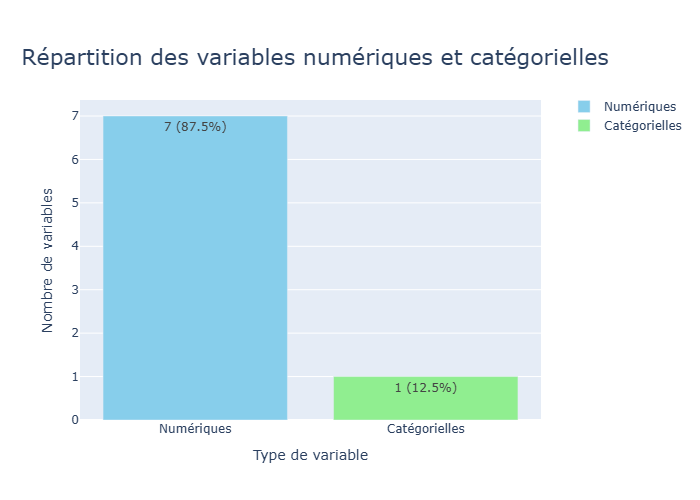

In [13]:
# Visualisation de la répartition des variables numériques et catégorielles.

num_cat_appli_train = plot_num_cat_distribution(df= df_pos_cash,
                          chart_type='bar',
                          title="Répartition des variables numériques et catégorielles",
                          annotation_format= 'both',
                          title_size=22,
                          title_x= 0.45,
                          title_y= 0.90,
                          legend_x= 1.05,
                          legend_y= 0.95,
                          width=800,
                          height=800
)

num_cat_appli_train.show()

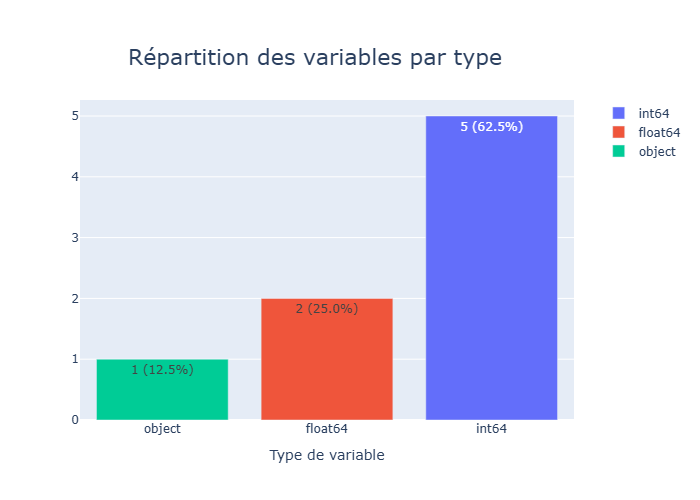

In [14]:
# Visualisation de la répartition des variables par type.

var_distrib_appli_train = plot_variable_types_distribution(df=df_pos_cash,
                          chart_type='bar',
                          title_size=22,
                          title_x= 0.45,
                          title_y= 0.90,
                          legend_x= 1.05,
                          legend_y= 0.90,
                          annotation_format= 'both',
                          bar_orientation= 'v',
                          width=800,
                          height=800)

var_distrib_appli_train.show()

- En grande majorité des variables quantitatives avec tout de même une variable catégorielle pour les statuts 

##### - Valeurs aberrantes de df_pos_cash

In [15]:
# Liste des variables catégorielles du dataframe.

df_pos_cash.select_dtypes(include=['object']).nunique()

NAME_CONTRACT_STATUS    9
dtype: int64

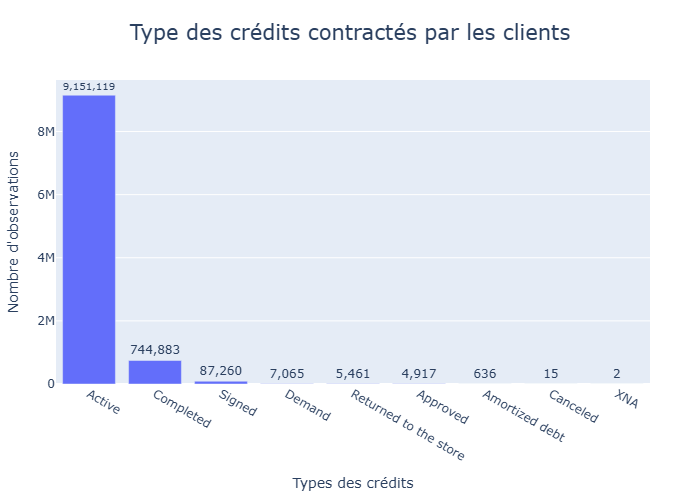

In [16]:
# Visualisation de la répartition pour la variable "NAME_CONTRACT_STATUS"

plot_histogram_categorical(
    df=df_pos_cash,
    x="NAME_CONTRACT_STATUS",
    title="Type des crédits contractés par les clients",
    xaxis_title= 'Types des crédits',
    title_font_size=21,
    tickangle=30
)

- Ce fichier étant du même type que credit card balance, on peut de nouveau diminuer le nombre de modalités puisque la plupart d'entres elles sont très rarement observé sur 10 millions de soldes observés des crédits POS.

In [17]:
# Changement des modalités concernées pour la variable 'NAME_CONTRACT_STATUS'.

rare_status = df_pos_cash['NAME_CONTRACT_STATUS'].value_counts(normalize=True)
rare_status = rare_status[rare_status < 0.01].index
df_pos_cash['NAME_CONTRACT_STATUS'] = df_pos_cash['NAME_CONTRACT_STATUS'].replace(rare_status, 'rare_status')
df_pos_cash["NAME_CONTRACT_STATUS"].value_counts()

NAME_CONTRACT_STATUS
Active         9151119
Completed       744883
rare_status     105356
Name: count, dtype: int64

- On peut maintenant passer aux valeurs aberrantes des  variables quantitatives :

In [18]:
# Liste des variables quantitatives du dataframe.

pprint.pprint(df_pos_cash.select_dtypes(exclude=['object']).columns.tolist())

['SK_ID_PREV',
 'SK_ID_CURR',
 'MONTHS_BALANCE',
 'CNT_INSTALMENT',
 'CNT_INSTALMENT_FUTURE',
 'SK_DPD',
 'SK_DPD_DEF']


In [19]:
round(df_pos_cash.describe(), 0)

,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,CNT_INSTALMENT,CNT_INSTALMENT_FUTURE,SK_DPD,SK_DPD_DEF
count,10001358.0,10001358.0,10001358.0,9975287.0,9975271.0,10001358.0,10001358.0
mean,1903217.0,278404.0,-35.0,17.0,10.0,12.0,1.0
std,535847.0,102764.0,26.0,12.0,11.0,133.0,33.0
min,1000001.0,100001.0,-96.0,1.0,0.0,0.0,0.0
25%,1434405.0,189550.0,-54.0,10.0,3.0,0.0,0.0
50%,1896565.0,278654.0,-28.0,12.0,7.0,0.0,0.0
75%,2368963.0,367429.0,-13.0,24.0,14.0,0.0,0.0
max,2843499.0,456255.0,-1.0,92.0,85.0,4231.0,3595.0


- Ici on a peu de variables donc il est assez facile de visualiser de potentielles valeurs manquantes.
- Dans l'ensemble, il y a peu de variables aberrantes ici sauf pour les valeurs plutôt élevées de certaines variables comme SK_DPD qui recense des retards pouvant ici atteindre jusque près de 11 ans ce qui parait beaucoup mais pas impossible non plus.
- Donc comme on a pu le voir au lieu d'apporter des corrections pour les valeurs extrêmes, on peut créer des flags qui seront plus informatifs pour les modèles et ne rien changer directement ici.

On peut maintenant passer aux valeurs manquantes :

In [20]:
# Calcul du nombre et du pourcentage de valeurs manquantes pour chaque colonne.

calculate_missing_values(df_pos_cash)

,Nbr_valeurs_manquantes,Pct_valeurs_manquantes
CNT_INSTALMENT_FUTURE,26087,0.260835
CNT_INSTALMENT,26071,0.260675


<Figure size 720x432 with 0 Axes>

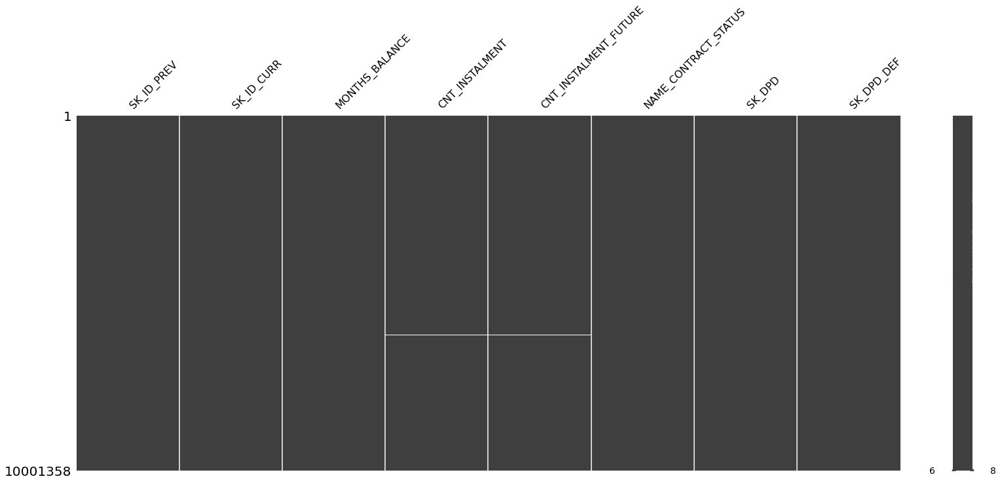

In [21]:
# Visualisation des valeurs manquantes à l'aide d'un graphique.

plot_missing_values(df_pos_cash.iloc[:, :],
                    use_missingno= 'matrix',
                    height=1000
                    )

In [22]:
# Calcul du nombre et du pourcentage de valeurs manquantes pour l'ensemble du dataframe.

summarize_missing_values(df_pos_cash)

'Le DataFrame contient 52158 valeurs manquantes sur 80010864 observations, soit 0.07%.'

- On retrouve quasiment pas de valeurs manquantes, ce qui est une bonne chose puisque l'on aura peu d'imputation à réaliser.

In [23]:
# Séparation des données train et test avant imputation.

df_pos_cash_train = df_pos_cash[df_pos_cash['SK_ID_CURR'].isin(df_appli_train['SK_ID_CURR'])]
df_pos_cash_test  = df_pos_cash[df_pos_cash['SK_ID_CURR'].isin(df_appli_test['SK_ID_CURR'])]

In [24]:
print_dataframe_shape(df_pos_cash_train)

Le DataFrame contient 8,543,375 lignes et 8 colonnes.


In [25]:
print_dataframe_shape(df_pos_cash_test)

Le DataFrame contient 1,457,983 lignes et 8 colonnes.


In [26]:
# Calcul du nombre et du pourcentage de valeurs manquantes pour chaque colonne.

calculate_missing_values(df_pos_cash_train)

,Nbr_valeurs_manquantes,Pct_valeurs_manquantes
CNT_INSTALMENT_FUTURE,21878,0.256081
CNT_INSTALMENT,21863,0.255906


In [27]:
# Calcul du nombre et du pourcentage de valeurs manquantes pour chaque colonne.

calculate_missing_values(df_pos_cash_test)

,Nbr_valeurs_manquantes,Pct_valeurs_manquantes
CNT_INSTALMENT_FUTURE,4209,0.288686
CNT_INSTALMENT,4208,0.288618


In [28]:
# Création des datasets suivant les différentes configurations.

cat_cols = df_pos_cash.select_dtypes(include=["object"]).columns.tolist()
num_cols = df_pos_cash.select_dtypes(exclude=["object"]).columns.tolist()

datasets_pos_train = create_datasets(df_pos_cash_train, cat_cols, num_cols, setups=("median_mode", "median_missing", "iterative_mode", "nan_missing"))
datasets_pos_test = create_datasets(df_pos_cash_test, cat_cols, num_cols, setups=("median_mode", "median_missing", "iterative_mode", "nan_missing"))

In [29]:
# On assigne chaque setup à un dataframe.

# Versions pour modèles linéaires (régression logistique, Lasso, Ridge, etc.)
df_pos_train_median_mode_linear = datasets_pos_train["median_mode_linear"]
df_pos_train_median_missing_linear = datasets_pos_train["median_missing_linear"]
df_pos_train_iterative_mode_linear = datasets_pos_train["iterative_mode_linear"]
df_pos_train_nan_missing_linear = datasets_pos_train["nan_missing_linear"]

# Versions pour modèles non-linéaires (arbres, LightGBM, RF, XGB, etc.)
df_pos_train_median_mode = datasets_pos_train["median_mode_tree"]
df_pos_train_median_missing = datasets_pos_train["median_missing_tree"]
df_pos_train_iterative_mode = datasets_pos_train["iterative_mode_tree"]
df_pos_train_nan_missing = datasets_pos_train["nan_missing_tree"]


# Versions pour modèles linéaires (régression logistique, Lasso, Ridge, etc.)
df_pos_test_median_mode_linear = datasets_pos_test["median_mode_linear"]
df_pos_test_median_missing_linear = datasets_pos_test["median_missing_linear"]
df_pos_test_iterative_mode_linear = datasets_pos_test["iterative_mode_linear"]
df_pos_test_nan_missing_linear = datasets_pos_test["nan_missing_linear"]

# Versions pour modèles non-linéaires (arbres, LightGBM, RF, XGB, etc.)
df_pos_test_median_mode = datasets_pos_test["median_mode_tree"]
df_pos_test_median_missing = datasets_pos_test["median_missing_tree"]
df_pos_test_iterative_mode = datasets_pos_test["iterative_mode_tree"]
df_pos_test_nan_missing = datasets_pos_test["nan_missing_tree"]

In [30]:
# Calcul du nombre et du pourcentage de valeurs manquantes restantes pour ces nouveaux dataframes.

print(summarize_missing_values(df_pos_train_median_mode_linear))
print(summarize_missing_values(df_pos_train_median_missing_linear))
print(summarize_missing_values(df_pos_train_iterative_mode_linear))
print(summarize_missing_values(df_pos_train_nan_missing_linear))

Le DataFrame contient 0 valeurs manquantes sur 68347000 observations, soit 0.00%.
Le DataFrame contient 0 valeurs manquantes sur 68347000 observations, soit 0.00%.
Le DataFrame contient 0 valeurs manquantes sur 68347000 observations, soit 0.00%.
Le DataFrame contient 43741 valeurs manquantes sur 68347000 observations, soit 0.06%.


In [31]:
print(summarize_missing_values(df_pos_test_median_mode_linear))
print(summarize_missing_values(df_pos_test_median_missing_linear))
print(summarize_missing_values(df_pos_test_iterative_mode_linear))
print(summarize_missing_values(df_pos_test_nan_missing_linear))

Le DataFrame contient 0 valeurs manquantes sur 11663864 observations, soit 0.00%.
Le DataFrame contient 0 valeurs manquantes sur 11663864 observations, soit 0.00%.
Le DataFrame contient 0 valeurs manquantes sur 11663864 observations, soit 0.00%.
Le DataFrame contient 8417 valeurs manquantes sur 11663864 observations, soit 0.07%.


In [32]:
# Optimisation des types de variables et de la mémoire du dataframe.

optimize_types(df_pos_train_median_mode_linear)
optimize_types(df_pos_train_median_missing_linear)
optimize_types(df_pos_train_iterative_mode_linear)
optimize_types(df_pos_train_nan_missing_linear)
optimize_types(df_pos_train_median_mode)
optimize_types(df_pos_train_median_missing)
optimize_types(df_pos_train_iterative_mode)
optimize_types(df_pos_train_nan_missing)

 Mémoire avant : 1036.99 MB
 Mémoire après : 808.86 MB
 Gain : 22.0%
 Mémoire avant : 1036.99 MB
 Mémoire après : 808.86 MB
 Gain : 22.0%
 Mémoire avant : 1036.99 MB
 Mémoire après : 808.86 MB
 Gain : 22.0%
 Mémoire avant : 1036.99 MB
 Mémoire après : 825.15 MB
 Gain : 20.4%
 Mémoire avant : 1297.71 MB
 Mémoire après : 1069.58 MB
 Gain : 17.6%
 Mémoire avant : 1297.71 MB
 Mémoire après : 1069.58 MB
 Gain : 17.6%
 Mémoire avant : 1297.71 MB
 Mémoire après : 1069.58 MB
 Gain : 17.6%
 Mémoire avant : 1297.71 MB
 Mémoire après : 1085.88 MB
 Gain : 16.3%


,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,CNT_INSTALMENT,CNT_INSTALMENT_FUTURE,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF,SK_ID_PREV_was_missing,SK_ID_CURR_was_missing,MONTHS_BALANCE_was_missing,CNT_INSTALMENT_was_missing,CNT_INSTALMENT_FUTURE_was_missing,SK_DPD_was_missing,SK_DPD_DEF_was_missing,NAME_CONTRACT_STATUS_was_missing
0,1803195,182943,-31,48,45,Active,0,0,0,0,0,0,0,0,0,0
1,1715348,367990,-33,36,35,Active,0,0,0,0,0,0,0,0,0,0
2,1784872,397406,-32,12,9,Active,0,0,0,0,0,0,0,0,0,0
3,1903291,269225,-35,48,42,Active,0,0,0,0,0,0,0,0,0,0
4,2341044,334279,-35,36,35,Active,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10001353,2448283,226558,-20,6,0,Active,843,0,0,0,0,0,0,0,0,0
10001354,1717234,141565,-19,12,0,Active,602,0,0,0,0,0,0,0,0,0
10001355,1283126,315695,-21,10,0,Active,609,0,0,0,0,0,0,0,0,0
10001356,1082516,450255,-22,12,0,Active,614,0,0,0,0,0,0,0,0,0


In [33]:
# Optimisation des types de variables et de la mémoire du dataframe.

optimize_types(df_pos_test_median_mode_linear)
optimize_types(df_pos_test_median_missing_linear)
optimize_types(df_pos_test_iterative_mode_linear)
optimize_types(df_pos_test_nan_missing_linear)
optimize_types(df_pos_test_median_mode)
optimize_types(df_pos_test_median_missing)
optimize_types(df_pos_test_iterative_mode)
optimize_types(df_pos_test_nan_missing)

 Mémoire avant : 176.97 MB
 Mémoire après : 138.04 MB
 Gain : 22.0%
 Mémoire avant : 176.97 MB
 Mémoire après : 138.04 MB
 Gain : 22.0%
 Mémoire avant : 176.97 MB
 Mémoire après : 138.04 MB
 Gain : 22.0%
 Mémoire avant : 176.97 MB
 Mémoire après : 140.82 MB
 Gain : 20.4%
 Mémoire avant : 221.47 MB
 Mémoire après : 182.54 MB
 Gain : 17.6%
 Mémoire avant : 221.47 MB
 Mémoire après : 182.54 MB
 Gain : 17.6%
 Mémoire avant : 221.47 MB
 Mémoire après : 182.54 MB
 Gain : 17.6%
 Mémoire avant : 221.47 MB
 Mémoire après : 185.32 MB
 Gain : 16.3%


,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,CNT_INSTALMENT,CNT_INSTALMENT_FUTURE,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF,SK_ID_PREV_was_missing,SK_ID_CURR_was_missing,MONTHS_BALANCE_was_missing,CNT_INSTALMENT_was_missing,CNT_INSTALMENT_FUTURE_was_missing,SK_DPD_was_missing,SK_DPD_DEF_was_missing,NAME_CONTRACT_STATUS_was_missing
23,1445556,220181,-41,12,12,Active,0,0,0,0,0,0,0,0,0,0
24,1420240,386836,-41,12,11,Active,0,0,0,0,0,0,0,0,0,0
31,1463929,108990,-41,12,12,Active,0,0,0,0,0,0,0,0,0,0
42,1298869,210084,-41,48,0,Completed,0,0,0,0,0,0,0,0,0,0
47,2027470,391768,-41,48,40,Active,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10001310,1605274,100987,-27,6,0,Active,0,0,0,0,0,0,0,0,0,0
10001313,1976894,147364,-28,6,0,Active,887,0,0,0,0,0,0,0,0,0
10001323,1798328,138871,-27,6,0,Active,947,0,0,0,0,0,0,0,0,0
10001329,1540335,104779,-27,6,0,Active,0,0,0,0,0,0,0,0,0,0


In [34]:
# Visualisation des variables à encoder avec One Hot Encoder.

ohe_var = [col for col in df_pos_train_median_mode_linear.columns 
                      if df_pos_train_median_mode_linear[col].dtype == 'object' and df_pos_train_median_mode_linear[col].nunique() <= 10]

print("""Variables catégorielles avec One Hot Encoder :\n""")
pprint.pprint(ohe_var)

Variables catégorielles avec One Hot Encoder :

['NAME_CONTRACT_STATUS']


In [35]:
#Encodage des variables catégorielles avec One Hot Encoder.

# Liste des datasets à encoder
datasets_linear = [
    df_pos_train_median_missing_linear,
    df_pos_train_median_mode_linear,
    df_pos_train_iterative_mode_linear,
    df_pos_train_nan_missing_linear,
    df_pos_test_median_mode_linear,
    df_pos_test_median_missing_linear,
    df_pos_test_iterative_mode_linear,
    df_pos_test_nan_missing_linear
]

# Application du One-Hot Encoding sur tous les datasets
encoded_ohe_linear = one_hot_encode(datasets_linear, columns=ohe_var, drop_first=True)

df_pos_train_median_missing_linear = encoded_ohe_linear[0]
df_pos_train_median_mode_linear = encoded_ohe_linear[1]
df_pos_train_iterative_mode_linear = encoded_ohe_linear[2]
df_pos_train_nan_missing_linear = encoded_ohe_linear[3]
df_pos_test_median_mode_linear = encoded_ohe_linear[4]
df_pos_test_median_missing_linear = encoded_ohe_linear[5]
df_pos_test_iterative_mode_linear = encoded_ohe_linear[6]
df_pos_test_nan_missing_linear = encoded_ohe_linear[7]

# Liste des datasets à encoder
datasets = [
    df_pos_train_median_missing,
    df_pos_train_median_mode,
    df_pos_train_iterative_mode,
    df_pos_train_nan_missing,
    df_pos_test_median_mode,
    df_pos_test_median_missing,
    df_pos_test_iterative_mode,
    df_pos_test_nan_missing
]

# Application du One-Hot Encoding sur tous les datasets
encoded_ohe = one_hot_encode(datasets, columns=ohe_var, drop_first=False)

df_pos_train_median_missing = encoded_ohe[0]
df_pos_train_median_mode = encoded_ohe[1]
df_pos_train_iterative_mode = encoded_ohe[2]
df_pos_train_nan_missing = encoded_ohe[3]
df_pos_test_median_mode = encoded_ohe[4]
df_pos_test_median_missing = encoded_ohe[5]
df_pos_test_iterative_mode = encoded_ohe[6]
df_pos_test_nan_missing = encoded_ohe[7]

In [36]:
df_pos_train_median_missing_linear.loc[:, df_pos_train_median_missing_linear.columns.str.contains('NAME_CONTRACT_STATUS')]

,NAME_CONTRACT_STATUS_Completed,NAME_CONTRACT_STATUS_rare_status
0,0.0,0.0
1,0.0,0.0
2,0.0,0.0
3,0.0,0.0
4,0.0,0.0
...,...,...
10001353,0.0,0.0
10001354,0.0,0.0
10001355,0.0,0.0
10001356,0.0,0.0


In [37]:
df_pos_train_median_missing.loc[:, df_pos_train_median_missing.columns.str.contains('NAME_CONTRACT_STATUS')]

,NAME_CONTRACT_STATUS_was_missing,NAME_CONTRACT_STATUS_Active,NAME_CONTRACT_STATUS_Completed,NAME_CONTRACT_STATUS_rare_status
0,0,1.0,0.0,0.0
1,0,1.0,0.0,0.0
2,0,1.0,0.0,0.0
3,0,1.0,0.0,0.0
4,0,1.0,0.0,0.0
...,...,...,...,...
10001353,0,1.0,0.0,0.0
10001354,0,1.0,0.0,0.0
10001355,0,1.0,0.0,0.0
10001356,0,1.0,0.0,0.0


- On peut ensuite passer à la création de nouvelles features intéressante avec ce fichier :

In [38]:
# Ajout de nouvelles features dérivées intéressante avec ce fichier.

def add_pos_cash_features(df):
    """
    Ajoute des features dérivées du dataset POS_CASH_balance.
    df : DataFrame pandas
    """

    df = df.copy()


    # Structure du crédit
    df["POS_INSTALMENT_PROGRESS"] = (df["CNT_INSTALMENT"] - df["CNT_INSTALMENT_FUTURE"])
    df["POS_INSTALMENT_REMAIN_RATIO"] = (df["CNT_INSTALMENT_FUTURE"] / (df["CNT_INSTALMENT"] + 1e-6))
    df["POS_INSTALMENT_DONE_RATIO"] = (df["POS_INSTALMENT_PROGRESS"] / (df["CNT_INSTALMENT"] + 1e-6))


    # Flags comportementaux
    df["POS_COMPLETED_CREDIT"] = (df["CNT_INSTALMENT_FUTURE"] == 0).astype("Int64")
    df["POS_EARLY_STAGE"] = (df["CNT_INSTALMENT_FUTURE"] > df["CNT_INSTALMENT"] * 0.7).astype("Int64")
    df["POS_LATE_STAGE"] = (df["CNT_INSTALMENT_FUTURE"] < df["CNT_INSTALMENT"] * 0.3).astype("Int64")


    # Retards
    df["POS_HAS_DPD"] = (df["SK_DPD"] > 0).astype(int)
    df["POS_HAS_DPD_DEF"] = (df["SK_DPD_DEF"] > 0).astype(int)
    df["POS_DPD_RATIO"] = df["SK_DPD"] / (df["SK_DPD_DEF"] + 1e-6)


    # Temporalité
    df["POS_IS_RECENT"] = (df["MONTHS_BALANCE"] > -6).astype(int)
    df["POS_IS_VERY_RECENT"] = (df["MONTHS_BALANCE"] > -3).astype(int)


    # Variations relatives
    df["POS_DPD_TREND"] = df.groupby("SK_ID_PREV")["SK_DPD"].diff()
    df["POS_DPD_DEF_TREND"] = df.groupby("SK_ID_PREV")["SK_DPD_DEF"].diff()
    df["POS_INSTALMENT_FUTURE_DIFF"] = (df.groupby("SK_ID_PREV")["CNT_INSTALMENT_FUTURE"].diff())

    # Nettoyage
    df.replace([np.inf, -np.inf], np.nan, inplace=True)

    return df

In [39]:
# Ajout des nouvelles variables à l'aide la fonction créée précédemment.

df_pos_train_median_mode_linear_nf = add_pos_cash_features(df_pos_train_median_mode_linear)
df_pos_train_median_missing_linear_nf = add_pos_cash_features(df_pos_train_median_missing_linear)
df_pos_train_iterative_mode_linear_nf = add_pos_cash_features(df_pos_train_iterative_mode_linear)
df_pos_train_nan_missing_linear_nf = add_pos_cash_features(df_pos_train_nan_missing_linear)

df_pos_train_median_mode_nf = add_pos_cash_features(df_pos_train_median_mode)
df_pos_train_median_missing_nf = add_pos_cash_features(df_pos_train_median_missing)
df_pos_train_iterative_mode_nf= add_pos_cash_features(df_pos_train_iterative_mode)
df_pos_train_nan_missing_nf = add_pos_cash_features(df_pos_train_nan_missing)

df_pos_test_median_mode_linear_nf = add_pos_cash_features(df_pos_test_median_mode_linear)
df_pos_test_median_missing_linear_nf = add_pos_cash_features(df_pos_test_median_missing_linear)
df_pos_test_iterative_mode_linear_nf = add_pos_cash_features(df_pos_test_iterative_mode_linear)
df_pos_test_nan_missing_linear_nf = add_pos_cash_features(df_pos_test_nan_missing_linear)

df_pos_test_median_mode_nf = add_pos_cash_features(df_pos_test_median_mode)
df_pos_test_median_missing_nf = add_pos_cash_features(df_pos_test_median_missing)
df_pos_test_iterative_mode_nf = add_pos_cash_features(df_pos_test_iterative_mode)
df_pos_test_nan_missing_nf = add_pos_cash_features(df_pos_test_nan_missing)

In [40]:
# Suppression de "SK_ID_CURR" pour réaliser une première agrégation par crédit.

df_pos_train_median_mode_linear_nf.drop(columns=["SK_ID_CURR"], inplace=True)
df_pos_train_median_missing_linear_nf.drop(columns=["SK_ID_CURR"], inplace=True)
df_pos_train_iterative_mode_linear_nf.drop(columns=["SK_ID_CURR"], inplace=True)
df_pos_train_nan_missing_linear_nf.drop(columns=["SK_ID_CURR"], inplace=True)

df_pos_train_median_mode_nf.drop(columns=["SK_ID_CURR"], inplace=True)
df_pos_train_median_missing_nf.drop(columns=["SK_ID_CURR"], inplace=True)
df_pos_train_iterative_mode_nf.drop(columns=["SK_ID_CURR"], inplace=True)
df_pos_train_nan_missing_nf.drop(columns=["SK_ID_CURR"], inplace=True)

df_pos_test_median_mode_linear_nf.drop(columns=["SK_ID_CURR"], inplace=True)
df_pos_test_median_missing_linear_nf.drop(columns=["SK_ID_CURR"], inplace=True)
df_pos_test_iterative_mode_linear_nf.drop(columns=["SK_ID_CURR"], inplace=True)
df_pos_test_nan_missing_linear_nf.drop(columns=["SK_ID_CURR"], inplace=True)

df_pos_test_median_mode_nf.drop(columns=["SK_ID_CURR"], inplace=True)
df_pos_test_median_missing_nf.drop(columns=["SK_ID_CURR"], inplace=True)
df_pos_test_iterative_mode_nf.drop(columns=["SK_ID_CURR"], inplace=True)
df_pos_test_nan_missing_nf.drop(columns=["SK_ID_CURR"], inplace=True)

In [41]:
# Agrégation au niveau credit dans un premier temps

def aggregate_pos_cash_by_credit(df):
    """
    Agrégation du fichier POS_CASH_balance au niveau crédit (SK_ID_PREV).
    df : DataFrame pandas
    """

    data = df.copy()

    # Colonnes à exclure 
    exclude_cols = ["MONTHS_BALANCE"]

    base_numeric_cols = [
        c for c in data.columns
        if c not in exclude_cols + ["SK_ID_PREV"]
        and data[c].dtype != "object"
    ]

    # Séparation des types de colonnes
    was_missing_cols = [c for c in data.columns if c.endswith("_was_missing")]
    ohe_cols = [c for c in data.columns if c.startswith("NAME_CONTRACT_STATUS_")]
    flag_cols = [c for c in data.columns if c.startswith("POS_") or c.startswith("FLAG_")]

    # Colonnes dérivées
    derived_cols = [
        c for c in base_numeric_cols
        if c not in ohe_cols + flag_cols + was_missing_cols
    ]

    # Dictionnaire d'agrégation
    agg_dict = {}

    # OHE 
    for col in ohe_cols:
        agg_dict[col] = ["mean", "sum"]

    # Flags 
    for col in flag_cols:
        agg_dict[col] = ["mean", "sum", "max"]

    # Colonnes dérivées
    for col in derived_cols:
        agg_dict[col] = ["mean", "max", "min"]

    # Agrégation principale
    df_credit = data.groupby("SK_ID_PREV").agg(agg_dict)

    # Renommage 
    df_credit.columns = [
        f"POS_{col.upper()}_{stat.upper()}"
        for col, stat in df_credit.columns
    ]

    df_credit.reset_index(inplace=True)

    # Agrégation des indicateurs de missing
    if len(was_missing_cols) > 0:
        missing_agg = (data.groupby("SK_ID_PREV")[was_missing_cols].agg(["mean", "sum"]))
        missing_agg.columns = [
            f"POS_{col.upper()}_{stat.upper()}"
            for col, stat in missing_agg.columns
        ]
        missing_agg.reset_index(inplace=True)
        df_credit = df_credit.merge(missing_agg, on="SK_ID_PREV", how="left")


    # Ajout des features supplémentaires

    # Variables temporelles globales
    
    df_credit["POS_NB_MONTHS"] = (
        data.groupby("SK_ID_PREV")["MONTHS_BALANCE"].count().values
    )

    df_credit["POS_MEAN_MONTH"] = (
        data.groupby("SK_ID_PREV")["MONTHS_BALANCE"].mean().values
    )

    df_credit["POS_MAX_MONTH"] = (
        data.groupby("SK_ID_PREV")["MONTHS_BALANCE"].max().values
    )

    df_credit["POS_MIN_MONTH"] = (
        data.groupby("SK_ID_PREV")["MONTHS_BALANCE"].min().values
    )

    return df_credit

In [42]:
# Agrégation au niveau des crédits dans un premier temps.

df_pos_train_median_mode_linear_cred = aggregate_pos_cash_by_credit(df_pos_train_median_mode_linear_nf)
df_pos_train_median_missing_linear_cred = aggregate_pos_cash_by_credit(df_pos_train_median_missing_linear_nf)
df_pos_train_iterative_mode_linear_cred = aggregate_pos_cash_by_credit(df_pos_train_iterative_mode_linear_nf)
df_pos_train_nan_missing_linear_cred = aggregate_pos_cash_by_credit(df_pos_train_nan_missing_linear_nf)

df_pos_train_median_mode_cred = aggregate_pos_cash_by_credit(df_pos_train_median_mode_nf)
df_pos_train_median_missing_cred = aggregate_pos_cash_by_credit(df_pos_train_median_missing_nf)
df_pos_train_iterative_mode_cred = aggregate_pos_cash_by_credit(df_pos_train_iterative_mode_nf)
df_pos_train_nan_missing_cred = aggregate_pos_cash_by_credit(df_pos_train_nan_missing_nf)

df_pos_test_median_mode_linear_cred = aggregate_pos_cash_by_credit(df_pos_test_median_mode_linear_nf)
df_pos_test_median_missing_linear_cred = aggregate_pos_cash_by_credit(df_pos_test_median_missing_linear_nf)
df_pos_test_iterative_mode_linear_cred = aggregate_pos_cash_by_credit(df_pos_test_iterative_mode_linear_nf)
df_pos_test_nan_missing_linear_cred = aggregate_pos_cash_by_credit(df_pos_test_nan_missing_linear_nf)

df_pos_test_median_mode_cred = aggregate_pos_cash_by_credit(df_pos_test_median_mode_nf)
df_pos_test_median_missing_cred = aggregate_pos_cash_by_credit(df_pos_test_median_missing_nf)
df_pos_test_iterative_mode_cred = aggregate_pos_cash_by_credit(df_pos_test_iterative_mode_nf)
df_pos_test_nan_missing_cred = aggregate_pos_cash_by_credit(df_pos_test_nan_missing_nf)

In [43]:
df_pos_train_median_mode_linear_cred

,SK_ID_PREV,POS_NAME_CONTRACT_STATUS_COMPLETED_MEAN,POS_NAME_CONTRACT_STATUS_COMPLETED_SUM,POS_NAME_CONTRACT_STATUS_RARE_STATUS_MEAN,POS_NAME_CONTRACT_STATUS_RARE_STATUS_SUM,POS_POS_INSTALMENT_PROGRESS_MEAN,POS_POS_INSTALMENT_PROGRESS_SUM,POS_POS_INSTALMENT_PROGRESS_MAX,POS_POS_INSTALMENT_REMAIN_RATIO_MEAN,POS_POS_INSTALMENT_REMAIN_RATIO_SUM,...,POS_SK_DPD_MEAN,POS_SK_DPD_MAX,POS_SK_DPD_MIN,POS_SK_DPD_DEF_MEAN,POS_SK_DPD_DEF_MAX,POS_SK_DPD_DEF_MIN,POS_NB_MONTHS,POS_MEAN_MONTH,POS_MAX_MONTH,POS_MIN_MONTH
0,1000001,0.333333,1.0,0.0,0.0,1.000000,3,2,0.638889,1.916667,...,0.0,0,0,0.0,0,0,3,-9.0,-8,-10
1,1000003,0.000000,0.0,0.0,0.0,1.500000,6,3,0.875000,3.500000,...,0.0,0,0,0.0,0,0,4,-2.5,-1,-4
2,1000004,0.125000,1.0,0.0,0.0,3.500000,28,7,0.612500,4.900000,...,0.0,0,0,0.0,0,0,8,-25.5,-22,-29
3,1000005,0.090909,1.0,0.0,0.0,5.000000,55,10,0.500000,5.499999,...,0.0,0,0,0.0,0,0,11,-51.0,-46,-56
4,1000007,0.000000,0.0,0.0,0.0,2.000000,10,4,0.666667,3.333333,...,0.0,0,0,0.0,0,0,5,-3.0,-1,-5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
800332,2843494,0.333333,1.0,0.0,0.0,1.000000,3,2,0.659722,1.979167,...,0.0,0,0,0.0,0,0,3,-25.0,-24,-26
800333,2843495,0.125000,1.0,0.0,0.0,3.500000,28,7,0.831250,6.650000,...,0.0,0,0,0.0,0,0,8,-12.5,-9,-16
800334,2843497,0.000000,0.0,0.0,0.0,10.000000,210,20,0.583333,12.249999,...,0.0,0,0,0.0,0,0,21,-11.0,-1,-21
800335,2843498,0.142857,1.0,0.0,0.0,3.142857,22,6,0.674603,4.722222,...,0.0,0,0,0.0,0,0,7,-45.0,-42,-48


In [44]:
# Agrégation au niveau client dans un deuxième temps

def aggregate_pos_cash_by_client(df):
    """
    Agrège le dataframe POS_CASH déjà agrégé au niveau crédit (SK_ID_PREV),
    au niveau client (SK_ID_CURR).
    """

    import numpy as np
    import pandas as pd

    data = df.copy()

    # Colonnes à exclure
    exclude_cols = ["SK_ID_PREV"]

    # Colonnes numériques utilisables
    numeric_cols = [
        c for c in data.columns
        if c not in exclude_cols + ["SK_ID_CURR"]
        and pd.api.types.is_numeric_dtype(data[c])
    ]

    # Colonnes indicatrices
    was_missing_cols = [c for c in numeric_cols if c.endswith("_WAS_MISSING")]
    flag_cols = [c for c in numeric_cols if c.startswith("POS_FLAG_") or c.startswith("FLAG_")]
    ohe_cols = [c for c in numeric_cols if "NAME_CONTRACT_STATUS_" in c]

    # Colonnes temporelles
    time_cols = [
        c for c in numeric_cols
        if c.endswith(("NB_MONTHS", "MEAN_MONTH", "MAX_MONTH", "MIN_MONTH"))
    ]

    # Colonnes dérivées
    other_numeric = [
        c for c in numeric_cols
        if c not in flag_cols + ohe_cols + time_cols + was_missing_cols
    ]


    # Dictionnaire d’agrégation

    agg_dict = {}

    # Flags comportementaux
    for col in flag_cols:
        agg_dict[col] = ["mean", "sum", "max"]

    # OHE
    for col in ohe_cols:
        agg_dict[col] = ["mean", "sum"]

    # Colonnes temporelles
    for col in time_cols:
        if col.endswith("NB_MONTHS"):
            agg_dict[col] = ["sum", "mean"]
        else:
            agg_dict[col] = ["mean", "max"]

    # Autres colonnes numériques
    for col in other_numeric:
        agg_dict[col] = ["mean", "max", "min"]


    # Agrégation principale client
    pos_client_agg = data.groupby("SK_ID_CURR").agg(agg_dict)

    # Renommage
    pos_client_agg.columns = [
        f"{col.upper()}_{stat.upper()}"
        for col, stat in pos_client_agg.columns
    ]
    pos_client_agg.reset_index(inplace=True)


    # Agrégation des colonnes _was_missing
    if len(was_missing_cols) > 0:
        missing_agg = data.groupby("SK_ID_CURR")[was_missing_cols].agg(["mean", "sum"])
        missing_agg.columns = [
            f"{col.upper()}_{stat.upper()}"
            for col, stat in missing_agg.columns
        ]
        missing_agg.reset_index(inplace=True)
        pos_client_agg = pos_client_agg.merge(missing_agg, on="SK_ID_CURR", how="left")

    # Nettoyage final
    pos_client_agg.replace([np.inf, -np.inf], np.nan, inplace=True)

    print(
        f"Agrégation POS_CASH_balance (niveau client) – shape : {pos_client_agg.shape}"
    )

    return pos_client_agg


In [45]:
# Rajout de la variable ID client aux dataframes

df_pos_train_median_mode_linear_cred = df_pos_train_median_mode_linear_cred.merge(df_init_pos_cash[['SK_ID_PREV', 'SK_ID_CURR']], on='SK_ID_PREV', how='left')
df_pos_train_median_missing_linear_cred = df_pos_train_median_missing_linear_cred.merge(df_init_pos_cash[['SK_ID_PREV', 'SK_ID_CURR']], on='SK_ID_PREV', how='left')
df_pos_train_iterative_mode_linear_cred = df_pos_train_iterative_mode_linear_cred.merge(df_init_pos_cash[['SK_ID_PREV', 'SK_ID_CURR']], on='SK_ID_PREV', how='left')
df_pos_train_nan_missing_linear_cred = df_pos_train_nan_missing_linear_cred.merge(df_init_pos_cash[['SK_ID_PREV', 'SK_ID_CURR']], on='SK_ID_PREV', how='left')

df_pos_train_median_mode_cred = df_pos_train_median_mode_cred.merge(df_init_pos_cash[['SK_ID_PREV', 'SK_ID_CURR']], on='SK_ID_PREV', how='left')
df_pos_train_median_missing_cred = df_pos_train_median_missing_cred.merge(df_init_pos_cash[['SK_ID_PREV', 'SK_ID_CURR']], on='SK_ID_PREV', how='left')
df_pos_train_iterative_mode_cred = df_pos_train_iterative_mode_cred.merge(df_init_pos_cash[['SK_ID_PREV', 'SK_ID_CURR']], on='SK_ID_PREV', how='left')
df_pos_train_nan_missing_cred = df_pos_train_nan_missing_cred.merge(df_init_pos_cash[['SK_ID_PREV', 'SK_ID_CURR']], on='SK_ID_PREV', how='left')

df_pos_test_median_mode_linear_cred = df_pos_test_median_mode_linear_cred.merge(df_init_pos_cash[['SK_ID_PREV', 'SK_ID_CURR']], on='SK_ID_PREV', how='left')
df_pos_test_median_missing_linear_cred = df_pos_test_median_missing_linear_cred.merge(df_init_pos_cash[['SK_ID_PREV', 'SK_ID_CURR']], on='SK_ID_PREV', how='left')
df_pos_test_iterative_mode_linear_cred = df_pos_test_iterative_mode_linear_cred.merge(df_init_pos_cash[['SK_ID_PREV', 'SK_ID_CURR']], on='SK_ID_PREV', how='left')
df_pos_test_nan_missing_linear_cred = df_pos_test_nan_missing_linear_cred.merge(df_init_pos_cash[['SK_ID_PREV', 'SK_ID_CURR']], on='SK_ID_PREV', how='left')

df_pos_test_median_mode_cred = df_pos_test_median_mode_cred.merge(df_init_pos_cash[['SK_ID_PREV', 'SK_ID_CURR']], on='SK_ID_PREV', how='left')
df_pos_test_median_missing_cred = df_pos_test_median_missing_cred.merge(df_init_pos_cash[['SK_ID_PREV', 'SK_ID_CURR']], on='SK_ID_PREV', how='left')
df_pos_test_iterative_mode_cred = df_pos_test_iterative_mode_cred.merge(df_init_pos_cash[['SK_ID_PREV', 'SK_ID_CURR']], on='SK_ID_PREV', how='left')
df_pos_test_nan_missing_cred = df_pos_test_nan_missing_cred.merge(df_init_pos_cash[['SK_ID_PREV', 'SK_ID_CURR']], on='SK_ID_PREV', how='left')

In [46]:
# Agrégation au niveau des clients dans un deuxième temps.

df_pos_train_median_mode_linear_agg = aggregate_pos_cash_by_client(df_pos_train_median_mode_linear_cred)
df_pos_train_median_missing_linear_agg = aggregate_pos_cash_by_client(df_pos_train_median_missing_linear_cred)
df_pos_train_iterative_mode_linear_agg = aggregate_pos_cash_by_client(df_pos_train_iterative_mode_linear_cred)
df_pos_train_nan_missing_linear_agg= aggregate_pos_cash_by_client(df_pos_train_nan_missing_linear_cred)

df_pos_train_median_mode_agg = aggregate_pos_cash_by_client(df_pos_train_median_mode_cred)
df_pos_train_median_missing_agg = aggregate_pos_cash_by_client(df_pos_train_median_missing_cred)
df_pos_train_iterative_mode_agg = aggregate_pos_cash_by_client(df_pos_train_iterative_mode_cred)
df_pos_train_nan_missing_agg = aggregate_pos_cash_by_client(df_pos_train_nan_missing_cred)

df_pos_test_median_mode_linear_agg = aggregate_pos_cash_by_client(df_pos_test_median_mode_linear_cred)
df_pos_test_median_missing_linear_agg = aggregate_pos_cash_by_client(df_pos_test_median_missing_linear_cred)
df_pos_test_iterative_mode_linear_agg = aggregate_pos_cash_by_client(df_pos_test_iterative_mode_linear_cred)
df_pos_test_nan_missing_linear_agg = aggregate_pos_cash_by_client(df_pos_test_nan_missing_linear_cred)

df_pos_test_median_mode_agg = aggregate_pos_cash_by_client(df_pos_test_median_mode_cred)
df_pos_test_median_missing_agg = aggregate_pos_cash_by_client(df_pos_test_median_missing_cred)
df_pos_test_iterative_mode_agg = aggregate_pos_cash_by_client(df_pos_test_iterative_mode_cred)
df_pos_test_nan_missing_agg = aggregate_pos_cash_by_client(df_pos_test_nan_missing_cred)

Agrégation POS_CASH_balance (niveau client) – shape : (289444, 179)
Agrégation POS_CASH_balance (niveau client) – shape : (289444, 179)
Agrégation POS_CASH_balance (niveau client) – shape : (289444, 179)
Agrégation POS_CASH_balance (niveau client) – shape : (289444, 179)


C:\Users\Caomghin\AppData\Local\Temp/ipykernel_4180/1857506880.py:74: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



Agrégation POS_CASH_balance (niveau client) – shape : (289444, 233)


C:\Users\Caomghin\AppData\Local\Temp/ipykernel_4180/1857506880.py:74: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



Agrégation POS_CASH_balance (niveau client) – shape : (289444, 233)
Agrégation POS_CASH_balance (niveau client) – shape : (289444, 233)
Agrégation POS_CASH_balance (niveau client) – shape : (289444, 233)
Agrégation POS_CASH_balance (niveau client) – shape : (47808, 179)
Agrégation POS_CASH_balance (niveau client) – shape : (47808, 179)
Agrégation POS_CASH_balance (niveau client) – shape : (47808, 179)
Agrégation POS_CASH_balance (niveau client) – shape : (47808, 179)


C:\Users\Caomghin\AppData\Local\Temp/ipykernel_4180/1857506880.py:74: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



Agrégation POS_CASH_balance (niveau client) – shape : (47808, 233)


C:\Users\Caomghin\AppData\Local\Temp/ipykernel_4180/1857506880.py:74: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



Agrégation POS_CASH_balance (niveau client) – shape : (47808, 233)
Agrégation POS_CASH_balance (niveau client) – shape : (47808, 233)
Agrégation POS_CASH_balance (niveau client) – shape : (47808, 233)


In [47]:
df_pos_train_median_mode_linear_agg.head()

,SK_ID_CURR,POS_NAME_CONTRACT_STATUS_COMPLETED_MEAN_MEAN,POS_NAME_CONTRACT_STATUS_COMPLETED_MEAN_SUM,POS_NAME_CONTRACT_STATUS_COMPLETED_SUM_MEAN,POS_NAME_CONTRACT_STATUS_COMPLETED_SUM_SUM,POS_NAME_CONTRACT_STATUS_RARE_STATUS_MEAN_MEAN,POS_NAME_CONTRACT_STATUS_RARE_STATUS_MEAN_SUM,POS_NAME_CONTRACT_STATUS_RARE_STATUS_SUM_MEAN,POS_NAME_CONTRACT_STATUS_RARE_STATUS_SUM_SUM,POS_NB_MONTHS_SUM,...,POS_SK_DPD_MIN_MIN,POS_SK_DPD_DEF_MEAN_MEAN,POS_SK_DPD_DEF_MEAN_MAX,POS_SK_DPD_DEF_MEAN_MIN,POS_SK_DPD_DEF_MAX_MEAN,POS_SK_DPD_DEF_MAX_MAX,POS_SK_DPD_DEF_MAX_MIN,POS_SK_DPD_DEF_MIN_MEAN,POS_SK_DPD_DEF_MIN_MAX,POS_SK_DPD_DEF_MIN_MIN
0,100002,0.000000,0.0,0.000000,0.0,0.000000,0.0,0.000000,0.0,361,...,0,0.0,0.0,0.0,0.0,0,0,0.0,0,0
1,100003,0.071429,2.0,0.571429,16.0,0.000000,0.0,0.000000,0.0,272,...,0,0.0,0.0,0.0,0.0,0,0,0.0,0,0
2,100004,0.250000,1.0,1.000000,4.0,0.000000,0.0,0.000000,0.0,16,...,0,0.0,0.0,0.0,0.0,0,0,0.0,0,0
3,100006,0.095238,2.0,0.523810,11.0,0.047619,1.0,0.380952,8.0,173,...,0,0.0,0.0,0.0,0.0,0,0,0.0,0,0
4,100007,0.045455,3.0,0.666667,44.0,0.015152,1.0,0.196970,13.0,906,...,0,0.0,0.0,0.0,0.0,0,0,0.0,0,0


In [48]:
calculate_missing_values(df_pos_train_median_mode_linear_agg)

,Nbr_valeurs_manquantes,Pct_valeurs_manquantes
POS_POS_DPD_TREND_MEAN_MEAN,360,0.124376
POS_POS_DPD_TREND_MEAN_MAX,360,0.124376
POS_POS_INSTALMENT_FUTURE_DIFF_MAX_MAX,360,0.124376
POS_POS_INSTALMENT_FUTURE_DIFF_MAX_MEAN,360,0.124376
POS_POS_INSTALMENT_FUTURE_DIFF_MEAN_MIN,360,0.124376
POS_POS_INSTALMENT_FUTURE_DIFF_MEAN_MAX,360,0.124376
POS_POS_INSTALMENT_FUTURE_DIFF_MEAN_MEAN,360,0.124376
POS_POS_DPD_DEF_TREND_MAX_MIN,360,0.124376
POS_POS_DPD_DEF_TREND_MAX_MAX,360,0.124376
POS_POS_DPD_DEF_TREND_MAX_MEAN,360,0.124376


- Comme pour credit balance, on a ici les variables temporelles avec lesquelles il faut imputer par 0 pour les modèles linéaires.

In [49]:
# Merge des pairs bureau/application pour les datasets train

df_train_median_mode_linear = df_train_median_mode_linear.merge(
    df_pos_train_median_mode_linear_agg, on="SK_ID_CURR", how="left"
).fillna(0)

df_train_median_missing_linear = df_train_median_missing_linear.merge(
    df_pos_train_median_missing_linear_agg, on="SK_ID_CURR", how="left"
).fillna(0)

df_train_iterative_mode_linear = df_train_iterative_mode_linear.merge(
    df_pos_train_iterative_mode_linear_agg, on="SK_ID_CURR", how="left"
).fillna(0)

df_train_nan_missing_linear = df_train_nan_missing_linear.merge(
    df_pos_train_nan_missing_linear_agg, on="SK_ID_CURR", how="left"
)

df_train_median_mode = df_train_median_mode.merge(
    df_pos_train_median_mode_agg, on="SK_ID_CURR", how="left"
)

df_train_median_missing = df_train_median_missing.merge(
    df_pos_train_median_missing_agg, on="SK_ID_CURR", how="left"
)

df_train_iterative_mode = df_train_iterative_mode.merge(
    df_pos_train_iterative_mode_agg, on="SK_ID_CURR", how="left"
)

df_train_nan_missing = df_train_nan_missing.merge(
    df_pos_train_nan_missing_agg, on="SK_ID_CURR", how="left"
)

# Merge des pairs bureau/application pour les datasets test

df_test_median_mode_linear = df_test_median_mode_linear.merge(
    df_pos_test_median_mode_linear_agg, on="SK_ID_CURR", how="left"
).fillna(0)

df_test_median_missing_linear = df_test_median_missing_linear.merge(
    df_pos_test_median_missing_linear_agg, on="SK_ID_CURR", how="left"
).fillna(0)

df_test_iterative_mode_linear = df_test_iterative_mode_linear.merge(
    df_pos_test_iterative_mode_linear_agg, on="SK_ID_CURR", how="left"
).fillna(0)

df_test_nan_missing_linear = df_test_nan_missing_linear.merge(
    df_pos_test_nan_missing_linear_agg, on="SK_ID_CURR", how="left"
)

df_test_median_mode = df_test_median_mode.merge(
    df_pos_test_median_mode_agg, on="SK_ID_CURR", how="left"
)

df_test_median_missing = df_test_median_missing.merge(
    df_pos_test_median_missing_agg, on="SK_ID_CURR", how="left"
)

df_test_iterative_mode = df_test_iterative_mode.merge(
    df_pos_test_iterative_mode_agg, on="SK_ID_CURR", how="left"
)

df_test_nan_missing = df_test_nan_missing.merge(
    df_pos_test_nan_missing_agg, on="SK_ID_CURR", how="left"
)

In [50]:
# Visualisation des changements apportés.

df_train_median_mode_linear.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_ANNUITY,REGION_POPULATION_RELATIVE,OWN_CAR_AGE,FLAG_MOBIL,...,POS_SK_DPD_MIN_MIN,POS_SK_DPD_DEF_MEAN_MEAN,POS_SK_DPD_DEF_MEAN_MAX,POS_SK_DPD_DEF_MEAN_MIN,POS_SK_DPD_DEF_MAX_MEAN,POS_SK_DPD_DEF_MAX_MAX,POS_SK_DPD_DEF_MAX_MIN,POS_SK_DPD_DEF_MIN_MEAN,POS_SK_DPD_DEF_MIN_MAX,POS_SK_DPD_DEF_MIN_MIN
0,100002,1,0,1,0,1,24700.5,0.018801,9,1,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,100003,0,0,0,0,0,35698.5,0.003541,9,1,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,1,1,1,1,6750.0,0.010032,26,1,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,100006,0,0,0,0,1,29686.5,0.008019,9,1,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,100007,0,0,1,0,1,21865.5,0.028663,9,1,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [51]:
calculate_missing_values(df_train_median_mode_linear)

,Nbr_valeurs_manquantes,Pct_valeurs_manquantes


#### Corrélation des variables - df_train_median_mode_linear

In [52]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_median_mode_linear[df_pos_train_median_mode_linear_agg.columns.tolist()], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,POS_CNT_INSTALMENT_FUTURE_MAX_MAX / POS_CNT_INSTALMENT_MAX_MAX,POS_CNT_INSTALMENT_MAX_MAX,POS_CNT_INSTALMENT_FUTURE_MAX_MAX,0.997809
1,POS_CNT_INSTALMENT_FUTURE_MAX_MEAN / POS_CNT_INSTALMENT_MAX_MEAN,POS_CNT_INSTALMENT_MAX_MEAN,POS_CNT_INSTALMENT_FUTURE_MAX_MEAN,0.994805
2,POS_SK_DPD_DEF_MIN_MAX / POS_SK_DPD_DEF_MIN_MEAN,POS_SK_DPD_DEF_MIN_MEAN,POS_SK_DPD_DEF_MIN_MAX,0.994087
3,POS_SK_DPD_DEF_MAX_MIN / POS_SK_DPD_DEF_MEAN_MIN,POS_SK_DPD_DEF_MEAN_MIN,POS_SK_DPD_DEF_MAX_MIN,0.993164
4,POS_CNT_INSTALMENT_MAX_MEAN / POS_CNT_INSTALMENT_MEAN_MEAN,POS_CNT_INSTALMENT_MEAN_MEAN,POS_CNT_INSTALMENT_MAX_MEAN,0.992108
5,POS_POS_DPD_RATIO_MAX_MIN / POS_SK_DPD_MAX_MIN,POS_POS_DPD_RATIO_MAX_MIN,POS_SK_DPD_MAX_MIN,0.990831
6,POS_CNT_INSTALMENT_FUTURE_MAX_MEAN / POS_CNT_INSTALMENT_MEAN_MEAN,POS_CNT_INSTALMENT_MEAN_MEAN,POS_CNT_INSTALMENT_FUTURE_MAX_MEAN,0.989929
7,POS_POS_DPD_RATIO_SUM_MAX / POS_POS_DPD_RATIO_SUM_MEAN,POS_POS_DPD_RATIO_SUM_MEAN,POS_POS_DPD_RATIO_SUM_MAX,0.989401
8,POS_SK_DPD_DEF_MEAN_MAX / POS_SK_DPD_DEF_MEAN_MEAN,POS_SK_DPD_DEF_MEAN_MEAN,POS_SK_DPD_DEF_MEAN_MAX,0.987816
9,POS_POS_DPD_RATIO_MEAN_MIN / POS_SK_DPD_MEAN_MIN,POS_POS_DPD_RATIO_MEAN_MIN,POS_SK_DPD_MEAN_MIN,0.987534


In [53]:
df_corr = get_correlation_pairs(df_train_median_mode_linear[df_pos_train_median_mode_linear_agg.columns.tolist()], method="pearson", style=False, threshold=0.8)

In [54]:
var_corr = df_corr['Variable 1'].unique().tolist() + df_corr['Variable 2'].unique().tolist()
var_corr = list(set(var_corr))

In [55]:
# Visualisation des corrélations les plus importantes avec la Target.

pd.set_option('display.max_rows', None)

target_corr = compute_target_correlations(df_train_median_mode_linear.loc[:, var_corr + ["TARGET"]], 'TARGET', mode='linear', plot=False)
target_corr.loc[var_corr].sort_values(by='pearson_corr', ascending=False)

,pearson_corr,spearman_corr,abs_pearson,abs_spearman,score_global
POS_POS_HAS_DPD_DEF_MAX_MEAN,0.054485,0.041542,0.054485,0.041542,0.048014
POS_POS_HAS_DPD_MAX_MIN,0.052459,0.052459,0.052459,0.052459,0.052459
POS_POS_HAS_DPD_DEF_MAX_MIN,0.051459,0.051459,0.051459,0.051459,0.051459
POS_POS_HAS_DPD_MAX_MEAN,0.051220,0.038147,0.051220,0.038147,0.044684
POS_POS_HAS_DPD_DEF_MEAN_MEAN,0.046526,0.041011,0.046526,0.041011,0.043769
POS_CNT_INSTALMENT_FUTURE_MAX_MIN,0.040690,0.045271,0.040690,0.045271,0.042981
POS_POS_EARLY_STAGE_MEAN_MIN,0.040504,0.038138,0.040504,0.038138,0.039321
POS_CNT_INSTALMENT_FUTURE_MEAN_MIN,0.040360,0.044013,0.040360,0.044013,0.042186
POS_CNT_INSTALMENT_MAX_MIN,0.038928,0.043367,0.038928,0.043367,0.041148
POS_POS_HAS_DPD_DEF_MAX_MAX,0.038555,0.038555,0.038555,0.038555,0.038555


In [56]:
pd.reset_option('display.max_rows')

In [57]:
# Fonction permettant de visualiser les groupes de corrélations afin de faire un choix de variable.

pd.set_option('display.max_colwidth', None)
sum_corr_grps_med_mode_linear = summarize_correlated_groups(df_corr, X=df_train_median_mode_linear, y=df_train_median_mode_linear['TARGET'])
sum_corr_grps_med_mode_linear

,Variables du groupe,Taille du groupe,Corrélation max avec y,Variable la plus corrélée
0,"[POS_POS_INSTALMENT_PROGRESS_SUM_MAX, POS_POS_INSTALMENT_PROGRESS_MEAN_MEAN, POS_POS_INSTALMENT_PROGRESS_MAX_MEAN, POS_POS_INSTALMENT_PROGRESS_MEAN_MAX, POS_POS_INSTALMENT_FUTURE_DIFF_MAX_MEAN, POS_POS_INSTALMENT_REMAIN_RATIO_SUM_MEAN, POS_POS_COMPLETED_CREDIT_SUM_MAX, POS_CNT_INSTALMENT_FUTURE_MAX_MAX, POS_CNT_INSTALMENT_FUTURE_MAX_MEAN, POS_POS_EARLY_STAGE_SUM_MEAN, POS_NB_MONTHS_MEAN, POS_POS_INSTALMENT_FUTURE_DIFF_MAX_MAX, POS_CNT_INSTALMENT_MEAN_MEAN, POS_CNT_INSTALMENT_MIN_MEAN, POS_NB_MONTHS_SUM, POS_POS_COMPLETED_CREDIT_SUM_MEAN, POS_POS_INSTALMENT_DONE_RATIO_SUM_MAX, POS_CNT_INSTALMENT_FUTURE_MIN_MAX, POS_CNT_INSTALMENT_MAX_MEAN, POS_POS_INSTALMENT_PROGRESS_SUM_MEAN, POS_CNT_INSTALMENT_MIN_MAX, POS_POS_EARLY_STAGE_SUM_MAX, POS_CNT_INSTALMENT_MEAN_MAX, POS_POS_INSTALMENT_PROGRESS_MAX_MAX, POS_POS_LATE_STAGE_SUM_MEAN, POS_CNT_INSTALMENT_FUTURE_MEAN_MAX, POS_CNT_INSTALMENT_MAX_MAX, POS_POS_LATE_STAGE_SUM_MAX, POS_POS_INSTALMENT_DONE_RATIO_SUM_MEAN, POS_POS_INSTALMENT_REMAIN_RATIO_SUM_MAX, POS_CNT_INSTALMENT_FUTURE_MEAN_MEAN]",31,0.029795,POS_CNT_INSTALMENT_FUTURE_MEAN_MEAN
1,"[POS_POS_INSTALMENT_REMAIN_RATIO_MEAN_MEAN, POS_POS_INSTALMENT_DONE_RATIO_MEAN_MEAN, POS_POS_EARLY_STAGE_MAX_MIN, POS_POS_EARLY_STAGE_MAX_MEAN, POS_POS_INSTALMENT_REMAIN_RATIO_MEAN_MIN, POS_POS_INSTALMENT_REMAIN_RATIO_MAX_MAX, POS_POS_INSTALMENT_REMAIN_RATIO_MAX_MEAN, POS_POS_LATE_STAGE_MEAN_MAX, POS_POS_EARLY_STAGE_MEAN_MIN, POS_POS_INSTALMENT_DONE_RATIO_MAX_MAX, POS_POS_COMPLETED_CREDIT_MAX_MAX, POS_POS_LATE_STAGE_MAX_MAX, POS_POS_INSTALMENT_DONE_RATIO_MAX_MEAN, POS_POS_INSTALMENT_REMAIN_RATIO_MAX_MIN, POS_POS_LATE_STAGE_MEAN_MEAN, POS_POS_EARLY_STAGE_MEAN_MAX, POS_POS_EARLY_STAGE_MAX_MAX, POS_POS_EARLY_STAGE_MEAN_MEAN, POS_POS_INSTALMENT_DONE_RATIO_MEAN_MAX, POS_POS_COMPLETED_CREDIT_MAX_MEAN, POS_POS_LATE_STAGE_MAX_MEAN, POS_POS_COMPLETED_CREDIT_MEAN_MAX, POS_POS_INSTALMENT_REMAIN_RATIO_MEAN_MAX]",23,0.040504,POS_POS_EARLY_STAGE_MEAN_MIN
2,"[POS_POS_DPD_RATIO_MAX_MEAN, POS_SK_DPD_MAX_MAX, POS_POS_DPD_RATIO_MEAN_MAX, POS_POS_HAS_DPD_SUM_MEAN, POS_POS_DPD_RATIO_MAX_MAX, POS_POS_HAS_DPD_MEAN_MAX, POS_POS_DPD_RATIO_SUM_MAX, POS_POS_DPD_RATIO_MEAN_MEAN, POS_POS_DPD_RATIO_SUM_MEAN, POS_SK_DPD_MAX_MEAN, POS_POS_DPD_TREND_MAX_MEAN, POS_SK_DPD_MEAN_MAX, POS_SK_DPD_MEAN_MEAN, POS_POS_HAS_DPD_MEAN_MEAN, POS_POS_HAS_DPD_SUM_MAX, POS_POS_DPD_TREND_MAX_MAX]",16,0.030607,POS_POS_HAS_DPD_MEAN_MEAN
3,"[POS_POS_IS_VERY_RECENT_SUM_MIN, POS_POS_IS_VERY_RECENT_MEAN_MEAN, POS_POS_IS_RECENT_MEAN_MIN, POS_POS_IS_VERY_RECENT_MAX_MIN, POS_POS_IS_RECENT_MAX_MIN, POS_POS_IS_RECENT_MEAN_MEAN, POS_POS_IS_VERY_RECENT_MAX_MEAN, POS_POS_IS_VERY_RECENT_SUM_MEAN, POS_POS_IS_VERY_RECENT_MEAN_MIN, POS_POS_IS_RECENT_SUM_MIN, POS_POS_IS_RECENT_SUM_MEAN, POS_POS_IS_RECENT_MAX_MEAN]",12,0.028507,POS_POS_IS_RECENT_MAX_MIN
4,"[POS_POS_DPD_RATIO_MEAN_MIN, POS_SK_DPD_MEAN_MIN, POS_POS_DPD_RATIO_SUM_MIN, POS_POS_INSTALMENT_DONE_RATIO_SUM_MIN, POS_SK_DPD_MAX_MIN, POS_POS_DPD_TREND_MAX_MIN, POS_POS_HAS_DPD_SUM_MIN, POS_POS_COMPLETED_CREDIT_SUM_MIN, POS_POS_LATE_STAGE_SUM_MIN, POS_POS_DPD_RATIO_MAX_MIN]",10,0.014089,POS_POS_HAS_DPD_SUM_MIN
5,"[POS_CNT_INSTALMENT_MIN_MIN, POS_POS_EARLY_STAGE_SUM_MIN, POS_POS_INSTALMENT_PROGRESS_SUM_MIN, POS_POS_INSTALMENT_PROGRESS_MEAN_MIN, POS_CNT_INSTALMENT_MEAN_MIN, POS_CNT_INSTALMENT_MAX_MIN, POS_POS_INSTALMENT_PROGRESS_MAX_MIN, POS_CNT_INSTALMENT_FUTURE_MEAN_MIN, POS_CNT_INSTALMENT_FUTURE_MAX_MIN, POS_POS_INSTALMENT_REMAIN_RATIO_SUM_MIN]",10,0.040690,POS_CNT_INSTALMENT_FUTURE_MAX_MIN
6,"[POS_POS_HAS_DPD_DEF_SUM_MEAN, POS_SK_DPD_DEF_MEAN_MAX, POS_POS_DPD_DEF_TREND_MAX_MEAN, POS_POS_HAS_DPD_DEF_SUM_MAX, POS_SK_DPD_DEF_MEAN_MEAN, POS_POS_DPD_DEF_TREND_MAX_MAX, POS_SK_DPD_DEF_MAX_MAX, POS_SK_DPD_DEF_MAX_MEAN]",8,0.027003,POS_POS_HAS_DPD_DEF_SUM_MEAN
7,"[POS_POS_HAS_DPD_DEF_MAX_MAX, POS_POS_HAS_DPD_MAX_MEAN, POS_POS_HAS_DPD_DEF_MAX_MEAN, POS_POS_HAS_DPD_MAX_MAX]",4,0.054485

In [58]:
pd.reset_option('display.max_colwidth')

In [59]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

# Variables à garder
vars_best = set(sum_corr_grps_med_mode_linear["Variable la plus corrélée"].tolist())

vars_corr_groups = set()
for var in sum_corr_grps_med_mode_linear["Variables du groupe"]:
    vars_corr_groups.update(var)

# Variables à supprimer
vars_to_remove_med_mode_linear = list(vars_corr_groups - vars_best)

# Variable restante après agrégation
all_vars = df_train_median_mode_linear[df_pos_train_median_mode_linear_agg.columns].columns.tolist()

vars_not_in_corr_groups = set(all_vars) - vars_corr_groups
vars_to_keep = list(vars_best.union(vars_not_in_corr_groups))

df_train_median_mode_linear.drop(columns=vars_to_remove_med_mode_linear, inplace=True, errors="ignore")

In [60]:
remaining_cols = list(set(df_pos_train_median_mode_linear_agg.columns).intersection(df_train_median_mode_linear.columns))

In [61]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_train_median_mode_linear[remaining_cols], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation


In [62]:
# Réduction de la taille du dataframe.

optimize_types(df_train_median_mode_linear)

 Mémoire avant : 655.51 MB
 Mémoire après : 605.07 MB
 Gain : 7.7%


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_ANNUITY,REGION_POPULATION_RELATIVE,OWN_CAR_AGE,FLAG_MOBIL,...,POS_POS_INSTALMENT_FUTURE_DIFF_SUM_MIN,POS_POS_INSTALMENT_FUTURE_DIFF_MAX_MIN,POS_CNT_INSTALMENT_FUTURE_MEAN_MEAN,POS_CNT_INSTALMENT_FUTURE_MAX_MIN,POS_CNT_INSTALMENT_FUTURE_MIN_MEAN,POS_CNT_INSTALMENT_FUTURE_MIN_MIN,POS_SK_DPD_MIN_MEAN,POS_SK_DPD_MIN_MIN,POS_SK_DPD_DEF_MIN_MEAN,POS_SK_DPD_DEF_MIN_MIN
0,100002,1,0,1,0,1,24700.5,0.018801,9,1,...,2,15,15.000000,24,6.000000,6,0.0,0,0.0,0
1,100003,0,0,0,0,0,35698.5,0.003541,9,1,...,-1,5,5.785714,6,0.428571,0,0.0,0,0.0,0
2,100004,0,1,1,1,1,6750.0,0.010032,26,1,...,1,4,2.250000,4,0.000000,0,0.0,0,0.0,0
3,100006,0,0,0,0,1,29686.5,0.008019,9,1,...,0,7,8.571428,12,1.428571,0,0.0,0,0.0,0
4,100007,0,0,1,0,1,21865.5,0.028663,9,1,...,-10,3,8.969697,10,2.515152,0,0.0,0,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307495,456251,0,0,1,0,0,27558.0,0.032561,9,1,...,-1,6,4.666667,8,0.000000,0,0.0,0,0.0,0
307496,456252,0,0,0,0,1,12001.5,0.025164,9,1,...,4,4,3.000000,6,0.000000,0,0.0,0,0.0,0
307497,456253,0,0,0,0,1,29979.0,0.005002,9,1,...,-4,0,2.000000,2,0.000000,0,0.0,0,0.0,0
307498,456254,1,0,0,0,1,20205.0,0.005313,9,1,...,-8,7,10.350000,14,5.800000,4,0.0,0,0.0,0


#### Corrélation des variables - df_train_median_missing_linear

In [63]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_median_missing_linear[df_pos_train_median_missing_linear_agg.columns.tolist()], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,POS_CNT_INSTALMENT_FUTURE_MAX_MAX / POS_CNT_INSTALMENT_MAX_MAX,POS_CNT_INSTALMENT_MAX_MAX,POS_CNT_INSTALMENT_FUTURE_MAX_MAX,0.997809
1,POS_CNT_INSTALMENT_FUTURE_MAX_MEAN / POS_CNT_INSTALMENT_MAX_MEAN,POS_CNT_INSTALMENT_MAX_MEAN,POS_CNT_INSTALMENT_FUTURE_MAX_MEAN,0.994805
2,POS_SK_DPD_DEF_MIN_MAX / POS_SK_DPD_DEF_MIN_MEAN,POS_SK_DPD_DEF_MIN_MEAN,POS_SK_DPD_DEF_MIN_MAX,0.994087
3,POS_SK_DPD_DEF_MAX_MIN / POS_SK_DPD_DEF_MEAN_MIN,POS_SK_DPD_DEF_MEAN_MIN,POS_SK_DPD_DEF_MAX_MIN,0.993164
4,POS_CNT_INSTALMENT_MAX_MEAN / POS_CNT_INSTALMENT_MEAN_MEAN,POS_CNT_INSTALMENT_MEAN_MEAN,POS_CNT_INSTALMENT_MAX_MEAN,0.992108
5,POS_POS_DPD_RATIO_MAX_MIN / POS_SK_DPD_MAX_MIN,POS_POS_DPD_RATIO_MAX_MIN,POS_SK_DPD_MAX_MIN,0.990831
6,POS_CNT_INSTALMENT_FUTURE_MAX_MEAN / POS_CNT_INSTALMENT_MEAN_MEAN,POS_CNT_INSTALMENT_MEAN_MEAN,POS_CNT_INSTALMENT_FUTURE_MAX_MEAN,0.989929
7,POS_POS_DPD_RATIO_SUM_MAX / POS_POS_DPD_RATIO_SUM_MEAN,POS_POS_DPD_RATIO_SUM_MEAN,POS_POS_DPD_RATIO_SUM_MAX,0.989401
8,POS_SK_DPD_DEF_MEAN_MAX / POS_SK_DPD_DEF_MEAN_MEAN,POS_SK_DPD_DEF_MEAN_MEAN,POS_SK_DPD_DEF_MEAN_MAX,0.987816
9,POS_POS_DPD_RATIO_MEAN_MIN / POS_SK_DPD_MEAN_MIN,POS_POS_DPD_RATIO_MEAN_MIN,POS_SK_DPD_MEAN_MIN,0.987534


In [64]:
df_corr = get_correlation_pairs(df_train_median_missing_linear[df_pos_train_median_missing_linear_agg.columns.tolist()], method="pearson", style=False, threshold=0.8)

In [65]:
var_corr = df_corr['Variable 1'].unique().tolist() + df_corr['Variable 2'].unique().tolist()
var_corr = list(set(var_corr))

In [66]:
# Visualisation des corrélations les plus importantes avec la Target.

pd.set_option('display.max_rows', None)

target_corr = compute_target_correlations(df_train_median_missing_linear.loc[:, var_corr + ['TARGET']], 'TARGET', mode='linear', plot=False)
target_corr.loc[var_corr].sort_values(by='pearson_corr', ascending=False)

,pearson_corr,spearman_corr,abs_pearson,abs_spearman,score_global
POS_POS_HAS_DPD_DEF_MAX_MEAN,0.054485,0.041542,0.054485,0.041542,0.048014
POS_POS_HAS_DPD_MAX_MIN,0.052459,0.052459,0.052459,0.052459,0.052459
POS_POS_HAS_DPD_DEF_MAX_MIN,0.051459,0.051459,0.051459,0.051459,0.051459
POS_POS_HAS_DPD_MAX_MEAN,0.051220,0.038147,0.051220,0.038147,0.044684
POS_POS_HAS_DPD_DEF_MEAN_MEAN,0.046526,0.041011,0.046526,0.041011,0.043769
POS_CNT_INSTALMENT_FUTURE_MAX_MIN,0.040690,0.045271,0.040690,0.045271,0.042981
POS_POS_EARLY_STAGE_MEAN_MIN,0.040504,0.038138,0.040504,0.038138,0.039321
POS_CNT_INSTALMENT_FUTURE_MEAN_MIN,0.040360,0.044013,0.040360,0.044013,0.042186
POS_CNT_INSTALMENT_MAX_MIN,0.038928,0.043367,0.038928,0.043367,0.041148
POS_POS_HAS_DPD_DEF_MAX_MAX,0.038555,0.038555,0.038555,0.038555,0.038555


In [67]:
pd.reset_option('display.max_rows')

In [68]:
# Fonction permettant de visualiser les groupes de corrélations afin de faire un choix de variable.

pd.set_option('display.max_colwidth', None)
sum_corr_grps_med_miss_linear = summarize_correlated_groups(df_corr, X=df_train_median_missing_linear, y=df_train_median_missing_linear['TARGET'])
sum_corr_grps_med_miss_linear

,Variables du groupe,Taille du groupe,Corrélation max avec y,Variable la plus corrélée
0,"[POS_POS_INSTALMENT_PROGRESS_SUM_MAX, POS_POS_INSTALMENT_PROGRESS_MEAN_MEAN, POS_POS_INSTALMENT_PROGRESS_MAX_MEAN, POS_POS_INSTALMENT_PROGRESS_MEAN_MAX, POS_POS_INSTALMENT_FUTURE_DIFF_MAX_MEAN, POS_POS_INSTALMENT_REMAIN_RATIO_SUM_MEAN, POS_POS_COMPLETED_CREDIT_SUM_MAX, POS_CNT_INSTALMENT_FUTURE_MAX_MAX, POS_CNT_INSTALMENT_FUTURE_MAX_MEAN, POS_POS_EARLY_STAGE_SUM_MEAN, POS_NB_MONTHS_MEAN, POS_POS_INSTALMENT_FUTURE_DIFF_MAX_MAX, POS_CNT_INSTALMENT_MEAN_MEAN, POS_CNT_INSTALMENT_MIN_MEAN, POS_NB_MONTHS_SUM, POS_POS_COMPLETED_CREDIT_SUM_MEAN, POS_POS_INSTALMENT_DONE_RATIO_SUM_MAX, POS_CNT_INSTALMENT_FUTURE_MIN_MAX, POS_CNT_INSTALMENT_MAX_MEAN, POS_POS_INSTALMENT_PROGRESS_SUM_MEAN, POS_CNT_INSTALMENT_MIN_MAX, POS_POS_EARLY_STAGE_SUM_MAX, POS_CNT_INSTALMENT_MEAN_MAX, POS_POS_INSTALMENT_PROGRESS_MAX_MAX, POS_POS_LATE_STAGE_SUM_MEAN, POS_CNT_INSTALMENT_FUTURE_MEAN_MAX, POS_CNT_INSTALMENT_MAX_MAX, POS_POS_LATE_STAGE_SUM_MAX, POS_POS_INSTALMENT_DONE_RATIO_SUM_MEAN, POS_POS_INSTALMENT_REMAIN_RATIO_SUM_MAX, POS_CNT_INSTALMENT_FUTURE_MEAN_MEAN]",31,0.029795,POS_CNT_INSTALMENT_FUTURE_MEAN_MEAN
1,"[POS_POS_INSTALMENT_REMAIN_RATIO_MEAN_MEAN, POS_POS_INSTALMENT_DONE_RATIO_MEAN_MEAN, POS_POS_EARLY_STAGE_MAX_MIN, POS_POS_EARLY_STAGE_MAX_MEAN, POS_POS_INSTALMENT_REMAIN_RATIO_MEAN_MIN, POS_POS_INSTALMENT_REMAIN_RATIO_MAX_MAX, POS_POS_INSTALMENT_REMAIN_RATIO_MAX_MEAN, POS_POS_LATE_STAGE_MEAN_MAX, POS_POS_EARLY_STAGE_MEAN_MIN, POS_POS_INSTALMENT_DONE_RATIO_MAX_MAX, POS_POS_COMPLETED_CREDIT_MAX_MAX, POS_POS_LATE_STAGE_MAX_MAX, POS_POS_INSTALMENT_DONE_RATIO_MAX_MEAN, POS_POS_INSTALMENT_REMAIN_RATIO_MAX_MIN, POS_POS_LATE_STAGE_MEAN_MEAN, POS_POS_EARLY_STAGE_MEAN_MAX, POS_POS_EARLY_STAGE_MAX_MAX, POS_POS_EARLY_STAGE_MEAN_MEAN, POS_POS_INSTALMENT_DONE_RATIO_MEAN_MAX, POS_POS_COMPLETED_CREDIT_MAX_MEAN, POS_POS_LATE_STAGE_MAX_MEAN, POS_POS_COMPLETED_CREDIT_MEAN_MAX, POS_POS_INSTALMENT_REMAIN_RATIO_MEAN_MAX]",23,0.040504,POS_POS_EARLY_STAGE_MEAN_MIN
2,"[POS_POS_DPD_RATIO_MAX_MEAN, POS_SK_DPD_MAX_MAX, POS_POS_DPD_RATIO_MEAN_MAX, POS_POS_HAS_DPD_SUM_MEAN, POS_POS_DPD_RATIO_MAX_MAX, POS_POS_HAS_DPD_MEAN_MAX, POS_POS_DPD_RATIO_SUM_MAX, POS_POS_DPD_RATIO_MEAN_MEAN, POS_POS_DPD_RATIO_SUM_MEAN, POS_SK_DPD_MAX_MEAN, POS_POS_DPD_TREND_MAX_MEAN, POS_SK_DPD_MEAN_MAX, POS_SK_DPD_MEAN_MEAN, POS_POS_HAS_DPD_MEAN_MEAN, POS_POS_HAS_DPD_SUM_MAX, POS_POS_DPD_TREND_MAX_MAX]",16,0.030607,POS_POS_HAS_DPD_MEAN_MEAN
3,"[POS_POS_IS_VERY_RECENT_SUM_MIN, POS_POS_IS_VERY_RECENT_MEAN_MEAN, POS_POS_IS_RECENT_MEAN_MIN, POS_POS_IS_VERY_RECENT_MAX_MIN, POS_POS_IS_RECENT_MAX_MIN, POS_POS_IS_RECENT_MEAN_MEAN, POS_POS_IS_VERY_RECENT_MAX_MEAN, POS_POS_IS_VERY_RECENT_SUM_MEAN, POS_POS_IS_VERY_RECENT_MEAN_MIN, POS_POS_IS_RECENT_SUM_MIN, POS_POS_IS_RECENT_SUM_MEAN, POS_POS_IS_RECENT_MAX_MEAN]",12,0.028507,POS_POS_IS_RECENT_MAX_MIN
4,"[POS_POS_DPD_RATIO_MEAN_MIN, POS_SK_DPD_MEAN_MIN, POS_POS_DPD_RATIO_SUM_MIN, POS_POS_INSTALMENT_DONE_RATIO_SUM_MIN, POS_SK_DPD_MAX_MIN, POS_POS_DPD_TREND_MAX_MIN, POS_POS_HAS_DPD_SUM_MIN, POS_POS_COMPLETED_CREDIT_SUM_MIN, POS_POS_LATE_STAGE_SUM_MIN, POS_POS_DPD_RATIO_MAX_MIN]",10,0.014089,POS_POS_HAS_DPD_SUM_MIN
5,"[POS_CNT_INSTALMENT_MIN_MIN, POS_POS_EARLY_STAGE_SUM_MIN, POS_POS_INSTALMENT_PROGRESS_SUM_MIN, POS_POS_INSTALMENT_PROGRESS_MEAN_MIN, POS_CNT_INSTALMENT_MEAN_MIN, POS_CNT_INSTALMENT_MAX_MIN, POS_POS_INSTALMENT_PROGRESS_MAX_MIN, POS_CNT_INSTALMENT_FUTURE_MEAN_MIN, POS_CNT_INSTALMENT_FUTURE_MAX_MIN, POS_POS_INSTALMENT_REMAIN_RATIO_SUM_MIN]",10,0.040690,POS_CNT_INSTALMENT_FUTURE_MAX_MIN
6,"[POS_POS_HAS_DPD_DEF_SUM_MEAN, POS_SK_DPD_DEF_MEAN_MAX, POS_POS_DPD_DEF_TREND_MAX_MEAN, POS_POS_HAS_DPD_DEF_SUM_MAX, POS_SK_DPD_DEF_MEAN_MEAN, POS_POS_DPD_DEF_TREND_MAX_MAX, POS_SK_DPD_DEF_MAX_MAX, POS_SK_DPD_DEF_MAX_MEAN]",8,0.027003,POS_POS_HAS_DPD_DEF_SUM_MEAN
7,"[POS_POS_HAS_DPD_DEF_MAX_MAX, POS_POS_HAS_DPD_MAX_MEAN, POS_POS_HAS_DPD_DEF_MAX_MEAN, POS_POS_HAS_DPD_MAX_MAX]",4,0.054485

In [69]:
pd.reset_option('display.max_colwidth')

In [70]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

# Variables à garder
vars_best = set(sum_corr_grps_med_miss_linear["Variable la plus corrélée"].tolist())

vars_corr_groups = set()
for var in sum_corr_grps_med_miss_linear["Variables du groupe"]:
    vars_corr_groups.update(var)

# Variables à supprimer
vars_to_remove_med_miss_linear = list(vars_corr_groups - vars_best)

# Variable restante après agrégation
all_vars = df_train_median_missing_linear[df_pos_train_median_missing_linear_agg.columns].columns.tolist()

vars_not_in_corr_groups = set(all_vars) - vars_corr_groups
vars_to_keep = list(vars_best.union(vars_not_in_corr_groups))

df_train_median_missing_linear.drop(columns=vars_to_remove_med_miss_linear, inplace=True, errors="ignore")

In [71]:
remaining_cols = list(set(df_pos_train_median_missing_linear_agg.columns).intersection(df_train_median_missing_linear.columns))

In [72]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_train_median_missing_linear[remaining_cols], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation


In [73]:
# Réduction de la taille du dataframe.

optimize_types(df_train_median_missing_linear)

 Mémoire avant : 660.11 MB
 Mémoire après : 609.67 MB
 Gain : 7.6%


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_ANNUITY,REGION_POPULATION_RELATIVE,OWN_CAR_AGE,FLAG_MOBIL,...,POS_POS_INSTALMENT_FUTURE_DIFF_SUM_MIN,POS_POS_INSTALMENT_FUTURE_DIFF_MAX_MIN,POS_CNT_INSTALMENT_FUTURE_MEAN_MEAN,POS_CNT_INSTALMENT_FUTURE_MAX_MIN,POS_CNT_INSTALMENT_FUTURE_MIN_MEAN,POS_CNT_INSTALMENT_FUTURE_MIN_MIN,POS_SK_DPD_MIN_MEAN,POS_SK_DPD_MIN_MIN,POS_SK_DPD_DEF_MIN_MEAN,POS_SK_DPD_DEF_MIN_MIN
0,100002,1,0,1,0,1,24700.5,0.018801,9,1,...,2,15,15.000000,24,6.000000,6,0.0,0,0.0,0
1,100003,0,0,0,0,0,35698.5,0.003541,9,1,...,-1,5,5.785714,6,0.428571,0,0.0,0,0.0,0
2,100004,0,1,1,1,1,6750.0,0.010032,26,1,...,1,4,2.250000,4,0.000000,0,0.0,0,0.0,0
3,100006,0,0,0,0,1,29686.5,0.008019,9,1,...,0,7,8.571428,12,1.428571,0,0.0,0,0.0,0
4,100007,0,0,1,0,1,21865.5,0.028663,9,1,...,-10,3,8.969697,10,2.515152,0,0.0,0,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307495,456251,0,0,1,0,0,27558.0,0.032561,9,1,...,-1,6,4.666667,8,0.000000,0,0.0,0,0.0,0
307496,456252,0,0,0,0,1,12001.5,0.025164,9,1,...,4,4,3.000000,6,0.000000,0,0.0,0,0.0,0
307497,456253,0,0,0,0,1,29979.0,0.005002,9,1,...,-4,0,2.000000,2,0.000000,0,0.0,0,0.0,0
307498,456254,1,0,0,0,1,20205.0,0.005313,9,1,...,-8,7,10.350000,14,5.800000,4,0.0,0,0.0,0


#### Corrélation des variables - df_train_iterative_mode_linear

In [74]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_iterative_mode_linear[df_pos_train_iterative_mode_linear_agg.columns.tolist()], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,POS_CNT_INSTALMENT_FUTURE_MAX_MAX / POS_CNT_INSTALMENT_MAX_MAX,POS_CNT_INSTALMENT_MAX_MAX,POS_CNT_INSTALMENT_FUTURE_MAX_MAX,0.994853
1,POS_SK_DPD_DEF_MIN_MAX / POS_SK_DPD_DEF_MIN_MEAN,POS_SK_DPD_DEF_MIN_MEAN,POS_SK_DPD_DEF_MIN_MAX,0.994087
2,POS_SK_DPD_DEF_MAX_MIN / POS_SK_DPD_DEF_MEAN_MIN,POS_SK_DPD_DEF_MEAN_MIN,POS_SK_DPD_DEF_MAX_MIN,0.993164
3,POS_CNT_INSTALMENT_FUTURE_MAX_MEAN / POS_CNT_INSTALMENT_MAX_MEAN,POS_CNT_INSTALMENT_MAX_MEAN,POS_CNT_INSTALMENT_FUTURE_MAX_MEAN,0.991385
4,POS_POS_DPD_RATIO_MAX_MIN / POS_SK_DPD_MAX_MIN,POS_POS_DPD_RATIO_MAX_MIN,POS_SK_DPD_MAX_MIN,0.990831
5,POS_CNT_INSTALMENT_FUTURE_MAX_MEAN / POS_CNT_INSTALMENT_MEAN_MEAN,POS_CNT_INSTALMENT_MEAN_MEAN,POS_CNT_INSTALMENT_FUTURE_MAX_MEAN,0.989568
6,POS_POS_DPD_RATIO_SUM_MAX / POS_POS_DPD_RATIO_SUM_MEAN,POS_POS_DPD_RATIO_SUM_MEAN,POS_POS_DPD_RATIO_SUM_MAX,0.989401
7,POS_SK_DPD_DEF_MEAN_MAX / POS_SK_DPD_DEF_MEAN_MEAN,POS_SK_DPD_DEF_MEAN_MEAN,POS_SK_DPD_DEF_MEAN_MAX,0.987816
8,POS_POS_DPD_RATIO_MEAN_MIN / POS_SK_DPD_MEAN_MIN,POS_POS_DPD_RATIO_MEAN_MIN,POS_SK_DPD_MEAN_MIN,0.987534
9,POS_CNT_INSTALMENT_MAX_MEAN / POS_CNT_INSTALMENT_MEAN_MEAN,POS_CNT_INSTALMENT_MEAN_MEAN,POS_CNT_INSTALMENT_MAX_MEAN,0.987275


In [75]:
df_corr = get_correlation_pairs(df_train_iterative_mode_linear[df_pos_train_iterative_mode_linear_agg.columns.tolist()], method="pearson", style=False, threshold=0.8)

In [76]:
var_corr = df_corr['Variable 1'].unique().tolist() + df_corr['Variable 2'].unique().tolist()
var_corr = list(set(var_corr))

In [77]:
# Visualisation des corrélations les plus importantes avec la Target.

pd.set_option('display.max_rows', None)

target_corr = compute_target_correlations(df_train_iterative_mode_linear.loc[:, var_corr + ['TARGET']], 'TARGET', mode='linear', plot=False)
target_corr.loc[var_corr].sort_values(by='pearson_corr', ascending=False)

,pearson_corr,spearman_corr,abs_pearson,abs_spearman,score_global
POS_POS_HAS_DPD_DEF_MAX_MEAN,0.054485,0.041542,0.054485,0.041542,0.048014
POS_POS_HAS_DPD_MAX_MIN,0.052459,0.052459,0.052459,0.052459,0.052459
POS_POS_HAS_DPD_DEF_MAX_MIN,0.051459,0.051459,0.051459,0.051459,0.051459
POS_POS_HAS_DPD_MAX_MEAN,0.051220,0.038147,0.051220,0.038147,0.044684
POS_POS_HAS_DPD_DEF_MEAN_MEAN,0.046526,0.041011,0.046526,0.041011,0.043769
POS_CNT_INSTALMENT_FUTURE_MAX_MIN,0.041419,0.046090,0.041419,0.046090,0.043754
POS_CNT_INSTALMENT_FUTURE_MEAN_MIN,0.040797,0.044517,0.040797,0.044517,0.042657
POS_CNT_INSTALMENT_MAX_MIN,0.040562,0.043998,0.040562,0.043998,0.042280
POS_POS_EARLY_STAGE_MEAN_MIN,0.040512,0.038157,0.040512,0.038157,0.039335
POS_POS_HAS_DPD_DEF_MAX_MAX,0.038555,0.038555,0.038555,0.038555,0.038555


In [78]:
pd.reset_option('display.max_rows')

In [79]:
# Fonction permettant de visualiser les groupes de corrélations afin de faire un choix de variable.

pd.set_option('display.max_colwidth', None)
sum_corr_grps_iter_mode_linear = summarize_correlated_groups(df_corr, X=df_train_iterative_mode_linear, y=df_train_iterative_mode_linear['TARGET'])
sum_corr_grps_iter_mode_linear

,Variables du groupe,Taille du groupe,Corrélation max avec y,Variable la plus corrélée
0,"[POS_POS_INSTALMENT_PROGRESS_SUM_MAX, POS_POS_INSTALMENT_PROGRESS_MEAN_MEAN, POS_POS_INSTALMENT_PROGRESS_MAX_MEAN, POS_POS_INSTALMENT_PROGRESS_MEAN_MAX, POS_POS_INSTALMENT_FUTURE_DIFF_MAX_MEAN, POS_POS_INSTALMENT_REMAIN_RATIO_SUM_MEAN, POS_POS_COMPLETED_CREDIT_SUM_MAX, POS_CNT_INSTALMENT_FUTURE_MAX_MAX, POS_CNT_INSTALMENT_FUTURE_MAX_MEAN, POS_POS_EARLY_STAGE_SUM_MEAN, POS_NB_MONTHS_MEAN, POS_POS_INSTALMENT_FUTURE_DIFF_MAX_MAX, POS_CNT_INSTALMENT_MEAN_MEAN, POS_CNT_INSTALMENT_MIN_MEAN, POS_NB_MONTHS_SUM, POS_POS_COMPLETED_CREDIT_SUM_MEAN, POS_POS_INSTALMENT_DONE_RATIO_SUM_MAX, POS_CNT_INSTALMENT_FUTURE_MIN_MAX, POS_CNT_INSTALMENT_MAX_MEAN, POS_POS_INSTALMENT_PROGRESS_SUM_MEAN, POS_CNT_INSTALMENT_MIN_MAX, POS_POS_EARLY_STAGE_SUM_MAX, POS_CNT_INSTALMENT_MEAN_MAX, POS_POS_INSTALMENT_PROGRESS_MAX_MAX, POS_POS_LATE_STAGE_SUM_MEAN, POS_CNT_INSTALMENT_FUTURE_MEAN_MAX, POS_CNT_INSTALMENT_MAX_MAX, POS_POS_LATE_STAGE_SUM_MAX, POS_POS_INSTALMENT_DONE_RATIO_SUM_MEAN, POS_POS_INSTALMENT_REMAIN_RATIO_SUM_MAX, POS_CNT_INSTALMENT_FUTURE_MEAN_MEAN]",31,0.030077,POS_CNT_INSTALMENT_FUTURE_MEAN_MEAN
1,"[POS_POS_INSTALMENT_REMAIN_RATIO_MEAN_MEAN, POS_POS_INSTALMENT_DONE_RATIO_MEAN_MEAN, POS_POS_EARLY_STAGE_MAX_MIN, POS_POS_EARLY_STAGE_MAX_MEAN, POS_POS_INSTALMENT_REMAIN_RATIO_MEAN_MIN, POS_POS_INSTALMENT_REMAIN_RATIO_MAX_MAX, POS_POS_INSTALMENT_REMAIN_RATIO_MAX_MEAN, POS_POS_LATE_STAGE_MEAN_MAX, POS_POS_EARLY_STAGE_MEAN_MIN, POS_POS_INSTALMENT_DONE_RATIO_MAX_MAX, POS_POS_COMPLETED_CREDIT_MAX_MAX, POS_POS_LATE_STAGE_MAX_MAX, POS_POS_INSTALMENT_DONE_RATIO_MAX_MEAN, POS_POS_INSTALMENT_REMAIN_RATIO_MAX_MIN, POS_POS_LATE_STAGE_MEAN_MEAN, POS_POS_EARLY_STAGE_MEAN_MAX, POS_POS_EARLY_STAGE_MAX_MAX, POS_POS_EARLY_STAGE_MEAN_MEAN, POS_POS_INSTALMENT_DONE_RATIO_MEAN_MAX, POS_POS_COMPLETED_CREDIT_MAX_MEAN, POS_POS_LATE_STAGE_MAX_MEAN, POS_POS_COMPLETED_CREDIT_MEAN_MAX, POS_POS_INSTALMENT_REMAIN_RATIO_MEAN_MAX]",23,0.040512,POS_POS_EARLY_STAGE_MEAN_MIN
2,"[POS_POS_DPD_RATIO_MAX_MEAN, POS_SK_DPD_MAX_MAX, POS_POS_DPD_RATIO_MEAN_MAX, POS_POS_HAS_DPD_SUM_MEAN, POS_POS_DPD_RATIO_MAX_MAX, POS_POS_HAS_DPD_MEAN_MAX, POS_POS_DPD_RATIO_SUM_MAX, POS_POS_DPD_RATIO_MEAN_MEAN, POS_POS_DPD_RATIO_SUM_MEAN, POS_SK_DPD_MAX_MEAN, POS_POS_DPD_TREND_MAX_MEAN, POS_SK_DPD_MEAN_MAX, POS_SK_DPD_MEAN_MEAN, POS_POS_HAS_DPD_MEAN_MEAN, POS_POS_HAS_DPD_SUM_MAX, POS_POS_DPD_TREND_MAX_MAX]",16,0.030607,POS_POS_HAS_DPD_MEAN_MEAN
3,"[POS_POS_IS_VERY_RECENT_SUM_MIN, POS_POS_IS_VERY_RECENT_MEAN_MEAN, POS_POS_IS_RECENT_MEAN_MIN, POS_POS_IS_VERY_RECENT_MAX_MIN, POS_POS_IS_RECENT_MAX_MIN, POS_POS_IS_RECENT_MEAN_MEAN, POS_POS_IS_VERY_RECENT_MAX_MEAN, POS_POS_IS_VERY_RECENT_SUM_MEAN, POS_POS_IS_VERY_RECENT_MEAN_MIN, POS_POS_IS_RECENT_SUM_MIN, POS_POS_IS_RECENT_SUM_MEAN, POS_POS_IS_RECENT_MAX_MEAN]",12,0.028507,POS_POS_IS_RECENT_MAX_MIN
4,"[POS_POS_DPD_RATIO_MEAN_MIN, POS_SK_DPD_MEAN_MIN, POS_POS_DPD_RATIO_SUM_MIN, POS_POS_INSTALMENT_DONE_RATIO_SUM_MIN, POS_SK_DPD_MAX_MIN, POS_POS_DPD_TREND_MAX_MIN, POS_POS_HAS_DPD_SUM_MIN, POS_POS_COMPLETED_CREDIT_SUM_MIN, POS_POS_LATE_STAGE_SUM_MIN, POS_POS_DPD_RATIO_MAX_MIN]",10,0.014089,POS_POS_HAS_DPD_SUM_MIN
5,"[POS_CNT_INSTALMENT_MIN_MIN, POS_POS_EARLY_STAGE_SUM_MIN, POS_POS_INSTALMENT_PROGRESS_SUM_MIN, POS_POS_INSTALMENT_PROGRESS_MEAN_MIN, POS_CNT_INSTALMENT_MEAN_MIN, POS_CNT_INSTALMENT_MAX_MIN, POS_POS_INSTALMENT_PROGRESS_MAX_MIN, POS_CNT_INSTALMENT_FUTURE_MEAN_MIN, POS_CNT_INSTALMENT_FUTURE_MAX_MIN, POS_POS_INSTALMENT_REMAIN_RATIO_SUM_MIN]",10,0.041419,POS_CNT_INSTALMENT_FUTURE_MAX_MIN
6,"[POS_POS_HAS_DPD_DEF_SUM_MEAN, POS_SK_DPD_DEF_MEAN_MAX, POS_POS_DPD_DEF_TREND_MAX_MEAN, POS_POS_HAS_DPD_DEF_SUM_MAX, POS_SK_DPD_DEF_MEAN_MEAN, POS_POS_DPD_DEF_TREND_MAX_MAX, POS_SK_DPD_DEF_MAX_MAX, POS_SK_DPD_DEF_MAX_MEAN]",8,0.027003,POS_POS_HAS_DPD_DEF_SUM_MEAN
7,"[POS_POS_HAS_DPD_DEF_MAX_MAX, POS_POS_HAS_DPD_MAX_MEAN, POS_POS_HAS_DPD_DEF_MAX_MEAN, POS_POS_HAS_DPD_MAX_MAX]",4,0.054485

In [80]:
pd.reset_option('display.max_colwidth')

In [81]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

# Variables à garder
vars_best = set(sum_corr_grps_iter_mode_linear["Variable la plus corrélée"].tolist())

vars_corr_groups = set()
for var in sum_corr_grps_iter_mode_linear["Variables du groupe"]:
    vars_corr_groups.update(var)

# Variables à supprimer
vars_to_remove_iter_mode_linear = list(vars_corr_groups - vars_best)

# Variable restante après agrégation
all_vars = df_train_iterative_mode_linear[df_pos_train_iterative_mode_linear_agg.columns].columns.tolist()

vars_not_in_corr_groups = set(all_vars) - vars_corr_groups
vars_to_keep = list(vars_best.union(vars_not_in_corr_groups))

df_train_iterative_mode_linear.drop(columns=vars_to_remove_iter_mode_linear, inplace=True, errors="ignore")

In [82]:
remaining_cols = list(set(df_pos_train_iterative_mode_linear_agg.columns).intersection(df_train_iterative_mode_linear.columns))

In [83]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_train_iterative_mode_linear[remaining_cols], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation


In [84]:
# Réduction de la taille du dataframe.

optimize_types(df_train_iterative_mode_linear)

 Mémoire avant : 648.47 MB
 Mémoire après : 610.93 MB
 Gain : 5.8%


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_ANNUITY,REGION_POPULATION_RELATIVE,OWN_CAR_AGE,FLAG_MOBIL,...,POS_POS_INSTALMENT_FUTURE_DIFF_SUM_MIN,POS_POS_INSTALMENT_FUTURE_DIFF_MAX_MIN,POS_CNT_INSTALMENT_FUTURE_MEAN_MEAN,POS_CNT_INSTALMENT_FUTURE_MAX_MIN,POS_CNT_INSTALMENT_FUTURE_MIN_MEAN,POS_CNT_INSTALMENT_FUTURE_MIN_MIN,POS_SK_DPD_MIN_MEAN,POS_SK_DPD_MIN_MIN,POS_SK_DPD_DEF_MIN_MEAN,POS_SK_DPD_DEF_MIN_MIN
0,100002,1,0,1,0,1,24700.5,0.018801,19.190525,1,...,2.000000,15.0,15.000000,24.000000,6.000000,6.0,0.0,0,0.0,0
1,100003,0,0,0,0,0,35698.5,0.003541,16.384478,1,...,-1.000000,5.0,5.785714,6.000000,0.428571,0.0,0.0,0,0.0,0
2,100004,0,1,1,1,1,6750.0,0.010032,26.000000,1,...,1.000000,4.0,2.250000,4.000000,0.000000,0.0,0.0,0,0.0,0
3,100006,0,0,0,0,1,29686.5,0.008019,12.254097,1,...,0.000000,7.0,8.759661,12.000000,1.428571,0.0,0.0,0,0.0,0
4,100007,0,0,1,0,1,21865.5,0.028663,14.331113,1,...,-10.000000,3.0,8.969697,10.000000,2.515152,0.0,0.0,0,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307495,456251,0,0,1,0,0,27558.0,0.032561,15.271110,1,...,-5.277781,6.0,5.141975,11.277781,0.000000,0.0,0.0,0,0.0,0
307496,456252,0,0,0,0,1,12001.5,0.025164,16.182379,1,...,4.000000,4.0,3.000000,6.000000,0.000000,0.0,0.0,0,0.0,0
307497,456253,0,0,0,0,1,29979.0,0.005002,9.702058,1,...,-4.000000,0.0,2.000000,2.000000,0.000000,0.0,0.0,0,0.0,0
307498,456254,1,0,0,0,1,20205.0,0.005313,15.203474,1,...,-8.000000,7.0,10.350000,14.000000,5.800000,4.0,0.0,0,0.0,0


#### Corrélation des variables - df_train_nan_missing_linear

In [85]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_nan_missing_linear[df_pos_train_nan_missing_linear_agg.columns.tolist()], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,POS_POS_INSTALMENT_DONE_RATIO_MEAN_MEAN / POS_POS_INSTALMENT_REMAIN_RATIO_MEAN_MEAN,POS_POS_INSTALMENT_REMAIN_RATIO_MEAN_MEAN,POS_POS_INSTALMENT_DONE_RATIO_MEAN_MEAN,-1.000000
1,POS_POS_INSTALMENT_DONE_RATIO_MEAN_MIN / POS_POS_INSTALMENT_REMAIN_RATIO_MEAN_MAX,POS_POS_INSTALMENT_REMAIN_RATIO_MEAN_MAX,POS_POS_INSTALMENT_DONE_RATIO_MEAN_MIN,-1.000000
2,POS_POS_INSTALMENT_DONE_RATIO_MEAN_MAX / POS_POS_INSTALMENT_REMAIN_RATIO_MEAN_MIN,POS_POS_INSTALMENT_REMAIN_RATIO_MEAN_MIN,POS_POS_INSTALMENT_DONE_RATIO_MEAN_MAX,-1.000000
3,POS_CNT_INSTALMENT_FUTURE_MAX_MAX / POS_CNT_INSTALMENT_MAX_MAX,POS_CNT_INSTALMENT_MAX_MAX,POS_CNT_INSTALMENT_FUTURE_MAX_MAX,0.997995
4,POS_CNT_INSTALMENT_FUTURE_MAX_MEAN / POS_CNT_INSTALMENT_MAX_MEAN,POS_CNT_INSTALMENT_MAX_MEAN,POS_CNT_INSTALMENT_FUTURE_MAX_MEAN,0.994807
5,POS_SK_DPD_DEF_MIN_MAX / POS_SK_DPD_DEF_MIN_MEAN,POS_SK_DPD_DEF_MIN_MEAN,POS_SK_DPD_DEF_MIN_MAX,0.994087
6,POS_SK_DPD_DEF_MAX_MIN / POS_SK_DPD_DEF_MEAN_MIN,POS_SK_DPD_DEF_MEAN_MIN,POS_SK_DPD_DEF_MAX_MIN,0.993166
7,POS_CNT_INSTALMENT_MAX_MEAN / POS_CNT_INSTALMENT_MEAN_MEAN,POS_CNT_INSTALMENT_MEAN_MEAN,POS_CNT_INSTALMENT_MAX_MEAN,0.991716
8,POS_POS_DPD_RATIO_MAX_MIN / POS_SK_DPD_MAX_MIN,POS_POS_DPD_RATIO_MAX_MIN,POS_SK_DPD_MAX_MIN,0.990830
9,POS_POS_DPD_RATIO_SUM_MAX / POS_POS_DPD_RATIO_SUM_MEAN,POS_POS_DPD_RATIO_SUM_MEAN,POS_POS_DPD_RATIO_SUM_MAX,0.989400


In [86]:
df_corr = get_correlation_pairs(df_train_nan_missing_linear[df_pos_train_nan_missing_linear_agg.columns.tolist()], method="pearson", style=False, threshold=0.8)

In [87]:
var_corr = df_corr['Variable 1'].unique().tolist() + df_corr['Variable 2'].unique().tolist()
var_corr = list(set(var_corr))

In [88]:
# Visualisation des corrélations les plus importantes avec la Target.

pd.set_option('display.max_rows', None)

target_corr = compute_target_correlations(df_train_nan_missing_linear.loc[:, var_corr + ['TARGET']], 'TARGET', mode='linear', plot=False)
target_corr.loc[var_corr].sort_values(by='pearson_corr', ascending=False)

,pearson_corr,spearman_corr,abs_pearson,abs_spearman,score_global
POS_POS_HAS_DPD_DEF_MAX_MEAN,0.054983,0.041711,0.054983,0.041711,0.048347
POS_POS_HAS_DPD_MAX_MIN,0.053279,0.053279,0.053279,0.053279,0.053279
POS_POS_HAS_DPD_DEF_MAX_MIN,0.052344,0.052344,0.052344,0.052344,0.052344
POS_POS_HAS_DPD_MAX_MEAN,0.051479,0.038114,0.051479,0.038114,0.044796
POS_POS_HAS_DPD_DEF_MEAN_MEAN,0.046994,0.041131,0.046994,0.041131,0.044062
POS_POS_EARLY_STAGE_MEAN_MIN,0.041584,0.039043,0.041584,0.039043,0.040314
POS_CNT_INSTALMENT_FUTURE_MAX_MIN,0.039680,0.044495,0.039680,0.044495,0.042088
POS_CNT_INSTALMENT_FUTURE_MEAN_MIN,0.039354,0.042908,0.039354,0.042908,0.041131
POS_POS_HAS_DPD_DEF_MAX_MAX,0.038447,0.038447,0.038447,0.038447,0.038447
POS_POS_INSTALMENT_REMAIN_RATIO_MEAN_MIN,0.037141,0.037501,0.037141,0.037501,0.037321


In [89]:
pd.reset_option('display.max_rows')

In [90]:
# Fonction permettant de visualiser les groupes de corrélations afin de faire un choix de variable.

pd.set_option('display.max_colwidth', None)
sum_corr_grps_nan_miss_linear = summarize_correlated_groups(df_corr, X=df_train_nan_missing_linear, y=df_train_nan_missing_linear['TARGET'])
sum_corr_grps_nan_miss_linear

,Variables du groupe,Taille du groupe,Corrélation max avec y,Variable la plus corrélée
0,"[POS_POS_INSTALMENT_PROGRESS_SUM_MAX, POS_POS_INSTALMENT_PROGRESS_MEAN_MEAN, POS_POS_INSTALMENT_PROGRESS_MAX_MEAN, POS_POS_INSTALMENT_PROGRESS_MEAN_MAX, POS_POS_INSTALMENT_REMAIN_RATIO_SUM_MEAN, POS_POS_COMPLETED_CREDIT_SUM_MAX, POS_CNT_INSTALMENT_FUTURE_MAX_MAX, POS_CNT_INSTALMENT_FUTURE_MAX_MEAN, POS_POS_EARLY_STAGE_SUM_MEAN, POS_NB_MONTHS_MEAN, POS_NB_MONTHS_SUM, POS_CNT_INSTALMENT_MEAN_MEAN, POS_CNT_INSTALMENT_MIN_MEAN, POS_POS_COMPLETED_CREDIT_SUM_MEAN, POS_POS_INSTALMENT_DONE_RATIO_SUM_MAX, POS_CNT_INSTALMENT_FUTURE_MIN_MAX, POS_CNT_INSTALMENT_MAX_MEAN, POS_POS_INSTALMENT_PROGRESS_SUM_MEAN, POS_CNT_INSTALMENT_MIN_MAX, POS_POS_EARLY_STAGE_SUM_MAX, POS_CNT_INSTALMENT_MEAN_MAX, POS_POS_INSTALMENT_PROGRESS_MAX_MAX, POS_POS_LATE_STAGE_SUM_MEAN, POS_CNT_INSTALMENT_FUTURE_MEAN_MAX, POS_CNT_INSTALMENT_MAX_MAX, POS_POS_LATE_STAGE_SUM_MAX, POS_POS_INSTALMENT_DONE_RATIO_SUM_MEAN, POS_POS_INSTALMENT_REMAIN_RATIO_SUM_MAX, POS_CNT_INSTALMENT_FUTURE_MEAN_MEAN]",29,0.027732,POS_CNT_INSTALMENT_FUTURE_MEAN_MEAN
1,"[POS_POS_DPD_RATIO_MAX_MEAN, POS_SK_DPD_MAX_MAX, POS_POS_DPD_RATIO_MEAN_MAX, POS_POS_HAS_DPD_SUM_MEAN, POS_POS_DPD_RATIO_MAX_MAX, POS_POS_HAS_DPD_MEAN_MAX, POS_POS_DPD_RATIO_SUM_MAX, POS_POS_DPD_RATIO_MEAN_MEAN, POS_POS_DPD_RATIO_SUM_MEAN, POS_SK_DPD_MAX_MEAN, POS_POS_DPD_TREND_MAX_MEAN, POS_SK_DPD_MEAN_MAX, POS_SK_DPD_MEAN_MEAN, POS_POS_HAS_DPD_MEAN_MEAN, POS_POS_HAS_DPD_SUM_MAX, POS_POS_DPD_TREND_MAX_MAX]",16,0.030592,POS_POS_HAS_DPD_MEAN_MEAN
2,"[POS_POS_IS_VERY_RECENT_SUM_MIN, POS_POS_IS_VERY_RECENT_MEAN_MEAN, POS_POS_IS_RECENT_MEAN_MIN, POS_POS_IS_VERY_RECENT_MAX_MIN, POS_POS_IS_RECENT_MAX_MIN, POS_POS_IS_RECENT_MEAN_MEAN, POS_POS_IS_VERY_RECENT_MAX_MEAN, POS_POS_IS_VERY_RECENT_SUM_MEAN, POS_POS_IS_VERY_RECENT_MEAN_MIN, POS_POS_IS_RECENT_SUM_MIN, POS_POS_IS_RECENT_SUM_MEAN, POS_POS_IS_RECENT_MAX_MEAN]",12,0.028120,POS_POS_IS_RECENT_MAX_MIN
3,"[POS_CNT_INSTALMENT_MIN_MIN, POS_POS_EARLY_STAGE_SUM_MIN, POS_POS_INSTALMENT_PROGRESS_SUM_MIN, POS_POS_INSTALMENT_PROGRESS_MEAN_MIN, POS_CNT_INSTALMENT_MEAN_MIN, POS_CNT_INSTALMENT_MAX_MIN, POS_POS_INSTALMENT_PROGRESS_MAX_MIN, POS_CNT_INSTALMENT_FUTURE_MEAN_MIN, POS_CNT_INSTALMENT_FUTURE_MAX_MIN, POS_POS_INSTALMENT_REMAIN_RATIO_SUM_MIN]",10,0.039680,POS_CNT_INSTALMENT_FUTURE_MAX_MIN
4,"[POS_POS_DPD_RATIO_MEAN_MIN, POS_SK_DPD_MEAN_MIN, POS_POS_DPD_RATIO_SUM_MIN, POS_POS_INSTALMENT_DONE_RATIO_SUM_MIN, POS_SK_DPD_MAX_MIN, POS_POS_DPD_TREND_MAX_MIN, POS_POS_HAS_DPD_SUM_MIN, POS_POS_COMPLETED_CREDIT_SUM_MIN, POS_POS_LATE_STAGE_SUM_MIN, POS_POS_DPD_RATIO_MAX_MIN]",10,0.014254,POS_POS_HAS_DPD_SUM_MIN
5,"[POS_POS_HAS_DPD_DEF_SUM_MEAN, POS_SK_DPD_DEF_MEAN_MAX, POS_POS_DPD_DEF_TREND_MAX_MEAN, POS_POS_HAS_DPD_DEF_SUM_MAX, POS_SK_DPD_DEF_MEAN_MEAN, POS_POS_DPD_DEF_TREND_MAX_MAX, POS_SK_DPD_DEF_MAX_MAX, POS_SK_DPD_DEF_MAX_MEAN]",8,0.027234,POS_POS_HAS_DPD_DEF_SUM_MEAN
6,"[POS_POS_INSTALMENT_DONE_RATIO_MAX_MIN, POS_POS_LATE_STAGE_MAX_MIN, POS_POS_EARLY_STAGE_MEAN_MAX, POS_POS_INSTALMENT_REMAIN_RATIO_MEAN_MAX, POS_POS_LATE_STAGE_MEAN_MIN, POS_POS_INSTALMENT_DONE_RATIO_MEAN_MIN]",6,0.009791,POS_POS_EARLY_STAGE_MEAN_MAX
7,"[POS_POS_LATE_STAGE_MEAN_MAX, POS_POS_EARLY_STAGE_MEAN_MIN, POS_POS_INSTALMENT_DONE_RATIO_MEAN_MAX, POS_POS_INSTALMENT_REMAIN_RATIO_MEAN_MIN, POS_POS_COMPLETED_CREDIT_MEAN_MAX]",5,0.041584,POS_POS_EARLY_STAGE_MEAN_MIN
8,"[POS_POS_HAS_DPD_DEF_MAX_MAX, POS_POS_HAS_DPD_MAX_MEAN, POS_POS_HAS_DPD_DEF_MAX_MEAN, POS_POS_HAS_DPD_MAX_MAX]",4,0.054983,POS_POS_HAS_DPD_DEF_MAX_MEAN
9,"[POS_CNT_INSTALMENT_FUTURE_MIN_MIN, POS_POS_COMPLETED_CREDIT_MAX_MAX, POS_POS_INSTALMENT_DONE_RATIO_MAX_MAX, POS_POS_LATE_STAGE_MAX_MAX]",4,0.021939,POS_POS_INSTALMENT_DONE_RATIO_MAX_MAX


In [91]:
pd.reset_option('display.max_colwidth')

In [92]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

# Variables à garder
vars_best = set(sum_corr_grps_nan_miss_linear["Variable la plus corrélée"].tolist())

vars_corr_groups = set()
for var in sum_corr_grps_nan_miss_linear["Variables du groupe"]:
    vars_corr_groups.update(var)

# Variables à supprimer
vars_to_remove_nan_miss_linear = list(vars_corr_groups - vars_best)

# Variable restante après agrégation
all_vars = df_train_nan_missing_linear[df_pos_train_nan_missing_linear_agg.columns].columns.tolist()

vars_not_in_corr_groups = set(all_vars) - vars_corr_groups
vars_to_keep = list(vars_best.union(vars_not_in_corr_groups))

df_train_nan_missing_linear.drop(columns=vars_to_remove_nan_miss_linear, inplace=True, errors="ignore")

In [93]:
remaining_cols = list(set(df_pos_train_nan_missing_linear_agg.columns).intersection(df_train_nan_missing_linear.columns))

In [94]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_train_nan_missing_linear[remaining_cols], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation


In [95]:
# Réduction de la taille du dataframe.

optimize_types(df_train_nan_missing_linear)

 Mémoire avant : 752.77 MB
 Mémoire après : 719.34 MB
 Gain : 4.4%


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_ANNUITY,REGION_POPULATION_RELATIVE,OWN_CAR_AGE,FLAG_MOBIL,...,POS_POS_INSTALMENT_FUTURE_DIFF_SUM_MIN,POS_POS_INSTALMENT_FUTURE_DIFF_MAX_MEAN,POS_POS_INSTALMENT_FUTURE_DIFF_MAX_MIN,POS_CNT_INSTALMENT_FUTURE_MEAN_MEAN,POS_CNT_INSTALMENT_FUTURE_MAX_MIN,POS_CNT_INSTALMENT_FUTURE_MIN_MEAN,POS_SK_DPD_MIN_MEAN,POS_SK_DPD_MIN_MIN,POS_SK_DPD_DEF_MIN_MEAN,POS_SK_DPD_DEF_MIN_MIN
0,100002,1,0,1,0,1,24700.5,0.018801,<NA>,1,...,2,15.0,15,15.0,24,6.0,0.0,0,0.0,0
1,100003,0,0,0,0,0,35698.5,0.003541,<NA>,1,...,-1,7.428571,5,5.785714,6,0.428571,0.0,0,0.0,0
2,100004,0,1,1,1,1,6750.0,0.010032,26,1,...,1,4.0,4,2.25,4,0.0,0.0,0,0.0,0
3,100006,0,0,0,0,1,29686.5,0.008019,<NA>,1,...,0,14.380952,7,8.578231,12,1.428571,0.0,0,0.0,0
4,100007,0,0,1,0,1,21865.5,0.028663,<NA>,1,...,-10,7.651515,3,8.969697,10,2.515152,0.0,0,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307495,456251,0,0,1,0,0,27558.0,0.032561,<NA>,1,...,1,6.0,6,4.375,8,0.0,0.0,0,0.0,0
307496,456252,0,0,0,0,1,12001.5,0.025164,<NA>,1,...,4,4.0,4,3.0,6,0.0,0.0,0,0.0,0
307497,456253,0,0,0,0,1,29979.0,0.005002,<NA>,1,...,-4,3.529412,0,2.0,2,0.0,0.0,0,0.0,0
307498,456254,1,0,0,0,1,20205.0,0.005313,<NA>,1,...,-8,7.45,7,10.35,14,5.8,0.0,0,0.0,0


#### Corrélation des variables - df_train_median_mode

In [96]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_median_mode[df_pos_train_median_mode_agg.columns.tolist()], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,POS_SK_DPD_DEF_MIN_MAX / POS_SK_DPD_DEF_MIN_MEAN,POS_SK_DPD_DEF_MIN_MEAN,POS_SK_DPD_DEF_MIN_MAX,1.000000
1,POS_SK_DPD_MIN_MAX / POS_SK_DPD_MIN_MEAN,POS_SK_DPD_MIN_MEAN,POS_SK_DPD_MIN_MAX,1.000000
2,POS_SK_DPD_DEF_MAX_MIN / POS_SK_DPD_DEF_MEAN_MIN,POS_SK_DPD_DEF_MEAN_MIN,POS_SK_DPD_DEF_MAX_MIN,0.999980
3,POS_POS_DPD_RATIO_MEAN_MIN / POS_POS_DPD_RATIO_SUM_MIN,POS_POS_DPD_RATIO_MEAN_MIN,POS_POS_DPD_RATIO_SUM_MIN,0.999974
4,POS_CNT_INSTALMENT_FUTURE_WAS_MISSING_MEAN_MIN / POS_CNT_INSTALMENT_FUTURE_WAS_MISSING_SUM_MIN,POS_CNT_INSTALMENT_FUTURE_WAS_MISSING_MEAN_MIN,POS_CNT_INSTALMENT_FUTURE_WAS_MISSING_SUM_MIN,0.999968
5,POS_CNT_INSTALMENT_WAS_MISSING_MEAN_MIN / POS_CNT_INSTALMENT_WAS_MISSING_SUM_MIN,POS_CNT_INSTALMENT_WAS_MISSING_MEAN_MIN,POS_CNT_INSTALMENT_WAS_MISSING_SUM_MIN,0.999967
6,POS_POS_HAS_DPD_DEF_MEAN_MIN / POS_POS_HAS_DPD_DEF_SUM_MIN,POS_POS_HAS_DPD_DEF_MEAN_MIN,POS_POS_HAS_DPD_DEF_SUM_MIN,0.999965
7,POS_SK_DPD_MAX_MIN / POS_SK_DPD_MEAN_MIN,POS_SK_DPD_MEAN_MIN,POS_SK_DPD_MAX_MIN,0.999965
8,POS_POS_DPD_RATIO_MAX_MIN / POS_SK_DPD_MAX_MIN,POS_POS_DPD_RATIO_MAX_MIN,POS_SK_DPD_MAX_MIN,0.999965
9,POS_POS_DPD_RATIO_MAX_MIN / POS_POS_DPD_RATIO_SUM_MIN,POS_POS_DPD_RATIO_SUM_MIN,POS_POS_DPD_RATIO_MAX_MIN,0.999957


In [97]:
df_corr = get_correlation_pairs(df_train_median_mode[df_pos_train_median_mode_agg.columns.tolist()], method="spearman", style=False, threshold=0.9)

In [98]:
var_corr = df_corr['Variable 1'].unique().tolist() + df_corr['Variable 2'].unique().tolist()
var_corr = list(set(var_corr))

In [99]:
# Visualisation des corrélations les plus importantes avec la Target.

pd.set_option('display.max_rows', None)

target_corr = compute_target_correlations(df_train_median_mode.loc[:, var_corr + ['TARGET']], 'TARGET', mode='nonlinear', plot=False)
target_corr.loc[var_corr].sort_values(by='spearman_corr', ascending=False)

,pearson_corr,spearman_corr,abs_pearson,abs_spearman,mutual_info,score_global
POS_SK_DPD_MEAN_MIN,0.006964,0.053303,0.006964,0.053303,0.000816,0.027164
POS_POS_HAS_DPD_MEAN_MIN,0.035909,0.053298,0.035909,0.053298,0.000795,0.038660
POS_SK_DPD_MAX_MIN,0.007053,0.053286,0.007053,0.053286,0.001455,0.029587
POS_POS_HAS_DPD_MAX_MIN,0.053279,0.053279,0.053279,0.053279,0.001064,0.046607
POS_POS_HAS_DPD_SUM_MIN,0.014254,0.053217,0.014254,0.053217,0.001565,0.032853
POS_POS_DPD_RATIO_MAX_MIN,0.006053,0.053169,0.006053,0.053169,0.001577,0.029595
POS_POS_DPD_RATIO_SUM_MIN,0.005293,0.053101,0.005293,0.053101,0.000220,0.024180
POS_POS_DPD_RATIO_MEAN_MIN,0.006429,0.053099,0.006429,0.053099,0.001549,0.029614
POS_SK_DPD_DEF_MEAN_MIN,0.003619,0.052519,0.003619,0.052519,0.001205,0.026970
POS_SK_DPD_DEF_MAX_MIN,0.007249,0.052495,0.007249,0.052495,0.000589,0.026103


In [100]:
pd.reset_option('display.max_rows')

In [101]:
# Fonction permettant de visualiser les groupes de corrélations afin de faire un choix de variable.

pd.set_option('display.max_colwidth', None)
sum_corr_grps_med_mode = summarize_correlated_groups(df_corr, X=df_train_median_mode, y=df_train_median_mode['TARGET'])
sum_corr_grps_med_mode

,Variables du groupe,Taille du groupe,Corrélation max avec y,Variable la plus corrélée
0,"[POS_POS_INSTALMENT_PROGRESS_SUM_MAX, POS_POS_INSTALMENT_PROGRESS_MEAN_MEAN, POS_POS_INSTALMENT_PROGRESS_MAX_MEAN, POS_POS_INSTALMENT_PROGRESS_MEAN_MAX, POS_POS_INSTALMENT_REMAIN_RATIO_SUM_MEAN, POS_NAME_CONTRACT_STATUS_ACTIVE_SUM_MEAN, POS_CNT_INSTALMENT_FUTURE_MAX_MAX, POS_POS_INSTALMENT_REMAIN_RATIO_MAX_MAX, POS_POS_EARLY_STAGE_SUM_MEAN, POS_NB_MONTHS_MEAN, POS_NB_MONTHS_SUM, POS_CNT_INSTALMENT_FUTURE_MAX_MEAN, POS_CNT_INSTALMENT_MEAN_MEAN, POS_NAME_CONTRACT_STATUS_ACTIVE_SUM_SUM, POS_CNT_INSTALMENT_MAX_MEAN, POS_NAME_CONTRACT_STATUS_ACTIVE_MEAN_SUM, POS_POS_INSTALMENT_PROGRESS_SUM_MEAN, POS_POS_EARLY_STAGE_SUM_MAX, POS_CNT_INSTALMENT_MEAN_MAX, POS_POS_INSTALMENT_PROGRESS_MAX_MAX, POS_CNT_INSTALMENT_FUTURE_MEAN_MAX, POS_CNT_INSTALMENT_MAX_MAX, POS_POS_INSTALMENT_REMAIN_RATIO_SUM_MAX, POS_CNT_INSTALMENT_FUTURE_MEAN_MEAN]",24,0.035900,POS_NAME_CONTRACT_STATUS_ACTIVE_MEAN_SUM
1,"[POS_POS_DPD_RATIO_MAX_MEAN, POS_SK_DPD_MAX_MAX, POS_POS_DPD_RATIO_MEAN_MAX, POS_POS_HAS_DPD_SUM_MEAN, POS_POS_DPD_RATIO_MAX_MAX, POS_POS_HAS_DPD_MEAN_MAX, POS_POS_DPD_RATIO_SUM_MAX, POS_POS_HAS_DPD_MAX_MAX, POS_POS_DPD_RATIO_MEAN_MEAN, POS_SK_DPD_MAX_MEAN, POS_POS_DPD_RATIO_SUM_MEAN, POS_POS_DPD_TREND_MAX_MEAN, POS_SK_DPD_MEAN_MEAN, POS_SK_DPD_MEAN_MAX, POS_POS_HAS_DPD_MAX_MEAN, POS_POS_HAS_DPD_MEAN_MEAN, POS_POS_HAS_DPD_SUM_MAX, POS_POS_DPD_TREND_MAX_MAX]",18,0.051479,POS_POS_HAS_DPD_MAX_MEAN
2,"[POS_POS_IS_RECENT_MEAN_MAX, POS_POS_IS_VERY_RECENT_MEAN_MEAN, POS_POS_IS_VERY_RECENT_MEAN_MAX, POS_POS_IS_VERY_RECENT_MAX_MAX, POS_MEAN_MONTH_MAX, POS_POS_IS_RECENT_MEAN_MEAN, POS_MIN_MONTH_MAX, POS_MAX_MONTH_MAX, POS_POS_IS_VERY_RECENT_SUM_MEAN, POS_POS_IS_VERY_RECENT_SUM_MAX, POS_POS_IS_VERY_RECENT_MAX_MEAN, POS_POS_IS_RECENT_SUM_MAX, POS_POS_IS_RECENT_MAX_MAX, POS_POS_IS_RECENT_SUM_MEAN, POS_POS_IS_RECENT_MAX_MEAN]",15,0.018134,POS_POS_IS_RECENT_SUM_MAX
3,"[POS_POS_HAS_DPD_DEF_MAX_MAX, POS_POS_HAS_DPD_DEF_MEAN_MEAN, POS_POS_HAS_DPD_DEF_MEAN_MAX, POS_SK_DPD_DEF_MEAN_MAX, POS_POS_HAS_DPD_DEF_SUM_MEAN, POS_POS_DPD_DEF_TREND_MAX_MEAN, POS_POS_HAS_DPD_DEF_SUM_MAX, POS_SK_DPD_DEF_MEAN_MEAN, POS_POS_DPD_DEF_TREND_MAX_MAX, POS_POS_HAS_DPD_DEF_MAX_MEAN, POS_SK_DPD_DEF_MAX_MAX, POS_SK_DPD_DEF_MAX_MEAN]",12,0.054983,POS_POS_HAS_DPD_DEF_MAX_MEAN
4,"[POS_CNT_INSTALMENT_FUTURE_MIN_MAX, POS_POS_COMPLETED_CREDIT_MAX_MIN, POS_POS_INSTALMENT_DONE_RATIO_MAX_MIN, POS_POS_COMPLETED_CREDIT_MAX_MEAN, POS_NAME_CONTRACT_STATUS_COMPLETED_SUM_MEAN, POS_POS_COMPLETED_CREDIT_SUM_MIN, POS_POS_COMPLETED_CREDIT_MEAN_MIN, POS_CNT_INSTALMENT_FUTURE_MIN_MEAN, POS_POS_INSTALMENT_DONE_RATIO_MAX_MEAN]",9,0.021469,POS_POS_COMPLETED_CREDIT_MAX_MIN
5,"[POS_POS_DPD_RATIO_MEAN_MIN, POS_SK_DPD_MEAN_MIN, POS_POS_DPD_RATIO_SUM_MIN, POS_POS_HAS_DPD_MEAN_MIN, POS_SK_DPD_MAX_MIN, POS_POS_HAS_DPD_MAX_MIN, POS_POS_DPD_TREND_MAX_MIN, POS_POS_HAS_DPD_SUM_MIN, POS_POS_DPD_RATIO_MAX_MIN]",9,0.053279,POS_POS_HAS_DPD_MAX_MIN
6,"[POS_CNT_INSTALMENT_WAS_MISSING_SUM_MAX, POS_CNT_INSTALMENT_WAS_MISSING_MEAN_MEAN, POS_CNT_INSTALMENT_WAS_MISSING_MEAN_MAX, POS_CNT_INSTALMENT_FUTURE_WAS_MISSING_MEAN_MAX, POS_CNT_INSTALMENT_FUTURE_WAS_MISSING_SUM_MEAN, POS_CNT_INSTALMENT_WAS_MISSING_SUM_MEAN, POS_CNT_INSTALMENT_FUTURE_WAS_MISSING_MEAN_MEAN, POS_CNT_INSTALMENT_FUTURE_WAS_MISSING_SUM_MAX]",8,0.018448,POS_CNT_INSTALMENT_FUTURE_WAS_MISSING_MEAN_MEAN
7,"[POS_POS_HAS_DPD_DEF_SUM_MIN, POS_POS_HAS_DPD_DEF_MAX_MIN, POS_SK_DPD_DEF_MEAN_MIN, POS_POS_HAS_DPD_DEF_MEAN_MIN, POS_SK_DPD_DEF_MAX_MIN, POS_POS_DPD_DEF_TREND_MAX_MIN]",6,0.052344,POS_POS_HAS_DPD_DEF_MAX_MIN
8,"[POS_CNT_INSTALMENT_MEAN_MIN, POS_POS_INSTALMENT_REMAIN_RATIO_MAX_MIN, POS_CNT_INSTALMENT_MAX_MIN, POS_CNT_INSTALMENT_FUTURE_MEAN_MIN, POS_CNT_INSTALMENT_FUTURE_MAX_MIN]",5,0.039584,POS_CNT_INSTALMENT_FUTURE_MAX_MIN
9,"[POS_NAME_CONTRACT_STATUS_RARE_STATUS_SUM_SUM, POS_NAME_CONTRACT_STATUS_RARE_STATUS_MEAN_SUM, POS_NAME_CONTRACT_STATUS_RARE_STATUS_SUM_MEAN, POS_NAME_CONTRACT_STAT

In [102]:
pd.reset_option('display.max_colwidth')

In [103]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

# Variables à garder
vars_best = set(sum_corr_grps_med_mode["Variable la plus corrélée"].tolist())

vars_corr_groups = set()
for var in sum_corr_grps_med_mode["Variables du groupe"]:
    vars_corr_groups.update(var)

# Variables à supprimer
vars_to_remove_med_mode = list(vars_corr_groups - vars_best)

# Variable restante après agrégation
all_vars = df_train_median_mode[df_pos_train_median_mode_agg.columns].columns.tolist()

vars_not_in_corr_groups = set(all_vars) - vars_corr_groups
vars_to_keep = list(vars_best.union(vars_not_in_corr_groups))

df_train_median_mode.drop(columns=vars_to_remove_med_mode, inplace=True, errors="ignore")

In [104]:
remaining_cols = list(set(df_pos_train_median_mode_agg.columns).intersection(df_train_median_mode.columns))

In [105]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_train_median_mode[remaining_cols], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation


In [106]:
# Réduction de la taille du dataframe.

optimize_types(df_train_median_mode)

 Mémoire avant : 1148.47 MB
 Mémoire après : 1071.93 MB
 Gain : 6.7%


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_ANNUITY,AMT_GOODS_PRICE,...,POS_SK_DPD_WAS_MISSING_MEAN_MIN,POS_SK_DPD_WAS_MISSING_SUM_MEAN,POS_SK_DPD_WAS_MISSING_SUM_MAX,POS_SK_DPD_WAS_MISSING_SUM_MIN,POS_SK_DPD_DEF_WAS_MISSING_MEAN_MEAN,POS_SK_DPD_DEF_WAS_MISSING_MEAN_MAX,POS_SK_DPD_DEF_WAS_MISSING_MEAN_MIN,POS_SK_DPD_DEF_WAS_MISSING_SUM_MEAN,POS_SK_DPD_DEF_WAS_MISSING_SUM_MAX,POS_SK_DPD_DEF_WAS_MISSING_SUM_MIN
0,100002,1,0,1,0,1,0,202500.0,24700.5,351000.0,...,0,0,0,0,0,0,0,0,0,0
1,100003,0,0,0,0,0,0,270000.0,35698.5,1129500.0,...,0,0,0,0,0,0,0,0,0,0
2,100004,0,1,1,1,1,0,67500.0,6750.0,135000.0,...,0,0,0,0,0,0,0,0,0,0
3,100006,0,0,0,0,1,0,135000.0,29686.5,297000.0,...,0,0,0,0,0,0,0,0,0,0
4,100007,0,0,1,0,1,0,121500.0,21865.5,513000.0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307495,456251,0,0,1,0,0,0,157500.0,27558.0,225000.0,...,0,0,0,0,0,0,0,0,0,0
307496,456252,0,0,0,0,1,0,72000.0,12001.5,225000.0,...,0,0,0,0,0,0,0,0,0,0
307497,456253,0,0,0,0,1,0,153000.0,29979.0,585000.0,...,0,0,0,0,0,0,0,0,0,0
307498,456254,1,0,0,0,1,0,171000.0,20205.0,319500.0,...,0,0,0,0,0,0,0,0,0,0


#### Corrélation des variables - df_train_median_missing

In [107]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_median_missing[df_pos_train_median_missing_agg.columns.tolist()], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,POS_SK_DPD_DEF_MIN_MAX / POS_SK_DPD_DEF_MIN_MEAN,POS_SK_DPD_DEF_MIN_MEAN,POS_SK_DPD_DEF_MIN_MAX,1.000000
1,POS_SK_DPD_MIN_MAX / POS_SK_DPD_MIN_MEAN,POS_SK_DPD_MIN_MEAN,POS_SK_DPD_MIN_MAX,1.000000
2,POS_SK_DPD_DEF_MAX_MIN / POS_SK_DPD_DEF_MEAN_MIN,POS_SK_DPD_DEF_MEAN_MIN,POS_SK_DPD_DEF_MAX_MIN,0.999980
3,POS_POS_DPD_RATIO_MEAN_MIN / POS_POS_DPD_RATIO_SUM_MIN,POS_POS_DPD_RATIO_MEAN_MIN,POS_POS_DPD_RATIO_SUM_MIN,0.999974
4,POS_CNT_INSTALMENT_FUTURE_WAS_MISSING_MEAN_MIN / POS_CNT_INSTALMENT_FUTURE_WAS_MISSING_SUM_MIN,POS_CNT_INSTALMENT_FUTURE_WAS_MISSING_MEAN_MIN,POS_CNT_INSTALMENT_FUTURE_WAS_MISSING_SUM_MIN,0.999968
5,POS_CNT_INSTALMENT_WAS_MISSING_MEAN_MIN / POS_CNT_INSTALMENT_WAS_MISSING_SUM_MIN,POS_CNT_INSTALMENT_WAS_MISSING_MEAN_MIN,POS_CNT_INSTALMENT_WAS_MISSING_SUM_MIN,0.999967
6,POS_POS_HAS_DPD_DEF_MEAN_MIN / POS_POS_HAS_DPD_DEF_SUM_MIN,POS_POS_HAS_DPD_DEF_MEAN_MIN,POS_POS_HAS_DPD_DEF_SUM_MIN,0.999965
7,POS_SK_DPD_MAX_MIN / POS_SK_DPD_MEAN_MIN,POS_SK_DPD_MEAN_MIN,POS_SK_DPD_MAX_MIN,0.999965
8,POS_POS_DPD_RATIO_MAX_MIN / POS_SK_DPD_MAX_MIN,POS_POS_DPD_RATIO_MAX_MIN,POS_SK_DPD_MAX_MIN,0.999965
9,POS_POS_DPD_RATIO_MAX_MIN / POS_POS_DPD_RATIO_SUM_MIN,POS_POS_DPD_RATIO_SUM_MIN,POS_POS_DPD_RATIO_MAX_MIN,0.999957


In [108]:
df_corr = get_correlation_pairs(df_train_median_missing[df_pos_train_median_missing_agg.columns.tolist()], method="spearman", style=False, threshold=0.9)

In [109]:
var_corr = df_corr['Variable 1'].unique().tolist() + df_corr['Variable 2'].unique().tolist()
var_corr = list(set(var_corr))

In [110]:
# Visualisation des corrélations les plus importantes avec la Target.

pd.set_option('display.max_rows', None)

target_corr = compute_target_correlations(df_train_median_missing.loc[:, var_corr + ['TARGET']], 'TARGET', mode='nonlinear', plot=False)
target_corr.loc[var_corr].sort_values(by='spearman_corr', ascending=False)

,pearson_corr,spearman_corr,abs_pearson,abs_spearman,mutual_info,score_global
POS_SK_DPD_MEAN_MIN,0.006964,0.053303,0.006964,0.053303,0.000816,0.027164
POS_POS_HAS_DPD_MEAN_MIN,0.035909,0.053298,0.035909,0.053298,0.000795,0.038660
POS_SK_DPD_MAX_MIN,0.007053,0.053286,0.007053,0.053286,0.001455,0.029587
POS_POS_HAS_DPD_MAX_MIN,0.053279,0.053279,0.053279,0.053279,0.001064,0.046607
POS_POS_HAS_DPD_SUM_MIN,0.014254,0.053217,0.014254,0.053217,0.001565,0.032853
POS_POS_DPD_RATIO_MAX_MIN,0.006053,0.053169,0.006053,0.053169,0.001577,0.029595
POS_POS_DPD_RATIO_SUM_MIN,0.005293,0.053101,0.005293,0.053101,0.000220,0.024180
POS_POS_DPD_RATIO_MEAN_MIN,0.006429,0.053099,0.006429,0.053099,0.001549,0.029614
POS_SK_DPD_DEF_MEAN_MIN,0.003619,0.052519,0.003619,0.052519,0.001205,0.026970
POS_SK_DPD_DEF_MAX_MIN,0.007249,0.052495,0.007249,0.052495,0.000589,0.026103


In [111]:
pd.reset_option('display.max_rows')

In [112]:
# Fonction permettant de visualiser les groupes de corrélations afin de faire un choix de variable.

pd.set_option('display.max_colwidth', None)
sum_corr_grps_med_mode = summarize_correlated_groups(df_corr, X=df_train_median_missing, y=df_train_median_missing['TARGET'])
sum_corr_grps_med_mode

,Variables du groupe,Taille du groupe,Corrélation max avec y,Variable la plus corrélée
0,"[POS_POS_INSTALMENT_PROGRESS_SUM_MAX, POS_POS_INSTALMENT_PROGRESS_MEAN_MEAN, POS_POS_INSTALMENT_PROGRESS_MAX_MEAN, POS_POS_INSTALMENT_PROGRESS_MEAN_MAX, POS_POS_INSTALMENT_REMAIN_RATIO_SUM_MEAN, POS_NAME_CONTRACT_STATUS_ACTIVE_SUM_MEAN, POS_CNT_INSTALMENT_FUTURE_MAX_MAX, POS_POS_INSTALMENT_REMAIN_RATIO_MAX_MAX, POS_POS_EARLY_STAGE_SUM_MEAN, POS_NB_MONTHS_MEAN, POS_NB_MONTHS_SUM, POS_CNT_INSTALMENT_FUTURE_MAX_MEAN, POS_CNT_INSTALMENT_MEAN_MEAN, POS_NAME_CONTRACT_STATUS_ACTIVE_SUM_SUM, POS_CNT_INSTALMENT_MAX_MEAN, POS_NAME_CONTRACT_STATUS_ACTIVE_MEAN_SUM, POS_POS_INSTALMENT_PROGRESS_SUM_MEAN, POS_POS_EARLY_STAGE_SUM_MAX, POS_CNT_INSTALMENT_MEAN_MAX, POS_POS_INSTALMENT_PROGRESS_MAX_MAX, POS_CNT_INSTALMENT_FUTURE_MEAN_MAX, POS_CNT_INSTALMENT_MAX_MAX, POS_POS_INSTALMENT_REMAIN_RATIO_SUM_MAX, POS_CNT_INSTALMENT_FUTURE_MEAN_MEAN]",24,0.035900,POS_NAME_CONTRACT_STATUS_ACTIVE_MEAN_SUM
1,"[POS_POS_DPD_RATIO_MAX_MEAN, POS_SK_DPD_MAX_MAX, POS_POS_DPD_RATIO_MEAN_MAX, POS_POS_HAS_DPD_SUM_MEAN, POS_POS_DPD_RATIO_MAX_MAX, POS_POS_HAS_DPD_MEAN_MAX, POS_POS_DPD_RATIO_SUM_MAX, POS_POS_HAS_DPD_MAX_MAX, POS_POS_DPD_RATIO_MEAN_MEAN, POS_SK_DPD_MAX_MEAN, POS_POS_DPD_RATIO_SUM_MEAN, POS_POS_DPD_TREND_MAX_MEAN, POS_SK_DPD_MEAN_MEAN, POS_SK_DPD_MEAN_MAX, POS_POS_HAS_DPD_MAX_MEAN, POS_POS_HAS_DPD_MEAN_MEAN, POS_POS_HAS_DPD_SUM_MAX, POS_POS_DPD_TREND_MAX_MAX]",18,0.051479,POS_POS_HAS_DPD_MAX_MEAN
2,"[POS_POS_IS_RECENT_MEAN_MAX, POS_POS_IS_VERY_RECENT_MEAN_MEAN, POS_POS_IS_VERY_RECENT_MEAN_MAX, POS_POS_IS_VERY_RECENT_MAX_MAX, POS_MEAN_MONTH_MAX, POS_POS_IS_RECENT_MEAN_MEAN, POS_MIN_MONTH_MAX, POS_MAX_MONTH_MAX, POS_POS_IS_VERY_RECENT_SUM_MEAN, POS_POS_IS_VERY_RECENT_SUM_MAX, POS_POS_IS_VERY_RECENT_MAX_MEAN, POS_POS_IS_RECENT_SUM_MAX, POS_POS_IS_RECENT_MAX_MAX, POS_POS_IS_RECENT_SUM_MEAN, POS_POS_IS_RECENT_MAX_MEAN]",15,0.018134,POS_POS_IS_RECENT_SUM_MAX
3,"[POS_POS_HAS_DPD_DEF_MAX_MAX, POS_POS_HAS_DPD_DEF_MEAN_MEAN, POS_POS_HAS_DPD_DEF_MEAN_MAX, POS_SK_DPD_DEF_MEAN_MAX, POS_POS_HAS_DPD_DEF_SUM_MEAN, POS_POS_DPD_DEF_TREND_MAX_MEAN, POS_POS_HAS_DPD_DEF_SUM_MAX, POS_SK_DPD_DEF_MEAN_MEAN, POS_POS_DPD_DEF_TREND_MAX_MAX, POS_POS_HAS_DPD_DEF_MAX_MEAN, POS_SK_DPD_DEF_MAX_MAX, POS_SK_DPD_DEF_MAX_MEAN]",12,0.054983,POS_POS_HAS_DPD_DEF_MAX_MEAN
4,"[POS_CNT_INSTALMENT_FUTURE_MIN_MAX, POS_POS_COMPLETED_CREDIT_MAX_MIN, POS_POS_INSTALMENT_DONE_RATIO_MAX_MIN, POS_POS_COMPLETED_CREDIT_MAX_MEAN, POS_NAME_CONTRACT_STATUS_COMPLETED_SUM_MEAN, POS_POS_COMPLETED_CREDIT_SUM_MIN, POS_POS_COMPLETED_CREDIT_MEAN_MIN, POS_CNT_INSTALMENT_FUTURE_MIN_MEAN, POS_POS_INSTALMENT_DONE_RATIO_MAX_MEAN]",9,0.021469,POS_POS_COMPLETED_CREDIT_MAX_MIN
5,"[POS_POS_DPD_RATIO_MEAN_MIN, POS_SK_DPD_MEAN_MIN, POS_POS_DPD_RATIO_SUM_MIN, POS_POS_HAS_DPD_MEAN_MIN, POS_SK_DPD_MAX_MIN, POS_POS_HAS_DPD_MAX_MIN, POS_POS_DPD_TREND_MAX_MIN, POS_POS_HAS_DPD_SUM_MIN, POS_POS_DPD_RATIO_MAX_MIN]",9,0.053279,POS_POS_HAS_DPD_MAX_MIN
6,"[POS_CNT_INSTALMENT_WAS_MISSING_SUM_MAX, POS_CNT_INSTALMENT_WAS_MISSING_MEAN_MEAN, POS_CNT_INSTALMENT_WAS_MISSING_MEAN_MAX, POS_CNT_INSTALMENT_FUTURE_WAS_MISSING_MEAN_MAX, POS_CNT_INSTALMENT_FUTURE_WAS_MISSING_SUM_MEAN, POS_CNT_INSTALMENT_WAS_MISSING_SUM_MEAN, POS_CNT_INSTALMENT_FUTURE_WAS_MISSING_MEAN_MEAN, POS_CNT_INSTALMENT_FUTURE_WAS_MISSING_SUM_MAX]",8,0.018448,POS_CNT_INSTALMENT_FUTURE_WAS_MISSING_MEAN_MEAN
7,"[POS_POS_HAS_DPD_DEF_SUM_MIN, POS_POS_HAS_DPD_DEF_MAX_MIN, POS_SK_DPD_DEF_MEAN_MIN, POS_POS_HAS_DPD_DEF_MEAN_MIN, POS_SK_DPD_DEF_MAX_MIN, POS_POS_DPD_DEF_TREND_MAX_MIN]",6,0.052344,POS_POS_HAS_DPD_DEF_MAX_MIN
8,"[POS_CNT_INSTALMENT_MEAN_MIN, POS_POS_INSTALMENT_REMAIN_RATIO_MAX_MIN, POS_CNT_INSTALMENT_MAX_MIN, POS_CNT_INSTALMENT_FUTURE_MEAN_MIN, POS_CNT_INSTALMENT_FUTURE_MAX_MIN]",5,0.039584,POS_CNT_INSTALMENT_FUTURE_MAX_MIN
9,"[POS_NAME_CONTRACT_STATUS_RARE_STATUS_SUM_SUM, POS_NAME_CONTRACT_STATUS_RARE_STATUS_MEAN_SUM, POS_NAME_CONTRACT_STATUS_RARE_STATUS_SUM_MEAN, POS_NAME_CONTRACT_STAT

In [113]:
pd.reset_option('display.max_colwidth')

In [114]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

# Variables à garder
vars_best = set(sum_corr_grps_med_mode["Variable la plus corrélée"].tolist())

vars_corr_groups = set()
for var in sum_corr_grps_med_mode["Variables du groupe"]:
    vars_corr_groups.update(var)

# Variables à supprimer
vars_to_remove_med_miss = list(vars_corr_groups - vars_best)

# Variable restante après agrégation
all_vars = df_train_median_missing[df_pos_train_median_missing_agg.columns].columns.tolist()

vars_not_in_corr_groups = set(all_vars) - vars_corr_groups
vars_to_keep = list(vars_best.union(vars_not_in_corr_groups))

df_train_median_missing.drop(columns=vars_to_remove_med_miss, inplace=True, errors="ignore")

In [115]:
remaining_cols = list(set(df_pos_train_median_missing_agg.columns).intersection(df_train_median_missing.columns))

In [116]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_train_median_missing[remaining_cols], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation


In [117]:
# Réduction de la taille du dataframe.

optimize_types(df_train_median_missing)

 Mémoire avant : 1129.90 MB
 Mémoire après : 1053.36 MB
 Gain : 6.8%


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_ANNUITY,AMT_GOODS_PRICE,...,POS_SK_DPD_WAS_MISSING_MEAN_MIN,POS_SK_DPD_WAS_MISSING_SUM_MEAN,POS_SK_DPD_WAS_MISSING_SUM_MAX,POS_SK_DPD_WAS_MISSING_SUM_MIN,POS_SK_DPD_DEF_WAS_MISSING_MEAN_MEAN,POS_SK_DPD_DEF_WAS_MISSING_MEAN_MAX,POS_SK_DPD_DEF_WAS_MISSING_MEAN_MIN,POS_SK_DPD_DEF_WAS_MISSING_SUM_MEAN,POS_SK_DPD_DEF_WAS_MISSING_SUM_MAX,POS_SK_DPD_DEF_WAS_MISSING_SUM_MIN
0,100002,1,0,1,0,1,0,202500.0,24700.5,351000.0,...,0,0,0,0,0,0,0,0,0,0
1,100003,0,0,0,0,0,0,270000.0,35698.5,1129500.0,...,0,0,0,0,0,0,0,0,0,0
2,100004,0,1,1,1,1,0,67500.0,6750.0,135000.0,...,0,0,0,0,0,0,0,0,0,0
3,100006,0,0,0,0,1,0,135000.0,29686.5,297000.0,...,0,0,0,0,0,0,0,0,0,0
4,100007,0,0,1,0,1,0,121500.0,21865.5,513000.0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307495,456251,0,0,1,0,0,0,157500.0,27558.0,225000.0,...,0,0,0,0,0,0,0,0,0,0
307496,456252,0,0,0,0,1,0,72000.0,12001.5,225000.0,...,0,0,0,0,0,0,0,0,0,0
307497,456253,0,0,0,0,1,0,153000.0,29979.0,585000.0,...,0,0,0,0,0,0,0,0,0,0
307498,456254,1,0,0,0,1,0,171000.0,20205.0,319500.0,...,0,0,0,0,0,0,0,0,0,0


#### Corrélation des variables - df_train_iterative_mode

In [118]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_iterative_mode[df_pos_train_iterative_mode_agg.columns.tolist()], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,POS_SK_DPD_DEF_MIN_MAX / POS_SK_DPD_DEF_MIN_MEAN,POS_SK_DPD_DEF_MIN_MEAN,POS_SK_DPD_DEF_MIN_MAX,1.000000
1,POS_SK_DPD_MIN_MAX / POS_SK_DPD_MIN_MEAN,POS_SK_DPD_MIN_MEAN,POS_SK_DPD_MIN_MAX,1.000000
2,POS_SK_DPD_DEF_MAX_MIN / POS_SK_DPD_DEF_MEAN_MIN,POS_SK_DPD_DEF_MEAN_MIN,POS_SK_DPD_DEF_MAX_MIN,0.999980
3,POS_POS_DPD_RATIO_MEAN_MIN / POS_POS_DPD_RATIO_SUM_MIN,POS_POS_DPD_RATIO_MEAN_MIN,POS_POS_DPD_RATIO_SUM_MIN,0.999974
4,POS_CNT_INSTALMENT_FUTURE_WAS_MISSING_MEAN_MIN / POS_CNT_INSTALMENT_FUTURE_WAS_MISSING_SUM_MIN,POS_CNT_INSTALMENT_FUTURE_WAS_MISSING_MEAN_MIN,POS_CNT_INSTALMENT_FUTURE_WAS_MISSING_SUM_MIN,0.999968
5,POS_CNT_INSTALMENT_WAS_MISSING_MEAN_MIN / POS_CNT_INSTALMENT_WAS_MISSING_SUM_MIN,POS_CNT_INSTALMENT_WAS_MISSING_MEAN_MIN,POS_CNT_INSTALMENT_WAS_MISSING_SUM_MIN,0.999967
6,POS_POS_HAS_DPD_DEF_MEAN_MIN / POS_POS_HAS_DPD_DEF_SUM_MIN,POS_POS_HAS_DPD_DEF_MEAN_MIN,POS_POS_HAS_DPD_DEF_SUM_MIN,0.999965
7,POS_SK_DPD_MAX_MIN / POS_SK_DPD_MEAN_MIN,POS_SK_DPD_MEAN_MIN,POS_SK_DPD_MAX_MIN,0.999965
8,POS_POS_DPD_RATIO_MAX_MIN / POS_SK_DPD_MAX_MIN,POS_POS_DPD_RATIO_MAX_MIN,POS_SK_DPD_MAX_MIN,0.999965
9,POS_POS_DPD_RATIO_MAX_MIN / POS_POS_DPD_RATIO_SUM_MIN,POS_POS_DPD_RATIO_SUM_MIN,POS_POS_DPD_RATIO_MAX_MIN,0.999957


In [119]:
df_corr = get_correlation_pairs(df_train_iterative_mode[df_pos_train_iterative_mode_agg.columns.tolist()], method="spearman", style=False, threshold=0.9)

In [120]:
var_corr = df_corr['Variable 1'].unique().tolist() + df_corr['Variable 2'].unique().tolist()
var_corr = list(set(var_corr))

In [121]:
# Visualisation des corrélations les plus importantes avec la Target.

pd.set_option('display.max_rows', None)

target_corr = compute_target_correlations(df_train_iterative_mode.loc[:, var_corr + ['TARGET']], 'TARGET', mode='nonlinear', plot=False)
target_corr.loc[var_corr].sort_values(by='spearman_corr', ascending=False)

,pearson_corr,spearman_corr,abs_pearson,abs_spearman,mutual_info,score_global
POS_SK_DPD_MEAN_MIN,0.006964,0.053303,0.006964,0.053303,0.001185,0.028518
POS_POS_HAS_DPD_MEAN_MIN,0.035909,0.053298,0.035909,0.053298,0.002462,0.044851
POS_SK_DPD_MAX_MIN,0.007053,0.053286,0.007053,0.053286,0.001276,0.028888
POS_POS_HAS_DPD_MAX_MIN,0.053279,0.053279,0.053279,0.053279,0.001308,0.047494
POS_POS_HAS_DPD_SUM_MIN,0.014254,0.053217,0.014254,0.053217,0.000893,0.030314
POS_POS_DPD_RATIO_MAX_MIN,0.006053,0.053169,0.006053,0.053169,0.001693,0.029991
POS_POS_DPD_RATIO_SUM_MIN,0.005293,0.053101,0.005293,0.053101,0.000799,0.026334
POS_POS_DPD_RATIO_MEAN_MIN,0.006429,0.053099,0.006429,0.053099,0.000915,0.027217
POS_SK_DPD_DEF_MEAN_MIN,0.003619,0.052519,0.003619,0.052519,0.000806,0.025455
POS_SK_DPD_DEF_MAX_MIN,0.007249,0.052495,0.007249,0.052495,0.001007,0.027648


In [122]:
pd.reset_option('display.max_rows')

In [123]:
# Fonction permettant de visualiser les groupes de corrélations afin de faire un choix de variable.

pd.set_option('display.max_colwidth', None)
sum_corr_grps_iter_mode = summarize_correlated_groups(df_corr, X=df_train_iterative_mode, y=df_train_iterative_mode['TARGET'])
sum_corr_grps_iter_mode

,Variables du groupe,Taille du groupe,Corrélation max avec y,Variable la plus corrélée
0,"[POS_POS_INSTALMENT_PROGRESS_SUM_MAX, POS_POS_INSTALMENT_PROGRESS_MEAN_MEAN, POS_POS_INSTALMENT_PROGRESS_MAX_MEAN, POS_POS_INSTALMENT_PROGRESS_MEAN_MAX, POS_POS_INSTALMENT_REMAIN_RATIO_SUM_MEAN, POS_NAME_CONTRACT_STATUS_ACTIVE_SUM_MEAN, POS_CNT_INSTALMENT_FUTURE_MAX_MAX, POS_POS_EARLY_STAGE_SUM_MEAN, POS_NB_MONTHS_MEAN, POS_NB_MONTHS_SUM, POS_CNT_INSTALMENT_FUTURE_MAX_MEAN, POS_CNT_INSTALMENT_MEAN_MEAN, POS_NAME_CONTRACT_STATUS_ACTIVE_SUM_SUM, POS_CNT_INSTALMENT_MAX_MEAN, POS_NAME_CONTRACT_STATUS_ACTIVE_MEAN_SUM, POS_POS_INSTALMENT_PROGRESS_SUM_MEAN, POS_POS_EARLY_STAGE_SUM_MAX, POS_CNT_INSTALMENT_MEAN_MAX, POS_POS_INSTALMENT_PROGRESS_MAX_MAX, POS_CNT_INSTALMENT_FUTURE_MEAN_MAX, POS_CNT_INSTALMENT_MAX_MAX, POS_POS_INSTALMENT_REMAIN_RATIO_SUM_MAX, POS_CNT_INSTALMENT_FUTURE_MEAN_MEAN]",23,0.035900,POS_NAME_CONTRACT_STATUS_ACTIVE_MEAN_SUM
1,"[POS_POS_DPD_RATIO_MAX_MEAN, POS_SK_DPD_MAX_MAX, POS_POS_DPD_RATIO_MEAN_MAX, POS_POS_HAS_DPD_SUM_MEAN, POS_POS_DPD_RATIO_MAX_MAX, POS_POS_HAS_DPD_MEAN_MAX, POS_POS_DPD_RATIO_SUM_MAX, POS_POS_HAS_DPD_MAX_MAX, POS_POS_DPD_RATIO_MEAN_MEAN, POS_SK_DPD_MAX_MEAN, POS_POS_DPD_RATIO_SUM_MEAN, POS_POS_DPD_TREND_MAX_MEAN, POS_SK_DPD_MEAN_MEAN, POS_SK_DPD_MEAN_MAX, POS_POS_HAS_DPD_MAX_MEAN, POS_POS_HAS_DPD_MEAN_MEAN, POS_POS_HAS_DPD_SUM_MAX, POS_POS_DPD_TREND_MAX_MAX]",18,0.051479,POS_POS_HAS_DPD_MAX_MEAN
2,"[POS_POS_IS_RECENT_MEAN_MAX, POS_POS_IS_VERY_RECENT_MEAN_MEAN, POS_POS_IS_VERY_RECENT_MEAN_MAX, POS_POS_IS_VERY_RECENT_MAX_MAX, POS_MEAN_MONTH_MAX, POS_POS_IS_RECENT_MEAN_MEAN, POS_MIN_MONTH_MAX, POS_MAX_MONTH_MAX, POS_POS_IS_VERY_RECENT_SUM_MEAN, POS_POS_IS_VERY_RECENT_SUM_MAX, POS_POS_IS_VERY_RECENT_MAX_MEAN, POS_POS_IS_RECENT_SUM_MAX, POS_POS_IS_RECENT_MAX_MAX, POS_POS_IS_RECENT_SUM_MEAN, POS_POS_IS_RECENT_MAX_MEAN]",15,0.018134,POS_POS_IS_RECENT_SUM_MAX
3,"[POS_POS_HAS_DPD_DEF_MAX_MAX, POS_POS_HAS_DPD_DEF_MEAN_MEAN, POS_POS_HAS_DPD_DEF_MEAN_MAX, POS_SK_DPD_DEF_MEAN_MAX, POS_POS_HAS_DPD_DEF_SUM_MEAN, POS_POS_DPD_DEF_TREND_MAX_MEAN, POS_POS_HAS_DPD_DEF_SUM_MAX, POS_SK_DPD_DEF_MEAN_MEAN, POS_POS_DPD_DEF_TREND_MAX_MAX, POS_POS_HAS_DPD_DEF_MAX_MEAN, POS_SK_DPD_DEF_MAX_MAX, POS_SK_DPD_DEF_MAX_MEAN]",12,0.054983,POS_POS_HAS_DPD_DEF_MAX_MEAN
4,"[POS_CNT_INSTALMENT_FUTURE_MIN_MAX, POS_POS_COMPLETED_CREDIT_MAX_MIN, POS_POS_INSTALMENT_DONE_RATIO_MAX_MIN, POS_POS_COMPLETED_CREDIT_MAX_MEAN, POS_NAME_CONTRACT_STATUS_COMPLETED_SUM_MEAN, POS_POS_COMPLETED_CREDIT_SUM_MIN, POS_POS_COMPLETED_CREDIT_MEAN_MIN, POS_CNT_INSTALMENT_FUTURE_MIN_MEAN, POS_POS_INSTALMENT_DONE_RATIO_MAX_MEAN]",9,0.021469,POS_POS_COMPLETED_CREDIT_MAX_MIN
5,"[POS_POS_DPD_RATIO_MEAN_MIN, POS_SK_DPD_MEAN_MIN, POS_POS_DPD_RATIO_SUM_MIN, POS_POS_HAS_DPD_MEAN_MIN, POS_SK_DPD_MAX_MIN, POS_POS_HAS_DPD_MAX_MIN, POS_POS_DPD_TREND_MAX_MIN, POS_POS_HAS_DPD_SUM_MIN, POS_POS_DPD_RATIO_MAX_MIN]",9,0.053279,POS_POS_HAS_DPD_MAX_MIN
6,"[POS_CNT_INSTALMENT_WAS_MISSING_SUM_MAX, POS_CNT_INSTALMENT_WAS_MISSING_MEAN_MEAN, POS_CNT_INSTALMENT_WAS_MISSING_MEAN_MAX, POS_CNT_INSTALMENT_FUTURE_WAS_MISSING_MEAN_MAX, POS_CNT_INSTALMENT_FUTURE_WAS_MISSING_SUM_MEAN, POS_CNT_INSTALMENT_WAS_MISSING_SUM_MEAN, POS_CNT_INSTALMENT_FUTURE_WAS_MISSING_MEAN_MEAN, POS_CNT_INSTALMENT_FUTURE_WAS_MISSING_SUM_MAX]",8,0.018448,POS_CNT_INSTALMENT_FUTURE_WAS_MISSING_MEAN_MEAN
7,"[POS_POS_HAS_DPD_DEF_SUM_MIN, POS_POS_HAS_DPD_DEF_MAX_MIN, POS_SK_DPD_DEF_MEAN_MIN, POS_POS_HAS_DPD_DEF_MEAN_MIN, POS_SK_DPD_DEF_MAX_MIN, POS_POS_DPD_DEF_TREND_MAX_MIN]",6,0.052344,POS_POS_HAS_DPD_DEF_MAX_MIN
8,"[POS_CNT_INSTALMENT_FUTURE_MEAN_MIN, POS_CNT_INSTALMENT_FUTURE_MAX_MIN, POS_CNT_INSTALMENT_MEAN_MIN, POS_CNT_INSTALMENT_MAX_MIN]",4,0.040375,POS_CNT_INSTALMENT_FUTURE_MAX_MIN
9,"[POS_POS_INSTALMENT_DONE_RATIO_MEAN_MEAN, POS_POS_EARLY_STAGE_MEAN_MEAN, POS_POS_INSTALMENT_REMAIN_RATIO_MEAN_MEAN, POS_POS_LATE_STAGE_MEAN_MEAN]",4,0.033469,POS_POS_EARLY_STAGE_MEAN_MEAN


In [124]:
pd.reset_option('display.max_colwidth')

In [125]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

# Variables à garder
vars_best = set(sum_corr_grps_iter_mode["Variable la plus corrélée"].tolist())

vars_corr_groups = set()
for var in sum_corr_grps_iter_mode["Variables du groupe"]:
    vars_corr_groups.update(var)

# Variables à supprimer
vars_to_remove_iter_mode = list(vars_corr_groups - vars_best)

# Variable restante après agrégation
all_vars = df_train_iterative_mode[df_pos_train_iterative_mode_agg.columns].columns.tolist()

vars_not_in_corr_groups = set(all_vars) - vars_corr_groups
vars_to_keep = list(vars_best.union(vars_not_in_corr_groups))

df_train_iterative_mode.drop(columns=vars_to_remove_iter_mode, inplace=True, errors="ignore")

In [126]:
remaining_cols = list(set(df_pos_train_iterative_mode_agg.columns).intersection(df_train_iterative_mode.columns))

In [127]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_train_iterative_mode[remaining_cols], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation


In [128]:
# Réduction de la taille du dataframe.

optimize_types(df_train_iterative_mode)

 Mémoire avant : 1113.28 MB
 Mémoire après : 1053.45 MB
 Gain : 5.4%


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_ANNUITY,AMT_GOODS_PRICE,...,POS_SK_DPD_WAS_MISSING_MEAN_MIN,POS_SK_DPD_WAS_MISSING_SUM_MEAN,POS_SK_DPD_WAS_MISSING_SUM_MAX,POS_SK_DPD_WAS_MISSING_SUM_MIN,POS_SK_DPD_DEF_WAS_MISSING_MEAN_MEAN,POS_SK_DPD_DEF_WAS_MISSING_MEAN_MAX,POS_SK_DPD_DEF_WAS_MISSING_MEAN_MIN,POS_SK_DPD_DEF_WAS_MISSING_SUM_MEAN,POS_SK_DPD_DEF_WAS_MISSING_SUM_MAX,POS_SK_DPD_DEF_WAS_MISSING_SUM_MIN
0,100002,1,0,1,0,1,0,202500.0,24700.5,351000.0,...,0,0,0,0,0,0,0,0,0,0
1,100003,0,0,0,0,0,0,270000.0,35698.5,1129500.0,...,0,0,0,0,0,0,0,0,0,0
2,100004,0,1,1,1,1,0,67500.0,6750.0,135000.0,...,0,0,0,0,0,0,0,0,0,0
3,100006,0,0,0,0,1,0,135000.0,29686.5,297000.0,...,0,0,0,0,0,0,0,0,0,0
4,100007,0,0,1,0,1,0,121500.0,21865.5,513000.0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307495,456251,0,0,1,0,0,0,157500.0,27558.0,225000.0,...,0,0,0,0,0,0,0,0,0,0
307496,456252,0,0,0,0,1,0,72000.0,12001.5,225000.0,...,0,0,0,0,0,0,0,0,0,0
307497,456253,0,0,0,0,1,0,153000.0,29979.0,585000.0,...,0,0,0,0,0,0,0,0,0,0
307498,456254,1,0,0,0,1,0,171000.0,20205.0,319500.0,...,0,0,0,0,0,0,0,0,0,0


#### Corrélation des variables - df_train_nan_missing

In [129]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_nan_missing[df_pos_train_nan_missing_agg.columns.tolist()], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,POS_SK_DPD_DEF_MIN_MAX / POS_SK_DPD_DEF_MIN_MEAN,POS_SK_DPD_DEF_MIN_MEAN,POS_SK_DPD_DEF_MIN_MAX,1.000000
1,POS_SK_DPD_MIN_MAX / POS_SK_DPD_MIN_MEAN,POS_SK_DPD_MIN_MEAN,POS_SK_DPD_MIN_MAX,1.000000
2,POS_SK_DPD_DEF_MAX_MIN / POS_SK_DPD_DEF_MEAN_MIN,POS_SK_DPD_DEF_MEAN_MIN,POS_SK_DPD_DEF_MAX_MIN,0.999980
3,POS_POS_DPD_RATIO_MEAN_MIN / POS_POS_DPD_RATIO_SUM_MIN,POS_POS_DPD_RATIO_MEAN_MIN,POS_POS_DPD_RATIO_SUM_MIN,0.999974
4,POS_CNT_INSTALMENT_FUTURE_WAS_MISSING_MEAN_MIN / POS_CNT_INSTALMENT_FUTURE_WAS_MISSING_SUM_MIN,POS_CNT_INSTALMENT_FUTURE_WAS_MISSING_MEAN_MIN,POS_CNT_INSTALMENT_FUTURE_WAS_MISSING_SUM_MIN,0.999968
5,POS_CNT_INSTALMENT_WAS_MISSING_MEAN_MIN / POS_CNT_INSTALMENT_WAS_MISSING_SUM_MIN,POS_CNT_INSTALMENT_WAS_MISSING_MEAN_MIN,POS_CNT_INSTALMENT_WAS_MISSING_SUM_MIN,0.999967
6,POS_POS_HAS_DPD_DEF_MEAN_MIN / POS_POS_HAS_DPD_DEF_SUM_MIN,POS_POS_HAS_DPD_DEF_MEAN_MIN,POS_POS_HAS_DPD_DEF_SUM_MIN,0.999965
7,POS_SK_DPD_MAX_MIN / POS_SK_DPD_MEAN_MIN,POS_SK_DPD_MEAN_MIN,POS_SK_DPD_MAX_MIN,0.999965
8,POS_POS_DPD_RATIO_MAX_MIN / POS_SK_DPD_MAX_MIN,POS_POS_DPD_RATIO_MAX_MIN,POS_SK_DPD_MAX_MIN,0.999965
9,POS_POS_DPD_RATIO_MAX_MIN / POS_POS_DPD_RATIO_SUM_MIN,POS_POS_DPD_RATIO_SUM_MIN,POS_POS_DPD_RATIO_MAX_MIN,0.999957


In [130]:
df_corr = get_correlation_pairs(df_train_nan_missing[df_pos_train_nan_missing_agg.columns.tolist()], method="spearman", style=False, threshold=0.9)

In [131]:
var_corr = df_corr['Variable 1'].unique().tolist() + df_corr['Variable 2'].unique().tolist()
var_corr = list(set(var_corr))

In [132]:
# Visualisation des corrélations les plus importantes avec la Target.

pd.set_option('display.max_rows', None)

target_corr = compute_target_correlations(df_train_nan_missing.loc[:, var_corr + ['TARGET']], 'TARGET', mode='nonlinear', plot=False)
target_corr.loc[var_corr].sort_values(by='spearman_corr', ascending=False)

,pearson_corr,spearman_corr,abs_pearson,abs_spearman,mutual_info,score_global
POS_SK_DPD_MEAN_MIN,0.006964,0.053303,0.006964,0.053303,0.000816,0.027213
POS_POS_HAS_DPD_MEAN_MIN,0.035909,0.053298,0.035909,0.053298,0.000795,0.038707
POS_SK_DPD_MAX_MIN,0.007053,0.053286,0.007053,0.053286,0.001455,0.029673
POS_POS_HAS_DPD_MAX_MIN,0.053279,0.053279,0.053279,0.053279,0.001064,0.046671
POS_POS_HAS_DPD_SUM_MIN,0.014254,0.053217,0.014254,0.053217,0.001565,0.032946
POS_POS_DPD_RATIO_MAX_MIN,0.006053,0.053169,0.006053,0.053169,0.001577,0.029688
POS_POS_DPD_RATIO_SUM_MIN,0.005293,0.053101,0.005293,0.053101,0.000220,0.024193
POS_POS_DPD_RATIO_MEAN_MIN,0.006429,0.053099,0.006429,0.053099,0.001549,0.029706
POS_SK_DPD_DEF_MEAN_MIN,0.003619,0.052519,0.003619,0.052519,0.001205,0.027041
POS_SK_DPD_DEF_MAX_MIN,0.007249,0.052495,0.007249,0.052495,0.000589,0.026138


In [133]:
pd.reset_option('display.max_rows')

In [134]:
# Fonction permettant de visualiser les groupes de corrélations afin de faire un choix de variable.

pd.set_option('display.max_colwidth', None)
sum_corr_grps_nan_miss = summarize_correlated_groups(df_corr, X=df_train_nan_missing, y=df_train_nan_missing['TARGET'])
sum_corr_grps_nan_miss

,Variables du groupe,Taille du groupe,Corrélation max avec y,Variable la plus corrélée
0,"[POS_POS_INSTALMENT_PROGRESS_SUM_MAX, POS_POS_INSTALMENT_PROGRESS_MEAN_MEAN, POS_POS_INSTALMENT_PROGRESS_MAX_MEAN, POS_POS_INSTALMENT_PROGRESS_MEAN_MAX, POS_POS_INSTALMENT_REMAIN_RATIO_SUM_MEAN, POS_NAME_CONTRACT_STATUS_ACTIVE_SUM_MEAN, POS_CNT_INSTALMENT_FUTURE_MAX_MAX, POS_POS_INSTALMENT_REMAIN_RATIO_MAX_MAX, POS_POS_EARLY_STAGE_SUM_MEAN, POS_NB_MONTHS_MEAN, POS_NB_MONTHS_SUM, POS_CNT_INSTALMENT_FUTURE_MAX_MEAN, POS_CNT_INSTALMENT_MEAN_MEAN, POS_NAME_CONTRACT_STATUS_ACTIVE_SUM_SUM, POS_CNT_INSTALMENT_MAX_MEAN, POS_NAME_CONTRACT_STATUS_ACTIVE_MEAN_SUM, POS_POS_INSTALMENT_PROGRESS_SUM_MEAN, POS_POS_EARLY_STAGE_SUM_MAX, POS_CNT_INSTALMENT_MEAN_MAX, POS_POS_INSTALMENT_PROGRESS_MAX_MAX, POS_CNT_INSTALMENT_FUTURE_MEAN_MAX, POS_CNT_INSTALMENT_MAX_MAX, POS_POS_INSTALMENT_REMAIN_RATIO_SUM_MAX, POS_CNT_INSTALMENT_FUTURE_MEAN_MEAN]",24,0.035900,POS_NAME_CONTRACT_STATUS_ACTIVE_MEAN_SUM
1,"[POS_POS_DPD_RATIO_MAX_MEAN, POS_SK_DPD_MAX_MAX, POS_POS_DPD_RATIO_MEAN_MAX, POS_POS_HAS_DPD_SUM_MEAN, POS_POS_DPD_RATIO_MAX_MAX, POS_POS_HAS_DPD_MEAN_MAX, POS_POS_DPD_RATIO_SUM_MAX, POS_POS_HAS_DPD_MAX_MAX, POS_POS_DPD_RATIO_MEAN_MEAN, POS_SK_DPD_MAX_MEAN, POS_POS_DPD_RATIO_SUM_MEAN, POS_POS_DPD_TREND_MAX_MEAN, POS_SK_DPD_MEAN_MEAN, POS_SK_DPD_MEAN_MAX, POS_POS_HAS_DPD_MAX_MEAN, POS_POS_HAS_DPD_MEAN_MEAN, POS_POS_HAS_DPD_SUM_MAX, POS_POS_DPD_TREND_MAX_MAX]",18,0.051479,POS_POS_HAS_DPD_MAX_MEAN
2,"[POS_POS_IS_RECENT_MEAN_MAX, POS_POS_IS_VERY_RECENT_MEAN_MEAN, POS_POS_IS_VERY_RECENT_MEAN_MAX, POS_POS_IS_VERY_RECENT_MAX_MAX, POS_MEAN_MONTH_MAX, POS_POS_IS_RECENT_MEAN_MEAN, POS_MIN_MONTH_MAX, POS_MAX_MONTH_MAX, POS_POS_IS_VERY_RECENT_SUM_MEAN, POS_POS_IS_VERY_RECENT_SUM_MAX, POS_POS_IS_VERY_RECENT_MAX_MEAN, POS_POS_IS_RECENT_SUM_MAX, POS_POS_IS_RECENT_MAX_MAX, POS_POS_IS_RECENT_SUM_MEAN, POS_POS_IS_RECENT_MAX_MEAN]",15,0.018134,POS_POS_IS_RECENT_SUM_MAX
3,"[POS_POS_HAS_DPD_DEF_MAX_MAX, POS_POS_HAS_DPD_DEF_MEAN_MEAN, POS_POS_HAS_DPD_DEF_MEAN_MAX, POS_SK_DPD_DEF_MEAN_MAX, POS_POS_HAS_DPD_DEF_SUM_MEAN, POS_POS_DPD_DEF_TREND_MAX_MEAN, POS_POS_HAS_DPD_DEF_SUM_MAX, POS_SK_DPD_DEF_MEAN_MEAN, POS_POS_DPD_DEF_TREND_MAX_MAX, POS_POS_HAS_DPD_DEF_MAX_MEAN, POS_SK_DPD_DEF_MAX_MAX, POS_SK_DPD_DEF_MAX_MEAN]",12,0.054983,POS_POS_HAS_DPD_DEF_MAX_MEAN
4,"[POS_CNT_INSTALMENT_FUTURE_MIN_MAX, POS_POS_COMPLETED_CREDIT_MAX_MIN, POS_POS_INSTALMENT_DONE_RATIO_MAX_MIN, POS_POS_COMPLETED_CREDIT_MAX_MEAN, POS_NAME_CONTRACT_STATUS_COMPLETED_SUM_MEAN, POS_POS_COMPLETED_CREDIT_SUM_MIN, POS_POS_COMPLETED_CREDIT_MEAN_MIN, POS_CNT_INSTALMENT_FUTURE_MIN_MEAN, POS_POS_INSTALMENT_DONE_RATIO_MAX_MEAN]",9,0.021855,POS_POS_COMPLETED_CREDIT_MAX_MIN
5,"[POS_POS_DPD_RATIO_MEAN_MIN, POS_SK_DPD_MEAN_MIN, POS_POS_DPD_RATIO_SUM_MIN, POS_POS_HAS_DPD_MEAN_MIN, POS_SK_DPD_MAX_MIN, POS_POS_HAS_DPD_MAX_MIN, POS_POS_DPD_TREND_MAX_MIN, POS_POS_HAS_DPD_SUM_MIN, POS_POS_DPD_RATIO_MAX_MIN]",9,0.053279,POS_POS_HAS_DPD_MAX_MIN
6,"[POS_CNT_INSTALMENT_WAS_MISSING_SUM_MAX, POS_CNT_INSTALMENT_WAS_MISSING_MEAN_MEAN, POS_CNT_INSTALMENT_WAS_MISSING_MEAN_MAX, POS_CNT_INSTALMENT_FUTURE_WAS_MISSING_MEAN_MAX, POS_CNT_INSTALMENT_FUTURE_WAS_MISSING_SUM_MEAN, POS_CNT_INSTALMENT_WAS_MISSING_SUM_MEAN, POS_CNT_INSTALMENT_FUTURE_WAS_MISSING_MEAN_MEAN, POS_CNT_INSTALMENT_FUTURE_WAS_MISSING_SUM_MAX]",8,0.018448,POS_CNT_INSTALMENT_FUTURE_WAS_MISSING_MEAN_MEAN
7,"[POS_POS_HAS_DPD_DEF_SUM_MIN, POS_POS_HAS_DPD_DEF_MAX_MIN, POS_SK_DPD_DEF_MEAN_MIN, POS_POS_HAS_DPD_DEF_MEAN_MIN, POS_SK_DPD_DEF_MAX_MIN, POS_POS_DPD_DEF_TREND_MAX_MIN]",6,0.052344,POS_POS_HAS_DPD_DEF_MAX_MIN
8,"[POS_CNT_INSTALMENT_MEAN_MIN, POS_POS_INSTALMENT_REMAIN_RATIO_MAX_MIN, POS_CNT_INSTALMENT_MAX_MIN, POS_CNT_INSTALMENT_FUTURE_MEAN_MIN, POS_CNT_INSTALMENT_FUTURE_MAX_MIN]",5,0.039680,POS_CNT_INSTALMENT_FUTURE_MAX_MIN
9,"[POS_NAME_CONTRACT_STATUS_RARE_STATUS_SUM_SUM, POS_NAME_CONTRACT_STATUS_RARE_STATUS_MEAN_SUM, POS_NAME_CONTRACT_STATUS_RARE_STATUS_SUM_MEAN, POS_NAME_CONTRACT_STAT

In [135]:
pd.reset_option('display.max_colwidth')

In [136]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

# Variables à garder
vars_best = set(sum_corr_grps_nan_miss["Variable la plus corrélée"].tolist())

vars_corr_groups = set()
for var in sum_corr_grps_nan_miss["Variables du groupe"]:
    vars_corr_groups.update(var)

# Variables à supprimer
vars_to_remove_nan_miss = list(vars_corr_groups - vars_best)

# Variable restante après agrégation
all_vars = df_train_nan_missing[df_pos_train_nan_missing_agg.columns].columns.tolist()

vars_not_in_corr_groups = set(all_vars) - vars_corr_groups
vars_to_keep = list(vars_best.union(vars_not_in_corr_groups))

df_train_nan_missing.drop(columns=vars_to_remove_nan_miss, inplace=True, errors="ignore")

In [137]:
remaining_cols = list(set(df_pos_train_nan_missing_agg.columns).intersection(df_train_nan_missing.columns))

In [138]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_train_nan_missing[remaining_cols], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation


In [139]:
# Réduction de la taille du dataframe.

optimize_types(df_train_nan_missing)

 Mémoire avant : 1150.43 MB
 Mémoire après : 1090.60 MB
 Gain : 5.2%


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_ANNUITY,AMT_GOODS_PRICE,...,POS_SK_DPD_WAS_MISSING_MEAN_MIN,POS_SK_DPD_WAS_MISSING_SUM_MEAN,POS_SK_DPD_WAS_MISSING_SUM_MAX,POS_SK_DPD_WAS_MISSING_SUM_MIN,POS_SK_DPD_DEF_WAS_MISSING_MEAN_MEAN,POS_SK_DPD_DEF_WAS_MISSING_MEAN_MAX,POS_SK_DPD_DEF_WAS_MISSING_MEAN_MIN,POS_SK_DPD_DEF_WAS_MISSING_SUM_MEAN,POS_SK_DPD_DEF_WAS_MISSING_SUM_MAX,POS_SK_DPD_DEF_WAS_MISSING_SUM_MIN
0,100002,1,0,1,0,1,0,202500.0,24700.5,351000.0,...,0,0,0,0,0,0,0,0,0,0
1,100003,0,0,0,0,0,0,270000.0,35698.5,1129500.0,...,0,0,0,0,0,0,0,0,0,0
2,100004,0,1,1,1,1,0,67500.0,6750.0,135000.0,...,0,0,0,0,0,0,0,0,0,0
3,100006,0,0,0,0,1,0,135000.0,29686.5,297000.0,...,0,0,0,0,0,0,0,0,0,0
4,100007,0,0,1,0,1,0,121500.0,21865.5,513000.0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307495,456251,0,0,1,0,0,0,157500.0,27558.0,225000.0,...,0,0,0,0,0,0,0,0,0,0
307496,456252,0,0,0,0,1,0,72000.0,12001.5,225000.0,...,0,0,0,0,0,0,0,0,0,0
307497,456253,0,0,0,0,1,0,153000.0,29979.0,585000.0,...,0,0,0,0,0,0,0,0,0,0
307498,456254,1,0,0,0,1,0,171000.0,20205.0,319500.0,...,0,0,0,0,0,0,0,0,0,0


#### Corrélation des variables - df_test_median_mode_linear

In [140]:
# Suppression des variables identiques à celle du dataset d'entrainement.

df_test_median_mode_linear.drop(columns=vars_to_remove_med_mode_linear, inplace=True, errors="ignore")

In [141]:
remaining_cols = list(set(df_pos_test_median_mode_linear_agg.columns).intersection(df_test_median_mode_linear.columns))

In [142]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_test_median_mode_linear[remaining_cols], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,POS_POS_DPD_DEF_TREND_MEAN_MEAN / POS_POS_DPD_DEF_TREND_SUM_MAX,POS_POS_DPD_DEF_TREND_MEAN_MEAN,POS_POS_DPD_DEF_TREND_SUM_MAX,0.926076
1,POS_POS_HAS_DPD_DEF_MEAN_MIN / POS_POS_HAS_DPD_DEF_SUM_MIN,POS_POS_HAS_DPD_DEF_SUM_MIN,POS_POS_HAS_DPD_DEF_MEAN_MIN,0.921184
2,POS_POS_DPD_DEF_TREND_MEAN_MAX / POS_POS_DPD_DEF_TREND_MEAN_MEAN,POS_POS_DPD_DEF_TREND_MEAN_MEAN,POS_POS_DPD_DEF_TREND_MEAN_MAX,0.883011
3,POS_POS_DPD_DEF_TREND_MEAN_MAX / POS_POS_DPD_DEF_TREND_SUM_MAX,POS_POS_DPD_DEF_TREND_MEAN_MAX,POS_POS_DPD_DEF_TREND_SUM_MAX,0.823563


In [143]:
# Réduction de la taille du dataframe.

optimize_types(df_test_median_mode_linear)

 Mémoire avant : 102.79 MB
 Mémoire après : 94.79 MB
 Gain : 7.8%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_ANNUITY,REGION_POPULATION_RELATIVE,OWN_CAR_AGE,FLAG_MOBIL,FLAG_WORK_PHONE,...,POS_POS_INSTALMENT_FUTURE_DIFF_SUM_MIN,POS_POS_INSTALMENT_FUTURE_DIFF_MAX_MIN,POS_CNT_INSTALMENT_FUTURE_MEAN_MEAN,POS_CNT_INSTALMENT_FUTURE_MAX_MIN,POS_CNT_INSTALMENT_FUTURE_MIN_MEAN,POS_CNT_INSTALMENT_FUTURE_MIN_MIN,POS_SK_DPD_MIN_MEAN,POS_SK_DPD_MIN_MIN,POS_SK_DPD_DEF_MIN_MEAN,POS_SK_DPD_DEF_MIN_MIN
0,100001,0,0,0,1,20560.5,0.018850,9,1,0,...,-2,0,1.444444,2,0.000000,0,0.0,0,0.0,0
1,100005,0,1,0,1,17370.0,0.035792,9,1,0,...,-9,5,7.181818,12,0.000000,0,0.0,0,0.0,0
2,100013,0,1,1,1,69777.0,0.019101,5,1,0,...,-7,3,15.305555,6,0.000000,0,0.0,0,0.0,0
3,100028,0,0,0,1,49018.5,0.026392,9,1,0,...,-5,8,10.129032,10,0.000000,0,0.0,0,0.0,0
4,100038,0,1,1,0,32067.0,0.010032,16,1,1,...,-11,8,5.846154,12,0.000000,0,0.0,0,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,0,0,0,1,17473.5,0.002042,9,1,1,...,1,24,17.250000,24,0.000000,0,0.0,0,0.0,0
48740,456222,0,0,0,0,31909.5,0.035792,9,1,0,...,-16,8,10.040541,10,0.162162,0,0.0,0,0.0,0
48741,456223,0,0,1,1,33205.5,0.026392,4,1,0,...,-8,-1,5.129032,3,0.838710,0,0.0,0,0.0,0
48742,456224,0,1,0,0,25128.0,0.018850,9,1,1,...,-13,7,11.193548,10,3.677419,0,0.0,0,0.0,0


In [181]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_median_mode_linear.columns)
cols_test = set(df_test_median_mode_linear.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)

Colonnes dans train mais pas dans test : {'TARGET'}
Colonnes dans test mais pas dans train : set()


#### Corrélation des variables - df_test_median_missing_linear

In [145]:
# Suppression des variables identiques à celle du dataset d'entrainement.

df_test_median_missing_linear.drop(columns=vars_to_remove_med_miss_linear, inplace=True, errors="ignore")

In [146]:
remaining_cols = list(set(df_pos_test_median_missing_linear_agg.columns).intersection(df_test_median_missing_linear.columns))

In [147]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_test_median_missing_linear[remaining_cols], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,POS_POS_DPD_DEF_TREND_MEAN_MEAN / POS_POS_DPD_DEF_TREND_SUM_MAX,POS_POS_DPD_DEF_TREND_MEAN_MEAN,POS_POS_DPD_DEF_TREND_SUM_MAX,0.926076
1,POS_POS_HAS_DPD_DEF_MEAN_MIN / POS_POS_HAS_DPD_DEF_SUM_MIN,POS_POS_HAS_DPD_DEF_SUM_MIN,POS_POS_HAS_DPD_DEF_MEAN_MIN,0.921184
2,POS_POS_DPD_DEF_TREND_MEAN_MAX / POS_POS_DPD_DEF_TREND_MEAN_MEAN,POS_POS_DPD_DEF_TREND_MEAN_MEAN,POS_POS_DPD_DEF_TREND_MEAN_MAX,0.883011
3,POS_POS_DPD_DEF_TREND_MEAN_MAX / POS_POS_DPD_DEF_TREND_SUM_MAX,POS_POS_DPD_DEF_TREND_MEAN_MAX,POS_POS_DPD_DEF_TREND_SUM_MAX,0.823563


In [148]:
# Réduction de la taille du dataframe.

optimize_types(df_test_median_missing_linear)

 Mémoire avant : 103.52 MB
 Mémoire après : 95.52 MB
 Gain : 7.7%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_ANNUITY,REGION_POPULATION_RELATIVE,OWN_CAR_AGE,FLAG_MOBIL,FLAG_WORK_PHONE,...,POS_POS_INSTALMENT_FUTURE_DIFF_SUM_MIN,POS_POS_INSTALMENT_FUTURE_DIFF_MAX_MIN,POS_CNT_INSTALMENT_FUTURE_MEAN_MEAN,POS_CNT_INSTALMENT_FUTURE_MAX_MIN,POS_CNT_INSTALMENT_FUTURE_MIN_MEAN,POS_CNT_INSTALMENT_FUTURE_MIN_MIN,POS_SK_DPD_MIN_MEAN,POS_SK_DPD_MIN_MIN,POS_SK_DPD_DEF_MIN_MEAN,POS_SK_DPD_DEF_MIN_MIN
0,100001,0,0,0,1,20560.5,0.018850,9,1,0,...,-2,0,1.444444,2,0.000000,0,0.0,0,0.0,0
1,100005,0,1,0,1,17370.0,0.035792,9,1,0,...,-9,5,7.181818,12,0.000000,0,0.0,0,0.0,0
2,100013,0,1,1,1,69777.0,0.019101,5,1,0,...,-7,3,15.305555,6,0.000000,0,0.0,0,0.0,0
3,100028,0,0,0,1,49018.5,0.026392,9,1,0,...,-5,8,10.129032,10,0.000000,0,0.0,0,0.0,0
4,100038,0,1,1,0,32067.0,0.010032,16,1,1,...,-11,8,5.846154,12,0.000000,0,0.0,0,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,0,0,0,1,17473.5,0.002042,9,1,1,...,1,24,17.250000,24,0.000000,0,0.0,0,0.0,0
48740,456222,0,0,0,0,31909.5,0.035792,9,1,0,...,-16,8,10.040541,10,0.162162,0,0.0,0,0.0,0
48741,456223,0,0,1,1,33205.5,0.026392,4,1,0,...,-8,-1,5.129032,3,0.838710,0,0.0,0,0.0,0
48742,456224,0,1,0,0,25128.0,0.018850,9,1,1,...,-13,7,11.193548,10,3.677419,0,0.0,0,0.0,0


In [182]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_median_missing_linear.columns)
cols_test = set(df_test_median_missing_linear.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)

Colonnes dans train mais pas dans test : {'TARGET'}
Colonnes dans test mais pas dans train : set()


#### Corrélation des variables - df_test_iterative_mode_linear

In [150]:
# Suppression des variables identiques à celle du dataset d'entrainement.

df_test_iterative_mode_linear.drop(columns=vars_to_remove_iter_mode_linear, inplace=True, errors="ignore")

In [151]:
remaining_cols = list(set(df_pos_test_iterative_mode_linear_agg.columns).intersection(df_test_iterative_mode_linear.columns))

In [152]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_test_iterative_mode_linear[remaining_cols], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,POS_POS_DPD_DEF_TREND_MEAN_MEAN / POS_POS_DPD_DEF_TREND_SUM_MAX,POS_POS_DPD_DEF_TREND_MEAN_MEAN,POS_POS_DPD_DEF_TREND_SUM_MAX,0.926076
1,POS_POS_HAS_DPD_DEF_MEAN_MIN / POS_POS_HAS_DPD_DEF_SUM_MIN,POS_POS_HAS_DPD_DEF_SUM_MIN,POS_POS_HAS_DPD_DEF_MEAN_MIN,0.921184
2,POS_POS_DPD_DEF_TREND_MEAN_MAX / POS_POS_DPD_DEF_TREND_MEAN_MEAN,POS_POS_DPD_DEF_TREND_MEAN_MEAN,POS_POS_DPD_DEF_TREND_MEAN_MAX,0.883011
3,POS_POS_DPD_DEF_TREND_MEAN_MAX / POS_POS_DPD_DEF_TREND_SUM_MAX,POS_POS_DPD_DEF_TREND_MEAN_MAX,POS_POS_DPD_DEF_TREND_SUM_MAX,0.823563


In [153]:
# Réduction de la taille du dataframe.

optimize_types(df_test_iterative_mode_linear)

 Mémoire avant : 101.67 MB
 Mémoire après : 95.72 MB
 Gain : 5.9%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_ANNUITY,REGION_POPULATION_RELATIVE,OWN_CAR_AGE,FLAG_MOBIL,FLAG_WORK_PHONE,...,POS_POS_INSTALMENT_FUTURE_DIFF_SUM_MIN,POS_POS_INSTALMENT_FUTURE_DIFF_MAX_MIN,POS_CNT_INSTALMENT_FUTURE_MEAN_MEAN,POS_CNT_INSTALMENT_FUTURE_MAX_MIN,POS_CNT_INSTALMENT_FUTURE_MIN_MEAN,POS_CNT_INSTALMENT_FUTURE_MIN_MIN,POS_SK_DPD_MIN_MEAN,POS_SK_DPD_MIN_MIN,POS_SK_DPD_DEF_MIN_MEAN,POS_SK_DPD_DEF_MIN_MIN
0,100001,0,0,0,1,20560.5,0.018850,11.898975,1,0,...,-2.0,0.000000,1.444444,2.0,0.000000,0.0,0.0,0,0.0,0
1,100005,0,1,0,1,17370.0,0.035792,14.375872,1,0,...,-9.0,4.880801,7.534618,12.0,0.000000,0.0,0.0,0,0.0,0
2,100013,0,1,1,1,69777.0,0.019101,5.000000,1,0,...,-7.0,3.000000,15.305555,6.0,0.000000,0.0,0.0,0,0.0,0
3,100028,0,0,0,1,49018.5,0.026392,7.500616,1,0,...,-5.0,8.000000,10.129032,10.0,0.000000,0.0,0.0,0,0.0,0
4,100038,0,1,1,0,32067.0,0.010032,16.000000,1,1,...,-11.0,8.000000,5.846154,12.0,0.000000,0.0,0.0,0,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,0,0,0,1,17473.5,0.002042,13.609962,1,1,...,1.0,24.000000,17.250000,24.0,0.000000,0.0,0.0,0,0.0,0
48740,456222,0,0,0,0,31909.5,0.035792,13.727984,1,0,...,-16.0,8.000000,10.040541,10.0,0.162162,0.0,0.0,0,0.0,0
48741,456223,0,0,1,1,33205.5,0.026392,4.000000,1,0,...,-8.0,-1.000000,5.129032,3.0,0.838710,0.0,0.0,0,0.0,0
48742,456224,0,1,0,0,25128.0,0.018850,10.440592,1,1,...,-13.0,7.000000,11.193548,10.0,3.677419,0.0,0.0,0,0.0,0


In [184]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_iterative_mode_linear.columns)
cols_test = set(df_test_iterative_mode_linear.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)

Colonnes dans train mais pas dans test : {'TARGET'}
Colonnes dans test mais pas dans train : set()


#### Corrélation des variables - df_test_nan_missing_linear

In [155]:
# Suppression des variables identiques à celle du dataset d'entrainement.

df_test_nan_missing_linear.drop(columns=vars_to_remove_nan_miss_linear, inplace=True, errors="ignore")

In [156]:
remaining_cols = list(set(df_pos_test_nan_missing_linear_agg.columns).intersection(df_test_nan_missing_linear.columns))

In [157]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_test_nan_missing_linear[remaining_cols], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,POS_POS_DPD_DEF_TREND_MEAN_MEAN / POS_POS_DPD_DEF_TREND_SUM_MAX,POS_POS_DPD_DEF_TREND_MEAN_MEAN,POS_POS_DPD_DEF_TREND_SUM_MAX,0.926076
1,POS_POS_HAS_DPD_DEF_MEAN_MIN / POS_POS_HAS_DPD_DEF_SUM_MIN,POS_POS_HAS_DPD_DEF_SUM_MIN,POS_POS_HAS_DPD_DEF_MEAN_MIN,0.921171
2,POS_POS_DPD_DEF_TREND_MEAN_MAX / POS_POS_DPD_DEF_TREND_MEAN_MEAN,POS_POS_DPD_DEF_TREND_MEAN_MEAN,POS_POS_DPD_DEF_TREND_MEAN_MAX,0.883022
3,POS_POS_DPD_DEF_TREND_MEAN_MAX / POS_POS_DPD_DEF_TREND_SUM_MAX,POS_POS_DPD_DEF_TREND_MEAN_MAX,POS_POS_DPD_DEF_TREND_SUM_MAX,0.823567


In [158]:
# Réduction de la taille du dataframe.

optimize_types(df_test_nan_missing_linear)

 Mémoire avant : 117.51 MB
 Mémoire après : 112.21 MB
 Gain : 4.5%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_ANNUITY,REGION_POPULATION_RELATIVE,OWN_CAR_AGE,FLAG_MOBIL,FLAG_WORK_PHONE,...,POS_POS_INSTALMENT_FUTURE_DIFF_SUM_MIN,POS_POS_INSTALMENT_FUTURE_DIFF_MAX_MEAN,POS_POS_INSTALMENT_FUTURE_DIFF_MAX_MIN,POS_CNT_INSTALMENT_FUTURE_MEAN_MEAN,POS_CNT_INSTALMENT_FUTURE_MAX_MIN,POS_CNT_INSTALMENT_FUTURE_MIN_MEAN,POS_SK_DPD_MIN_MEAN,POS_SK_DPD_MIN_MIN,POS_SK_DPD_DEF_MIN_MEAN,POS_SK_DPD_DEF_MIN_MIN
0,100001,0,0,0,1,20560.5,0.018850,<NA>,1,0,...,-2,1.666667,0,1.444444,2,0.0,0.0,0,0.0,0
1,100005,0,1,0,1,17370.0,0.035792,<NA>,1,0,...,-15,4.0,4,7.2,12,0.0,0.0,0,0.0,0
2,100013,0,1,1,1,69777.0,0.019101,5,1,0,...,-7,16.888889,3,15.305556,6,0.0,0.0,0,0.0,0
3,100028,0,0,0,1,49018.5,0.026392,<NA>,1,0,...,-5,18.83871,8,10.129032,10,0.0,0.0,0,0.0,0
4,100038,0,1,1,0,32067.0,0.010032,16,1,1,...,-11,8.0,8,5.846154,12,0.0,0.0,0,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,0,0,0,1,17473.5,0.002042,<NA>,1,1,...,1,24.0,24,17.25,24,0.0,0.0,0,0.0,0
48740,456222,0,0,0,0,31909.5,0.035792,<NA>,1,0,...,-16,13.067568,8,10.040541,10,0.162162,0.0,0,0.0,0
48741,456223,0,0,1,1,33205.5,0.026392,4,1,0,...,-8,4.580645,-1,5.129032,3,0.83871,0.0,0,0.0,0
48742,456224,0,1,0,0,25128.0,0.018850,<NA>,1,1,...,-13,7.612903,7,11.193548,10,3.677419,0.0,0,0.0,0


In [185]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_nan_missing_linear.columns)
cols_test = set(df_test_nan_missing_linear.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)

Colonnes dans train mais pas dans test : {'TARGET'}
Colonnes dans test mais pas dans train : set()


#### Corrélation des variables - df_test_median_mode

In [160]:
# Suppression des variables identiques à celle du dataset d'entrainement.

df_test_median_mode.drop(columns=vars_to_remove_med_mode, inplace=True, errors="ignore")

In [161]:
remaining_cols = list(set(df_pos_test_median_mode_agg.columns).intersection(df_test_median_mode.columns))

In [162]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_test_median_mode[remaining_cols], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,POS_POS_LATE_STAGE_SUM_MAX / POS_POS_LATE_STAGE_SUM_MEAN,POS_POS_LATE_STAGE_SUM_MEAN,POS_POS_LATE_STAGE_SUM_MAX,0.903911


In [163]:
# Réduction de la taille du dataframe.

optimize_types(df_test_median_mode)

 Mémoire avant : 180.79 MB
 Mémoire après : 168.66 MB
 Gain : 6.7%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,...,POS_SK_DPD_WAS_MISSING_MEAN_MIN,POS_SK_DPD_WAS_MISSING_SUM_MEAN,POS_SK_DPD_WAS_MISSING_SUM_MAX,POS_SK_DPD_WAS_MISSING_SUM_MIN,POS_SK_DPD_DEF_WAS_MISSING_MEAN_MEAN,POS_SK_DPD_DEF_WAS_MISSING_MEAN_MAX,POS_SK_DPD_DEF_WAS_MISSING_MEAN_MIN,POS_SK_DPD_DEF_WAS_MISSING_SUM_MEAN,POS_SK_DPD_DEF_WAS_MISSING_SUM_MAX,POS_SK_DPD_DEF_WAS_MISSING_SUM_MIN
0,100001,0,0,0,1,0,135000.0,20560.5,450000.0,0.018850,...,0,0,0,0,0,0,0,0,0,0
1,100005,0,1,0,1,0,99000.0,17370.0,180000.0,0.035792,...,0,0,0,0,0,0,0,0,0,0
2,100013,0,1,1,1,0,202500.0,69777.0,630000.0,0.019101,...,0,0,0,0,0,0,0,0,0,0
3,100028,0,0,0,1,2,315000.0,49018.5,1575000.0,0.026392,...,0,0,0,0,0,0,0,0,0,0
4,100038,0,1,1,0,1,180000.0,32067.0,625500.0,0.010032,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,0,0,0,1,0,121500.0,17473.5,270000.0,0.002042,...,0,0,0,0,0,0,0,0,0,0
48740,456222,0,0,0,0,2,157500.0,31909.5,495000.0,0.035792,...,0,0,0,0,0,0,0,0,0,0
48741,456223,0,0,1,1,1,202500.0,33205.5,315000.0,0.026392,...,0,0,0,0,0,0,0,0,0,0
48742,456224,0,1,0,0,0,225000.0,25128.0,450000.0,0.018850,...,0,0,0,0,0,0,0,0,0,0


In [186]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_median_mode.columns)
cols_test = set(df_test_median_mode.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)

Colonnes dans train mais pas dans test : {'TARGET', 'TARGET_was_missing'}
Colonnes dans test mais pas dans train : set()


#### Corrélation des variables - df_test_median_missing

In [165]:
# Suppression des variables identiques à celle du dataset d'entrainement.

df_test_median_missing.drop(columns=vars_to_remove_med_miss, inplace=True, errors="ignore")

In [166]:
remaining_cols = list(set(df_pos_test_median_missing_agg.columns).intersection(df_test_median_missing.columns))

In [167]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_test_median_missing[remaining_cols], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,POS_POS_LATE_STAGE_SUM_MAX / POS_POS_LATE_STAGE_SUM_MEAN,POS_POS_LATE_STAGE_SUM_MEAN,POS_POS_LATE_STAGE_SUM_MAX,0.903911


In [168]:
# Réduction de la taille du dataframe.

optimize_types(df_test_median_missing)

 Mémoire avant : 177.85 MB
 Mémoire après : 165.71 MB
 Gain : 6.8%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,...,POS_SK_DPD_WAS_MISSING_MEAN_MIN,POS_SK_DPD_WAS_MISSING_SUM_MEAN,POS_SK_DPD_WAS_MISSING_SUM_MAX,POS_SK_DPD_WAS_MISSING_SUM_MIN,POS_SK_DPD_DEF_WAS_MISSING_MEAN_MEAN,POS_SK_DPD_DEF_WAS_MISSING_MEAN_MAX,POS_SK_DPD_DEF_WAS_MISSING_MEAN_MIN,POS_SK_DPD_DEF_WAS_MISSING_SUM_MEAN,POS_SK_DPD_DEF_WAS_MISSING_SUM_MAX,POS_SK_DPD_DEF_WAS_MISSING_SUM_MIN
0,100001,0,0,0,1,0,135000.0,20560.5,450000.0,0.018850,...,0,0,0,0,0,0,0,0,0,0
1,100005,0,1,0,1,0,99000.0,17370.0,180000.0,0.035792,...,0,0,0,0,0,0,0,0,0,0
2,100013,0,1,1,1,0,202500.0,69777.0,630000.0,0.019101,...,0,0,0,0,0,0,0,0,0,0
3,100028,0,0,0,1,2,315000.0,49018.5,1575000.0,0.026392,...,0,0,0,0,0,0,0,0,0,0
4,100038,0,1,1,0,1,180000.0,32067.0,625500.0,0.010032,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,0,0,0,1,0,121500.0,17473.5,270000.0,0.002042,...,0,0,0,0,0,0,0,0,0,0
48740,456222,0,0,0,0,2,157500.0,31909.5,495000.0,0.035792,...,0,0,0,0,0,0,0,0,0,0
48741,456223,0,0,1,1,1,202500.0,33205.5,315000.0,0.026392,...,0,0,0,0,0,0,0,0,0,0
48742,456224,0,1,0,0,0,225000.0,25128.0,450000.0,0.018850,...,0,0,0,0,0,0,0,0,0,0


In [187]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_median_missing.columns)
cols_test = set(df_test_median_missing.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)

Colonnes dans train mais pas dans test : {'TARGET', 'TARGET_was_missing'}
Colonnes dans test mais pas dans train : set()


#### Corrélation des variables - df_test_iterative_mode

In [170]:
# Suppression des variables identiques à celle du dataset d'entrainement.

df_test_iterative_mode.drop(columns=vars_to_remove_iter_mode, inplace=True, errors="ignore")

In [171]:
remaining_cols = list(set(df_pos_test_iterative_mode_agg.columns).intersection(df_test_iterative_mode.columns))

In [172]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_test_iterative_mode[remaining_cols], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,POS_CNT_INSTALMENT_FUTURE_MAX_MIN / POS_POS_INSTALMENT_REMAIN_RATIO_MAX_MIN,POS_CNT_INSTALMENT_FUTURE_MAX_MIN,POS_POS_INSTALMENT_REMAIN_RATIO_MAX_MIN,0.906929
1,POS_POS_LATE_STAGE_SUM_MAX / POS_POS_LATE_STAGE_SUM_MEAN,POS_POS_LATE_STAGE_SUM_MEAN,POS_POS_LATE_STAGE_SUM_MAX,0.903916


In [173]:
# Réduction de la taille du dataframe.

optimize_types(df_test_iterative_mode)

 Mémoire avant : 175.40 MB
 Mémoire après : 165.92 MB
 Gain : 5.4%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,...,POS_SK_DPD_WAS_MISSING_MEAN_MIN,POS_SK_DPD_WAS_MISSING_SUM_MEAN,POS_SK_DPD_WAS_MISSING_SUM_MAX,POS_SK_DPD_WAS_MISSING_SUM_MIN,POS_SK_DPD_DEF_WAS_MISSING_MEAN_MEAN,POS_SK_DPD_DEF_WAS_MISSING_MEAN_MAX,POS_SK_DPD_DEF_WAS_MISSING_MEAN_MIN,POS_SK_DPD_DEF_WAS_MISSING_SUM_MEAN,POS_SK_DPD_DEF_WAS_MISSING_SUM_MAX,POS_SK_DPD_DEF_WAS_MISSING_SUM_MIN
0,100001,0,0,0,1,0,135000.0,20560.5,450000.0,0.018850,...,0,0,0,0,0,0,0,0,0,0
1,100005,0,1,0,1,0,99000.0,17370.0,180000.0,0.035792,...,0,0,0,0,0,0,0,0,0,0
2,100013,0,1,1,1,0,202500.0,69777.0,630000.0,0.019101,...,0,0,0,0,0,0,0,0,0,0
3,100028,0,0,0,1,2,315000.0,49018.5,1575000.0,0.026392,...,0,0,0,0,0,0,0,0,0,0
4,100038,0,1,1,0,1,180000.0,32067.0,625500.0,0.010032,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,0,0,0,1,0,121500.0,17473.5,270000.0,0.002042,...,0,0,0,0,0,0,0,0,0,0
48740,456222,0,0,0,0,2,157500.0,31909.5,495000.0,0.035792,...,0,0,0,0,0,0,0,0,0,0
48741,456223,0,0,1,1,1,202500.0,33205.5,315000.0,0.026392,...,0,0,0,0,0,0,0,0,0,0
48742,456224,0,1,0,0,0,225000.0,25128.0,450000.0,0.018850,...,0,0,0,0,0,0,0,0,0,0


In [188]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_iterative_mode.columns)
cols_test = set(df_test_iterative_mode.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)

Colonnes dans train mais pas dans test : {'TARGET', 'TARGET_was_missing'}
Colonnes dans test mais pas dans train : set()


#### Corrélation des variables - df_test_nan_missing

In [175]:
# Suppression des variables identiques à celle du dataset d'entrainement.

df_test_nan_missing.drop(columns=vars_to_remove_nan_miss, inplace=True, errors="ignore")

In [176]:
remaining_cols = list(set(df_pos_test_nan_missing_agg.columns).intersection(df_test_nan_missing.columns))

In [177]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_test_nan_missing[remaining_cols], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,POS_POS_LATE_STAGE_SUM_MAX / POS_POS_LATE_STAGE_SUM_MEAN,POS_POS_LATE_STAGE_SUM_MEAN,POS_POS_LATE_STAGE_SUM_MAX,0.903911


In [178]:
# Réduction de la taille du dataframe.

optimize_types(df_test_nan_missing)

 Mémoire avant : 180.40 MB
 Mémoire après : 170.92 MB
 Gain : 5.3%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,...,POS_SK_DPD_WAS_MISSING_MEAN_MIN,POS_SK_DPD_WAS_MISSING_SUM_MEAN,POS_SK_DPD_WAS_MISSING_SUM_MAX,POS_SK_DPD_WAS_MISSING_SUM_MIN,POS_SK_DPD_DEF_WAS_MISSING_MEAN_MEAN,POS_SK_DPD_DEF_WAS_MISSING_MEAN_MAX,POS_SK_DPD_DEF_WAS_MISSING_MEAN_MIN,POS_SK_DPD_DEF_WAS_MISSING_SUM_MEAN,POS_SK_DPD_DEF_WAS_MISSING_SUM_MAX,POS_SK_DPD_DEF_WAS_MISSING_SUM_MIN
0,100001,0,0,0,1,0,135000.0,20560.5,450000.0,0.018850,...,0,0,0,0,0,0,0,0,0,0
1,100005,0,1,0,1,0,99000.0,17370.0,180000.0,0.035792,...,0,0,0,0,0,0,0,0,0,0
2,100013,0,1,1,1,0,202500.0,69777.0,630000.0,0.019101,...,0,0,0,0,0,0,0,0,0,0
3,100028,0,0,0,1,2,315000.0,49018.5,1575000.0,0.026392,...,0,0,0,0,0,0,0,0,0,0
4,100038,0,1,1,0,1,180000.0,32067.0,625500.0,0.010032,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,0,0,0,1,0,121500.0,17473.5,270000.0,0.002042,...,0,0,0,0,0,0,0,0,0,0
48740,456222,0,0,0,0,2,157500.0,31909.5,495000.0,0.035792,...,0,0,0,0,0,0,0,0,0,0
48741,456223,0,0,1,1,1,202500.0,33205.5,315000.0,0.026392,...,0,0,0,0,0,0,0,0,0,0
48742,456224,0,1,0,0,0,225000.0,25128.0,450000.0,0.018850,...,0,0,0,0,0,0,0,0,0,0


In [190]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_nan_missing.columns)
cols_test = set(df_test_nan_missing.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)

Colonnes dans train mais pas dans test : {'TARGET', 'TARGET_was_missing'}
Colonnes dans test mais pas dans train : set()


### Préparation des données - installments_payments.csv

In [7]:
# Sauvegarde du dataframe d'origine.

df_init_install_payments = df_install_payments.copy()

In [8]:
#df_pos_cash = df_init_pos_cash.copy()

In [9]:
# Forme du dataframe.

print_dataframe_shape(df_install_payments)

Le DataFrame contient 13,605,401 lignes et 8 colonnes.


In [10]:
df_install_payments.info(show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13605401 entries, 0 to 13605400
Data columns (total 8 columns):
 #   Column                  Non-Null Count     Dtype  
---  ------                  --------------     -----  
 0   SK_ID_PREV              13605401 non-null  int64  
 1   SK_ID_CURR              13605401 non-null  int64  
 2   NUM_INSTALMENT_VERSION  13605401 non-null  float64
 3   NUM_INSTALMENT_NUMBER   13605401 non-null  int64  
 4   DAYS_INSTALMENT         13605401 non-null  float64
 5   DAYS_ENTRY_PAYMENT      13602496 non-null  float64
 6   AMT_INSTALMENT          13605401 non-null  float64
 7   AMT_PAYMENT             13602496 non-null  float64
dtypes: float64(5), int64(3)
memory usage: 830.4 MB


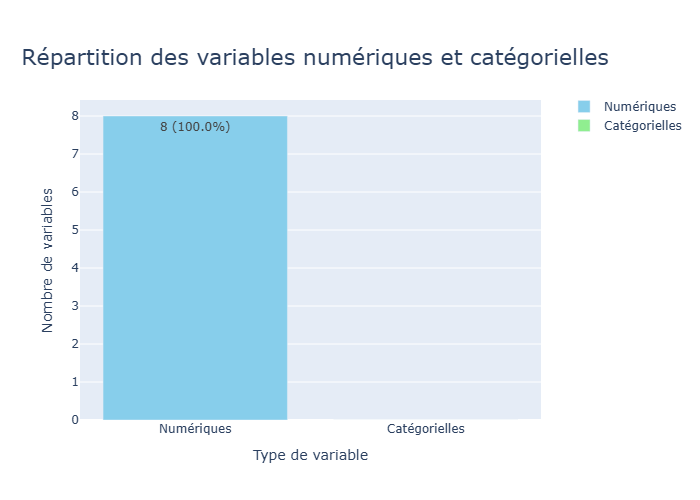

In [11]:
# Visualisation de la répartition des variables numériques et catégorielles.

num_cat_appli_train = plot_num_cat_distribution(df= df_install_payments,
                          chart_type='bar',
                          title="Répartition des variables numériques et catégorielles",
                          annotation_format= 'both',
                          title_size=22,
                          title_x= 0.45,
                          title_y= 0.90,
                          legend_x= 1.05,
                          legend_y= 0.95,
                          width=800,
                          height=800
)

num_cat_appli_train.show()

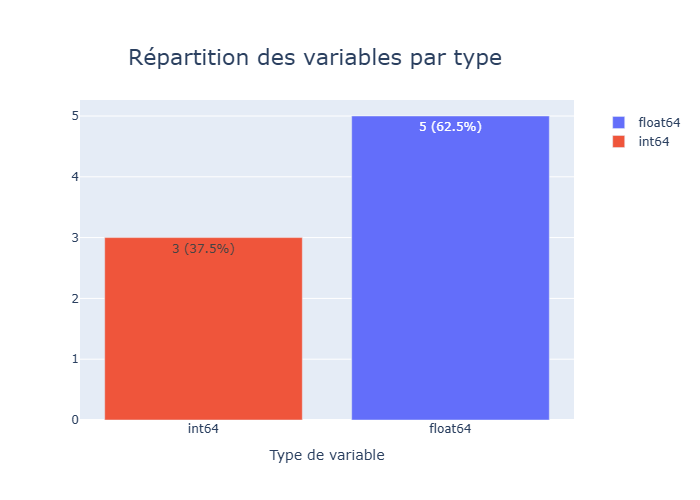

In [12]:
# Visualisation de la répartition des variables par type.

var_distrib_appli_train = plot_variable_types_distribution(df=df_install_payments,
                          chart_type='bar',
                          title_size=22,
                          title_x= 0.45,
                          title_y= 0.90,
                          legend_x= 1.05,
                          legend_y= 0.90,
                          annotation_format= 'both',
                          bar_orientation= 'v',
                          width=800,
                          height=800)

var_distrib_appli_train.show()

Ce fichier comporte essentiellement des variables quantitatives donc il n'y a pas de varaibles à encoder ici.

##### - Valeurs aberrantes de df_install_payments

In [13]:
# Liste des variables quantitatives du dataframe.

pprint.pprint(df_install_payments.select_dtypes(exclude=['object']).columns.tolist())

['SK_ID_PREV',
 'SK_ID_CURR',
 'NUM_INSTALMENT_VERSION',
 'NUM_INSTALMENT_NUMBER',
 'DAYS_INSTALMENT',
 'DAYS_ENTRY_PAYMENT',
 'AMT_INSTALMENT',
 'AMT_PAYMENT']


In [14]:
round(df_install_payments.describe(), 0)

,SK_ID_PREV,SK_ID_CURR,NUM_INSTALMENT_VERSION,NUM_INSTALMENT_NUMBER,DAYS_INSTALMENT,DAYS_ENTRY_PAYMENT,AMT_INSTALMENT,AMT_PAYMENT
count,13605401.0,13605401.0,13605401.0,13605401.0,13605401.0,13602496.0,13605401.0,13602496.0
mean,1903365.0,278445.0,1.0,19.0,-1042.0,-1051.0,17051.0,17238.0
std,536203.0,102718.0,1.0,27.0,801.0,801.0,50570.0,54736.0
min,1000001.0,100001.0,0.0,1.0,-2922.0,-4921.0,0.0,0.0
25%,1434191.0,189639.0,0.0,4.0,-1654.0,-1662.0,4226.0,3398.0
50%,1896520.0,278685.0,1.0,8.0,-818.0,-827.0,8884.0,8126.0
75%,2369094.0,367530.0,1.0,19.0,-361.0,-370.0,16710.0,16108.0
max,2843499.0,456255.0,178.0,277.0,-1.0,-1.0,3771488.0,3771488.0


- Comme pour les derniers fichiers, on ne constate pas de valeurs aberrantes si ce n'est des outliers positifs importants mais tout à fait plausibles dans la réalité.
- Donc on va de nouveau laisser nos variables en l'état et créer des features dérivées par la suite.

On peut maintenant passer aux valeurs manquantes :

In [15]:
# Calcul du nombre et du pourcentage de valeurs manquantes pour chaque colonne.

calculate_missing_values(df_install_payments)

,Nbr_valeurs_manquantes,Pct_valeurs_manquantes
DAYS_ENTRY_PAYMENT,2905,0.021352
AMT_PAYMENT,2905,0.021352


In [16]:
# Calcul du nombre et du pourcentage de valeurs manquantes pour l'ensemble du dataframe.

summarize_missing_values(df_pos_cash)

'Le DataFrame contient 52158 valeurs manquantes sur 80010864 observations, soit 0.07%.'

In [17]:
# Séparation des données train et test avant imputation.

df_install_payments_train = df_install_payments[df_install_payments['SK_ID_CURR'].isin(df_appli_train['SK_ID_CURR'])]
df_install_payments_test  = df_install_payments[df_install_payments['SK_ID_CURR'].isin(df_appli_test['SK_ID_CURR'])]

In [18]:
print_dataframe_shape(df_install_payments_train)

Le DataFrame contient 11,591,592 lignes et 8 colonnes.


In [19]:
print_dataframe_shape(df_install_payments_test)

Le DataFrame contient 2,013,809 lignes et 8 colonnes.


In [20]:
# Calcul du nombre et du pourcentage de valeurs manquantes pour chaque colonne.

calculate_missing_values(df_install_payments_train)

,Nbr_valeurs_manquantes,Pct_valeurs_manquantes
DAYS_ENTRY_PAYMENT,2583,0.022283
AMT_PAYMENT,2583,0.022283


In [21]:
# Calcul du nombre et du pourcentage de valeurs manquantes pour chaque colonne.

calculate_missing_values(df_install_payments_test)

,Nbr_valeurs_manquantes,Pct_valeurs_manquantes
DAYS_ENTRY_PAYMENT,322,0.015990
AMT_PAYMENT,322,0.015990


In [22]:
# Création des datasets suivant les différentes configurations.

cat_cols = df_install_payments.select_dtypes(include=["object"]).columns.tolist()
num_cols = df_install_payments.select_dtypes(exclude=["object"]).columns.tolist()

datasets_install_train = create_datasets(df_install_payments_train, cat_cols, num_cols, setups=("median_mode", "median_missing", "iterative_mode", "nan_missing"))
datasets_install_test = create_datasets(df_install_payments_test, cat_cols, num_cols, setups=("median_mode", "median_missing", "iterative_mode", "nan_missing"))

In [23]:
# On assigne chaque setup à un dataframe.

# Versions pour modèles linéaires (régression logistique, Lasso, Ridge, etc.)
df_inst_train_median_mode_linear = datasets_install_train["median_mode_linear"]
df_inst_train_median_missing_linear = datasets_install_train["median_missing_linear"]
df_inst_train_iterative_mode_linear = datasets_install_train["iterative_mode_linear"]
df_inst_train_nan_missing_linear = datasets_install_train["nan_missing_linear"]

# Versions pour modèles non-linéaires (arbres, LightGBM, RF, XGB, etc.)
df_inst_train_median_mode = datasets_install_train["median_mode_tree"]
df_inst_train_median_missing = datasets_install_train["median_missing_tree"]
df_inst_train_iterative_mode = datasets_install_train["iterative_mode_tree"]
df_inst_train_nan_missing = datasets_install_train["nan_missing_tree"]


# Versions pour modèles linéaires (régression logistique, Lasso, Ridge, etc.)
df_inst_test_median_mode_linear = datasets_install_test["median_mode_linear"]
df_inst_test_median_missing_linear = datasets_install_test["median_missing_linear"]
df_inst_test_iterative_mode_linear = datasets_install_test["iterative_mode_linear"]
df_inst_test_nan_missing_linear = datasets_install_test["nan_missing_linear"]

# Versions pour modèles non-linéaires (arbres, LightGBM, RF, XGB, etc.)
df_inst_test_median_mode = datasets_install_test["median_mode_tree"]
df_inst_test_median_missing = datasets_install_test["median_missing_tree"]
df_inst_test_iterative_mode = datasets_install_test["iterative_mode_tree"]
df_inst_test_nan_missing = datasets_install_test["nan_missing_tree"]

In [24]:
# Calcul du nombre et du pourcentage de valeurs manquantes restantes pour ces nouveaux dataframes.

print(summarize_missing_values(df_inst_train_median_mode_linear))
print(summarize_missing_values(df_inst_train_median_missing_linear))
print(summarize_missing_values(df_inst_train_iterative_mode_linear))
print(summarize_missing_values(df_inst_train_nan_missing_linear))

Le DataFrame contient 0 valeurs manquantes sur 92732736 observations, soit 0.00%.
Le DataFrame contient 0 valeurs manquantes sur 92732736 observations, soit 0.00%.
Le DataFrame contient 0 valeurs manquantes sur 92732736 observations, soit 0.00%.
Le DataFrame contient 5166 valeurs manquantes sur 92732736 observations, soit 0.01%.


In [25]:
print(summarize_missing_values(df_inst_test_median_mode_linear))
print(summarize_missing_values(df_inst_test_median_missing_linear))
print(summarize_missing_values(df_inst_test_iterative_mode_linear))
print(summarize_missing_values(df_inst_test_nan_missing_linear))

Le DataFrame contient 0 valeurs manquantes sur 16110472 observations, soit 0.00%.
Le DataFrame contient 0 valeurs manquantes sur 16110472 observations, soit 0.00%.
Le DataFrame contient 0 valeurs manquantes sur 16110472 observations, soit 0.00%.
Le DataFrame contient 644 valeurs manquantes sur 16110472 observations, soit 0.00%.


In [26]:
# Optimisation des types de variables et de la mémoire du dataframe.

optimize_types(df_inst_train_median_mode_linear)
optimize_types(df_inst_train_median_missing_linear)
optimize_types(df_inst_train_iterative_mode_linear)
optimize_types(df_inst_train_nan_missing_linear)
optimize_types(df_inst_train_median_mode)
optimize_types(df_inst_train_median_missing)
optimize_types(df_inst_train_iterative_mode)
optimize_types(df_inst_train_nan_missing)

 Mémoire avant : 795.93 MB
 Mémoire après : 442.18 MB
 Gain : 44.4%
 Mémoire avant : 795.93 MB
 Mémoire après : 442.18 MB
 Gain : 44.4%
 Mémoire avant : 795.93 MB
 Mémoire après : 442.18 MB
 Gain : 44.4%
 Mémoire avant : 795.93 MB
 Mémoire après : 453.24 MB
 Gain : 43.1%
 Mémoire avant : 1149.68 MB
 Mémoire après : 795.93 MB
 Gain : 30.8%
 Mémoire avant : 1149.68 MB
 Mémoire après : 795.93 MB
 Gain : 30.8%
 Mémoire avant : 1149.68 MB
 Mémoire après : 795.93 MB
 Gain : 30.8%
 Mémoire avant : 1149.68 MB
 Mémoire après : 806.99 MB
 Gain : 29.8%


,SK_ID_PREV,SK_ID_CURR,NUM_INSTALMENT_VERSION,NUM_INSTALMENT_NUMBER,DAYS_INSTALMENT,DAYS_ENTRY_PAYMENT,AMT_INSTALMENT,AMT_PAYMENT,SK_ID_PREV_was_missing,SK_ID_CURR_was_missing,NUM_INSTALMENT_VERSION_was_missing,NUM_INSTALMENT_NUMBER_was_missing,DAYS_INSTALMENT_was_missing,DAYS_ENTRY_PAYMENT_was_missing,AMT_INSTALMENT_was_missing,AMT_PAYMENT_was_missing
0,1054186,161674,1,6,-1180,-1187,6948.359863,6948.359863,0,0,0,0,0,0,0,0
1,1330831,151639,0,34,-2156,-2156,1716.525024,1716.525024,0,0,0,0,0,0,0,0
2,2085231,193053,2,1,-63,-63,25425.000000,25425.000000,0,0,0,0,0,0,0,0
3,2452527,199697,1,3,-2418,-2426,24350.130859,24350.130859,0,0,0,0,0,0,0,0
4,2714724,167756,1,2,-1383,-1366,2165.040039,2160.584961,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13605395,1499195,418486,6,2,-1012,<NA>,48635.593750,NaN,0,0,0,0,0,1,0,1
13605396,2186857,428057,0,66,-1624,<NA>,67.500000,NaN,0,0,0,0,0,1,0,1
13605397,1310347,414406,0,47,-1539,<NA>,67.500000,NaN,0,0,0,0,0,1,0,1
13605398,1308766,402199,0,43,-7,<NA>,43737.433594,NaN,0,0,0,0,0,1,0,1


In [27]:
# Optimisation des types de variables et de la mémoire du dataframe.

optimize_types(df_inst_test_median_mode_linear)
optimize_types(df_inst_test_median_missing_linear)
optimize_types(df_inst_test_iterative_mode_linear)
optimize_types(df_inst_test_nan_missing_linear)
optimize_types(df_inst_test_median_mode)
optimize_types(df_inst_test_median_missing)
optimize_types(df_inst_test_iterative_mode)
optimize_types(df_inst_test_nan_missing)

 Mémoire avant : 138.28 MB
 Mémoire après : 76.82 MB
 Gain : 44.4%
 Mémoire avant : 138.28 MB
 Mémoire après : 76.82 MB
 Gain : 44.4%
 Mémoire avant : 138.28 MB
 Mémoire après : 76.82 MB
 Gain : 44.4%
 Mémoire avant : 138.28 MB
 Mémoire après : 78.74 MB
 Gain : 43.1%
 Mémoire avant : 199.73 MB
 Mémoire après : 138.28 MB
 Gain : 30.8%
 Mémoire avant : 199.73 MB
 Mémoire après : 138.28 MB
 Gain : 30.8%
 Mémoire avant : 199.73 MB
 Mémoire après : 138.28 MB
 Gain : 30.8%
 Mémoire avant : 199.73 MB
 Mémoire après : 140.20 MB
 Gain : 29.8%


,SK_ID_PREV,SK_ID_CURR,NUM_INSTALMENT_VERSION,NUM_INSTALMENT_NUMBER,DAYS_INSTALMENT,DAYS_ENTRY_PAYMENT,AMT_INSTALMENT,AMT_PAYMENT,SK_ID_PREV_was_missing,SK_ID_CURR_was_missing,NUM_INSTALMENT_VERSION_was_missing,NUM_INSTALMENT_NUMBER_was_missing,DAYS_INSTALMENT_was_missing,DAYS_ENTRY_PAYMENT_was_missing,AMT_INSTALMENT_was_missing,AMT_PAYMENT_was_missing
9,1413990,109741,1,4,-570,-609,14308.469727,14308.469727,0,0,0,0,0,0,0,0
13,1723268,197273,1,14,-755,-800,6093.990234,6093.990234,0,0,0,0,0,0,0,0
19,2329072,183463,1,11,-1699,-1693,7283.294922,7283.294922,0,0,0,0,0,0,0,0
23,2631836,140337,0,116,-322,-322,560.880005,560.880005,0,0,0,0,0,0,0,0
24,2702769,102122,1,1,-281,-286,5178.194824,5178.194824,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13605366,2791282,413769,0,70,-370,<NA>,130.500000,NaN,0,0,0,0,0,1,0,1
13605374,1659443,405841,0,101,-1919,<NA>,67.500000,NaN,0,0,0,0,0,1,0,1
13605379,1062206,409297,0,44,-1955,<NA>,67.500000,NaN,0,0,0,0,0,1,0,1
13605394,1659443,405841,0,102,-1888,<NA>,67.500000,NaN,0,0,0,0,0,1,0,1


- On peut ensuite passer à la création de nouvelles features intéressante avec ce fichier :

In [28]:
# Ajout de nouvelles features dérivées intéressante avec ce fichier.

def add_installment_features(df):
    """
    Ajoute des features dérivées du dataset installments_payments.
    df : DataFrame pandas
    """

    import numpy as np

    df = df.copy()


    # Délais de paiement
    df["INST_DAYS_DIFF"] = (df["DAYS_ENTRY_PAYMENT"] - df["DAYS_INSTALMENT"])
    df["INST_LATE_PAYMENT"] = (df["INST_DAYS_DIFF"] > 0).astype("Int64")
    df["INST_EARLY_PAYMENT"] = (df["INST_DAYS_DIFF"] < 0).astype("Int64")
    df["INST_ON_TIME_PAYMENT"] = (df["INST_DAYS_DIFF"] == 0).astype("Int64")


    # Montants de paiement
    df["INST_PAYMENT_DIFF"] = (df["AMT_PAYMENT"] - df["AMT_INSTALMENT"])
    df["INST_PAYMENT_RATIO"] = (df["AMT_PAYMENT"] / (df["AMT_INSTALMENT"] + 1e-6))
    df["INST_UNDERPAYMENT"] = (df["INST_PAYMENT_DIFF"] < 0).astype("Int64")
    df["INST_OVERPAYMENT"] = (df["INST_PAYMENT_DIFF"] > 0).astype("Int64")

    # Intensité du sous-paiement (pourcentage manquant de la somme prévue)
    df["INST_UNDERPAY_RATIO"] = ((df["AMT_INSTALMENT"] - df["AMT_PAYMENT"]) / (df["AMT_INSTALMENT"] + 1e-6)).clip(lower=0)


    # Structure du plan de remboursement
    df["INST_INSTALMENT_PROGRESS"] = (df["NUM_INSTALMENT_NUMBER"] / (df.groupby("SK_ID_PREV")["NUM_INSTALMENT_NUMBER"].transform("max") + 1e-6))
    df["INST_IS_LAST_INSTALMENT"] = (df["NUM_INSTALMENT_NUMBER"] == df.groupby("SK_ID_PREV")["NUM_INSTALMENT_NUMBER"].transform("max")).astype(int)


    # Temporalité
    df["INST_IS_RECENT"] = (df["DAYS_ENTRY_PAYMENT"] > -90).astype("Int64")
    df["INST_IS_VERY_RECENT"] = (df["DAYS_ENTRY_PAYMENT"] > -30).astype("Int64")


    # Dynamique dans le temps
    df["INST_DAYS_LATE_TREND"] = (df.groupby("SK_ID_PREV")["INST_DAYS_DIFF"].diff())
    df["INST_PAYMENT_DIFF_TREND"] = (df.groupby("SK_ID_PREV")["INST_PAYMENT_DIFF"].diff())


    # Nettoyage
    df.replace([np.inf, -np.inf], np.nan, inplace=True)

    return df

In [29]:
# Ajout des nouvelles variables à l'aide la fonction créée précédemment.

df_inst_train_median_mode_linear_nf = add_installment_features(df_inst_train_median_mode_linear)
df_inst_train_median_missing_linear_nf = add_installment_features(df_inst_train_median_missing_linear)
df_inst_train_iterative_mode_linear_nf = add_installment_features(df_inst_train_iterative_mode_linear)
df_inst_train_nan_missing_linear_nf = add_installment_features(df_inst_train_nan_missing_linear)

df_inst_train_median_mode_nf = add_installment_features(df_inst_train_median_mode)
df_inst_train_median_missing_nf = add_installment_features(df_inst_train_median_missing)
df_inst_train_iterative_mode_nf= add_installment_features(df_inst_train_iterative_mode)
df_inst_train_nan_missing_nf = add_installment_features(df_inst_train_nan_missing)

df_inst_test_median_mode_linear_nf = add_installment_features(df_inst_test_median_mode_linear)
df_inst_test_median_missing_linear_nf = add_installment_features(df_inst_test_median_missing_linear)
df_inst_test_iterative_mode_linear_nf = add_installment_features(df_inst_test_iterative_mode_linear)
df_inst_test_nan_missing_linear_nf = add_installment_features(df_inst_test_nan_missing_linear)

df_inst_test_median_mode_nf = add_installment_features(df_inst_test_median_mode)
df_inst_test_median_missing_nf = add_installment_features(df_inst_test_median_missing)
df_inst_test_iterative_mode_nf = add_installment_features(df_inst_test_iterative_mode)
df_inst_test_nan_missing_nf = add_installment_features(df_inst_test_nan_missing)

In [30]:
# Suppression de "SK_ID_CURR" pour réaliser une première agrégation par crédit.

df_inst_train_median_mode_linear_nf.drop(columns=["SK_ID_CURR"], inplace=True)
df_inst_train_median_missing_linear_nf.drop(columns=["SK_ID_CURR"], inplace=True)
df_inst_train_iterative_mode_linear_nf.drop(columns=["SK_ID_CURR"], inplace=True)
df_inst_train_nan_missing_linear_nf.drop(columns=["SK_ID_CURR"], inplace=True)

df_inst_train_median_mode_nf.drop(columns=["SK_ID_CURR"], inplace=True)
df_inst_train_median_missing_nf.drop(columns=["SK_ID_CURR"], inplace=True)
df_inst_train_iterative_mode_nf.drop(columns=["SK_ID_CURR"], inplace=True)
df_inst_train_nan_missing_nf.drop(columns=["SK_ID_CURR"], inplace=True)

df_inst_test_median_mode_linear_nf.drop(columns=["SK_ID_CURR"], inplace=True)
df_inst_test_median_missing_linear_nf.drop(columns=["SK_ID_CURR"], inplace=True)
df_inst_test_iterative_mode_linear_nf.drop(columns=["SK_ID_CURR"], inplace=True)
df_inst_test_nan_missing_linear_nf.drop(columns=["SK_ID_CURR"], inplace=True)

df_inst_test_median_mode_nf.drop(columns=["SK_ID_CURR"], inplace=True)
df_inst_test_median_missing_nf.drop(columns=["SK_ID_CURR"], inplace=True)
df_inst_test_iterative_mode_nf.drop(columns=["SK_ID_CURR"], inplace=True)
df_inst_test_nan_missing_nf.drop(columns=["SK_ID_CURR"], inplace=True)

In [31]:
def aggregate_installments_by_credit(df):
    
    """
    Agrégation du fichier installments_payments au niveau crédit (SK_ID_PREV).
    df : DataFrame pandas
    """

    import numpy as np

    data = df.copy()


    # Colonnes à exclure
    exclude_cols = ["SK_ID_CURR"]

    base_numeric_cols = [
        c for c in data.columns
        if c not in exclude_cols + ["SK_ID_PREV"]
        and data[c].dtype != "object"
    ]


    # Séparation des types de colonnes
    was_missing_cols = [c for c in data.columns if c.endswith("_was_missing")]
    flag_cols = [c for c in data.columns if c.startswith("INST_") and data[c].dropna().isin([0, 1]).all()]

    # Colonnes dérivées
    derived_cols = [c for c in base_numeric_cols if c not in flag_cols + was_missing_cols]


    # Dictionnaire d’agrégation
    agg_dict = {}

    # Flags comportementaux
    for col in flag_cols:
        agg_dict[col] = ["mean", "sum", "max"]

    # Colonnes dérivées
    for col in derived_cols:
        agg_dict[col] = ["mean", "max", "min"]


    # Agrégation principale
    df_credit = data.groupby("SK_ID_PREV").agg(agg_dict)

    # Renommage 
    df_credit.columns = [
        f"INST_{col.upper()}_{stat.upper()}"
        for col, stat in df_credit.columns
    ]

    df_credit.reset_index(inplace=True)


    # Agrégation des indicateurs de missing
    if len(was_missing_cols) > 0:
        missing_agg = (data.groupby("SK_ID_PREV")[was_missing_cols].agg(["mean", "sum"]))
        missing_agg.columns = [
            f"INST_{col.upper()}_{stat.upper()}"
            for col, stat in missing_agg.columns
        ]
        missing_agg.reset_index(inplace=True)

        df_credit = df_credit.merge(missing_agg, on="SK_ID_PREV", how="left")


    # Ajout des features supplémentaires
    df_credit["INST_NB_PAYMENTS"] = (data.groupby("SK_ID_PREV").size().values)

    df_credit["INST_MEAN_INSTALMENT_NUMBER"] = (data.groupby("SK_ID_PREV")["NUM_INSTALMENT_NUMBER"].mean().values)

    df_credit["INST_MAX_INSTALMENT_NUMBER"] = (data.groupby("SK_ID_PREV")["NUM_INSTALMENT_NUMBER"].max().values)

    # Temporalité globale
    df_credit["INST_FIRST_PAYMENT_DAY"] = (data.groupby("SK_ID_PREV")["DAYS_ENTRY_PAYMENT"].min().values)

    df_credit["INST_LAST_PAYMENT_DAY"] = (data.groupby("SK_ID_PREV")["DAYS_ENTRY_PAYMENT"].max().values)


    # Nettoyage final
    df_credit.replace([np.inf, -np.inf], np.nan, inplace=True)

    return df_credit

In [32]:
# Agrégation au niveau des crédits dans un premier temps.

df_inst_train_median_mode_linear_cred = aggregate_installments_by_credit(df_inst_train_median_mode_linear_nf)
df_inst_train_median_missing_linear_cred = aggregate_installments_by_credit(df_inst_train_median_missing_linear_nf)
df_inst_train_iterative_mode_linear_cred = aggregate_installments_by_credit(df_inst_train_iterative_mode_linear_nf)
df_inst_train_nan_missing_linear_cred = aggregate_installments_by_credit(df_inst_train_nan_missing_linear_nf)

df_inst_train_median_mode_cred = aggregate_installments_by_credit(df_inst_train_median_mode_nf)
df_inst_train_median_missing_cred = aggregate_installments_by_credit(df_inst_train_median_missing_nf)
df_inst_train_iterative_mode_cred = aggregate_installments_by_credit(df_inst_train_iterative_mode_nf)
df_inst_train_nan_missing_cred = aggregate_installments_by_credit(df_inst_train_nan_missing_nf)

df_inst_test_median_mode_linear_cred = aggregate_installments_by_credit(df_inst_test_median_mode_linear_nf)
df_inst_test_median_missing_linear_cred = aggregate_installments_by_credit(df_inst_test_median_missing_linear_nf)
df_inst_test_iterative_mode_linear_cred = aggregate_installments_by_credit(df_inst_test_iterative_mode_linear_nf)
df_inst_test_nan_missing_linear_cred = aggregate_installments_by_credit(df_inst_test_nan_missing_linear_nf)

df_inst_test_median_mode_cred = aggregate_installments_by_credit(df_inst_test_median_mode_nf)
df_inst_test_median_missing_cred = aggregate_installments_by_credit(df_inst_test_median_missing_nf)
df_inst_test_iterative_mode_cred = aggregate_installments_by_credit(df_inst_test_iterative_mode_nf)
df_inst_test_nan_missing_cred = aggregate_installments_by_credit(df_inst_test_nan_missing_nf)

In [33]:
df_inst_train_median_mode_linear_cred

,SK_ID_PREV,INST_INST_LATE_PAYMENT_MEAN,INST_INST_LATE_PAYMENT_SUM,INST_INST_LATE_PAYMENT_MAX,INST_INST_EARLY_PAYMENT_MEAN,INST_INST_EARLY_PAYMENT_SUM,INST_INST_EARLY_PAYMENT_MAX,INST_INST_ON_TIME_PAYMENT_MEAN,INST_INST_ON_TIME_PAYMENT_SUM,INST_INST_ON_TIME_PAYMENT_MAX,...,INST_INST_DAYS_LATE_TREND_MAX,INST_INST_DAYS_LATE_TREND_MIN,INST_INST_PAYMENT_DIFF_TREND_MEAN,INST_INST_PAYMENT_DIFF_TREND_MAX,INST_INST_PAYMENT_DIFF_TREND_MIN,INST_NB_PAYMENTS,INST_MEAN_INSTALMENT_NUMBER,INST_MAX_INSTALMENT_NUMBER,INST_FIRST_PAYMENT_DAY,INST_LAST_PAYMENT_DAY
0,1000001,0.0,0,0,1.0,2,1,0.0,0,0,...,20.0,20.0,0.0,0.00000,0.00000,2,1.500000,2,-294,-244
1,1000003,0.0,0,0,1.0,3,1,0.0,0,0,...,1.0,-3.0,0.0,0.00000,0.00000,3,2.000000,3,-108,-49
2,1000004,0.0,0,0,1.0,7,1,0.0,0,0,...,39.0,-30.0,0.0,0.00000,0.00000,7,4.000000,7,-881,-695
3,1000005,0.181818,2,1,0.818182,9,1,0.0,0,0,...,32.0,-29.0,0.0,14710.81543,-14710.81543,11,5.818182,10,-1687,-1433
4,1000007,0.0,0,0,1.0,5,1,0.0,0,0,...,14.0,-12.0,0.0,0.00000,0.00000,5,3.000000,5,-143,-10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
853339,2843494,0.0,0,0,1.0,2,1,0.0,0,0,...,-18.0,-18.0,0.0,0.00000,0.00000,2,1.500000,2,-782,-770
853340,2843495,0.142857,1,1,0.714286,5,1,0.142857,1,1,...,15.0,-4.0,0.0,0.00000,0.00000,7,4.000000,7,-453,-264
853341,2843497,0.0,0,0,0.65,13,1,0.35,7,1,...,18.0,-19.0,0.0,0.00000,0.00000,20,10.500000,20,-602,-18
853342,2843498,0.0,0,0,0.833333,5,1,0.166667,1,1,...,12.0,-15.0,0.0,0.00000,0.00000,6,3.500000,6,-1464,-1296


In [34]:
# Agrégation au niveau client dans un deuxième temps

def aggregate_installments_by_client(df):
    """
    Agrège le dataframe installments_payments déjà agrégé au niveau crédit, au niveau client (SK_ID_CURR).
    df : DataFrame pandas
    """

    import numpy as np
    import pandas as pd

    data = df.copy()


    # Colonnes à exclure
    exclude_cols = ["SK_ID_PREV"]

    numeric_cols = [
        c for c in data.columns
        if c not in exclude_cols + ["SK_ID_CURR"]
        and pd.api.types.is_numeric_dtype(data[c])
    ]


    # Colonnes indicatrices
    was_missing_cols = [c for c in numeric_cols if c.endswith("_WAS_MISSING")]
    flag_cols = [c for c in numeric_cols if c.startswith("INST_") and c.endswith(("_MEAN", "_SUM", "_MAX"))
        and data[c].dropna().isin([0, 1]).all()
        ]

    count_cols = [c for c in numeric_cols if c.endswith("NB_PAYMENTS")]

    # Colonnes temporelles
    time_cols = [
        c for c in numeric_cols
        if any(x in c for x in ["FIRST_PAYMENT", "LAST_PAYMENT"])
    ]

    # Colonnes dérivées
    other_numeric = [
        c for c in numeric_cols
        if c not in flag_cols + was_missing_cols + time_cols + count_cols
    ]


    # Dictionnaire d’agrégation

    agg_dict = {}

    # Flags comportementaux
    for col in flag_cols:
        agg_dict[col] = ["mean", "sum", "max"]

    # Volumes (nb de paiements)
    for col in count_cols:
        agg_dict[col] = ["sum", "mean"]

    # Temporalité
    for col in time_cols:
        agg_dict[col] = ["min", "max", "mean"]

    # Autres variables continues
    for col in other_numeric:
        agg_dict[col] = ["mean", "max", "min"]


    # Agrégation principale SK_ID_CURR

    inst_client_agg = data.groupby("SK_ID_CURR").agg(agg_dict)

    inst_client_agg.columns = [
        f"{col.upper()}_{stat.upper()}"
        for col, stat in inst_client_agg.columns
    ]

    inst_client_agg.reset_index(inplace=True)


    # Agrégation des indicateurs de missing
    if len(was_missing_cols) > 0:
        missing_agg = (data.groupby("SK_ID_CURR")[was_missing_cols].agg(["mean", "sum"]))
        missing_agg.columns = [
            f"{col.upper()}_{stat.upper()}"
            for col, stat in missing_agg.columns
        ]
        missing_agg.reset_index(inplace=True)
        inst_client_agg = inst_client_agg.merge(missing_agg, on="SK_ID_CURR", how="left")


    # Nettoyage final
    inst_client_agg.replace([np.inf, -np.inf], np.nan, inplace=True)

    print(
        f"Agrégation installments_payments (niveau client) – shape : {inst_client_agg.shape}"
    )

    return inst_client_agg

In [35]:
# Rajout de la variable ID client aux dataframes

df_inst_train_median_mode_linear_cred = df_inst_train_median_mode_linear_cred.merge(df_init_install_payments[['SK_ID_PREV', 'SK_ID_CURR']], on='SK_ID_PREV', how='left')
df_inst_train_median_missing_linear_cred = df_inst_train_median_missing_linear_cred.merge(df_init_install_payments[['SK_ID_PREV', 'SK_ID_CURR']], on='SK_ID_PREV', how='left')
df_inst_train_iterative_mode_linear_cred = df_inst_train_iterative_mode_linear_cred.merge(df_init_install_payments[['SK_ID_PREV', 'SK_ID_CURR']], on='SK_ID_PREV', how='left')
df_inst_train_nan_missing_linear_cred = df_inst_train_nan_missing_linear_cred.merge(df_init_install_payments[['SK_ID_PREV', 'SK_ID_CURR']], on='SK_ID_PREV', how='left')

df_inst_train_median_mode_cred = df_inst_train_median_mode_cred.merge(df_init_install_payments[['SK_ID_PREV', 'SK_ID_CURR']], on='SK_ID_PREV', how='left')
df_inst_train_median_missing_cred = df_inst_train_median_missing_cred.merge(df_init_install_payments[['SK_ID_PREV', 'SK_ID_CURR']], on='SK_ID_PREV', how='left')
df_inst_train_iterative_mode_cred = df_inst_train_iterative_mode_cred.merge(df_init_install_payments[['SK_ID_PREV', 'SK_ID_CURR']], on='SK_ID_PREV', how='left')
df_inst_train_nan_missing_cred = df_inst_train_nan_missing_cred.merge(df_init_install_payments[['SK_ID_PREV', 'SK_ID_CURR']], on='SK_ID_PREV', how='left')

df_inst_test_median_mode_linear_cred = df_inst_test_median_mode_linear_cred.merge(df_init_install_payments[['SK_ID_PREV', 'SK_ID_CURR']], on='SK_ID_PREV', how='left')
df_inst_test_median_missing_linear_cred = df_inst_test_median_missing_linear_cred.merge(df_init_install_payments[['SK_ID_PREV', 'SK_ID_CURR']], on='SK_ID_PREV', how='left')
df_inst_test_iterative_mode_linear_cred = df_inst_test_iterative_mode_linear_cred.merge(df_init_install_payments[['SK_ID_PREV', 'SK_ID_CURR']], on='SK_ID_PREV', how='left')
df_inst_test_nan_missing_linear_cred = df_inst_test_nan_missing_linear_cred.merge(df_init_install_payments[['SK_ID_PREV', 'SK_ID_CURR']], on='SK_ID_PREV', how='left')

df_inst_test_median_mode_cred = df_inst_test_median_mode_cred.merge(df_init_install_payments[['SK_ID_PREV', 'SK_ID_CURR']], on='SK_ID_PREV', how='left')
df_inst_test_median_missing_cred = df_inst_test_median_missing_cred.merge(df_init_install_payments[['SK_ID_PREV', 'SK_ID_CURR']], on='SK_ID_PREV', how='left')
df_inst_test_iterative_mode_cred = df_inst_test_iterative_mode_cred.merge(df_init_install_payments[['SK_ID_PREV', 'SK_ID_CURR']], on='SK_ID_PREV', how='left')
df_inst_test_nan_missing_cred = df_inst_test_nan_missing_cred.merge(df_init_install_payments[['SK_ID_PREV', 'SK_ID_CURR']], on='SK_ID_PREV', how='left')

In [36]:
# Agrégation au niveau des clients dans un deuxième temps.

df_inst_train_median_mode_linear_agg = aggregate_installments_by_client(df_inst_train_median_mode_linear_cred)
df_inst_train_median_missing_linear_agg = aggregate_installments_by_client(df_inst_train_median_missing_linear_cred)
df_inst_train_iterative_mode_linear_agg = aggregate_installments_by_client(df_inst_train_iterative_mode_linear_cred)
df_inst_train_nan_missing_linear_agg= aggregate_installments_by_client(df_inst_train_nan_missing_linear_cred)

df_inst_train_median_mode_agg = aggregate_installments_by_client(df_inst_train_median_mode_cred)
df_inst_train_median_missing_agg = aggregate_installments_by_client(df_inst_train_median_missing_cred)
df_inst_train_iterative_mode_agg = aggregate_installments_by_client(df_inst_train_iterative_mode_cred)
df_inst_train_nan_missing_agg = aggregate_installments_by_client(df_inst_train_nan_missing_cred)

df_inst_test_median_mode_linear_agg = aggregate_installments_by_client(df_inst_test_median_mode_linear_cred)
df_inst_test_median_missing_linear_agg = aggregate_installments_by_client(df_inst_test_median_missing_linear_cred)
df_inst_test_iterative_mode_linear_agg = aggregate_installments_by_client(df_inst_test_iterative_mode_linear_cred)
df_inst_test_nan_missing_linear_agg = aggregate_installments_by_client(df_inst_test_nan_missing_linear_cred)

df_inst_test_median_mode_agg = aggregate_installments_by_client(df_inst_test_median_mode_cred)
df_inst_test_median_missing_agg = aggregate_installments_by_client(df_inst_test_median_missing_cred)
df_inst_test_iterative_mode_agg = aggregate_installments_by_client(df_inst_test_iterative_mode_cred)
df_inst_test_nan_missing_agg = aggregate_installments_by_client(df_inst_test_nan_missing_cred)

Agrégation installments_payments (niveau client) – shape : (291643, 204)
Agrégation installments_payments (niveau client) – shape : (291643, 204)
Agrégation installments_payments (niveau client) – shape : (291643, 204)
Agrégation installments_payments (niveau client) – shape : (291643, 204)
Agrégation installments_payments (niveau client) – shape : (291643, 252)
Agrégation installments_payments (niveau client) – shape : (291643, 252)
Agrégation installments_payments (niveau client) – shape : (291643, 252)
Agrégation installments_payments (niveau client) – shape : (291643, 252)
Agrégation installments_payments (niveau client) – shape : (47944, 204)
Agrégation installments_payments (niveau client) – shape : (47944, 204)
Agrégation installments_payments (niveau client) – shape : (47944, 204)
Agrégation installments_payments (niveau client) – shape : (47944, 204)
Agrégation installments_payments (niveau client) – shape : (47944, 252)
Agrégation installments_payments (niveau client) – shape

In [37]:
# Visualisation des changements apportés.

df_inst_train_median_mode_linear_agg.head()

,SK_ID_CURR,INST_INST_LATE_PAYMENT_MAX_MEAN,INST_INST_LATE_PAYMENT_MAX_SUM,INST_INST_LATE_PAYMENT_MAX_MAX,INST_INST_EARLY_PAYMENT_MAX_MEAN,INST_INST_EARLY_PAYMENT_MAX_SUM,INST_INST_EARLY_PAYMENT_MAX_MAX,INST_INST_ON_TIME_PAYMENT_MAX_MEAN,INST_INST_ON_TIME_PAYMENT_MAX_SUM,INST_INST_ON_TIME_PAYMENT_MAX_MAX,...,INST_INST_PAYMENT_DIFF_TREND_MAX_MIN,INST_INST_PAYMENT_DIFF_TREND_MIN_MEAN,INST_INST_PAYMENT_DIFF_TREND_MIN_MAX,INST_INST_PAYMENT_DIFF_TREND_MIN_MIN,INST_MEAN_INSTALMENT_NUMBER_MEAN,INST_MEAN_INSTALMENT_NUMBER_MAX,INST_MEAN_INSTALMENT_NUMBER_MIN,INST_MAX_INSTALMENT_NUMBER_MEAN,INST_MAX_INSTALMENT_NUMBER_MAX,INST_MAX_INSTALMENT_NUMBER_MIN
0,100002,0.0,0,0,1.0,19,1,0.0,0,0,...,0.0,0.000000,0.0,0.000000,10.000000,10.0,10.0,19.000000,19,19
1,100003,0.0,0,0,1.0,25,1,0.0,0,0,...,0.0,0.000000,0.0,0.000000,5.080000,6.5,3.5,9.160000,12,6
2,100004,0.0,0,0,1.0,3,1,0.0,0,0,...,0.0,0.000000,0.0,0.000000,2.000000,2.0,2.0,3.000000,3,3
3,100006,0.0,0,0,1.0,16,1,0.0,0,0,...,0.0,0.000000,0.0,0.000000,4.437500,5.5,1.0,7.875000,10,1
4,100007,0.560606,37,1,0.848485,56,1,0.590909,39,1,...,0.0,-5221.195312,0.0,-22632.523438,7.045455,9.0,5.5,12.984848,17,10


In [38]:
calculate_missing_values(df_inst_train_median_mode_linear_agg)

,Nbr_valeurs_manquantes,Pct_valeurs_manquantes
INST_INST_DAYS_LATE_TREND_MEAN_MEAN,730,0.250306
INST_INST_DAYS_LATE_TREND_MEAN_MAX,730,0.250306
INST_INST_PAYMENT_DIFF_TREND_MIN_MAX,730,0.250306
INST_INST_PAYMENT_DIFF_TREND_MIN_MEAN,730,0.250306
INST_INST_PAYMENT_DIFF_TREND_MAX_MIN,730,0.250306
INST_INST_PAYMENT_DIFF_TREND_MAX_MAX,730,0.250306
INST_INST_PAYMENT_DIFF_TREND_MAX_MEAN,730,0.250306
INST_INST_PAYMENT_DIFF_TREND_MEAN_MIN,730,0.250306
INST_INST_PAYMENT_DIFF_TREND_MEAN_MAX,730,0.250306
INST_INST_PAYMENT_DIFF_TREND_MEAN_MEAN,730,0.250306


In [39]:
# Merge des pairs bureau/application pour les datasets train

df_train_median_mode_linear = df_train_median_mode_linear.merge(
    df_inst_train_median_mode_linear_agg, on="SK_ID_CURR", how="left"
).fillna(0)

df_train_median_missing_linear = df_train_median_missing_linear.merge(
    df_inst_train_median_missing_linear_agg, on="SK_ID_CURR", how="left"
).fillna(0)

df_train_iterative_mode_linear = df_train_iterative_mode_linear.merge(
    df_inst_train_iterative_mode_linear_agg, on="SK_ID_CURR", how="left"
).fillna(0)

df_train_nan_missing_linear = df_train_nan_missing_linear.merge(
    df_inst_train_nan_missing_linear_agg, on="SK_ID_CURR", how="left"
)

df_train_median_mode = df_train_median_mode.merge(
    df_inst_train_median_mode_agg, on="SK_ID_CURR", how="left"
)

df_train_median_missing = df_train_median_missing.merge(
    df_inst_train_median_missing_agg, on="SK_ID_CURR", how="left"
)

df_train_iterative_mode = df_train_iterative_mode.merge(
    df_inst_train_iterative_mode_agg, on="SK_ID_CURR", how="left"
)

df_train_nan_missing = df_train_nan_missing.merge(
    df_inst_train_nan_missing_agg, on="SK_ID_CURR", how="left"
)

# Merge des pairs bureau/application pour les datasets test

df_test_median_mode_linear = df_test_median_mode_linear.merge(
    df_inst_test_median_mode_linear_agg, on="SK_ID_CURR", how="left"
).fillna(0)

df_test_median_missing_linear = df_test_median_missing_linear.merge(
    df_inst_test_median_missing_linear_agg, on="SK_ID_CURR", how="left"
).fillna(0)

df_test_iterative_mode_linear = df_test_iterative_mode_linear.merge(
    df_inst_test_iterative_mode_linear_agg, on="SK_ID_CURR", how="left"
).fillna(0)

df_test_nan_missing_linear = df_test_nan_missing_linear.merge(
    df_inst_test_nan_missing_linear_agg, on="SK_ID_CURR", how="left"
)

df_test_median_mode = df_test_median_mode.merge(
    df_inst_test_median_mode_agg, on="SK_ID_CURR", how="left"
)

df_test_median_missing = df_test_median_missing.merge(
    df_inst_test_median_missing_agg, on="SK_ID_CURR", how="left"
)

df_test_iterative_mode = df_test_iterative_mode.merge(
    df_inst_test_iterative_mode_agg, on="SK_ID_CURR", how="left"
)

df_test_nan_missing = df_test_nan_missing.merge(
    df_inst_test_nan_missing_agg, on="SK_ID_CURR", how="left"
)

In [40]:
# Visualisation des changements apportés.

df_train_median_mode_linear.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_ANNUITY,REGION_POPULATION_RELATIVE,OWN_CAR_AGE,FLAG_MOBIL,...,INST_INST_PAYMENT_DIFF_TREND_MAX_MIN,INST_INST_PAYMENT_DIFF_TREND_MIN_MEAN,INST_INST_PAYMENT_DIFF_TREND_MIN_MAX,INST_INST_PAYMENT_DIFF_TREND_MIN_MIN,INST_MEAN_INSTALMENT_NUMBER_MEAN,INST_MEAN_INSTALMENT_NUMBER_MAX,INST_MEAN_INSTALMENT_NUMBER_MIN,INST_MAX_INSTALMENT_NUMBER_MEAN,INST_MAX_INSTALMENT_NUMBER_MAX,INST_MAX_INSTALMENT_NUMBER_MIN
0,100002,1,0,1,0,1,24700.5,0.018801,9,1,...,0.0,0.000000,0.0,0.000000,10.000000,10.0,10.0,19.000000,19.0,19.0
1,100003,0,0,0,0,0,35698.5,0.003541,9,1,...,0.0,0.000000,0.0,0.000000,5.080000,6.5,3.5,9.160000,12.0,6.0
2,100004,0,1,1,1,1,6750.0,0.010032,26,1,...,0.0,0.000000,0.0,0.000000,2.000000,2.0,2.0,3.000000,3.0,3.0
3,100006,0,0,0,0,1,29686.5,0.008019,9,1,...,0.0,0.000000,0.0,0.000000,4.437500,5.5,1.0,7.875000,10.0,1.0
4,100007,0,0,1,0,1,21865.5,0.028663,9,1,...,0.0,-5221.195312,0.0,-22632.523438,7.045455,9.0,5.5,12.984848,17.0,10.0


In [41]:
calculate_missing_values(df_train_median_mode_linear)

,Nbr_valeurs_manquantes,Pct_valeurs_manquantes


#### Corrélation des variables - df_train_median_mode_linear

In [42]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_median_mode_linear[df_inst_train_median_mode_linear_agg.columns.tolist()], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,INST_INST_INSTALMENT_PROGRESS_MAX_MAX / INST_INST_INSTALMENT_PROGRESS_MAX_MEAN,INST_INST_INSTALMENT_PROGRESS_MAX_MEAN,INST_INST_INSTALMENT_PROGRESS_MAX_MAX,1.000000
1,INST_INST_INSTALMENT_PROGRESS_MAX_MAX / INST_INST_IS_LAST_INSTALMENT_MAX_MEAN,INST_INST_IS_LAST_INSTALMENT_MAX_MEAN,INST_INST_INSTALMENT_PROGRESS_MAX_MAX,1.000000
2,INST_INST_INSTALMENT_PROGRESS_MAX_MAX / INST_INST_IS_LAST_INSTALMENT_MAX_MAX,INST_INST_IS_LAST_INSTALMENT_MAX_MAX,INST_INST_INSTALMENT_PROGRESS_MAX_MAX,1.000000
3,INST_INST_INSTALMENT_PROGRESS_MAX_MEAN / INST_INST_IS_LAST_INSTALMENT_MAX_MEAN,INST_INST_IS_LAST_INSTALMENT_MAX_MEAN,INST_INST_INSTALMENT_PROGRESS_MAX_MEAN,1.000000
4,INST_INST_INSTALMENT_PROGRESS_MAX_MEAN / INST_INST_IS_LAST_INSTALMENT_MAX_MAX,INST_INST_IS_LAST_INSTALMENT_MAX_MAX,INST_INST_INSTALMENT_PROGRESS_MAX_MEAN,1.000000
5,INST_INST_INSTALMENT_PROGRESS_MAX_MEAN / INST_INST_INSTALMENT_PROGRESS_MAX_MIN,INST_INST_INSTALMENT_PROGRESS_MAX_MEAN,INST_INST_INSTALMENT_PROGRESS_MAX_MIN,1.000000
6,INST_INST_INSTALMENT_PROGRESS_MAX_MIN / INST_INST_IS_LAST_INSTALMENT_MAX_MAX,INST_INST_IS_LAST_INSTALMENT_MAX_MAX,INST_INST_INSTALMENT_PROGRESS_MAX_MIN,1.000000
7,INST_INST_INSTALMENT_PROGRESS_MAX_MIN / INST_INST_IS_LAST_INSTALMENT_MAX_MEAN,INST_INST_IS_LAST_INSTALMENT_MAX_MEAN,INST_INST_INSTALMENT_PROGRESS_MAX_MIN,1.000000
8,INST_INST_INSTALMENT_PROGRESS_MAX_MAX / INST_INST_INSTALMENT_PROGRESS_MAX_MIN,INST_INST_INSTALMENT_PROGRESS_MAX_MAX,INST_INST_INSTALMENT_PROGRESS_MAX_MIN,1.000000
9,INST_DAYS_INSTALMENT_MIN_MIN / INST_FIRST_PAYMENT_DAY_MIN,INST_FIRST_PAYMENT_DAY_MIN,INST_DAYS_INSTALMENT_MIN_MIN,0.999857


In [43]:
df_corr = get_correlation_pairs(df_train_median_mode_linear[df_inst_train_median_mode_linear_agg.columns.tolist()], method="pearson", style=False, threshold=0.8)

In [44]:
var_corr = df_corr['Variable 1'].unique().tolist() + df_corr['Variable 2'].unique().tolist()
var_corr = list(set(var_corr))

In [45]:
# Visualisation des corrélations les plus importantes avec la Target.

pd.set_option('display.max_rows', None)

target_corr = compute_target_correlations(df_train_median_mode_linear.loc[:, var_corr + ["TARGET"]], 'TARGET', mode='linear', plot=False)
target_corr.loc[var_corr].sort_values(by='pearson_corr', ascending=False)

,pearson_corr,spearman_corr,abs_pearson,abs_spearman,score_global
INST_INST_LATE_PAYMENT_MEAN_MIN,0.071040,0.071181,0.071040,0.071181,0.071110
INST_INST_LATE_PAYMENT_MEAN_MEAN,0.070431,0.064820,0.070431,0.064820,0.067625
INST_INST_LATE_PAYMENT_MAX_MEAN,0.069385,0.067088,0.069385,0.067088,0.068236
INST_INST_UNDERPAY_RATIO_MAX_MEAN,0.064719,0.059003,0.064719,0.059003,0.061861
INST_INST_UNDERPAY_RATIO_MAX_MIN,0.064703,0.064614,0.064703,0.064614,0.064659
INST_INST_UNDERPAYMENT_MAX_MEAN,0.064068,0.059279,0.064068,0.059279,0.061673
INST_INST_UNDERPAY_RATIO_MEAN_MEAN,0.063595,0.058047,0.063595,0.058047,0.060821
INST_INST_UNDERPAYMENT_MEAN_MIN,0.063390,0.065508,0.063390,0.065508,0.064449
INST_INST_UNDERPAYMENT_MEAN_MEAN,0.063287,0.058032,0.063287,0.058032,0.060660
INST_INST_UNDERPAY_RATIO_MEAN_MIN,0.063237,0.065497,0.063237,0.065497,0.064367


In [46]:
pd.reset_option('display.max_rows')

In [47]:
# Fonction permettant de visualiser les groupes de corrélations afin de faire un choix de variable.

pd.set_option('display.max_colwidth', None)
sum_corr_grps_med_mode_linear = summarize_correlated_groups(df_corr, X=df_train_median_mode_linear, y=df_train_median_mode_linear['TARGET'])
sum_corr_grps_med_mode_linear

,Variables du groupe,Taille du groupe,Corrélation max avec y,Variable la plus corrélée
0,"[INST_INST_UNDERPAYMENT_MAX_SUM, INST_MEAN_INSTALMENT_NUMBER_MAX, INST_NB_PAYMENTS_SUM, INST_INST_EARLY_PAYMENT_MAX_SUM, INST_INST_ON_TIME_PAYMENT_MAX_SUM, INST_NB_PAYMENTS_MEAN, INST_MEAN_INSTALMENT_NUMBER_MEAN, INST_INST_EARLY_PAYMENT_SUM_MEAN, INST_INST_ON_TIME_PAYMENT_SUM_MAX, INST_MAX_INSTALMENT_NUMBER_MAX, INST_NUM_INSTALMENT_NUMBER_MAX_MEAN, INST_INST_LATE_PAYMENT_MAX_SUM, INST_NUM_INSTALMENT_NUMBER_MAX_MAX, INST_INST_IS_RECENT_MAX_SUM, INST_INST_IS_VERY_RECENT_MAX_SUM, INST_INST_IS_LAST_INSTALMENT_MAX_SUM, INST_MAX_INSTALMENT_NUMBER_MEAN, INST_INST_ON_TIME_PAYMENT_SUM_MEAN, INST_NUM_INSTALMENT_NUMBER_MEAN_MEAN, INST_INST_EARLY_PAYMENT_SUM_MAX, INST_NUM_INSTALMENT_NUMBER_MEAN_MAX]",21,0.022265,INST_INST_EARLY_PAYMENT_SUM_MAX
1,"[INST_LAST_PAYMENT_DAY_MIN, INST_DAYS_INSTALMENT_MIN_MEAN, INST_DAYS_ENTRY_PAYMENT_MEAN_MIN, INST_FIRST_PAYMENT_DAY_MEAN, INST_DAYS_ENTRY_PAYMENT_MAX_MIN, INST_DAYS_INSTALMENT_MIN_MIN, INST_DAYS_INSTALMENT_MEAN_MIN, INST_DAYS_ENTRY_PAYMENT_MIN_MIN, INST_DAYS_ENTRY_PAYMENT_MEAN_MEAN, INST_DAYS_INSTALMENT_MAX_MEAN, INST_DAYS_INSTALMENT_MAX_MIN, INST_DAYS_ENTRY_PAYMENT_MAX_MEAN, INST_LAST_PAYMENT_DAY_MEAN, INST_DAYS_INSTALMENT_MEAN_MEAN, INST_DAYS_ENTRY_PAYMENT_MIN_MEAN, INST_FIRST_PAYMENT_DAY_MIN]",16,0.047264,INST_DAYS_ENTRY_PAYMENT_MEAN_MIN
2,"[INST_INST_INSTALMENT_PROGRESS_MEAN_MIN, INST_INST_INSTALMENT_PROGRESS_MAX_MEAN, INST_INST_INSTALMENT_PROGRESS_MAX_MIN, INST_INST_INSTALMENT_PROGRESS_MAX_MAX, INST_INST_EARLY_PAYMENT_MAX_MAX, INST_INST_EARLY_PAYMENT_MAX_MEAN, INST_INST_INSTALMENT_PROGRESS_MEAN_MEAN, INST_INST_EARLY_PAYMENT_MEAN_MAX, INST_INST_IS_LAST_INSTALMENT_SUM_MAX, INST_INST_IS_LAST_INSTALMENT_SUM_MEAN, INST_INST_IS_LAST_INSTALMENT_SUM_MIN, INST_INST_IS_LAST_INSTALMENT_MAX_MEAN, INST_INST_IS_LAST_INSTALMENT_MAX_MAX]",13,0.029928,INST_INST_IS_LAST_INSTALMENT_SUM_MIN
3,"[INST_INST_UNDERPAYMENT_MEAN_MAX, INST_INST_LATE_PAYMENT_MEAN_MEAN, INST_INST_UNDERPAYMENT_SUM_MEAN, INST_INST_UNDERPAY_RATIO_MEAN_MEAN, INST_INST_UNDERPAYMENT_MEAN_MEAN, INST_INST_UNDERPAYMENT_SUM_MAX, INST_INST_UNDERPAY_RATIO_MEAN_MAX, INST_INST_LATE_PAYMENT_MEAN_MAX, INST_INST_LATE_PAYMENT_SUM_MEAN, INST_INST_LATE_PAYMENT_SUM_MAX]",10,0.070431,INST_INST_LATE_PAYMENT_MEAN_MEAN
4,"[INST_DAYS_INSTALMENT_MIN_MAX, INST_LAST_PAYMENT_DAY_MAX, INST_DAYS_ENTRY_PAYMENT_MEAN_MAX, INST_DAYS_ENTRY_PAYMENT_MIN_MAX, INST_DAYS_INSTALMENT_MAX_MAX, INST_DAYS_ENTRY_PAYMENT_MAX_MAX, INST_FIRST_PAYMENT_DAY_MAX, INST_DAYS_INSTALMENT_MEAN_MAX]",8,0.005534,INST_DAYS_INSTALMENT_MAX_MAX
5,"[INST_AMT_PAYMENT_MIN_MEAN, INST_AMT_PAYMENT_MEAN_MIN, INST_AMT_PAYMENT_MIN_MIN, INST_AMT_INSTALMENT_MEAN_MEAN, INST_AMT_INSTALMENT_MEAN_MIN, INST_AMT_PAYMENT_MEAN_MEAN, INST_AMT_INSTALMENT_MIN_MIN, INST_AMT_INSTALMENT_MIN_MEAN]",8,0.038347,INST_AMT_PAYMENT_MIN_MEAN
6,"[INST_INST_PAYMENT_DIFF_MAX_MAX, INST_INST_PAYMENT_DIFF_MEAN_MAX, INST_INST_PAYMENT_DIFF_TREND_MIN_MEAN, INST_INST_PAYMENT_DIFF_TREND_MIN_MIN, INST_INST_PAYMENT_DIFF_TREND_MAX_MAX, INST_INST_PAYMENT_DIFF_MAX_MEAN, INST_INST_PAYMENT_DIFF_TREND_MAX_MEAN]",7,0.016928,INST_INST_PAYMENT_DIFF_MEAN_MAX
7,"[INST_INST_IS_VERY_RECENT_SUM_MAX, INST_INST_IS_RECENT_MAX_MEAN, INST_INST_IS_RECENT_SUM_MAX, INST_INST_IS_RECENT_SUM_MEAN, INST_INST_IS_VERY_RECENT_MAX_MAX, INST_INST_IS_VERY_RECENT_SUM_MEAN, INST_INST_IS_VERY_RECENT_MAX_MEAN]",7,0.043366,INST_INST_IS_RECENT_SUM_MEAN
8,"[INST_INST_OVERPAYMENT_MEAN_MEAN, INST_NUM_INSTALMENT_VERSION_MEAN_MEAN, INST_INST_OVERPAYMENT_SUM_MEAN, INST_INST_OVERPAYMENT_SUM_MAX, INST_NUM_INSTALMENT_VERSION_MAX_MEAN, INST_NUM_INSTALMENT_VERSION_MEAN_MAX, INST_NUM_INSTALMENT_VERSION_MAX_MAX]",7,0.025068,INST_INST_OVERPAYMENT_SUM_MAX
9,"[INST_INST_UNDERPAYMENT_MEAN_MIN, INST_INST_UNDERPAY_RATIO_MEAN_MIN, INST_INST_LATE_PAYMENT_SUM_MIN, INST_INST_LATE_PAYMENT_MEAN_MIN, INST_INST_UNDERPAY_RATIO_MAX_MIN, INST_INST_UNDERPAYMENT_SUM_MIN]",6,0.071040,INST_INST_LATE_PAYMENT_MEAN_MIN


In [48]:
pd.reset_option('display.max_colwidth')

In [49]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

# Variables à garder
vars_best = set(sum_corr_grps_med_mode_linear["Variable la plus corrélée"].tolist())

vars_corr_groups = set()
for var in sum_corr_grps_med_mode_linear["Variables du groupe"]:
    vars_corr_groups.update(var)

# Variables à supprimer
vars_to_remove_med_mode_linear = list(vars_corr_groups - vars_best)

# Variable restante après agrégation
all_vars = df_train_median_mode_linear[df_inst_train_median_mode_linear_agg.columns].columns.tolist()

vars_not_in_corr_groups = set(all_vars) - vars_corr_groups
vars_to_keep = list(vars_best.union(vars_not_in_corr_groups))

df_train_median_mode_linear.drop(columns=vars_to_remove_med_mode_linear, inplace=True, errors="ignore")

In [50]:
remaining_cols = list(set(df_inst_train_median_mode_linear_agg.columns).intersection(df_train_median_mode_linear.columns))

In [51]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_train_median_mode_linear[remaining_cols], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation


In [52]:
# Réduction de la taille du dataframe.

optimize_types(df_train_median_mode_linear)

 Mémoire avant : 747.29 MB
 Mémoire après : 721.49 MB
 Gain : 3.5%


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_ANNUITY,REGION_POPULATION_RELATIVE,OWN_CAR_AGE,FLAG_MOBIL,...,INST_INST_DAYS_LATE_TREND_MEAN_MAX,INST_INST_DAYS_LATE_TREND_MEAN_MIN,INST_INST_DAYS_LATE_TREND_MAX_MIN,INST_INST_DAYS_LATE_TREND_MIN_MEAN,INST_INST_DAYS_LATE_TREND_MIN_MAX,INST_INST_PAYMENT_DIFF_TREND_MEAN_MEAN,INST_INST_PAYMENT_DIFF_TREND_MEAN_MAX,INST_INST_PAYMENT_DIFF_TREND_MEAN_MIN,INST_INST_PAYMENT_DIFF_TREND_MAX_MIN,INST_MAX_INSTALMENT_NUMBER_MIN
0,100002,1,0,1,0,1,24700.5,0.018801,9,1,...,-0.500000,-0.500000,10,-16.000000,-16,0.000000,0.00000,0.000000,0.0,19
1,100003,0,0,0,0,0,35698.5,0.003541,9,1,...,0.000000,-0.200000,4,-5.640000,-3,0.000000,0.00000,0.000000,0.0,6
2,100004,0,1,1,1,1,6750.0,0.010032,26,1,...,3.000000,3.000000,8,-2.000000,-2,0.000000,0.00000,0.000000,0.0,3
3,100006,0,0,0,0,1,29686.5,0.008019,9,1,...,7.500000,0.444444,12,-26.666666,-9,0.000000,0.00000,0.000000,0.0,1
4,100007,0,0,1,0,1,21865.5,0.028663,9,1,...,0.384615,-1.062500,4,-17.939394,-2,0.000000,0.00000,0.000000,0.0,10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307495,456251,0,0,1,0,0,27558.0,0.032561,9,1,...,-0.833333,-0.833333,34,-36.000000,-36,0.000000,0.00000,0.000000,0.0,7
307496,456252,0,0,0,0,1,12001.5,0.025164,9,1,...,1.600000,1.600000,11,-7.000000,-7,0.000000,0.00000,0.000000,0.0,6
307497,456253,0,0,0,0,1,29979.0,0.005002,9,1,...,7.500000,-0.600000,0,-22.071428,0,-2.434823,0.00000,-6.817505,0.0,4
307498,456254,1,0,0,0,1,20205.0,0.005313,9,1,...,0.375000,0.333333,3,-6.578948,-5,0.000000,0.00000,0.000000,0.0,9


#### Corrélation des variables - df_train_median_missing_linear

In [53]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_median_missing_linear[df_inst_train_median_missing_linear_agg.columns.tolist()], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,INST_INST_INSTALMENT_PROGRESS_MAX_MAX / INST_INST_INSTALMENT_PROGRESS_MAX_MEAN,INST_INST_INSTALMENT_PROGRESS_MAX_MEAN,INST_INST_INSTALMENT_PROGRESS_MAX_MAX,1.000000
1,INST_INST_INSTALMENT_PROGRESS_MAX_MAX / INST_INST_IS_LAST_INSTALMENT_MAX_MEAN,INST_INST_IS_LAST_INSTALMENT_MAX_MEAN,INST_INST_INSTALMENT_PROGRESS_MAX_MAX,1.000000
2,INST_INST_INSTALMENT_PROGRESS_MAX_MAX / INST_INST_IS_LAST_INSTALMENT_MAX_MAX,INST_INST_IS_LAST_INSTALMENT_MAX_MAX,INST_INST_INSTALMENT_PROGRESS_MAX_MAX,1.000000
3,INST_INST_INSTALMENT_PROGRESS_MAX_MEAN / INST_INST_IS_LAST_INSTALMENT_MAX_MEAN,INST_INST_IS_LAST_INSTALMENT_MAX_MEAN,INST_INST_INSTALMENT_PROGRESS_MAX_MEAN,1.000000
4,INST_INST_INSTALMENT_PROGRESS_MAX_MEAN / INST_INST_IS_LAST_INSTALMENT_MAX_MAX,INST_INST_IS_LAST_INSTALMENT_MAX_MAX,INST_INST_INSTALMENT_PROGRESS_MAX_MEAN,1.000000
5,INST_INST_INSTALMENT_PROGRESS_MAX_MEAN / INST_INST_INSTALMENT_PROGRESS_MAX_MIN,INST_INST_INSTALMENT_PROGRESS_MAX_MEAN,INST_INST_INSTALMENT_PROGRESS_MAX_MIN,1.000000
6,INST_INST_INSTALMENT_PROGRESS_MAX_MIN / INST_INST_IS_LAST_INSTALMENT_MAX_MAX,INST_INST_IS_LAST_INSTALMENT_MAX_MAX,INST_INST_INSTALMENT_PROGRESS_MAX_MIN,1.000000
7,INST_INST_INSTALMENT_PROGRESS_MAX_MIN / INST_INST_IS_LAST_INSTALMENT_MAX_MEAN,INST_INST_IS_LAST_INSTALMENT_MAX_MEAN,INST_INST_INSTALMENT_PROGRESS_MAX_MIN,1.000000
8,INST_INST_INSTALMENT_PROGRESS_MAX_MAX / INST_INST_INSTALMENT_PROGRESS_MAX_MIN,INST_INST_INSTALMENT_PROGRESS_MAX_MAX,INST_INST_INSTALMENT_PROGRESS_MAX_MIN,1.000000
9,INST_DAYS_INSTALMENT_MIN_MIN / INST_FIRST_PAYMENT_DAY_MIN,INST_FIRST_PAYMENT_DAY_MIN,INST_DAYS_INSTALMENT_MIN_MIN,0.999857


In [54]:
df_corr = get_correlation_pairs(df_train_median_missing_linear[df_inst_train_median_missing_linear_agg.columns.tolist()], method="pearson", style=False, threshold=0.8)

In [55]:
var_corr = df_corr['Variable 1'].unique().tolist() + df_corr['Variable 2'].unique().tolist()
var_corr = list(set(var_corr))

In [56]:
# Visualisation des corrélations les plus importantes avec la Target.

pd.set_option('display.max_rows', None)

target_corr = compute_target_correlations(df_train_median_missing_linear.loc[:, var_corr + ['TARGET']], 'TARGET', mode='linear', plot=False)
target_corr.loc[var_corr].sort_values(by='pearson_corr', ascending=False)

,pearson_corr,spearman_corr,abs_pearson,abs_spearman,score_global
INST_INST_LATE_PAYMENT_MEAN_MIN,0.071040,0.071181,0.071040,0.071181,0.071110
INST_INST_LATE_PAYMENT_MEAN_MEAN,0.070431,0.064820,0.070431,0.064820,0.067625
INST_INST_LATE_PAYMENT_MAX_MEAN,0.069385,0.067088,0.069385,0.067088,0.068236
INST_INST_UNDERPAY_RATIO_MAX_MEAN,0.064719,0.059003,0.064719,0.059003,0.061861
INST_INST_UNDERPAY_RATIO_MAX_MIN,0.064703,0.064614,0.064703,0.064614,0.064659
INST_INST_UNDERPAYMENT_MAX_MEAN,0.064068,0.059279,0.064068,0.059279,0.061673
INST_INST_UNDERPAY_RATIO_MEAN_MEAN,0.063595,0.058047,0.063595,0.058047,0.060821
INST_INST_UNDERPAYMENT_MEAN_MIN,0.063390,0.065508,0.063390,0.065508,0.064449
INST_INST_UNDERPAYMENT_MEAN_MEAN,0.063287,0.058032,0.063287,0.058032,0.060660
INST_INST_UNDERPAY_RATIO_MEAN_MIN,0.063237,0.065497,0.063237,0.065497,0.064367


In [57]:
pd.reset_option('display.max_rows')

In [58]:
# Fonction permettant de visualiser les groupes de corrélations afin de faire un choix de variable.

pd.set_option('display.max_colwidth', None)
sum_corr_grps_med_miss_linear = summarize_correlated_groups(df_corr, X=df_train_median_missing_linear, y=df_train_median_missing_linear['TARGET'])
sum_corr_grps_med_miss_linear

,Variables du groupe,Taille du groupe,Corrélation max avec y,Variable la plus corrélée
0,"[INST_INST_UNDERPAYMENT_MAX_SUM, INST_MEAN_INSTALMENT_NUMBER_MAX, INST_NB_PAYMENTS_SUM, INST_INST_EARLY_PAYMENT_MAX_SUM, INST_INST_ON_TIME_PAYMENT_MAX_SUM, INST_NB_PAYMENTS_MEAN, INST_MEAN_INSTALMENT_NUMBER_MEAN, INST_INST_EARLY_PAYMENT_SUM_MEAN, INST_INST_ON_TIME_PAYMENT_SUM_MAX, INST_MAX_INSTALMENT_NUMBER_MAX, INST_NUM_INSTALMENT_NUMBER_MAX_MEAN, INST_INST_LATE_PAYMENT_MAX_SUM, INST_NUM_INSTALMENT_NUMBER_MAX_MAX, INST_INST_IS_RECENT_MAX_SUM, INST_INST_IS_VERY_RECENT_MAX_SUM, INST_INST_IS_LAST_INSTALMENT_MAX_SUM, INST_MAX_INSTALMENT_NUMBER_MEAN, INST_INST_ON_TIME_PAYMENT_SUM_MEAN, INST_NUM_INSTALMENT_NUMBER_MEAN_MEAN, INST_INST_EARLY_PAYMENT_SUM_MAX, INST_NUM_INSTALMENT_NUMBER_MEAN_MAX]",21,0.022265,INST_INST_EARLY_PAYMENT_SUM_MAX
1,"[INST_LAST_PAYMENT_DAY_MIN, INST_DAYS_INSTALMENT_MIN_MEAN, INST_DAYS_ENTRY_PAYMENT_MEAN_MIN, INST_FIRST_PAYMENT_DAY_MEAN, INST_DAYS_ENTRY_PAYMENT_MAX_MIN, INST_DAYS_INSTALMENT_MIN_MIN, INST_DAYS_INSTALMENT_MEAN_MIN, INST_DAYS_ENTRY_PAYMENT_MIN_MIN, INST_DAYS_ENTRY_PAYMENT_MEAN_MEAN, INST_DAYS_INSTALMENT_MAX_MEAN, INST_DAYS_INSTALMENT_MAX_MIN, INST_DAYS_ENTRY_PAYMENT_MAX_MEAN, INST_LAST_PAYMENT_DAY_MEAN, INST_DAYS_INSTALMENT_MEAN_MEAN, INST_DAYS_ENTRY_PAYMENT_MIN_MEAN, INST_FIRST_PAYMENT_DAY_MIN]",16,0.047264,INST_DAYS_ENTRY_PAYMENT_MEAN_MIN
2,"[INST_INST_INSTALMENT_PROGRESS_MEAN_MIN, INST_INST_INSTALMENT_PROGRESS_MAX_MEAN, INST_INST_INSTALMENT_PROGRESS_MAX_MIN, INST_INST_INSTALMENT_PROGRESS_MAX_MAX, INST_INST_EARLY_PAYMENT_MAX_MAX, INST_INST_EARLY_PAYMENT_MAX_MEAN, INST_INST_INSTALMENT_PROGRESS_MEAN_MEAN, INST_INST_EARLY_PAYMENT_MEAN_MAX, INST_INST_IS_LAST_INSTALMENT_SUM_MAX, INST_INST_IS_LAST_INSTALMENT_SUM_MEAN, INST_INST_IS_LAST_INSTALMENT_SUM_MIN, INST_INST_IS_LAST_INSTALMENT_MAX_MEAN, INST_INST_IS_LAST_INSTALMENT_MAX_MAX]",13,0.029928,INST_INST_IS_LAST_INSTALMENT_SUM_MIN
3,"[INST_INST_UNDERPAYMENT_MEAN_MAX, INST_INST_LATE_PAYMENT_MEAN_MEAN, INST_INST_UNDERPAYMENT_SUM_MEAN, INST_INST_UNDERPAY_RATIO_MEAN_MEAN, INST_INST_UNDERPAYMENT_MEAN_MEAN, INST_INST_UNDERPAYMENT_SUM_MAX, INST_INST_UNDERPAY_RATIO_MEAN_MAX, INST_INST_LATE_PAYMENT_MEAN_MAX, INST_INST_LATE_PAYMENT_SUM_MEAN, INST_INST_LATE_PAYMENT_SUM_MAX]",10,0.070431,INST_INST_LATE_PAYMENT_MEAN_MEAN
4,"[INST_DAYS_INSTALMENT_MIN_MAX, INST_LAST_PAYMENT_DAY_MAX, INST_DAYS_ENTRY_PAYMENT_MEAN_MAX, INST_DAYS_ENTRY_PAYMENT_MIN_MAX, INST_DAYS_INSTALMENT_MAX_MAX, INST_DAYS_ENTRY_PAYMENT_MAX_MAX, INST_FIRST_PAYMENT_DAY_MAX, INST_DAYS_INSTALMENT_MEAN_MAX]",8,0.005534,INST_DAYS_INSTALMENT_MAX_MAX
5,"[INST_AMT_PAYMENT_MIN_MEAN, INST_AMT_PAYMENT_MEAN_MIN, INST_AMT_PAYMENT_MIN_MIN, INST_AMT_INSTALMENT_MEAN_MEAN, INST_AMT_INSTALMENT_MEAN_MIN, INST_AMT_PAYMENT_MEAN_MEAN, INST_AMT_INSTALMENT_MIN_MIN, INST_AMT_INSTALMENT_MIN_MEAN]",8,0.038347,INST_AMT_PAYMENT_MIN_MEAN
6,"[INST_INST_PAYMENT_DIFF_MAX_MAX, INST_INST_PAYMENT_DIFF_MEAN_MAX, INST_INST_PAYMENT_DIFF_TREND_MIN_MEAN, INST_INST_PAYMENT_DIFF_TREND_MIN_MIN, INST_INST_PAYMENT_DIFF_TREND_MAX_MAX, INST_INST_PAYMENT_DIFF_MAX_MEAN, INST_INST_PAYMENT_DIFF_TREND_MAX_MEAN]",7,0.016928,INST_INST_PAYMENT_DIFF_MEAN_MAX
7,"[INST_INST_IS_VERY_RECENT_SUM_MAX, INST_INST_IS_RECENT_MAX_MEAN, INST_INST_IS_RECENT_SUM_MAX, INST_INST_IS_RECENT_SUM_MEAN, INST_INST_IS_VERY_RECENT_MAX_MAX, INST_INST_IS_VERY_RECENT_SUM_MEAN, INST_INST_IS_VERY_RECENT_MAX_MEAN]",7,0.043366,INST_INST_IS_RECENT_SUM_MEAN
8,"[INST_INST_OVERPAYMENT_MEAN_MEAN, INST_NUM_INSTALMENT_VERSION_MEAN_MEAN, INST_INST_OVERPAYMENT_SUM_MEAN, INST_INST_OVERPAYMENT_SUM_MAX, INST_NUM_INSTALMENT_VERSION_MAX_MEAN, INST_NUM_INSTALMENT_VERSION_MEAN_MAX, INST_NUM_INSTALMENT_VERSION_MAX_MAX]",7,0.025068,INST_INST_OVERPAYMENT_SUM_MAX
9,"[INST_INST_UNDERPAYMENT_MEAN_MIN, INST_INST_UNDERPAY_RATIO_MEAN_MIN, INST_INST_LATE_PAYMENT_SUM_MIN, INST_INST_LATE_PAYMENT_MEAN_MIN, INST_INST_UNDERPAY_RATIO_MAX_MIN, INST_INST_UNDERPAYMENT_SUM_MIN]",6,0.071040,INST_INST_LATE_PAYMENT_MEAN_MIN


In [59]:
pd.reset_option('display.max_colwidth')

In [60]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

# Variables à garder
vars_best = set(sum_corr_grps_med_miss_linear["Variable la plus corrélée"].tolist())

vars_corr_groups = set()
for var in sum_corr_grps_med_miss_linear["Variables du groupe"]:
    vars_corr_groups.update(var)

# Variables à supprimer
vars_to_remove_med_miss_linear = list(vars_corr_groups - vars_best)

# Variable restante après agrégation
all_vars = df_train_median_missing_linear[df_inst_train_median_missing_linear_agg.columns].columns.tolist()

vars_not_in_corr_groups = set(all_vars) - vars_corr_groups
vars_to_keep = list(vars_best.union(vars_not_in_corr_groups))

df_train_median_missing_linear.drop(columns=vars_to_remove_med_miss_linear, inplace=True, errors="ignore")

In [61]:
remaining_cols = list(set(df_inst_train_median_missing_linear_agg.columns).intersection(df_train_median_missing_linear.columns))

In [62]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_train_median_missing_linear[remaining_cols], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation


In [63]:
# Réduction de la taille du dataframe.

optimize_types(df_train_median_missing_linear)

 Mémoire avant : 751.90 MB
 Mémoire après : 726.09 MB
 Gain : 3.4%


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_ANNUITY,REGION_POPULATION_RELATIVE,OWN_CAR_AGE,FLAG_MOBIL,...,INST_INST_DAYS_LATE_TREND_MEAN_MAX,INST_INST_DAYS_LATE_TREND_MEAN_MIN,INST_INST_DAYS_LATE_TREND_MAX_MIN,INST_INST_DAYS_LATE_TREND_MIN_MEAN,INST_INST_DAYS_LATE_TREND_MIN_MAX,INST_INST_PAYMENT_DIFF_TREND_MEAN_MEAN,INST_INST_PAYMENT_DIFF_TREND_MEAN_MAX,INST_INST_PAYMENT_DIFF_TREND_MEAN_MIN,INST_INST_PAYMENT_DIFF_TREND_MAX_MIN,INST_MAX_INSTALMENT_NUMBER_MIN
0,100002,1,0,1,0,1,24700.5,0.018801,9,1,...,-0.500000,-0.500000,10,-16.000000,-16,0.000000,0.00000,0.000000,0.0,19
1,100003,0,0,0,0,0,35698.5,0.003541,9,1,...,0.000000,-0.200000,4,-5.640000,-3,0.000000,0.00000,0.000000,0.0,6
2,100004,0,1,1,1,1,6750.0,0.010032,26,1,...,3.000000,3.000000,8,-2.000000,-2,0.000000,0.00000,0.000000,0.0,3
3,100006,0,0,0,0,1,29686.5,0.008019,9,1,...,7.500000,0.444444,12,-26.666666,-9,0.000000,0.00000,0.000000,0.0,1
4,100007,0,0,1,0,1,21865.5,0.028663,9,1,...,0.384615,-1.062500,4,-17.939394,-2,0.000000,0.00000,0.000000,0.0,10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307495,456251,0,0,1,0,0,27558.0,0.032561,9,1,...,-0.833333,-0.833333,34,-36.000000,-36,0.000000,0.00000,0.000000,0.0,7
307496,456252,0,0,0,0,1,12001.5,0.025164,9,1,...,1.600000,1.600000,11,-7.000000,-7,0.000000,0.00000,0.000000,0.0,6
307497,456253,0,0,0,0,1,29979.0,0.005002,9,1,...,7.500000,-0.600000,0,-22.071428,0,-2.434823,0.00000,-6.817505,0.0,4
307498,456254,1,0,0,0,1,20205.0,0.005313,9,1,...,0.375000,0.333333,3,-6.578948,-5,0.000000,0.00000,0.000000,0.0,9


#### Corrélation des variables - df_train_iterative_mode_linear

In [64]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_iterative_mode_linear[df_inst_train_iterative_mode_linear_agg.columns.tolist()], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,INST_INST_INSTALMENT_PROGRESS_MAX_MAX / INST_INST_INSTALMENT_PROGRESS_MAX_MEAN,INST_INST_INSTALMENT_PROGRESS_MAX_MEAN,INST_INST_INSTALMENT_PROGRESS_MAX_MAX,1.000000
1,INST_INST_INSTALMENT_PROGRESS_MAX_MAX / INST_INST_IS_LAST_INSTALMENT_MAX_MEAN,INST_INST_IS_LAST_INSTALMENT_MAX_MEAN,INST_INST_INSTALMENT_PROGRESS_MAX_MAX,1.000000
2,INST_INST_INSTALMENT_PROGRESS_MAX_MAX / INST_INST_IS_LAST_INSTALMENT_MAX_MAX,INST_INST_IS_LAST_INSTALMENT_MAX_MAX,INST_INST_INSTALMENT_PROGRESS_MAX_MAX,1.000000
3,INST_INST_INSTALMENT_PROGRESS_MAX_MEAN / INST_INST_IS_LAST_INSTALMENT_MAX_MAX,INST_INST_IS_LAST_INSTALMENT_MAX_MAX,INST_INST_INSTALMENT_PROGRESS_MAX_MEAN,1.000000
4,INST_INST_INSTALMENT_PROGRESS_MAX_MEAN / INST_INST_IS_LAST_INSTALMENT_MAX_MEAN,INST_INST_IS_LAST_INSTALMENT_MAX_MEAN,INST_INST_INSTALMENT_PROGRESS_MAX_MEAN,1.000000
5,INST_INST_INSTALMENT_PROGRESS_MAX_MEAN / INST_INST_INSTALMENT_PROGRESS_MAX_MIN,INST_INST_INSTALMENT_PROGRESS_MAX_MEAN,INST_INST_INSTALMENT_PROGRESS_MAX_MIN,1.000000
6,INST_INST_INSTALMENT_PROGRESS_MAX_MIN / INST_INST_IS_LAST_INSTALMENT_MAX_MEAN,INST_INST_IS_LAST_INSTALMENT_MAX_MEAN,INST_INST_INSTALMENT_PROGRESS_MAX_MIN,1.000000
7,INST_INST_INSTALMENT_PROGRESS_MAX_MIN / INST_INST_IS_LAST_INSTALMENT_MAX_MAX,INST_INST_IS_LAST_INSTALMENT_MAX_MAX,INST_INST_INSTALMENT_PROGRESS_MAX_MIN,1.000000
8,INST_INST_INSTALMENT_PROGRESS_MAX_MAX / INST_INST_INSTALMENT_PROGRESS_MAX_MIN,INST_INST_INSTALMENT_PROGRESS_MAX_MAX,INST_INST_INSTALMENT_PROGRESS_MAX_MIN,1.000000
9,INST_INST_UNDERPAY_RATIO_MAX_MIN / INST_INST_UNDERPAY_RATIO_MEAN_MIN,INST_INST_UNDERPAY_RATIO_MEAN_MIN,INST_INST_UNDERPAY_RATIO_MAX_MIN,1.000000


In [65]:
df_corr = get_correlation_pairs(df_train_iterative_mode_linear[df_inst_train_iterative_mode_linear_agg.columns.tolist()], method="pearson", style=False, threshold=0.8)

In [66]:
var_corr = df_corr['Variable 1'].unique().tolist() + df_corr['Variable 2'].unique().tolist()
var_corr = list(set(var_corr))

In [67]:
# Visualisation des corrélations les plus importantes avec la Target.

pd.set_option('display.max_rows', None)

target_corr = compute_target_correlations(df_train_iterative_mode_linear.loc[:, var_corr + ['TARGET']], 'TARGET', mode='linear', plot=False)
target_corr.loc[var_corr].sort_values(by='pearson_corr', ascending=False)

,pearson_corr,spearman_corr,abs_pearson,abs_spearman,score_global
INST_INST_LATE_PAYMENT_MEAN_MIN,0.071096,0.071206,0.071096,0.071206,0.071151
INST_INST_LATE_PAYMENT_MEAN_MEAN,0.070462,0.064858,0.070462,0.064858,0.067660
INST_INST_LATE_PAYMENT_MAX_MEAN,0.069464,0.067158,0.069464,0.067158,0.068311
INST_INST_UNDERPAYMENT_MAX_MEAN,0.064077,0.059275,0.064077,0.059275,0.061676
INST_INST_UNDERPAYMENT_MEAN_MIN,0.063528,0.065550,0.063528,0.065550,0.064539
INST_INST_UNDERPAYMENT_MEAN_MEAN,0.063157,0.057947,0.063157,0.057947,0.060552
INST_INST_LATE_PAYMENT_SUM_MIN,0.057754,0.070524,0.057754,0.070524,0.064139
INST_INST_UNDERPAYMENT_SUM_MIN,0.050837,0.065155,0.050837,0.065155,0.057996
INST_INST_LATE_PAYMENT_MAX_MAX,0.049419,0.049419,0.049419,0.049419,0.049419
INST_INST_UNDERPAYMENT_MAX_MAX,0.047349,0.047349,0.047349,0.047349,0.047349


In [68]:
pd.reset_option('display.max_rows')

In [69]:
# Fonction permettant de visualiser les groupes de corrélations afin de faire un choix de variable.

pd.set_option('display.max_colwidth', None)
sum_corr_grps_iter_mode_linear = summarize_correlated_groups(df_corr, X=df_train_iterative_mode_linear, y=df_train_iterative_mode_linear['TARGET'])
sum_corr_grps_iter_mode_linear

,Variables du groupe,Taille du groupe,Corrélation max avec y,Variable la plus corrélée
0,"[INST_INST_UNDERPAYMENT_MAX_SUM, INST_MEAN_INSTALMENT_NUMBER_MAX, INST_NB_PAYMENTS_SUM, INST_INST_EARLY_PAYMENT_MAX_SUM, INST_INST_ON_TIME_PAYMENT_MAX_SUM, INST_NB_PAYMENTS_MEAN, INST_MEAN_INSTALMENT_NUMBER_MEAN, INST_INST_EARLY_PAYMENT_SUM_MEAN, INST_INST_ON_TIME_PAYMENT_SUM_MAX, INST_MAX_INSTALMENT_NUMBER_MAX, INST_NUM_INSTALMENT_NUMBER_MAX_MEAN, INST_INST_LATE_PAYMENT_MAX_SUM, INST_NUM_INSTALMENT_NUMBER_MAX_MAX, INST_INST_IS_RECENT_MAX_SUM, INST_INST_IS_VERY_RECENT_MAX_SUM, INST_INST_IS_LAST_INSTALMENT_MAX_SUM, INST_MAX_INSTALMENT_NUMBER_MEAN, INST_INST_ON_TIME_PAYMENT_SUM_MEAN, INST_NUM_INSTALMENT_NUMBER_MEAN_MEAN, INST_INST_EARLY_PAYMENT_SUM_MAX, INST_NUM_INSTALMENT_NUMBER_MEAN_MAX]",21,0.022250,INST_INST_EARLY_PAYMENT_SUM_MAX
1,"[INST_DAYS_INSTALMENT_MIN_MEAN, INST_LAST_PAYMENT_DAY_MIN, INST_DAYS_ENTRY_PAYMENT_MEAN_MIN, INST_FIRST_PAYMENT_DAY_MEAN, INST_DAYS_ENTRY_PAYMENT_MAX_MIN, INST_DAYS_INSTALMENT_MIN_MIN, INST_DAYS_INSTALMENT_MEAN_MIN, INST_DAYS_ENTRY_PAYMENT_MIN_MIN, INST_DAYS_ENTRY_PAYMENT_MEAN_MEAN, INST_DAYS_INSTALMENT_MAX_MEAN, INST_DAYS_INSTALMENT_MAX_MIN, INST_DAYS_ENTRY_PAYMENT_MAX_MEAN, INST_LAST_PAYMENT_DAY_MEAN, INST_DAYS_ENTRY_PAYMENT_MIN_MEAN, INST_FIRST_PAYMENT_DAY_MIN, INST_DAYS_INSTALMENT_MEAN_MEAN]",16,0.047304,INST_DAYS_ENTRY_PAYMENT_MEAN_MIN
2,"[INST_INST_INSTALMENT_PROGRESS_MEAN_MIN, INST_INST_INSTALMENT_PROGRESS_MAX_MEAN, INST_INST_INSTALMENT_PROGRESS_MAX_MIN, INST_INST_INSTALMENT_PROGRESS_MAX_MAX, INST_INST_EARLY_PAYMENT_MAX_MAX, INST_INST_EARLY_PAYMENT_MAX_MEAN, INST_INST_INSTALMENT_PROGRESS_MEAN_MEAN, INST_INST_EARLY_PAYMENT_MEAN_MAX, INST_INST_IS_LAST_INSTALMENT_SUM_MAX, INST_INST_IS_LAST_INSTALMENT_SUM_MEAN, INST_INST_IS_LAST_INSTALMENT_SUM_MIN, INST_INST_IS_LAST_INSTALMENT_MAX_MEAN, INST_INST_IS_LAST_INSTALMENT_MAX_MAX]",13,0.029928,INST_INST_IS_LAST_INSTALMENT_SUM_MIN
3,"[INST_INST_OVERPAYMENT_MAX_MEAN, INST_INST_OVERPAYMENT_MEAN_MEAN, INST_NUM_INSTALMENT_VERSION_MEAN_MEAN, INST_INST_OVERPAYMENT_SUM_MEAN, INST_INST_OVERPAYMENT_SUM_MAX, INST_INST_OVERPAYMENT_MAX_MAX, INST_NUM_INSTALMENT_VERSION_MAX_MEAN, INST_INST_OVERPAYMENT_MAX_SUM, INST_NUM_INSTALMENT_VERSION_MEAN_MAX, INST_NUM_INSTALMENT_VERSION_MAX_MAX]",10,0.024575,INST_INST_OVERPAYMENT_SUM_MAX
4,"[INST_DAYS_INSTALMENT_MIN_MAX, INST_LAST_PAYMENT_DAY_MAX, INST_DAYS_ENTRY_PAYMENT_MEAN_MAX, INST_DAYS_ENTRY_PAYMENT_MIN_MAX, INST_DAYS_INSTALMENT_MAX_MAX, INST_DAYS_ENTRY_PAYMENT_MAX_MAX, INST_FIRST_PAYMENT_DAY_MAX, INST_DAYS_INSTALMENT_MEAN_MAX]",8,0.005534,INST_DAYS_INSTALMENT_MAX_MAX
5,"[INST_AMT_PAYMENT_MIN_MEAN, INST_AMT_PAYMENT_MEAN_MIN, INST_AMT_PAYMENT_MIN_MIN, INST_AMT_INSTALMENT_MEAN_MEAN, INST_AMT_INSTALMENT_MEAN_MIN, INST_AMT_PAYMENT_MEAN_MEAN, INST_AMT_INSTALMENT_MIN_MIN, INST_AMT_INSTALMENT_MIN_MEAN]",8,0.038289,INST_AMT_PAYMENT_MIN_MEAN
6,"[INST_INST_UNDERPAYMENT_MEAN_MAX, INST_INST_LATE_PAYMENT_MEAN_MEAN, INST_INST_UNDERPAYMENT_SUM_MEAN, INST_INST_UNDERPAYMENT_MEAN_MEAN, INST_INST_UNDERPAYMENT_SUM_MAX, INST_INST_LATE_PAYMENT_MEAN_MAX, INST_INST_LATE_PAYMENT_SUM_MEAN, INST_INST_LATE_PAYMENT_SUM_MAX]",8,0.070462,INST_INST_LATE_PAYMENT_MEAN_MEAN
7,"[INST_INST_IS_VERY_RECENT_SUM_MAX, INST_INST_IS_RECENT_MAX_MEAN, INST_INST_IS_RECENT_SUM_MAX, INST_INST_IS_RECENT_SUM_MEAN, INST_INST_IS_VERY_RECENT_MAX_MAX, INST_INST_IS_VERY_RECENT_SUM_MEAN, INST_INST_IS_VERY_RECENT_MAX_MEAN]",7,0.044035,INST_INST_IS_RECENT_SUM_MEAN
8,"[INST_INST_PAYMENT_DIFF_MAX_MAX, INST_INST_PAYMENT_DIFF_MEAN_MAX, INST_INST_PAYMENT_DIFF_TREND_MIN_MEAN, INST_INST_PAYMENT_DIFF_TREND_MIN_MIN, INST_INST_PAYMENT_DIFF_TREND_MAX_MAX, INST_INST_PAYMENT_DIFF_MAX_MEAN, INST_INST_PAYMENT_DIFF_TREND_MAX_MEAN]",7,0.016960,INST_INST_PAYMENT_DIFF_MEAN_MAX
9,"[INST_INST_DAYS_LATE_TREND_MAX_MEAN, INST_INST_DAYS_LATE_TREND_MIN_MIN, INST_INST_DAYS_DIFF_MAX_MEAN, INST_INST_DAYS_LATE_TREND_MAX_MAX, INST_INST_DAYS_DIFF_MAX_MAX, INST_INST_DAYS_LATE_TREND_MIN_MEAN]",6,0.011925,INST_INST_DAYS_DIFF_

In [70]:
pd.reset_option('display.max_colwidth')

In [71]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

# Variables à garder
vars_best = set(sum_corr_grps_iter_mode_linear["Variable la plus corrélée"].tolist())

vars_corr_groups = set()
for var in sum_corr_grps_iter_mode_linear["Variables du groupe"]:
    vars_corr_groups.update(var)

# Variables à supprimer
vars_to_remove_iter_mode_linear = list(vars_corr_groups - vars_best)

# Variable restante après agrégation
all_vars = df_train_iterative_mode_linear[df_inst_train_iterative_mode_linear_agg.columns].columns.tolist()

vars_not_in_corr_groups = set(all_vars) - vars_corr_groups
vars_to_keep = list(vars_best.union(vars_not_in_corr_groups))

df_train_iterative_mode_linear.drop(columns=vars_to_remove_iter_mode_linear, inplace=True, errors="ignore")

In [72]:
remaining_cols = list(set(df_inst_train_iterative_mode_linear_agg.columns).intersection(df_train_iterative_mode_linear.columns))

In [73]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_train_iterative_mode_linear[remaining_cols], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation


In [74]:
# Réduction de la taille du dataframe.

optimize_types(df_train_iterative_mode_linear)

 Mémoire avant : 752.87 MB
 Mémoire après : 728.23 MB
 Gain : 3.3%


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_ANNUITY,REGION_POPULATION_RELATIVE,OWN_CAR_AGE,FLAG_MOBIL,...,INST_INST_DAYS_LATE_TREND_MEAN_MEAN,INST_INST_DAYS_LATE_TREND_MEAN_MAX,INST_INST_DAYS_LATE_TREND_MEAN_MIN,INST_INST_DAYS_LATE_TREND_MAX_MIN,INST_INST_DAYS_LATE_TREND_MIN_MAX,INST_INST_PAYMENT_DIFF_TREND_MEAN_MEAN,INST_INST_PAYMENT_DIFF_TREND_MEAN_MAX,INST_INST_PAYMENT_DIFF_TREND_MEAN_MIN,INST_INST_PAYMENT_DIFF_TREND_MAX_MIN,INST_MAX_INSTALMENT_NUMBER_MIN
0,100002,1,0,1,0,1,24700.5,0.018801,19.190525,1,...,-0.500000,-0.500000,-0.500000,10.0,-16.0,0.000000,0.00000,0.000000,0.0,19
1,100003,0,0,0,0,0,35698.5,0.003541,16.384478,1,...,-0.135273,0.000000,-0.200000,4.0,-3.0,0.000000,0.00000,0.000000,0.0,6
2,100004,0,1,1,1,1,6750.0,0.010032,26.000000,1,...,3.000000,3.000000,3.000000,8.0,-2.0,0.000000,0.00000,0.000000,0.0,3
3,100006,0,0,0,0,1,29686.5,0.008019,12.254097,1,...,2.796296,7.500000,0.444444,12.0,-9.0,0.000000,0.00000,0.000000,0.0,1
4,100007,0,0,1,0,1,21865.5,0.028663,14.331113,1,...,-0.158649,0.384615,-1.062500,4.0,-2.0,0.000000,0.00000,0.000000,0.0,10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307495,456251,0,0,1,0,0,27558.0,0.032561,15.271110,1,...,-0.833333,-0.833333,-0.833333,34.0,-36.0,0.000000,0.00000,0.000000,0.0,7
307496,456252,0,0,0,0,1,12001.5,0.025164,16.182379,1,...,1.600000,1.600000,1.600000,11.0,-7.0,0.000000,0.00000,0.000000,0.0,6
307497,456253,0,0,0,0,1,29979.0,0.005002,9.702058,1,...,2.421429,7.500000,-0.600000,0.0,0.0,-2.434823,0.00000,-6.817505,0.0,4
307498,456254,1,0,0,0,1,20205.0,0.005313,15.203474,1,...,0.353070,0.375000,0.333333,3.0,-5.0,0.000000,0.00000,0.000000,0.0,9


#### Corrélation des variables - df_train_nan_missing_linear

In [75]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_nan_missing_linear[df_inst_train_nan_missing_linear_agg.columns.tolist()], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,INST_DAYS_ENTRY_PAYMENT_MIN_MEAN / INST_DAYS_INSTALMENT_MIN_MEAN,INST_DAYS_INSTALMENT_MIN_MEAN,INST_DAYS_ENTRY_PAYMENT_MIN_MEAN,0.999932
1,INST_DAYS_INSTALMENT_MIN_MEAN / INST_FIRST_PAYMENT_DAY_MEAN,INST_FIRST_PAYMENT_DAY_MEAN,INST_DAYS_INSTALMENT_MIN_MEAN,0.999932
2,INST_DAYS_ENTRY_PAYMENT_MIN_MIN / INST_DAYS_INSTALMENT_MIN_MIN,INST_DAYS_INSTALMENT_MIN_MIN,INST_DAYS_ENTRY_PAYMENT_MIN_MIN,0.999901
3,INST_DAYS_INSTALMENT_MIN_MIN / INST_FIRST_PAYMENT_DAY_MIN,INST_FIRST_PAYMENT_DAY_MIN,INST_DAYS_INSTALMENT_MIN_MIN,0.999901
4,INST_DAYS_ENTRY_PAYMENT_MEAN_MEAN / INST_DAYS_INSTALMENT_MEAN_MEAN,INST_DAYS_INSTALMENT_MEAN_MEAN,INST_DAYS_ENTRY_PAYMENT_MEAN_MEAN,0.999746
5,INST_DAYS_ENTRY_PAYMENT_MEAN_MIN / INST_DAYS_INSTALMENT_MEAN_MIN,INST_DAYS_INSTALMENT_MEAN_MIN,INST_DAYS_ENTRY_PAYMENT_MEAN_MIN,0.999696
6,INST_DAYS_ENTRY_PAYMENT_MIN_MAX / INST_DAYS_INSTALMENT_MIN_MAX,INST_DAYS_INSTALMENT_MIN_MAX,INST_DAYS_ENTRY_PAYMENT_MIN_MAX,0.999617
7,INST_DAYS_INSTALMENT_MIN_MAX / INST_FIRST_PAYMENT_DAY_MAX,INST_FIRST_PAYMENT_DAY_MAX,INST_DAYS_INSTALMENT_MIN_MAX,0.999617
8,INST_DAYS_ENTRY_PAYMENT_MEAN_MAX / INST_DAYS_INSTALMENT_MEAN_MAX,INST_DAYS_INSTALMENT_MEAN_MAX,INST_DAYS_ENTRY_PAYMENT_MEAN_MAX,0.999481
9,INST_AMT_INSTALMENT_MAX_MAX / INST_AMT_PAYMENT_MAX_MAX,INST_AMT_INSTALMENT_MAX_MAX,INST_AMT_PAYMENT_MAX_MAX,0.999250


In [76]:
df_corr = get_correlation_pairs(df_train_nan_missing_linear[df_inst_train_nan_missing_linear_agg.columns.tolist()], method="pearson", style=False, threshold=0.8)

In [77]:
var_corr = df_corr['Variable 1'].unique().tolist() + df_corr['Variable 2'].unique().tolist()
var_corr = list(set(var_corr))

In [78]:
# Visualisation des corrélations les plus importantes avec la Target.

pd.set_option('display.max_rows', None)

target_corr = compute_target_correlations(df_train_nan_missing_linear.loc[:, var_corr + ['TARGET']], 'TARGET', mode='linear', plot=False)
target_corr.loc[var_corr].sort_values(by='pearson_corr', ascending=False)

,pearson_corr,spearman_corr,abs_pearson,abs_spearman,score_global
INST_INST_LATE_PAYMENT_MEAN_MIN,0.071619,0.071512,0.071619,0.071512,0.071565
INST_INST_LATE_PAYMENT_MEAN_MEAN,0.070188,0.064322,0.070188,0.064322,0.067255
INST_INST_LATE_PAYMENT_MAX_MEAN,0.068582,0.066787,0.068582,0.066787,0.067684
INST_INST_UNDERPAY_RATIO_MAX_MIN,0.064963,0.064779,0.064963,0.064779,0.064871
INST_INST_UNDERPAY_RATIO_MEAN_MIN,0.063856,0.065732,0.063856,0.065732,0.064794
INST_INST_UNDERPAY_RATIO_MAX_MEAN,0.063787,0.058190,0.063787,0.058190,0.060988
INST_INST_UNDERPAYMENT_MEAN_MIN,0.063775,0.065628,0.063775,0.065628,0.064702
INST_INST_UNDERPAYMENT_MAX_MEAN,0.063018,0.058437,0.063018,0.058437,0.060728
INST_INST_UNDERPAY_RATIO_MEAN_MEAN,0.062986,0.057111,0.062986,0.057111,0.060049
INST_INST_UNDERPAYMENT_MEAN_MEAN,0.062557,0.057069,0.062557,0.057069,0.059813


In [79]:
pd.reset_option('display.max_rows')

In [80]:
# Fonction permettant de visualiser les groupes de corrélations afin de faire un choix de variable.

pd.set_option('display.max_colwidth', None)
sum_corr_grps_nan_miss_linear = summarize_correlated_groups(df_corr, X=df_train_nan_missing_linear, y=df_train_nan_missing_linear['TARGET'])
sum_corr_grps_nan_miss_linear

,Variables du groupe,Taille du groupe,Corrélation max avec y,Variable la plus corrélée
0,"[INST_INST_UNDERPAYMENT_MAX_SUM, INST_MEAN_INSTALMENT_NUMBER_MAX, INST_NB_PAYMENTS_SUM, INST_INST_EARLY_PAYMENT_MAX_SUM, INST_INST_ON_TIME_PAYMENT_MAX_SUM, INST_NB_PAYMENTS_MEAN, INST_MEAN_INSTALMENT_NUMBER_MEAN, INST_INST_ON_TIME_PAYMENT_SUM_MAX, INST_MAX_INSTALMENT_NUMBER_MAX, INST_NUM_INSTALMENT_NUMBER_MAX_MEAN, INST_INST_LATE_PAYMENT_MAX_SUM, INST_NUM_INSTALMENT_NUMBER_MAX_MAX, INST_INST_IS_RECENT_MAX_SUM, INST_INST_IS_VERY_RECENT_MAX_SUM, INST_INST_IS_LAST_INSTALMENT_MAX_SUM, INST_MAX_INSTALMENT_NUMBER_MEAN, INST_INST_ON_TIME_PAYMENT_SUM_MEAN, INST_NUM_INSTALMENT_NUMBER_MEAN_MEAN, INST_NUM_INSTALMENT_NUMBER_MEAN_MAX]",19,0.021124,INST_INST_IS_LAST_INSTALMENT_MAX_SUM
1,"[INST_DAYS_INSTALMENT_MIN_MEAN, INST_LAST_PAYMENT_DAY_MIN, INST_DAYS_ENTRY_PAYMENT_MEAN_MIN, INST_FIRST_PAYMENT_DAY_MEAN, INST_DAYS_ENTRY_PAYMENT_MAX_MIN, INST_DAYS_INSTALMENT_MIN_MIN, INST_DAYS_INSTALMENT_MEAN_MIN, INST_DAYS_ENTRY_PAYMENT_MIN_MIN, INST_DAYS_ENTRY_PAYMENT_MEAN_MEAN, INST_DAYS_INSTALMENT_MAX_MEAN, INST_DAYS_INSTALMENT_MAX_MIN, INST_DAYS_ENTRY_PAYMENT_MAX_MEAN, INST_LAST_PAYMENT_DAY_MEAN, INST_DAYS_INSTALMENT_MEAN_MEAN, INST_DAYS_ENTRY_PAYMENT_MIN_MEAN, INST_FIRST_PAYMENT_DAY_MIN]",16,0.058804,INST_DAYS_ENTRY_PAYMENT_MIN_MIN
2,"[INST_INST_OVERPAYMENT_MAX_MEAN, INST_INST_OVERPAYMENT_MEAN_MAX, INST_INST_OVERPAYMENT_MEAN_MEAN, INST_NUM_INSTALMENT_VERSION_MEAN_MEAN, INST_INST_OVERPAYMENT_SUM_MEAN, INST_INST_OVERPAYMENT_SUM_MAX, INST_INST_OVERPAYMENT_MAX_MAX, INST_NUM_INSTALMENT_VERSION_MAX_MEAN, INST_INST_OVERPAYMENT_MAX_SUM, INST_NUM_INSTALMENT_VERSION_MEAN_MAX, INST_NUM_INSTALMENT_VERSION_MAX_MAX]",11,0.028611,INST_INST_OVERPAYMENT_MEAN_MAX
3,"[INST_INST_UNDERPAYMENT_MEAN_MAX, INST_INST_LATE_PAYMENT_MEAN_MEAN, INST_INST_UNDERPAYMENT_SUM_MEAN, INST_INST_UNDERPAY_RATIO_MEAN_MEAN, INST_INST_UNDERPAYMENT_MEAN_MEAN, INST_INST_UNDERPAYMENT_SUM_MAX, INST_INST_UNDERPAY_RATIO_MEAN_MAX, INST_INST_LATE_PAYMENT_MEAN_MAX, INST_INST_LATE_PAYMENT_SUM_MEAN, INST_INST_LATE_PAYMENT_SUM_MAX]",10,0.070188,INST_INST_LATE_PAYMENT_MEAN_MEAN
4,"[INST_DAYS_INSTALMENT_MIN_MAX, INST_LAST_PAYMENT_DAY_MAX, INST_DAYS_ENTRY_PAYMENT_MEAN_MAX, INST_DAYS_ENTRY_PAYMENT_MIN_MAX, INST_DAYS_INSTALMENT_MAX_MAX, INST_DAYS_ENTRY_PAYMENT_MAX_MAX, INST_FIRST_PAYMENT_DAY_MAX, INST_DAYS_INSTALMENT_MEAN_MAX]",8,0.004157,INST_DAYS_ENTRY_PAYMENT_MIN_MAX
5,"[INST_INST_IS_VERY_RECENT_SUM_MAX, INST_INST_IS_RECENT_MAX_MEAN, INST_INST_IS_RECENT_SUM_MAX, INST_INST_IS_RECENT_SUM_MEAN, INST_INST_IS_VERY_RECENT_MAX_MAX, INST_INST_IS_VERY_RECENT_SUM_MEAN, INST_INST_IS_VERY_RECENT_MAX_MEAN]",7,0.041959,INST_INST_IS_RECENT_SUM_MEAN
6,"[INST_INST_PAYMENT_DIFF_MAX_MAX, INST_INST_PAYMENT_DIFF_MEAN_MAX, INST_INST_PAYMENT_DIFF_TREND_MIN_MEAN, INST_INST_PAYMENT_DIFF_TREND_MIN_MIN, INST_INST_PAYMENT_DIFF_TREND_MAX_MAX, INST_INST_PAYMENT_DIFF_MAX_MEAN, INST_INST_PAYMENT_DIFF_TREND_MAX_MEAN]",7,0.018112,INST_INST_PAYMENT_DIFF_MEAN_MAX
7,"[INST_AMT_PAYMENT_MIN_MEAN, INST_AMT_PAYMENT_MEAN_MIN, INST_AMT_PAYMENT_MIN_MIN, INST_AMT_INSTALMENT_MEAN_MIN, INST_AMT_INSTALMENT_MIN_MIN, INST_AMT_INSTALMENT_MIN_MEAN]",6,0.041900,INST_AMT_PAYMENT_MIN_MEAN
8,"[INST_INST_DAYS_LATE_TREND_MAX_MEAN, INST_INST_DAYS_LATE_TREND_MIN_MIN, INST_INST_DAYS_DIFF_MAX_MEAN, INST_INST_DAYS_LATE_TREND_MAX_MAX, INST_INST_DAYS_DIFF_MAX_MAX, INST_INST_DAYS_LATE_TREND_MIN_MEAN]",6,0.011806,INST_INST_DAYS_DIFF_MAX_MEAN
9,"[INST_INST_INSTALMENT_PROGRESS_MIN_MEAN, INST_INST_INSTALMENT_PROGRESS_MAX_MEAN, INST_INST_INSTALMENT_PROGRESS_MAX_MAX, INST_INST_IS_LAST_INSTALMENT_MEAN_MEAN, INST_INST_INSTALMENT_PROGRESS_MIN_MIN, INST_INST_IS_LAST_INSTALMENT_MEAN_MIN]",6,0.010413,INST_INST_INSTALMENT_PROGRESS_MIN_MEAN


In [81]:
pd.reset_option('display.max_colwidth')

In [82]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

# Variables à garder
vars_best = set(sum_corr_grps_nan_miss_linear["Variable la plus corrélée"].tolist())

vars_corr_groups = set()
for var in sum_corr_grps_nan_miss_linear["Variables du groupe"]:
    vars_corr_groups.update(var)

# Variables à supprimer
vars_to_remove_nan_miss_linear = list(vars_corr_groups - vars_best)

# Variable restante après agrégation
all_vars = df_train_nan_missing_linear[df_inst_train_nan_missing_linear_agg.columns].columns.tolist()

vars_not_in_corr_groups = set(all_vars) - vars_corr_groups
vars_to_keep = list(vars_best.union(vars_not_in_corr_groups))

df_train_nan_missing_linear.drop(columns=vars_to_remove_nan_miss_linear, inplace=True, errors="ignore")

In [83]:
remaining_cols = list(set(df_inst_train_nan_missing_linear_agg.columns).intersection(df_train_nan_missing_linear.columns))

In [84]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_train_nan_missing_linear[remaining_cols], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation


In [85]:
# Réduction de la taille du dataframe.

optimize_types(df_train_nan_missing_linear)

 Mémoire avant : 867.73 MB
 Mémoire après : 855.41 MB
 Gain : 1.4%


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_ANNUITY,REGION_POPULATION_RELATIVE,OWN_CAR_AGE,FLAG_MOBIL,...,INST_INST_DAYS_LATE_TREND_MEAN_MEAN,INST_INST_DAYS_LATE_TREND_MEAN_MAX,INST_INST_DAYS_LATE_TREND_MEAN_MIN,INST_INST_DAYS_LATE_TREND_MAX_MIN,INST_INST_DAYS_LATE_TREND_MIN_MAX,INST_INST_PAYMENT_DIFF_TREND_MEAN_MEAN,INST_INST_PAYMENT_DIFF_TREND_MEAN_MAX,INST_INST_PAYMENT_DIFF_TREND_MEAN_MIN,INST_INST_PAYMENT_DIFF_TREND_MAX_MIN,INST_MAX_INSTALMENT_NUMBER_MIN
0,100002,1,0,1,0,1,24700.5,0.018801,<NA>,1,...,-0.5,-0.5,-0.5,10,-16,0.000000,0.00000,0.000000,0.0,19
1,100003,0,0,0,0,0,35698.5,0.003541,<NA>,1,...,-0.135273,0.0,-0.2,4,-3,0.000000,0.00000,0.000000,0.0,6
2,100004,0,1,1,1,1,6750.0,0.010032,26,1,...,3.0,3.0,3.0,8,-2,0.000000,0.00000,0.000000,0.0,3
3,100006,0,0,0,0,1,29686.5,0.008019,<NA>,1,...,2.796296,7.5,0.444444,12,-9,0.000000,0.00000,0.000000,0.0,1
4,100007,0,0,1,0,1,21865.5,0.028663,<NA>,1,...,-0.158649,0.384615,-1.0625,4,-2,0.000000,0.00000,0.000000,0.0,10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307495,456251,0,0,1,0,0,27558.0,0.032561,<NA>,1,...,-0.833333,-0.833333,-0.833333,34,-36,0.000000,0.00000,0.000000,0.0,7
307496,456252,0,0,0,0,1,12001.5,0.025164,<NA>,1,...,1.6,1.6,1.6,11,-7,0.000000,0.00000,0.000000,0.0,6
307497,456253,0,0,0,0,1,29979.0,0.005002,<NA>,1,...,2.421429,7.5,-0.6,0,0,-2.434823,0.00000,-6.817505,0.0,4
307498,456254,1,0,0,0,1,20205.0,0.005313,<NA>,1,...,0.35307,0.375,0.333333,3,-5,0.000000,0.00000,0.000000,0.0,9


#### Corrélation des variables - df_train_median_mode

In [86]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_median_mode[df_inst_train_median_mode_agg.columns.tolist()], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,INST_AMT_PAYMENT_WAS_MISSING_MEAN_MIN / INST_AMT_PAYMENT_WAS_MISSING_SUM_MIN,INST_AMT_PAYMENT_WAS_MISSING_MEAN_MIN,INST_AMT_PAYMENT_WAS_MISSING_SUM_MIN,1.000000
1,INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_MEAN_MIN / INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MIN,INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_MEAN_MIN,INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MIN,1.000000
2,INST_AMT_PAYMENT_WAS_MISSING_SUM_MIN / INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_MEAN_MIN,INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_MEAN_MIN,INST_AMT_PAYMENT_WAS_MISSING_SUM_MIN,1.000000
3,INST_AMT_PAYMENT_WAS_MISSING_MEAN_MIN / INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MIN,INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MIN,INST_AMT_PAYMENT_WAS_MISSING_MEAN_MIN,1.000000
4,INST_INST_UNDERPAY_RATIO_MIN_MAX / INST_INST_UNDERPAY_RATIO_MIN_MEAN,INST_INST_UNDERPAY_RATIO_MIN_MEAN,INST_INST_UNDERPAY_RATIO_MIN_MAX,0.999999
5,INST_AMT_PAYMENT_WAS_MISSING_SUM_MEAN / INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MAX,INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MAX,INST_AMT_PAYMENT_WAS_MISSING_SUM_MEAN,0.999999
6,INST_AMT_PAYMENT_WAS_MISSING_SUM_MAX / INST_AMT_PAYMENT_WAS_MISSING_SUM_MEAN,INST_AMT_PAYMENT_WAS_MISSING_SUM_MEAN,INST_AMT_PAYMENT_WAS_MISSING_SUM_MAX,0.999999
7,INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MAX / INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MEAN,INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MEAN,INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MAX,0.999999
8,INST_AMT_PAYMENT_WAS_MISSING_SUM_MAX / INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MEAN,INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MEAN,INST_AMT_PAYMENT_WAS_MISSING_SUM_MAX,0.999999
9,INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_MEAN_MAX / INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_MEAN_MEAN,INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_MEAN_MEAN,INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_MEAN_MAX,0.999998


In [87]:
df_corr = get_correlation_pairs(df_train_median_mode[df_inst_train_median_mode_agg.columns.tolist()], method="spearman", style=False, threshold=0.9)

In [88]:
var_corr = df_corr['Variable 1'].unique().tolist() + df_corr['Variable 2'].unique().tolist()
var_corr = list(set(var_corr))

In [89]:
# Visualisation des corrélations les plus importantes avec la Target.

pd.set_option('display.max_rows', None)

target_corr = compute_target_correlations(df_train_median_mode.loc[:, var_corr + ['TARGET']], 'TARGET', mode='nonlinear', plot=False)
target_corr.loc[var_corr].sort_values(by='spearman_corr', ascending=False)

,pearson_corr,spearman_corr,abs_pearson,abs_spearman,mutual_info,score_global
INST_INST_LATE_PAYMENT_MEAN_MIN,0.071409,0.071396,0.071409,0.071396,0.002384,0.065241
INST_INST_LATE_PAYMENT_SUM_MIN,0.057898,0.070660,0.057898,0.070660,0.002457,0.059791
INST_INST_LATE_PAYMENT_MAX_MEAN,0.068509,0.066718,0.068509,0.066718,0.005348,0.072303
INST_INST_UNDERPAYMENT_MEAN_MIN,0.063763,0.065797,0.063763,0.065797,0.001907,0.058317
INST_INST_UNDERPAY_RATIO_MEAN_MIN,0.063611,0.065784,0.063611,0.065784,0.001799,0.057885
INST_INST_UNDERPAYMENT_SUM_MIN,0.050959,0.065384,0.050959,0.065384,0.002228,0.054122
INST_INST_UNDERPAY_RATIO_MAX_MIN,0.064936,0.064833,0.064936,0.064833,0.002332,0.059849
INST_INST_LATE_PAYMENT_MEAN_MEAN,0.069939,0.064236,0.069939,0.064236,0.002774,0.063115
INST_INST_DAYS_DIFF_MAX_MEAN,0.010991,0.062056,0.010991,0.062056,0.003192,0.040089
INST_DAYS_INSTALMENT_MIN_MIN,0.058658,0.058922,0.058658,0.058922,0.001728,0.052917


In [90]:
pd.reset_option('display.max_rows')

In [91]:
# Fonction permettant de visualiser les groupes de corrélations afin de faire un choix de variable.

pd.set_option('display.max_colwidth', None)
sum_corr_grps_med_mode = summarize_correlated_groups(df_corr, X=df_train_median_mode, y=df_train_median_mode['TARGET'])
sum_corr_grps_med_mode

,Variables du groupe,Taille du groupe,Corrélation max avec y,Variable la plus corrélée
0,"[INST_INST_EARLY_PAYMENT_MAX_SUM, INST_INST_INSTALMENT_PROGRESS_MAX_MEAN, INST_INST_INSTALMENT_PROGRESS_MIN_MEAN, INST_INST_IS_LAST_INSTALMENT_MAX_SUM, INST_NUM_INSTALMENT_NUMBER_MAX_MAX, INST_MAX_INSTALMENT_NUMBER_MEAN, INST_NB_PAYMENTS_MEAN, INST_INST_INSTALMENT_PROGRESS_MAX_MAX, INST_MEAN_INSTALMENT_NUMBER_MEAN, INST_INST_IS_LAST_INSTALMENT_MEAN_MEAN, INST_MEAN_INSTALMENT_NUMBER_MAX, INST_NB_PAYMENTS_SUM, INST_NUM_INSTALMENT_NUMBER_MEAN_MEAN, INST_INST_INSTALMENT_PROGRESS_MIN_MIN, INST_MAX_INSTALMENT_NUMBER_MAX, INST_NUM_INSTALMENT_NUMBER_MEAN_MAX, INST_NUM_INSTALMENT_NUMBER_MAX_MEAN, INST_INST_IS_LAST_INSTALMENT_MEAN_MIN]",18,0.021124,INST_INST_IS_LAST_INSTALMENT_MAX_SUM
1,"[INST_INST_PAYMENT_DIFF_MIN_MIN, INST_INST_UNDERPAYMENT_MEAN_MAX, INST_INST_UNDERPAYMENT_MAX_SUM, INST_INST_PAYMENT_RATIO_MIN_MEAN, INST_INST_PAYMENT_RATIO_MEAN_MIN, INST_INST_PAYMENT_RATIO_MIN_MIN, INST_INST_UNDERPAY_RATIO_MAX_MEAN, INST_INST_UNDERPAYMENT_SUM_MEAN, INST_INST_UNDERPAYMENT_MAX_MAX, INST_INST_PAYMENT_DIFF_MEAN_MIN, INST_INST_UNDERPAY_RATIO_MEAN_MEAN, INST_INST_UNDERPAYMENT_MEAN_MEAN, INST_INST_UNDERPAYMENT_SUM_MAX, INST_INST_UNDERPAY_RATIO_MEAN_MAX, INST_INST_UNDERPAY_RATIO_MAX_MAX, INST_INST_PAYMENT_DIFF_MIN_MEAN, INST_INST_UNDERPAYMENT_MAX_MEAN]",17,0.063891,INST_INST_UNDERPAY_RATIO_MAX_MEAN
2,"[INST_INST_OVERPAYMENT_MAX_MEAN, INST_INST_OVERPAYMENT_MEAN_MAX, INST_INST_OVERPAYMENT_MEAN_MEAN, INST_INST_PAYMENT_DIFF_MAX_MAX, INST_INST_OVERPAYMENT_SUM_MEAN, INST_INST_OVERPAYMENT_SUM_MAX, INST_INST_OVERPAYMENT_MAX_MAX, INST_INST_PAYMENT_RATIO_MAX_MEAN, INST_INST_PAYMENT_DIFF_MAX_MEAN, INST_INST_OVERPAYMENT_MAX_SUM, INST_INST_PAYMENT_RATIO_MAX_MAX]",11,0.027810,INST_INST_OVERPAYMENT_MEAN_MAX
3,"[INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MAX, INST_AMT_PAYMENT_WAS_MISSING_MEAN_MEAN, INST_AMT_PAYMENT_WAS_MISSING_SUM_MEAN, INST_AMT_PAYMENT_WAS_MISSING_MEAN_MAX, INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_MEAN_MAX, INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_MEAN_MEAN, INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MEAN, INST_AMT_PAYMENT_WAS_MISSING_SUM_MAX]",8,0.014349,INST_AMT_PAYMENT_WAS_MISSING_MEAN_MAX
4,"[INST_LAST_PAYMENT_DAY_MIN, INST_DAYS_ENTRY_PAYMENT_MEAN_MIN, INST_DAYS_ENTRY_PAYMENT_MAX_MIN, INST_DAYS_INSTALMENT_MEAN_MIN, INST_DAYS_INSTALMENT_MIN_MIN, INST_DAYS_ENTRY_PAYMENT_MIN_MIN, INST_DAYS_INSTALMENT_MAX_MIN, INST_FIRST_PAYMENT_DAY_MIN]",8,0.058658,INST_DAYS_INSTALMENT_MIN_MIN
5,"[INST_INST_INSTALMENT_PROGRESS_MIN_MAX, INST_NUM_INSTALMENT_NUMBER_MEAN_MIN, INST_NUM_INSTALMENT_NUMBER_MAX_MIN, INST_INST_INSTALMENT_PROGRESS_MAX_MIN, INST_MAX_INSTALMENT_NUMBER_MIN, INST_MEAN_INSTALMENT_NUMBER_MIN, INST_INST_INSTALMENT_PROGRESS_MEAN_MAX, INST_INST_IS_LAST_INSTALMENT_MEAN_MAX]",8,0.032048,INST_NUM_INSTALMENT_NUMBER_MAX_MIN
6,"[INST_INST_IS_VERY_RECENT_SUM_MAX, INST_INST_IS_VERY_RECENT_MAX_MAX, INST_INST_IS_VERY_RECENT_MEAN_MEAN, INST_INST_IS_VERY_RECENT_MAX_SUM, INST_INST_IS_VERY_RECENT_MEAN_MAX, INST_INST_IS_VERY_RECENT_SUM_MEAN, INST_INST_IS_VERY_RECENT_MAX_MEAN]",7,0.036050,INST_INST_IS_VERY_RECENT_SUM_MEAN
7,"[INST_INST_IS_RECENT_MEAN_MAX, INST_INST_IS_RECENT_MAX_MEAN, INST_INST_IS_RECENT_MEAN_MEAN, INST_INST_IS_RECENT_SUM_MAX, INST_INST_IS_RECENT_SUM_MEAN, INST_INST_IS_RECENT_MAX_SUM, INST_INST_IS_RECENT_MAX_MAX]",7,0.041959,INST_INST_IS_RECENT_SUM_MEAN
8,"[INST_INST_LATE_PAYMENT_MEAN_MEAN, INST_INST_LATE_PAYMENT_MAX_MEAN, INST_INST_LATE_PAYMENT_MAX_SUM, INST_INST_LATE_PAYMENT_MAX_MAX, INST_INST_LATE_PAYMENT_MEAN_MAX, INST_INST_LATE_PAYMENT_SUM_MEAN, INST_INST_LATE_PAYMENT_SUM_MAX]",7,0.069939,INST_INST_LATE_PAYMENT_MEAN_MEAN
9,"[INST_INST_UNDERPAYMENT_MEAN_MIN, INST_INST_UNDERPAY_RATIO_MEAN_MIN, INST_INST_PAYMENT_RATIO_MIN_MAX, INST_INST_PAYMENT_DIFF_MIN_MAX, INST_INST_UNDERPAY_RATIO_MAX_MIN, INST_INST_UNDERPAYMENT_SUM_MIN]",6,0.064936,INST_INST_UNDERPAY_RATIO_MAX_MIN


In [92]:
pd.reset_option('display.max_colwidth')

In [93]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

# Variables à garder
vars_best = set(sum_corr_grps_med_mode["Variable la plus corrélée"].tolist())

vars_corr_groups = set()
for var in sum_corr_grps_med_mode["Variables du groupe"]:
    vars_corr_groups.update(var)

# Variables à supprimer
vars_to_remove_med_mode = list(vars_corr_groups - vars_best)

# Variable restante après agrégation
all_vars = df_train_median_mode[df_inst_train_median_mode_agg.columns].columns.tolist()

vars_not_in_corr_groups = set(all_vars) - vars_corr_groups
vars_to_keep = list(vars_best.union(vars_not_in_corr_groups))

df_train_median_mode.drop(columns=vars_to_remove_med_mode, inplace=True, errors="ignore")

In [94]:
remaining_cols = list(set(df_inst_train_median_mode_agg.columns).intersection(df_train_median_mode.columns))

In [95]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_train_median_mode[remaining_cols], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation


In [96]:
# Réduction de la taille du dataframe.

optimize_types(df_train_median_mode)

 Mémoire avant : 1315.04 MB
 Mémoire après : 1245.83 MB
 Gain : 5.3%


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_ANNUITY,AMT_GOODS_PRICE,...,INST_INST_DAYS_LATE_TREND_MAX_MIN,INST_INST_DAYS_LATE_TREND_MIN_MEAN,INST_INST_DAYS_LATE_TREND_MIN_MAX,INST_INST_PAYMENT_DIFF_TREND_MEAN_MEAN,INST_INST_PAYMENT_DIFF_TREND_MEAN_MAX,INST_INST_PAYMENT_DIFF_TREND_MEAN_MIN,INST_INST_PAYMENT_DIFF_TREND_MAX_MIN,INST_INST_PAYMENT_DIFF_TREND_MIN_MIN,INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MIN,INST_AMT_PAYMENT_WAS_MISSING_MEAN_MAX
0,100002,1,0,1,0,1,0,202500.0,24700.5,351000.0,...,10,-16.000000,-16,0.000000,0.00000,0.000000,0.0,0.000000,0,0.0
1,100003,0,0,0,0,0,0,270000.0,35698.5,1129500.0,...,4,-5.640000,-3,0.000000,0.00000,0.000000,0.0,0.000000,0,0.0
2,100004,0,1,1,1,1,0,67500.0,6750.0,135000.0,...,8,-2.000000,-2,0.000000,0.00000,0.000000,0.0,0.000000,0,0.0
3,100006,0,0,0,0,1,0,135000.0,29686.5,297000.0,...,12,-26.666666,-9,0.000000,0.00000,0.000000,0.0,0.000000,0,0.0
4,100007,0,0,1,0,1,0,121500.0,21865.5,513000.0,...,4,-17.939394,-2,0.000000,0.00000,0.000000,0.0,-22632.523438,0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307495,456251,0,0,1,0,0,0,157500.0,27558.0,225000.0,...,34,-36.000000,-36,0.000000,0.00000,0.000000,0.0,0.000000,0,0.0
307496,456252,0,0,0,0,1,0,72000.0,12001.5,225000.0,...,11,-7.000000,-7,0.000000,0.00000,0.000000,0.0,0.000000,0,0.0
307497,456253,0,0,0,0,1,0,153000.0,29979.0,585000.0,...,0,-22.071428,0,-2.434823,0.00000,-6.817505,0.0,-3945.824951,0,0.0
307498,456254,1,0,0,0,1,0,171000.0,20205.0,319500.0,...,3,-6.578948,-5,0.000000,0.00000,0.000000,0.0,0.000000,0,0.0


#### Corrélation des variables - df_train_median_missing

In [97]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_median_missing[df_inst_train_median_missing_agg.columns.tolist()], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,INST_AMT_PAYMENT_WAS_MISSING_MEAN_MIN / INST_AMT_PAYMENT_WAS_MISSING_SUM_MIN,INST_AMT_PAYMENT_WAS_MISSING_MEAN_MIN,INST_AMT_PAYMENT_WAS_MISSING_SUM_MIN,1.000000
1,INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_MEAN_MIN / INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MIN,INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_MEAN_MIN,INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MIN,1.000000
2,INST_AMT_PAYMENT_WAS_MISSING_SUM_MIN / INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_MEAN_MIN,INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_MEAN_MIN,INST_AMT_PAYMENT_WAS_MISSING_SUM_MIN,1.000000
3,INST_AMT_PAYMENT_WAS_MISSING_MEAN_MIN / INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MIN,INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MIN,INST_AMT_PAYMENT_WAS_MISSING_MEAN_MIN,1.000000
4,INST_INST_UNDERPAY_RATIO_MIN_MAX / INST_INST_UNDERPAY_RATIO_MIN_MEAN,INST_INST_UNDERPAY_RATIO_MIN_MEAN,INST_INST_UNDERPAY_RATIO_MIN_MAX,0.999999
5,INST_AMT_PAYMENT_WAS_MISSING_SUM_MEAN / INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MAX,INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MAX,INST_AMT_PAYMENT_WAS_MISSING_SUM_MEAN,0.999999
6,INST_AMT_PAYMENT_WAS_MISSING_SUM_MAX / INST_AMT_PAYMENT_WAS_MISSING_SUM_MEAN,INST_AMT_PAYMENT_WAS_MISSING_SUM_MEAN,INST_AMT_PAYMENT_WAS_MISSING_SUM_MAX,0.999999
7,INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MAX / INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MEAN,INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MEAN,INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MAX,0.999999
8,INST_AMT_PAYMENT_WAS_MISSING_SUM_MAX / INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MEAN,INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MEAN,INST_AMT_PAYMENT_WAS_MISSING_SUM_MAX,0.999999
9,INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_MEAN_MAX / INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_MEAN_MEAN,INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_MEAN_MEAN,INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_MEAN_MAX,0.999998


In [98]:
df_corr = get_correlation_pairs(df_train_median_missing[df_inst_train_median_missing_agg.columns.tolist()], method="spearman", style=False, threshold=0.9)

In [99]:
var_corr = df_corr['Variable 1'].unique().tolist() + df_corr['Variable 2'].unique().tolist()
var_corr = list(set(var_corr))

In [100]:
# Visualisation des corrélations les plus importantes avec la Target.

pd.set_option('display.max_rows', None)

target_corr = compute_target_correlations(df_train_median_missing.loc[:, var_corr + ['TARGET']], 'TARGET', mode='nonlinear', plot=False)
target_corr.loc[var_corr].sort_values(by='spearman_corr', ascending=False)

,pearson_corr,spearman_corr,abs_pearson,abs_spearman,mutual_info,score_global
INST_INST_LATE_PAYMENT_MEAN_MIN,0.071409,0.071396,0.071409,0.071396,0.002384,0.065241
INST_INST_LATE_PAYMENT_SUM_MIN,0.057898,0.070660,0.057898,0.070660,0.002457,0.059791
INST_INST_LATE_PAYMENT_MAX_MEAN,0.068509,0.066718,0.068509,0.066718,0.005348,0.072303
INST_INST_UNDERPAYMENT_MEAN_MIN,0.063763,0.065797,0.063763,0.065797,0.001907,0.058317
INST_INST_UNDERPAY_RATIO_MEAN_MIN,0.063611,0.065784,0.063611,0.065784,0.001799,0.057885
INST_INST_UNDERPAYMENT_SUM_MIN,0.050959,0.065384,0.050959,0.065384,0.002228,0.054122
INST_INST_UNDERPAY_RATIO_MAX_MIN,0.064936,0.064833,0.064936,0.064833,0.002332,0.059849
INST_INST_LATE_PAYMENT_MEAN_MEAN,0.069939,0.064236,0.069939,0.064236,0.002774,0.063115
INST_INST_DAYS_DIFF_MAX_MEAN,0.010991,0.062056,0.010991,0.062056,0.003192,0.040089
INST_DAYS_INSTALMENT_MIN_MIN,0.058658,0.058922,0.058658,0.058922,0.001728,0.052917


In [101]:
pd.reset_option('display.max_rows')

In [102]:
# Fonction permettant de visualiser les groupes de corrélations afin de faire un choix de variable.

pd.set_option('display.max_colwidth', None)
sum_corr_grps_med_mode = summarize_correlated_groups(df_corr, X=df_train_median_missing, y=df_train_median_missing['TARGET'])
sum_corr_grps_med_mode

,Variables du groupe,Taille du groupe,Corrélation max avec y,Variable la plus corrélée
0,"[INST_INST_EARLY_PAYMENT_MAX_SUM, INST_INST_INSTALMENT_PROGRESS_MAX_MEAN, INST_INST_INSTALMENT_PROGRESS_MIN_MEAN, INST_INST_IS_LAST_INSTALMENT_MAX_SUM, INST_NUM_INSTALMENT_NUMBER_MAX_MAX, INST_MAX_INSTALMENT_NUMBER_MEAN, INST_NB_PAYMENTS_MEAN, INST_INST_INSTALMENT_PROGRESS_MAX_MAX, INST_MEAN_INSTALMENT_NUMBER_MEAN, INST_INST_IS_LAST_INSTALMENT_MEAN_MEAN, INST_MEAN_INSTALMENT_NUMBER_MAX, INST_NB_PAYMENTS_SUM, INST_NUM_INSTALMENT_NUMBER_MEAN_MEAN, INST_INST_INSTALMENT_PROGRESS_MIN_MIN, INST_MAX_INSTALMENT_NUMBER_MAX, INST_NUM_INSTALMENT_NUMBER_MEAN_MAX, INST_NUM_INSTALMENT_NUMBER_MAX_MEAN, INST_INST_IS_LAST_INSTALMENT_MEAN_MIN]",18,0.021124,INST_INST_IS_LAST_INSTALMENT_MAX_SUM
1,"[INST_INST_PAYMENT_DIFF_MIN_MIN, INST_INST_UNDERPAYMENT_MEAN_MAX, INST_INST_UNDERPAYMENT_MAX_SUM, INST_INST_PAYMENT_RATIO_MIN_MEAN, INST_INST_PAYMENT_RATIO_MEAN_MIN, INST_INST_PAYMENT_RATIO_MIN_MIN, INST_INST_UNDERPAY_RATIO_MAX_MEAN, INST_INST_UNDERPAYMENT_SUM_MEAN, INST_INST_UNDERPAYMENT_MAX_MAX, INST_INST_PAYMENT_DIFF_MEAN_MIN, INST_INST_UNDERPAY_RATIO_MEAN_MEAN, INST_INST_UNDERPAYMENT_MEAN_MEAN, INST_INST_UNDERPAYMENT_SUM_MAX, INST_INST_UNDERPAY_RATIO_MEAN_MAX, INST_INST_UNDERPAY_RATIO_MAX_MAX, INST_INST_PAYMENT_DIFF_MIN_MEAN, INST_INST_UNDERPAYMENT_MAX_MEAN]",17,0.063891,INST_INST_UNDERPAY_RATIO_MAX_MEAN
2,"[INST_INST_OVERPAYMENT_MAX_MEAN, INST_INST_OVERPAYMENT_MEAN_MAX, INST_INST_OVERPAYMENT_MEAN_MEAN, INST_INST_PAYMENT_DIFF_MAX_MAX, INST_INST_OVERPAYMENT_SUM_MEAN, INST_INST_OVERPAYMENT_SUM_MAX, INST_INST_OVERPAYMENT_MAX_MAX, INST_INST_PAYMENT_RATIO_MAX_MEAN, INST_INST_PAYMENT_DIFF_MAX_MEAN, INST_INST_OVERPAYMENT_MAX_SUM, INST_INST_PAYMENT_RATIO_MAX_MAX]",11,0.027810,INST_INST_OVERPAYMENT_MEAN_MAX
3,"[INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MAX, INST_AMT_PAYMENT_WAS_MISSING_MEAN_MEAN, INST_AMT_PAYMENT_WAS_MISSING_SUM_MEAN, INST_AMT_PAYMENT_WAS_MISSING_MEAN_MAX, INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_MEAN_MAX, INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_MEAN_MEAN, INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MEAN, INST_AMT_PAYMENT_WAS_MISSING_SUM_MAX]",8,0.014349,INST_AMT_PAYMENT_WAS_MISSING_MEAN_MAX
4,"[INST_LAST_PAYMENT_DAY_MIN, INST_DAYS_ENTRY_PAYMENT_MEAN_MIN, INST_DAYS_ENTRY_PAYMENT_MAX_MIN, INST_DAYS_INSTALMENT_MEAN_MIN, INST_DAYS_INSTALMENT_MIN_MIN, INST_DAYS_ENTRY_PAYMENT_MIN_MIN, INST_DAYS_INSTALMENT_MAX_MIN, INST_FIRST_PAYMENT_DAY_MIN]",8,0.058658,INST_DAYS_INSTALMENT_MIN_MIN
5,"[INST_INST_INSTALMENT_PROGRESS_MIN_MAX, INST_NUM_INSTALMENT_NUMBER_MEAN_MIN, INST_NUM_INSTALMENT_NUMBER_MAX_MIN, INST_INST_INSTALMENT_PROGRESS_MAX_MIN, INST_MAX_INSTALMENT_NUMBER_MIN, INST_MEAN_INSTALMENT_NUMBER_MIN, INST_INST_INSTALMENT_PROGRESS_MEAN_MAX, INST_INST_IS_LAST_INSTALMENT_MEAN_MAX]",8,0.032048,INST_NUM_INSTALMENT_NUMBER_MAX_MIN
6,"[INST_INST_IS_VERY_RECENT_SUM_MAX, INST_INST_IS_VERY_RECENT_MAX_MAX, INST_INST_IS_VERY_RECENT_MEAN_MEAN, INST_INST_IS_VERY_RECENT_MAX_SUM, INST_INST_IS_VERY_RECENT_MEAN_MAX, INST_INST_IS_VERY_RECENT_SUM_MEAN, INST_INST_IS_VERY_RECENT_MAX_MEAN]",7,0.036050,INST_INST_IS_VERY_RECENT_SUM_MEAN
7,"[INST_INST_IS_RECENT_MEAN_MAX, INST_INST_IS_RECENT_MAX_MEAN, INST_INST_IS_RECENT_MEAN_MEAN, INST_INST_IS_RECENT_SUM_MAX, INST_INST_IS_RECENT_SUM_MEAN, INST_INST_IS_RECENT_MAX_SUM, INST_INST_IS_RECENT_MAX_MAX]",7,0.041959,INST_INST_IS_RECENT_SUM_MEAN
8,"[INST_INST_LATE_PAYMENT_MEAN_MEAN, INST_INST_LATE_PAYMENT_MAX_MEAN, INST_INST_LATE_PAYMENT_MAX_SUM, INST_INST_LATE_PAYMENT_MAX_MAX, INST_INST_LATE_PAYMENT_MEAN_MAX, INST_INST_LATE_PAYMENT_SUM_MEAN, INST_INST_LATE_PAYMENT_SUM_MAX]",7,0.069939,INST_INST_LATE_PAYMENT_MEAN_MEAN
9,"[INST_INST_UNDERPAYMENT_MEAN_MIN, INST_INST_UNDERPAY_RATIO_MEAN_MIN, INST_INST_PAYMENT_RATIO_MIN_MAX, INST_INST_PAYMENT_DIFF_MIN_MAX, INST_INST_UNDERPAY_RATIO_MAX_MIN, INST_INST_UNDERPAYMENT_SUM_MIN]",6,0.064936,INST_INST_UNDERPAY_RATIO_MAX_MIN


In [103]:
pd.reset_option('display.max_colwidth')

In [104]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

# Variables à garder
vars_best = set(sum_corr_grps_med_mode["Variable la plus corrélée"].tolist())

vars_corr_groups = set()
for var in sum_corr_grps_med_mode["Variables du groupe"]:
    vars_corr_groups.update(var)

# Variables à supprimer
vars_to_remove_med_miss = list(vars_corr_groups - vars_best)

# Variable restante après agrégation
all_vars = df_train_median_missing[df_inst_train_median_missing_agg.columns].columns.tolist()

vars_not_in_corr_groups = set(all_vars) - vars_corr_groups
vars_to_keep = list(vars_best.union(vars_not_in_corr_groups))

df_train_median_missing.drop(columns=vars_to_remove_med_miss, inplace=True, errors="ignore")

In [105]:
remaining_cols = list(set(df_inst_train_median_missing_agg.columns).intersection(df_train_median_missing.columns))

In [106]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_train_median_missing[remaining_cols], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation


In [107]:
# Réduction de la taille du dataframe.

optimize_types(df_train_median_missing)

 Mémoire avant : 1296.47 MB
 Mémoire après : 1227.26 MB
 Gain : 5.3%


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_ANNUITY,AMT_GOODS_PRICE,...,INST_INST_DAYS_LATE_TREND_MAX_MIN,INST_INST_DAYS_LATE_TREND_MIN_MEAN,INST_INST_DAYS_LATE_TREND_MIN_MAX,INST_INST_PAYMENT_DIFF_TREND_MEAN_MEAN,INST_INST_PAYMENT_DIFF_TREND_MEAN_MAX,INST_INST_PAYMENT_DIFF_TREND_MEAN_MIN,INST_INST_PAYMENT_DIFF_TREND_MAX_MIN,INST_INST_PAYMENT_DIFF_TREND_MIN_MIN,INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MIN,INST_AMT_PAYMENT_WAS_MISSING_MEAN_MAX
0,100002,1,0,1,0,1,0,202500.0,24700.5,351000.0,...,10,-16.000000,-16,0.000000,0.00000,0.000000,0.0,0.000000,0,0.0
1,100003,0,0,0,0,0,0,270000.0,35698.5,1129500.0,...,4,-5.640000,-3,0.000000,0.00000,0.000000,0.0,0.000000,0,0.0
2,100004,0,1,1,1,1,0,67500.0,6750.0,135000.0,...,8,-2.000000,-2,0.000000,0.00000,0.000000,0.0,0.000000,0,0.0
3,100006,0,0,0,0,1,0,135000.0,29686.5,297000.0,...,12,-26.666666,-9,0.000000,0.00000,0.000000,0.0,0.000000,0,0.0
4,100007,0,0,1,0,1,0,121500.0,21865.5,513000.0,...,4,-17.939394,-2,0.000000,0.00000,0.000000,0.0,-22632.523438,0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307495,456251,0,0,1,0,0,0,157500.0,27558.0,225000.0,...,34,-36.000000,-36,0.000000,0.00000,0.000000,0.0,0.000000,0,0.0
307496,456252,0,0,0,0,1,0,72000.0,12001.5,225000.0,...,11,-7.000000,-7,0.000000,0.00000,0.000000,0.0,0.000000,0,0.0
307497,456253,0,0,0,0,1,0,153000.0,29979.0,585000.0,...,0,-22.071428,0,-2.434823,0.00000,-6.817505,0.0,-3945.824951,0,0.0
307498,456254,1,0,0,0,1,0,171000.0,20205.0,319500.0,...,3,-6.578948,-5,0.000000,0.00000,0.000000,0.0,0.000000,0,0.0


#### Corrélation des variables - df_train_iterative_mode

In [108]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_iterative_mode[df_inst_train_iterative_mode_agg.columns.tolist()], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,INST_AMT_PAYMENT_WAS_MISSING_MEAN_MIN / INST_AMT_PAYMENT_WAS_MISSING_SUM_MIN,INST_AMT_PAYMENT_WAS_MISSING_MEAN_MIN,INST_AMT_PAYMENT_WAS_MISSING_SUM_MIN,1.000000
1,INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_MEAN_MIN / INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MIN,INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_MEAN_MIN,INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MIN,1.000000
2,INST_AMT_PAYMENT_WAS_MISSING_SUM_MIN / INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_MEAN_MIN,INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_MEAN_MIN,INST_AMT_PAYMENT_WAS_MISSING_SUM_MIN,1.000000
3,INST_AMT_PAYMENT_WAS_MISSING_MEAN_MIN / INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MIN,INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MIN,INST_AMT_PAYMENT_WAS_MISSING_MEAN_MIN,1.000000
4,INST_INST_UNDERPAY_RATIO_MIN_MAX / INST_INST_UNDERPAY_RATIO_MIN_MEAN,INST_INST_UNDERPAY_RATIO_MIN_MEAN,INST_INST_UNDERPAY_RATIO_MIN_MAX,0.999999
5,INST_AMT_PAYMENT_WAS_MISSING_SUM_MAX / INST_AMT_PAYMENT_WAS_MISSING_SUM_MEAN,INST_AMT_PAYMENT_WAS_MISSING_SUM_MEAN,INST_AMT_PAYMENT_WAS_MISSING_SUM_MAX,0.999999
6,INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MAX / INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MEAN,INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MEAN,INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MAX,0.999999
7,INST_AMT_PAYMENT_WAS_MISSING_SUM_MAX / INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MEAN,INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MEAN,INST_AMT_PAYMENT_WAS_MISSING_SUM_MAX,0.999999
8,INST_AMT_PAYMENT_WAS_MISSING_SUM_MEAN / INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MAX,INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MAX,INST_AMT_PAYMENT_WAS_MISSING_SUM_MEAN,0.999999
9,INST_AMT_PAYMENT_WAS_MISSING_MEAN_MAX / INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_MEAN_MEAN,INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_MEAN_MEAN,INST_AMT_PAYMENT_WAS_MISSING_MEAN_MAX,0.999998


In [109]:
df_corr = get_correlation_pairs(df_train_iterative_mode[df_inst_train_iterative_mode_agg.columns.tolist()], method="spearman", style=False, threshold=0.9)

In [110]:
var_corr = df_corr['Variable 1'].unique().tolist() + df_corr['Variable 2'].unique().tolist()
var_corr = list(set(var_corr))

In [111]:
# Visualisation des corrélations les plus importantes avec la Target.

pd.set_option('display.max_rows', None)

target_corr = compute_target_correlations(df_train_iterative_mode.loc[:, var_corr + ['TARGET']], 'TARGET', mode='nonlinear', plot=False)
target_corr.loc[var_corr].sort_values(by='spearman_corr', ascending=False)

,pearson_corr,spearman_corr,abs_pearson,abs_spearman,mutual_info,score_global
INST_INST_LATE_PAYMENT_MEAN_MIN,0.071466,0.071422,0.071466,0.071422,0.002419,0.065391
INST_INST_LATE_PAYMENT_SUM_MIN,0.057969,0.070687,0.057969,0.070687,0.002460,0.059839
INST_INST_LATE_PAYMENT_MAX_MEAN,0.068591,0.066791,0.068591,0.066791,0.005343,0.072347
INST_INST_UNDERPAYMENT_MEAN_MIN,0.063903,0.065839,0.063903,0.065839,0.001894,0.058345
INST_INST_UNDERPAY_RATIO_MEAN_MIN,0.006201,0.065799,0.006201,0.065799,0.001953,0.035451
INST_INST_UNDERPAYMENT_SUM_MIN,0.051070,0.065414,0.051070,0.065414,0.002250,0.054255
INST_INST_UNDERPAY_RATIO_MAX_MIN,0.006201,0.064833,0.006201,0.064833,0.002457,0.036779
INST_INST_LATE_PAYMENT_MEAN_MEAN,0.069971,0.064274,0.069971,0.064274,0.002747,0.063054
INST_INST_DAYS_DIFF_MAX_MEAN,0.011807,0.062358,0.011807,0.062358,0.003194,0.040540
INST_FIRST_PAYMENT_DAY_MIN,0.058816,0.059124,0.058816,0.059124,0.001714,0.053011


In [112]:
pd.reset_option('display.max_rows')

In [113]:
# Fonction permettant de visualiser les groupes de corrélations afin de faire un choix de variable.

pd.set_option('display.max_colwidth', None)
sum_corr_grps_iter_mode = summarize_correlated_groups(df_corr, X=df_train_iterative_mode, y=df_train_iterative_mode['TARGET'])
sum_corr_grps_iter_mode

,Variables du groupe,Taille du groupe,Corrélation max avec y,Variable la plus corrélée
0,"[INST_INST_EARLY_PAYMENT_MAX_SUM, INST_INST_INSTALMENT_PROGRESS_MAX_MEAN, INST_INST_INSTALMENT_PROGRESS_MIN_MEAN, INST_INST_IS_LAST_INSTALMENT_MAX_SUM, INST_NUM_INSTALMENT_NUMBER_MAX_MAX, INST_MAX_INSTALMENT_NUMBER_MEAN, INST_NB_PAYMENTS_MEAN, INST_INST_INSTALMENT_PROGRESS_MAX_MAX, INST_MEAN_INSTALMENT_NUMBER_MEAN, INST_INST_IS_LAST_INSTALMENT_MEAN_MEAN, INST_MEAN_INSTALMENT_NUMBER_MAX, INST_NB_PAYMENTS_SUM, INST_NUM_INSTALMENT_NUMBER_MEAN_MEAN, INST_INST_INSTALMENT_PROGRESS_MIN_MIN, INST_MAX_INSTALMENT_NUMBER_MAX, INST_NUM_INSTALMENT_NUMBER_MEAN_MAX, INST_NUM_INSTALMENT_NUMBER_MAX_MEAN, INST_INST_IS_LAST_INSTALMENT_MEAN_MIN]",18,0.021124,INST_INST_IS_LAST_INSTALMENT_MAX_SUM
1,"[INST_INST_PAYMENT_DIFF_MIN_MIN, INST_INST_UNDERPAYMENT_MEAN_MAX, INST_INST_UNDERPAYMENT_MAX_SUM, INST_INST_PAYMENT_RATIO_MIN_MEAN, INST_INST_UNDERPAY_RATIO_MAX_MEAN, INST_INST_PAYMENT_RATIO_MEAN_MIN, INST_INST_PAYMENT_RATIO_MIN_MIN, INST_INST_UNDERPAYMENT_SUM_MEAN, INST_INST_UNDERPAYMENT_MAX_MAX, INST_INST_PAYMENT_DIFF_MEAN_MIN, INST_INST_UNDERPAY_RATIO_MEAN_MEAN, INST_INST_UNDERPAYMENT_MEAN_MEAN, INST_INST_UNDERPAYMENT_SUM_MAX, INST_INST_UNDERPAY_RATIO_MEAN_MAX, INST_INST_UNDERPAY_RATIO_MAX_MAX, INST_INST_PAYMENT_DIFF_MIN_MEAN, INST_INST_UNDERPAYMENT_MAX_MEAN]",17,0.063211,INST_INST_UNDERPAYMENT_MAX_MEAN
2,"[INST_INST_OVERPAYMENT_MAX_MEAN, INST_INST_OVERPAYMENT_MEAN_MAX, INST_INST_OVERPAYMENT_MEAN_MEAN, INST_INST_PAYMENT_DIFF_MAX_MAX, INST_INST_OVERPAYMENT_SUM_MEAN, INST_INST_OVERPAYMENT_SUM_MAX, INST_INST_OVERPAYMENT_MAX_MAX, INST_INST_PAYMENT_RATIO_MAX_MEAN, INST_INST_PAYMENT_DIFF_MAX_MEAN, INST_INST_OVERPAYMENT_MAX_SUM, INST_INST_PAYMENT_RATIO_MAX_MAX]",11,0.026792,INST_INST_OVERPAYMENT_MEAN_MAX
3,"[INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MAX, INST_AMT_PAYMENT_WAS_MISSING_MEAN_MEAN, INST_AMT_PAYMENT_WAS_MISSING_SUM_MEAN, INST_AMT_PAYMENT_WAS_MISSING_MEAN_MAX, INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_MEAN_MAX, INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_MEAN_MEAN, INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MEAN, INST_AMT_PAYMENT_WAS_MISSING_SUM_MAX]",8,0.014349,INST_AMT_PAYMENT_WAS_MISSING_MEAN_MAX
4,"[INST_LAST_PAYMENT_DAY_MIN, INST_DAYS_ENTRY_PAYMENT_MEAN_MIN, INST_DAYS_ENTRY_PAYMENT_MAX_MIN, INST_DAYS_INSTALMENT_MEAN_MIN, INST_DAYS_INSTALMENT_MIN_MIN, INST_DAYS_ENTRY_PAYMENT_MIN_MIN, INST_DAYS_INSTALMENT_MAX_MIN, INST_FIRST_PAYMENT_DAY_MIN]",8,0.058816,INST_DAYS_ENTRY_PAYMENT_MIN_MIN
5,"[INST_NUM_INSTALMENT_NUMBER_MAX_MIN, INST_INST_INSTALMENT_PROGRESS_MIN_MAX, INST_NUM_INSTALMENT_NUMBER_MEAN_MIN, INST_INST_INSTALMENT_PROGRESS_MAX_MIN, INST_MAX_INSTALMENT_NUMBER_MIN, INST_MEAN_INSTALMENT_NUMBER_MIN, INST_INST_INSTALMENT_PROGRESS_MEAN_MAX, INST_INST_IS_LAST_INSTALMENT_MEAN_MAX]",8,0.032048,INST_NUM_INSTALMENT_NUMBER_MAX_MIN
6,"[INST_INST_IS_VERY_RECENT_SUM_MAX, INST_INST_IS_VERY_RECENT_MAX_MAX, INST_INST_IS_VERY_RECENT_MEAN_MEAN, INST_INST_IS_VERY_RECENT_MAX_SUM, INST_INST_IS_VERY_RECENT_MEAN_MAX, INST_INST_IS_VERY_RECENT_SUM_MEAN, INST_INST_IS_VERY_RECENT_MAX_MEAN]",7,0.037165,INST_INST_IS_VERY_RECENT_SUM_MEAN
7,"[INST_INST_IS_RECENT_MEAN_MAX, INST_INST_IS_RECENT_MAX_MEAN, INST_INST_IS_RECENT_MEAN_MEAN, INST_INST_IS_RECENT_SUM_MAX, INST_INST_IS_RECENT_SUM_MEAN, INST_INST_IS_RECENT_MAX_SUM, INST_INST_IS_RECENT_MAX_MAX]",7,0.042649,INST_INST_IS_RECENT_SUM_MEAN
8,"[INST_INST_LATE_PAYMENT_MEAN_MEAN, INST_INST_LATE_PAYMENT_MAX_MEAN, INST_INST_LATE_PAYMENT_MAX_SUM, INST_INST_LATE_PAYMENT_MAX_MAX, INST_INST_LATE_PAYMENT_MEAN_MAX, INST_INST_LATE_PAYMENT_SUM_MEAN, INST_INST_LATE_PAYMENT_SUM_MAX]",7,0.069971,INST_INST_LATE_PAYMENT_MEAN_MEAN
9,"[INST_INST_UNDERPAYMENT_MEAN_MIN, INST_INST_UNDERPAY_RATIO_MEAN_MIN, INST_INST_PAYMENT_RATIO_MIN_MAX, INST_INST_PAYMENT_DIFF_MIN_MAX, INST_INST_UNDERPAY_RATIO_MAX_MIN, INST_INST_UNDERPAYMENT_SUM_MIN]",6,0.063903,INST_INST_UNDERPAYMENT_MEAN_MIN


In [114]:
pd.reset_option('display.max_colwidth')

In [115]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

# Variables à garder
vars_best = set(sum_corr_grps_iter_mode["Variable la plus corrélée"].tolist())

vars_corr_groups = set()
for var in sum_corr_grps_iter_mode["Variables du groupe"]:
    vars_corr_groups.update(var)

# Variables à supprimer
vars_to_remove_iter_mode = list(vars_corr_groups - vars_best)

# Variable restante après agrégation
all_vars = df_train_iterative_mode[df_inst_train_iterative_mode_agg.columns].columns.tolist()

vars_not_in_corr_groups = set(all_vars) - vars_corr_groups
vars_to_keep = list(vars_best.union(vars_not_in_corr_groups))

df_train_iterative_mode.drop(columns=vars_to_remove_iter_mode, inplace=True, errors="ignore")

In [116]:
remaining_cols = list(set(df_inst_train_iterative_mode_agg.columns).intersection(df_train_iterative_mode.columns))

In [117]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_train_iterative_mode[remaining_cols], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation


In [118]:
# Réduction de la taille du dataframe.

optimize_types(df_train_iterative_mode)

 Mémoire avant : 1294.80 MB
 Mémoire après : 1228.23 MB
 Gain : 5.1%


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_ANNUITY,AMT_GOODS_PRICE,...,INST_INST_DAYS_LATE_TREND_MAX_MIN,INST_INST_DAYS_LATE_TREND_MIN_MEAN,INST_INST_DAYS_LATE_TREND_MIN_MAX,INST_INST_PAYMENT_DIFF_TREND_MEAN_MEAN,INST_INST_PAYMENT_DIFF_TREND_MEAN_MAX,INST_INST_PAYMENT_DIFF_TREND_MEAN_MIN,INST_INST_PAYMENT_DIFF_TREND_MAX_MIN,INST_INST_PAYMENT_DIFF_TREND_MIN_MIN,INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MIN,INST_AMT_PAYMENT_WAS_MISSING_MEAN_MAX
0,100002,1,0,1,0,1,0,202500.0,24700.5,351000.0,...,10.0,-16.000000,-16.0,0.000000,0.00000,0.000000,0.0,0.000000,0,0.0
1,100003,0,0,0,0,0,0,270000.0,35698.5,1129500.0,...,4.0,-5.640000,-3.0,0.000000,0.00000,0.000000,0.0,0.000000,0,0.0
2,100004,0,1,1,1,1,0,67500.0,6750.0,135000.0,...,8.0,-2.000000,-2.0,0.000000,0.00000,0.000000,0.0,0.000000,0,0.0
3,100006,0,0,0,0,1,0,135000.0,29686.5,297000.0,...,12.0,-26.666666,-9.0,0.000000,0.00000,0.000000,0.0,0.000000,0,0.0
4,100007,0,0,1,0,1,0,121500.0,21865.5,513000.0,...,4.0,-17.939394,-2.0,0.000000,0.00000,0.000000,0.0,-22632.523438,0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307495,456251,0,0,1,0,0,0,157500.0,27558.0,225000.0,...,34.0,-36.000000,-36.0,0.000000,0.00000,0.000000,0.0,0.000000,0,0.0
307496,456252,0,0,0,0,1,0,72000.0,12001.5,225000.0,...,11.0,-7.000000,-7.0,0.000000,0.00000,0.000000,0.0,0.000000,0,0.0
307497,456253,0,0,0,0,1,0,153000.0,29979.0,585000.0,...,0.0,-22.071428,0.0,-2.434823,0.00000,-6.817505,0.0,-3945.824951,0,0.0
307498,456254,1,0,0,0,1,0,171000.0,20205.0,319500.0,...,3.0,-6.578948,-5.0,0.000000,0.00000,0.000000,0.0,0.000000,0,0.0


#### Corrélation des variables - df_train_nan_missing

In [119]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_nan_missing[df_inst_train_nan_missing_agg.columns.tolist()], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,INST_AMT_PAYMENT_WAS_MISSING_SUM_MIN / INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_MEAN_MIN,INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_MEAN_MIN,INST_AMT_PAYMENT_WAS_MISSING_SUM_MIN,1.000000
1,INST_AMT_PAYMENT_WAS_MISSING_MEAN_MIN / INST_AMT_PAYMENT_WAS_MISSING_SUM_MIN,INST_AMT_PAYMENT_WAS_MISSING_MEAN_MIN,INST_AMT_PAYMENT_WAS_MISSING_SUM_MIN,1.000000
2,INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_MEAN_MIN / INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MIN,INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_MEAN_MIN,INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MIN,1.000000
3,INST_AMT_PAYMENT_WAS_MISSING_MEAN_MIN / INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MIN,INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MIN,INST_AMT_PAYMENT_WAS_MISSING_MEAN_MIN,1.000000
4,INST_INST_UNDERPAY_RATIO_MIN_MAX / INST_INST_UNDERPAY_RATIO_MIN_MEAN,INST_INST_UNDERPAY_RATIO_MIN_MEAN,INST_INST_UNDERPAY_RATIO_MIN_MAX,0.999999
5,INST_AMT_PAYMENT_WAS_MISSING_SUM_MAX / INST_AMT_PAYMENT_WAS_MISSING_SUM_MEAN,INST_AMT_PAYMENT_WAS_MISSING_SUM_MEAN,INST_AMT_PAYMENT_WAS_MISSING_SUM_MAX,0.999999
6,INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MAX / INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MEAN,INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MEAN,INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MAX,0.999999
7,INST_AMT_PAYMENT_WAS_MISSING_SUM_MAX / INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MEAN,INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MEAN,INST_AMT_PAYMENT_WAS_MISSING_SUM_MAX,0.999999
8,INST_AMT_PAYMENT_WAS_MISSING_SUM_MEAN / INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MAX,INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MAX,INST_AMT_PAYMENT_WAS_MISSING_SUM_MEAN,0.999999
9,INST_AMT_PAYMENT_WAS_MISSING_MEAN_MAX / INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_MEAN_MEAN,INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_MEAN_MEAN,INST_AMT_PAYMENT_WAS_MISSING_MEAN_MAX,0.999998


In [120]:
df_corr = get_correlation_pairs(df_train_nan_missing[df_inst_train_nan_missing_agg.columns.tolist()], method="spearman", style=False, threshold=0.9)

In [121]:
var_corr = df_corr['Variable 1'].unique().tolist() + df_corr['Variable 2'].unique().tolist()
var_corr = list(set(var_corr))

In [122]:
# Visualisation des corrélations les plus importantes avec la Target.

pd.set_option('display.max_rows', None)

target_corr = compute_target_correlations(df_train_nan_missing.loc[:, var_corr + ['TARGET']], 'TARGET', mode='nonlinear', plot=False)
target_corr.loc[var_corr].sort_values(by='spearman_corr', ascending=False)

,pearson_corr,spearman_corr,abs_pearson,abs_spearman,mutual_info,score_global
INST_INST_LATE_PAYMENT_MEAN_MIN,0.071619,0.071512,0.071619,0.071512,0.002308,0.065110
INST_INST_LATE_PAYMENT_SUM_MIN,0.057984,0.070690,0.057984,0.070690,0.002474,0.059892
INST_INST_LATE_PAYMENT_MAX_MEAN,0.068582,0.066787,0.068582,0.066787,0.005395,0.072518
INST_INST_UNDERPAY_RATIO_MEAN_MIN,0.063856,0.065732,0.063856,0.065732,0.001831,0.058070
INST_INST_UNDERPAYMENT_MEAN_MIN,0.063775,0.065628,0.063775,0.065628,0.001897,0.058221
INST_INST_UNDERPAYMENT_SUM_MIN,0.050905,0.065215,0.050905,0.065215,0.002192,0.053911
INST_INST_UNDERPAY_RATIO_MAX_MIN,0.064963,0.064779,0.064963,0.064779,0.002338,0.059858
INST_INST_LATE_PAYMENT_MEAN_MEAN,0.070188,0.064322,0.070188,0.064322,0.002676,0.062915
INST_INST_DAYS_DIFF_MAX_MEAN,0.011806,0.062355,0.011806,0.062355,0.003224,0.040641
INST_FIRST_PAYMENT_DAY_MIN,0.058804,0.059113,0.058804,0.059113,0.001727,0.053049


In [123]:
pd.reset_option('display.max_rows')

In [124]:
# Fonction permettant de visualiser les groupes de corrélations afin de faire un choix de variable.

pd.set_option('display.max_colwidth', None)
sum_corr_grps_nan_miss = summarize_correlated_groups(df_corr, X=df_train_nan_missing, y=df_train_nan_missing['TARGET'])
sum_corr_grps_nan_miss

,Variables du groupe,Taille du groupe,Corrélation max avec y,Variable la plus corrélée
0,"[INST_INST_EARLY_PAYMENT_MAX_SUM, INST_INST_INSTALMENT_PROGRESS_MAX_MEAN, INST_INST_INSTALMENT_PROGRESS_MIN_MEAN, INST_INST_IS_LAST_INSTALMENT_MAX_SUM, INST_NUM_INSTALMENT_NUMBER_MAX_MAX, INST_MAX_INSTALMENT_NUMBER_MEAN, INST_NB_PAYMENTS_MEAN, INST_INST_INSTALMENT_PROGRESS_MAX_MAX, INST_MEAN_INSTALMENT_NUMBER_MEAN, INST_INST_IS_LAST_INSTALMENT_MEAN_MEAN, INST_MEAN_INSTALMENT_NUMBER_MAX, INST_NB_PAYMENTS_SUM, INST_NUM_INSTALMENT_NUMBER_MEAN_MEAN, INST_INST_INSTALMENT_PROGRESS_MIN_MIN, INST_MAX_INSTALMENT_NUMBER_MAX, INST_NUM_INSTALMENT_NUMBER_MEAN_MAX, INST_NUM_INSTALMENT_NUMBER_MAX_MEAN, INST_INST_IS_LAST_INSTALMENT_MEAN_MIN]",18,0.021124,INST_INST_IS_LAST_INSTALMENT_MAX_SUM
1,"[INST_INST_PAYMENT_DIFF_MIN_MIN, INST_INST_UNDERPAYMENT_MEAN_MAX, INST_INST_UNDERPAYMENT_MAX_SUM, INST_INST_PAYMENT_RATIO_MIN_MEAN, INST_INST_PAYMENT_RATIO_MEAN_MIN, INST_INST_PAYMENT_RATIO_MIN_MIN, INST_INST_UNDERPAY_RATIO_MAX_MEAN, INST_INST_UNDERPAYMENT_SUM_MEAN, INST_INST_UNDERPAYMENT_MAX_MAX, INST_INST_PAYMENT_DIFF_MEAN_MIN, INST_INST_UNDERPAY_RATIO_MEAN_MEAN, INST_INST_UNDERPAYMENT_MEAN_MEAN, INST_INST_UNDERPAYMENT_SUM_MAX, INST_INST_UNDERPAY_RATIO_MEAN_MAX, INST_INST_UNDERPAY_RATIO_MAX_MAX, INST_INST_PAYMENT_DIFF_MIN_MEAN, INST_INST_UNDERPAYMENT_MAX_MEAN]",17,0.063787,INST_INST_UNDERPAY_RATIO_MAX_MEAN
2,"[INST_INST_OVERPAYMENT_MAX_MEAN, INST_INST_OVERPAYMENT_MEAN_MAX, INST_INST_OVERPAYMENT_MEAN_MEAN, INST_INST_PAYMENT_DIFF_MAX_MAX, INST_INST_OVERPAYMENT_SUM_MEAN, INST_INST_OVERPAYMENT_SUM_MAX, INST_INST_OVERPAYMENT_MAX_MAX, INST_INST_PAYMENT_RATIO_MAX_MEAN, INST_INST_PAYMENT_DIFF_MAX_MEAN, INST_INST_OVERPAYMENT_MAX_SUM, INST_INST_PAYMENT_RATIO_MAX_MAX]",11,0.028611,INST_INST_OVERPAYMENT_MEAN_MAX
3,"[INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MAX, INST_AMT_PAYMENT_WAS_MISSING_MEAN_MEAN, INST_AMT_PAYMENT_WAS_MISSING_SUM_MEAN, INST_AMT_PAYMENT_WAS_MISSING_MEAN_MAX, INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_MEAN_MAX, INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_MEAN_MEAN, INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MEAN, INST_AMT_PAYMENT_WAS_MISSING_SUM_MAX]",8,0.014349,INST_AMT_PAYMENT_WAS_MISSING_MEAN_MAX
4,"[INST_LAST_PAYMENT_DAY_MIN, INST_DAYS_ENTRY_PAYMENT_MEAN_MIN, INST_DAYS_ENTRY_PAYMENT_MAX_MIN, INST_DAYS_INSTALMENT_MEAN_MIN, INST_DAYS_INSTALMENT_MIN_MIN, INST_DAYS_ENTRY_PAYMENT_MIN_MIN, INST_DAYS_INSTALMENT_MAX_MIN, INST_FIRST_PAYMENT_DAY_MIN]",8,0.058804,INST_DAYS_ENTRY_PAYMENT_MIN_MIN
5,"[INST_NUM_INSTALMENT_NUMBER_MAX_MIN, INST_INST_INSTALMENT_PROGRESS_MIN_MAX, INST_NUM_INSTALMENT_NUMBER_MEAN_MIN, INST_INST_INSTALMENT_PROGRESS_MAX_MIN, INST_MAX_INSTALMENT_NUMBER_MIN, INST_MEAN_INSTALMENT_NUMBER_MIN, INST_INST_INSTALMENT_PROGRESS_MEAN_MAX, INST_INST_IS_LAST_INSTALMENT_MEAN_MAX]",8,0.032048,INST_NUM_INSTALMENT_NUMBER_MAX_MIN
6,"[INST_INST_IS_VERY_RECENT_SUM_MAX, INST_INST_IS_VERY_RECENT_MAX_MAX, INST_INST_IS_VERY_RECENT_MEAN_MEAN, INST_INST_IS_VERY_RECENT_MAX_SUM, INST_INST_IS_VERY_RECENT_MEAN_MAX, INST_INST_IS_VERY_RECENT_SUM_MEAN, INST_INST_IS_VERY_RECENT_MAX_MEAN]",7,0.036050,INST_INST_IS_VERY_RECENT_SUM_MEAN
7,"[INST_INST_IS_RECENT_MEAN_MAX, INST_INST_IS_RECENT_MAX_MEAN, INST_INST_IS_RECENT_MEAN_MEAN, INST_INST_IS_RECENT_SUM_MAX, INST_INST_IS_RECENT_SUM_MEAN, INST_INST_IS_RECENT_MAX_SUM, INST_INST_IS_RECENT_MAX_MAX]",7,0.041959,INST_INST_IS_RECENT_SUM_MEAN
8,"[INST_INST_LATE_PAYMENT_MEAN_MEAN, INST_INST_LATE_PAYMENT_MAX_MEAN, INST_INST_LATE_PAYMENT_MAX_SUM, INST_INST_LATE_PAYMENT_MAX_MAX, INST_INST_LATE_PAYMENT_MEAN_MAX, INST_INST_LATE_PAYMENT_SUM_MEAN, INST_INST_LATE_PAYMENT_SUM_MAX]",7,0.070188,INST_INST_LATE_PAYMENT_MEAN_MEAN
9,"[INST_INST_UNDERPAYMENT_MEAN_MIN, INST_INST_UNDERPAY_RATIO_MEAN_MIN, INST_INST_PAYMENT_RATIO_MIN_MAX, INST_INST_PAYMENT_DIFF_MIN_MAX, INST_INST_UNDERPAY_RATIO_MAX_MIN, INST_INST_UNDERPAYMENT_SUM_MIN]",6,0.064963,INST_INST_UNDERPAY_RATIO_MAX_MIN


In [125]:
pd.reset_option('display.max_colwidth')

In [126]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

# Variables à garder
vars_best = set(sum_corr_grps_nan_miss["Variable la plus corrélée"].tolist())

vars_corr_groups = set()
for var in sum_corr_grps_nan_miss["Variables du groupe"]:
    vars_corr_groups.update(var)

# Variables à supprimer
vars_to_remove_nan_miss = list(vars_corr_groups - vars_best)

# Variable restante après agrégation
all_vars = df_train_nan_missing[df_inst_train_nan_missing_agg.columns].columns.tolist()

vars_not_in_corr_groups = set(all_vars) - vars_corr_groups
vars_to_keep = list(vars_best.union(vars_not_in_corr_groups))

df_train_nan_missing.drop(columns=vars_to_remove_nan_miss, inplace=True, errors="ignore")

In [127]:
remaining_cols = list(set(df_inst_train_nan_missing_agg.columns).intersection(df_train_nan_missing.columns))

In [128]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_train_nan_missing[remaining_cols], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation


In [129]:
# Réduction de la taille du dataframe.

optimize_types(df_train_nan_missing)

 Mémoire avant : 1331.07 MB
 Mémoire après : 1282.10 MB
 Gain : 3.7%


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_ANNUITY,AMT_GOODS_PRICE,...,INST_INST_DAYS_LATE_TREND_MAX_MIN,INST_INST_DAYS_LATE_TREND_MIN_MEAN,INST_INST_DAYS_LATE_TREND_MIN_MAX,INST_INST_PAYMENT_DIFF_TREND_MEAN_MEAN,INST_INST_PAYMENT_DIFF_TREND_MEAN_MAX,INST_INST_PAYMENT_DIFF_TREND_MEAN_MIN,INST_INST_PAYMENT_DIFF_TREND_MAX_MIN,INST_INST_PAYMENT_DIFF_TREND_MIN_MIN,INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MIN,INST_AMT_PAYMENT_WAS_MISSING_MEAN_MAX
0,100002,1,0,1,0,1,0,202500.0,24700.5,351000.0,...,10,-16.0,-16,0.000000,0.00000,0.000000,0.0,0.000000,0,0.0
1,100003,0,0,0,0,0,0,270000.0,35698.5,1129500.0,...,4,-5.64,-3,0.000000,0.00000,0.000000,0.0,0.000000,0,0.0
2,100004,0,1,1,1,1,0,67500.0,6750.0,135000.0,...,8,-2.0,-2,0.000000,0.00000,0.000000,0.0,0.000000,0,0.0
3,100006,0,0,0,0,1,0,135000.0,29686.5,297000.0,...,12,-26.666667,-9,0.000000,0.00000,0.000000,0.0,0.000000,0,0.0
4,100007,0,0,1,0,1,0,121500.0,21865.5,513000.0,...,4,-17.939394,-2,0.000000,0.00000,0.000000,0.0,-22632.523438,0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307495,456251,0,0,1,0,0,0,157500.0,27558.0,225000.0,...,34,-36.0,-36,0.000000,0.00000,0.000000,0.0,0.000000,0,0.0
307496,456252,0,0,0,0,1,0,72000.0,12001.5,225000.0,...,11,-7.0,-7,0.000000,0.00000,0.000000,0.0,0.000000,0,0.0
307497,456253,0,0,0,0,1,0,153000.0,29979.0,585000.0,...,0,-22.071429,0,-2.434823,0.00000,-6.817505,0.0,-3945.824951,0,0.0
307498,456254,1,0,0,0,1,0,171000.0,20205.0,319500.0,...,3,-6.578947,-5,0.000000,0.00000,0.000000,0.0,0.000000,0,0.0


#### Corrélation des variables - df_test_median_mode_linear

In [130]:
# Suppression des variables identiques à celle du dataset d'entrainement.

df_test_median_mode_linear.drop(columns=vars_to_remove_med_mode_linear, inplace=True, errors="ignore")

In [131]:
remaining_cols = list(set(df_inst_test_median_mode_linear_agg.columns).intersection(df_test_median_mode_linear.columns))

In [132]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_test_median_mode_linear[remaining_cols], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,INST_INST_PAYMENT_RATIO_MAX_MIN / INST_INST_PAYMENT_RATIO_MEAN_MIN,INST_INST_PAYMENT_RATIO_MEAN_MIN,INST_INST_PAYMENT_RATIO_MAX_MIN,0.863711
1,INST_INST_PAYMENT_RATIO_MIN_MIN / INST_INST_UNDERPAY_RATIO_MAX_MEAN,INST_INST_PAYMENT_RATIO_MIN_MIN,INST_INST_UNDERPAY_RATIO_MAX_MEAN,-0.832251


In [133]:
# Réduction de la taille du dataframe.

optimize_types(df_test_median_mode_linear)

 Mémoire avant : 117.34 MB
 Mémoire après : 113.25 MB
 Gain : 3.5%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_ANNUITY,REGION_POPULATION_RELATIVE,OWN_CAR_AGE,FLAG_MOBIL,FLAG_WORK_PHONE,...,INST_INST_DAYS_LATE_TREND_MEAN_MAX,INST_INST_DAYS_LATE_TREND_MEAN_MIN,INST_INST_DAYS_LATE_TREND_MAX_MIN,INST_INST_DAYS_LATE_TREND_MIN_MEAN,INST_INST_DAYS_LATE_TREND_MIN_MAX,INST_INST_PAYMENT_DIFF_TREND_MEAN_MEAN,INST_INST_PAYMENT_DIFF_TREND_MEAN_MAX,INST_INST_PAYMENT_DIFF_TREND_MEAN_MIN,INST_INST_PAYMENT_DIFF_TREND_MAX_MIN,INST_MAX_INSTALMENT_NUMBER_MIN
0,100001,0,0,0,1,20560.5,0.018850,9,1,0,...,5.500000,-1.666667,11,-17.142857,0,0.000000,0.0,0.000000,0.0,4
1,100005,0,1,0,1,17370.0,0.035792,9,1,0,...,1.375000,1.375000,38,-33.000000,-33,0.000000,0.0,0.000000,0.0,9
2,100013,0,1,1,1,69777.0,0.019101,5,1,0,...,3.285714,-1.304348,30,-30.393549,-27,-186.967667,0.0,-1003.685913,0.0,6
3,100028,0,0,0,1,49018.5,0.026392,9,1,0,...,0.012048,-2.000000,1,-18.256638,-7,0.000000,0.0,0.000000,0.0,5
4,100038,0,1,1,0,32067.0,0.010032,16,1,1,...,0.181818,0.181818,8,-4.000000,-4,0.000000,0.0,0.000000,0.0,12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,0,0,0,1,17473.5,0.002042,9,1,1,...,0.000000,0.000000,2,-2.000000,-2,0.000000,0.0,0.000000,0.0,3
48740,456222,0,0,0,0,31909.5,0.035792,9,1,0,...,0.416667,-0.615385,7,-12.616438,-5,-69.795586,0.0,-203.803101,0.0,10
48741,456223,0,0,1,1,33205.5,0.026392,4,1,0,...,6.400000,0.000000,0,-24.000000,0,0.000000,0.0,0.000000,0.0,2
48742,456224,0,1,0,0,25128.0,0.018850,9,1,1,...,0.111111,-0.055556,7,-10.068966,-8,0.000000,0.0,0.000000,0.0,10


In [134]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_median_mode_linear.columns)
cols_test = set(df_test_median_mode_linear.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)

Colonnes dans train mais pas dans test : {'TARGET'}
Colonnes dans test mais pas dans train : set()


#### Corrélation des variables - df_test_median_missing_linear

In [135]:
# Suppression des variables identiques à celle du dataset d'entrainement.

df_test_median_missing_linear.drop(columns=vars_to_remove_med_miss_linear, inplace=True, errors="ignore")

In [136]:
remaining_cols = list(set(df_inst_test_median_missing_linear_agg.columns).intersection(df_test_median_missing_linear.columns))

In [137]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_test_median_missing_linear[remaining_cols], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,INST_INST_PAYMENT_RATIO_MAX_MIN / INST_INST_PAYMENT_RATIO_MEAN_MIN,INST_INST_PAYMENT_RATIO_MEAN_MIN,INST_INST_PAYMENT_RATIO_MAX_MIN,0.863711
1,INST_INST_PAYMENT_RATIO_MIN_MIN / INST_INST_UNDERPAY_RATIO_MAX_MEAN,INST_INST_PAYMENT_RATIO_MIN_MIN,INST_INST_UNDERPAY_RATIO_MAX_MEAN,-0.832251


In [138]:
# Réduction de la taille du dataframe.

optimize_types(df_test_median_missing_linear)

 Mémoire avant : 118.07 MB
 Mémoire après : 113.98 MB
 Gain : 3.5%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_ANNUITY,REGION_POPULATION_RELATIVE,OWN_CAR_AGE,FLAG_MOBIL,FLAG_WORK_PHONE,...,INST_INST_DAYS_LATE_TREND_MEAN_MAX,INST_INST_DAYS_LATE_TREND_MEAN_MIN,INST_INST_DAYS_LATE_TREND_MAX_MIN,INST_INST_DAYS_LATE_TREND_MIN_MEAN,INST_INST_DAYS_LATE_TREND_MIN_MAX,INST_INST_PAYMENT_DIFF_TREND_MEAN_MEAN,INST_INST_PAYMENT_DIFF_TREND_MEAN_MAX,INST_INST_PAYMENT_DIFF_TREND_MEAN_MIN,INST_INST_PAYMENT_DIFF_TREND_MAX_MIN,INST_MAX_INSTALMENT_NUMBER_MIN
0,100001,0,0,0,1,20560.5,0.018850,9,1,0,...,5.500000,-1.666667,11,-17.142857,0,0.000000,0.0,0.000000,0.0,4
1,100005,0,1,0,1,17370.0,0.035792,9,1,0,...,1.375000,1.375000,38,-33.000000,-33,0.000000,0.0,0.000000,0.0,9
2,100013,0,1,1,1,69777.0,0.019101,5,1,0,...,3.285714,-1.304348,30,-30.393549,-27,-186.967667,0.0,-1003.685913,0.0,6
3,100028,0,0,0,1,49018.5,0.026392,9,1,0,...,0.012048,-2.000000,1,-18.256638,-7,0.000000,0.0,0.000000,0.0,5
4,100038,0,1,1,0,32067.0,0.010032,16,1,1,...,0.181818,0.181818,8,-4.000000,-4,0.000000,0.0,0.000000,0.0,12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,0,0,0,1,17473.5,0.002042,9,1,1,...,0.000000,0.000000,2,-2.000000,-2,0.000000,0.0,0.000000,0.0,3
48740,456222,0,0,0,0,31909.5,0.035792,9,1,0,...,0.416667,-0.615385,7,-12.616438,-5,-69.795586,0.0,-203.803101,0.0,10
48741,456223,0,0,1,1,33205.5,0.026392,4,1,0,...,6.400000,0.000000,0,-24.000000,0,0.000000,0.0,0.000000,0.0,2
48742,456224,0,1,0,0,25128.0,0.018850,9,1,1,...,0.111111,-0.055556,7,-10.068966,-8,0.000000,0.0,0.000000,0.0,10


In [139]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_median_missing_linear.columns)
cols_test = set(df_test_median_missing_linear.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)

Colonnes dans train mais pas dans test : {'TARGET'}
Colonnes dans test mais pas dans train : set()


#### Corrélation des variables - df_test_iterative_mode_linear

In [140]:
# Suppression des variables identiques à celle du dataset d'entrainement.

df_test_iterative_mode_linear.drop(columns=vars_to_remove_iter_mode_linear, inplace=True, errors="ignore")

In [141]:
remaining_cols = list(set(df_inst_test_iterative_mode_linear_agg.columns).intersection(df_test_iterative_mode_linear.columns))

In [142]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_test_iterative_mode_linear[remaining_cols], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,INST_INST_PAYMENT_RATIO_MEAN_MIN / INST_INST_UNDERPAY_RATIO_MEAN_MAX,INST_INST_UNDERPAY_RATIO_MEAN_MAX,INST_INST_PAYMENT_RATIO_MEAN_MIN,-1.000000
1,INST_INST_UNDERPAY_RATIO_MIN_MEAN / INST_INST_UNDERPAY_RATIO_MIN_MIN,INST_INST_UNDERPAY_RATIO_MIN_MEAN,INST_INST_UNDERPAY_RATIO_MIN_MIN,0.959678
2,INST_INST_PAYMENT_RATIO_MIN_MIN / INST_INST_UNDERPAY_RATIO_MEAN_MEAN,INST_INST_PAYMENT_RATIO_MIN_MIN,INST_INST_UNDERPAY_RATIO_MEAN_MEAN,-0.936656
3,INST_INST_PAYMENT_RATIO_MAX_MEAN / INST_INST_PAYMENT_RATIO_MEAN_MEAN,INST_INST_PAYMENT_RATIO_MEAN_MEAN,INST_INST_PAYMENT_RATIO_MAX_MEAN,0.917942
4,INST_INST_DAYS_DIFF_MAX_MIN / INST_INST_DAYS_LATE_TREND_MIN_MAX,INST_INST_DAYS_DIFF_MAX_MIN,INST_INST_DAYS_LATE_TREND_MIN_MAX,-0.828756
5,INST_INST_PAYMENT_RATIO_MIN_MIN / INST_INST_UNDERPAY_RATIO_MEAN_MAX,INST_INST_PAYMENT_RATIO_MIN_MIN,INST_INST_UNDERPAY_RATIO_MEAN_MAX,-0.805549
6,INST_INST_PAYMENT_RATIO_MEAN_MIN / INST_INST_PAYMENT_RATIO_MIN_MIN,INST_INST_PAYMENT_RATIO_MIN_MIN,INST_INST_PAYMENT_RATIO_MEAN_MIN,0.805549


In [143]:
# Réduction de la taille du dataframe.

optimize_types(df_test_iterative_mode_linear)

 Mémoire avant : 118.22 MB
 Mémoire après : 114.32 MB
 Gain : 3.3%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_ANNUITY,REGION_POPULATION_RELATIVE,OWN_CAR_AGE,FLAG_MOBIL,FLAG_WORK_PHONE,...,INST_INST_DAYS_LATE_TREND_MEAN_MEAN,INST_INST_DAYS_LATE_TREND_MEAN_MAX,INST_INST_DAYS_LATE_TREND_MEAN_MIN,INST_INST_DAYS_LATE_TREND_MAX_MIN,INST_INST_DAYS_LATE_TREND_MIN_MAX,INST_INST_PAYMENT_DIFF_TREND_MEAN_MEAN,INST_INST_PAYMENT_DIFF_TREND_MEAN_MAX,INST_INST_PAYMENT_DIFF_TREND_MEAN_MIN,INST_INST_PAYMENT_DIFF_TREND_MAX_MIN,INST_MAX_INSTALMENT_NUMBER_MIN
0,100001,0,0,0,1,20560.5,0.018850,11.898975,1,0,...,1.404762,5.500000,-1.666667,11.0,0.0,0.000000,0.0,0.000000,0.0,4
1,100005,0,1,0,1,17370.0,0.035792,14.375872,1,0,...,1.375000,1.375000,1.375000,38.0,-33.0,0.000000,0.0,0.000000,0.0,9
2,100013,0,1,1,1,69777.0,0.019101,5.000000,1,0,...,0.038468,3.285714,-1.304348,30.0,-27.0,-186.967667,0.0,-1003.685913,0.0,6
3,100028,0,0,0,1,49018.5,0.026392,7.500616,1,0,...,-0.098008,0.012048,-2.000000,1.0,-7.0,0.000000,0.0,0.000000,0.0,5
4,100038,0,1,1,0,32067.0,0.010032,16.000000,1,1,...,0.181818,0.181818,0.181818,8.0,-4.0,0.000000,0.0,0.000000,0.0,12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,0,0,0,1,17473.5,0.002042,13.609962,1,1,...,0.000000,0.000000,0.000000,2.0,-2.0,0.000000,0.0,0.000000,0.0,3
48740,456222,0,0,0,0,31909.5,0.035792,13.727984,1,0,...,0.021896,0.416667,-0.615385,7.0,-5.0,-69.795586,0.0,-203.803101,0.0,10
48741,456223,0,0,1,1,33205.5,0.026392,4.000000,1,0,...,4.800000,6.400000,0.000000,0.0,0.0,0.000000,0.0,0.000000,0.0,2
48742,456224,0,1,0,0,25128.0,0.018850,10.440592,1,1,...,0.001916,0.111111,-0.055556,7.0,-8.0,0.000000,0.0,0.000000,0.0,10


In [144]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_iterative_mode_linear.columns)
cols_test = set(df_test_iterative_mode_linear.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)

Colonnes dans train mais pas dans test : {'TARGET'}
Colonnes dans test mais pas dans train : set()


#### Corrélation des variables - df_test_nan_missing_linear

In [145]:
# Suppression des variables identiques à celle du dataset d'entrainement.

df_test_nan_missing_linear.drop(columns=vars_to_remove_nan_miss_linear, inplace=True, errors="ignore")

In [146]:
remaining_cols = list(set(df_inst_test_nan_missing_linear_agg.columns).intersection(df_test_nan_missing_linear.columns))

In [147]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_test_nan_missing_linear[remaining_cols], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,INST_INST_PAYMENT_RATIO_MAX_MEAN / INST_INST_PAYMENT_RATIO_MEAN_MEAN,INST_INST_PAYMENT_RATIO_MEAN_MEAN,INST_INST_PAYMENT_RATIO_MAX_MEAN,1.000000
1,INST_INST_PAYMENT_RATIO_MIN_MIN / INST_INST_UNDERPAY_RATIO_MAX_MEAN,INST_INST_PAYMENT_RATIO_MIN_MIN,INST_INST_UNDERPAY_RATIO_MAX_MEAN,-0.862555
2,INST_INST_INSTALMENT_PROGRESS_MEAN_MEAN / INST_INST_INSTALMENT_PROGRESS_MIN_MEAN,INST_INST_INSTALMENT_PROGRESS_MEAN_MEAN,INST_INST_INSTALMENT_PROGRESS_MIN_MEAN,0.862175
3,INST_INST_DAYS_DIFF_MAX_MIN / INST_INST_DAYS_LATE_TREND_MIN_MAX,INST_INST_DAYS_DIFF_MAX_MIN,INST_INST_DAYS_LATE_TREND_MIN_MAX,-0.831895


In [148]:
# Réduction de la taille du dataframe.

optimize_types(df_test_nan_missing_linear)

 Mémoire avant : 135.73 MB
 Mémoire après : 133.78 MB
 Gain : 1.4%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_ANNUITY,REGION_POPULATION_RELATIVE,OWN_CAR_AGE,FLAG_MOBIL,FLAG_WORK_PHONE,...,INST_INST_DAYS_LATE_TREND_MEAN_MEAN,INST_INST_DAYS_LATE_TREND_MEAN_MAX,INST_INST_DAYS_LATE_TREND_MEAN_MIN,INST_INST_DAYS_LATE_TREND_MAX_MIN,INST_INST_DAYS_LATE_TREND_MIN_MAX,INST_INST_PAYMENT_DIFF_TREND_MEAN_MEAN,INST_INST_PAYMENT_DIFF_TREND_MEAN_MAX,INST_INST_PAYMENT_DIFF_TREND_MEAN_MIN,INST_INST_PAYMENT_DIFF_TREND_MAX_MIN,INST_MAX_INSTALMENT_NUMBER_MIN
0,100001,0,0,0,1,20560.5,0.018850,<NA>,1,0,...,1.404762,5.5,-1.666667,11,0,0.000000,0.0,0.000000,0.0,4
1,100005,0,1,0,1,17370.0,0.035792,<NA>,1,0,...,1.375,1.375,1.375,38,-33,0.000000,0.0,0.000000,0.0,9
2,100013,0,1,1,1,69777.0,0.019101,5,1,0,...,0.038468,3.285714,-1.304348,30,-27,-186.967667,0.0,-1003.685913,0.0,6
3,100028,0,0,0,1,49018.5,0.026392,<NA>,1,0,...,-0.098008,0.012048,-2.0,1,-7,0.000000,0.0,0.000000,0.0,5
4,100038,0,1,1,0,32067.0,0.010032,16,1,1,...,0.181818,0.181818,0.181818,8,-4,0.000000,0.0,0.000000,0.0,12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,0,0,0,1,17473.5,0.002042,<NA>,1,1,...,0.0,0.0,0.0,2,-2,0.000000,0.0,0.000000,0.0,3
48740,456222,0,0,0,0,31909.5,0.035792,<NA>,1,0,...,0.021896,0.416667,-0.615385,7,-5,-69.795586,0.0,-203.803101,0.0,10
48741,456223,0,0,1,1,33205.5,0.026392,4,1,0,...,4.8,6.4,0.0,0,0,0.000000,0.0,0.000000,0.0,2
48742,456224,0,1,0,0,25128.0,0.018850,<NA>,1,1,...,0.001916,0.111111,-0.055556,7,-8,0.000000,0.0,0.000000,0.0,10


In [149]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_nan_missing_linear.columns)
cols_test = set(df_test_nan_missing_linear.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)

Colonnes dans train mais pas dans test : {'TARGET'}
Colonnes dans test mais pas dans train : set()


#### Corrélation des variables - df_test_median_mode

In [150]:
# Suppression des variables identiques à celle du dataset d'entrainement.

df_test_median_mode.drop(columns=vars_to_remove_med_mode, inplace=True, errors="ignore")

In [151]:
remaining_cols = list(set(df_inst_test_median_mode_agg.columns).intersection(df_test_median_mode.columns))

In [152]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_test_median_mode[remaining_cols], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,INST_INST_OVERPAYMENT_MEAN_MIN / INST_INST_PAYMENT_DIFF_MAX_MIN,INST_INST_OVERPAYMENT_MEAN_MIN,INST_INST_PAYMENT_DIFF_MAX_MIN,0.923851


In [153]:
# Réduction de la taille du dataframe.

optimize_types(df_test_median_mode)

 Mémoire avant : 207.19 MB
 Mémoire après : 196.22 MB
 Gain : 5.3%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,...,INST_INST_DAYS_LATE_TREND_MAX_MIN,INST_INST_DAYS_LATE_TREND_MIN_MEAN,INST_INST_DAYS_LATE_TREND_MIN_MAX,INST_INST_PAYMENT_DIFF_TREND_MEAN_MEAN,INST_INST_PAYMENT_DIFF_TREND_MEAN_MAX,INST_INST_PAYMENT_DIFF_TREND_MEAN_MIN,INST_INST_PAYMENT_DIFF_TREND_MAX_MIN,INST_INST_PAYMENT_DIFF_TREND_MIN_MIN,INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MIN,INST_AMT_PAYMENT_WAS_MISSING_MEAN_MAX
0,100001,0,0,0,1,0,135000.0,20560.5,450000.0,0.018850,...,11,-17.142857,0,0.000000,0.0,0.000000,0.0,0.000000,0,0.0
1,100005,0,1,0,1,0,99000.0,17370.0,180000.0,0.035792,...,38,-33.000000,-33,0.000000,0.0,0.000000,0.0,0.000000,0,0.0
2,100013,0,1,1,1,0,202500.0,69777.0,630000.0,0.019101,...,30,-30.393549,-27,-186.967667,0.0,-1003.685913,0.0,-23147.820312,0,0.0
3,100028,0,0,0,1,2,315000.0,49018.5,1575000.0,0.026392,...,1,-18.256638,-7,0.000000,0.0,0.000000,0.0,-8505.000000,0,0.0
4,100038,0,1,1,0,1,180000.0,32067.0,625500.0,0.010032,...,8,-4.000000,-4,0.000000,0.0,0.000000,0.0,0.000000,0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,0,0,0,1,0,121500.0,17473.5,270000.0,0.002042,...,2,-2.000000,-2,0.000000,0.0,0.000000,0.0,0.000000,0,0.0
48740,456222,0,0,0,0,2,157500.0,31909.5,495000.0,0.035792,...,7,-12.616438,-5,-69.795586,0.0,-203.803101,0.0,-9680.490234,0,0.0
48741,456223,0,0,1,1,1,202500.0,33205.5,315000.0,0.026392,...,0,-24.000000,0,0.000000,0.0,0.000000,0.0,0.000000,0,0.0
48742,456224,0,1,0,0,0,225000.0,25128.0,450000.0,0.018850,...,7,-10.068966,-8,0.000000,0.0,0.000000,0.0,0.000000,0,0.0


In [154]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_median_mode.columns)
cols_test = set(df_test_median_mode.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)

Colonnes dans train mais pas dans test : {'TARGET_was_missing', 'TARGET'}
Colonnes dans test mais pas dans train : set()


#### Corrélation des variables - df_test_median_missing

In [155]:
# Suppression des variables identiques à celle du dataset d'entrainement.

df_test_median_missing.drop(columns=vars_to_remove_med_miss, inplace=True, errors="ignore")

In [156]:
remaining_cols = list(set(df_inst_test_median_missing_agg.columns).intersection(df_test_median_missing.columns))

In [157]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_test_median_missing[remaining_cols], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,INST_INST_OVERPAYMENT_MEAN_MIN / INST_INST_PAYMENT_DIFF_MAX_MIN,INST_INST_OVERPAYMENT_MEAN_MIN,INST_INST_PAYMENT_DIFF_MAX_MIN,0.923851


In [158]:
# Réduction de la taille du dataframe.

optimize_types(df_test_median_missing)

 Mémoire avant : 204.25 MB
 Mémoire après : 193.28 MB
 Gain : 5.4%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,...,INST_INST_DAYS_LATE_TREND_MAX_MIN,INST_INST_DAYS_LATE_TREND_MIN_MEAN,INST_INST_DAYS_LATE_TREND_MIN_MAX,INST_INST_PAYMENT_DIFF_TREND_MEAN_MEAN,INST_INST_PAYMENT_DIFF_TREND_MEAN_MAX,INST_INST_PAYMENT_DIFF_TREND_MEAN_MIN,INST_INST_PAYMENT_DIFF_TREND_MAX_MIN,INST_INST_PAYMENT_DIFF_TREND_MIN_MIN,INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MIN,INST_AMT_PAYMENT_WAS_MISSING_MEAN_MAX
0,100001,0,0,0,1,0,135000.0,20560.5,450000.0,0.018850,...,11,-17.142857,0,0.000000,0.0,0.000000,0.0,0.000000,0,0.0
1,100005,0,1,0,1,0,99000.0,17370.0,180000.0,0.035792,...,38,-33.000000,-33,0.000000,0.0,0.000000,0.0,0.000000,0,0.0
2,100013,0,1,1,1,0,202500.0,69777.0,630000.0,0.019101,...,30,-30.393549,-27,-186.967667,0.0,-1003.685913,0.0,-23147.820312,0,0.0
3,100028,0,0,0,1,2,315000.0,49018.5,1575000.0,0.026392,...,1,-18.256638,-7,0.000000,0.0,0.000000,0.0,-8505.000000,0,0.0
4,100038,0,1,1,0,1,180000.0,32067.0,625500.0,0.010032,...,8,-4.000000,-4,0.000000,0.0,0.000000,0.0,0.000000,0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,0,0,0,1,0,121500.0,17473.5,270000.0,0.002042,...,2,-2.000000,-2,0.000000,0.0,0.000000,0.0,0.000000,0,0.0
48740,456222,0,0,0,0,2,157500.0,31909.5,495000.0,0.035792,...,7,-12.616438,-5,-69.795586,0.0,-203.803101,0.0,-9680.490234,0,0.0
48741,456223,0,0,1,1,1,202500.0,33205.5,315000.0,0.026392,...,0,-24.000000,0,0.000000,0.0,0.000000,0.0,0.000000,0,0.0
48742,456224,0,1,0,0,0,225000.0,25128.0,450000.0,0.018850,...,7,-10.068966,-8,0.000000,0.0,0.000000,0.0,0.000000,0,0.0


In [159]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_median_missing.columns)
cols_test = set(df_test_median_missing.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)

Colonnes dans train mais pas dans test : {'TARGET_was_missing', 'TARGET'}
Colonnes dans test mais pas dans train : set()


#### Corrélation des variables - df_test_iterative_mode

In [160]:
# Suppression des variables identiques à celle du dataset d'entrainement.

df_test_iterative_mode.drop(columns=vars_to_remove_iter_mode, inplace=True, errors="ignore")

In [161]:
remaining_cols = list(set(df_inst_test_iterative_mode_agg.columns).intersection(df_test_iterative_mode.columns))

In [162]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_test_iterative_mode[remaining_cols], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,INST_INST_OVERPAYMENT_MEAN_MIN / INST_INST_PAYMENT_DIFF_MAX_MIN,INST_INST_OVERPAYMENT_MEAN_MIN,INST_INST_PAYMENT_DIFF_MAX_MIN,0.927069


In [163]:
# Réduction de la taille du dataframe.

optimize_types(df_test_iterative_mode)

 Mémoire avant : 204.17 MB
 Mémoire après : 193.62 MB
 Gain : 5.2%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,...,INST_INST_DAYS_LATE_TREND_MAX_MIN,INST_INST_DAYS_LATE_TREND_MIN_MEAN,INST_INST_DAYS_LATE_TREND_MIN_MAX,INST_INST_PAYMENT_DIFF_TREND_MEAN_MEAN,INST_INST_PAYMENT_DIFF_TREND_MEAN_MAX,INST_INST_PAYMENT_DIFF_TREND_MEAN_MIN,INST_INST_PAYMENT_DIFF_TREND_MAX_MIN,INST_INST_PAYMENT_DIFF_TREND_MIN_MIN,INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MIN,INST_AMT_PAYMENT_WAS_MISSING_MEAN_MAX
0,100001,0,0,0,1,0,135000.0,20560.5,450000.0,0.018850,...,11.0,-17.142857,0.0,0.000000,0.0,0.000000,0.0,0.000000,0,0.0
1,100005,0,1,0,1,0,99000.0,17370.0,180000.0,0.035792,...,38.0,-33.000000,-33.0,0.000000,0.0,0.000000,0.0,0.000000,0,0.0
2,100013,0,1,1,1,0,202500.0,69777.0,630000.0,0.019101,...,30.0,-30.393549,-27.0,-186.967667,0.0,-1003.685913,0.0,-23147.820312,0,0.0
3,100028,0,0,0,1,2,315000.0,49018.5,1575000.0,0.026392,...,1.0,-18.256638,-7.0,0.000000,0.0,0.000000,0.0,-8505.000000,0,0.0
4,100038,0,1,1,0,1,180000.0,32067.0,625500.0,0.010032,...,8.0,-4.000000,-4.0,0.000000,0.0,0.000000,0.0,0.000000,0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,0,0,0,1,0,121500.0,17473.5,270000.0,0.002042,...,2.0,-2.000000,-2.0,0.000000,0.0,0.000000,0.0,0.000000,0,0.0
48740,456222,0,0,0,0,2,157500.0,31909.5,495000.0,0.035792,...,7.0,-12.616438,-5.0,-69.795586,0.0,-203.803101,0.0,-9680.490234,0,0.0
48741,456223,0,0,1,1,1,202500.0,33205.5,315000.0,0.026392,...,0.0,-24.000000,0.0,0.000000,0.0,0.000000,0.0,0.000000,0,0.0
48742,456224,0,1,0,0,0,225000.0,25128.0,450000.0,0.018850,...,7.0,-10.068966,-8.0,0.000000,0.0,0.000000,0.0,0.000000,0,0.0


In [164]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_iterative_mode.columns)
cols_test = set(df_test_iterative_mode.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)

Colonnes dans train mais pas dans test : {'TARGET_was_missing', 'TARGET'}
Colonnes dans test mais pas dans train : set()


#### Corrélation des variables - df_test_nan_missing

In [165]:
# Suppression des variables identiques à celle du dataset d'entrainement.

df_test_nan_missing.drop(columns=vars_to_remove_nan_miss, inplace=True, errors="ignore")

In [166]:
remaining_cols = list(set(df_inst_test_nan_missing_agg.columns).intersection(df_test_nan_missing.columns))

In [167]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_test_nan_missing[remaining_cols], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,INST_INST_OVERPAYMENT_MEAN_MIN / INST_INST_PAYMENT_DIFF_MAX_MIN,INST_INST_OVERPAYMENT_MEAN_MIN,INST_INST_PAYMENT_DIFF_MAX_MIN,0.926011


In [168]:
# Réduction de la taille du dataframe.

optimize_types(df_test_nan_missing)

 Mémoire avant : 209.04 MB
 Mémoire après : 201.28 MB
 Gain : 3.7%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,...,INST_INST_DAYS_LATE_TREND_MAX_MIN,INST_INST_DAYS_LATE_TREND_MIN_MEAN,INST_INST_DAYS_LATE_TREND_MIN_MAX,INST_INST_PAYMENT_DIFF_TREND_MEAN_MEAN,INST_INST_PAYMENT_DIFF_TREND_MEAN_MAX,INST_INST_PAYMENT_DIFF_TREND_MEAN_MIN,INST_INST_PAYMENT_DIFF_TREND_MAX_MIN,INST_INST_PAYMENT_DIFF_TREND_MIN_MIN,INST_DAYS_ENTRY_PAYMENT_WAS_MISSING_SUM_MIN,INST_AMT_PAYMENT_WAS_MISSING_MEAN_MAX
0,100001,0,0,0,1,0,135000.0,20560.5,450000.0,0.018850,...,11,-17.142857,0,0.000000,0.0,0.000000,0.0,0.000000,0,0.0
1,100005,0,1,0,1,0,99000.0,17370.0,180000.0,0.035792,...,38,-33.0,-33,0.000000,0.0,0.000000,0.0,0.000000,0,0.0
2,100013,0,1,1,1,0,202500.0,69777.0,630000.0,0.019101,...,30,-30.393548,-27,-186.967667,0.0,-1003.685913,0.0,-23147.820312,0,0.0
3,100028,0,0,0,1,2,315000.0,49018.5,1575000.0,0.026392,...,1,-18.256637,-7,0.000000,0.0,0.000000,0.0,-8505.000000,0,0.0
4,100038,0,1,1,0,1,180000.0,32067.0,625500.0,0.010032,...,8,-4.0,-4,0.000000,0.0,0.000000,0.0,0.000000,0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,0,0,0,1,0,121500.0,17473.5,270000.0,0.002042,...,2,-2.0,-2,0.000000,0.0,0.000000,0.0,0.000000,0,0.0
48740,456222,0,0,0,0,2,157500.0,31909.5,495000.0,0.035792,...,7,-12.616438,-5,-69.795586,0.0,-203.803101,0.0,-9680.490234,0,0.0
48741,456223,0,0,1,1,1,202500.0,33205.5,315000.0,0.026392,...,0,-24.0,0,0.000000,0.0,0.000000,0.0,0.000000,0,0.0
48742,456224,0,1,0,0,0,225000.0,25128.0,450000.0,0.018850,...,7,-10.068966,-8,0.000000,0.0,0.000000,0.0,0.000000,0,0.0


In [169]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_nan_missing.columns)
cols_test = set(df_test_nan_missing.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)

Colonnes dans train mais pas dans test : {'TARGET_was_missing', 'TARGET'}
Colonnes dans test mais pas dans train : set()


- Avec ce dernier fichier, nous avons maintenant terminés les différents sets que l'on utilisera pour la modélisation.
- Nous pouvons réaliser quelques vérifications avant l'export des différents dataframes.

In [6]:
df_train_median_mode_linear

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_ANNUITY,REGION_POPULATION_RELATIVE,OWN_CAR_AGE,FLAG_MOBIL,...,INST_INST_DAYS_LATE_TREND_MEAN_MAX,INST_INST_DAYS_LATE_TREND_MEAN_MIN,INST_INST_DAYS_LATE_TREND_MAX_MIN,INST_INST_DAYS_LATE_TREND_MIN_MEAN,INST_INST_DAYS_LATE_TREND_MIN_MAX,INST_INST_PAYMENT_DIFF_TREND_MEAN_MEAN,INST_INST_PAYMENT_DIFF_TREND_MEAN_MAX,INST_INST_PAYMENT_DIFF_TREND_MEAN_MIN,INST_INST_PAYMENT_DIFF_TREND_MAX_MIN,INST_MAX_INSTALMENT_NUMBER_MIN
0,100002,1,0,1,0,1,24700.5,0.018801,9,1,...,-0.500000,-0.500000,10,-16.000000,-16,0.000000,0.00000,0.000000,0.0,19
1,100003,0,0,0,0,0,35698.5,0.003541,9,1,...,0.000000,-0.200000,4,-5.640000,-3,0.000000,0.00000,0.000000,0.0,6
2,100004,0,1,1,1,1,6750.0,0.010032,26,1,...,3.000000,3.000000,8,-2.000000,-2,0.000000,0.00000,0.000000,0.0,3
3,100006,0,0,0,0,1,29686.5,0.008019,9,1,...,7.500000,0.444444,12,-26.666666,-9,0.000000,0.00000,0.000000,0.0,1
4,100007,0,0,1,0,1,21865.5,0.028663,9,1,...,0.384615,-1.062500,4,-17.939394,-2,0.000000,0.00000,0.000000,0.0,10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307495,456251,0,0,1,0,0,27558.0,0.032561,9,1,...,-0.833333,-0.833333,34,-36.000000,-36,0.000000,0.00000,0.000000,0.0,7
307496,456252,0,0,0,0,1,12001.5,0.025164,9,1,...,1.600000,1.600000,11,-7.000000,-7,0.000000,0.00000,0.000000,0.0,6
307497,456253,0,0,0,0,1,29979.0,0.005002,9,1,...,7.500000,-0.600000,0,-22.071428,0,-2.434823,0.00000,-6.817505,0.0,4
307498,456254,1,0,0,0,1,20205.0,0.005313,9,1,...,0.375000,0.333333,3,-6.578948,-5,0.000000,0.00000,0.000000,0.0,9


In [13]:
# Visualisation d'un des dataframes linear.

df_train_median_mode_linear.info(display)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307500 entries, 0 to 307499
Data columns (total 528 columns):
 #    Column                                                                 Dtype  
---   ------                                                                 -----  
 0    SK_ID_CURR                                                             int32  
 1    TARGET                                                                 int32  
 2    NAME_CONTRACT_TYPE                                                     Int64  
 3    CODE_GENDER                                                            Int64  
 4    FLAG_OWN_CAR                                                           Int64  
 5    FLAG_OWN_REALTY                                                        Int64  
 6    AMT_ANNUITY                                                            float32
 7    REGION_POPULATION_RELATIVE                                             float32
 8    OWN_CAR_AGE                     

In [14]:
calculate_missing_values(df_train_median_mode_linear)

,Nbr_valeurs_manquantes,Pct_valeurs_manquantes


In [33]:
# Visualisation d'un des dataframes non linear.

df_train_median_mode.info(display)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307500 entries, 0 to 307499
Data columns (total 876 columns):
 #    Column                                                                Dtype  
---   ------                                                                -----  
 0    SK_ID_CURR                                                            int32  
 1    TARGET                                                                int32  
 2    NAME_CONTRACT_TYPE                                                    Int64  
 3    CODE_GENDER                                                           Int64  
 4    FLAG_OWN_CAR                                                          Int64  
 5    FLAG_OWN_REALTY                                                       Int64  
 6    CNT_CHILDREN                                                          int32  
 7    AMT_INCOME_TOTAL                                                      float32
 8    AMT_ANNUITY                               

In [ ]:
# Petites anomalies dans le dataframe "df_train_median_mode"

df_train_median_mode.loc[:, df_train_median_mode.columns.str.contains("_y|_x")]

,BUREAU_CREDIT_ACTIVE_WAS_MISSING_MEAN_x,BUREAU_CREDIT_ACTIVE_WAS_MISSING_SUM_x,BUREAU_CREDIT_TYPE_WAS_MISSING_MEAN_x,BUREAU_CREDIT_TYPE_WAS_MISSING_SUM_x,BUREAU_CREDIT_ACTIVE_WAS_MISSING_MEAN_y,BUREAU_CREDIT_ACTIVE_WAS_MISSING_SUM_y,BUREAU_CREDIT_TYPE_WAS_MISSING_MEAN_y,BUREAU_CREDIT_TYPE_WAS_MISSING_SUM_y
0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0
3,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
4,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...
307495,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
307496,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
307497,0,0,0,0,0,0,0,0
307498,0,0,0,0,0,0,0,0


In [28]:
df_train_median_mode["BUREAU_CREDIT_ACTIVE_WAS_MISSING_MEAN_x"].equals(df_train_median_mode["BUREAU_CREDIT_ACTIVE_WAS_MISSING_MEAN_y"])

True

In [29]:
df_train_median_mode["BUREAU_CREDIT_ACTIVE_WAS_MISSING_SUM_x"].equals(df_train_median_mode["BUREAU_CREDIT_ACTIVE_WAS_MISSING_SUM_y"])

True

In [30]:
df_train_median_mode["BUREAU_CREDIT_TYPE_WAS_MISSING_MEAN_x"].equals(df_train_median_mode["BUREAU_CREDIT_TYPE_WAS_MISSING_MEAN_y"])

True

In [31]:
df_train_median_mode["BUREAU_CREDIT_TYPE_WAS_MISSING_SUM_x"].equals(df_train_median_mode["BUREAU_CREDIT_TYPE_WAS_MISSING_SUM_y"])

True

- Ici on a 4 paires de doublons donc on en garde seulement une des deux pour alléger le dataframe et éviter la redondance.

In [34]:
# Vérification de cette anomalie dans le dataframe "df_train_median_missing"

df_train_median_missing.loc[:, df_train_median_missing.columns.str.contains("_y|_x")]

,BUREAU_CREDIT_ACTIVE_WAS_MISSING_MEAN_x,BUREAU_CREDIT_ACTIVE_WAS_MISSING_SUM_x,BUREAU_CREDIT_TYPE_WAS_MISSING_MEAN_x,BUREAU_CREDIT_TYPE_WAS_MISSING_SUM_x,BUREAU_CREDIT_ACTIVE_WAS_MISSING_MEAN_y,BUREAU_CREDIT_ACTIVE_WAS_MISSING_SUM_y,BUREAU_CREDIT_TYPE_WAS_MISSING_MEAN_y,BUREAU_CREDIT_TYPE_WAS_MISSING_SUM_y
0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0
3,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
4,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...
307495,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
307496,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
307497,0,0,0,0,0,0,0,0
307498,0,0,0,0,0,0,0,0


In [35]:
# Vérification de cette anomalie dans le dataframe "df_train_iterative_mode"

df_train_iterative_mode.loc[:, df_train_iterative_mode.columns.str.contains("_y|_x")]

,BUREAU_CREDIT_ACTIVE_WAS_MISSING_MEAN_x,BUREAU_CREDIT_ACTIVE_WAS_MISSING_SUM_x,BUREAU_CREDIT_TYPE_WAS_MISSING_MEAN_x,BUREAU_CREDIT_TYPE_WAS_MISSING_SUM_x,BUREAU_CREDIT_ACTIVE_WAS_MISSING_MEAN_y,BUREAU_CREDIT_ACTIVE_WAS_MISSING_SUM_y,BUREAU_CREDIT_TYPE_WAS_MISSING_MEAN_y,BUREAU_CREDIT_TYPE_WAS_MISSING_SUM_y
0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0
3,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
4,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...
307495,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
307496,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
307497,0,0,0,0,0,0,0,0
307498,0,0,0,0,0,0,0,0


In [36]:
# Vérification de cette anomalie dans le dataframe "df_train_nan_missing"

df_train_nan_missing.loc[:, df_train_nan_missing.columns.str.contains("_y|_x")]

,BUREAU_CREDIT_ACTIVE_WAS_MISSING_MEAN_x,BUREAU_CREDIT_ACTIVE_WAS_MISSING_SUM_x,BUREAU_CREDIT_TYPE_WAS_MISSING_MEAN_x,BUREAU_CREDIT_TYPE_WAS_MISSING_SUM_x,BUREAU_CREDIT_ACTIVE_WAS_MISSING_MEAN_y,BUREAU_CREDIT_ACTIVE_WAS_MISSING_SUM_y,BUREAU_CREDIT_TYPE_WAS_MISSING_MEAN_y,BUREAU_CREDIT_TYPE_WAS_MISSING_SUM_y
0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0
3,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
4,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...
307495,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
307496,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
307497,0,0,0,0,0,0,0,0
307498,0,0,0,0,0,0,0,0


In [ ]:
# Suppression des variables en double et renommage des colonnes.

dfs = [
    df_train_median_mode,
    df_train_median_missing,
    df_train_iterative_mode,
    df_train_nan_missing,
    df_test_median_mode,
    df_test_median_missing,
    df_test_iterative_mode,
    df_test_nan_missing
]

for df in dfs:
    # Suppression des colonnes _y
    cols_to_drop = [c for c in df.columns if c.endswith("_y")]
    df.drop(columns=cols_to_drop, inplace=True)

    # Renommage des colonnes _x
    df.columns = [c[:-2] if c.endswith("_x") else c for c in df.columns]

In [44]:
# Vérification des changements apportés 

df_train_median_mode.loc[:, df_train_median_mode.columns.str.contains("_y|_x")]

""
0
1
2
3
4
...
307495
307496
307497
307498


In [42]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_nan_missing.columns)
cols_test = set(df_test_nan_missing.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)

Colonnes dans train mais pas dans test : {'TARGET', 'TARGET_was_missing'}
Colonnes dans test mais pas dans train : set()


- Nous pouvons maintenant passer à la phase de la modélisation qui nous permettra de déterminer la probabilité qu'un client fasse défaut en lui accordant un crédit.

In [ ]:
# Export des dataframes application train et test pour la partie modélisation.

INPUT_DIR.mkdir(parents=True, exist_ok=True)

dfs = {
    "df_train_median_mode_linear": df_train_median_mode_linear,
    "df_train_median_missing_linear": df_train_median_missing_linear,
    "df_train_iterative_mode_linear": df_train_iterative_mode_linear,
    "df_train_nan_missing_linear": df_train_nan_missing_linear,
    "df_train_median_mode": df_train_median_mode,
    "df_train_median_missing": df_train_median_missing,
    "df_train_iterative_mode": df_train_iterative_mode,
    "df_train_nan_missing": df_train_nan_missing,
    "df_test_median_mode_linear": df_test_median_mode_linear,
    "df_test_median_missing_linear": df_test_median_missing_linear,
    "df_test_iterative_mode_linear": df_test_iterative_mode_linear,
    "df_test_nan_missing_linear": df_test_nan_missing_linear,
    "df_test_median_mode": df_test_median_mode,
    "df_test_median_missing": df_test_median_missing,
    "df_test_iterative_mode": df_test_iterative_mode,
    "df_test_nan_missing": df_test_nan_missing,
}

for name, df in dfs.items():
    file_path = INPUT_DIR / f"{name}.pkl"
    with open(file_path, "wb") as f:
        pickle.dump(df, f)